<a href="https://colab.research.google.com/github/AI4Finance-LLC/FinRL-Library/blob/master/FinRL_single_stock_trading.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Deep Reinforcement Learning for Stock Trading from Scratch: Single Stock Trading

Tutorials to use OpenAI DRL to trade single stock in one Jupyter Notebook | Presented at NeurIPS 2020: Deep RL Workshop

* This blog is based on our paper: FinRL: A Deep Reinforcement Learning Library for Automated Stock Trading in Quantitative Finance, presented at NeurIPS 2020: Deep RL Workshop.
* Check out medium blog for detailed explanations: https://towardsdatascience.com/finrl-for-quantitative-finance-tutorial-for-single-stock-trading-37d6d7c30aac
* Please report any issues to our Github: https://github.com/AI4Finance-LLC/FinRL-Library/issues
* **Pytorch Version** 




## Content

* [1. Problem Definition](#0)
* [2. Getting Started - Load Python packages](#1)
    * [2.1. Install Packages](#1.1)    
    * [2.2. Check Additional Packages](#1.2)
    * [2.3. Import Packages](#1.3)
    * [2.4. Create Folders](#1.4)
* [3. Download Data](#2)
* [4. Preprocess Data](#3)        
    * [4.1. Technical Indicators](#3.1)
    * [4.2. Perform Feature Engineering](#3.2)
* [5.Build Environment](#4)  
    * [5.1. Training & Trade Data Split](#4.1)
    * [5.2. User-defined Environment](#4.2)   
    * [5.3. Initialize Environment](#4.3)    
* [6.Implement DRL Algorithms](#5)  
* [7.Backtesting Performance](#6)  
    * [7.1. BackTestStats](#6.1)
    * [7.2. BackTestPlot](#6.2)   
    * [7.3. Baseline Stats](#6.3)   
    * [7.3. Compare to Stock Market Index](#6.4)             

<a id='0'></a>
# Part 1. Problem Definition

This problem is to design an automated trading solution for single stock trading. We model the stock trading process as a Markov Decision Process (MDP). We then formulate our trading goal as a maximization problem.

The components of the reinforcement learning environment are:


* Action: The action space describes the allowed actions that the agent interacts with the
environment. Normally, a ∈ A includes three actions: a ∈ {−1, 0, 1}, where −1, 0, 1 represent
selling, holding, and buying one stock. Also, an action can be carried upon multiple shares. We use
an action space {−k, ..., −1, 0, 1, ..., k}, where k denotes the number of shares. For example, "Buy
10 shares of AAPL" or "Sell 10 shares of AAPL" are 10 or −10, respectively

* Reward function: r(s, a, s′) is the incentive mechanism for an agent to learn a better action. The change of the portfolio value when action a is taken at state s and arriving at new state s',  i.e., r(s, a, s′) = v′ − v, where v′ and v represent the portfolio
values at state s′ and s, respectively

* State: The state space describes the observations that the agent receives from the environment. Just as a human trader needs to analyze various information before executing a trade, so
our trading agent observes many different features to better learn in an interactive environment.

* Environment: single stock trading for AAPL


The data of the single stock that we will be using for this case study is obtained from Yahoo Finance API. The data contains Open-High-Low-Close price and volume.

We use Apple Inc. stock: AAPL as an example throughout this article, because it is one of the most popular and profitable stocks.

<a id='1'></a>
# Part 2. Getting Started- Load Python Packages

<a id='1.1'></a>
## 2.1. Install all the packages through FinRL library


In [3]:
## install finrl library
!pip install git+https://github.com/AI4Finance-LLC/FinRL-Library.git

  Cloning https://github.com/AI4Finance-LLC/FinRL-Library.git to c:\users\e0690420\appdata\local\temp\pip-req-build-k5qof_qc
  Using cached stockstats-0.3.2-py2.py3-none-any.whl (13 kB)
Processing c:\users\e0690420\appdata\local\pip\cache\wheels\b4\c3\39\9c01ae2b4726f37024bba5592bec868b47a2fab5a786e8979a\yfinance-0.1.55-py2.py3-none-any.whl
Processing c:\users\e0690420\appdata\local\pip\cache\wheels\d8\e7\68\a3f0f1b5831c9321d7523f6fd4e0d3f83f2705a1cbd5daaa79\gym-0.18.0-py3-none-any.whl
  Using cached stable_baselines3-0.10.0-py3-none-any.whl (145 kB)
  Cloning https://github.com/quantopian/pyfolio.git to c:\users\e0690420\appdata\local\temp\pip-install-lzg1h6_r\pyfolio
  Using cached int_date-0.1.8-py2.py3-none-any.whl (5.0 kB)
Processing c:\users\e0690420\appdata\local\pip\cache\wheels\57\6d\a3\a39b839cc75274d2acfb1c58bfead2f726c6577fe8c4723f13\multitasking-0.0.9-py3-none-any.whl
  Using cached pyglet-1.5.0-py2.py3-none-any.whl (1.0 MB)
  Using cached torch-1.7.1-cp38-cp38-win_amd64.w


<a id='1.2'></a>
## 2.2. Check if the additional packages needed are present, if not install them. 
* Yahoo Finance API
* pandas
* numpy
* matplotlib
* stockstats
* OpenAI gym
* stable-baselines
* tensorflow
* pyfolio

<a id='1.3'></a>
## 2.3. Import Packages

In [8]:
!pip3 install pandas

In [2]:
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
matplotlib.use('Agg')
import datetime

from finrl.config import config
from finrl.marketdata.yahoodownloader import YahooDownloader
from finrl.preprocessing.preprocessors import FeatureEngineer
from finrl.preprocessing import data
from finrl.env.env_stocktrading import StockTradingEnv
from finrl.model.models import DRLAgent
from finrl.trade.backtest import BackTestStats, BaselineStats, BackTestPlot

D:\User\Anaconda3\envs\rl_fx\lib\site-packages\pyfolio\pos.py:27: UserWarning: Module "zipline.assets" not found; mutltipliers will not be applied to position notionals.
  'Module "zipline.assets" not found; mutltipliers will not be applied' +


In [2]:
#Diable the warnings
import warnings
warnings.filterwarnings('ignore')

<a id='1.4'></a>
## 2.4. Create Folders

In [3]:
import os
if not os.path.exists("./" + config.DATA_SAVE_DIR):
    os.makedirs("./" + config.DATA_SAVE_DIR)
if not os.path.exists("./" + config.TRAINED_MODEL_DIR):
    os.makedirs("./" + config.TRAINED_MODEL_DIR)
if not os.path.exists("./" + config.TENSORBOARD_LOG_DIR):
    os.makedirs("./" + config.TENSORBOARD_LOG_DIR)
if not os.path.exists("./" + config.RESULTS_DIR):
    os.makedirs("./" + config.RESULTS_DIR)

<a id='2'></a>
# Part 3. Download Data
Yahoo Finance is a website that provides stock data, financial news, financial reports, etc. All the data provided by Yahoo Finance is free.
* FinRL uses a class **YahooDownloader** to fetch data from Yahoo Finance API
* Call Limit: Using the Public API (without authentication), you are limited to 2,000 requests per hour per IP (or up to a total of 48,000 requests a day).




-----
class YahooDownloader:
    Provides methods for retrieving daily stock data from
    Yahoo Finance API

    Attributes
    ----------
        start_date : str
            start date of the data (modified from config.py)
        end_date : str
            end date of the data (modified from config.py)
        ticker_list : list
            a list of stock tickers (modified from config.py)

    Methods
    -------
    fetch_data()
        Fetches data from yahoo API


In [4]:
# from config.py start_date is a string
config.START_DATE

AttributeError: module 'finrl.config.config' has no attribute 'STARTdd_DATE'

In [5]:
# from config.py end_date is a string
config.END_DATE

'2021-01-01'

ticker_list is a list of stock tickers, in a single stock trading case, the list contains only 1 ticker

In [3]:
# Download and save the data in a pandas DataFrame:
data_df = YahooDownloader(start_date = '2009-01-01',
                          end_date = '2021-01-01',
                          ticker_list = ['AAPL']).fetch_data()

[*********************100%***********************]  1 of 1 completed
Shape of DataFrame:  (3022, 8)


In [1]:
data_df.shape

NameError: name 'data_df' is not defined

In [5]:
data_df.head()

,date,open,high,low,close,volume,tic,day
0,2008-12-31,3.070357,3.133571,3.047857,2.625620,607541200,AAPL,2
1,2009-01-02,3.067143,3.251429,3.041429,2.791740,746015200,AAPL,4
2,2009-01-05,3.327500,3.435000,3.311071,2.909563,1181608400,AAPL,0
3,2009-01-06,3.426786,3.470357,3.299643,2.861573,1289310400,AAPL,1
4,2009-01-07,3.278929,3.303571,3.223571,2.799739,753048800,AAPL,2


In [ ]:
%load_ext autoreload
%autoreload

In [1]:
from finrl.preprocessing import data
data_df=data.load_ohlc_dataset("C:/Users/User/Documents/QAM/URECA/rl_forex/finrl/preprocessing/datasets/chicago_pmi/EURUSD/ohlc/EURUSD_Chicago_Pmi_2018-01-31.csv")

AttributeError: module 'finrl.preprocessing.data' has no attribute 'load_ohlc_dataset'

In [5]:
from finrl.preprocessing import preprocessors
data_df=("C:/Users/User/Documents/QAM/URECA/rl_forex/finrl/preprocessing/datasets/chicago_pmi/EURUSD/ohlc/EURUSD_Chicago_Pmi_2018-01-31.csv")
data_df.rename(columns = {"time": "date"},  
          inplace = True) 
data_df.date = pd.to_datetime(data_df.date)
data_df['day'] = data_df['date'].dt.dayofweek
data_df['tic'] = 'A'
data_df.head()

AttributeError: 'DataFrame' object has no attribute 'date'

<a id='3'></a>
# Part 4. Preprocess Data
Data preprocessing is a crucial step for training a high quality machine learning model. We need to check for missing data and do feature engineering in order to convert the data into a model-ready state.
* FinRL uses a class **FeatureEngineer** to preprocess the data
* Add **technical indicators**. In practical trading, various information needs to be taken into account, for example the historical stock prices, current holding shares, technical indicators, etc.


class FeatureEngineer:
Provides methods for preprocessing the stock price data

    Attributes
    ----------
        df: DataFrame
            data downloaded from Yahoo API
        feature_number : int
            number of features we used
        use_technical_indicator : boolean
            we technical indicator or not
        use_turbulence : boolean
            use turbulence index or not

    Methods
    -------
    preprocess_data()
        main method to do the feature engineering

<a id='3.1'></a>

## 4.1 Technical Indicators
* FinRL uses stockstats to calcualte technical indicators such as **Moving Average Convergence Divergence (MACD)**, **Relative Strength Index (RSI)**, **Average Directional Index (ADX)**, **Commodity Channel Index (CCI)** and other various indicators and stats.
* **stockstats**: supplies a wrapper StockDataFrame based on the **pandas.DataFrame** with inline stock statistics/indicators support.



In [10]:
## we store the stockstats technical indicator column names in config.py
tech_indicator_list=config.TECHNICAL_INDICATORS_LIST
print(tech_indicator_list)

['macd', 'boll_ub', 'boll_lb', 'rsi_30', 'cci_30', 'dx_30', 'close_30_sma', 'close_60_sma']


In [11]:
## user can add more technical indicators
## check https://github.com/jealous/stockstats for different names
tech_indicator_list=tech_indicator_list+['kdjk','open_2_sma','boll','close_10.0_le_5_c','wr_10','dma','trix']
print(tech_indicator_list)

['macd', 'boll_ub', 'boll_lb', 'rsi_30', 'cci_30', 'dx_30', 'close_30_sma', 'close_60_sma', 'kdjk', 'open_2_sma', 'boll', 'close_10.0_le_5_c', 'wr_10', 'dma', 'trix']


<a id='3.2'></a>
## 4.2 Perform Feature Engineering

In [12]:
fe = FeatureEngineer(
                    use_technical_indicator=True,
                    tech_indicator_list = tech_indicator_list,
                    use_turbulence=False,
                    user_defined_feature = False)

data_df = fe.preprocess_data(data_df)

Successfully added technical indicators


In [13]:
data_df.head()

,date,open,high,low,close,volume,day,tic,macd,boll_ub,...,dx_30,close_30_sma,close_60_sma,kdjk,open_2_sma,boll,close_10.0_le_5_c,wr_10,dma,trix
0,2018-01-31 13:45:00+00:00,1.24666,1.24667,1.24666,1.24667,2500000.000,2,A,0.0,1.24667,...,100.0,1.24667,1.24667,66.666667,1.246660,1.24667,1.0,0.000000,0.0,0.0
1,2018-01-31 13:45:01+00:00,1.24669,1.24669,1.24667,1.24667,4809999.943,2,A,0.0,1.24667,...,100.0,1.24667,1.24667,55.555556,1.246675,1.24667,2.0,66.666667,0.0,0.0
2,2018-01-31 13:45:02+00:00,1.24667,1.24667,1.24667,1.24667,0.000,2,A,0.0,1.24667,...,100.0,1.24667,1.24667,48.148148,1.246680,1.24667,3.0,66.666667,0.0,0.0
3,2018-01-31 13:45:03+00:00,1.24667,1.24667,1.24667,1.24667,3000000.000,2,A,0.0,1.24667,...,100.0,1.24667,1.24667,43.209877,1.246670,1.24667,4.0,66.666667,0.0,0.0
4,2018-01-31 13:45:04+00:00,1.24667,1.24667,1.24667,1.24667,1500000.000,2,A,0.0,1.24667,...,100.0,1.24667,1.24667,39.917695,1.246670,1.24667,5.0,66.666667,0.0,0.0


<a id='4'></a>
# Part 5. Build Environment
Considering the stochastic and interactive nature of the automated stock trading tasks, a financial task is modeled as a **Markov Decision Process (MDP)** problem. The training process involves observing stock price change, taking an action and reward's calculation to have the agent adjusting its strategy accordingly. By interacting with the environment, the trading agent will derive a trading strategy with the maximized rewards as time proceeds.

Our trading environments, based on OpenAI Gym framework, simulate live stock markets with real market data according to the principle of time-driven simulation.

The action space describes the allowed actions that the agent interacts with the environment. Normally, action a includes three actions: {-1, 0, 1}, where -1, 0, 1 represent selling, holding, and buying one share. Also, an action can be carried upon multiple shares. We use an action space {-k,…,-1, 0, 1, …, k}, where k denotes the number of shares to buy and -k denotes the number of shares to sell. For example, "Buy 10 shares of AAPL" or "Sell 10 shares of AAPL" are 10 or -10, respectively. The continuous action space needs to be normalized to [-1, 1], since the policy is defined on a Gaussian distribution, which needs to be normalized and symmetric.

<a id='4.1'></a>
## 5.1 Training & Trade data split
* Training: 2009-01-01 to 2018-12-31
* Trade: 2019-01-01 to 2020-09-30

In [14]:
#train = data_split(data_df, start = config.START_DATE, end = config.START_TRADE_DATE)
#trade = data_split(data_df, start = config.START_TRADE_DATE, end = config.END_DATE)
train = data_split(data_df, start = '2009-01-01', end = '2019-01-01')
trade = data_split(data_df, start = '2019-01-01', end = '2021-01-01')


In [15]:
## data normalization, this part is optional, have little impact
#feaures_list = list(train.columns)
#feaures_list.remove('date')
#feaures_list.remove('tic')
#feaures_list.remove('close')
#print(feaures_list)
#from sklearn import preprocessing
#data_normaliser = preprocessing.StandardScaler()
#train[feaures_list] = data_normaliser.fit_transform(train[feaures_list])
#trade[feaures_list] = data_normaliser.transform(trade[feaures_list])

In [16]:
data_df

,date,open,high,low,close,volume,day,tic,macd,boll_ub,...,dx_30,close_30_sma,close_60_sma,kdjk,open_2_sma,boll,close_10.0_le_5_c,wr_10,dma,trix
0,2018-01-31 13:45:00+00:00,1.24666,1.24667,1.24666,1.24667,2.500000e+06,2,A,0.000000,1.246670,...,100.000000,1.246670,1.246670,66.666667,1.246660,1.246670,1.0,0.000000,0.000000,0.000000
1,2018-01-31 13:45:01+00:00,1.24669,1.24669,1.24667,1.24667,4.810000e+06,2,A,0.000000,1.246670,...,100.000000,1.246670,1.246670,55.555556,1.246675,1.246670,2.0,66.666667,0.000000,0.000000
2,2018-01-31 13:45:02+00:00,1.24667,1.24667,1.24667,1.24667,0.000000e+00,2,A,0.000000,1.246670,...,100.000000,1.246670,1.246670,48.148148,1.246680,1.246670,3.0,66.666667,0.000000,0.000000
3,2018-01-31 13:45:03+00:00,1.24667,1.24667,1.24667,1.24667,3.000000e+06,2,A,0.000000,1.246670,...,100.000000,1.246670,1.246670,43.209877,1.246670,1.246670,4.0,66.666667,0.000000,0.000000
4,2018-01-31 13:45:04+00:00,1.24667,1.24667,1.24667,1.24667,1.500000e+06,2,A,0.000000,1.246670,...,100.000000,1.246670,1.246670,39.917695,1.246670,1.246670,5.0,66.666667,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7195,2018-01-31 15:44:55+00:00,1.24705,1.24705,1.24705,1.24705,3.990000e+06,2,A,0.000003,1.247152,...,12.137444,1.247089,1.247022,13.127958,1.247060,1.247096,5.0,80.000000,0.000060,0.000102
7196,2018-01-31 15:44:56+00:00,1.24704,1.24707,1.24704,1.24707,3.990000e+06,2,A,0.000003,1.247152,...,1.179734,1.247091,1.247021,28.751972,1.247045,1.247095,5.0,40.000000,0.000055,0.000065
7197,2018-01-31 15:44:57+00:00,1.24710,1.24710,1.24707,1.24707,1.795000e+07,2,A,0.000002,1.247150,...,12.526021,1.247092,1.247020,35.834648,1.247070,1.247093,5.0,50.000000,0.000050,0.000035
7198,2018-01-31 15:44:58+00:00,1.24708,1.24708,1.24708,1.24708,3.370000e+06,2,A,0.000003,1.247147,...,12.526021,1.247094,1.247019,46.111988,1.247090,1.247091,5.0,33.333333,0.000046,0.000014


In [17]:
train

,date,open,high,low,close,volume,day,tic,macd,boll_ub,...,dx_30,close_30_sma,close_60_sma,kdjk,open_2_sma,boll,close_10.0_le_5_c,wr_10,dma,trix
0,2018-01-31 13:45:00+00:00,1.24666,1.24667,1.24666,1.24667,2.500000e+06,2,A,0.000000,1.246670,...,100.000000,1.246670,1.246670,66.666667,1.246660,1.246670,1.0,0.000000,0.000000,0.000000
1,2018-01-31 13:45:01+00:00,1.24669,1.24669,1.24667,1.24667,4.810000e+06,2,A,0.000000,1.246670,...,100.000000,1.246670,1.246670,55.555556,1.246675,1.246670,2.0,66.666667,0.000000,0.000000
2,2018-01-31 13:45:02+00:00,1.24667,1.24667,1.24667,1.24667,0.000000e+00,2,A,0.000000,1.246670,...,100.000000,1.246670,1.246670,48.148148,1.246680,1.246670,3.0,66.666667,0.000000,0.000000
3,2018-01-31 13:45:03+00:00,1.24667,1.24667,1.24667,1.24667,3.000000e+06,2,A,0.000000,1.246670,...,100.000000,1.246670,1.246670,43.209877,1.246670,1.246670,4.0,66.666667,0.000000,0.000000
4,2018-01-31 13:45:04+00:00,1.24667,1.24667,1.24667,1.24667,1.500000e+06,2,A,0.000000,1.246670,...,100.000000,1.246670,1.246670,39.917695,1.246670,1.246670,5.0,66.666667,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7195,2018-01-31 15:44:55+00:00,1.24705,1.24705,1.24705,1.24705,3.990000e+06,2,A,0.000003,1.247152,...,12.137444,1.247089,1.247022,13.127958,1.247060,1.247096,5.0,80.000000,0.000060,0.000102
7196,2018-01-31 15:44:56+00:00,1.24704,1.24707,1.24704,1.24707,3.990000e+06,2,A,0.000003,1.247152,...,1.179734,1.247091,1.247021,28.751972,1.247045,1.247095,5.0,40.000000,0.000055,0.000065
7197,2018-01-31 15:44:57+00:00,1.24710,1.24710,1.24707,1.24707,1.795000e+07,2,A,0.000002,1.247150,...,12.526021,1.247092,1.247020,35.834648,1.247070,1.247093,5.0,50.000000,0.000050,0.000035
7198,2018-01-31 15:44:58+00:00,1.24708,1.24708,1.24708,1.24708,3.370000e+06,2,A,0.000003,1.247147,...,12.526021,1.247094,1.247019,46.111988,1.247090,1.247091,5.0,33.333333,0.000046,0.000014


In [18]:
trade

,date,open,high,low,close,volume,day,tic,macd,boll_ub,...,dx_30,close_30_sma,close_60_sma,kdjk,open_2_sma,boll,close_10.0_le_5_c,wr_10,dma,trix


<a id='4.2'></a>
## 5.2 User-defined Environment: a simulation environment class 

<a id='4.3'></a>
## 5.3 Initialize Environment
* **stock dimension**: the number of unique stock tickers we use
* **hmax**: the maximum amount of shares to buy or sell
* **initial amount**: the amount of money we use to trade in the begining
* **transaction cost percentage**: a per share rate for every share trade
* **tech_indicator_list**: a list of technical indicator names (modified from config.py)

In [19]:
## we store the stockstats technical indicator column names in config.py
## check https://github.com/jealous/stockstats for different names
tech_indicator_list

['macd',
 'boll_ub',
 'boll_lb',
 'rsi_30',
 'cci_30',
 'dx_30',
 'close_30_sma',
 'close_60_sma',
 'kdjk',
 'open_2_sma',
 'boll',
 'close_10.0_le_5_c',
 'wr_10',
 'dma',
 'trix']

In [20]:
# the stock dimension is 1, because we only use the price data of AAPL.
len(train.tic.unique())

1

In [21]:
stock_dimension = len(train.tic.unique())
state_space = 1 + 2*stock_dimension + len(config.TECHNICAL_INDICATORS_LIST)*stock_dimension
print(f"Stock Dimension: {stock_dimension}, State Space: {state_space}")


Stock Dimension: 1, State Space: 11


In [22]:
env_kwargs = {
    "hmax": 100, 
    "initial_amount": 100000, 
    "buy_cost_pct": 0.001, 
    "sell_cost_pct": 0.001, 
    "state_space": state_space, 
    "stock_dim": stock_dimension, 
    "tech_indicator_list": config.TECHNICAL_INDICATORS_LIST, 
    "action_space": stock_dimension, 
    "reward_scaling": 1e-4
    
}

e_train_gym = StockTradingEnv(df = train, **env_kwargs)


In [23]:
env_train, _ = e_train_gym.get_sb_env()
print(type(env_train))

<class 'stable_baselines3.common.vec_env.dummy_vec_env.DummyVecEnv'>


<a id='5'></a>
# Part 6: Implement DRL Algorithms
* The implementation of the DRL algorithms are based on **OpenAI Baselines** and **Stable Baselines**. Stable Baselines is a fork of OpenAI Baselines, with a major structural refactoring, and code cleanups.
* FinRL library includes fine-tuned standard DRL algorithms, such as DQN, DDPG,
Multi-Agent DDPG, PPO, SAC, A2C and TD3. We also allow users to
design their own DRL algorithms by adapting these DRL algorithms.

In [24]:
agent = DRLAgent(env = env_train)

### Model Training: 5 models, A2C DDPG, PPO, TD3, SAC



### Model 1: A2C

In [25]:
agent = DRLAgent(env = env_train)

A2C_PARAMS = {"n_steps": 5, "ent_coef": 0.005, "learning_rate": 0.0002}
model_a2c = agent.get_model(model_name="a2c",model_kwargs = A2C_PARAMS)

{'n_steps': 5, 'ent_coef': 0.005, 'learning_rate': 0.0002}
Using cpu device


In [26]:
trained_a2c = agent.train_model(model=model_a2c, 
                                tb_log_name='a2c',
                                total_timesteps=50000)

Logging to tensorboard_log/a2c\a2c_858
-------------------------------------
| time/                 |           |
|    fps                | 523       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 99        |
|    policy_loss        | -0.000582 |
|    std                | 1.04      |
|    value_loss         | 1.43e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 522       |
|    iterations         | 200       |
|    time_elapsed       | 1         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss       | -1.48     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_upda

-------------------------------------
| time/                 |           |
|    fps                | 515       |
|    iterations         | 1600      |
|    time_elapsed       | 15        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.72     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 1599      |
|    policy_loss        | -1.95e-05 |
|    std                | 1.35      |
|    value_loss         | 1.85e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 514      |
|    iterations         | 1700     |
|    time_elapsed       | 16       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 1699     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 514       |
|    iterations         | 3100      |
|    time_elapsed       | 30        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -2.01     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 3099      |
|    policy_loss        | -6.96e-06 |
|    std                | 1.81      |
|    value_loss         | 2.74e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 514       |
|    iterations         | 3200      |
|    time_elapsed       | 31        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -2.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 3199      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 517      |
|    iterations         | 4600     |
|    time_elapsed       | 44       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 4599     |
|    policy_loss        | -7e-05   |
|    std                | 2.44     |
|    value_loss         | 1e-09    |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 517      |
|    iterations         | 4700     |
|    time_elapsed       | 45       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.33    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 4699     |
|    policy_loss        | 0.0019   |
|

------------------------------------
| time/                 |          |
|    fps                | 522      |
|    iterations         | 6100     |
|    time_elapsed       | 58       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 6099     |
|    policy_loss        | 0.00183  |
|    std                | 3.29     |
|    value_loss         | 5.02e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 522      |
|    iterations         | 6200     |
|    time_elapsed       | 59       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 6199     |
|    policy_loss        | 0.000915 |
|

-------------------------------------
| time/                 |           |
|    fps                | 525       |
|    iterations         | 7600      |
|    time_elapsed       | 72        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -2.91     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 7599      |
|    policy_loss        | -5.06e-05 |
|    std                | 4.43      |
|    value_loss         | 4.5e-10   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 525       |
|    iterations         | 7700      |
|    time_elapsed       | 73        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | -2.93     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 7699      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 527      |
|    iterations         | 9100     |
|    time_elapsed       | 86       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -3.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 9099     |
|    policy_loss        | 0.000991 |
|    std                | 5.98     |
|    value_loss         | 9.87e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 527      |
|    iterations         | 9200     |
|    time_elapsed       | 87       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -3.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 9199     |
|    policy_loss        | 0.000476 |
|

In [27]:
agent = DRLAgent(env = env_train)

A2C_PARAMS = {"n_steps": 5, "ent_coef": 0.005, "learning_rate": 0.0002}
model_a2c = agent.get_model(model_name="a2c",model_kwargs = A2C_PARAMS)

for i in range(20):
    for j in range(20):
        agent = DRLAgent(env = env_train)
        A2C_PARAMS = {"n_steps": 5, "ent_coef": 0.005+(i-10)/1000, "learning_rate": 0.0002+(j-10)/200000}
        model_a2c = agent.get_model(model_name="a2c",model_kwargs = A2C_PARAMS)
        trained_a2c = agent.train_model(model=model_a2c, 
                                tb_log_name='a2c',
                                total_timesteps=50000)
        print('i:',i, 'j:',j)

{'n_steps': 5, 'ent_coef': 0.005, 'learning_rate': 0.0002}
Using cpu device
{'n_steps': 5, 'ent_coef': -0.005, 'learning_rate': 0.00015000000000000001}
Using cpu device
Logging to tensorboard_log/a2c\a2c_859
------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 100      |
|    time_elapsed       | 0        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 99       |
|    policy_loss        | 0.000733 |
|    std                | 0.977    |
|    value_loss         | 4.2e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 536      |
|    iterations         | 200      |
|    time_elapsed       | 1        |
|    total_timesteps    | 1000     |
| train/       

------------------------------------
| time/                 |          |
|    fps                | 530      |
|    iterations         | 1600     |
|    time_elapsed       | 15       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 1599     |
|    policy_loss        | 3.36e-06 |
|    std                | 0.795    |
|    value_loss         | 1.26e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 530       |
|    iterations         | 1700      |
|    time_elapsed       | 16        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.18     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 1699      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 531      |
|    iterations         | 3000     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -1.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 2999     |
|    policy_loss        | -0.00229 |
|    std                | 0.676    |
|    value_loss         | 5.21e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 530      |
|    iterations         | 3100     |
|    time_elapsed       | 29       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 3099     |
|    policy_loss        | 5.48e-06 |
|

------------------------------------
| time/                 |          |
|    fps                | 530      |
|    iterations         | 4500     |
|    time_elapsed       | 42       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -0.827   |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 4499     |
|    policy_loss        | 1.48e-06 |
|    std                | 0.553    |
|    value_loss         | 1.39e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 531       |
|    iterations         | 4600      |
|    time_elapsed       | 43        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -0.813    |
|    explained_variance | -1.44e+10 |
|    learning_rate      | 0.00015   |
|    n_updates          | 4599      |
|    policy_loss        | 9

-------------------------------------
| time/                 |           |
|    fps                | 531       |
|    iterations         | 6000      |
|    time_elapsed       | 56        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -0.612    |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 5999      |
|    policy_loss        | -2.29e-05 |
|    std                | 0.446     |
|    value_loss         | 1.06e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 531       |
|    iterations         | 6100      |
|    time_elapsed       | 57        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -0.599    |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 6099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 532      |
|    iterations         | 7500     |
|    time_elapsed       | 70       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -0.393   |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 7499     |
|    policy_loss        | -4e-06   |
|    std                | 0.358    |
|    value_loss         | 4.02e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 532      |
|    iterations         | 7600     |
|    time_elapsed       | 71       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -0.378   |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 7599     |
|    policy_loss        | 2.56e-06 |
|

------------------------------------
| time/                 |          |
|    fps                | 532      |
|    iterations         | 9000     |
|    time_elapsed       | 84       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | -0.169   |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 8999     |
|    policy_loss        | 2.61e-06 |
|    std                | 0.286    |
|    value_loss         | 4.87e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 532      |
|    iterations         | 9100     |
|    time_elapsed       | 85       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -0.154   |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 9099     |
|    policy_loss        | 0.000123 |
|

-------------------------------------
| time/                 |           |
|    fps                | 531       |
|    iterations         | 500       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.32     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 499       |
|    policy_loss        | -0.000469 |
|    std                | 0.909     |
|    value_loss         | 2.38e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 531       |
|    iterations         | 600       |
|    time_elapsed       | 5         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.31     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 599       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 533      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 1999     |
|    policy_loss        | 0.000405 |
|    std                | 0.721    |
|    value_loss         | 1.74e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 533      |
|    iterations         | 2100     |
|    time_elapsed       | 19       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 2099     |
|    policy_loss        | 0.000459 |
|

-------------------------------------
| time/                 |           |
|    fps                | 534       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -0.861    |
|    explained_variance | -3.63e+10 |
|    learning_rate      | 0.000155  |
|    n_updates          | 3499      |
|    policy_loss        | -0.000232 |
|    std                | 0.572     |
|    value_loss         | 1.77e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 534       |
|    iterations         | 3600      |
|    time_elapsed       | 33        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -0.845    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 3599      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 534       |
|    iterations         | 5000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -0.629    |
|    explained_variance | -4.32e+10 |
|    learning_rate      | 0.000155  |
|    n_updates          | 4999      |
|    policy_loss        | 0.000424  |
|    std                | 0.454     |
|    value_loss         | 2.04e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 534      |
|    iterations         | 5100     |
|    time_elapsed       | 47       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -0.613   |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 5099     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 535       |
|    iterations         | 6500      |
|    time_elapsed       | 60        |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | -0.397    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 6499      |
|    policy_loss        | -5.17e-05 |
|    std                | 0.36      |
|    value_loss         | 1.26e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 535       |
|    iterations         | 6600      |
|    time_elapsed       | 61        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -0.382    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 6599      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 535       |
|    iterations         | 7900      |
|    time_elapsed       | 73        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -0.181    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 7899      |
|    policy_loss        | -6.28e-05 |
|    std                | 0.29      |
|    value_loss         | 2.04e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 535      |
|    iterations         | 8000     |
|    time_elapsed       | 74       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -0.165   |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 7999     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 535      |
|    iterations         | 9400     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | 0.051    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 9399     |
|    policy_loss        | 8.09e-05 |
|    std                | 0.23     |
|    value_loss         | 3.78e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 535      |
|    iterations         | 9500     |
|    time_elapsed       | 88       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | 0.0665   |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 9499     |
|    policy_loss        | 7.49e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 537       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.27     |
|    explained_variance | -6.86e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 899       |
|    policy_loss        | 2.79e-05  |
|    std                | 0.858     |
|    value_loss         | 2.17e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 999      |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 2399     |
|    policy_loss        | 0.000417 |
|    std                | 0.681    |
|    value_loss         | 5.09e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 2500     |
|    time_elapsed       | 23       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 2499     |
|    policy_loss        | 0.00057  |
|

------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 3900     |
|    time_elapsed       | 36       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -0.796   |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 3899     |
|    policy_loss        | 0.000193 |
|    std                | 0.536    |
|    value_loss         | 3.27e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 4000     |
|    time_elapsed       | 37       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 3999     |
|    policy_loss        | 0.000593 |
|

------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 5400     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -0.558   |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 5399     |
|    policy_loss        | 0.000411 |
|    std                | 0.423    |
|    value_loss         | 2.2e-07  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 538       |
|    iterations         | 5500      |
|    time_elapsed       | 51        |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -0.542    |
|    explained_variance | -4.53e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 5499      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 6900     |
|    time_elapsed       | 64       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -0.319   |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6899     |
|    policy_loss        | 0.000125 |
|    std                | 0.333    |
|    value_loss         | 2.02e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 7000     |
|    time_elapsed       | 64       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -0.303   |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6999     |
|    policy_loss        | 0.000132 |
|

-------------------------------------
| time/                 |           |
|    fps                | 538       |
|    iterations         | 8400      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -0.0798   |
|    explained_variance | -3.55e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 8399      |
|    policy_loss        | -0.000108 |
|    std                | 0.262     |
|    value_loss         | 1.73e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 538       |
|    iterations         | 8500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -0.0639   |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 8499      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 538       |
|    iterations         | 9900      |
|    time_elapsed       | 91        |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | 0.159     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 9899      |
|    policy_loss        | -0.000203 |
|    std                | 0.206     |
|    value_loss         | 1.52e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 10000    |
|    time_elapsed       | 92       |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | 0.175    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 9999     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 1400     |
|    time_elapsed       | 12       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 1399     |
|    policy_loss        | -0.00274 |
|    std                | 0.804    |
|    value_loss         | 6.88e-06 |
------------------------------------
day: 7199, episode: 30
begin_total_asset: 100000.00
end_total_asset: 99543.78
total_reward: -456.22
total_cost: 472.87
total_trades: 6615
Sharpe: -3.153
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.95e+04 |
|    total_cost         | 473      |
|    total_reward       | -456     |
|    total_reward_pct   | -0.456   |
|    total_trades       | 6615     |
| time/                 |        

------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 2800     |
|    time_elapsed       | 26       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -1.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 2799     |
|    policy_loss        | 0.000121 |
|    std                | 0.68     |
|    value_loss         | 4.68e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.96e+04 |
|    total_cost         | 477      |
|    total_reward       | -434     |
|    total_reward_pct   | -0.434   |
|    total_trades       | 7123     |
| time/                 |          |
|    fps                | 537      |
|    iterations         | 2900     |
|    time_elapsed       | 26       |
|    total_timesteps    | 14500    |
|

-------------------------------------
| time/                 |           |
|    fps                | 537       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -0.843    |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 4299      |
|    policy_loss        | -0.000208 |
|    std                | 0.562     |
|    value_loss         | 6.32e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.96e+04  |
|    total_cost         | 416       |
|    total_reward       | -371      |
|    total_reward_pct   | -0.371    |
|    total_trades       | 7106      |
| time/                 |           |
|    fps                | 537       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_t

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.97e+04 |
|    total_cost         | 367      |
|    total_reward       | -317     |
|    total_reward_pct   | -0.317   |
|    total_trades       | 7092     |
| time/                 |          |
|    fps                | 537      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -0.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 5799     |
|    policy_loss        | 2.85e-05 |
|    std                | 0.454    |
|    value_loss         | 1.94e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
|

------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 7300     |
|    time_elapsed       | 67       |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -0.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 7299     |
|    policy_loss        | 3.7e-06  |
|    std                | 0.365    |
|    value_loss         | 1.68e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -0.399   |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 7399     |
|    policy_loss        | 2.7e-05  |
|

------------------------------------
| time/                 |          |
|    fps                | 536      |
|    iterations         | 8800     |
|    time_elapsed       | 82       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -0.196   |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 8799     |
|    policy_loss        | 5.53e-05 |
|    std                | 0.294    |
|    value_loss         | 2.82e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 536      |
|    iterations         | 8900     |
|    time_elapsed       | 82       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -0.185   |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 8899     |
|    policy_loss        | 0.0002   |
|

------------------------------------
| time/                 |          |
|    fps                | 532      |
|    iterations         | 300      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.35    |
|    explained_variance | -3.5e+09 |
|    learning_rate      | 0.00017  |
|    n_updates          | 299      |
|    policy_loss        | 1.5e-05  |
|    std                | 0.935    |
|    value_loss         | 1.37e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 536      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.33    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 399      |
|    policy_loss        | 1.64e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 1800     |
|    time_elapsed       | 16       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 1799     |
|    policy_loss        | 3.91e-05 |
|    std                | 0.725    |
|    value_loss         | 2.55e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 1899     |
|    policy_loss        | 0.000146 |
|

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 3300     |
|    time_elapsed       | 30       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -0.843   |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 3299     |
|    policy_loss        | 5.62e-05 |
|    std                | 0.562    |
|    value_loss         | 8.79e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -0.826   |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 3399     |
|    policy_loss        | 0.000117 |
|

-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 4800      |
|    time_elapsed       | 44        |
|    total_timesteps    | 24000     |
| train/                |           |
|    entropy_loss       | -0.589    |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 4799      |
|    policy_loss        | -0.000457 |
|    std                | 0.436     |
|    value_loss         | 6.85e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -0.572    |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 4899      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 6200      |
|    time_elapsed       | 57        |
|    total_timesteps    | 31000     |
| train/                |           |
|    entropy_loss       | -0.352    |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 6199      |
|    policy_loss        | -2.17e-05 |
|    std                | 0.344     |
|    value_loss         | 2.51e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 6300      |
|    time_elapsed       | 58        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -0.335    |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 6299      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 7700     |
|    time_elapsed       | 71       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | -0.0976  |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 7699     |
|    policy_loss        | 2.59e-05 |
|    std                | 0.267    |
|    value_loss         | 1.24e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 7800      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -0.0806   |
|    explained_variance | -4.66e+10 |
|    learning_rate      | 0.00017   |
|    n_updates          | 7799      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 9200     |
|    time_elapsed       | 85       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | 0.157    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 9199     |
|    policy_loss        | 8.04e-05 |
|    std                | 0.207    |
|    value_loss         | 3.53e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 9300     |
|    time_elapsed       | 86       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | 0.174    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 9299     |
|    policy_loss        | 0.000111 |
|

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 700       |
|    time_elapsed       | 6         |
|    total_timesteps    | 3500      |
| train/                |           |
|    entropy_loss       | -1.29     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 699       |
|    policy_loss        | -3.29e-05 |
|    std                | 0.876     |
|    value_loss         | 1.44e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 800      |
|    time_elapsed       | 7        |
|    total_timesteps    | 4000     |
| train/                |          |
|    entropy_loss       | -1.27    |
|    explained_variance | 0.241    |
|    learning_rate      | 0.000175 |
|    n_updates          | 799      |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 536       |
|    iterations         | 2200      |
|    time_elapsed       | 20        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -1.13     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 2199      |
|    policy_loss        | -0.000172 |
|    std                | 0.752     |
|    value_loss         | 3.31e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 536       |
|    iterations         | 2300      |
|    time_elapsed       | 21        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -1.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 2299      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 523       |
|    iterations         | 3700      |
|    time_elapsed       | 35        |
|    total_timesteps    | 18500     |
| train/                |           |
|    entropy_loss       | -0.877    |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 3699      |
|    policy_loss        | -0.000219 |
|    std                | 0.582     |
|    value_loss         | 1.76e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 522       |
|    iterations         | 3800      |
|    time_elapsed       | 36        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -0.86     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 3799      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 527       |
|    iterations         | 5200      |
|    time_elapsed       | 49        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -0.617    |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 5199      |
|    policy_loss        | -0.000577 |
|    std                | 0.448     |
|    value_loss         | 1.29e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 527       |
|    iterations         | 5300      |
|    time_elapsed       | 50        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -0.599    |
|    explained_variance | -3.73e+10 |
|    learning_rate      | 0.000175  |
|    n_updates          | 5299      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 530      |
|    iterations         | 6700     |
|    time_elapsed       | 63       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -0.355   |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 6699     |
|    policy_loss        | 8.19e-06 |
|    std                | 0.345    |
|    value_loss         | 1.54e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 530      |
|    iterations         | 6800     |
|    time_elapsed       | 64       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -0.338   |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 6799     |
|    policy_loss        | 5.61e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 532       |
|    iterations         | 8200      |
|    time_elapsed       | 76        |
|    total_timesteps    | 41000     |
| train/                |           |
|    entropy_loss       | -0.0935   |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 8199      |
|    policy_loss        | -0.000189 |
|    std                | 0.266     |
|    value_loss         | 9.72e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 533       |
|    iterations         | 8300      |
|    time_elapsed       | 77        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | -0.0762   |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 8299      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 534       |
|    iterations         | 9700      |
|    time_elapsed       | 90        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | 0.168     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 9699      |
|    policy_loss        | -1.78e-07 |
|    std                | 0.205     |
|    value_loss         | 2.17e-13  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 534      |
|    iterations         | 9800     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | 0.185    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 9799     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1200     |
|    time_elapsed       | 10       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 1199     |
|    policy_loss        | 0.00128  |
|    std                | 0.82     |
|    value_loss         | 1.78e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1300     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 1299     |
|    policy_loss        | -0.00273 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 2699     |
|    policy_loss        | -0.00133 |
|    std                | 0.679    |
|    value_loss         | 1.54e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -1.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 2799     |
|    policy_loss        | 8.15e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -0.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 4199     |
|    policy_loss        | 0.000487 |
|    std                | 0.538    |
|    value_loss         | 3.39e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -0.783    |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 4299      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 5700      |
|    time_elapsed       | 52        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -0.578    |
|    explained_variance | -4.53e+11 |
|    learning_rate      | 0.00018   |
|    n_updates          | 5699      |
|    policy_loss        | -0.000214 |
|    std                | 0.431     |
|    value_loss         | 6.22e-07  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.97e+04 |
|    total_cost         | 367      |
|    total_reward       | -341     |
|    total_reward_pct   | -0.341   |
|    total_trades       | 7078     |
| time/                 |          |
|    fps                | 544      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps   

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.97e+04 |
|    total_cost         | 310      |
|    total_reward       | -281     |
|    total_reward_pct   | -0.281   |
|    total_trades       | 7047     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7200     |
|    time_elapsed       | 66       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -0.337   |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 7199     |
|    policy_loss        | 7.51e-06 |
|    std                | 0.339    |
|    value_loss         | 1.29e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_timesteps    | 36500  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.97e+04  |
|    total_cost         | 271       |
|    total_reward       | -250      |
|    total_reward_pct   | -0.25     |
|    total_trades       | 7036      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8700      |
|    time_elapsed       | 80        |
|    total_timesteps    | 43500     |
| train/                |           |
|    entropy_loss       | -0.0924   |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 8699      |
|    policy_loss        | -0.000125 |
|    std                | 0.265     |
|    value_loss         | 4.17e-06  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8800     |
|    time_elapsed       | 80       |
|    total_timest

------------------------------------
| time/                 |          |
|    fps                | 550      |
|    iterations         | 100      |
|    time_elapsed       | 0        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 99       |
|    policy_loss        | 0.000407 |
|    std                | 0.965    |
|    value_loss         | 1.95e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 200      |
|    time_elapsed       | 1        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 199      |
|    policy_loss        | 1.11e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 1599     |
|    policy_loss        | -0.0035  |
|    std                | 0.734    |
|    value_loss         | 2.13e-05 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1700     |
|    time_elapsed       | 15       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 1699     |
|    policy_loss        | 7.71e-06 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3100      |
|    time_elapsed       | 28        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -0.836    |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 3099      |
|    policy_loss        | -2.23e-05 |
|    std                | 0.558     |
|    value_loss         | 4.12e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3200     |
|    time_elapsed       | 29       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -0.817   |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 3199     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4500     |
|    time_elapsed       | 41       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -0.578   |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 4499     |
|    policy_loss        | 2.92e-06 |
|    std                | 0.431    |
|    value_loss         | 4.25e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -0.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 4599     |
|    policy_loss        | 2.72e-06 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6000      |
|    time_elapsed       | 55        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -0.302    |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 5999      |
|    policy_loss        | -1.78e-08 |
|    std                | 0.327     |
|    value_loss         | 5.31e-15  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6100      |
|    time_elapsed       | 56        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -0.283    |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 6099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7500     |
|    time_elapsed       | 69       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -0.0254  |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 7499     |
|    policy_loss        | 1.49e-06 |
|    std                | 0.248    |
|    value_loss         | 8.8e-13  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7600      |
|    time_elapsed       | 69        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -0.00686  |
|    explained_variance | -5.35e+10 |
|    learning_rate      | 0.000185  |
|    n_updates          | 7599      |
|    policy_loss        | 2

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9000      |
|    time_elapsed       | 82        |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | 0.251     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 8999      |
|    policy_loss        | -1.49e-05 |
|    std                | 0.188     |
|    value_loss         | 8.92e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9100      |
|    time_elapsed       | 83        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | 0.27      |
|    explained_variance | -3.78e+10 |
|    learning_rate      | 0.000185  |
|    n_updates          | 9099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 548      |
|    iterations         | 500      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 499      |
|    policy_loss        | 0.000914 |
|    std                | 0.894    |
|    value_loss         | 4.33e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 550      |
|    iterations         | 600      |
|    time_elapsed       | 5        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.29    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 599      |
|    policy_loss        | 0.00058  |
|

-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 2000      |
|    time_elapsed       | 18        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.04     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 1999      |
|    policy_loss        | -6.57e-06 |
|    std                | 0.685     |
|    value_loss         | 2.33e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 2100     |
|    time_elapsed       | 19       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 2099     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -0.76     |
|    explained_variance | -4.61e+10 |
|    learning_rate      | 0.00019   |
|    n_updates          | 3499      |
|    policy_loss        | 0.000221  |
|    std                | 0.517     |
|    value_loss         | 2.18e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3600      |
|    time_elapsed       | 33        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -0.741    |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 3599      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 5000      |
|    time_elapsed       | 45        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -0.503    |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 4999      |
|    policy_loss        | -9.89e-06 |
|    std                | 0.4       |
|    value_loss         | 1.05e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 5100      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -0.485    |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 5099      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 6500      |
|    time_elapsed       | 59        |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | -0.232    |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 6499      |
|    policy_loss        | -3.61e-06 |
|    std                | 0.305     |
|    value_loss         | 1.51e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 6600      |
|    time_elapsed       | 60        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -0.214    |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 6599      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 8000     |
|    time_elapsed       | 73       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | 0.0512   |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 7999     |
|    policy_loss        | 0.000138 |
|    std                | 0.23     |
|    value_loss         | 2.53e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 8100     |
|    time_elapsed       | 74       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | 0.0702   |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8099     |
|    policy_loss        | 2.04e-06 |
|

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | 0.316    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 9399     |
|    policy_loss        | 0.000191 |
|    std                | 0.176    |
|    value_loss         | 9.86e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | 0.335    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 9499     |
|    policy_loss        | 0.000172 |
|

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 899       |
|    policy_loss        | -6.22e-05 |
|    std                | 0.834     |
|    value_loss         | 1.8e-09   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 999      |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -0.986   |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 2399     |
|    policy_loss        | 3.16e-05 |
|    std                | 0.648    |
|    value_loss         | 6.15e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2500      |
|    time_elapsed       | 23        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -0.968    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 2499      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3900      |
|    time_elapsed       | 35        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -0.736    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 3899      |
|    policy_loss        | -0.000199 |
|    std                | 0.505     |
|    value_loss         | 1.3e-07   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4000      |
|    time_elapsed       | 36        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -0.717    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 3999      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5400      |
|    time_elapsed       | 49        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -0.464    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 5399      |
|    policy_loss        | -0.000103 |
|    std                | 0.385     |
|    value_loss         | 3.42e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5500      |
|    time_elapsed       | 50        |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -0.444    |
|    explained_variance | -4.91e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 5499      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6900      |
|    time_elapsed       | 63        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -0.196    |
|    explained_variance | -3.61e+11 |
|    learning_rate      | 0.000195  |
|    n_updates          | 6899      |
|    policy_loss        | -0.000243 |
|    std                | 0.294     |
|    value_loss         | 2.35e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7000      |
|    time_elapsed       | 64        |
|    total_timesteps    | 35000     |
| train/                |           |
|    entropy_loss       | -0.176    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 6999      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | 0.0837   |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 8399     |
|    policy_loss        | 2.92e-05 |
|    std                | 0.222    |
|    value_loss         | 8.9e-08  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | 0.103     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 8499      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | 0.368    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 9899     |
|    policy_loss        | 0.00088  |
|    std                | 0.167    |
|    value_loss         | 3.55e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 10000    |
|    time_elapsed       | 92       |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | 0.387    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 9999     |
|    policy_loss        | 6.21e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 547      |
|    iterations         | 1400     |
|    time_elapsed       | 12       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 1399     |
|    policy_loss        | -0.00042 |
|    std                | 0.739    |
|    value_loss         | 2.62e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.97e+04  |
|    total_cost         | 253       |
|    total_reward       | -253      |
|    total_reward_pct   | -0.253    |
|    total_trades       | 4263      |
| time/                 |           |
|    fps                | 546       |
|    iterations         | 1500      |
|    time_elapsed       | 13        |
|    total_timesteps    | 7

day: 7199, episode: 80
begin_total_asset: 100000.00
end_total_asset: 99872.60
total_reward: -127.40
total_cost: 127.45
total_trades: 2962
Sharpe: -9.318
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 127      |
|    total_reward       | -127     |
|    total_reward_pct   | -0.127   |
|    total_trades       | 2962     |
| time/                 |          |
|    fps                | 545      |
|    iterations         | 2900     |
|    time_elapsed       | 26       |
|    total_timesteps    | 14500    |
| train/                |          |
|    entropy_loss       | -0.819   |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 2899     |
|    policy_loss        | 1.3e-06  |
|    std                | 0.549    |
|    value_loss         | 8.52e-13 |
------------------------------------
------------------------------------
| time/                 |        

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -0.54     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 4299      |
|    policy_loss        | -0.000117 |
|    std                | 0.415     |
|    value_loss         | 1.8e-07   |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 32.8      |
|    total_reward       | -32.8     |
|    total_reward_pct   | -0.0328   |
|    total_trades       | 1158      |
| time/                 |           |
|    fps                | 546       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_t

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.8       |
|    total_reward       | -4.79     |
|    total_reward_pct   | -0.00479  |
|    total_trades       | 253       |
| time/                 |           |
|    fps                | 545       |
|    iterations         | 5800      |
|    time_elapsed       | 53        |
|    total_timesteps    | 29000     |
| train/                |           |
|    entropy_loss       | -0.241    |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 5799      |
|    policy_loss        | -7.21e-07 |
|    std                | 0.308     |
|    value_loss         | 1.02e-12  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timest

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 7300     |
|    time_elapsed       | 66       |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | 0.0577   |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 7299     |
|    policy_loss        | 5.43e-08 |
|    std                | 0.228    |
|    value_loss         | 5.63e-14 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 7400     |
|    time_elapsed       | 67       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | 0.0777   |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 7399     |
|    policy_loss        | 2.81e-08 |
|

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 8800     |
|    time_elapsed       | 80       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | 0.357    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8799     |
|    policy_loss        | -2e-06   |
|    std                | 0.169    |
|    value_loss         | 7.77e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 8900     |
|    time_elapsed       | 81       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | 0.377    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8899     |
|    policy_loss        | 3.05e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 300       |
|    time_elapsed       | 2         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.33     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 299       |
|    policy_loss        | -4.89e-05 |
|    std                | 0.917     |
|    value_loss         | 3.69e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 400       |
|    time_elapsed       | 3         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.31     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 399       |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 1800      |
|    time_elapsed       | 16        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.07     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 1799      |
|    policy_loss        | -1.85e-05 |
|    std                | 0.703     |
|    value_loss         | 2.32e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.05    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 1899     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 3300      |
|    time_elapsed       | 30        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -0.761    |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 3299      |
|    policy_loss        | -0.000101 |
|    std                | 0.518     |
|    value_loss         | 3.34e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -0.741    |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 3399      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 4800      |
|    time_elapsed       | 43        |
|    total_timesteps    | 24000     |
| train/                |           |
|    entropy_loss       | -0.455    |
|    explained_variance | -4.57e+10 |
|    learning_rate      | 0.000205  |
|    n_updates          | 4799      |
|    policy_loss        | -0.000128 |
|    std                | 0.381     |
|    value_loss         | 5.56e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 4900      |
|    time_elapsed       | 44        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -0.435    |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 4899      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 6300     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -0.149   |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 6299     |
|    policy_loss        | 5.25e-05 |
|    std                | 0.281    |
|    value_loss         | 6.33e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 6400      |
|    time_elapsed       | 58        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -0.128    |
|    explained_variance | -3.76e+10 |
|    learning_rate      | 0.000205  |
|    n_updates          | 6399      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 7700     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | 0.137    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 7699     |
|    policy_loss        | 4.86e-05 |
|    std                | 0.211    |
|    value_loss         | 1.32e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 7800     |
|    time_elapsed       | 71       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | 0.158    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 7799     |
|    policy_loss        | 0.000127 |
|

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 9200      |
|    time_elapsed       | 84        |
|    total_timesteps    | 46000     |
| train/                |           |
|    entropy_loss       | 0.444     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 9199      |
|    policy_loss        | -5.81e-05 |
|    std                | 0.155     |
|    value_loss         | 7.21e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 9300      |
|    time_elapsed       | 85        |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | 0.464     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 9299      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 700      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.31    |
|    explained_variance | -3.6e+10 |
|    learning_rate      | 0.00021  |
|    n_updates          | 699      |
|    policy_loss        | 0.00195  |
|    std                | 0.9      |
|    value_loss         | 2.48e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 800      |
|    time_elapsed       | 7        |
|    total_timesteps    | 4000     |
| train/                |          |
|    entropy_loss       | -1.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 799      |
|    policy_loss        | 0.00652  |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2200      |
|    time_elapsed       | 20        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -1.11     |
|    explained_variance | -8.46e+10 |
|    learning_rate      | 0.00021   |
|    n_updates          | 2199      |
|    policy_loss        | -0.000955 |
|    std                | 0.731     |
|    value_loss         | 4.82e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2300     |
|    time_elapsed       | 21       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 2299     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -0.823   |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 3699     |
|    policy_loss        | 1.55e-05 |
|    std                | 0.551    |
|    value_loss         | 1.2e-08  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3800      |
|    time_elapsed       | 34        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -0.802    |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 3799      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5200      |
|    time_elapsed       | 47        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -0.553    |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 5199      |
|    policy_loss        | -0.000134 |
|    std                | 0.421     |
|    value_loss         | 4e-07     |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5300      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -0.533    |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 5299      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 6700      |
|    time_elapsed       | 61        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -0.273    |
|    explained_variance | -1.39e+11 |
|    learning_rate      | 0.00021   |
|    n_updates          | 6699      |
|    policy_loss        | -0.000113 |
|    std                | 0.318     |
|    value_loss         | 8.36e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -0.252   |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 6799     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8200      |
|    time_elapsed       | 75        |
|    total_timesteps    | 41000     |
| train/                |           |
|    entropy_loss       | 0.0277    |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 8199      |
|    policy_loss        | -7.64e-07 |
|    std                | 0.235     |
|    value_loss         | 6.91e-12  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8300      |
|    time_elapsed       | 76        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | 0.0478    |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 8299      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 9700      |
|    time_elapsed       | 89        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | 0.34      |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 9699      |
|    policy_loss        | -5.56e-05 |
|    std                | 0.172     |
|    value_loss         | 2.66e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 9800      |
|    time_elapsed       | 89        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | 0.361     |
|    explained_variance | -5.21e+10 |
|    learning_rate      | 0.00021   |
|    n_updates          | 9799      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1200      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.16     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 1199      |
|    policy_loss        | -2.24e-05 |
|    std                | 0.771     |
|    value_loss         | 1e-09     |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1300      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.14     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 1299      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2600     |
|    time_elapsed       | 23       |
|    total_timesteps    | 13000    |
| train/                |          |
|    entropy_loss       | -0.913   |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 2599     |
|    policy_loss        | 0.00601  |
|    std                | 0.603    |
|    value_loss         | 3.07e-05 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2700      |
|    time_elapsed       | 24        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -0.896    |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 2699      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4100     |
|    time_elapsed       | 37       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -0.671   |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 4099     |
|    policy_loss        | -0.00203 |
|    std                | 0.474    |
|    value_loss         | 3.69e-05 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -0.658   |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 4199     |
|    policy_loss        | 0.000237 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5600      |
|    time_elapsed       | 51        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -0.396    |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 5599      |
|    policy_loss        | -5.12e-05 |
|    std                | 0.359     |
|    value_loss         | 1.7e-06   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5700      |
|    time_elapsed       | 52        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -0.375    |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 5699      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7100     |
|    time_elapsed       | 65       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -0.0946  |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 7099     |
|    policy_loss        | 3.21e-05 |
|    std                | 0.266    |
|    value_loss         | 7.33e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 260      |
|    total_reward       | -215     |
|    total_reward_pct   | -0.215   |
|    total_trades       | 7032     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7200     |
|    time_elapsed       | 66       |
|    total_timesteps    | 36000    |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8600     |
|    time_elapsed       | 79       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | 0.213    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 8599     |
|    policy_loss        | 0.00017  |
|    std                | 0.196    |
|    value_loss         | 5.83e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 144       |
|    total_reward       | -90.9     |
|    total_reward_pct   | -0.0909   |
|    total_trades       | 7094      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8700      |
|    time_elapsed       | 80        |
|    total_timesteps    | 4

i: 0 j: 13
{'n_steps': 5, 'ent_coef': -0.005, 'learning_rate': 0.00022}
Using cpu device
Logging to tensorboard_log/a2c\a2c_873
------------------------------------
| time/                 |          |
|    fps                | 533      |
|    iterations         | 100      |
|    time_elapsed       | 0        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 99       |
|    policy_loss        | -1.3e-05 |
|    std                | 0.979    |
|    value_loss         | 9.99e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 200      |
|    time_elapsed       | 1        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.38    |
|    explained_varian

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 1600      |
|    time_elapsed       | 14        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 1599      |
|    policy_loss        | -0.000146 |
|    std                | 0.711     |
|    value_loss         | 3.57e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 1700      |
|    time_elapsed       | 15        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.06     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 1699      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3100      |
|    time_elapsed       | 28        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -0.889    |
|    explained_variance | -4.76e+10 |
|    learning_rate      | 0.00022   |
|    n_updates          | 3099      |
|    policy_loss        | 0.00235   |
|    std                | 0.588     |
|    value_loss         | 1.55e-05  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3200     |
|    time_elapsed       | 29       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -0.878   |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 3199     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -0.627   |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 4599     |
|    policy_loss        | -0.00103 |
|    std                | 0.453    |
|    value_loss         | 4.52e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 4700      |
|    time_elapsed       | 43        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -0.612    |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 4699      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 6000      |
|    time_elapsed       | 55        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -0.376    |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 5999      |
|    policy_loss        | -8.11e-05 |
|    std                | 0.352     |
|    value_loss         | 1.94e-06  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 6100      |
|    time_elapsed       | 56        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -0.363    |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 6099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 7500     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -0.0928  |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 7499     |
|    policy_loss        | 7.41e-05 |
|    std                | 0.265    |
|    value_loss         | 1.53e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 7600     |
|    time_elapsed       | 69       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -0.0736  |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 7599     |
|    policy_loss        | 2.2e-05  |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 9000      |
|    time_elapsed       | 82        |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | 0.21      |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 8999      |
|    policy_loss        | -0.000234 |
|    std                | 0.196     |
|    value_loss         | 1.07e-06  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 9100      |
|    time_elapsed       | 83        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | 0.226     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 9099      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 500       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.32     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 499       |
|    policy_loss        | -0.000754 |
|    std                | 0.903     |
|    value_loss         | 6.93e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 600       |
|    time_elapsed       | 5         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.3      |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 599       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1999     |
|    policy_loss        | 1.45e-05 |
|    std                | 0.677    |
|    value_loss         | 4.31e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2100      |
|    time_elapsed       | 19        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.01     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 2099      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3500     |
|    time_elapsed       | 32       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -0.714   |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 3499     |
|    policy_loss        | 4.9e-05  |
|    std                | 0.494    |
|    value_loss         | 4.56e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3600      |
|    time_elapsed       | 33        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -0.692    |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 3599      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 5000      |
|    time_elapsed       | 45        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -0.394    |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 4999      |
|    policy_loss        | -0.000109 |
|    std                | 0.359     |
|    value_loss         | 3.09e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 5100      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -0.373    |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 5099      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 6500      |
|    time_elapsed       | 59        |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | -0.076    |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 6499      |
|    policy_loss        | -0.000124 |
|    std                | 0.261     |
|    value_loss         | 3.26e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 6600      |
|    time_elapsed       | 60        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -0.054    |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 6599      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 8000     |
|    time_elapsed       | 73       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | 0.256    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7999     |
|    policy_loss        | 7.97e-05 |
|    std                | 0.187    |
|    value_loss         | 3.3e-08  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8100      |
|    time_elapsed       | 74        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | 0.278     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 8099      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | 0.589    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 9499     |
|    policy_loss        | 0.000405 |
|    std                | 0.134    |
|    value_loss         | 6.41e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 9600      |
|    time_elapsed       | 88        |
|    total_timesteps    | 48000     |
| train/                |           |
|    entropy_loss       | 0.612     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 9599      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 999      |
|    policy_loss        | 0.000597 |
|    std                | 0.818    |
|    value_loss         | 2.57e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 1099     |
|    policy_loss        | 0.000317 |
|

-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 2500      |
|    time_elapsed       | 22        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -0.978    |
|    explained_variance | -3.03e+12 |
|    learning_rate      | 0.00023   |
|    n_updates          | 2499      |
|    policy_loss        | -7.12e-05 |
|    std                | 0.643     |
|    value_loss         | 1.7e-08   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 2600      |
|    time_elapsed       | 23        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -0.957    |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 2599      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 4000      |
|    time_elapsed       | 36        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -0.699    |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 3999      |
|    policy_loss        | -1.85e-05 |
|    std                | 0.487     |
|    value_loss         | 1.1e-07   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 4100      |
|    time_elapsed       | 37        |
|    total_timesteps    | 20500     |
| train/                |           |
|    entropy_loss       | -0.677    |
|    explained_variance | -1.53e+12 |
|    learning_rate      | 0.00023   |
|    n_updates          | 4099      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 5500      |
|    time_elapsed       | 50        |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -0.421    |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 5499      |
|    policy_loss        | -5.75e-05 |
|    std                | 0.369     |
|    value_loss         | 1.22e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 5600      |
|    time_elapsed       | 51        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -0.401    |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 5599      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 7000     |
|    time_elapsed       | 64       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -0.0978  |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6999     |
|    policy_loss        | 3.15e-05 |
|    std                | 0.267    |
|    value_loss         | 2.6e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 7100     |
|    time_elapsed       | 65       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -0.0781  |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 7099     |
|    policy_loss        | 1.71e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | 0.212     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 8499      |
|    policy_loss        | -1.71e-05 |
|    std                | 0.196     |
|    value_loss         | 1.33e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 8600     |
|    time_elapsed       | 78       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | 0.235    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 8599     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 10000     |
|    time_elapsed       | 91        |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | 0.552     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 9999      |
|    policy_loss        | -2.23e-05 |
|    std                | 0.139     |
|    value_loss         | 9.68e-09  |
-------------------------------------
i: 0 j: 16
{'n_steps': 5, 'ent_coef': -0.005, 'learning_rate': 0.00023500000000000002}
Using cpu device
Logging to tensorboard_log/a2c\a2c_876
------------------------------------
| time/                 |          |
|    fps                | 546      |
|    iterations         | 100      |
|    time_elapsed       | 0        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.95e+04 |
|    total_cost         | 473      |
|    total_reward       | -471     |
|    total_reward_pct   | -0.471   |
|    total_trades       | 6816     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1500     |
|    time_elapsed       | 13       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 1499     |
|    policy_loss        | 9.99e-06 |
|    std                | 0.687    |
|    value_loss         | 3.55e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1600      |
|    time_elapsed       | 14        |
|    total_timesteps    | 8000   

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3000     |
|    time_elapsed       | 27       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.694   |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2999     |
|    policy_loss        | 9.19e-06 |
|    std                | 0.484    |
|    value_loss         | 2.55e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3100      |
|    time_elapsed       | 28        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -0.67     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 3099      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4500     |
|    time_elapsed       | 41       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -0.343   |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 4499     |
|    policy_loss        | -7.6e-07 |
|    std                | 0.341    |
|    value_loss         | 1.21e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -0.319   |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 4599     |
|    policy_loss        | 1.61e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 6000     |
|    time_elapsed       | 55       |
|    total_timesteps    | 30000    |
| train/                |          |
|    entropy_loss       | -0.0592  |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 5999     |
|    policy_loss        | 0.000229 |
|    std                | 0.257    |
|    value_loss         | 1.12e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -0.0437  |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6099     |
|    policy_loss        | -0.00022 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 7500      |
|    time_elapsed       | 68        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | 0.259     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 7499      |
|    policy_loss        | -5.01e-05 |
|    std                | 0.187     |
|    value_loss         | 9.58e-06  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 7600     |
|    time_elapsed       | 69       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | 0.275    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 7599     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 9000     |
|    time_elapsed       | 82       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | 0.577    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 8999     |
|    policy_loss        | 0.0378   |
|    std                | 0.136    |
|    value_loss         | 0.00572  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 9100      |
|    time_elapsed       | 83        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | 0.594     |
|    explained_variance | -7.79e+10 |
|    learning_rate      | 0.000235  |
|    n_updates          | 9099      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 546      |
|    iterations         | 500      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 499      |
|    policy_loss        | -0.00116 |
|    std                | 0.868    |
|    value_loss         | 1.03e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 546      |
|    iterations         | 600      |
|    time_elapsed       | 5        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 599      |
|    policy_loss        | -0.00162 |
|

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 2000      |
|    time_elapsed       | 18        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -0.93     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 1999      |
|    policy_loss        | -1.09e-05 |
|    std                | 0.613     |
|    value_loss         | 5.71e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 2100     |
|    time_elapsed       | 19       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -0.907   |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 2099     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -0.575    |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 3499      |
|    policy_loss        | -0.000112 |
|    std                | 0.43      |
|    value_loss         | 5.97e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 3600      |
|    time_elapsed       | 33        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -0.551    |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 3599      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 5000     |
|    time_elapsed       | 45       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -0.217   |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 4999     |
|    policy_loss        | 1.47e-05 |
|    std                | 0.301    |
|    value_loss         | 2.05e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 5100     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -0.193   |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 5099     |
|    policy_loss        | 6.29e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 6500      |
|    time_elapsed       | 59        |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | 0.141     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 6499      |
|    policy_loss        | -3.96e-05 |
|    std                | 0.21      |
|    value_loss         | 2.02e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 6600      |
|    time_elapsed       | 60        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | 0.165     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 6599      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 8000      |
|    time_elapsed       | 73        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | 0.499     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 7999      |
|    policy_loss        | -0.000188 |
|    std                | 0.147     |
|    value_loss         | 8.9e-08   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 8100      |
|    time_elapsed       | 74        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | 0.523     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 8099      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 9400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | 0.834     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 9399      |
|    policy_loss        | -6.24e-08 |
|    std                | 0.105     |
|    value_loss         | 5.09e-16  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 9500      |
|    time_elapsed       | 87        |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | 0.858     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 9499      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.2      |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 899       |
|    policy_loss        | -0.000463 |
|    std                | 0.804     |
|    value_loss         | 3.32e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 999      |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -0.93    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 2399     |
|    policy_loss        | 6.62e-06 |
|    std                | 0.613    |
|    value_loss         | 7.43e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2500      |
|    time_elapsed       | 22        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -0.907    |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 2499      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3900      |
|    time_elapsed       | 35        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -0.593    |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 3899      |
|    policy_loss        | -9.18e-05 |
|    std                | 0.438     |
|    value_loss         | 7.65e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 4000      |
|    time_elapsed       | 36        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -0.569    |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 3999      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 5400      |
|    time_elapsed       | 49        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -0.25     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 5399      |
|    policy_loss        | -2.43e-05 |
|    std                | 0.311     |
|    value_loss         | 3.27e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 5500     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -0.225   |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 5499     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | 0.105    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6899     |
|    policy_loss        | 0.000204 |
|    std                | 0.218    |
|    value_loss         | 2.78e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7000     |
|    time_elapsed       | 64       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | 0.129    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6999     |
|    policy_loss        | 5.8e-05  |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | 0.446    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 8399     |
|    policy_loss        | 5.88e-05 |
|    std                | 0.155    |
|    value_loss         | 7e-09    |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | 0.47      |
|    explained_variance | -6.04e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 8499      |
|    policy_loss        | 8

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | 0.802    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9899     |
|    policy_loss        | 0.000213 |
|    std                | 0.108    |
|    value_loss         | 2.43e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 10000     |
|    time_elapsed       | 91        |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | 0.826     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 9999      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.28     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 1399      |
|    policy_loss        | -0.000427 |
|    std                | 0.869     |
|    value_loss         | 8.03e-08  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.95e+04 |
|    total_cost         | 539      |
|    total_reward       | -483     |
|    total_reward_pct   | -0.483   |
|    total_trades       | 7124     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1500     |
|    time_elapsed       | 13       |
|    total_timesteps   

day: 7199, episode: 150
begin_total_asset: 100000.00
end_total_asset: 99512.42
total_reward: -487.58
total_cost: 482.32
total_trades: 7045
Sharpe: -10.038
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.95e+04  |
|    total_cost         | 482       |
|    total_reward       | -488      |
|    total_reward_pct   | -0.488    |
|    total_trades       | 7045      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 2899      |
|    policy_loss        | -6.89e-06 |
|    std                | 0.712     |
|    value_loss         | 4.5e-11   |
-------------------------------------
-------------------------------------
| time/  

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -0.871    |
|    explained_variance | -3.62e+10 |
|    learning_rate      | 0.00015   |
|    n_updates          | 4299      |
|    policy_loss        | -0.000207 |
|    std                | 0.578     |
|    value_loss         | 1.76e-07  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.98e+04  |
|    total_cost         | 217       |
|    total_reward       | -217      |
|    total_reward_pct   | -0.217    |
|    total_trades       | 4249      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_t

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5700      |
|    time_elapsed       | 52        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -0.662    |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 5699      |
|    policy_loss        | -0.000356 |
|    std                | 0.469     |
|    value_loss         | 2.03e-07  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 125      |
|    total_reward       | -125     |
|    total_reward_pct   | -0.125   |
|    total_trades       | 3426     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps   

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 53.5     |
|    total_reward       | -53.4    |
|    total_reward_pct   | -0.0534  |
|    total_trades       | 2067     |
| time/                 |          |
|    fps                | 544      |
|    iterations         | 7200     |
|    time_elapsed       | 66       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -0.438   |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 7199     |
|    policy_loss        | 0.000263 |
|    std                | 0.375    |
|    value_loss         | 1.54e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7300     |
|    time_elapsed       | 67       |
|    total_timesteps    | 36500    |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 34.6     |
|    total_reward       | -34.6    |
|    total_reward_pct   | -0.0346  |
|    total_trades       | 1676     |
| time/                 |          |
|    fps                | 544      |
|    iterations         | 8700     |
|    time_elapsed       | 79       |
|    total_timesteps    | 43500    |
| train/                |          |
|    entropy_loss       | -0.215   |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 8699     |
|    policy_loss        | 1.05e-07 |
|    std                | 0.3      |
|    value_loss         | 2.67e-12 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8800      |
|    time_elapsed       | 80        |
|    total_timesteps    | 44000  

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 200      |
|    time_elapsed       | 1        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 199      |
|    policy_loss        | 1.5e-05  |
|    std                | 0.961    |
|    value_loss         | 1.47e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 300      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 299      |
|    policy_loss        | 0.00125  |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1700      |
|    time_elapsed       | 15        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.25     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 1699      |
|    policy_loss        | -7.06e-06 |
|    std                | 0.841     |
|    value_loss         | 2.19e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1800     |
|    time_elapsed       | 16       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 1799     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3200      |
|    time_elapsed       | 29        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -1.03     |
|    explained_variance | -1.23e+10 |
|    learning_rate      | 0.000155  |
|    n_updates          | 3199      |
|    policy_loss        | -5.82e-06 |
|    std                | 0.676     |
|    value_loss         | 1.67e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3300     |
|    time_elapsed       | 30       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -1.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 3299     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4700     |
|    time_elapsed       | 43       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -0.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 4699     |
|    policy_loss        | 0.000157 |
|    std                | 0.549    |
|    value_loss         | 9.66e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4800     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -0.805   |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 4799     |
|    policy_loss        | 0.000309 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6200     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -0.591   |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 6199     |
|    policy_loss        | -4.3e-05 |
|    std                | 0.437    |
|    value_loss         | 7.07e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6300      |
|    time_elapsed       | 57        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -0.576    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 6299      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7600      |
|    time_elapsed       | 69        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -0.407    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 7599      |
|    policy_loss        | -0.000998 |
|    std                | 0.364     |
|    value_loss         | 3.07e-05  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7700     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | -0.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 7699     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9100      |
|    time_elapsed       | 83        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -0.208    |
|    explained_variance | -4.54e+11 |
|    learning_rate      | 0.000155  |
|    n_updates          | 9099      |
|    policy_loss        | 0.000266  |
|    std                | 0.298     |
|    value_loss         | 2.02e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9200     |
|    time_elapsed       | 84       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -0.197   |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 9199     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 600       |
|    time_elapsed       | 5         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.34     |
|    explained_variance | -3.64e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 599       |
|    policy_loss        | 6.22e-05  |
|    std                | 0.92      |
|    value_loss         | 5.3e-09   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 700       |
|    time_elapsed       | 6         |
|    total_timesteps    | 3500      |
| train/                |           |
|    entropy_loss       | -1.32     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 699       |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2100      |
|    time_elapsed       | 19        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.13     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 2099      |
|    policy_loss        | -3.82e-05 |
|    std                | 0.749     |
|    value_loss         | 4.92e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2200      |
|    time_elapsed       | 20        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -1.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 2199      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3600      |
|    time_elapsed       | 33        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -0.905    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 3599      |
|    policy_loss        | -3.48e-05 |
|    std                | 0.598     |
|    value_loss         | 7.27e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3700      |
|    time_elapsed       | 34        |
|    total_timesteps    | 18500     |
| train/                |           |
|    entropy_loss       | -0.889    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 3699      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5100      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -0.679    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 5099      |
|    policy_loss        | -4.62e-05 |
|    std                | 0.477     |
|    value_loss         | 1.08e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5200      |
|    time_elapsed       | 47        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -0.671    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 5199      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6600     |
|    time_elapsed       | 60       |
|    total_timesteps    | 33000    |
| train/                |          |
|    entropy_loss       | -0.465   |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6599     |
|    policy_loss        | -3e-05   |
|    std                | 0.385    |
|    value_loss         | 3.74e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6700      |
|    time_elapsed       | 61        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -0.449    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 6699      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 8100     |
|    time_elapsed       | 74       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -0.227   |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 8099     |
|    policy_loss        | 5.32e-07 |
|    std                | 0.304    |
|    value_loss         | 4.33e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -0.211   |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 8199     |
|    policy_loss        | 8.75e-06 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9600      |
|    time_elapsed       | 88        |
|    total_timesteps    | 48000     |
| train/                |           |
|    entropy_loss       | 0.0116    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 9599      |
|    policy_loss        | -1.01e-05 |
|    std                | 0.239     |
|    value_loss         | 2.1e-09   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9700     |
|    time_elapsed       | 89       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | 0.0276   |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 9699     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 1099     |
|    policy_loss        | -0.00124 |
|    std                | 0.846    |
|    value_loss         | 4.76e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 1200      |
|    time_elapsed       | 10        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 1199      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 546      |
|    iterations         | 2500     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 2499     |
|    policy_loss        | 0.000923 |
|    std                | 0.674    |
|    value_loss         | 5.25e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 546      |
|    iterations         | 2600     |
|    time_elapsed       | 23       |
|    total_timesteps    | 13000    |
| train/                |          |
|    entropy_loss       | -1.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 2599     |
|    policy_loss        | 0.000392 |
|

-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 4000      |
|    time_elapsed       | 36        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -0.778    |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 3999      |
|    policy_loss        | -0.000168 |
|    std                | 0.526     |
|    value_loss         | 1.18e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 546      |
|    iterations         | 4100     |
|    time_elapsed       | 37       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -0.761   |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 4099     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 546      |
|    iterations         | 5500     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -0.531   |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 5499     |
|    policy_loss        | 0.000315 |
|    std                | 0.412    |
|    value_loss         | 1.09e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 546      |
|    iterations         | 5600     |
|    time_elapsed       | 51       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -0.515   |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 5599     |
|    policy_loss        | 4.6e-05  |
|

------------------------------------
| time/                 |          |
|    fps                | 546      |
|    iterations         | 7000     |
|    time_elapsed       | 64       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -0.285   |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 6999     |
|    policy_loss        | 0.000325 |
|    std                | 0.322    |
|    value_loss         | 1.14e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 546      |
|    iterations         | 7100     |
|    time_elapsed       | 64       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -0.269   |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 7099     |
|    policy_loss        | 0.000157 |
|

------------------------------------
| time/                 |          |
|    fps                | 546      |
|    iterations         | 8500     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -0.0385  |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 8499     |
|    policy_loss        | 1.16e-06 |
|    std                | 0.251    |
|    value_loss         | 1.05e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 546      |
|    iterations         | 8600     |
|    time_elapsed       | 78       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -0.022   |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 8599     |
|    policy_loss        | 2.6e-05  |
|

------------------------------------
| time/                 |          |
|    fps                | 546      |
|    iterations         | 10000    |
|    time_elapsed       | 91       |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | 0.207    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 9999     |
|    policy_loss        | 7.57e-05 |
|    std                | 0.197    |
|    value_loss         | 9.22e-08 |
------------------------------------
i: 1 j: 3
{'n_steps': 5, 'ent_coef': -0.003999999999999999, 'learning_rate': 0.00017}
Using cpu device
Logging to tensorboard_log/a2c\a2c_883
------------------------------------
| time/                 |          |
|    fps                | 559      |
|    iterations         | 100      |
|    time_elapsed       | 0        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.39    |
|    ex

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.95e+04 |
|    total_cost         | 459      |
|    total_reward       | -464     |
|    total_reward_pct   | -0.464   |
|    total_trades       | 6550     |
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1500     |
|    time_elapsed       | 13       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 1499     |
|    policy_loss        | 2.48e-06 |
|    std                | 0.764    |
|    value_loss         | 1.88e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 1600      |
|    time_elapsed       | 14        |
|    total_timesteps    | 8000   

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 3000      |
|    time_elapsed       | 27        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.899    |
|    explained_variance | -1.02e+11 |
|    learning_rate      | 0.00017   |
|    n_updates          | 2999      |
|    policy_loss        | -1.01e-05 |
|    std                | 0.595     |
|    value_loss         | 1.55e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -0.882   |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 3099     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 4500     |
|    time_elapsed       | 41       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -0.651   |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 4499     |
|    policy_loss        | 1.2e-06  |
|    std                | 0.464    |
|    value_loss         | 2.08e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -0.634   |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 4599     |
|    policy_loss        | 4.14e-06 |
|

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -0.43    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 5899     |
|    policy_loss        | 9.22e-07 |
|    std                | 0.372    |
|    value_loss         | 7.51e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 6000     |
|    time_elapsed       | 55       |
|    total_timesteps    | 30000    |
| train/                |          |
|    entropy_loss       | -0.414   |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 5999     |
|    policy_loss        | -5.8e-06 |
|

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 7400     |
|    time_elapsed       | 67       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -0.177   |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 7399     |
|    policy_loss        | 7.61e-06 |
|    std                | 0.289    |
|    value_loss         | 1.64e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 7500     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -0.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 7499     |
|    policy_loss        | 1.13e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 8900     |
|    time_elapsed       | 81       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | 0.0671   |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 8899     |
|    policy_loss        | 1.53e-05 |
|    std                | 0.226    |
|    value_loss         | 4.24e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 9000      |
|    time_elapsed       | 82        |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | 0.084     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 8999      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 400       |
|    time_elapsed       | 3         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.36     |
|    explained_variance | -3.44e+10 |
|    learning_rate      | 0.000175  |
|    n_updates          | 399       |
|    policy_loss        | 0.00776   |
|    std                | 0.945     |
|    value_loss         | 1.09e-05  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 500       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.35     |
|    explained_variance | -3.08e+08 |
|    learning_rate      | 0.000175  |
|    n_updates          | 499       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 1899     |
|    policy_loss        | 0.000879 |
|    std                | 0.785    |
|    value_loss         | 9.58e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 1999     |
|    policy_loss        | 3.56e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -0.956    |
|    explained_variance | -1.2e+11  |
|    learning_rate      | 0.000175  |
|    n_updates          | 3399      |
|    policy_loss        | -7.46e-05 |
|    std                | 0.629     |
|    value_loss         | 2.16e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -0.938    |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 3499      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4900     |
|    time_elapsed       | 45       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -0.697   |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 4899     |
|    policy_loss        | 0.000163 |
|    std                | 0.486    |
|    value_loss         | 6.12e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5000     |
|    time_elapsed       | 45       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -0.679   |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 4999     |
|    policy_loss        | 0.000701 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6400     |
|    time_elapsed       | 58       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -0.443   |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 6399     |
|    policy_loss        | 2.22e-05 |
|    std                | 0.377    |
|    value_loss         | 6.84e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6500     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -0.425   |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 6499     |
|    policy_loss        | 0.000138 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7900      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -0.191    |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 7899      |
|    policy_loss        | -2.54e-05 |
|    std                | 0.293     |
|    value_loss         | 2.78e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8000     |
|    time_elapsed       | 73       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -0.174   |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 7999     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | 0.065     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 9399      |
|    policy_loss        | -0.000121 |
|    std                | 0.227     |
|    value_loss         | 1.38e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | 0.0821   |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 9499     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 899      |
|    policy_loss        | 0.000532 |
|    std                | 0.833    |
|    value_loss         | 3.01e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 999      |
|    policy_loss        | 0.000834 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 2399     |
|    policy_loss        | 5.15e-06 |
|    std                | 0.669    |
|    value_loss         | 1.3e-10  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2500      |
|    time_elapsed       | 23        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.01     |
|    explained_variance | -0.395    |
|    learning_rate      | 0.00018   |
|    n_updates          | 2499      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3900      |
|    time_elapsed       | 35        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -0.771    |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 3899      |
|    policy_loss        | -0.000411 |
|    std                | 0.523     |
|    value_loss         | 1.87e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4000      |
|    time_elapsed       | 36        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -0.753    |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 3999      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5400     |
|    time_elapsed       | 49       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -0.503   |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 5399     |
|    policy_loss        | 8.71e-05 |
|    std                | 0.4      |
|    value_loss         | 2.32e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5500     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -0.485   |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 5499     |
|    policy_loss        | 4.71e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -0.234   |
|    explained_variance | -3.6e+10 |
|    learning_rate      | 0.00018  |
|    n_updates          | 6899     |
|    policy_loss        | 0.000599 |
|    std                | 0.306    |
|    value_loss         | 1.75e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 7000     |
|    time_elapsed       | 64       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -0.216   |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 6999     |
|    policy_loss        | 1.04e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8400      |
|    time_elapsed       | 77        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | 0.034     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 8399      |
|    policy_loss        | -0.000292 |
|    std                | 0.234     |
|    value_loss         | 1.31e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | 0.0518    |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 8499      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | 0.254    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 9899     |
|    policy_loss        | 0.000531 |
|    std                | 0.188    |
|    value_loss         | 1.25e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 10000    |
|    time_elapsed       | 91       |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | 0.265    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 9999     |
|    policy_loss        | 0.000107 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 1399      |
|    policy_loss        | -0.000368 |
|    std                | 0.834     |
|    value_loss         | 2.13e-07  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.96e+04  |
|    total_cost         | 519       |
|    total_reward       | -395      |
|    total_reward_pct   | -0.395    |
|    total_trades       | 7131      |
| time/                 |           |
|    fps                | 541       |
|    iterations         | 1500      |
|    time_elapsed       | 13        |
|    total_t

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.97e+04  |
|    total_cost         | 377       |
|    total_reward       | -252      |
|    total_reward_pct   | -0.252    |
|    total_trades       | 7125      |
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.05     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 2899      |
|    policy_loss        | -2.15e-05 |
|    std                | 0.692     |
|    value_loss         | 3.6e-10   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3000      |
|    time_elapsed       | 27        |
|    total_t

day: 7199, episode: 200
begin_total_asset: 100000.00
end_total_asset: 99578.56
total_reward: -421.44
total_cost: 410.63
total_trades: 7010
Sharpe: -3.167
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.96e+04 |
|    total_cost         | 411      |
|    total_reward       | -421     |
|    total_reward_pct   | -0.421   |
|    total_trades       | 7010     |
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4400     |
|    time_elapsed       | 40       |
|    total_timesteps    | 22000    |
| train/                |          |
|    entropy_loss       | -0.804   |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 4399     |
|    policy_loss        | 7.26e-07 |
|    std                | 0.54     |
|    value_loss         | 3.38e-12 |
------------------------------------
-------------------------------------
| time/                 |      

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 90.2      |
|    total_reward       | -90.3     |
|    total_reward_pct   | -0.0903   |
|    total_trades       | 2508      |
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5800      |
|    time_elapsed       | 53        |
|    total_timesteps    | 29000     |
| train/                |           |
|    entropy_loss       | -0.546    |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 5799      |
|    policy_loss        | -5.62e-09 |
|    std                | 0.418     |
|    value_loss         | 2.01e-16  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5900      |
|    time_elapsed       | 54        |
|    total_t

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -0.27     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 7299      |
|    policy_loss        | -4.73e-07 |
|    std                | 0.317     |
|    value_loss         | 8.83e-13  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -0.251   |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 7399     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8800      |
|    time_elapsed       | 81        |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | 0.00584   |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 8799      |
|    policy_loss        | -9.12e-07 |
|    std                | 0.241     |
|    value_loss         | 1.22e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8900      |
|    time_elapsed       | 82        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | 0.0242    |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 8899      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 547      |
|    iterations         | 300      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 299      |
|    policy_loss        | 3.57e-05 |
|    std                | 0.96     |
|    value_loss         | 5.99e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 400       |
|    time_elapsed       | 3         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.36     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 399       |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1800     |
|    time_elapsed       | 16       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 1799     |
|    policy_loss        | 1.33e-05 |
|    std                | 0.732    |
|    value_loss         | 4.09e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 1899     |
|    policy_loss        | 0.000747 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3300      |
|    time_elapsed       | 30        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -0.824    |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 3299      |
|    policy_loss        | -0.000417 |
|    std                | 0.552     |
|    value_loss         | 6.04e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -0.806    |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 3399      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4800      |
|    time_elapsed       | 44        |
|    total_timesteps    | 24000     |
| train/                |           |
|    entropy_loss       | -0.542    |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 4799      |
|    policy_loss        | -0.000149 |
|    std                | 0.416     |
|    value_loss         | 4.49e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -0.523    |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 4899      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6300     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -0.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 6299     |
|    policy_loss        | 0.000168 |
|    std                | 0.314    |
|    value_loss         | 4.58e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6400     |
|    time_elapsed       | 58       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -0.241   |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 6399     |
|    policy_loss        | 7.03e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 7800      |
|    time_elapsed       | 71        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | 0.0228    |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 7799      |
|    policy_loss        | -6.47e-09 |
|    std                | 0.236     |
|    value_loss         | 4.35e-15  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | 0.0418   |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 7899     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 9200      |
|    time_elapsed       | 84        |
|    total_timesteps    | 46000     |
| train/                |           |
|    entropy_loss       | 0.288     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 9199      |
|    policy_loss        | -2.15e-05 |
|    std                | 0.181     |
|    value_loss         | 6.63e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 9300      |
|    time_elapsed       | 85        |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | 0.307     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 9299      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 700       |
|    time_elapsed       | 6         |
|    total_timesteps    | 3500      |
| train/                |           |
|    entropy_loss       | -1.26     |
|    explained_variance | -5.11e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 699       |
|    policy_loss        | -0.000529 |
|    std                | 0.853     |
|    value_loss         | 2.54e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 800       |
|    time_elapsed       | 7         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.24     |
|    explained_variance | -4.47e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 799       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2200     |
|    time_elapsed       | 20       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -0.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 2199     |
|    policy_loss        | 0.000368 |
|    std                | 0.638    |
|    value_loss         | 4.37e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2300     |
|    time_elapsed       | 21       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -0.95    |
|    explained_variance | -4.1e+10 |
|    learning_rate      | 0.000195 |
|    n_updates          | 2299     |
|    policy_loss        | 0.000361 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -0.684   |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 3699     |
|    policy_loss        | 8.81e-05 |
|    std                | 0.48     |
|    value_loss         | 5.88e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3800     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -0.665   |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 3799     |
|    policy_loss        | 0.000271 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5200      |
|    time_elapsed       | 47        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -0.401    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 5199      |
|    policy_loss        | -0.000136 |
|    std                | 0.361     |
|    value_loss         | 2.29e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5300      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -0.381    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 5299      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6700      |
|    time_elapsed       | 61        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -0.11     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 6699      |
|    policy_loss        | -0.000147 |
|    std                | 0.27      |
|    value_loss         | 2.07e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6800      |
|    time_elapsed       | 62        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -0.0904   |
|    explained_variance | -4.97e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 6799      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | 0.181    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 8199     |
|    policy_loss        | 0.000143 |
|    std                | 0.202    |
|    value_loss         | 1.55e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8300      |
|    time_elapsed       | 76        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | 0.2       |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 8299      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9700     |
|    time_elapsed       | 89       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | 0.471    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 9699     |
|    policy_loss        | 9.6e-06  |
|    std                | 0.151    |
|    value_loss         | 1.63e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9800      |
|    time_elapsed       | 90        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | 0.491     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 9799      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 1200      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.2      |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 1199      |
|    policy_loss        | -0.000636 |
|    std                | 0.801     |
|    value_loss         | 3.59e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 1300      |
|    time_elapsed       | 12        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.18     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 1299      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -0.904   |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 2699     |
|    policy_loss        | 4.06e-06 |
|    std                | 0.597    |
|    value_loss         | 7.07e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2800      |
|    time_elapsed       | 25        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -0.884    |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 2799      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4100      |
|    time_elapsed       | 37        |
|    total_timesteps    | 20500     |
| train/                |           |
|    entropy_loss       | -0.631    |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 4099      |
|    policy_loss        | -0.000132 |
|    std                | 0.455     |
|    value_loss         | 2.31e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4200      |
|    time_elapsed       | 38        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -0.611    |
|    explained_variance | -4.83e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 4199      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5600     |
|    time_elapsed       | 51       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -0.334   |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 5599     |
|    policy_loss        | 0.000102 |
|    std                | 0.338    |
|    value_loss         | 2.05e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5700     |
|    time_elapsed       | 52       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -0.314   |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 5699     |
|    policy_loss        | 0.000407 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7100      |
|    time_elapsed       | 65        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -0.0352   |
|    explained_variance | -3.91e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 7099      |
|    policy_loss        | -0.000128 |
|    std                | 0.251     |
|    value_loss         | 1.9e-07   |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 23.9      |
|    total_reward       | -23.9     |
|    total_reward_pct   | -0.0239   |
|    total_trades       | 1315      |
| time/                 |           |
|    fps                | 544       |
|    iterations         | 7200      |
|    time_elapsed       | 66        |
|    total_t

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 8600     |
|    time_elapsed       | 78       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | 0.263    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8599     |
|    policy_loss        | 8.7e-05  |
|    std                | 0.186    |
|    value_loss         | 1.51e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.41      |
|    total_reward       | -1.41     |
|    total_reward_pct   | -0.00141  |
|    total_trades       | 129       |
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8700      |
|    time_elapsed       | 79        |
|    total_timesteps    | 4

i: 1 j: 10
{'n_steps': 5, 'ent_coef': -0.003999999999999999, 'learning_rate': 0.00020500000000000002}
Using cpu device
Logging to tensorboard_log/a2c\a2c_890
------------------------------------
| time/                 |          |
|    fps                | 555      |
|    iterations         | 100      |
|    time_elapsed       | 0        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 99       |
|    policy_loss        | -5.3e-05 |
|    std                | 0.968    |
|    value_loss         | 1.81e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 200      |
|    time_elapsed       | 1        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 1599     |
|    policy_loss        | 1.72e-06 |
|    std                | 0.789    |
|    value_loss         | 9.49e-12 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1700      |
|    time_elapsed       | 15        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.16     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 1699      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3100      |
|    time_elapsed       | 28        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -0.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 3099      |
|    policy_loss        | -2.23e-05 |
|    std                | 0.583     |
|    value_loss         | 4.83e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3200      |
|    time_elapsed       | 29        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -0.859    |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 3199      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -0.578   |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 4599     |
|    policy_loss        | 2.66e-06 |
|    std                | 0.431    |
|    value_loss         | 1.22e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4700      |
|    time_elapsed       | 43        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -0.558    |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 4699      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6100      |
|    time_elapsed       | 56        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -0.273    |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 6099      |
|    policy_loss        | -7.27e-05 |
|    std                | 0.318     |
|    value_loss         | 2.52e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6200      |
|    time_elapsed       | 57        |
|    total_timesteps    | 31000     |
| train/                |           |
|    entropy_loss       | -0.252    |
|    explained_variance | -3.52e+10 |
|    learning_rate      | 0.000205  |
|    n_updates          | 6199      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7500      |
|    time_elapsed       | 69        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | 0.0126    |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 7499      |
|    policy_loss        | -1.84e-08 |
|    std                | 0.239     |
|    value_loss         | 7.19e-14  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7600     |
|    time_elapsed       | 69       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | 0.033    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 7599     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9000     |
|    time_elapsed       | 82       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | 0.318    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 8999     |
|    policy_loss        | -4.7e-08 |
|    std                | 0.176    |
|    value_loss         | 1.75e-15 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9100     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | 0.339    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 9099     |
|    policy_loss        | 7.07e-09 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 500       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.29     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 499       |
|    policy_loss        | -0.000431 |
|    std                | 0.883     |
|    value_loss         | 1.7e-07   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 600      |
|    time_elapsed       | 5        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 599      |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2000      |
|    time_elapsed       | 18        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -0.983    |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 1999      |
|    policy_loss        | -0.000565 |
|    std                | 0.646     |
|    value_loss         | 8.8e-07   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2100     |
|    time_elapsed       | 19       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -0.962   |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 2099     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3500     |
|    time_elapsed       | 32       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -0.671   |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 3499     |
|    policy_loss        | 0.000534 |
|    std                | 0.473    |
|    value_loss         | 2.13e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3600     |
|    time_elapsed       | 33       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -0.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 3599     |
|    policy_loss        | 0.000323 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 5000     |
|    time_elapsed       | 45       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -0.357   |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 4999     |
|    policy_loss        | 0.000429 |
|    std                | 0.346    |
|    value_loss         | 1.17e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 5100     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -0.336   |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 5099     |
|    policy_loss        | 7.34e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 6500      |
|    time_elapsed       | 59        |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | -0.0444   |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 6499      |
|    policy_loss        | -9.66e-05 |
|    std                | 0.253     |
|    value_loss         | 2.92e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 6600     |
|    time_elapsed       | 60       |
|    total_timesteps    | 33000    |
| train/                |          |
|    entropy_loss       | -0.0234  |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 6599     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8000      |
|    time_elapsed       | 73        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | 0.268     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 7999      |
|    policy_loss        | -9.34e-05 |
|    std                | 0.185     |
|    value_loss         | 8.83e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 8100     |
|    time_elapsed       | 74       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | 0.289    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 8099     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | 0.547    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 9499     |
|    policy_loss        | 0.000695 |
|    std                | 0.14     |
|    value_loss         | 6.48e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9600     |
|    time_elapsed       | 88       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | 0.566    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 9599     |
|    policy_loss        | 3.06e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 999      |
|    policy_loss        | -0.00253 |
|    std                | 0.804    |
|    value_loss         | 9.89e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 1099     |
|    policy_loss        | 0.0188   |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -0.987   |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 2399     |
|    policy_loss        | 0.000799 |
|    std                | 0.649    |
|    value_loss         | 8.04e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2500      |
|    time_elapsed       | 22        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -0.966    |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 2499      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3900     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -0.733   |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3899     |
|    policy_loss        | -0.00037 |
|    std                | 0.504    |
|    value_loss         | 1.83e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4000      |
|    time_elapsed       | 36        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -0.712    |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 3999      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5400      |
|    time_elapsed       | 49        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -0.465    |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 5399      |
|    policy_loss        | -1.22e-05 |
|    std                | 0.385     |
|    value_loss         | 5.32e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5500      |
|    time_elapsed       | 50        |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -0.444    |
|    explained_variance | -3.64e+10 |
|    learning_rate      | 0.000215  |
|    n_updates          | 5499      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -0.195   |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6899     |
|    policy_loss        | 8.05e-05 |
|    std                | 0.294    |
|    value_loss         | 4.59e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7000     |
|    time_elapsed       | 64       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -0.173   |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6999     |
|    policy_loss        | 0.000255 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | 0.0891   |
|    explained_variance | -6e+10   |
|    learning_rate      | 0.000215 |
|    n_updates          | 8399     |
|    policy_loss        | 5.35e-05 |
|    std                | 0.221    |
|    value_loss         | 2.52e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8500     |
|    time_elapsed       | 78       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | 0.11     |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 8499     |
|    policy_loss        | 5.84e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | 0.372    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 9899     |
|    policy_loss        | 0.000609 |
|    std                | 0.167    |
|    value_loss         | 4.49e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 10000     |
|    time_elapsed       | 92        |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | 0.393     |
|    explained_variance | -7.81e+09 |
|    learning_rate      | 0.000215  |
|    n_updates          | 9999      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1400     |
|    time_elapsed       | 12       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 1399     |
|    policy_loss        | 0.000574 |
|    std                | 0.726    |
|    value_loss         | 8.07e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.97e+04  |
|    total_cost         | 340       |
|    total_reward       | -341      |
|    total_reward_pct   | -0.341    |
|    total_trades       | 5378      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1500      |
|    time_elapsed       | 13        |
|    total_timesteps    | 7

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.98e+04  |
|    total_cost         | 164       |
|    total_reward       | -164      |
|    total_reward_pct   | -0.164    |
|    total_trades       | 3697      |
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -0.774    |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 2899      |
|    policy_loss        | -3.53e-06 |
|    std                | 0.524     |
|    value_loss         | 3.48e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3000     |
|    time_elapsed       | 27       |
|    total_timest

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 31.9     |
|    total_reward       | -31.9    |
|    total_reward_pct   | -0.0319  |
|    total_trades       | 978      |
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4400     |
|    time_elapsed       | 40       |
|    total_timesteps    | 22000    |
| train/                |          |
|    entropy_loss       | -0.446   |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 4399     |
|    policy_loss        | 3.07e-08 |
|    std                | 0.378    |
|    value_loss         | 7.6e-16  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4500     |
|    time_elapsed       | 41       |
|    total_timesteps    | 22500    |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.137     |
|    total_reward       | -0.137    |
|    total_reward_pct   | -0.000137 |
|    total_trades       | 8         |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5800      |
|    time_elapsed       | 53        |
|    total_timesteps    | 29000     |
| train/                |           |
|    entropy_loss       | -0.141    |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 5799      |
|    policy_loss        | 4.72e-10  |
|    std                | 0.279     |
|    value_loss         | 1.32e-14  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5900      |
|    time_elapsed       | 54        |
|    total_t

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | 0.187     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 7299      |
|    policy_loss        | -4.81e-08 |
|    std                | 0.201     |
|    value_loss         | 1.2e-14   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | 0.208    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 7399     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8800      |
|    time_elapsed       | 81        |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | 0.514     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 8799      |
|    policy_loss        | -2.94e-08 |
|    std                | 0.145     |
|    value_loss         | 7.55e-16  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8900      |
|    time_elapsed       | 81        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | 0.536     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 8899      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 300       |
|    time_elapsed       | 2         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.36     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 299       |
|    policy_loss        | -1.55e-05 |
|    std                | 0.942     |
|    value_loss         | 1.08e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 399      |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1800     |
|    time_elapsed       | 16       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1799     |
|    policy_loss        | 0.000237 |
|    std                | 0.674    |
|    value_loss         | 3.86e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1       |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1899     |
|    policy_loss        | 0.000632 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3300     |
|    time_elapsed       | 30       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -0.693   |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 3299     |
|    policy_loss        | 0.00016  |
|    std                | 0.484    |
|    value_loss         | 9.47e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -0.671   |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 3399     |
|    policy_loss        | 0.000164 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4800      |
|    time_elapsed       | 44        |
|    total_timesteps    | 24000     |
| train/                |           |
|    entropy_loss       | -0.363    |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 4799      |
|    policy_loss        | -0.000405 |
|    std                | 0.348     |
|    value_loss         | 2.14e-06  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -0.34     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 4899      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6300     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -0.027   |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 6299     |
|    policy_loss        | -0.0002  |
|    std                | 0.249    |
|    value_loss         | 4.96e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6400     |
|    time_elapsed       | 58       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -0.00469 |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 6399     |
|    policy_loss        | 0.000373 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7800      |
|    time_elapsed       | 71        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | 0.309     |
|    explained_variance | -3.52e+10 |
|    learning_rate      | 0.000225  |
|    n_updates          | 7799      |
|    policy_loss        | 0.000163  |
|    std                | 0.178     |
|    value_loss         | 4.26e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | 0.331    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7899     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9300     |
|    time_elapsed       | 85       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | 0.644    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 9299     |
|    policy_loss        | 4.13e-05 |
|    std                | 0.127    |
|    value_loss         | 8.16e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | 0.667    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 9399     |
|    policy_loss        | -0.00032 |
|

------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 800      |
|    time_elapsed       | 7        |
|    total_timesteps    | 4000     |
| train/                |          |
|    entropy_loss       | -1.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 799      |
|    policy_loss        | 1.08e-05 |
|    std                | 0.839    |
|    value_loss         | 4.49e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 538       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.22     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 899       |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 2300      |
|    time_elapsed       | 21        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -0.92     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 2299      |
|    policy_loss        | -0.000347 |
|    std                | 0.607     |
|    value_loss         | 5.65e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -0.897   |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 2399     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3800      |
|    time_elapsed       | 35        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -0.644    |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 3799      |
|    policy_loss        | -5.56e-05 |
|    std                | 0.46      |
|    value_loss         | 2.76e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3900      |
|    time_elapsed       | 36        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -0.632    |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 3899      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5300     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -0.392   |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 5299     |
|    policy_loss        | 7.51e-06 |
|    std                | 0.358    |
|    value_loss         | 3.4e-08  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5400      |
|    time_elapsed       | 49        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -0.369    |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 5399      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -0.0851  |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6799     |
|    policy_loss        | 0.000864 |
|    std                | 0.263    |
|    value_loss         | 6.6e-06  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -0.0626  |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6899     |
|    policy_loss        | -3.2e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8300      |
|    time_elapsed       | 76        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | 0.211     |
|    explained_variance | -4.32e+10 |
|    learning_rate      | 0.00023   |
|    n_updates          | 8299      |
|    policy_loss        | -0.000253 |
|    std                | 0.196     |
|    value_loss         | 2.01e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8400      |
|    time_elapsed       | 77        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | 0.234     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 8399      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9800      |
|    time_elapsed       | 90        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | 0.517     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 9799      |
|    policy_loss        | -0.000307 |
|    std                | 0.144     |
|    value_loss         | 2.49e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | 0.539    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 9899     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1300     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 1299     |
|    policy_loss        | 2.84e-06 |
|    std                | 0.792    |
|    value_loss         | 7.65e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.16     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 1399      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -0.937   |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2799     |
|    policy_loss        | 0.000195 |
|    std                | 0.618    |
|    value_loss         | 3.88e-08 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.96e+04  |
|    total_cost         | 465       |
|    total_reward       | -405      |
|    total_reward_pct   | -0.405    |
|    total_trades       | 7123      |
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_timesteps    | 1

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -0.643    |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 4299      |
|    policy_loss        | -0.000123 |
|    std                | 0.46      |
|    value_loss         | 1.74e-07  |
-------------------------------------
day: 7199, episode: 270
begin_total_asset: 100000.00
end_total_asset: 99679.68
total_reward: -320.32
total_cost: 384.94
total_trades: 7092
Sharpe: -0.411
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.97e+04  |
|    total_cost         | 385       |
|    total_reward       | -320      |
|    total_reward_pct   | -0.32     |
|    total_trades       | 7092      |
| time/   

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5700      |
|    time_elapsed       | 52        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -0.384    |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 5699      |
|    policy_loss        | -0.000357 |
|    std                | 0.355     |
|    value_loss         | 5.36e-07  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.97e+04 |
|    total_cost         | 322      |
|    total_reward       | -260     |
|    total_reward_pct   | -0.26    |
|    total_trades       | 7076     |
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps   

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 275      |
|    total_reward       | -236     |
|    total_reward_pct   | -0.236   |
|    total_trades       | 7026     |
| time/                 |          |
|    fps                | 540      |
|    iterations         | 7200     |
|    time_elapsed       | 66       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -0.0689  |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 7199     |
|    policy_loss        | 3.33e-05 |
|    std                | 0.259    |
|    value_loss         | 3.45e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_timesteps    | 36500  

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 236      |
|    total_reward       | -199     |
|    total_reward_pct   | -0.199   |
|    total_trades       | 6982     |
| time/                 |          |
|    fps                | 539      |
|    iterations         | 8700     |
|    time_elapsed       | 80       |
|    total_timesteps    | 43500    |
| train/                |          |
|    entropy_loss       | 0.214    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 8699     |
|    policy_loss        | 9.37e-05 |
|    std                | 0.195    |
|    value_loss         | 7.14e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 8800      |
|    time_elapsed       | 81        |
|    total_timesteps    | 44000  

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 100      |
|    time_elapsed       | 0        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 99       |
|    policy_loss        | -0.0008  |
|    std                | 0.956    |
|    value_loss         | 6.17e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 200      |
|    time_elapsed       | 1        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.35    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 199      |
|    policy_loss        | 8.98e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 1599     |
|    policy_loss        | 0.000134 |
|    std                | 0.744    |
|    value_loss         | 2.55e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 1700      |
|    time_elapsed       | 15        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.1      |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 1699      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3100      |
|    time_elapsed       | 28        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -0.771    |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 3099      |
|    policy_loss        | -3.59e-06 |
|    std                | 0.523     |
|    value_loss         | 5.35e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3200      |
|    time_elapsed       | 29        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -0.748    |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 3199      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4600      |
|    time_elapsed       | 42        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -0.415    |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 4599      |
|    policy_loss        | -9.81e-06 |
|    std                | 0.367     |
|    value_loss         | 1.27e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4700     |
|    time_elapsed       | 43       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -0.392   |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 4699     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6100      |
|    time_elapsed       | 56        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -0.0584   |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 6099      |
|    policy_loss        | -5.91e-05 |
|    std                | 0.256     |
|    value_loss         | 2.15e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6200      |
|    time_elapsed       | 57        |
|    total_timesteps    | 31000     |
| train/                |           |
|    entropy_loss       | -0.0346   |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 6199      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7600      |
|    time_elapsed       | 69        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | 0.299     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 7599      |
|    policy_loss        | -2.03e-11 |
|    std                | 0.179     |
|    value_loss         | 1.04e-21  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7700      |
|    time_elapsed       | 70        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | 0.323     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 7699      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9000     |
|    time_elapsed       | 82       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | 0.635    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 8999     |
|    policy_loss        | -0       |
|    std                | 0.128    |
|    value_loss         | 0        |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9100     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | 0.658    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 9099     |
|    policy_loss        | -0       |
|

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 500      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 499      |
|    policy_loss        | 0.000758 |
|    std                | 0.864    |
|    value_loss         | 4.41e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 600      |
|    time_elapsed       | 5        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 599      |
|    policy_loss        | 0.000685 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.911   |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 1999     |
|    policy_loss        | 0.000703 |
|    std                | 0.601    |
|    value_loss         | 8.09e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2100     |
|    time_elapsed       | 19       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -0.886   |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 2099     |
|    policy_loss        | 0.000698 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -0.548    |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 3499      |
|    policy_loss        | -0.000145 |
|    std                | 0.418     |
|    value_loss         | 5.75e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3600      |
|    time_elapsed       | 33        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -0.523    |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 3599      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 5000      |
|    time_elapsed       | 45        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -0.182    |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 4999      |
|    policy_loss        | -1.89e-05 |
|    std                | 0.29      |
|    value_loss         | 1.04e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 5100     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -0.158   |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 5099     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6500      |
|    time_elapsed       | 60        |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | 0.181     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 6499      |
|    policy_loss        | -1.77e-06 |
|    std                | 0.202     |
|    value_loss         | 8.63e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6600      |
|    time_elapsed       | 60        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | 0.206     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 6599      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 537       |
|    iterations         | 8000      |
|    time_elapsed       | 74        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | 0.547     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 7999      |
|    policy_loss        | -1.19e-12 |
|    std                | 0.14      |
|    value_loss         | 5.78e-23  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 8100     |
|    time_elapsed       | 75       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | 0.571    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 8099     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 9500     |
|    time_elapsed       | 88       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | 0.914    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9499     |
|    policy_loss        | -0       |
|    std                | 0.097    |
|    value_loss         | 0        |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 9600     |
|    time_elapsed       | 89       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | 0.938    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9599     |
|    policy_loss        | -0       |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1000      |
|    time_elapsed       | 9         |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -1.27     |
|    explained_variance | -3.21e+10 |
|    learning_rate      | 0.00015   |
|    n_updates          | 999       |
|    policy_loss        | 0.00053   |
|    std                | 0.858     |
|    value_loss         | 1.56e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 1099     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2500      |
|    time_elapsed       | 23        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.04     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 2499      |
|    policy_loss        | -0.000271 |
|    std                | 0.687     |
|    value_loss         | 1.51e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2600      |
|    time_elapsed       | 23        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 2599      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3900     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -0.835   |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 3899     |
|    policy_loss        | 0.000302 |
|    std                | 0.558    |
|    value_loss         | 1.57e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 3999     |
|    policy_loss        | 0.000261 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5400     |
|    time_elapsed       | 49       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -0.612   |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 5399     |
|    policy_loss        | 0.000366 |
|    std                | 0.446    |
|    value_loss         | 1.51e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5500     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -0.597   |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 5499     |
|    policy_loss        | 0.00023  |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -0.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6899     |
|    policy_loss        | 7.13e-05 |
|    std                | 0.357    |
|    value_loss         | 1.15e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7000     |
|    time_elapsed       | 64       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -0.375   |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6999     |
|    policy_loss        | 4.93e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -0.169   |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 8399     |
|    policy_loss        | 8.8e-05  |
|    std                | 0.286    |
|    value_loss         | 1.13e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -0.154    |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 8499      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 9900     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | 0.0544   |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 9899     |
|    policy_loss        | 7.08e-05 |
|    std                | 0.229    |
|    value_loss         | 9.33e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 10000     |
|    time_elapsed       | 91        |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | 0.0693    |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 9999      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.22     |
|    explained_variance | -4.16e+10 |
|    learning_rate      | 0.000155  |
|    n_updates          | 1399      |
|    policy_loss        | -0.000379 |
|    std                | 0.818     |
|    value_loss         | 2.07e-07  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.95e+04 |
|    total_cost         | 480      |
|    total_reward       | -485     |
|    total_reward_pct   | -0.485   |
|    total_trades       | 6714     |
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1500     |
|    time_elapsed       | 13       |
|    total_timesteps   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.96e+04  |
|    total_cost         | 385       |
|    total_reward       | -391      |
|    total_reward_pct   | -0.391    |
|    total_trades       | 6186      |
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -0.988    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 2899      |
|    policy_loss        | -3.55e-06 |
|    std                | 0.65      |
|    value_loss         | 2.26e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3000      |
|    time_elapsed       | 27        |
|    total_t

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 228      |
|    total_reward       | -229     |
|    total_reward_pct   | -0.229   |
|    total_trades       | 4587     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4400     |
|    time_elapsed       | 40       |
|    total_timesteps    | 22000    |
| train/                |          |
|    entropy_loss       | -0.757   |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 4399     |
|    policy_loss        | 4.04e-07 |
|    std                | 0.516    |
|    value_loss         | 1.02e-12 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4500      |
|    time_elapsed       | 41        |
|    total_timesteps    | 22500  

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5900      |
|    time_elapsed       | 54        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -0.526    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 5899      |
|    policy_loss        | -1.16e-08 |
|    std                | 0.41      |
|    value_loss         | 2.76e-15  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6000      |
|    time_elapsed       | 55        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -0.511    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 5999      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7300     |
|    time_elapsed       | 67       |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -0.312   |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 7299     |
|    policy_loss        | 1.43e-07 |
|    std                | 0.331    |
|    value_loss         | 1.31e-14 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -0.297   |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 7399     |
|    policy_loss        | 5.41e-08 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8800     |
|    time_elapsed       | 81       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -0.0826  |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 8799     |
|    policy_loss        | 2.28e-08 |
|    std                | 0.263    |
|    value_loss         | 1.21e-15 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8900     |
|    time_elapsed       | 82       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -0.0673  |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 8899     |
|    policy_loss        | 1.02e-08 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 300      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.37    |
|    explained_variance | -8.6e+06 |
|    learning_rate      | 0.00016  |
|    n_updates          | 299      |
|    policy_loss        | -5.8e-05 |
|    std                | 0.955    |
|    value_loss         | 3.69e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.36    |
|    explained_variance | -7.2e+10 |
|    learning_rate      | 0.00016  |
|    n_updates          | 399      |
|    policy_loss        | 5.58e-06 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1800     |
|    time_elapsed       | 16       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 1799     |
|    policy_loss        | 0.000145 |
|    std                | 0.773    |
|    value_loss         | 2.61e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 1899     |
|    policy_loss        | 0.000418 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3300      |
|    time_elapsed       | 30        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -0.923    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 3299      |
|    policy_loss        | -0.000364 |
|    std                | 0.609     |
|    value_loss         | 4.36e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -0.908    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 3399      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4800      |
|    time_elapsed       | 44        |
|    total_timesteps    | 24000     |
| train/                |           |
|    entropy_loss       | -0.685    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 4799      |
|    policy_loss        | -9.86e-05 |
|    std                | 0.48      |
|    value_loss         | 5.88e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -0.669    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 4899      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6300     |
|    time_elapsed       | 58       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -0.449   |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6299     |
|    policy_loss        | 0.00016  |
|    std                | 0.379    |
|    value_loss         | 2.22e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6400      |
|    time_elapsed       | 58        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -0.433    |
|    explained_variance | -3.35e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 6399      |
|    policy_loss        | 0

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7800      |
|    time_elapsed       | 71        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -0.214    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 7799      |
|    policy_loss        | -1.07e-06 |
|    std                | 0.3       |
|    value_loss         | 1.31e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7900      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -0.198    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 7899      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9300     |
|    time_elapsed       | 85       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | 0.025    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 9299     |
|    policy_loss        | 6.64e-05 |
|    std                | 0.236    |
|    value_loss         | 1.65e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | 0.0408   |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 9399     |
|    policy_loss        | 6.1e-05  |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 800      |
|    time_elapsed       | 7        |
|    total_timesteps    | 4000     |
| train/                |          |
|    entropy_loss       | -1.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 799      |
|    policy_loss        | 0.000117 |
|    std                | 0.884    |
|    value_loss         | 1.31e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.29     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 899       |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 538       |
|    iterations         | 2200      |
|    time_elapsed       | 20        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -1.13     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 2199      |
|    policy_loss        | -0.000152 |
|    std                | 0.749     |
|    value_loss         | 3.98e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 2300     |
|    time_elapsed       | 21       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 2299     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 3700      |
|    time_elapsed       | 34        |
|    total_timesteps    | 18500     |
| train/                |           |
|    entropy_loss       | -0.896    |
|    explained_variance | -4.13e+10 |
|    learning_rate      | 0.000165  |
|    n_updates          | 3699      |
|    policy_loss        | -0.000776 |
|    std                | 0.593     |
|    value_loss         | 8.34e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 3800      |
|    time_elapsed       | 35        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -0.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 3799      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 5200     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -0.658   |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 5199     |
|    policy_loss        | -0.00022 |
|    std                | 0.467    |
|    value_loss         | 6.83e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 5300     |
|    time_elapsed       | 49       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -0.642   |
|    explained_variance | -7.31    |
|    learning_rate      | 0.000165 |
|    n_updates          | 5299     |
|    policy_loss        | 8.47e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6700     |
|    time_elapsed       | 61       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -0.431   |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 6699     |
|    policy_loss        | 0.00176  |
|    std                | 0.372    |
|    value_loss         | 2.6e-05  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6800      |
|    time_elapsed       | 62        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -0.419    |
|    explained_variance | -5.01e+10 |
|    learning_rate      | 0.000165  |
|    n_updates          | 6799      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -0.206   |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 8199     |
|    policy_loss        | 6.59e-05 |
|    std                | 0.297    |
|    value_loss         | 1.28e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -0.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 8299     |
|    policy_loss        | 6.92e-06 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9700     |
|    time_elapsed       | 89       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | 0.0248   |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 9699     |
|    policy_loss        | 5.92e-06 |
|    std                | 0.236    |
|    value_loss         | 8.35e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | 0.0389   |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 9799     |
|    policy_loss        | 8.44e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1200     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 1199     |
|    policy_loss        | 0.000339 |
|    std                | 0.819    |
|    value_loss         | 1.87e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1300     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 1299     |
|    policy_loss        | -0.00026 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2700      |
|    time_elapsed       | 24        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -0.966    |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 2699      |
|    policy_loss        | -0.000378 |
|    std                | 0.636     |
|    value_loss         | 5.09e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2800      |
|    time_elapsed       | 25        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -0.949    |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 2799      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -0.714   |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 4199     |
|    policy_loss        | 0.000306 |
|    std                | 0.494    |
|    value_loss         | 2.26e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4300     |
|    time_elapsed       | 39       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -0.698   |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 4299     |
|    policy_loss        | 0.000172 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5700     |
|    time_elapsed       | 52       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -0.461   |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 5699     |
|    policy_loss        | 0.000223 |
|    std                | 0.384    |
|    value_loss         | 1.58e-07 |
------------------------------------
day: 7199, episode: 320
begin_total_asset: 100000.00
end_total_asset: 99982.22
total_reward: -17.78
total_cost: 17.81
total_trades: 723
Sharpe: -3.830
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 17.8      |
|    total_reward       | -17.8     |
|    total_reward_pct   | -0.0178   |
|    total_trades       | 723       |
| time/                 |   

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7100     |
|    time_elapsed       | 65       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -0.225   |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 7099     |
|    policy_loss        | 8.43e-05 |
|    std                | 0.303    |
|    value_loss         | 1.34e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.57      |
|    total_reward       | -9.59     |
|    total_reward_pct   | -0.00959  |
|    total_trades       | 487       |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7200      |
|    time_elapsed       | 66        |
|    total_timesteps    | 3

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8600      |
|    time_elapsed       | 79        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | 0.0282    |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 8599      |
|    policy_loss        | -0.000115 |
|    std                | 0.235     |
|    value_loss         | 1.03e-07  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 16.8     |
|    total_reward       | -16.8    |
|    total_reward_pct   | -0.0168  |
|    total_trades       | 1142     |
| time/                 |          |
|    fps                | 544      |
|    iterations         | 8700     |
|    time_elapsed       | 79       |
|    total_timesteps   

i: 2 j: 4
{'n_steps': 5, 'ent_coef': -0.003, 'learning_rate': 0.000175}
Using cpu device
Logging to tensorboard_log/a2c\a2c_904
-------------------------------------
| time/                 |           |
|    fps                | 533       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.38     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 99        |
|    policy_loss        | -1.95e-05 |
|    std                | 0.966     |
|    value_loss         | 1.78e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 537       |
|    iterations         | 200       |
|    time_elapsed       | 1         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss       | -1.36     

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 1599     |
|    policy_loss        | 2.37e-05 |
|    std                | 0.769    |
|    value_loss         | 2.49e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1700     |
|    time_elapsed       | 15       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 1699     |
|    policy_loss        | 5.95e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3100      |
|    time_elapsed       | 28        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -0.908    |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 3099      |
|    policy_loss        | -0.000266 |
|    std                | 0.6       |
|    value_loss         | 5.81e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3200     |
|    time_elapsed       | 29       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -0.893   |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 3199     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -0.664   |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 4599     |
|    policy_loss        | 0.000132 |
|    std                | 0.47     |
|    value_loss         | 1.31e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4700      |
|    time_elapsed       | 43        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -0.647    |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 4699      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6100      |
|    time_elapsed       | 56        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -0.407    |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 6099      |
|    policy_loss        | -1.83e-05 |
|    std                | 0.363     |
|    value_loss         | 1.12e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6200      |
|    time_elapsed       | 57        |
|    total_timesteps    | 31000     |
| train/                |           |
|    entropy_loss       | -0.389    |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 6199      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7600      |
|    time_elapsed       | 70        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -0.167    |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 7599      |
|    policy_loss        | -1.94e-05 |
|    std                | 0.286     |
|    value_loss         | 5.83e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7700     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | -0.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 7699     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9100      |
|    time_elapsed       | 83        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | 0.0877    |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 9099      |
|    policy_loss        | -2.25e-05 |
|    std                | 0.222     |
|    value_loss         | 3.38e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9200      |
|    time_elapsed       | 84        |
|    total_timesteps    | 46000     |
| train/                |           |
|    entropy_loss       | 0.105     |
|    explained_variance | -2.87e+10 |
|    learning_rate      | 0.000175  |
|    n_updates          | 9199      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 600      |
|    time_elapsed       | 5        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 599      |
|    policy_loss        | 0.00342  |
|    std                | 0.891    |
|    value_loss         | 1.11e-05 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 700       |
|    time_elapsed       | 6         |
|    total_timesteps    | 3500      |
| train/                |           |
|    entropy_loss       | -1.29     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 699       |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2100      |
|    time_elapsed       | 19        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.05     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 2099      |
|    policy_loss        | -0.000195 |
|    std                | 0.693     |
|    value_loss         | 5.89e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2200      |
|    time_elapsed       | 20        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -1.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 2199      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3600      |
|    time_elapsed       | 33        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -0.785    |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 3599      |
|    policy_loss        | -0.000109 |
|    std                | 0.53      |
|    value_loss         | 7.39e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3700      |
|    time_elapsed       | 33        |
|    total_timesteps    | 18500     |
| train/                |           |
|    entropy_loss       | -0.767    |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 3699      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 5100     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -0.517   |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 5099     |
|    policy_loss        | 9.03e-05 |
|    std                | 0.406    |
|    value_loss         | 1.51e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 5200     |
|    time_elapsed       | 47       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -0.499   |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 5199     |
|    policy_loss        | 0.000197 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 6600     |
|    time_elapsed       | 60       |
|    total_timesteps    | 33000    |
| train/                |          |
|    entropy_loss       | -0.248   |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 6599     |
|    policy_loss        | 7.36e-05 |
|    std                | 0.31     |
|    value_loss         | 1.37e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 6700     |
|    time_elapsed       | 61       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -0.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 6699     |
|    policy_loss        | 3.1e-05  |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8100      |
|    time_elapsed       | 74        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | 0.0198    |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 8099      |
|    policy_loss        | -0.000107 |
|    std                | 0.237     |
|    value_loss         | 6.57e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | 0.0378   |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 8199     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 9600     |
|    time_elapsed       | 88       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | 0.288    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 9599     |
|    policy_loss        | 6.51e-05 |
|    std                | 0.181    |
|    value_loss         | 1.28e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 9700     |
|    time_elapsed       | 89       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | 0.306    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 9699     |
|    policy_loss        | -0.00011 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 1099     |
|    policy_loss        | -0.00103 |
|    std                | 0.8      |
|    value_loss         | 5.24e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1200      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.18     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 1199      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 2600     |
|    time_elapsed       | 23       |
|    total_timesteps    | 13000    |
| train/                |          |
|    entropy_loss       | -0.923   |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 2599     |
|    policy_loss        | 0.000589 |
|    std                | 0.609    |
|    value_loss         | 5.75e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -0.904   |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 2699     |
|    policy_loss        | 0.000432 |
|

-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 4100      |
|    time_elapsed       | 37        |
|    total_timesteps    | 20500     |
| train/                |           |
|    entropy_loss       | -0.648    |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 4099      |
|    policy_loss        | -0.000393 |
|    std                | 0.463     |
|    value_loss         | 2.75e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 4200      |
|    time_elapsed       | 38        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -0.63     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 4199      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 5500      |
|    time_elapsed       | 50        |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -0.393    |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 5499      |
|    policy_loss        | -8.63e-06 |
|    std                | 0.358     |
|    value_loss         | 2.81e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 546      |
|    iterations         | 5600     |
|    time_elapsed       | 51       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -0.375   |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 5599     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 7000      |
|    time_elapsed       | 64        |
|    total_timesteps    | 35000     |
| train/                |           |
|    entropy_loss       | -0.119    |
|    explained_variance | -5.25e+10 |
|    learning_rate      | 0.000185  |
|    n_updates          | 6999      |
|    policy_loss        | 5.39e-05  |
|    std                | 0.272     |
|    value_loss         | 2.55e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 7100      |
|    time_elapsed       | 65        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -0.1      |
|    explained_variance | -5.19e+10 |
|    learning_rate      | 0.000185  |
|    n_updates          | 7099      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 8500      |
|    time_elapsed       | 77        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | 0.156     |
|    explained_variance | -4.49e+10 |
|    learning_rate      | 0.000185  |
|    n_updates          | 8499      |
|    policy_loss        | -0.000201 |
|    std                | 0.207     |
|    value_loss         | 2.18e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 8600      |
|    time_elapsed       | 78        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | 0.174     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 8599      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 10000    |
|    time_elapsed       | 91       |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | 0.429    |
|    explained_variance | -3.7e+10 |
|    learning_rate      | 0.000185 |
|    n_updates          | 9999     |
|    policy_loss        | 5.45e-05 |
|    std                | 0.157    |
|    value_loss         | 1.79e-07 |
------------------------------------
i: 2 j: 7
{'n_steps': 5, 'ent_coef': -0.003, 'learning_rate': 0.00019}
Using cpu device
Logging to tensorboard_log/a2c\a2c_907
------------------------------------
| time/                 |          |
|    fps                | 548      |
|    iterations         | 100      |
|    time_elapsed       | 0        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_varianc

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.95e+04 |
|    total_cost         | 541      |
|    total_reward       | -498     |
|    total_reward_pct   | -0.498   |
|    total_trades       | 7123     |
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1500     |
|    time_elapsed       | 13       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 1499     |
|    policy_loss        | 4.04e-06 |
|    std                | 0.822    |
|    value_loss         | 1.13e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3000      |
|    time_elapsed       | 27        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.989    |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 2999      |
|    policy_loss        | -0.000614 |
|    std                | 0.651     |
|    value_loss         | 2.93e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3100      |
|    time_elapsed       | 28        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -0.97     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 3099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4500     |
|    time_elapsed       | 41       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -0.711   |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 4499     |
|    policy_loss        | 4.87e-05 |
|    std                | 0.493    |
|    value_loss         | 2.76e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -0.696   |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 4599     |
|    policy_loss        | 6.44e-06 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 6000     |
|    time_elapsed       | 55       |
|    total_timesteps    | 30000    |
| train/                |          |
|    entropy_loss       | -0.442   |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 5999     |
|    policy_loss        | 1.28e-08 |
|    std                | 0.376    |
|    value_loss         | 5.69e-14 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 6100     |
|    time_elapsed       | 55       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -0.423   |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 6099     |
|    policy_loss        | 6.81e-06 |
|

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 7500     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -0.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 7499     |
|    policy_loss        | -7.9e-07 |
|    std                | 0.284    |
|    value_loss         | 7.96e-12 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 7600     |
|    time_elapsed       | 69       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -0.141   |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 7599     |
|    policy_loss        | -1.3e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 8900     |
|    time_elapsed       | 81       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | 0.103    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8899     |
|    policy_loss        | 1.22e-07 |
|    std                | 0.218    |
|    value_loss         | 1.23e-13 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 9000     |
|    time_elapsed       | 82       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | 0.122    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8999     |
|    policy_loss        | 4.95e-06 |
|

------------------------------------
| time/                 |          |
|    fps                | 530      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 399      |
|    policy_loss        | -0.00114 |
|    std                | 0.924    |
|    value_loss         | 4.01e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 534       |
|    iterations         | 500       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.32     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 499       |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 1900      |
|    time_elapsed       | 17        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.05     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 1899      |
|    policy_loss        | -0.000227 |
|    std                | 0.692     |
|    value_loss         | 8.44e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2000      |
|    time_elapsed       | 18        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 1999      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -0.761    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 3399      |
|    policy_loss        | -0.000202 |
|    std                | 0.518     |
|    value_loss         | 9.95e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -0.742    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 3499      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4900     |
|    time_elapsed       | 45       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -0.471   |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 4899     |
|    policy_loss        | 0.000108 |
|    std                | 0.387    |
|    value_loss         | 8.95e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -0.451   |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 4999     |
|    policy_loss        | 0.000217 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6400      |
|    time_elapsed       | 58        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -0.18     |
|    explained_variance | -4.62e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 6399      |
|    policy_loss        | 9.29e-05  |
|    std                | 0.29      |
|    value_loss         | 2.25e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 6500      |
|    time_elapsed       | 59        |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | -0.161    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 6499      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 7900      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | 0.111     |
|    explained_variance | -4.57e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 7899      |
|    policy_loss        | -0.000152 |
|    std                | 0.217     |
|    value_loss         | 5.55e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8000      |
|    time_elapsed       | 73        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | 0.13      |
|    explained_variance | -3.65e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 7999      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 9400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | 0.398     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 9399      |
|    policy_loss        | -0.000251 |
|    std                | 0.162     |
|    value_loss         | 1.46e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 9500      |
|    time_elapsed       | 87        |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | 0.417     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 9499      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 899      |
|    policy_loss        | 1.44e-06 |
|    std                | 0.829    |
|    value_loss         | 1.54e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1000      |
|    time_elapsed       | 9         |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -1.21     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 999       |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2400      |
|    time_elapsed       | 22        |
|    total_timesteps    | 12000     |
| train/                |           |
|    entropy_loss       | -0.945    |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 2399      |
|    policy_loss        | -8.72e-05 |
|    std                | 0.622     |
|    value_loss         | 6.5e-09   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2500      |
|    time_elapsed       | 22        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -0.925    |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 2499      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3800      |
|    time_elapsed       | 34        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -0.67     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 3799      |
|    policy_loss        | -0.000274 |
|    std                | 0.473     |
|    value_loss         | 3.7e-07   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3900      |
|    time_elapsed       | 35        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -0.651    |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 3899      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 5300     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -0.377   |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 5299     |
|    policy_loss        | 0.000146 |
|    std                | 0.353    |
|    value_loss         | 3.4e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 5400     |
|    time_elapsed       | 49       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -0.357   |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 5399     |
|    policy_loss        | 0.000506 |
|

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 6800      |
|    time_elapsed       | 62        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -0.081    |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 6799      |
|    policy_loss        | -1.21e-05 |
|    std                | 0.262     |
|    value_loss         | 2.64e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -0.0615  |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 6899     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 8300      |
|    time_elapsed       | 76        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | 0.215     |
|    explained_variance | -4.79e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 8299      |
|    policy_loss        | 0.000209  |
|    std                | 0.195     |
|    value_loss         | 2.33e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | 0.235    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8399     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 9800     |
|    time_elapsed       | 89       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | 0.511    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 9799     |
|    policy_loss        | 0.000294 |
|    std                | 0.145    |
|    value_loss         | 2.05e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 9900     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | 0.531    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 9899     |
|    policy_loss        | 0.000278 |
|

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 1300      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.2      |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 1299      |
|    policy_loss        | -3.53e-06 |
|    std                | 0.803     |
|    value_loss         | 6.54e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.18     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 1399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -0.908   |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 2799     |
|    policy_loss        | 2.85e-05 |
|    std                | 0.6      |
|    value_loss         | 1.71e-09 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.96e+04  |
|    total_cost         | 431       |
|    total_reward       | -414      |
|    total_reward_pct   | -0.414    |
|    total_trades       | 7011      |
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_timesteps    | 1

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -0.68     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 4299      |
|    policy_loss        | -0.000292 |
|    std                | 0.478     |
|    value_loss         | 2.32e-07  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 357      |
|    total_reward       | -249     |
|    total_reward_pct   | -0.249   |
|    total_trades       | 7092     |
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4400     |
|    time_elapsed       | 40       |
|    total_timesteps   

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 250      |
|    total_reward       | -168     |
|    total_reward_pct   | -0.168   |
|    total_trades       | 7086     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -0.438   |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 5799     |
|    policy_loss        | 3.65e-05 |
|    std                | 0.375    |
|    value_loss         | 3.64e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7300     |
|    time_elapsed       | 67       |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -0.197   |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 7299     |
|    policy_loss        | 0.000393 |
|    std                | 0.295    |
|    value_loss         | 3.1e-06  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -0.187   |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 7399     |
|    policy_loss        | 0.000522 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8800      |
|    time_elapsed       | 80        |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | 0.0621    |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 8799      |
|    policy_loss        | -2.01e-08 |
|    std                | 0.227     |
|    value_loss         | 9.85e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8900     |
|    time_elapsed       | 81       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | 0.0705   |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 8899     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 300      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 299      |
|    policy_loss        | 9.61e-06 |
|    std                | 0.965    |
|    value_loss         | 1.54e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 400       |
|    time_elapsed       | 3         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.36     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 399       |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1800     |
|    time_elapsed       | 16       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 1799     |
|    policy_loss        | 0.00144  |
|    std                | 0.727    |
|    value_loss         | 3.43e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1900      |
|    time_elapsed       | 17        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.08     |
|    explained_variance | -3.92e+10 |
|    learning_rate      | 0.00021   |
|    n_updates          | 1899      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3300     |
|    time_elapsed       | 30       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -0.799   |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 3299     |
|    policy_loss        | 0.000295 |
|    std                | 0.538    |
|    value_loss         | 2.13e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -0.779   |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 3399     |
|    policy_loss        | 0.000333 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4800      |
|    time_elapsed       | 44        |
|    total_timesteps    | 24000     |
| train/                |           |
|    entropy_loss       | -0.488    |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 4799      |
|    policy_loss        | -0.000299 |
|    std                | 0.394     |
|    value_loss         | 4.49e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4900     |
|    time_elapsed       | 45       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -0.468   |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 4899     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6300      |
|    time_elapsed       | 57        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -0.232    |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 6299      |
|    policy_loss        | -2.79e-06 |
|    std                | 0.305     |
|    value_loss         | 2.34e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6400      |
|    time_elapsed       | 58        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -0.213    |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 6399      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7800      |
|    time_elapsed       | 71        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | 0.076     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 7799      |
|    policy_loss        | -0.000158 |
|    std                | 0.224     |
|    value_loss         | 4.02e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | 0.0968   |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 7899     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 9300      |
|    time_elapsed       | 85        |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | 0.389     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 9299      |
|    policy_loss        | -0.000171 |
|    std                | 0.164     |
|    value_loss         | 7.47e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 9400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | 0.41      |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 9399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 800      |
|    time_elapsed       | 7        |
|    total_timesteps    | 4000     |
| train/                |          |
|    entropy_loss       | -1.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 799      |
|    policy_loss        | -0.00085 |
|    std                | 0.861    |
|    value_loss         | 4.76e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.25     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 899       |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2200      |
|    time_elapsed       | 20        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -0.974    |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 2199      |
|    policy_loss        | -7.38e-05 |
|    std                | 0.641     |
|    value_loss         | 2.01e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2300      |
|    time_elapsed       | 21        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -0.953    |
|    explained_variance | -2.4e+11  |
|    learning_rate      | 0.000215  |
|    n_updates          | 2299      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -0.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3699     |
|    policy_loss        | 0.00022  |
|    std                | 0.533    |
|    value_loss         | 6.35e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3800      |
|    time_elapsed       | 34        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -0.768    |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 3799      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5200      |
|    time_elapsed       | 47        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -0.534    |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 5199      |
|    policy_loss        | -0.000242 |
|    std                | 0.413     |
|    value_loss         | 3.15e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5300      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -0.513    |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 5299      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6700     |
|    time_elapsed       | 61       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -0.263   |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6699     |
|    policy_loss        | -0.00019 |
|    std                | 0.315    |
|    value_loss         | 1.61e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -0.242   |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6799     |
|    policy_loss        | -1.6e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8200      |
|    time_elapsed       | 75        |
|    total_timesteps    | 41000     |
| train/                |           |
|    entropy_loss       | 0.00584   |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 8199      |
|    policy_loss        | -0.000104 |
|    std                | 0.241     |
|    value_loss         | 3.92e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8300      |
|    time_elapsed       | 76        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | 0.0268    |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 8299      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9700     |
|    time_elapsed       | 89       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | 0.283    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 9699     |
|    policy_loss        | 6.64e-05 |
|    std                | 0.182    |
|    value_loss         | 1.63e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | 0.304    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 9799     |
|    policy_loss        | 6.43e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 1200      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.15     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 1199      |
|    policy_loss        | -0.000827 |
|    std                | 0.762     |
|    value_loss         | 5.08e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 1300      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.13     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 1299      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2700      |
|    time_elapsed       | 24        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -0.822    |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 2699      |
|    policy_loss        | -0.000572 |
|    std                | 0.55      |
|    value_loss         | 3.05e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2800      |
|    time_elapsed       | 25        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -0.8      |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 2799      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4200      |
|    time_elapsed       | 38        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -0.495    |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 4199      |
|    policy_loss        | -0.000118 |
|    std                | 0.397     |
|    value_loss         | 2.28e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -0.473    |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 4299      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 5700      |
|    time_elapsed       | 52        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -0.169    |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 5699      |
|    policy_loss        | -0.000557 |
|    std                | 0.286     |
|    value_loss         | 2.27e-07  |
-------------------------------------
day: 7199, episode: 390
begin_total_asset: 100000.00
end_total_asset: 99944.97
total_reward: -55.03
total_cost: 54.97
total_trades: 2226
Sharpe: -7.541
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 55       |
|    total_reward       | -55      |
|    total_reward_pct   | -0.055   |
|    total_trades       | 2226     |
| time/            

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 7100      |
|    time_elapsed       | 65        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | 0.137     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 7099      |
|    policy_loss        | -3.71e-05 |
|    std                | 0.211     |
|    value_loss         | 1.83e-07  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.406     |
|    total_reward       | -0.407    |
|    total_reward_pct   | -0.000407 |
|    total_trades       | 38        |
| time/                 |           |
|    fps                | 544       |
|    iterations         | 7200      |
|    time_elapsed       | 66        |
|    total_t

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 8600     |
|    time_elapsed       | 78       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | 0.463    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 8599     |
|    policy_loss        | 0.000113 |
|    std                | 0.152    |
|    value_loss         | 1.4e-07  |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8700      |
|    time_elapsed       | 79        |
|    total_timesteps    | 4

i: 2 j: 14
{'n_steps': 5, 'ent_coef': -0.003, 'learning_rate': 0.00022500000000000002}
Using cpu device
Logging to tensorboard_log/a2c\a2c_914
-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 99        |
|    policy_loss        | -1.56e-05 |
|    std                | 0.967     |
|    value_loss         | 1.99e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 200       |
|    time_elapsed       | 1         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss    

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1599     |
|    policy_loss        | 8.67e-05 |
|    std                | 0.754    |
|    value_loss         | 2e-08    |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1700     |
|    time_elapsed       | 15       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1699     |
|    policy_loss        | 0.000183 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3100      |
|    time_elapsed       | 28        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -0.804    |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 3099      |
|    policy_loss        | -2.38e-05 |
|    std                | 0.541     |
|    value_loss         | 5.97e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3200      |
|    time_elapsed       | 29        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -0.782    |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 3199      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4500     |
|    time_elapsed       | 41       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -0.498   |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 4499     |
|    policy_loss        | -2.2e-07 |
|    std                | 0.398    |
|    value_loss         | 4.5e-13  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -0.476   |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 4599     |
|    policy_loss        | 6.41e-06 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6000     |
|    time_elapsed       | 55       |
|    total_timesteps    | 30000    |
| train/                |          |
|    entropy_loss       | -0.164   |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 5999     |
|    policy_loss        | 2.31e-07 |
|    std                | 0.285    |
|    value_loss         | 2.8e-12  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -0.141   |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 6099     |
|    policy_loss        | 2e-05    |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7500     |
|    time_elapsed       | 69       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | 0.138    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7499     |
|    policy_loss        | 6.89e-07 |
|    std                | 0.211    |
|    value_loss         | 7.68e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7600     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | 0.161    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7599     |
|    policy_loss        | 0.000359 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9000      |
|    time_elapsed       | 82        |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | 0.473     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 8999      |
|    policy_loss        | -1.91e-06 |
|    std                | 0.151     |
|    value_loss         | 4.11e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9100     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | 0.495    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 9099     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 500      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 499      |
|    policy_loss        | 2.63e-05 |
|    std                | 0.889    |
|    value_loss         | 6.26e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 600      |
|    time_elapsed       | 5        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 599      |
|    policy_loss        | 0.000805 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2000      |
|    time_elapsed       | 18        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1        |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 1999      |
|    policy_loss        | -0.000246 |
|    std                | 0.659     |
|    value_loss         | 3.75e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2100      |
|    time_elapsed       | 19        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -0.98     |
|    explained_variance | -4.72e+10 |
|    learning_rate      | 0.00023   |
|    n_updates          | 2099      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -0.662    |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 3499      |
|    policy_loss        | -0.000213 |
|    std                | 0.469     |
|    value_loss         | 3.66e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3600      |
|    time_elapsed       | 33        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -0.639    |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 3599      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5000      |
|    time_elapsed       | 45        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -0.321    |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 4999      |
|    policy_loss        | -5.84e-05 |
|    std                | 0.333     |
|    value_loss         | 1.27e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5100     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -0.298   |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 5099     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 6500      |
|    time_elapsed       | 59        |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | 0.0191    |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 6499      |
|    policy_loss        | -6.02e-05 |
|    std                | 0.237     |
|    value_loss         | 1.55e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 6600      |
|    time_elapsed       | 60        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | 0.0422    |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 6599      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8000      |
|    time_elapsed       | 73        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | 0.362     |
|    explained_variance | -3.48e+10 |
|    learning_rate      | 0.00023   |
|    n_updates          | 7999      |
|    policy_loss        | 0.000168  |
|    std                | 0.168     |
|    value_loss         | 1.69e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 8100     |
|    time_elapsed       | 74       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | 0.385    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 8099     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 9500      |
|    time_elapsed       | 87        |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | 0.705     |
|    explained_variance | -3.81e+10 |
|    learning_rate      | 0.00023   |
|    n_updates          | 9499      |
|    policy_loss        | 0.000342  |
|    std                | 0.12      |
|    value_loss         | 1.85e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 9600     |
|    time_elapsed       | 88       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | 0.728    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 9599     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1000      |
|    time_elapsed       | 9         |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -1.21     |
|    explained_variance | -4.04e+10 |
|    learning_rate      | 0.000235  |
|    n_updates          | 999       |
|    policy_loss        | 0.000238  |
|    std                | 0.811     |
|    value_loss         | 5.86e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.19    |
|    explained_variance | -2.8e+10 |
|    learning_rate      | 0.000235 |
|    n_updates          | 1099     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2500      |
|    time_elapsed       | 22        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -0.866    |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 2499      |
|    policy_loss        | -0.000351 |
|    std                | 0.575     |
|    value_loss         | 5.07e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2600     |
|    time_elapsed       | 23       |
|    total_timesteps    | 13000    |
| train/                |          |
|    entropy_loss       | -0.842   |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2599     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 4000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.517   |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 3999     |
|    policy_loss        | 0.000247 |
|    std                | 0.406    |
|    value_loss         | 3.74e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 4100     |
|    time_elapsed       | 37       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -0.494   |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 4099     |
|    policy_loss        | 0.00011  |
|

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 5400     |
|    time_elapsed       | 49       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -0.194   |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 5399     |
|    policy_loss        | -5.1e-05 |
|    std                | 0.294    |
|    value_loss         | 2.16e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 5500     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -0.171   |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 5499     |
|    policy_loss        | 0.000206 |
|

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 6900      |
|    time_elapsed       | 63        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | 0.155     |
|    explained_variance | -4.16e+10 |
|    learning_rate      | 0.000235  |
|    n_updates          | 6899      |
|    policy_loss        | 4.9e-05   |
|    std                | 0.207     |
|    value_loss         | 2.03e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 7000      |
|    time_elapsed       | 64        |
|    total_timesteps    | 35000     |
| train/                |           |
|    entropy_loss       | 0.178     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 6999      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 8400      |
|    time_elapsed       | 77        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | 0.501     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 8399      |
|    policy_loss        | -3.57e-08 |
|    std                | 0.147     |
|    value_loss         | 1.74e-15  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 8500      |
|    time_elapsed       | 77        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | 0.524     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 8499      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 9900     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | 0.851    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 9899     |
|    policy_loss        | 0.000374 |
|    std                | 0.103    |
|    value_loss         | 1.4e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 10000    |
|    time_elapsed       | 91       |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | 0.874    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 9999     |
|    policy_loss        | 0.000389 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.19     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 1399      |
|    policy_loss        | -0.000396 |
|    std                | 0.794     |
|    value_loss         | 2.4e-07   |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.96e+04 |
|    total_cost         | 505      |
|    total_reward       | -379     |
|    total_reward_pct   | -0.379   |
|    total_trades       | 7080     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1500     |
|    time_elapsed       | 13       |
|    total_timesteps   

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 334      |
|    total_reward       | -236     |
|    total_reward_pct   | -0.236   |
|    total_trades       | 7125     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2900     |
|    time_elapsed       | 26       |
|    total_timesteps    | 14500    |
| train/                |          |
|    entropy_loss       | -0.942   |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 2899     |
|    policy_loss        | -0.00129 |
|    std                | 0.62     |
|    value_loss         | 6.7e-06  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3000      |
|    time_elapsed       | 27        |
|    total_timesteps    | 15000  

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 284      |
|    total_reward       | -174     |
|    total_reward_pct   | -0.174   |
|    total_trades       | 7112     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4400     |
|    time_elapsed       | 40       |
|    total_timesteps    | 22000    |
| train/                |          |
|    entropy_loss       | -0.655   |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 4399     |
|    policy_loss        | 0.000841 |
|    std                | 0.466    |
|    value_loss         | 2.19e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4500     |
|    time_elapsed       | 41       |
|    total_timesteps    | 22500    |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 5900      |
|    time_elapsed       | 54        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -0.369    |
|    explained_variance | -8.69e+10 |
|    learning_rate      | 0.00024   |
|    n_updates          | 5899      |
|    policy_loss        | 3.81e-05  |
|    std                | 0.35      |
|    value_loss         | 3.03e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 6000     |
|    time_elapsed       | 55       |
|    total_timesteps    | 30000    |
| train/                |          |
|    entropy_loss       | -0.354   |
|    explained_variance | -4.2e+10 |
|    learning_rate      | 0.00024  |
|    n_updates          | 5999     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -0.0519  |
|    explained_variance | 0.0479   |
|    learning_rate      | 0.00024  |
|    n_updates          | 7399     |
|    policy_loss        | -0.00224 |
|    std                | 0.255    |
|    value_loss         | 0.000271 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7500      |
|    time_elapsed       | 68        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -0.0458   |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 7499      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8800      |
|    time_elapsed       | 80        |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | 0.233     |
|    explained_variance | -4.71e+10 |
|    learning_rate      | 0.00024   |
|    n_updates          | 8799      |
|    policy_loss        | -0.000132 |
|    std                | 0.192     |
|    value_loss         | 5.75e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8900      |
|    time_elapsed       | 81        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | 0.257     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 8899      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 300       |
|    time_elapsed       | 2         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.32     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 299       |
|    policy_loss        | -0.000391 |
|    std                | 0.904     |
|    value_loss         | 1.39e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 400       |
|    time_elapsed       | 3         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.29     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 399       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1800     |
|    time_elapsed       | 16       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.08    |
|    explained_variance | -0.0377  |
|    learning_rate      | 0.000245 |
|    n_updates          | 1799     |
|    policy_loss        | 0.158    |
|    std                | 0.716    |
|    value_loss         | 0.0153   |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1900      |
|    time_elapsed       | 17        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.07     |
|    explained_variance | -1.42e+11 |
|    learning_rate      | 0.000245  |
|    n_updates          | 1899      |
|    policy_loss        | 0

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3300      |
|    time_elapsed       | 30        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -0.785    |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 3299      |
|    policy_loss        | -8.13e-06 |
|    std                | 0.53      |
|    value_loss         | 8.59e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -0.765    |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 3399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4800     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -0.475   |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 4799     |
|    policy_loss        | 4.14e-05 |
|    std                | 0.389    |
|    value_loss         | 2.16e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -0.453    |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 4899      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6300      |
|    time_elapsed       | 57        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -0.118    |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 6299      |
|    policy_loss        | -5.09e-05 |
|    std                | 0.272     |
|    value_loss         | 2.97e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6400      |
|    time_elapsed       | 58        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -0.0943   |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 6399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7800     |
|    time_elapsed       | 71       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | 0.22     |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 7799     |
|    policy_loss        | 1.1e-05  |
|    std                | 0.194    |
|    value_loss         | 3.88e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | 0.244    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 7899     |
|    policy_loss        | 0.0001   |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9300     |
|    time_elapsed       | 85       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | 0.565    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9299     |
|    policy_loss        | 0.00118  |
|    std                | 0.137    |
|    value_loss         | 2.58e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | 0.589    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9399     |
|    policy_loss        | 0.000236 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 800      |
|    time_elapsed       | 7        |
|    total_timesteps    | 4000     |
| train/                |          |
|    entropy_loss       | -1.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 799      |
|    policy_loss        | 0.000536 |
|    std                | 0.897    |
|    value_loss         | 3.07e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 899      |
|    policy_loss        | 0.000453 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2300     |
|    time_elapsed       | 21       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 2299     |
|    policy_loss        | -0.00082 |
|    std                | 0.721    |
|    value_loss         | 7.31e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2400      |
|    time_elapsed       | 22        |
|    total_timesteps    | 12000     |
| train/                |           |
|    entropy_loss       | -1.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 2399      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3700      |
|    time_elapsed       | 34        |
|    total_timesteps    | 18500     |
| train/                |           |
|    entropy_loss       | -0.886    |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 3699      |
|    policy_loss        | -0.000397 |
|    std                | 0.587     |
|    value_loss         | 2.3e-07   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3800      |
|    time_elapsed       | 34        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -0.872    |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 3799      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5100      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -0.68     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 5099      |
|    policy_loss        | -0.000344 |
|    std                | 0.478     |
|    value_loss         | 1.51e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5200      |
|    time_elapsed       | 47        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -0.665    |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 5199      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6600      |
|    time_elapsed       | 60        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -0.461    |
|    explained_variance | -5.01e+10 |
|    learning_rate      | 0.00015   |
|    n_updates          | 6599      |
|    policy_loss        | 2.55e-05  |
|    std                | 0.383     |
|    value_loss         | 2.44e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6700     |
|    time_elapsed       | 61       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -0.446   |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6699     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8100     |
|    time_elapsed       | 74       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -0.239   |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 8099     |
|    policy_loss        | 6.17e-05 |
|    std                | 0.307    |
|    value_loss         | 1.63e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8200      |
|    time_elapsed       | 75        |
|    total_timesteps    | 41000     |
| train/                |           |
|    entropy_loss       | -0.224    |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 8199      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9600      |
|    time_elapsed       | 88        |
|    total_timesteps    | 48000     |
| train/                |           |
|    entropy_loss       | -0.0172   |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 9599      |
|    policy_loss        | -7.82e-05 |
|    std                | 0.246     |
|    value_loss         | 1.29e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9700      |
|    time_elapsed       | 89        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | -0.0021   |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 9699      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1100      |
|    time_elapsed       | 10        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 1099      |
|    policy_loss        | -0.000478 |
|    std                | 0.832     |
|    value_loss         | 1.55e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1200      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.22     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 1199      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2600      |
|    time_elapsed       | 23        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.11     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 2599      |
|    policy_loss        | -0.000164 |
|    std                | 0.735     |
|    value_loss         | 1.07e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 2699     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4100     |
|    time_elapsed       | 37       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -0.969   |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 4099     |
|    policy_loss        | 7.49e-05 |
|    std                | 0.637    |
|    value_loss         | 1.36e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -0.954   |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 4199     |
|    policy_loss        | 0.000129 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5600      |
|    time_elapsed       | 51        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -0.779    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 5599      |
|    policy_loss        | -0.000726 |
|    std                | 0.527     |
|    value_loss         | 1.71e-06  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 5700      |
|    time_elapsed       | 52        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -0.765    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 5699      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7100      |
|    time_elapsed       | 65        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -0.6      |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 7099      |
|    policy_loss        | -0.000336 |
|    std                | 0.441     |
|    value_loss         | 7.74e-07  |
-------------------------------------
day: 7199, episode: 440
begin_total_asset: 100000.00
end_total_asset: 99826.75
total_reward: -173.25
total_cost: 269.83
total_trades: 7085
Sharpe: -0.196
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.98e+04  |
|    total_cost         | 270       |
|    total_reward       | -173      |
|    total_reward_pct   | -0.173    |
|    total_trades       | 7085      |
| time/   

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -0.441    |
|    explained_variance | -2.35e+11 |
|    learning_rate      | 0.000155  |
|    n_updates          | 8499      |
|    policy_loss        | -4.32e-05 |
|    std                | 0.376     |
|    value_loss         | 2.19e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8600      |
|    time_elapsed       | 79        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -0.426    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 8599      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 10000     |
|    time_elapsed       | 91        |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | -0.268    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 9999      |
|    policy_loss        | -3.49e-05 |
|    std                | 0.316     |
|    value_loss         | 2.44e-08  |
-------------------------------------
i: 3 j: 1
{'n_steps': 5, 'ent_coef': -0.002, 'learning_rate': 0.00016}
Using cpu device
Logging to tensorboard_log/a2c\a2c_921
-------------------------------------
| time/                 |           |
|    fps                | 531       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.4      |

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.96e+04 |
|    total_cost         | 425      |
|    total_reward       | -430     |
|    total_reward_pct   | -0.43    |
|    total_trades       | 6152     |
| time/                 |          |
|    fps                | 538      |
|    iterations         | 1500     |
|    time_elapsed       | 13       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 1499     |
|    policy_loss        | 1.62e-06 |
|    std                | 0.783    |
|    value_loss         | 4.06e-12 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3000     |
|    time_elapsed       | 27       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.943   |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 2999     |
|    policy_loss        | 3.94e-08 |
|    std                | 0.621    |
|    value_loss         | 1.24e-12 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3100      |
|    time_elapsed       | 28        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -0.928    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 3099      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4500     |
|    time_elapsed       | 41       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -0.709   |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 4499     |
|    policy_loss        | 4.23e-08 |
|    std                | 0.492    |
|    value_loss         | 1.28e-15 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4600      |
|    time_elapsed       | 42        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -0.693    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 4599      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6000      |
|    time_elapsed       | 55        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -0.474    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 5999      |
|    policy_loss        | -6.28e-07 |
|    std                | 0.389     |
|    value_loss         | 6.2e-12   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -0.458   |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6099     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7500      |
|    time_elapsed       | 69        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -0.238    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 7499      |
|    policy_loss        | -2.58e-07 |
|    std                | 0.307     |
|    value_loss         | 6.65e-12  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7600      |
|    time_elapsed       | 70        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -0.223    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 7599      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9000     |
|    time_elapsed       | 82       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | -0.00134 |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 8999     |
|    policy_loss        | 2.76e-05 |
|    std                | 0.242    |
|    value_loss         | 1.78e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9100     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | 0.0146   |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 9099     |
|    policy_loss        | 4.85e-07 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 500      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 499      |
|    policy_loss        | 5.98e-05 |
|    std                | 0.967    |
|    value_loss         | 9.53e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 600      |
|    time_elapsed       | 5        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 599      |
|    policy_loss        | 0.00014  |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1900      |
|    time_elapsed       | 17        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.21     |
|    explained_variance | -9.13e+10 |
|    learning_rate      | 0.000165  |
|    n_updates          | 1899      |
|    policy_loss        | 0.000271  |
|    std                | 0.813     |
|    value_loss         | 7.58e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2000      |
|    time_elapsed       | 18        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.2      |
|    explained_variance | -1.59e+09 |
|    learning_rate      | 0.000165  |
|    n_updates          | 1999      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -1        |
|    explained_variance | -1.24e+11 |
|    learning_rate      | 0.000165  |
|    n_updates          | 3399      |
|    policy_loss        | -0.000229 |
|    std                | 0.66      |
|    value_loss         | 1.87e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -0.987    |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 3499      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -0.767    |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 4899      |
|    policy_loss        | -0.000266 |
|    std                | 0.521     |
|    value_loss         | 1.42e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 5000      |
|    time_elapsed       | 45        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -0.751    |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 4999      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 6400      |
|    time_elapsed       | 58        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -0.551    |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 6399      |
|    policy_loss        | -0.000302 |
|    std                | 0.42      |
|    value_loss         | 2.06e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 6500      |
|    time_elapsed       | 59        |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | -0.535    |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 6499      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 7900      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -0.31     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 7899      |
|    policy_loss        | -9.18e-06 |
|    std                | 0.33      |
|    value_loss         | 2.98e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8000      |
|    time_elapsed       | 73        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -0.294    |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 7999      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -0.0753  |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 9399     |
|    policy_loss        | 5.78e-05 |
|    std                | 0.261    |
|    value_loss         | 3.26e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -0.0591  |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 9499     |
|    policy_loss        | 6.2e-05  |
|

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.26     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 899       |
|    policy_loss        | -0.000602 |
|    std                | 0.851     |
|    value_loss         | 2.91e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1000      |
|    time_elapsed       | 9         |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -1.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 999       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 2399     |
|    policy_loss        | 0.000464 |
|    std                | 0.662    |
|    value_loss         | 3.8e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2500     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -0.991   |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 2499     |
|    policy_loss        | 0.001    |
|

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 3900     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -0.759   |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 3899     |
|    policy_loss        | 0.000312 |
|    std                | 0.517    |
|    value_loss         | 3.21e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 4000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.743   |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 3999     |
|    policy_loss        | 0.000191 |
|

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 5400     |
|    time_elapsed       | 49       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -0.509   |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 5399     |
|    policy_loss        | 0.000342 |
|    std                | 0.403    |
|    value_loss         | 2.33e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 5500      |
|    time_elapsed       | 50        |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -0.493    |
|    explained_variance | -4.84e+10 |
|    learning_rate      | 0.00017   |
|    n_updates          | 5499      |
|    policy_loss        | 0

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 6800      |
|    time_elapsed       | 62        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -0.276    |
|    explained_variance | -5.08e+10 |
|    learning_rate      | 0.00017   |
|    n_updates          | 6799      |
|    policy_loss        | 4.32e-05  |
|    std                | 0.319     |
|    value_loss         | 2.47e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 6900      |
|    time_elapsed       | 63        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -0.26     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 6899      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 8300      |
|    time_elapsed       | 75        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | -0.028    |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 8299      |
|    policy_loss        | -0.000256 |
|    std                | 0.249     |
|    value_loss         | 1.93e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 546      |
|    iterations         | 8400     |
|    time_elapsed       | 76       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -0.011   |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 8399     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 9800      |
|    time_elapsed       | 89        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | 0.225     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 9799      |
|    policy_loss        | -3.72e-08 |
|    std                | 0.193     |
|    value_loss         | 3.08e-15  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 9900      |
|    time_elapsed       | 90        |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | 0.242     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 9899      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 1300      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.19     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 1299      |
|    policy_loss        | -0.000254 |
|    std                | 0.797     |
|    value_loss         | 1.13e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.18     |
|    explained_variance | -5.59e+10 |
|    learning_rate      | 0.000175  |
|    n_updates          | 1399      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2800      |
|    time_elapsed       | 25        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -0.938    |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 2799      |
|    policy_loss        | -0.000208 |
|    std                | 0.618     |
|    value_loss         | 4.31e-08  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.96e+04 |
|    total_cost         | 447      |
|    total_reward       | -444     |
|    total_reward_pct   | -0.444   |
|    total_trades       | 7096     |
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2900     |
|    time_elapsed       | 26       |
|    total_timesteps   

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -0.787    |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 4299      |
|    policy_loss        | -0.000129 |
|    std                | 0.531     |
|    value_loss         | 7.84e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.96e+04  |
|    total_cost         | 399       |
|    total_reward       | -360      |
|    total_reward_pct   | -0.36     |
|    total_trades       | 7085      |
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_t

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.97e+04 |
|    total_cost         | 356      |
|    total_reward       | -313     |
|    total_reward_pct   | -0.313   |
|    total_trades       | 7104     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -0.632   |
|    explained_variance | -9.4e+09 |
|    learning_rate      | 0.000175 |
|    n_updates          | 5799     |
|    policy_loss        | -0.00112 |
|    std                | 0.455    |
|    value_loss         | 7.49e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -0.459    |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 7299      |
|    policy_loss        | -7.06e-06 |
|    std                | 0.383     |
|    value_loss         | 4.64e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -0.448   |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 7399     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8800     |
|    time_elapsed       | 81       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -0.308   |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 8799     |
|    policy_loss        | -7.3e-05 |
|    std                | 0.329    |
|    value_loss         | 3.4e-08  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8900      |
|    time_elapsed       | 81        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -0.299    |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 8899      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 300      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 299      |
|    policy_loss        | 1.94e-05 |
|    std                | 0.947    |
|    value_loss         | 1.56e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 400       |
|    time_elapsed       | 3         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.35     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 399       |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1700     |
|    time_elapsed       | 15       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 1699     |
|    policy_loss        | 3.17e-05 |
|    std                | 0.739    |
|    value_loss         | 9.32e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1800      |
|    time_elapsed       | 16        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.1      |
|    explained_variance | -1.93e+10 |
|    learning_rate      | 0.00018   |
|    n_updates          | 1799      |
|    policy_loss        | 3

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3200      |
|    time_elapsed       | 29        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -0.875    |
|    explained_variance | -3.33e+10 |
|    learning_rate      | 0.00018   |
|    n_updates          | 3199      |
|    policy_loss        | 0.000326  |
|    std                | 0.58      |
|    value_loss         | 1.64e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3300     |
|    time_elapsed       | 30       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -0.857   |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 3299     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4700      |
|    time_elapsed       | 43        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -0.623    |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 4699      |
|    policy_loss        | -0.000159 |
|    std                | 0.451     |
|    value_loss         | 1.23e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4800     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -0.608   |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 4799     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6200     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -0.476   |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 6199     |
|    policy_loss        | 6.18e-06 |
|    std                | 0.39     |
|    value_loss         | 6.15e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6300      |
|    time_elapsed       | 57        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -0.469    |
|    explained_variance | -2.24e+12 |
|    learning_rate      | 0.00018   |
|    n_updates          | 6299      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7700      |
|    time_elapsed       | 70        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | -0.324    |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 7699      |
|    policy_loss        | -4.11e-05 |
|    std                | 0.335     |
|    value_loss         | 5.22e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7800      |
|    time_elapsed       | 71        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -0.313    |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 7799      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9200     |
|    time_elapsed       | 84       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -0.164   |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 9199     |
|    policy_loss        | 1.79e-05 |
|    std                | 0.285    |
|    value_loss         | 2.68e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9300      |
|    time_elapsed       | 85        |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | -0.147    |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 9299      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 700      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.29    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 699      |
|    policy_loss        | 0.000126 |
|    std                | 0.88     |
|    value_loss         | 1.33e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 800      |
|    time_elapsed       | 7        |
|    total_timesteps    | 4000     |
| train/                |          |
|    entropy_loss       | -1.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 799      |
|    policy_loss        | 0.000179 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2200      |
|    time_elapsed       | 20        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -1.02     |
|    explained_variance | -3.76e+10 |
|    learning_rate      | 0.000185  |
|    n_updates          | 2199      |
|    policy_loss        | 0.000374  |
|    std                | 0.67      |
|    value_loss         | 1.78e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2300     |
|    time_elapsed       | 21       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1       |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 2299     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -0.747   |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 3699     |
|    policy_loss        | 0.000293 |
|    std                | 0.511    |
|    value_loss         | 1.21e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3800     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -0.729   |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 3799     |
|    policy_loss        | 0.000137 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5100     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -0.492   |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 5099     |
|    policy_loss        | 1.08e-05 |
|    std                | 0.396    |
|    value_loss         | 9.69e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5200     |
|    time_elapsed       | 47       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -0.474   |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 5199     |
|    policy_loss        | 6.12e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 6600     |
|    time_elapsed       | 60       |
|    total_timesteps    | 33000    |
| train/                |          |
|    entropy_loss       | -0.219   |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 6599     |
|    policy_loss        | 6.11e-05 |
|    std                | 0.301    |
|    value_loss         | 1.56e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 6700     |
|    time_elapsed       | 61       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -0.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 6699     |
|    policy_loss        | 8.98e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 8100     |
|    time_elapsed       | 74       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | 0.0553   |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 8099     |
|    policy_loss        | 2.05e-05 |
|    std                | 0.229    |
|    value_loss         | 1.27e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | 0.0738   |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 8199     |
|    policy_loss        | 9.38e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 9600     |
|    time_elapsed       | 88       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | 0.328    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 9599     |
|    policy_loss        | 0.000111 |
|    std                | 0.174    |
|    value_loss         | 8.09e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 9700     |
|    time_elapsed       | 89       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | 0.346    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 9699     |
|    policy_loss        | 9.06e-06 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 1099     |
|    policy_loss        | 4.65e-05 |
|    std                | 0.854    |
|    value_loss         | 1.58e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1200     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 1199     |
|    policy_loss        | 0.000198 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2600     |
|    time_elapsed       | 23       |
|    total_timesteps    | 13000    |
| train/                |          |
|    entropy_loss       | -1.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 2599     |
|    policy_loss        | 0.00914  |
|    std                | 0.752    |
|    value_loss         | 5.2e-05  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2700      |
|    time_elapsed       | 24        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -1.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 2699      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4100      |
|    time_elapsed       | 37        |
|    total_timesteps    | 20500     |
| train/                |           |
|    entropy_loss       | -0.863    |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 4099      |
|    policy_loss        | -0.000907 |
|    std                | 0.574     |
|    value_loss         | 3.25e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4200      |
|    time_elapsed       | 38        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -0.845    |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 4199      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5600     |
|    time_elapsed       | 51       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -0.583   |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 5599     |
|    policy_loss        | 0.000169 |
|    std                | 0.433    |
|    value_loss         | 1.94e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5700     |
|    time_elapsed       | 52       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -0.564   |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 5699     |
|    policy_loss        | 8.56e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7100     |
|    time_elapsed       | 65       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -0.303   |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 7099     |
|    policy_loss        | 3.23e-05 |
|    std                | 0.327    |
|    value_loss         | 1.59e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 152      |
|    total_reward       | -151     |
|    total_reward_pct   | -0.151   |
|    total_trades       | 4680     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7200     |
|    time_elapsed       | 66       |
|    total_timesteps    | 36000    |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8600     |
|    time_elapsed       | 79       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -0.022   |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8599     |
|    policy_loss        | 1.4e-05  |
|    std                | 0.247    |
|    value_loss         | 1.51e-07 |
------------------------------------
day: 7199, episode: 490
begin_total_asset: 100000.00
end_total_asset: 99990.25
total_reward: -9.75
total_cost: 9.77
total_trades: 524
Sharpe: -3.442
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.77      |
|    total_reward       | -9.75     |
|    total_reward_pct   | -0.00975  |
|    total_trades       | 524       |
| time/                 |     

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 10000    |
|    time_elapsed       | 91       |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | 0.241    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 9999     |
|    policy_loss        | 0.000143 |
|    std                | 0.19     |
|    value_loss         | 1.26e-07 |
------------------------------------
i: 3 j: 8
{'n_steps': 5, 'ent_coef': -0.002, 'learning_rate': 0.000195}
Using cpu device
Logging to tensorboard_log/a2c\a2c_928
-------------------------------------
| time/                 |           |
|    fps                | 547       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explaine

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.95e+04 |
|    total_cost         | 532      |
|    total_reward       | -500     |
|    total_reward_pct   | -0.5     |
|    total_trades       | 7147     |
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1500     |
|    time_elapsed       | 13       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1499     |
|    policy_loss        | 2.04e-05 |
|    std                | 0.777    |
|    value_loss         | 2.7e-10  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1600      |
|    time_elapsed       | 14        |
|    total_timesteps    | 8000   

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3000      |
|    time_elapsed       | 27        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.89     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 2999      |
|    policy_loss        | -2.03e-05 |
|    std                | 0.589     |
|    value_loss         | 2.8e-10   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -0.871   |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 3099     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4500      |
|    time_elapsed       | 41        |
|    total_timesteps    | 22500     |
| train/                |           |
|    entropy_loss       | -0.612    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 4499      |
|    policy_loss        | -5.93e-06 |
|    std                | 0.446     |
|    value_loss         | 2.76e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -0.595   |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 4599     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6000      |
|    time_elapsed       | 55        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -0.397    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 5999      |
|    policy_loss        | -1.34e-06 |
|    std                | 0.36      |
|    value_loss         | 6.06e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -0.381   |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 6099     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7500     |
|    time_elapsed       | 69       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -0.117   |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 7499     |
|    policy_loss        | 3.3e-05  |
|    std                | 0.272    |
|    value_loss         | 1.46e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7600     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -0.098   |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 7599     |
|    policy_loss        | -1.5e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9000      |
|    time_elapsed       | 82        |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | 0.166     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 8999      |
|    policy_loss        | -1.94e-06 |
|    std                | 0.205     |
|    value_loss         | 4.25e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9100      |
|    time_elapsed       | 83        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | 0.185     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 9099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 500      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.33    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 499      |
|    policy_loss        | 0.0017   |
|    std                | 0.915    |
|    value_loss         | 1.71e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 600       |
|    time_elapsed       | 5         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.32     |
|    explained_variance | -2.58e+11 |
|    learning_rate      | 0.0002    |
|    n_updates          | 599       |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 1999     |
|    policy_loss        | -0.0035  |
|    std                | 0.847    |
|    value_loss         | 7.42e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2100     |
|    time_elapsed       | 19       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 2099     |
|    policy_loss        | 0.00213  |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -1.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 3399     |
|    policy_loss        | -0.00102 |
|    std                | 0.715    |
|    value_loss         | 1.74e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -1.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 3499      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -0.895    |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 4899      |
|    policy_loss        | -0.000228 |
|    std                | 0.592     |
|    value_loss         | 8.04e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5000      |
|    time_elapsed       | 45        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -0.884    |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 4999      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6400      |
|    time_elapsed       | 58        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -0.675    |
|    explained_variance | -3.34e+11 |
|    learning_rate      | 0.0002    |
|    n_updates          | 6399      |
|    policy_loss        | 9.36e-05  |
|    std                | 0.475     |
|    value_loss         | 2.88e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6500     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -0.657   |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 6499     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7900      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -0.444    |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 7899      |
|    policy_loss        | -2.34e-05 |
|    std                | 0.377     |
|    value_loss         | 4.42e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8000     |
|    time_elapsed       | 73       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -0.425   |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 7999     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -0.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 9399     |
|    policy_loss        | 0.00016  |
|    std                | 0.301    |
|    value_loss         | 9.27e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9500      |
|    time_elapsed       | 87        |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | -0.201    |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 9499      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 899       |
|    policy_loss        | -0.000134 |
|    std                | 0.835     |
|    value_loss         | 1.73e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1000      |
|    time_elapsed       | 9         |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -1.22     |
|    explained_variance | -4.79e+10 |
|    learning_rate      | 0.000205  |
|    n_updates          | 999       |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2400      |
|    time_elapsed       | 22        |
|    total_timesteps    | 12000     |
| train/                |           |
|    entropy_loss       | -1        |
|    explained_variance | -4.2e+10  |
|    learning_rate      | 0.000205  |
|    n_updates          | 2399      |
|    policy_loss        | -0.000232 |
|    std                | 0.659     |
|    value_loss         | 2.11e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2500     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -0.983   |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 2499     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3900     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -0.711   |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 3899     |
|    policy_loss        | -0.00122 |
|    std                | 0.492    |
|    value_loss         | 1.23e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 4000      |
|    time_elapsed       | 36        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -0.691    |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 3999      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 5400     |
|    time_elapsed       | 49       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -0.411   |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 5399     |
|    policy_loss        | -3.9e-06 |
|    std                | 0.365    |
|    value_loss         | 1.02e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 5500      |
|    time_elapsed       | 50        |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -0.391    |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 5499      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -0.112   |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 6899     |
|    policy_loss        | 3.92e-05 |
|    std                | 0.271    |
|    value_loss         | 5.66e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 7000     |
|    time_elapsed       | 64       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -0.0919  |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 6999     |
|    policy_loss        | 0.000126 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8300      |
|    time_elapsed       | 76        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | 0.151     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 8299      |
|    policy_loss        | -2.04e-05 |
|    std                | 0.208     |
|    value_loss         | 2.64e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | 0.172    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 8399     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 9800      |
|    time_elapsed       | 90        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | 0.453     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 9799      |
|    policy_loss        | -0.000236 |
|    std                | 0.154     |
|    value_loss         | 2.1e-07   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 9900      |
|    time_elapsed       | 90        |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | 0.473     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 9899      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1300     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 1299     |
|    policy_loss        | 0.000573 |
|    std                | 0.761    |
|    value_loss         | 5.74e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1400     |
|    time_elapsed       | 12       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 1399     |
|    policy_loss        | 0.000608 |
|

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -0.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 2799     |
|    policy_loss        | 0.000841 |
|    std                | 0.561    |
|    value_loss         | 3.21e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 106      |
|    total_reward       | -106     |
|    total_reward_pct   | -0.106   |
|    total_trades       | 2405     |
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2900     |
|    time_elapsed       | 26       |
|    total_timesteps    | 14500    |
|

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -0.531    |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 4299      |
|    policy_loss        | -0.000159 |
|    std                | 0.412     |
|    value_loss         | 2.45e-07  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 13       |
|    total_reward       | -13      |
|    total_reward_pct   | -0.013   |
|    total_trades       | 471      |
| time/                 |          |
|    fps                | 545      |
|    iterations         | 4400     |
|    time_elapsed       | 40       |
|    total_timesteps   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.34      |
|    total_reward       | -6.34     |
|    total_reward_pct   | -0.00634  |
|    total_trades       | 339       |
| time/                 |           |
|    fps                | 544       |
|    iterations         | 5800      |
|    time_elapsed       | 53        |
|    total_timesteps    | 29000     |
| train/                |           |
|    entropy_loss       | -0.224    |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 5799      |
|    policy_loss        | -1.53e-08 |
|    std                | 0.303     |
|    value_loss         | 2.24e-16  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 5900      |
|    time_elapsed       | 54        |
|    total_t

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 7300      |
|    time_elapsed       | 66        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | 0.0726    |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 7299      |
|    policy_loss        | -3.35e-10 |
|    std                | 0.225     |
|    value_loss         | 8.32e-15  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 7400     |
|    time_elapsed       | 67       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | 0.0904   |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 7399     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 8800     |
|    time_elapsed       | 80       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | 0.378    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 8799     |
|    policy_loss        | 3.88e-07 |
|    std                | 0.166    |
|    value_loss         | 1.99e-12 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8900      |
|    time_elapsed       | 81        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | 0.399     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 8899      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 300      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 299      |
|    policy_loss        | 0.000199 |
|    std                | 0.92     |
|    value_loss         | 5.01e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 399      |
|    policy_loss        | 0.000326 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1700     |
|    time_elapsed       | 15       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 1699     |
|    policy_loss        | 2.12e-05 |
|    std                | 0.686    |
|    value_loss         | 5.71e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1800     |
|    time_elapsed       | 16       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 1799     |
|    policy_loss        | 4.63e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3200      |
|    time_elapsed       | 29        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -0.728    |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 3199      |
|    policy_loss        | -3.03e-05 |
|    std                | 0.501     |
|    value_loss         | 3.24e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3300      |
|    time_elapsed       | 30        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -0.707    |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 3299      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 4700      |
|    time_elapsed       | 43        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -0.412    |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 4699      |
|    policy_loss        | -1.26e-06 |
|    std                | 0.365     |
|    value_loss         | 6.04e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 4800      |
|    time_elapsed       | 44        |
|    total_timesteps    | 24000     |
| train/                |           |
|    entropy_loss       | -0.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 4799      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 6200      |
|    time_elapsed       | 56        |
|    total_timesteps    | 31000     |
| train/                |           |
|    entropy_loss       | -0.0959   |
|    explained_variance | -4.26e+10 |
|    learning_rate      | 0.000215  |
|    n_updates          | 6199      |
|    policy_loss        | 3.31e-05  |
|    std                | 0.266     |
|    value_loss         | 2.07e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 6300      |
|    time_elapsed       | 57        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -0.0747   |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 6299      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 7700      |
|    time_elapsed       | 70        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | 0.223     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 7699      |
|    policy_loss        | -3.14e-08 |
|    std                | 0.194     |
|    value_loss         | 7.72e-16  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 7800     |
|    time_elapsed       | 71       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | 0.244    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 7799     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 9200      |
|    time_elapsed       | 84        |
|    total_timesteps    | 46000     |
| train/                |           |
|    entropy_loss       | 0.543     |
|    explained_variance | -4.72e+10 |
|    learning_rate      | 0.000215  |
|    n_updates          | 9199      |
|    policy_loss        | -0.000157 |
|    std                | 0.141     |
|    value_loss         | 5.74e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 9300      |
|    time_elapsed       | 85        |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | 0.565     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 9299      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 700       |
|    time_elapsed       | 6         |
|    total_timesteps    | 3500      |
| train/                |           |
|    entropy_loss       | -1.26     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 699       |
|    policy_loss        | -0.000549 |
|    std                | 0.855     |
|    value_loss         | 1.2e-07   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 800       |
|    time_elapsed       | 7         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 799       |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2200      |
|    time_elapsed       | 20        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -0.977    |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 2199      |
|    policy_loss        | -0.000268 |
|    std                | 0.643     |
|    value_loss         | 1.26e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2300      |
|    time_elapsed       | 21        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -0.956    |
|    explained_variance | -3.39e+10 |
|    learning_rate      | 0.00022   |
|    n_updates          | 2299      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3700      |
|    time_elapsed       | 33        |
|    total_timesteps    | 18500     |
| train/                |           |
|    entropy_loss       | -0.655    |
|    explained_variance | -4.7e+10  |
|    learning_rate      | 0.00022   |
|    n_updates          | 3699      |
|    policy_loss        | -0.000231 |
|    std                | 0.466     |
|    value_loss         | 2.29e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3800      |
|    time_elapsed       | 34        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -0.634    |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 3799      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 5200      |
|    time_elapsed       | 47        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -0.342    |
|    explained_variance | -4.59e+10 |
|    learning_rate      | 0.00022   |
|    n_updates          | 5199      |
|    policy_loss        | -0.000135 |
|    std                | 0.34      |
|    value_loss         | 2.23e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 5300      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -0.32     |
|    explained_variance | -4.1e+10  |
|    learning_rate      | 0.00022   |
|    n_updates          | 5299      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 6600      |
|    time_elapsed       | 60        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -0.0381   |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 6599      |
|    policy_loss        | -0.000126 |
|    std                | 0.251     |
|    value_loss         | 1.22e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 6700     |
|    time_elapsed       | 61       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -0.0164  |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 6699     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 8100     |
|    time_elapsed       | 74       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | 0.283    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 8099     |
|    policy_loss        | 1.84e-05 |
|    std                | 0.182    |
|    value_loss         | 1.77e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 8200      |
|    time_elapsed       | 75        |
|    total_timesteps    | 41000     |
| train/                |           |
|    entropy_loss       | 0.304     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 8199      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 9600      |
|    time_elapsed       | 88        |
|    total_timesteps    | 48000     |
| train/                |           |
|    entropy_loss       | 0.608     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 9599      |
|    policy_loss        | -0.000204 |
|    std                | 0.132     |
|    value_loss         | 1.14e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 9700      |
|    time_elapsed       | 88        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | 0.63      |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 9699      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1099     |
|    policy_loss        | 0.000672 |
|    std                | 0.771    |
|    value_loss         | 5.03e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1200     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1199     |
|    policy_loss        | 0.00078  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2600     |
|    time_elapsed       | 23       |
|    total_timesteps    | 13000    |
| train/                |          |
|    entropy_loss       | -0.973   |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 2599     |
|    policy_loss        | -0.0203  |
|    std                | 0.641    |
|    value_loss         | 0.000567 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2700      |
|    time_elapsed       | 24        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -0.969    |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 2699      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4100      |
|    time_elapsed       | 37        |
|    total_timesteps    | 20500     |
| train/                |           |
|    entropy_loss       | -0.744    |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 4099      |
|    policy_loss        | -0.000393 |
|    std                | 0.509     |
|    value_loss         | 5.24e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4200      |
|    time_elapsed       | 38        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -0.721    |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 4199      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5600      |
|    time_elapsed       | 51        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -0.414    |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 5599      |
|    policy_loss        | -0.000259 |
|    std                | 0.366     |
|    value_loss         | 3.04e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5700      |
|    time_elapsed       | 52        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -0.392    |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 5699      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7100     |
|    time_elapsed       | 65       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -0.162   |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7099     |
|    policy_loss        | -7.4e-06 |
|    std                | 0.284    |
|    value_loss         | 4.2e-08  |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.98e+04  |
|    total_cost         | 227       |
|    total_reward       | -173      |
|    total_reward_pct   | -0.173    |
|    total_trades       | 7013      |
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7200      |
|    time_elapsed       | 66        |
|    total_timesteps    | 3

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8600      |
|    time_elapsed       | 79        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | 0.128     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 8599      |
|    policy_loss        | -3.58e-06 |
|    std                | 0.213     |
|    value_loss         | 8.27e-09  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 182       |
|    total_reward       | -141      |
|    total_reward_pct   | -0.141    |
|    total_trades       | 6961      |
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8700      |
|    time_elapsed       | 80        |
|    total_t

i: 3 j: 15
{'n_steps': 5, 'ent_coef': -0.002, 'learning_rate': 0.00023}
Using cpu device
Logging to tensorboard_log/a2c\a2c_935
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 99        |
|    policy_loss        | -1.46e-05 |
|    std                | 0.981     |
|    value_loss         | 1.46e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 200      |
|    time_elapsed       | 1        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.38    |
|    e

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1600      |
|    time_elapsed       | 14        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.1      |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 1599      |
|    policy_loss        | -2.03e-05 |
|    std                | 0.726     |
|    value_loss         | 2.48e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1700      |
|    time_elapsed       | 15        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 1699      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -0.783   |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 3099     |
|    policy_loss        | 3.02e-06 |
|    std                | 0.529    |
|    value_loss         | 3.42e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 3200     |
|    time_elapsed       | 29       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -0.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 3199     |
|    policy_loss        | 0.000605 |
|

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -0.449   |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 4599     |
|    policy_loss        | -1.8e-08 |
|    std                | 0.379    |
|    value_loss         | 4.89e-16 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 4700     |
|    time_elapsed       | 43       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -0.427   |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 4699     |
|    policy_loss        | 0.000159 |
|

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 6100     |
|    time_elapsed       | 55       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -0.114   |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6099     |
|    policy_loss        | 8.1e-05  |
|    std                | 0.271    |
|    value_loss         | 3.76e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 6200     |
|    time_elapsed       | 56       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -0.0915  |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6199     |
|    policy_loss        | 4.28e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 7600      |
|    time_elapsed       | 69        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | 0.225     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 7599      |
|    policy_loss        | -8.39e-06 |
|    std                | 0.193     |
|    value_loss         | 2.26e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 7700     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | 0.247    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 7699     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 9100     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | 0.563    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 9099     |
|    policy_loss        | 0.000145 |
|    std                | 0.138    |
|    value_loss         | 3.88e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 9200     |
|    time_elapsed       | 84       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | 0.585    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 9199     |
|    policy_loss        | 0.000228 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 600       |
|    time_elapsed       | 5         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.33     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 599       |
|    policy_loss        | -0.000172 |
|    std                | 0.916     |
|    value_loss         | 2.21e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 546      |
|    iterations         | 700      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 699      |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2100     |
|    time_elapsed       | 19       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2099     |
|    policy_loss        | -6.9e-05 |
|    std                | 0.752    |
|    value_loss         | 1.6e-08  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2200      |
|    time_elapsed       | 20        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -1.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 2199      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3600     |
|    time_elapsed       | 33       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -0.821   |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 3599     |
|    policy_loss        | 0.0012   |
|    std                | 0.55     |
|    value_loss         | 1.41e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3700      |
|    time_elapsed       | 33        |
|    total_timesteps    | 18500     |
| train/                |           |
|    entropy_loss       | -0.798    |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 3699      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 5000      |
|    time_elapsed       | 45        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -0.504    |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 4999      |
|    policy_loss        | -0.000212 |
|    std                | 0.4       |
|    value_loss         | 4.49e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 5100      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -0.481    |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 5099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 6500     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -0.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6499     |
|    policy_loss        | 0.000232 |
|    std                | 0.284    |
|    value_loss         | 1.96e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 6600      |
|    time_elapsed       | 60        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -0.136    |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 6599      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 8000     |
|    time_elapsed       | 73       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | 0.183    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 7999     |
|    policy_loss        | 5.77e-06 |
|    std                | 0.201    |
|    value_loss         | 1.18e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8100      |
|    time_elapsed       | 74        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | 0.206     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 8099      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 9500      |
|    time_elapsed       | 87        |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | 0.528     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 9499      |
|    policy_loss        | -8.29e-08 |
|    std                | 0.143     |
|    value_loss         | 7.02e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 9600      |
|    time_elapsed       | 88        |
|    total_timesteps    | 48000     |
| train/                |           |
|    entropy_loss       | 0.551     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 9599      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 999      |
|    policy_loss        | 8.05e-05 |
|    std                | 0.809    |
|    value_loss         | 4.2e-09  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 1099     |
|    policy_loss        | -0.0228  |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2500     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -0.966   |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 2499     |
|    policy_loss        | 0.00017  |
|    std                | 0.636    |
|    value_loss         | 2.95e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2600     |
|    time_elapsed       | 23       |
|    total_timesteps    | 13000    |
| train/                |          |
|    entropy_loss       | -0.942   |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 2599     |
|    policy_loss        | 0.00015  |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4000      |
|    time_elapsed       | 36        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -0.62     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 3999      |
|    policy_loss        | -0.000589 |
|    std                | 0.45      |
|    value_loss         | 5.09e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4100      |
|    time_elapsed       | 37        |
|    total_timesteps    | 20500     |
| train/                |           |
|    entropy_loss       | -0.597    |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 4099      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5500      |
|    time_elapsed       | 50        |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -0.287    |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 5499      |
|    policy_loss        | -1.88e-05 |
|    std                | 0.322     |
|    value_loss         | 6.52e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5600      |
|    time_elapsed       | 51        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -0.266    |
|    explained_variance | -3.14e+11 |
|    learning_rate      | 0.00024   |
|    n_updates          | 5599      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7000      |
|    time_elapsed       | 64        |
|    total_timesteps    | 35000     |
| train/                |           |
|    entropy_loss       | 0.0438    |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 6999      |
|    policy_loss        | -6.31e-05 |
|    std                | 0.232     |
|    value_loss         | 3.86e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7100     |
|    time_elapsed       | 65       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | 0.0679   |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 7099     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | 0.367     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 8499      |
|    policy_loss        | -7.79e-05 |
|    std                | 0.168     |
|    value_loss         | 2.24e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8600     |
|    time_elapsed       | 79       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | 0.388    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 8599     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | 0.693    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 9899     |
|    policy_loss        | 0.000226 |
|    std                | 0.121    |
|    value_loss         | 1.05e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 10000    |
|    time_elapsed       | 92       |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | 0.716    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 9999     |
|    policy_loss        | 0.000246 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.13     |
|    explained_variance | -4.13e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 1399      |
|    policy_loss        | 0.00112   |
|    std                | 0.748     |
|    value_loss         | 7.79e-07  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.96e+04 |
|    total_cost         | 416      |
|    total_reward       | -418     |
|    total_reward_pct   | -0.418   |
|    total_trades       | 6079     |
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1500     |
|    time_elapsed       | 13       |
|    total_timesteps   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.98e+04  |
|    total_cost         | 200       |
|    total_reward       | -200      |
|    total_reward_pct   | -0.2      |
|    total_trades       | 4234      |
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -0.776    |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 2899      |
|    policy_loss        | -2.26e-06 |
|    std                | 0.526     |
|    value_loss         | 1.86e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3000      |
|    time_elapsed       | 27        |
|    total_t

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.97e+04  |
|    total_cost         | 269       |
|    total_reward       | -268      |
|    total_reward_pct   | -0.268    |
|    total_trades       | 6338      |
| time/                 |           |
|    fps                | 544       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -0.439    |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 4399      |
|    policy_loss        | -4.86e-06 |
|    std                | 0.375     |
|    value_loss         | 1.83e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4500      |
|    time_elapsed       | 41        |
|    total_t

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 5900      |
|    time_elapsed       | 54        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -0.11     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 5899      |
|    policy_loss        | -1.44e-07 |
|    std                | 0.27      |
|    value_loss         | 1.54e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 6000     |
|    time_elapsed       | 55       |
|    total_timesteps    | 30000    |
| train/                |          |
|    entropy_loss       | -0.0873  |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 5999     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 7400     |
|    time_elapsed       | 67       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | 0.239    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 7399     |
|    policy_loss        | 7.58e-08 |
|    std                | 0.191    |
|    value_loss         | 4.63e-14 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 7500      |
|    time_elapsed       | 68        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | 0.262     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 7499      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 8900     |
|    time_elapsed       | 81       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | 0.6      |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 8899     |
|    policy_loss        | 2.04e-08 |
|    std                | 0.133    |
|    value_loss         | 1.9e-16  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 9000     |
|    time_elapsed       | 82       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | 0.625    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 8999     |
|    policy_loss        | 2.78e-08 |
|

-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 400       |
|    time_elapsed       | 3         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 399       |
|    policy_loss        | -0.000179 |
|    std                | 0.985     |
|    value_loss         | 4.73e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 547       |
|    iterations         | 500       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 499       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 1899     |
|    policy_loss        | 0.000117 |
|    std                | 0.857    |
|    value_loss         | 1.31e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 1999     |
|    policy_loss        | 1.91e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 3300     |
|    time_elapsed       | 30       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -1.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 3299     |
|    policy_loss        | 0.000445 |
|    std                | 0.723    |
|    value_loss         | 3.08e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -1.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 3399      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4800     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -0.928   |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 4799     |
|    policy_loss        | 6.63e-05 |
|    std                | 0.612    |
|    value_loss         | 2.33e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4900     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -0.917   |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 4899     |
|    policy_loss        | 4.79e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6300     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -0.849   |
|    explained_variance | 0.0637   |
|    learning_rate      | 0.00015  |
|    n_updates          | 6299     |
|    policy_loss        | 0.0261   |
|    std                | 0.565    |
|    value_loss         | 0.00313  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6400     |
|    time_elapsed       | 58       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -0.847   |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6399     |
|    policy_loss        | 7.76e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 7800      |
|    time_elapsed       | 71        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -0.758    |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 7799      |
|    policy_loss        | -7.21e-05 |
|    std                | 0.516     |
|    value_loss         | 1.4e-08   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 7900      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -0.747    |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 7899      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 9300      |
|    time_elapsed       | 85        |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | -0.635    |
|    explained_variance | -4.61e+10 |
|    learning_rate      | 0.00015   |
|    n_updates          | 9299      |
|    policy_loss        | -5.18e-08 |
|    std                | 0.457     |
|    value_loss         | 1.22e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 9400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -0.63     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 9399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 800      |
|    time_elapsed       | 7        |
|    total_timesteps    | 4000     |
| train/                |          |
|    entropy_loss       | -1.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 799      |
|    policy_loss        | -0.00154 |
|    std                | 0.97     |
|    value_loss         | 1.88e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 899      |
|    policy_loss        | 0.00018  |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2300      |
|    time_elapsed       | 21        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -1.37     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 2299      |
|    policy_loss        | -0.000616 |
|    std                | 0.953     |
|    value_loss         | 2.52e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 2399     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3800     |
|    time_elapsed       | 34       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -1.29    |
|    explained_variance | 0.484    |
|    learning_rate      | 0.000155 |
|    n_updates          | 3799     |
|    policy_loss        | -0.00367 |
|    std                | 0.881    |
|    value_loss         | 1.33e-05 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3900     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -1.29    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 3899     |
|    policy_loss        | -0.0013  |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5300      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -1.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 5299      |
|    policy_loss        | -4.02e-05 |
|    std                | 0.836     |
|    value_loss         | 1.22e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5400      |
|    time_elapsed       | 49        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -1.23     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 5399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -1.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 6799     |
|    policy_loss        | 0.00144  |
|    std                | 0.732    |
|    value_loss         | 2.21e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6900      |
|    time_elapsed       | 63        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -1.09     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 6899      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -0.959   |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 8199     |
|    policy_loss        | 0.000265 |
|    std                | 0.631    |
|    value_loss         | 2.65e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -0.948   |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 8299     |
|    policy_loss        | 0.000503 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9700     |
|    time_elapsed       | 89       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -0.818   |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 9699     |
|    policy_loss        | 0.000297 |
|    std                | 0.548    |
|    value_loss         | 3.4e-07  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9800      |
|    time_elapsed       | 90        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -0.807    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 9799      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1200     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 1199     |
|    policy_loss        | -0.00156 |
|    std                | 0.921    |
|    value_loss         | 1.38e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1300     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.34    |
|    explained_variance | -56.1    |
|    learning_rate      | 0.00016  |
|    n_updates          | 1299     |
|    policy_loss        | 4.21e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 2699     |
|    policy_loss        | -0.00199 |
|    std                | 0.87     |
|    value_loss         | 1.2e-06  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2800      |
|    time_elapsed       | 25        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -1.27     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 2799      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -1.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 4199     |
|    policy_loss        | 0.000185 |
|    std                | 0.745    |
|    value_loss         | 3.22e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -1.11     |
|    explained_variance | -2.39e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 4299      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5700      |
|    time_elapsed       | 52        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -1.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 5699      |
|    policy_loss        | -0.000601 |
|    std                | 0.679     |
|    value_loss         | 3.23e-07  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.96e+04 |
|    total_cost         | 456      |
|    total_reward       | -370     |
|    total_reward_pct   | -0.37    |
|    total_trades       | 7112     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.97e+04  |
|    total_cost         | 399       |
|    total_reward       | -314      |
|    total_reward_pct   | -0.314    |
|    total_trades       | 7126      |
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7200      |
|    time_elapsed       | 66        |
|    total_timesteps    | 36000     |
| train/                |           |
|    entropy_loss       | -0.938    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 7199      |
|    policy_loss        | -9.95e-05 |
|    std                | 0.618     |
|    value_loss         | 4.24e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7300     |
|    time_elapsed       | 67       |
|    total_timest

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 238      |
|    total_reward       | -180     |
|    total_reward_pct   | -0.18    |
|    total_trades       | 7132     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8700     |
|    time_elapsed       | 80       |
|    total_timesteps    | 43500    |
| train/                |          |
|    entropy_loss       | -0.791   |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 8699     |
|    policy_loss        | -0.00593 |
|    std                | 0.534    |
|    value_loss         | 7.12e-05 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8800     |
|    time_elapsed       | 81       |
|    total_timesteps    | 44000    |
|

-------------------------------------
| time/                 |           |
|    fps                | 534       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 99        |
|    policy_loss        | -0.000105 |
|    std                | 0.972     |
|    value_loss         | 3.1e-09   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 538       |
|    iterations         | 200       |
|    time_elapsed       | 1         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss       | -1.37     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 199       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 1599     |
|    policy_loss        | 3.06e-05 |
|    std                | 0.822    |
|    value_loss         | 1.62e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 1700      |
|    time_elapsed       | 15        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.21     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 1699      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 3099     |
|    policy_loss        | 9.38e-06 |
|    std                | 0.696    |
|    value_loss         | 1.5e-10  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 3200     |
|    time_elapsed       | 29       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -1.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 3199     |
|    policy_loss        | 0.00107  |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -0.823   |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 4599     |
|    policy_loss        | 4.97e-06 |
|    std                | 0.551    |
|    value_loss         | 1.23e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4700      |
|    time_elapsed       | 43        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -0.807    |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 4699      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -0.587   |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 6099     |
|    policy_loss        | 0.00013  |
|    std                | 0.435    |
|    value_loss         | 1.41e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6200     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -0.571   |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 6199     |
|    policy_loss        | 0.0012   |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 7600     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -0.356   |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 7599     |
|    policy_loss        | 0.000241 |
|    std                | 0.346    |
|    value_loss         | 5.98e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 7700     |
|    time_elapsed       | 71       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | -0.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 7699     |
|    policy_loss        | 2.36e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 9100      |
|    time_elapsed       | 84        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -0.122    |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 9099      |
|    policy_loss        | -3.19e-05 |
|    std                | 0.273     |
|    value_loss         | 6.48e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 9200     |
|    time_elapsed       | 85       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -0.106   |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 9199     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 600       |
|    time_elapsed       | 5         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.35     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 599       |
|    policy_loss        | -9.29e-06 |
|    std                | 0.93      |
|    value_loss         | 1.14e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 700       |
|    time_elapsed       | 6         |
|    total_timesteps    | 3500      |
| train/                |           |
|    entropy_loss       | -1.33     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 699       |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2100      |
|    time_elapsed       | 19        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.11     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 2099      |
|    policy_loss        | -0.000359 |
|    std                | 0.736     |
|    value_loss         | 1.89e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2200      |
|    time_elapsed       | 20        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -1.1      |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 2199      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -0.91     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 3499      |
|    policy_loss        | -0.000306 |
|    std                | 0.601     |
|    value_loss         | 1.11e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3600      |
|    time_elapsed       | 33        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -0.894    |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 3599      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -0.722    |
|    explained_variance | -4.04e+10 |
|    learning_rate      | 0.00017   |
|    n_updates          | 4999      |
|    policy_loss        | 0.000411  |
|    std                | 0.498     |
|    value_loss         | 1.96e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5100     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -0.705   |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 5099     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6400     |
|    time_elapsed       | 58       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -0.514   |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 6399     |
|    policy_loss        | 1.29e-06 |
|    std                | 0.405    |
|    value_loss         | 4.35e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6500     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -0.507   |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 6499     |
|    policy_loss        | 4.09e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -0.291   |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 7899     |
|    policy_loss        | 0.000218 |
|    std                | 0.324    |
|    value_loss         | 1.08e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8000     |
|    time_elapsed       | 73       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -0.274   |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 7999     |
|    policy_loss        | 0.0001   |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -0.0444   |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 9399      |
|    policy_loss        | -1.84e-05 |
|    std                | 0.253     |
|    value_loss         | 1.85e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9500      |
|    time_elapsed       | 87        |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | -0.0279   |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 9499      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.36     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 899       |
|    policy_loss        | -4.16e-05 |
|    std                | 0.944     |
|    value_loss         | 9.7e-10   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 537       |
|    iterations         | 1000      |
|    time_elapsed       | 9         |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -1.35     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 999       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 2399     |
|    policy_loss        | 8.03e-05 |
|    std                | 0.815    |
|    value_loss         | 3.11e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 2500     |
|    time_elapsed       | 23       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 2499     |
|    policy_loss        | 0.000626 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3900      |
|    time_elapsed       | 36        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -1.02     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 3899      |
|    policy_loss        | -8.23e-06 |
|    std                | 0.674     |
|    value_loss         | 2.01e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4000      |
|    time_elapsed       | 36        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -1.01     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 3999      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5400      |
|    time_elapsed       | 49        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -0.789    |
|    explained_variance | -3.86e+10 |
|    learning_rate      | 0.000175  |
|    n_updates          | 5399      |
|    policy_loss        | 0.000385  |
|    std                | 0.533     |
|    value_loss         | 1.89e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5500     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -0.773   |
|    explained_variance | -4.2e+10 |
|    learning_rate      | 0.000175 |
|    n_updates          | 5499     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -0.546   |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 6899     |
|    policy_loss        | 0.000281 |
|    std                | 0.417    |
|    value_loss         | 2.84e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7000     |
|    time_elapsed       | 64       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -0.529   |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 6999     |
|    policy_loss        | 0.000317 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -0.346   |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 8399     |
|    policy_loss        | 0.000101 |
|    std                | 0.342    |
|    value_loss         | 1.16e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -0.329    |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 8499      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -0.096   |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 9899     |
|    policy_loss        | 0.000168 |
|    std                | 0.266    |
|    value_loss         | 2.69e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 10000    |
|    time_elapsed       | 92       |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | -0.079   |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 9999     |
|    policy_loss        | 4.87e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 1399      |
|    policy_loss        | -0.000158 |
|    std                | 0.839     |
|    value_loss         | 2.19e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.95e+04  |
|    total_cost         | 515       |
|    total_reward       | -518      |
|    total_reward_pct   | -0.518    |
|    total_trades       | 6948      |
| time/                 |           |
|    fps                | 541       |
|    iterations         | 1500      |
|    time_elapsed       | 13        |
|    total_t

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.96e+04  |
|    total_cost         | 421       |
|    total_reward       | -419      |
|    total_reward_pct   | -0.419    |
|    total_trades       | 6587      |
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -0.996    |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 2899      |
|    policy_loss        | -3.25e-06 |
|    std                | 0.655     |
|    value_loss         | 2.17e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3000      |
|    time_elapsed       | 27        |
|    total_t

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.96e+04  |
|    total_cost         | 402       |
|    total_reward       | -380      |
|    total_reward_pct   | -0.38     |
|    total_trades       | 7086      |
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -0.81     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 4399      |
|    policy_loss        | -2.85e-05 |
|    std                | 0.544     |
|    value_loss         | 5.33e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4500      |
|    time_elapsed       | 41        |
|    total_t

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -0.723   |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 5899     |
|    policy_loss        | -0.00112 |
|    std                | 0.499    |
|    value_loss         | 2.62e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6000     |
|    time_elapsed       | 55       |
|    total_timesteps    | 30000    |
| train/                |          |
|    entropy_loss       | -0.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 5999     |
|    policy_loss        | 0.000183 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7400      |
|    time_elapsed       | 68        |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -0.592    |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 7399      |
|    policy_loss        | -0.000475 |
|    std                | 0.438     |
|    value_loss         | 5.52e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7500     |
|    time_elapsed       | 69       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -0.589   |
|    explained_variance | 0.00692  |
|    learning_rate      | 0.00018  |
|    n_updates          | 7499     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8900      |
|    time_elapsed       | 82        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -0.441    |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 8899      |
|    policy_loss        | -5.91e-06 |
|    std                | 0.376     |
|    value_loss         | 2.21e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9000     |
|    time_elapsed       | 82       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | -0.437   |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 8999     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 535      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 399      |
|    policy_loss        | 0.000637 |
|    std                | 0.925    |
|    value_loss         | 2.03e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 534      |
|    iterations         | 500      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 499      |
|    policy_loss        | 0.00156  |
|

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 1899     |
|    policy_loss        | 0.000145 |
|    std                | 0.844    |
|    value_loss         | 2.21e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 1999     |
|    policy_loss        | 1.56e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -1.04     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 3399      |
|    policy_loss        | -3.67e-05 |
|    std                | 0.684     |
|    value_loss         | 3.47e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -1.02     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 3499      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 4800      |
|    time_elapsed       | 44        |
|    total_timesteps    | 24000     |
| train/                |           |
|    entropy_loss       | -0.832    |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 4799      |
|    policy_loss        | -0.000132 |
|    std                | 0.556     |
|    value_loss         | 3.23e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 4900     |
|    time_elapsed       | 45       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -0.815   |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 4899     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 6300     |
|    time_elapsed       | 58       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -0.641   |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 6299     |
|    policy_loss        | 0.000558 |
|    std                | 0.459    |
|    value_loss         | 9.71e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 6400      |
|    time_elapsed       | 59        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -0.627    |
|    explained_variance | -1.73e+10 |
|    learning_rate      | 0.000185  |
|    n_updates          | 6399      |
|    policy_loss        | 2

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 7800      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -0.399    |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 7799      |
|    policy_loss        | -1.92e-05 |
|    std                | 0.361     |
|    value_loss         | 6.84e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 7900      |
|    time_elapsed       | 73        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -0.392    |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 7899      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9300      |
|    time_elapsed       | 85        |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | -0.176    |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 9299      |
|    policy_loss        | -4.98e-05 |
|    std                | 0.289     |
|    value_loss         | 3.85e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -0.159    |
|    explained_variance | -4.92e+10 |
|    learning_rate      | 0.000185  |
|    n_updates          | 9399      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 800       |
|    time_elapsed       | 7         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.37     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 799       |
|    policy_loss        | -9.87e-06 |
|    std                | 0.952     |
|    value_loss         | 3.82e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.36     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 899       |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2300      |
|    time_elapsed       | 21        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -1.19     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 2299      |
|    policy_loss        | -0.000661 |
|    std                | 0.793     |
|    value_loss         | 4.48e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 2399     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3800     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -1.03    |
|    explained_variance | -1.13    |
|    learning_rate      | 0.00019  |
|    n_updates          | 3799     |
|    policy_loss        | 0.00319  |
|    std                | 0.681    |
|    value_loss         | 0.000119 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3900      |
|    time_elapsed       | 36        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -1.02     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 3899      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5300      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -0.844    |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 5299      |
|    policy_loss        | -4.68e-05 |
|    std                | 0.563     |
|    value_loss         | 6.02e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5400      |
|    time_elapsed       | 49        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -0.825    |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 5399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -0.628   |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 6799     |
|    policy_loss        | 2.76e-05 |
|    std                | 0.453    |
|    value_loss         | 1.93e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6900      |
|    time_elapsed       | 63        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -0.613    |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 6899      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -0.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8299     |
|    policy_loss        | 0.000236 |
|    std                | 0.361    |
|    value_loss         | 2.63e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 8400      |
|    time_elapsed       | 77        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -0.382    |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 8399      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 9700      |
|    time_elapsed       | 89        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | -0.223    |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 9699      |
|    policy_loss        | -2.89e-06 |
|    std                | 0.302     |
|    value_loss         | 2.6e-09   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -0.206   |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 9799     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1200      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.21     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 1199      |
|    policy_loss        | -0.000777 |
|    std                | 0.809     |
|    value_loss         | 3.93e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 1300      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.19     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 1299      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2700      |
|    time_elapsed       | 24        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -0.948    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 2699      |
|    policy_loss        | -0.000382 |
|    std                | 0.625     |
|    value_loss         | 4.18e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2800      |
|    time_elapsed       | 25        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -0.931    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 2799      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4200      |
|    time_elapsed       | 38        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -0.681    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 4199      |
|    policy_loss        | -0.000414 |
|    std                | 0.478     |
|    value_loss         | 4.6e-07   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -0.663    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 4299      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5700      |
|    time_elapsed       | 52        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -0.413    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 5699      |
|    policy_loss        | -5.09e-06 |
|    std                | 0.366     |
|    value_loss         | 2.54e-07  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 58.9     |
|    total_reward       | -58.9    |
|    total_reward_pct   | -0.0589  |
|    total_trades       | 2204     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.53      |
|    total_reward       | -6.52     |
|    total_reward_pct   | -0.00652  |
|    total_trades       | 355       |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7200      |
|    time_elapsed       | 66        |
|    total_timesteps    | 36000     |
| train/                |           |
|    entropy_loss       | -0.147    |
|    explained_variance | -5.07e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 7199      |
|    policy_loss        | 0.000158  |
|    std                | 0.28      |
|    value_loss         | 2.46e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_t

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.75      |
|    total_reward       | -2.75     |
|    total_reward_pct   | -0.00275  |
|    total_trades       | 238       |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8700      |
|    time_elapsed       | 80        |
|    total_timesteps    | 43500     |
| train/                |           |
|    entropy_loss       | 0.131     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 8699      |
|    policy_loss        | -8.48e-07 |
|    std                | 0.212     |
|    value_loss         | 9.77e-12  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8800      |
|    time_elapsed       | 80        |
|    total_t

-------------------------------------
| time/                 |           |
|    fps                | 551       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 99        |
|    policy_loss        | -4.57e-05 |
|    std                | 0.996     |
|    value_loss         | 1.26e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 200      |
|    time_elapsed       | 1        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 199      |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.33    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 1599     |
|    policy_loss        | 2.17e-05 |
|    std                | 0.918    |
|    value_loss         | 1.94e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1700     |
|    time_elapsed       | 15       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.33    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 1699     |
|    policy_loss        | -0.00639 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3000     |
|    time_elapsed       | 27       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -1.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 2999     |
|    policy_loss        | -8.4e-06 |
|    std                | 0.744    |
|    value_loss         | 5.04e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3100      |
|    time_elapsed       | 28        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -1.1      |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 3099      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4500      |
|    time_elapsed       | 41        |
|    total_timesteps    | 22500     |
| train/                |           |
|    entropy_loss       | -0.845    |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 4499      |
|    policy_loss        | -3.82e-06 |
|    std                | 0.563     |
|    value_loss         | 2.94e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -0.826   |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 4599     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6000      |
|    time_elapsed       | 55        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -0.569    |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 5999      |
|    policy_loss        | -2.57e-06 |
|    std                | 0.427     |
|    value_loss         | 2.29e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6100      |
|    time_elapsed       | 56        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -0.55     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 6099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -0.307   |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 7399     |
|    policy_loss        | 2.08e-08 |
|    std                | 0.329    |
|    value_loss         | 1.04e-13 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7500      |
|    time_elapsed       | 69        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -0.287    |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 7499      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8900     |
|    time_elapsed       | 81       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -0.0199  |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8899     |
|    policy_loss        | 5.56e-09 |
|    std                | 0.247    |
|    value_loss         | 1e-15    |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9000      |
|    time_elapsed       | 82        |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | -0.000356 |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 8999      |
|    policy_loss        | 1

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 400       |
|    time_elapsed       | 3         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.37     |
|    explained_variance | -4.49e+10 |
|    learning_rate      | 0.000205  |
|    n_updates          | 399       |
|    policy_loss        | -0.00172  |
|    std                | 0.952     |
|    value_loss         | 3.46e-06  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 500       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.37     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 499       |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1900      |
|    time_elapsed       | 17        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.26     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 1899      |
|    policy_loss        | -0.000304 |
|    std                | 0.857     |
|    value_loss         | 1.14e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2000      |
|    time_elapsed       | 18        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.25     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 1999      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -1.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 3399      |
|    policy_loss        | -0.000118 |
|    std                | 0.714     |
|    value_loss         | 3.13e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3500     |
|    time_elapsed       | 32       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -1.07    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 3499     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -0.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 4899      |
|    policy_loss        | -6.06e-05 |
|    std                | 0.583     |
|    value_loss         | 4.01e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 5000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -0.861    |
|    explained_variance | -5.56e+10 |
|    learning_rate      | 0.000205  |
|    n_updates          | 4999      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 6400      |
|    time_elapsed       | 59        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -0.762    |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 6399      |
|    policy_loss        | -0.000835 |
|    std                | 0.518     |
|    value_loss         | 1.65e-06  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 6500     |
|    time_elapsed       | 60       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -0.756   |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 6499     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 7800     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -0.607   |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 7799     |
|    policy_loss        | 0.00308  |
|    std                | 0.444    |
|    value_loss         | 5.83e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 7900     |
|    time_elapsed       | 73       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -0.605   |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 7899     |
|    policy_loss        | -0.00718 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9300      |
|    time_elapsed       | 85        |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | -0.469    |
|    explained_variance | -3.82e+10 |
|    learning_rate      | 0.000205  |
|    n_updates          | 9299      |
|    policy_loss        | -6.29e-06 |
|    std                | 0.387     |
|    value_loss         | 3.79e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -0.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 9399     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 800       |
|    time_elapsed       | 7         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.28     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 799       |
|    policy_loss        | -4.99e-06 |
|    std                | 0.874     |
|    value_loss         | 2.36e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 899      |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2300      |
|    time_elapsed       | 21        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -1.01     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 2299      |
|    policy_loss        | -0.000577 |
|    std                | 0.661     |
|    value_loss         | 4.76e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2400      |
|    time_elapsed       | 22        |
|    total_timesteps    | 12000     |
| train/                |           |
|    entropy_loss       | -0.986    |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 2399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3800     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -0.715   |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 3799     |
|    policy_loss        | 0.000173 |
|    std                | 0.495    |
|    value_loss         | 1.24e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3900      |
|    time_elapsed       | 35        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -0.696    |
|    explained_variance | -3.42e+10 |
|    learning_rate      | 0.00021   |
|    n_updates          | 3899      |
|    policy_loss        | 0

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5300      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -0.42     |
|    explained_variance | -3.93e+10 |
|    learning_rate      | 0.00021   |
|    n_updates          | 5299      |
|    policy_loss        | 1.2e-05   |
|    std                | 0.368     |
|    value_loss         | 1.91e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5400     |
|    time_elapsed       | 49       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -0.401   |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 5399     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6800      |
|    time_elapsed       | 62        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -0.126    |
|    explained_variance | -3.84e+10 |
|    learning_rate      | 0.00021   |
|    n_updates          | 6799      |
|    policy_loss        | 0.000162  |
|    std                | 0.274     |
|    value_loss         | 1.83e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -0.106   |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 6899     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8300      |
|    time_elapsed       | 76        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | 0.174     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 8299      |
|    policy_loss        | -0.000128 |
|    std                | 0.203     |
|    value_loss         | 1.34e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8400      |
|    time_elapsed       | 77        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | 0.194     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 8399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | 0.477    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 9799     |
|    policy_loss        | -0.00025 |
|    std                | 0.15     |
|    value_loss         | 1.46e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9900      |
|    time_elapsed       | 91        |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | 0.497     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 9899      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 1300      |
|    time_elapsed       | 12        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.2      |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 1299      |
|    policy_loss        | -0.000104 |
|    std                | 0.803     |
|    value_loss         | 1.03e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1400     |
|    time_elapsed       | 12       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 1399     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -0.973   |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 2699     |
|    policy_loss        | 0.00066  |
|    std                | 0.64     |
|    value_loss         | 1.14e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -0.953   |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 2799     |
|    policy_loss        | 0.00158  |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -0.681   |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 4199     |
|    policy_loss        | 0.000321 |
|    std                | 0.478    |
|    value_loss         | 4.16e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 4300     |
|    time_elapsed       | 39       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -0.662   |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 4299     |
|    policy_loss        | 0.000305 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5700     |
|    time_elapsed       | 52       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -0.385   |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 5699     |
|    policy_loss        | 4.42e-05 |
|    std                | 0.356    |
|    value_loss         | 3e-07    |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 47.1      |
|    total_reward       | -47.2     |
|    total_reward_pct   | -0.0472   |
|    total_trades       | 1724      |
| time/                 |           |
|    fps                | 540       |
|    iterations         | 5800      |
|    time_elapsed       | 53        |
|    total_timesteps    | 2

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.4      |
|    total_reward       | -2.4     |
|    total_reward_pct   | -0.0024  |
|    total_trades       | 161      |
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7200     |
|    time_elapsed       | 66       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -0.0935  |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 7199     |
|    policy_loss        | 3.12e-06 |
|    std                | 0.266    |
|    value_loss         | 2.17e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_timesteps    | 36500  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.52      |
|    total_reward       | -1.53     |
|    total_reward_pct   | -0.00153  |
|    total_trades       | 156       |
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8700      |
|    time_elapsed       | 80        |
|    total_timesteps    | 43500     |
| train/                |           |
|    entropy_loss       | 0.207     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 8699      |
|    policy_loss        | -1.51e-08 |
|    std                | 0.197     |
|    value_loss         | 7.63e-15  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8800     |
|    time_elapsed       | 81       |
|    total_timest

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 99        |
|    policy_loss        | -0.000278 |
|    std                | 0.97      |
|    value_loss         | 5.54e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 546      |
|    iterations         | 200      |
|    time_elapsed       | 1        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 199      |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1600      |
|    time_elapsed       | 14        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.17     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 1599      |
|    policy_loss        | -1.48e-05 |
|    std                | 0.778     |
|    value_loss         | 8.26e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1700      |
|    time_elapsed       | 15        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.16     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 1699      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3100      |
|    time_elapsed       | 28        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -0.947    |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 3099      |
|    policy_loss        | -1.67e-05 |
|    std                | 0.624     |
|    value_loss         | 1.84e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3200      |
|    time_elapsed       | 29        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -0.929    |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 3199      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -0.693   |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 4599     |
|    policy_loss        | 7.87e-06 |
|    std                | 0.484    |
|    value_loss         | 1.03e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4700      |
|    time_elapsed       | 43        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -0.672    |
|    explained_variance | -4.73e+10 |
|    learning_rate      | 0.00022   |
|    n_updates          | 4699      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6000     |
|    time_elapsed       | 55       |
|    total_timesteps    | 30000    |
| train/                |          |
|    entropy_loss       | -0.411   |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 5999     |
|    policy_loss        | 9.47e-08 |
|    std                | 0.365    |
|    value_loss         | 3.29e-12 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -0.391   |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 6099     |
|    policy_loss        | -3e-05   |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7500     |
|    time_elapsed       | 69       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -0.116   |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 7499     |
|    policy_loss        | 3.81e-07 |
|    std                | 0.272    |
|    value_loss         | 2.7e-12  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7600      |
|    time_elapsed       | 70        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -0.0956   |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 7599      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9000      |
|    time_elapsed       | 82        |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | 0.197     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 8999      |
|    policy_loss        | -2.36e-06 |
|    std                | 0.199     |
|    value_loss         | 1.43e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9100      |
|    time_elapsed       | 83        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | 0.219     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 9099      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 548       |
|    iterations         | 500       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.29     |
|    explained_variance | -5.69e+10 |
|    learning_rate      | 0.000225  |
|    n_updates          | 499       |
|    policy_loss        | -0.000485 |
|    std                | 0.882     |
|    value_loss         | 2.7e-07   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 548       |
|    iterations         | 600       |
|    time_elapsed       | 5         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.27     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 599       |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 2000      |
|    time_elapsed       | 18        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -0.983    |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 1999      |
|    policy_loss        | -0.000353 |
|    std                | 0.646     |
|    value_loss         | 5.11e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 2100      |
|    time_elapsed       | 19        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -0.961    |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 2099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 3500     |
|    time_elapsed       | 32       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -0.676   |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 3499     |
|    policy_loss        | 0.000254 |
|    std                | 0.476    |
|    value_loss         | 3.64e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 3600     |
|    time_elapsed       | 32       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -0.656   |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 3599     |
|    policy_loss        | 0.000364 |
|

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 5000      |
|    time_elapsed       | 45        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -0.358    |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 4999      |
|    policy_loss        | -7.02e-05 |
|    std                | 0.346     |
|    value_loss         | 1.55e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 5100      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -0.336    |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 5099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 6500     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -0.0399  |
|    explained_variance | -4.9e+10 |
|    learning_rate      | 0.000225 |
|    n_updates          | 6499     |
|    policy_loss        | 0.000144 |
|    std                | 0.252    |
|    value_loss         | 2.36e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 6600      |
|    time_elapsed       | 60        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -0.0177   |
|    explained_variance | -4.89e+10 |
|    learning_rate      | 0.000225  |
|    n_updates          | 6599      |
|    policy_loss        | 0

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 8000      |
|    time_elapsed       | 73        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | 0.285     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 7999      |
|    policy_loss        | -5.52e-05 |
|    std                | 0.182     |
|    value_loss         | 7.57e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 8100     |
|    time_elapsed       | 74       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | 0.306    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 8099     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | 0.611    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 9499     |
|    policy_loss        | 0.000315 |
|    std                | 0.131    |
|    value_loss         | 1.34e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 9600     |
|    time_elapsed       | 88       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | 0.633    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 9599     |
|    policy_loss        | 2.39e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 999      |
|    policy_loss        | 7.65e-05 |
|    std                | 0.839    |
|    value_loss         | 7.03e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 1099     |
|    policy_loss        | 0.000961 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2500      |
|    time_elapsed       | 23        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.02     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 2499      |
|    policy_loss        | -0.000358 |
|    std                | 0.671     |
|    value_loss         | 3.94e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2600      |
|    time_elapsed       | 23        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -0.998    |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 2599      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4000      |
|    time_elapsed       | 36        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -0.709    |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 3999      |
|    policy_loss        | -0.000177 |
|    std                | 0.492     |
|    value_loss         | 2.14e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4100      |
|    time_elapsed       | 37        |
|    total_timesteps    | 20500     |
| train/                |           |
|    entropy_loss       | -0.687    |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 4099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5500     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -0.382   |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 5499     |
|    policy_loss        | 0.000187 |
|    std                | 0.355    |
|    value_loss         | 2.7e-07  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5600      |
|    time_elapsed       | 51        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -0.361    |
|    explained_variance | -4.87e+10 |
|    learning_rate      | 0.00023   |
|    n_updates          | 5599      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7000     |
|    time_elapsed       | 64       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -0.0617  |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6999     |
|    policy_loss        | 0.000207 |
|    std                | 0.257    |
|    value_loss         | 1.73e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7100     |
|    time_elapsed       | 65       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -0.0397  |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 7099     |
|    policy_loss        | 0.000403 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | 0.271     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 8499      |
|    policy_loss        | -0.000135 |
|    std                | 0.185     |
|    value_loss         | 1.44e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8600      |
|    time_elapsed       | 79        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | 0.292     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 8599      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 10000    |
|    time_elapsed       | 91       |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | 0.602    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 9999     |
|    policy_loss        | 0.000261 |
|    std                | 0.132    |
|    value_loss         | 1.13e-07 |
------------------------------------
i: 4 j: 16
{'n_steps': 5, 'ent_coef': -0.001, 'learning_rate': 0.00023500000000000002}
Using cpu device
Logging to tensorboard_log/a2c\a2c_956
-------------------------------------
| time/                 |           |
|    fps                | 531       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.4      

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.96e+04 |
|    total_cost         | 410      |
|    total_reward       | -411     |
|    total_reward_pct   | -0.411   |
|    total_trades       | 6038     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1500     |
|    time_elapsed       | 13       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 1499     |
|    policy_loss        | 4.55e-06 |
|    std                | 0.767    |
|    value_loss         | 5.19e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1600      |
|    time_elapsed       | 14        |
|    total_timesteps    | 8000   

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3000      |
|    time_elapsed       | 27        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.835    |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 2999      |
|    policy_loss        | -3.66e-07 |
|    std                | 0.558     |
|    value_loss         | 2.5e-12   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -0.814   |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 3099     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4500      |
|    time_elapsed       | 41        |
|    total_timesteps    | 22500     |
| train/                |           |
|    entropy_loss       | -0.552    |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 4499      |
|    policy_loss        | -6.47e-06 |
|    std                | 0.42      |
|    value_loss         | 2.84e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -0.538   |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 4599     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6000      |
|    time_elapsed       | 55        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -0.404    |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 5999      |
|    policy_loss        | -1.49e-07 |
|    std                | 0.362     |
|    value_loss         | 4.63e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6100      |
|    time_elapsed       | 56        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -0.394    |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 6099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7500     |
|    time_elapsed       | 69       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -0.123   |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 7499     |
|    policy_loss        | 0.000342 |
|    std                | 0.274    |
|    value_loss         | 1.61e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7600      |
|    time_elapsed       | 70        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -0.101    |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 7599      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9000      |
|    time_elapsed       | 82        |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | 0.212     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 8999      |
|    policy_loss        | -9.97e-06 |
|    std                | 0.196     |
|    value_loss         | 2.73e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9100      |
|    time_elapsed       | 83        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | 0.235     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 9099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 500      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.35    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 499      |
|    policy_loss        | -1.6e-05 |
|    std                | 0.933    |
|    value_loss         | 1.66e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 600       |
|    time_elapsed       | 5         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.33     |
|    explained_variance | -1.54e+09 |
|    learning_rate      | 0.00024   |
|    n_updates          | 599       |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 1999     |
|    policy_loss        | 0.00101  |
|    std                | 0.678    |
|    value_loss         | 9.14e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2100      |
|    time_elapsed       | 19        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.01     |
|    explained_variance | -4.35e+10 |
|    learning_rate      | 0.00024   |
|    n_updates          | 2099      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3500     |
|    time_elapsed       | 32       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -0.705   |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 3499     |
|    policy_loss        | 0.000392 |
|    std                | 0.49     |
|    value_loss         | 1.61e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3600     |
|    time_elapsed       | 33       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -0.681   |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 3599     |
|    policy_loss        | 0.000122 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 5000      |
|    time_elapsed       | 45        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -0.377    |
|    explained_variance | -3.83e+10 |
|    learning_rate      | 0.00024   |
|    n_updates          | 4999      |
|    policy_loss        | 5.79e-05  |
|    std                | 0.353     |
|    value_loss         | 1.87e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 5100     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -0.354   |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 5099     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6500     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -0.0875  |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 6499     |
|    policy_loss        | 1.32e-05 |
|    std                | 0.264    |
|    value_loss         | 2.95e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6600      |
|    time_elapsed       | 60        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -0.0642   |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 6599      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8000     |
|    time_elapsed       | 73       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | 0.179    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 7999     |
|    policy_loss        | 3.7e-06  |
|    std                | 0.202    |
|    value_loss         | 9.96e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8100     |
|    time_elapsed       | 74       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | 0.197    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 8099     |
|    policy_loss        | 2.05e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | 0.379    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 9399     |
|    policy_loss        | 0.000167 |
|    std                | 0.166    |
|    value_loss         | 8.23e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | 0.398    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 9499     |
|    policy_loss        | 6.81e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 899      |
|    policy_loss        | 4.06e-05 |
|    std                | 0.838    |
|    value_loss         | 2.17e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 999      |
|    policy_loss        | 0.000582 |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -0.904   |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 2399     |
|    policy_loss        | 0.000655 |
|    std                | 0.598    |
|    value_loss         | 3.96e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2500     |
|    time_elapsed       | 23       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -0.882   |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 2499     |
|    policy_loss        | 0.000511 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3900      |
|    time_elapsed       | 35        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -0.558    |
|    explained_variance | -4.03e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 3899      |
|    policy_loss        | 9.03e-05  |
|    std                | 0.423     |
|    value_loss         | 1.96e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4000      |
|    time_elapsed       | 36        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -0.534    |
|    explained_variance | -4.16e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 3999      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5400     |
|    time_elapsed       | 49       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -0.211   |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 5399     |
|    policy_loss        | 4.21e-05 |
|    std                | 0.299    |
|    value_loss         | 1.92e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5500     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -0.187   |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 5499     |
|    policy_loss        | 9.25e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | 0.134    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6899     |
|    policy_loss        | 3.11e-07 |
|    std                | 0.212    |
|    value_loss         | 3.34e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7000      |
|    time_elapsed       | 64        |
|    total_timesteps    | 35000     |
| train/                |           |
|    entropy_loss       | 0.158     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 6999      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | 0.412    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 8399     |
|    policy_loss        | 0.00301  |
|    std                | 0.16     |
|    value_loss         | 8.72e-05 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | 0.417     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 8499      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | 0.718    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9899     |
|    policy_loss        | 0.000119 |
|    std                | 0.118    |
|    value_loss         | 1.25e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 10000    |
|    time_elapsed       | 92       |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | 0.742    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9999     |
|    policy_loss        | 7.64e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 1399      |
|    policy_loss        | -0.000513 |
|    std                | 0.995     |
|    value_loss         | 3.04e-07  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.95e+04 |
|    total_cost         | 504      |
|    total_reward       | -509     |
|    total_reward_pct   | -0.509   |
|    total_trades       | 6651     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1500     |
|    time_elapsed       | 13       |
|    total_timesteps   

day: 7199, episode: 710
begin_total_asset: 100000.00
end_total_asset: 99532.28
total_reward: -467.72
total_cost: 463.70
total_trades: 6268
Sharpe: -16.305
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.95e+04  |
|    total_cost         | 464       |
|    total_reward       | -468      |
|    total_reward_pct   | -0.468    |
|    total_trades       | 6268      |
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 2899      |
|    policy_loss        | -7.89e-06 |
|    std                | 0.991     |
|    value_loss         | 5.62e-11  |
-------------------------------------
-------------------------------------
| time/  

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 4299      |
|    policy_loss        | -0.000456 |
|    std                | 0.991     |
|    value_loss         | 1.29e-07  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.98e+04  |
|    total_cost         | 224       |
|    total_reward       | -224      |
|    total_reward_pct   | -0.224    |
|    total_trades       | 3571      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_t

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 52.6      |
|    total_reward       | -52.6     |
|    total_reward_pct   | -0.0526   |
|    total_trades       | 1014      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5800      |
|    time_elapsed       | 53        |
|    total_timesteps    | 29000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 5799      |
|    policy_loss        | -9.31e-06 |
|    std                | 0.987     |
|    value_loss         | 2.24e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timest

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 7300     |
|    time_elapsed       | 67       |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 7299     |
|    policy_loss        | 1.41e-06 |
|    std                | 0.99     |
|    value_loss         | 2.05e-12 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 7400      |
|    time_elapsed       | 67        |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 7399      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 8800     |
|    time_elapsed       | 80       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 8799     |
|    policy_loss        | 2.04e-07 |
|    std                | 0.994    |
|    value_loss         | 2.14e-14 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8900      |
|    time_elapsed       | 81        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 8899      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 300       |
|    time_elapsed       | 2         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 299       |
|    policy_loss        | -0.000403 |
|    std                | 0.999     |
|    value_loss         | 1.05e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 399      |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1700      |
|    time_elapsed       | 15        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 1699      |
|    policy_loss        | -1.71e-06 |
|    std                | 1         |
|    value_loss         | 8.38e-12  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1800      |
|    time_elapsed       | 16        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 1799      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3200      |
|    time_elapsed       | 29        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 3199      |
|    policy_loss        | -0.000249 |
|    std                | 1         |
|    value_loss         | 3.92e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3300      |
|    time_elapsed       | 30        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 3299      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4700      |
|    time_elapsed       | 43        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 4699      |
|    policy_loss        | -0.000501 |
|    std                | 1         |
|    value_loss         | 1.21e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4800      |
|    time_elapsed       | 44        |
|    total_timesteps    | 24000     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 4799      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6200     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 6199     |
|    policy_loss        | 0.000892 |
|    std                | 0.993    |
|    value_loss         | 2.51e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6300      |
|    time_elapsed       | 58        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 6299      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7600      |
|    time_elapsed       | 69        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 7599      |
|    policy_loss        | -0.000205 |
|    std                | 0.99      |
|    value_loss         | 1.07e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7700      |
|    time_elapsed       | 70        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 7699      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9100     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 9099     |
|    policy_loss        | 0.00044  |
|    std                | 0.99     |
|    value_loss         | 1.31e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9200     |
|    time_elapsed       | 84       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 9199     |
|    policy_loss        | 0.000233 |
|

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 600      |
|    time_elapsed       | 5        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 599      |
|    policy_loss        | -0.00101 |
|    std                | 0.997    |
|    value_loss         | 3.22e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 700      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 699      |
|    policy_loss        | -0.00118 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2100     |
|    time_elapsed       | 19       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 2099     |
|    policy_loss        | 0.000457 |
|    std                | 0.997    |
|    value_loss         | 1.54e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 2200     |
|    time_elapsed       | 20       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 2199     |
|    policy_loss        | -5.3e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3600      |
|    time_elapsed       | 33        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 3599      |
|    policy_loss        | -0.000474 |
|    std                | 0.998     |
|    value_loss         | 9.63e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3700      |
|    time_elapsed       | 33        |
|    total_timesteps    | 18500     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 3699      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 5100     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 5099     |
|    policy_loss        | 0.000453 |
|    std                | 0.992    |
|    value_loss         | 1.21e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 5200     |
|    time_elapsed       | 47       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 5199     |
|    policy_loss        | 0.000341 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 6600      |
|    time_elapsed       | 60        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 6599      |
|    policy_loss        | -0.000372 |
|    std                | 0.976     |
|    value_loss         | 1.06e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 6700      |
|    time_elapsed       | 61        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 6699      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 8100     |
|    time_elapsed       | 74       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -1.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 8099     |
|    policy_loss        | 0.000378 |
|    std                | 0.974    |
|    value_loss         | 1.16e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -1.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 8199     |
|    policy_loss        | 0.000329 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 9600      |
|    time_elapsed       | 88        |
|    total_timesteps    | 48000     |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 9599      |
|    policy_loss        | -0.000316 |
|    std                | 0.971     |
|    value_loss         | 8.5e-08   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 9700      |
|    time_elapsed       | 89        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 9699      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1100      |
|    time_elapsed       | 10        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 1099      |
|    policy_loss        | -0.000665 |
|    std                | 0.993     |
|    value_loss         | 1.66e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1200      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 1199      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2500      |
|    time_elapsed       | 23        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 2499      |
|    policy_loss        | -0.000703 |
|    std                | 0.988     |
|    value_loss         | 4.39e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2600      |
|    time_elapsed       | 23        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 2599      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4000      |
|    time_elapsed       | 36        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 3999      |
|    policy_loss        | -0.000689 |
|    std                | 0.977     |
|    value_loss         | 2.17e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4100      |
|    time_elapsed       | 37        |
|    total_timesteps    | 20500     |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 4099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5500     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -1.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 5499     |
|    policy_loss        | 0.000298 |
|    std                | 0.973    |
|    value_loss         | 9.15e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5600     |
|    time_elapsed       | 51       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -1.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 5599     |
|    policy_loss        | 0.000443 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7000      |
|    time_elapsed       | 64        |
|    total_timesteps    | 35000     |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 6999      |
|    policy_loss        | -0.000581 |
|    std                | 0.975     |
|    value_loss         | 1.6e-07   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7100      |
|    time_elapsed       | 65        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 7099      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 8499      |
|    policy_loss        | -0.000196 |
|    std                | 0.978     |
|    value_loss         | 3.02e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8600      |
|    time_elapsed       | 79        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 8599      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 10000     |
|    time_elapsed       | 91        |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | -4.06e+10 |
|    learning_rate      | 0.000165  |
|    n_updates          | 9999      |
|    policy_loss        | 0.000524  |
|    std                | 0.98      |
|    value_loss         | 1.98e-07  |
-------------------------------------
i: 5 j: 3
{'n_steps': 5, 'ent_coef': 0.0, 'learning_rate': 0.00017}
Using cpu device
Logging to tensorboard_log/a2c\a2c_963
-------------------------------------
| time/                 |           |
|    fps                | 535       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.42     |
| 

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 551      |
|    total_reward       | -555     |
|    total_reward_pct   | -0.555   |
|    total_trades       | 7085     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1500     |
|    time_elapsed       | 13       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.43    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 1499     |
|    policy_loss        | 3.46e-06 |
|    std                | 1.01     |
|    value_loss         | 7.73e-12 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3000     |
|    time_elapsed       | 27       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 2999     |
|    policy_loss        | -1e-05   |
|    std                | 1        |
|    value_loss         | 8.93e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 3099     |
|    policy_loss        | 0.000323 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4500      |
|    time_elapsed       | 41        |
|    total_timesteps    | 22500     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 4499      |
|    policy_loss        | -2.41e-05 |
|    std                | 1         |
|    value_loss         | 3.75e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4600      |
|    time_elapsed       | 42        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | -5.88e+10 |
|    learning_rate      | 0.00017   |
|    n_updates          | 4599      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5900      |
|    time_elapsed       | 54        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 5899      |
|    policy_loss        | -1.12e-05 |
|    std                | 0.996     |
|    value_loss         | 6.48e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6000      |
|    time_elapsed       | 55        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 5999      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7400      |
|    time_elapsed       | 68        |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 7399      |
|    policy_loss        | -1.67e-05 |
|    std                | 0.986     |
|    value_loss         | 1.88e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7500     |
|    time_elapsed       | 69       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 7499     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8900     |
|    time_elapsed       | 82       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 8899     |
|    policy_loss        | 1.65e-05 |
|    std                | 0.983    |
|    value_loss         | 2.07e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9000     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 8999     |
|    policy_loss        | 3.24e-07 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 399      |
|    policy_loss        | 1.08e-05 |
|    std                | 0.995    |
|    value_loss         | 1.24e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 500       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 499       |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1900      |
|    time_elapsed       | 17        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 1899      |
|    policy_loss        | -0.000185 |
|    std                | 0.994     |
|    value_loss         | 2.51e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 1999     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | -3.86e+10 |
|    learning_rate      | 0.000175  |
|    n_updates          | 3399      |
|    policy_loss        | -0.000873 |
|    std                | 0.988     |
|    value_loss         | 7.55e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3500     |
|    time_elapsed       | 32       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 3499     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 4899      |
|    policy_loss        | -0.000902 |
|    std                | 0.995     |
|    value_loss         | 2.9e-07   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5000      |
|    time_elapsed       | 45        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 4999      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 6400      |
|    time_elapsed       | 58        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 6399      |
|    policy_loss        | -0.000551 |
|    std                | 0.992     |
|    value_loss         | 1.99e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 6500      |
|    time_elapsed       | 59        |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | -5.22e+10 |
|    learning_rate      | 0.000175  |
|    n_updates          | 6499      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7900      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 7899      |
|    policy_loss        | -0.000938 |
|    std                | 0.998     |
|    value_loss         | 2.26e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8000      |
|    time_elapsed       | 73        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 7999      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -1.43    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 9399     |
|    policy_loss        | 0.000379 |
|    std                | 1.01     |
|    value_loss         | 1.34e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -1.43    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 9499     |
|    policy_loss        | 0.00055  |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 899       |
|    policy_loss        | -0.000612 |
|    std                | 1         |
|    value_loss         | 4.21e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1000      |
|    time_elapsed       | 9         |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 999       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 2399     |
|    policy_loss        | 0.00036  |
|    std                | 1        |
|    value_loss         | 1.3e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2500     |
|    time_elapsed       | 23       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 2499     |
|    policy_loss        | 0.000395 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3900      |
|    time_elapsed       | 35        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 3899      |
|    policy_loss        | -0.000763 |
|    std                | 1         |
|    value_loss         | 2.97e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4000      |
|    time_elapsed       | 36        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 3999      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5400      |
|    time_elapsed       | 49        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 5399      |
|    policy_loss        | -0.000301 |
|    std                | 1.01      |
|    value_loss         | 4.77e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5500      |
|    time_elapsed       | 50        |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -1.43     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 5499      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6900      |
|    time_elapsed       | 63        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 6899      |
|    policy_loss        | -0.000188 |
|    std                | 1         |
|    value_loss         | 4.58e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7000      |
|    time_elapsed       | 64        |
|    total_timesteps    | 35000     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 6999      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 8399     |
|    policy_loss        | 0.000394 |
|    std                | 0.988    |
|    value_loss         | 6.35e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8500     |
|    time_elapsed       | 78       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 8499     |
|    policy_loss        | 0.000346 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9900      |
|    time_elapsed       | 91        |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 9899      |
|    policy_loss        | -0.000486 |
|    std                | 0.976     |
|    value_loss         | 1.55e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 10000    |
|    time_elapsed       | 92       |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 9999     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 1399      |
|    policy_loss        | -0.000821 |
|    std                | 1         |
|    value_loss         | 3.65e-07  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.96e+04  |
|    total_cost         | 408       |
|    total_reward       | -408      |
|    total_reward_pct   | -0.408    |
|    total_trades       | 5747      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1500      |
|    time_elapsed       | 13        |
|    total_t

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.97e+04 |
|    total_cost         | 313      |
|    total_reward       | -313     |
|    total_reward_pct   | -0.313   |
|    total_trades       | 4627     |
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2900     |
|    time_elapsed       | 26       |
|    total_timesteps    | 14500    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 2899     |
|    policy_loss        | -7.6e-06 |
|    std                | 1        |
|    value_loss         | 4.09e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3000     |
|    time_elapsed       | 27       |
|    total_timesteps    | 15000    |
|

day: 7199, episode: 760
begin_total_asset: 100000.00
end_total_asset: 99801.69
total_reward: -198.31
total_cost: 198.35
total_trades: 3197
Sharpe: -10.560
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 198      |
|    total_reward       | -198     |
|    total_reward_pct   | -0.198   |
|    total_trades       | 3197     |
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4400     |
|    time_elapsed       | 40       |
|    total_timesteps    | 22000    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 4399     |
|    policy_loss        | 4.4e-05  |
|    std                | 0.996    |
|    value_loss         | 1.38e-09 |
------------------------------------
-------------------------------------
| time/                 |     

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 109      |
|    total_reward       | -109     |
|    total_reward_pct   | -0.109   |
|    total_trades       | 1937     |
| time/                 |          |
|    fps                | 544      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 5799     |
|    policy_loss        | 3.98e-06 |
|    std                | 0.997    |
|    value_loss         | 9.3e-12  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 7300     |
|    time_elapsed       | 67       |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 7299     |
|    policy_loss        | 5.26e-06 |
|    std                | 0.985    |
|    value_loss         | 1.24e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 7400      |
|    time_elapsed       | 67        |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 7399      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 8800     |
|    time_elapsed       | 80       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 8799     |
|    policy_loss        | 3.51e-07 |
|    std                | 0.989    |
|    value_loss         | 1.4e-13  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8900      |
|    time_elapsed       | 81        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 8899      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 546      |
|    iterations         | 300      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 299      |
|    policy_loss        | 2.91e-05 |
|    std                | 0.992    |
|    value_loss         | 6.48e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 399      |
|    policy_loss        | 1.29e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 1800      |
|    time_elapsed       | 16        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 1799      |
|    policy_loss        | -6.38e-06 |
|    std                | 0.999     |
|    value_loss         | 3.75e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 1899     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 3300     |
|    time_elapsed       | 30       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 3299     |
|    policy_loss        | 0.000294 |
|    std                | 1        |
|    value_loss         | 7.88e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 3399     |
|    policy_loss        | 0.000396 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4800     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 4799     |
|    policy_loss        | 0.00072  |
|    std                | 0.992    |
|    value_loss         | 2.74e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4900     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 4899     |
|    policy_loss        | 0.00063  |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 6300     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 6299     |
|    policy_loss        | 8.1e-05  |
|    std                | 0.99     |
|    value_loss         | 3.53e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 6400     |
|    time_elapsed       | 58       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 6399     |
|    policy_loss        | 0.000653 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 7800      |
|    time_elapsed       | 71        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 7799      |
|    policy_loss        | -0.000441 |
|    std                | 0.987     |
|    value_loss         | 1.05e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 7900      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 7899      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 9200      |
|    time_elapsed       | 84        |
|    total_timesteps    | 46000     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 9199      |
|    policy_loss        | -0.000401 |
|    std                | 0.982     |
|    value_loss         | 1.53e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 9300      |
|    time_elapsed       | 85        |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 9299      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 700       |
|    time_elapsed       | 6         |
|    total_timesteps    | 3500      |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 699       |
|    policy_loss        | -5.43e-06 |
|    std                | 1         |
|    value_loss         | 3.94e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 800       |
|    time_elapsed       | 7         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | -1.16e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 799       |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2200      |
|    time_elapsed       | 20        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -1.43     |
|    explained_variance | -0.000298 |
|    learning_rate      | 0.000195  |
|    n_updates          | 2199      |
|    policy_loss        | 0.0926    |
|    std                | 1.01      |
|    value_loss         | 0.0113    |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2300      |
|    time_elapsed       | 21        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -1.43     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 2299      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -1.43    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 3699     |
|    policy_loss        | 0.000164 |
|    std                | 1.01     |
|    value_loss         | 1.31e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3800      |
|    time_elapsed       | 34        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -1.43     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 3799      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5200      |
|    time_elapsed       | 47        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 5199      |
|    policy_loss        | -0.000218 |
|    std                | 0.999     |
|    value_loss         | 5.53e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5300      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 5299      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6700     |
|    time_elapsed       | 61       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 6699     |
|    policy_loss        | 0.000468 |
|    std                | 0.991    |
|    value_loss         | 7.81e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 6799     |
|    policy_loss        | 0.00197  |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8200      |
|    time_elapsed       | 75        |
|    total_timesteps    | 41000     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | -3.96e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 8199      |
|    policy_loss        | 0.00127   |
|    std                | 0.977     |
|    value_loss         | 8.3e-07   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -1.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 8299     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9700      |
|    time_elapsed       | 89        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | -1.38     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 9699      |
|    policy_loss        | -1.12e-05 |
|    std                | 0.964     |
|    value_loss         | 3.91e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9800      |
|    time_elapsed       | 90        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -1.38     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 9799      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 1200      |
|    time_elapsed       | 10        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 1199      |
|    policy_loss        | -0.000843 |
|    std                | 0.995     |
|    value_loss         | 4.99e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1300     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 1299     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 2699     |
|    policy_loss        | -0.0026  |
|    std                | 0.996    |
|    value_loss         | 2.04e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 2799     |
|    policy_loss        | 7.04e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4100     |
|    time_elapsed       | 37       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 4099     |
|    policy_loss        | 0.000508 |
|    std                | 0.994    |
|    value_loss         | 4.75e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 4199     |
|    policy_loss        | 0.0004   |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5600     |
|    time_elapsed       | 51       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 5599     |
|    policy_loss        | -0.00132 |
|    std                | 0.985    |
|    value_loss         | 1.66e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5700     |
|    time_elapsed       | 52       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 5699     |
|    policy_loss        | -0.00162 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7100     |
|    time_elapsed       | 65       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 7099     |
|    policy_loss        | -0.00162 |
|    std                | 0.982    |
|    value_loss         | 1.34e-06 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.97e+04  |
|    total_cost         | 383       |
|    total_reward       | -286      |
|    total_reward_pct   | -0.286    |
|    total_trades       | 7145      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7200      |
|    time_elapsed       | 66        |
|    total_timesteps    | 3

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8600      |
|    time_elapsed       | 79        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 8599      |
|    policy_loss        | -0.000954 |
|    std                | 0.97      |
|    value_loss         | 7.77e-07  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 277      |
|    total_reward       | -206     |
|    total_reward_pct   | -0.206   |
|    total_trades       | 7154     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8700     |
|    time_elapsed       | 79       |
|    total_timesteps   

i: 5 j: 10
{'n_steps': 5, 'ent_coef': 0.0, 'learning_rate': 0.00020500000000000002}
Using cpu device
Logging to tensorboard_log/a2c\a2c_970
-------------------------------------
| time/                 |           |
|    fps                | 548       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 99        |
|    policy_loss        | -0.000152 |
|    std                | 1         |
|    value_loss         | 7.37e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 200      |
|    time_elapsed       | 1        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.42

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 1599     |
|    policy_loss        | 4.35e-06 |
|    std                | 1.02     |
|    value_loss         | 1.34e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 1700      |
|    time_elapsed       | 15        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.44     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 1699      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3100      |
|    time_elapsed       | 28        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -1.43     |
|    explained_variance | -5.28e+10 |
|    learning_rate      | 0.000205  |
|    n_updates          | 3099      |
|    policy_loss        | -0.00025  |
|    std                | 1.01      |
|    value_loss         | 6.11e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3200      |
|    time_elapsed       | 29        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -1.43     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 3199      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -1.43    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 4599     |
|    policy_loss        | 0.000172 |
|    std                | 1.01     |
|    value_loss         | 2.41e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4700      |
|    time_elapsed       | 43        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -1.43     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 4699      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6100      |
|    time_elapsed       | 56        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -1.43     |
|    explained_variance | -4.13e+10 |
|    learning_rate      | 0.000205  |
|    n_updates          | 6099      |
|    policy_loss        | 0.000819  |
|    std                | 1.01      |
|    value_loss         | 2.01e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6200     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 6199     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7500      |
|    time_elapsed       | 69        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 7499      |
|    policy_loss        | -0.000241 |
|    std                | 0.996     |
|    value_loss         | 2.97e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7600      |
|    time_elapsed       | 70        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 7599      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9000      |
|    time_elapsed       | 83        |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 8999      |
|    policy_loss        | -4.48e-05 |
|    std                | 0.979     |
|    value_loss         | 1.96e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9100     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 9099     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 500       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 499       |
|    policy_loss        | -3.23e-05 |
|    std                | 1         |
|    value_loss         | 4.41e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 600       |
|    time_elapsed       | 5         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | -5.68e+10 |
|    learning_rate      | 0.00021   |
|    n_updates          | 599       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 1999     |
|    policy_loss        | 0.000487 |
|    std                | 1        |
|    value_loss         | 2.95e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2100     |
|    time_elapsed       | 19       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 2099     |
|    policy_loss        | 0.000811 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 3499      |
|    policy_loss        | -0.000443 |
|    std                | 0.989     |
|    value_loss         | 1.57e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3600      |
|    time_elapsed       | 33        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 3599      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5000     |
|    time_elapsed       | 45       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 4999     |
|    policy_loss        | 0.000707 |
|    std                | 0.981    |
|    value_loss         | 4.69e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5100     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 5099     |
|    policy_loss        | 0.000945 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6500     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -1.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 6499     |
|    policy_loss        | -0.00042 |
|    std                | 0.965    |
|    value_loss         | 1.5e-07  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6600      |
|    time_elapsed       | 60        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 6599      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8000     |
|    time_elapsed       | 73       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -1.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 7999     |
|    policy_loss        | 0.000393 |
|    std                | 0.967    |
|    value_loss         | 1.62e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8100     |
|    time_elapsed       | 74       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -1.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 8099     |
|    policy_loss        | 0.000341 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9500      |
|    time_elapsed       | 87        |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | -1.38     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 9499      |
|    policy_loss        | -0.000391 |
|    std                | 0.966     |
|    value_loss         | 1.49e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9600      |
|    time_elapsed       | 88        |
|    total_timesteps    | 48000     |
| train/                |           |
|    entropy_loss       | -1.38     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 9599      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1000      |
|    time_elapsed       | 9         |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 999       |
|    policy_loss        | -0.000587 |
|    std                | 0.991     |
|    value_loss         | 2.98e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1100      |
|    time_elapsed       | 10        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 1099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 2399     |
|    policy_loss        | 0.000603 |
|    std                | 0.984    |
|    value_loss         | 2.61e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2500     |
|    time_elapsed       | 23       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 2499     |
|    policy_loss        | 0.00063  |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3900     |
|    time_elapsed       | 36       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3899     |
|    policy_loss        | -0.00141 |
|    std                | 0.977    |
|    value_loss         | 7e-07    |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3999     |
|    policy_loss        | -0.0011  |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5400     |
|    time_elapsed       | 49       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 5399     |
|    policy_loss        | 0.000802 |
|    std                | 0.978    |
|    value_loss         | 3.77e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5500     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 5499     |
|    policy_loss        | 0.000391 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6899     |
|    policy_loss        | 0.000587 |
|    std                | 0.981    |
|    value_loss         | 3.82e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7000     |
|    time_elapsed       | 64       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6999     |
|    policy_loss        | 0.000662 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8400      |
|    time_elapsed       | 77        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 8399      |
|    policy_loss        | -0.000501 |
|    std                | 0.977     |
|    value_loss         | 1.59e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 8499      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -1.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 9899     |
|    policy_loss        | -0.0004  |
|    std                | 0.972    |
|    value_loss         | 1.12e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 10000     |
|    time_elapsed       | 92        |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 9999      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1400     |
|    time_elapsed       | 12       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 1399     |
|    policy_loss        | 0.000618 |
|    std                | 1        |
|    value_loss         | 2.04e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.96e+04 |
|    total_cost         | 438      |
|    total_reward       | -438     |
|    total_reward_pct   | -0.438   |
|    total_trades       | 6039     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1500     |
|    time_elapsed       | 13       |
|    total_timesteps    | 7500     |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.95e+04 |
|    total_cost         | 531      |
|    total_reward       | -498     |
|    total_reward_pct   | -0.498   |
|    total_trades       | 6783     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2900     |
|    time_elapsed       | 26       |
|    total_timesteps    | 14500    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 2899     |
|    policy_loss        | 0.0124   |
|    std                | 0.993    |
|    value_loss         | 7.71e-05 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3000     |
|    time_elapsed       | 27       |
|    total_timesteps    | 15000    |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.97e+04 |
|    total_cost         | 461      |
|    total_reward       | -344     |
|    total_reward_pct   | -0.344   |
|    total_trades       | 7147     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4400     |
|    time_elapsed       | 40       |
|    total_timesteps    | 22000    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 4399     |
|    policy_loss        | -0.00395 |
|    std                | 0.986    |
|    value_loss         | 1.65e-05 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4500     |
|    time_elapsed       | 41       |
|    total_timesteps    | 22500    |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.96e+04 |
|    total_cost         | 455      |
|    total_reward       | -386     |
|    total_reward_pct   | -0.386   |
|    total_trades       | 7149     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 5799     |
|    policy_loss        | 8.94e-05 |
|    std                | 0.982    |
|    value_loss         | 4.25e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7300     |
|    time_elapsed       | 67       |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | -0.406   |
|    learning_rate      | 0.00022  |
|    n_updates          | 7299     |
|    policy_loss        | 0.0664   |
|    std                | 0.987    |
|    value_loss         | 0.00219  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 7399     |
|    policy_loss        | -0.00274 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8800     |
|    time_elapsed       | 81       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 8799     |
|    policy_loss        | 0.00019  |
|    std                | 0.982    |
|    value_loss         | 5.63e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8900      |
|    time_elapsed       | 82        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 8899      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 300       |
|    time_elapsed       | 2         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 299       |
|    policy_loss        | -6.03e-05 |
|    std                | 0.998     |
|    value_loss         | 3.33e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 400       |
|    time_elapsed       | 3         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 399       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 1800     |
|    time_elapsed       | 16       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1799     |
|    policy_loss        | -0.0012  |
|    std                | 0.998    |
|    value_loss         | 9.15e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1899     |
|    policy_loss        | -0.00165 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3300      |
|    time_elapsed       | 30        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | -5.1e+10  |
|    learning_rate      | 0.000225  |
|    n_updates          | 3299      |
|    policy_loss        | -0.000232 |
|    std                | 0.999     |
|    value_loss         | 6.07e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 3399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4800     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -1.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 4799     |
|    policy_loss        | -0.00066 |
|    std                | 0.972    |
|    value_loss         | 1.44e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 4899      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6300      |
|    time_elapsed       | 58        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -1.38     |
|    explained_variance | -3.67e+10 |
|    learning_rate      | 0.000225  |
|    n_updates          | 6299      |
|    policy_loss        | 0.000194  |
|    std                | 0.96      |
|    value_loss         | 4.46e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6400     |
|    time_elapsed       | 58       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -1.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 6399     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7800      |
|    time_elapsed       | 71        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -1.38     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 7799      |
|    policy_loss        | -0.000502 |
|    std                | 0.958     |
|    value_loss         | 1.2e-07   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7900      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -1.38     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 7899      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9300     |
|    time_elapsed       | 85       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -1.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 9299     |
|    policy_loss        | 0.000377 |
|    std                | 0.962    |
|    value_loss         | 1.53e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -1.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 9399     |
|    policy_loss        | 0.000769 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 800      |
|    time_elapsed       | 7        |
|    total_timesteps    | 4000     |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 799      |
|    policy_loss        | 1.77e-05 |
|    std                | 1        |
|    value_loss         | 1.69e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | -0.145   |
|    learning_rate      | 0.00023  |
|    n_updates          | 899      |
|    policy_loss        | 0.00258  |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2300      |
|    time_elapsed       | 21        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 2299      |
|    policy_loss        | -0.000703 |
|    std                | 1         |
|    value_loss         | 4.6e-07   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 2399     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3800      |
|    time_elapsed       | 35        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | -3.87e+10 |
|    learning_rate      | 0.00023   |
|    n_updates          | 3799      |
|    policy_loss        | -0.00126  |
|    std                | 0.994     |
|    value_loss         | 8.23e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3900     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 3899     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5300     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 5299     |
|    policy_loss        | 6.48e-05 |
|    std                | 0.982    |
|    value_loss         | 7.96e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5400     |
|    time_elapsed       | 49       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 5399     |
|    policy_loss        | -0.00234 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6799     |
|    policy_loss        | 0.000522 |
|    std                | 0.984    |
|    value_loss         | 1.65e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6899     |
|    policy_loss        | -0.0001  |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8300      |
|    time_elapsed       | 76        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 8299      |
|    policy_loss        | -3.68e-05 |
|    std                | 0.987     |
|    value_loss         | 8.37e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8400      |
|    time_elapsed       | 77        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 8399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 9799     |
|    policy_loss        | 0.00299  |
|    std                | 0.995    |
|    value_loss         | 7.02e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9900      |
|    time_elapsed       | 91        |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 9899      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1300     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 1299     |
|    policy_loss        | 0.00073  |
|    std                | 1        |
|    value_loss         | 3.65e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1400     |
|    time_elapsed       | 12       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 1399     |
|    policy_loss        | 0.000779 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2799     |
|    policy_loss        | 2.53e-05 |
|    std                | 0.997    |
|    value_loss         | 8.17e-10 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.95e+04  |
|    total_cost         | 519       |
|    total_reward       | -518      |
|    total_reward_pct   | -0.518    |
|    total_trades       | 6723      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_timesteps    | 1

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 4299      |
|    policy_loss        | -0.000339 |
|    std                | 1         |
|    value_loss         | 1.32e-07  |
-------------------------------------
day: 7199, episode: 830
begin_total_asset: 100000.00
end_total_asset: 99588.21
total_reward: -411.79
total_cost: 408.74
total_trades: 5635
Sharpe: -15.835
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.96e+04 |
|    total_cost         | 409      |
|    total_reward       | -412     |
|    total_reward_pct   | -0.412   |
|    total_trades       | 5635     |
| time/         

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5700      |
|    time_elapsed       | 52        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 5699      |
|    policy_loss        | -0.000501 |
|    std                | 1         |
|    value_loss         | 1.39e-07  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.98e+04  |
|    total_cost         | 249       |
|    total_reward       | -249      |
|    total_reward_pct   | -0.249    |
|    total_trades       | 3894      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5800      |
|    time_elapsed       | 53        |
|    total_t

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 238      |
|    total_reward       | -238     |
|    total_reward_pct   | -0.238   |
|    total_trades       | 3819     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7200     |
|    time_elapsed       | 66       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -1.43    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 7199     |
|    policy_loss        | 0.000653 |
|    std                | 1.01     |
|    value_loss         | 3.44e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_timesteps    | 36500  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.98e+04  |
|    total_cost         | 236       |
|    total_reward       | -236      |
|    total_reward_pct   | -0.236    |
|    total_trades       | 3812      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8700      |
|    time_elapsed       | 80        |
|    total_timesteps    | 43500     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 8699      |
|    policy_loss        | -3.69e-05 |
|    std                | 1         |
|    value_loss         | 3.51e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8800      |
|    time_elapsed       | 81        |
|    total_t

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 200      |
|    time_elapsed       | 1        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 199      |
|    policy_loss        | 0.000878 |
|    std                | 1        |
|    value_loss         | 5.35e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 300      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 299      |
|    policy_loss        | 5.95e-06 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1700      |
|    time_elapsed       | 15        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 1699      |
|    policy_loss        | -2.32e-05 |
|    std                | 1         |
|    value_loss         | 4.33e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1800      |
|    time_elapsed       | 16        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 1799      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 3099     |
|    policy_loss        | -2.2e-05 |
|    std                | 1.01     |
|    value_loss         | 1.58e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3200      |
|    time_elapsed       | 29        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | -3.78e+10 |
|    learning_rate      | 0.00024   |
|    n_updates          | 3199      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 4599     |
|    policy_loss        | 4.45e-05 |
|    std                | 0.999    |
|    value_loss         | 1.25e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4700      |
|    time_elapsed       | 43        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | -4.84e+10 |
|    learning_rate      | 0.00024   |
|    n_updates          | 4699      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 6099     |
|    policy_loss        | 0.000121 |
|    std                | 1        |
|    value_loss         | 1.36e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6200     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 6199     |
|    policy_loss        | 0.000603 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7600      |
|    time_elapsed       | 70        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 7599      |
|    policy_loss        | -0.000132 |
|    std                | 0.994     |
|    value_loss         | 1.74e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7700     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 7699     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9000     |
|    time_elapsed       | 82       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 8999     |
|    policy_loss        | 0.000137 |
|    std                | 0.996    |
|    value_loss         | 1.45e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9100     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 9099     |
|    policy_loss        | 0.00103  |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 500       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 499       |
|    policy_loss        | -0.000916 |
|    std                | 1         |
|    value_loss         | 3.29e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 600       |
|    time_elapsed       | 5         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | -7.9e+10  |
|    learning_rate      | 0.000245  |
|    n_updates          | 599       |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2000      |
|    time_elapsed       | 18        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 1999      |
|    policy_loss        | -0.000469 |
|    std                | 0.995     |
|    value_loss         | 1.9e-07   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2100      |
|    time_elapsed       | 19        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 2099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3500     |
|    time_elapsed       | 32       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 3499     |
|    policy_loss        | 0.000371 |
|    std                | 0.997    |
|    value_loss         | 1.04e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3600      |
|    time_elapsed       | 33        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | -4.81e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 3599      |
|    policy_loss        | 0

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5000      |
|    time_elapsed       | 45        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -1.43     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 4999      |
|    policy_loss        | -0.000164 |
|    std                | 1.01      |
|    value_loss         | 1.99e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 5100      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -1.43     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 5099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 6500     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -1.43    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6499     |
|    policy_loss        | -0.00113 |
|    std                | 1.01     |
|    value_loss         | 2.69e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 6600      |
|    time_elapsed       | 60        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -1.43     |
|    explained_variance | -4.4e+10  |
|    learning_rate      | 0.000245  |
|    n_updates          | 6599      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8000      |
|    time_elapsed       | 73        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 7999      |
|    policy_loss        | -0.000334 |
|    std                | 0.998     |
|    value_loss         | 9.35e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8100      |
|    time_elapsed       | 74        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 8099      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9500      |
|    time_elapsed       | 87        |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | -4.17e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 9499      |
|    policy_loss        | 0.00061   |
|    std                | 0.986     |
|    value_loss         | 1.98e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9600     |
|    time_elapsed       | 88       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9599     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 999      |
|    policy_loss        | 0.000117 |
|    std                | 1.03     |
|    value_loss         | 1.48e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 1099     |
|    policy_loss        | -0.006   |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2500      |
|    time_elapsed       | 23        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.53     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 2499      |
|    policy_loss        | -0.000372 |
|    std                | 1.12      |
|    value_loss         | 5.67e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2600      |
|    time_elapsed       | 23        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.54     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 2599      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3900      |
|    time_elapsed       | 35        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -1.63     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 3899      |
|    policy_loss        | -0.000575 |
|    std                | 1.24      |
|    value_loss         | 1.49e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4000      |
|    time_elapsed       | 36        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -1.65     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 3999      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5400      |
|    time_elapsed       | 49        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -1.76     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 5399      |
|    policy_loss        | -0.000229 |
|    std                | 1.41      |
|    value_loss         | 2.2e-08   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5500     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -1.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 5499     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6900      |
|    time_elapsed       | 63        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -1.9      |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 6899      |
|    policy_loss        | -0.000328 |
|    std                | 1.62      |
|    value_loss         | 6.39e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7000     |
|    time_elapsed       | 64       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -1.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6999     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8400      |
|    time_elapsed       | 77        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -2.04     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 8399      |
|    policy_loss        | -0.000203 |
|    std                | 1.86      |
|    value_loss         | 1.05e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -2.05     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 8499      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -2.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 9899     |
|    policy_loss        | -0.00361 |
|    std                | 2.17     |
|    value_loss         | 3.01e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 10000     |
|    time_elapsed       | 92        |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | -2.21     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 9999      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.5      |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 1399      |
|    policy_loss        | -0.000495 |
|    std                | 1.09      |
|    value_loss         | 1.79e-07  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.95e+04 |
|    total_cost         | 581      |
|    total_reward       | -484     |
|    total_reward_pct   | -0.484   |
|    total_trades       | 7110     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1500     |
|    time_elapsed       | 13       |
|    total_timesteps   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.95e+04  |
|    total_cost         | 567       |
|    total_reward       | -461      |
|    total_reward_pct   | -0.461    |
|    total_trades       | 7159      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 2899      |
|    policy_loss        | -2.11e-05 |
|    std                | 1.18      |
|    value_loss         | 3.36e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3000     |
|    time_elapsed       | 27       |
|    total_timest

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.96e+04 |
|    total_cost         | 504      |
|    total_reward       | -418     |
|    total_reward_pct   | -0.418   |
|    total_trades       | 7150     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4400     |
|    time_elapsed       | 40       |
|    total_timesteps    | 22000    |
| train/                |          |
|    entropy_loss       | -1.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 4399     |
|    policy_loss        | 0.00198  |
|    std                | 1.29     |
|    value_loss         | 1.8e-06  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4500     |
|    time_elapsed       | 41       |
|    total_timesteps    | 22500    |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -1.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 5899     |
|    policy_loss        | 0.00395  |
|    std                | 1.45     |
|    value_loss         | 2.18e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6000     |
|    time_elapsed       | 55       |
|    total_timesteps    | 30000    |
| train/                |          |
|    entropy_loss       | -1.79    |
|    explained_variance | 0.0539   |
|    learning_rate      | 0.000155 |
|    n_updates          | 5999     |
|    policy_loss        | 0.103    |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -1.85     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 7299      |
|    policy_loss        | -8.76e-05 |
|    std                | 1.54      |
|    value_loss         | 6.48e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -1.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 7399     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8800     |
|    time_elapsed       | 80       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -1.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 8799     |
|    policy_loss        | 1.11e-05 |
|    std                | 1.7      |
|    value_loss         | 9.76e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8900     |
|    time_elapsed       | 81       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -1.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 8899     |
|    policy_loss        | 2.29e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 300       |
|    time_elapsed       | 2         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.48     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 299       |
|    policy_loss        | -0.000547 |
|    std                | 1.07      |
|    value_loss         | 1.8e-07   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 400       |
|    time_elapsed       | 3         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.5      |
|    explained_variance | -4.55e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 399       |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 1800      |
|    time_elapsed       | 16        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.71     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 1799      |
|    policy_loss        | -0.000723 |
|    std                | 1.34      |
|    value_loss         | 3.82e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 1900      |
|    time_elapsed       | 17        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.73     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 1899      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3300      |
|    time_elapsed       | 30        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -1.94     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 3299      |
|    policy_loss        | -0.000307 |
|    std                | 1.69      |
|    value_loss         | 4.12e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -1.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 3399     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 4800      |
|    time_elapsed       | 44        |
|    total_timesteps    | 24000     |
| train/                |           |
|    entropy_loss       | -2.17     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 4799      |
|    policy_loss        | -0.000522 |
|    std                | 2.12      |
|    value_loss         | 9.42e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.19     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 4899      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6300     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6299     |
|    policy_loss        | 0.000356 |
|    std                | 2.67     |
|    value_loss         | 2.33e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6400     |
|    time_elapsed       | 58       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6399     |
|    policy_loss        | 0.000597 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7800     |
|    time_elapsed       | 71       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -2.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 7799     |
|    policy_loss        | -0.00151 |
|    std                | 3.38     |
|    value_loss         | 2.28e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7900      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -2.65     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 7899      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9300     |
|    time_elapsed       | 85       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -2.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 9299     |
|    policy_loss        | 0.000287 |
|    std                | 4.25     |
|    value_loss         | 1.54e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -2.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 9399     |
|    policy_loss        | 0.000605 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 800       |
|    time_elapsed       | 7         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.53     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 799       |
|    policy_loss        | -3.73e-05 |
|    std                | 1.12      |
|    value_loss         | 7.86e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 899      |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2200     |
|    time_elapsed       | 20       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 2199     |
|    policy_loss        | 0.00097  |
|    std                | 1.39     |
|    value_loss         | 4.58e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2300     |
|    time_elapsed       | 21       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 2299     |
|    policy_loss        | 0.000557 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -1.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 3699     |
|    policy_loss        | 3.57e-05 |
|    std                | 1.61     |
|    value_loss         | 1.35e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3800      |
|    time_elapsed       | 35        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -1.91     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 3799      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5200     |
|    time_elapsed       | 47       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -2.06    |
|    explained_variance | -5.5e+08 |
|    learning_rate      | 0.000165 |
|    n_updates          | 5199     |
|    policy_loss        | 0.00101  |
|    std                | 1.91     |
|    value_loss         | 4.68e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5300     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.07    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 5299     |
|    policy_loss        | -4.5e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6700      |
|    time_elapsed       | 61        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -2.26     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 6699      |
|    policy_loss        | -3.47e-05 |
|    std                | 2.32      |
|    value_loss         | 2.82e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 6799     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -2.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 8199     |
|    policy_loss        | 0.000125 |
|    std                | 2.83     |
|    value_loss         | 3.37e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -2.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 8299     |
|    policy_loss        | 0.00026  |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9700      |
|    time_elapsed       | 89        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | -2.59     |
|    explained_variance | -0.000105 |
|    learning_rate      | 0.000165  |
|    n_updates          | 9699      |
|    policy_loss        | 0.124     |
|    std                | 3.21      |
|    value_loss         | 0.00463   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -2.59    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 9799     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 1200      |
|    time_elapsed       | 10        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.62     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 1199      |
|    policy_loss        | -0.000621 |
|    std                | 1.22      |
|    value_loss         | 1.8e-07   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 1300      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 1299      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 2699     |
|    policy_loss        | 0.000771 |
|    std                | 1.56     |
|    value_loss         | 2.11e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -1.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 2799     |
|    policy_loss        | 0.000844 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 4199     |
|    policy_loss        | 0.000625 |
|    std                | 1.98     |
|    value_loss         | 1.01e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4300     |
|    time_elapsed       | 39       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 4299     |
|    policy_loss        | 0.000726 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 5700      |
|    time_elapsed       | 52        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -2.35     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 5699      |
|    policy_loss        | -0.000997 |
|    std                | 2.53      |
|    value_loss         | 2.46e-07  |
-------------------------------------
day: 7199, episode: 880
begin_total_asset: 100000.00
end_total_asset: 99591.83
total_reward: -408.17
total_cost: 408.25
total_trades: 4485
Sharpe: -16.331
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.96e+04  |
|    total_cost         | 408       |
|    total_reward       | -408      |
|    total_reward_pct   | -0.408    |
|    total_trades       | 4485      |
| time/  

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7100      |
|    time_elapsed       | 65        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -2.57     |
|    explained_variance | -5.38e+10 |
|    learning_rate      | 0.00017   |
|    n_updates          | 7099      |
|    policy_loss        | -0.00106  |
|    std                | 3.18      |
|    value_loss         | 2.73e-07  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.95e+04  |
|    total_cost         | 484       |
|    total_reward       | -483      |
|    total_reward_pct   | -0.483    |
|    total_trades       | 4886      |
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7200      |
|    time_elapsed       | 66        |
|    total_t

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8600     |
|    time_elapsed       | 79       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -2.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 8599     |
|    policy_loss        | 0.00274  |
|    std                | 4.06     |
|    value_loss         | 1.14e-06 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.95e+04 |
|    total_cost         | 465      |
|    total_reward       | -465     |
|    total_reward_pct   | -0.465   |
|    total_trades       | 4506     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8700     |
|    time_elapsed       | 80       |
|    total_timesteps    | 43500    |
|

i: 6 j: 4
{'n_steps': 5, 'ent_coef': 0.001, 'learning_rate': 0.000175}
Using cpu device
Logging to tensorboard_log/a2c\a2c_984
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.44     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 99        |
|    policy_loss        | -4.05e-05 |
|    std                | 1.02      |
|    value_loss         | 1.59e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 200       |
|    time_elapsed       | 1         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss       | -1.46     |

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 1599     |
|    policy_loss        | -0.02    |
|    std                | 1.15     |
|    value_loss         | 0.000139 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 1700      |
|    time_elapsed       | 15        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.56     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 1699      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 3099     |
|    policy_loss        | 0.000242 |
|    std                | 1.37     |
|    value_loss         | 3.7e-08  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3200     |
|    time_elapsed       | 29       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -1.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 3199     |
|    policy_loss        | 1.27e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -1.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 4599     |
|    policy_loss        | -0.0155  |
|    std                | 1.64     |
|    value_loss         | 7.9e-05  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4700      |
|    time_elapsed       | 43        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -1.92     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 4699      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6100      |
|    time_elapsed       | 56        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -2.05     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 6099      |
|    policy_loss        | -0.000421 |
|    std                | 1.89      |
|    value_loss         | 4.99e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6200     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 6199     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7600     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -2.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 7599     |
|    policy_loss        | 0.00017  |
|    std                | 2.18     |
|    value_loss         | 6.66e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7700     |
|    time_elapsed       | 71       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | -2.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 7699     |
|    policy_loss        | 4.69e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9100      |
|    time_elapsed       | 83        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -2.39     |
|    explained_variance | -0.000339 |
|    learning_rate      | 0.000175  |
|    n_updates          | 9099      |
|    policy_loss        | -0.0109   |
|    std                | 2.65      |
|    value_loss         | 2.82e-05  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9200     |
|    time_elapsed       | 84       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -2.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 9199     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 600       |
|    time_elapsed       | 5         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.47     |
|    explained_variance | -2.07e+09 |
|    learning_rate      | 0.00018   |
|    n_updates          | 599       |
|    policy_loss        | -6.2e-06  |
|    std                | 1.05      |
|    value_loss         | 2.47e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 700       |
|    time_elapsed       | 6         |
|    total_timesteps    | 3500      |
| train/                |           |
|    entropy_loss       | -1.48     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 699       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2100     |
|    time_elapsed       | 19       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 2099     |
|    policy_loss        | -0.00063 |
|    std                | 1.35     |
|    value_loss         | 2.38e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2200      |
|    time_elapsed       | 20        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -1.74     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 2199      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3600     |
|    time_elapsed       | 33       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -1.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 3599     |
|    policy_loss        | 0.000722 |
|    std                | 1.6      |
|    value_loss         | 2.37e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -1.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 3699     |
|    policy_loss        | 0.000271 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5100     |
|    time_elapsed       | 47       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 5099     |
|    policy_loss        | 0.000909 |
|    std                | 2.06     |
|    value_loss         | 2.12e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5200     |
|    time_elapsed       | 47       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -2.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 5199     |
|    policy_loss        | 0.000889 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6600     |
|    time_elapsed       | 60       |
|    total_timesteps    | 33000    |
| train/                |          |
|    entropy_loss       | -2.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 6599     |
|    policy_loss        | 0.000226 |
|    std                | 2.67     |
|    value_loss         | 1.32e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6700     |
|    time_elapsed       | 61       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -2.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 6699     |
|    policy_loss        | 0.000779 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8100     |
|    time_elapsed       | 74       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -2.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 8099     |
|    policy_loss        | 0.000458 |
|    std                | 3.33     |
|    value_loss         | 3.98e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -2.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 8199     |
|    policy_loss        | 0.000511 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9600      |
|    time_elapsed       | 88        |
|    total_timesteps    | 48000     |
| train/                |           |
|    entropy_loss       | -2.87     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 9599      |
|    policy_loss        | -0.000529 |
|    std                | 4.27      |
|    value_loss         | 3.99e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9700     |
|    time_elapsed       | 89       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -2.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 9699     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1100      |
|    time_elapsed       | 10        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 1099      |
|    policy_loss        | -0.000387 |
|    std                | 1.18      |
|    value_loss         | 9.02e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1200      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.6      |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 1199      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2600      |
|    time_elapsed       | 24        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.83     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 2599      |
|    policy_loss        | -0.000323 |
|    std                | 1.51      |
|    value_loss         | 5.36e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 2700      |
|    time_elapsed       | 24        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -1.85     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 2699      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4100      |
|    time_elapsed       | 37        |
|    total_timesteps    | 20500     |
| train/                |           |
|    entropy_loss       | -2.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 4099      |
|    policy_loss        | -0.000886 |
|    std                | 1.93      |
|    value_loss         | 2.05e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 4199     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5500     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 5499     |
|    policy_loss        | 0.000717 |
|    std                | 2.47     |
|    value_loss         | 1.61e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5600     |
|    time_elapsed       | 51       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -2.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 5599     |
|    policy_loss        | 0.000683 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7000     |
|    time_elapsed       | 64       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -2.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 6999     |
|    policy_loss        | 0.000616 |
|    std                | 3.19     |
|    value_loss         | 8.44e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7100     |
|    time_elapsed       | 65       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 7099     |
|    policy_loss        | 0.00129  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8500     |
|    time_elapsed       | 78       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -2.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 8499     |
|    policy_loss        | -0.00165 |
|    std                | 4.16     |
|    value_loss         | 4.72e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8600      |
|    time_elapsed       | 79        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -2.86     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 8599      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 10000    |
|    time_elapsed       | 92       |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | -3.11    |
|    explained_variance | -4.3e+10 |
|    learning_rate      | 0.000185 |
|    n_updates          | 9999     |
|    policy_loss        | 0.00112  |
|    std                | 5.42     |
|    value_loss         | 2.08e-07 |
------------------------------------
i: 6 j: 7
{'n_steps': 5, 'ent_coef': 0.001, 'learning_rate': 0.00019}
Using cpu device
Logging to tensorboard_log/a2c\a2c_987
-------------------------------------
| time/                 |           |
|    fps                | 531       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.96e+04  |
|    total_cost         | 407       |
|    total_reward       | -408      |
|    total_reward_pct   | -0.408    |
|    total_trades       | 5574      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1500      |
|    time_elapsed       | 13        |
|    total_timesteps    | 7500      |
| train/                |           |
|    entropy_loss       | -1.65     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 1499      |
|    policy_loss        | -1.93e-05 |
|    std                | 1.26      |
|    value_loss         | 1.78e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timest

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3000     |
|    time_elapsed       | 27       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -1.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 2999     |
|    policy_loss        | -4.3e-05 |
|    std                | 1.63     |
|    value_loss         | 9.09e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3100      |
|    time_elapsed       | 28        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -1.93     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 3099      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4500     |
|    time_elapsed       | 41       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -2.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 4499     |
|    policy_loss        | 5.49e-06 |
|    std                | 2.14     |
|    value_loss         | 1.08e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 4599     |
|    policy_loss        | 0.000396 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6000     |
|    time_elapsed       | 55       |
|    total_timesteps    | 30000    |
| train/                |          |
|    entropy_loss       | -2.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 5999     |
|    policy_loss        | 0.00149  |
|    std                | 2.8      |
|    value_loss         | 5.64e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 6099     |
|    policy_loss        | 0.000623 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7500     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -2.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 7499     |
|    policy_loss        | -0.00017 |
|    std                | 3.68     |
|    value_loss         | 3.42e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7600      |
|    time_elapsed       | 69        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -2.74     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 7599      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8900      |
|    time_elapsed       | 81        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -2.97     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 8899      |
|    policy_loss        | -0.000128 |
|    std                | 4.73      |
|    value_loss         | 2.95e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 9000      |
|    time_elapsed       | 82        |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | -2.99     |
|    explained_variance | -4.93e+10 |
|    learning_rate      | 0.00019   |
|    n_updates          | 8999      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 399      |
|    policy_loss        | 5.54e-06 |
|    std                | 1.03     |
|    value_loss         | 6.88e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 500      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 499      |
|    policy_loss        | 2.58e-06 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1900      |
|    time_elapsed       | 17        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.68     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 1899      |
|    policy_loss        | -0.000369 |
|    std                | 1.3       |
|    value_loss         | 6.91e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2000      |
|    time_elapsed       | 18        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 1999      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3300     |
|    time_elapsed       | 30       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -1.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 3299     |
|    policy_loss        | -0.00103 |
|    std                | 1.68     |
|    value_loss         | 2.84e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -1.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 3399     |
|    policy_loss        | -0.00119 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 4800      |
|    time_elapsed       | 44        |
|    total_timesteps    | 24000     |
| train/                |           |
|    entropy_loss       | -2.22     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 4799      |
|    policy_loss        | -0.000749 |
|    std                | 2.22      |
|    value_loss         | 1.52e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4900     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 4899     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 6300      |
|    time_elapsed       | 57        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -2.5      |
|    explained_variance | -2.64e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 6299      |
|    policy_loss        | 8.83e-05  |
|    std                | 2.94      |
|    value_loss         | 2.03e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 6400      |
|    time_elapsed       | 58        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.52     |
|    explained_variance | -5.02e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 6399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 7800     |
|    time_elapsed       | 71       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -2.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 7799     |
|    policy_loss        | 0.00196  |
|    std                | 3.9      |
|    value_loss         | 4.33e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 7899     |
|    policy_loss        | 0.000165 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 9300     |
|    time_elapsed       | 85       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -3.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 9299     |
|    policy_loss        | 0.00107  |
|    std                | 5.05     |
|    value_loss         | 1.61e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 9399     |
|    policy_loss        | 0.000684 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 800      |
|    time_elapsed       | 7        |
|    total_timesteps    | 4000     |
| train/                |          |
|    entropy_loss       | -1.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 799      |
|    policy_loss        | 0.00662  |
|    std                | 1.08     |
|    value_loss         | 3.12e-05 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 899      |
|    policy_loss        | 0.00829  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2300     |
|    time_elapsed       | 21       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 2299     |
|    policy_loss        | -0.00129 |
|    std                | 1.17     |
|    value_loss         | 1.03e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 2399     |
|    policy_loss        | 6.92e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -1.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 3699     |
|    policy_loss        | 0.000259 |
|    std                | 1.35     |
|    value_loss         | 4.77e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3800      |
|    time_elapsed       | 35        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -1.73     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 3799      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5200     |
|    time_elapsed       | 47       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -1.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 5199     |
|    policy_loss        | -0.00124 |
|    std                | 1.63     |
|    value_loss         | 4e-07    |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5300      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -1.93     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 5299      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6700      |
|    time_elapsed       | 61        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -2.09     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 6699      |
|    policy_loss        | -0.000462 |
|    std                | 1.96      |
|    value_loss         | 1.07e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 6799     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -2.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8199     |
|    policy_loss        | 0.000648 |
|    std                | 2.42     |
|    value_loss         | 1.01e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -2.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8299     |
|    policy_loss        | 0.00105  |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9700      |
|    time_elapsed       | 89        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | -2.5      |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 9699      |
|    policy_loss        | -0.000381 |
|    std                | 2.96      |
|    value_loss         | 2.8e-08   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -2.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 9799     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1200     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 1199     |
|    policy_loss        | 0.000802 |
|    std                | 1.26     |
|    value_loss         | 3.46e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1300     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 1299     |
|    policy_loss        | 0.00124  |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 2699     |
|    policy_loss        | -0.00101 |
|    std                | 1.68     |
|    value_loss         | 3.18e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2800      |
|    time_elapsed       | 25        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -1.96     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 2799      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 4199     |
|    policy_loss        | 0.000791 |
|    std                | 2.23     |
|    value_loss         | 2.27e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4300     |
|    time_elapsed       | 39       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 4299     |
|    policy_loss        | 0.00137  |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 5700      |
|    time_elapsed       | 52        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -2.5      |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 5699      |
|    policy_loss        | -0.000727 |
|    std                | 2.95      |
|    value_loss         | 1.04e-07  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 569      |
|    total_reward       | -569     |
|    total_reward_pct   | -0.569   |
|    total_trades       | 5750     |
| time/                 |          |
|    fps                | 544      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps   

day: 7199, episode: 930
begin_total_asset: 100000.00
end_total_asset: 99345.85
total_reward: -654.15
total_cost: 655.85
total_trades: 6173
Sharpe: -28.717
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 656      |
|    total_reward       | -654     |
|    total_reward_pct   | -0.654   |
|    total_trades       | 6173     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7200     |
|    time_elapsed       | 66       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 7199     |
|    policy_loss        | 0.000818 |
|    std                | 3.95     |
|    value_loss         | 1.38e-07 |
------------------------------------
------------------------------------
| time/                 |      

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.93e+04  |
|    total_cost         | 692       |
|    total_reward       | -692      |
|    total_reward_pct   | -0.692    |
|    total_trades       | 6268      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8700      |
|    time_elapsed       | 80        |
|    total_timesteps    | 43500     |
| train/                |           |
|    entropy_loss       | -3.09     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 8699      |
|    policy_loss        | -6.46e-05 |
|    std                | 5.3       |
|    value_loss         | 4.06e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8800     |
|    time_elapsed       | 80       |
|    total_timest

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.44     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 99        |
|    policy_loss        | -6.59e-05 |
|    std                | 1.03      |
|    value_loss         | 3.7e-09   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 200       |
|    time_elapsed       | 1         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss       | -1.47     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 199       |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1600      |
|    time_elapsed       | 14        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.73     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 1599      |
|    policy_loss        | -6.18e-06 |
|    std                | 1.36      |
|    value_loss         | 3.12e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1700     |
|    time_elapsed       | 15       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 1699     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 3099     |
|    policy_loss        | 2.19e-06 |
|    std                | 1.55     |
|    value_loss         | 1.33e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3200      |
|    time_elapsed       | 29        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -1.86     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 3199      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -1.9     |
|    explained_variance | -0.0113  |
|    learning_rate      | 0.00021  |
|    n_updates          | 4599     |
|    policy_loss        | -0.00951 |
|    std                | 1.62     |
|    value_loss         | 6.67e-05 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4700      |
|    time_elapsed       | 43        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -1.9      |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 4699      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6100      |
|    time_elapsed       | 56        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -1.96     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 6099      |
|    policy_loss        | -0.000612 |
|    std                | 1.72      |
|    value_loss         | 1.65e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6200     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -1.97    |
|    explained_variance | -1.7     |
|    learning_rate      | 0.00021  |
|    n_updates          | 6199     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7600     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -2.05    |
|    explained_variance | -0.239   |
|    learning_rate      | 0.00021  |
|    n_updates          | 7599     |
|    policy_loss        | 0.000694 |
|    std                | 1.87     |
|    value_loss         | 1.6e-07  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7700      |
|    time_elapsed       | 71        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | -2.05     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 7699      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9100     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -2.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 9099     |
|    policy_loss        | 0.00159  |
|    std                | 2.15     |
|    value_loss         | 5.76e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9200      |
|    time_elapsed       | 84        |
|    total_timesteps    | 46000     |
| train/                |           |
|    entropy_loss       | -2.19     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 9199      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 600       |
|    time_elapsed       | 5         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.44     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 599       |
|    policy_loss        | -0.000281 |
|    std                | 1.02      |
|    value_loss         | 5.48e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 700       |
|    time_elapsed       | 6         |
|    total_timesteps    | 3500      |
| train/                |           |
|    entropy_loss       | -1.44     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 699       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 1999     |
|    policy_loss        | 4.54e-05 |
|    std                | 1.16     |
|    value_loss         | 1.19e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2100      |
|    time_elapsed       | 19        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.58     |
|    explained_variance | -3.75e+10 |
|    learning_rate      | 0.000215  |
|    n_updates          | 2099      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -1.78     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 3499      |
|    policy_loss        | -6.28e-05 |
|    std                | 1.43      |
|    value_loss         | 1.34e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3600     |
|    time_elapsed       | 33       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -1.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3599     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2        |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 4999      |
|    policy_loss        | -0.000111 |
|    std                | 1.79      |
|    value_loss         | 4.26e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5100      |
|    time_elapsed       | 47        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.02     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 5099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6500     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6499     |
|    policy_loss        | 0.00061  |
|    std                | 2.27     |
|    value_loss         | 5.91e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6600      |
|    time_elapsed       | 60        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -2.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 6599      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8000     |
|    time_elapsed       | 73       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -2.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 7999     |
|    policy_loss        | 0.00137  |
|    std                | 2.64     |
|    value_loss         | 4.18e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8100      |
|    time_elapsed       | 74        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -2.41     |
|    explained_variance | -3.55e+10 |
|    learning_rate      | 0.000215  |
|    n_updates          | 8099      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -2.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 9499     |
|    policy_loss        | -0.0011  |
|    std                | 3.57     |
|    value_loss         | 1.71e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9600      |
|    time_elapsed       | 88        |
|    total_timesteps    | 48000     |
| train/                |           |
|    entropy_loss       | -2.71     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 9599      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 999      |
|    policy_loss        | 0.0259   |
|    std                | 1.11     |
|    value_loss         | 0.000338 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 1099     |
|    policy_loss        | 0.000249 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2500      |
|    time_elapsed       | 23        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 2499      |
|    policy_loss        | -0.000332 |
|    std                | 1.17      |
|    value_loss         | 2.68e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2600      |
|    time_elapsed       | 23        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.59     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 2599      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -1.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 3999     |
|    policy_loss        | 6.9e-05  |
|    std                | 1.33     |
|    value_loss         | 1.26e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4100     |
|    time_elapsed       | 37       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -1.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 4099     |
|    policy_loss        | 0.000195 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5500     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -1.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 5499     |
|    policy_loss        | -0.00193 |
|    std                | 1.63     |
|    value_loss         | 1.44e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5600     |
|    time_elapsed       | 51       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -1.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 5599     |
|    policy_loss        | -0.00242 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6900      |
|    time_elapsed       | 63        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.06     |
|    explained_variance | -1.67e+12 |
|    learning_rate      | 0.00022   |
|    n_updates          | 6899      |
|    policy_loss        | -0.000241 |
|    std                | 1.89      |
|    value_loss         | 4.18e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7000      |
|    time_elapsed       | 64        |
|    total_timesteps    | 35000     |
| train/                |           |
|    entropy_loss       | -2.08     |
|    explained_variance | -3.43e+10 |
|    learning_rate      | 0.00022   |
|    n_updates          | 6999      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8400      |
|    time_elapsed       | 77        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -2.26     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 8399      |
|    policy_loss        | -0.000145 |
|    std                | 2.33      |
|    value_loss         | 4.82e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -2.28     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 8499      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -2.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 9899     |
|    policy_loss        | -0.00439 |
|    std                | 2.92     |
|    value_loss         | 2.63e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 10000     |
|    time_elapsed       | 92        |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | -2.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 9999      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.53     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 1399      |
|    policy_loss        | -0.000526 |
|    std                | 1.12      |
|    value_loss         | 1.3e-07   |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.95e+04 |
|    total_cost         | 588      |
|    total_reward       | -531     |
|    total_reward_pct   | -0.531   |
|    total_trades       | 7144     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1500     |
|    time_elapsed       | 13       |
|    total_timesteps   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 622       |
|    total_reward       | -596      |
|    total_reward_pct   | -0.596    |
|    total_trades       | 7155      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.71     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 2899      |
|    policy_loss        | -2.86e-05 |
|    std                | 1.34      |
|    value_loss         | 5.72e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3000      |
|    time_elapsed       | 27        |
|    total_t

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 670       |
|    total_reward       | -639      |
|    total_reward_pct   | -0.639    |
|    total_trades       | 7163      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -1.94     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 4399      |
|    policy_loss        | -5.73e-05 |
|    std                | 1.69      |
|    value_loss         | 1.56e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4500     |
|    time_elapsed       | 41       |
|    total_timest

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 5899     |
|    policy_loss        | 0.000215 |
|    std                | 2.07     |
|    value_loss         | 8.45e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6000      |
|    time_elapsed       | 55        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -2.16     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 5999      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.35    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7399     |
|    policy_loss        | 0.000243 |
|    std                | 2.53     |
|    value_loss         | 1.34e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7500     |
|    time_elapsed       | 69       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -2.35    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7499     |
|    policy_loss        | -0.0124  |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8900      |
|    time_elapsed       | 82        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -2.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 8899      |
|    policy_loss        | -0.000521 |
|    std                | 2.97      |
|    value_loss         | 8.02e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9000      |
|    time_elapsed       | 82        |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | -2.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 8999      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 399      |
|    policy_loss        | 0.00245  |
|    std                | 1.06     |
|    value_loss         | 2.94e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 500      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 499      |
|    policy_loss        | 0.00125  |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 1899     |
|    policy_loss        | -0.00101 |
|    std                | 1.38     |
|    value_loss         | 4.25e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 1999     |
|    policy_loss        | -0.00178 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 3399     |
|    policy_loss        | 0.0012   |
|    std                | 1.85     |
|    value_loss         | 3.46e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3500     |
|    time_elapsed       | 32       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -2.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 3499     |
|    policy_loss        | 0.0013   |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.27     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 4899      |
|    policy_loss        | -0.000224 |
|    std                | 2.34      |
|    value_loss         | 1.2e-08   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5000     |
|    time_elapsed       | 45       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -2.29    |
|    explained_variance | 0.0686   |
|    learning_rate      | 0.00023  |
|    n_updates          | 4999     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6400     |
|    time_elapsed       | 58       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6399     |
|    policy_loss        | 0.00156  |
|    std                | 2.93     |
|    value_loss         | 5.71e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6500     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6499     |
|    policy_loss        | 0.00139  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 7899     |
|    policy_loss        | -0.00227 |
|    std                | 3.84     |
|    value_loss         | 1.04e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8000      |
|    time_elapsed       | 73        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -2.78     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 7999      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -2.94     |
|    explained_variance | -1.11e+11 |
|    learning_rate      | 0.00023   |
|    n_updates          | 9399      |
|    policy_loss        | -0.000463 |
|    std                | 4.56      |
|    value_loss         | 3.78e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -2.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 9499     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 536      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 899      |
|    policy_loss        | 0.00102  |
|    std                | 1.24     |
|    value_loss         | 4.19e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 999      |
|    policy_loss        | 0.00114  |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2399     |
|    policy_loss        | -0.00103 |
|    std                | 1.71     |
|    value_loss         | 4.24e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2500      |
|    time_elapsed       | 23        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.98     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 2499      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3900     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.28    |
|    explained_variance | -4e+10   |
|    learning_rate      | 0.000235 |
|    n_updates          | 3899     |
|    policy_loss        | 0.00171  |
|    std                | 2.37     |
|    value_loss         | 7.76e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -2.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 3999     |
|    policy_loss        | 0.00138  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5300     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 5299     |
|    policy_loss        | 0.00141  |
|    std                | 3.2      |
|    value_loss         | 3.66e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5400     |
|    time_elapsed       | 49       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -2.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 5399     |
|    policy_loss        | 0.00102  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6799     |
|    policy_loss        | -0.00142 |
|    std                | 4.47     |
|    value_loss         | 2.53e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6899     |
|    policy_loss        | -0.00154 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -3.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 8299     |
|    policy_loss        | 0.00372  |
|    std                | 6.25     |
|    value_loss         | 1.4e-06  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8400      |
|    time_elapsed       | 77        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -3.27     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 8399      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 9799     |
|    policy_loss        | -0.00132 |
|    std                | 8.72     |
|    value_loss         | 1.83e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 9899     |
|    policy_loss        | 0.00234  |
|

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1300     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 1299     |
|    policy_loss        | -0.00121 |
|    std                | 1.13     |
|    value_loss         | 5.34e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.56     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 1399      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -1.85    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 2799     |
|    policy_loss        | 0.000808 |
|    std                | 1.54     |
|    value_loss         | 2.9e-07  |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.95e+04  |
|    total_cost         | 472       |
|    total_reward       | -471      |
|    total_reward_pct   | -0.471    |
|    total_trades       | 5746      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_timesteps    | 1

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4300     |
|    time_elapsed       | 39       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 4299     |
|    policy_loss        | 0.000934 |
|    std                | 2.16     |
|    value_loss         | 1.65e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.95e+04  |
|    total_cost         | 463       |
|    total_reward       | -463      |
|    total_reward_pct   | -0.463    |
|    total_trades       | 5227      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_timesteps    | 2

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.96e+04  |
|    total_cost         | 410       |
|    total_reward       | -410      |
|    total_reward_pct   | -0.41     |
|    total_trades       | 4325      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5800      |
|    time_elapsed       | 53        |
|    total_timesteps    | 29000     |
| train/                |           |
|    entropy_loss       | -2.52     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 5799      |
|    policy_loss        | -1.98e-05 |
|    std                | 2.99      |
|    value_loss         | 7.05e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5900      |
|    time_elapsed       | 54        |
|    total_t

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7300     |
|    time_elapsed       | 67       |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -2.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 7299     |
|    policy_loss        | -3.4e-05 |
|    std                | 4.15     |
|    value_loss         | 1.15e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 7399     |
|    policy_loss        | -4.2e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8800      |
|    time_elapsed       | 80        |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | -3.17     |
|    explained_variance | -5.66e+09 |
|    learning_rate      | 0.00024   |
|    n_updates          | 8799      |
|    policy_loss        | 9.4e-06   |
|    std                | 5.74      |
|    value_loss         | 2.94e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8900      |
|    time_elapsed       | 81        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -3.19     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 8899      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 300      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 299      |
|    policy_loss        | 3.21e-06 |
|    std                | 1.05     |
|    value_loss         | 3.33e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 546      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 399      |
|    policy_loss        | 1.03e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1800     |
|    time_elapsed       | 16       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 1799     |
|    policy_loss        | 0.000208 |
|    std                | 1.38     |
|    value_loss         | 1.26e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 1899     |
|    policy_loss        | 0.322    |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3300     |
|    time_elapsed       | 30       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -2       |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 3299     |
|    policy_loss        | -0.00168 |
|    std                | 1.8      |
|    value_loss         | 9.89e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 3399     |
|    policy_loss        | -0.00142 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4800     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 4799     |
|    policy_loss        | 0.00234  |
|    std                | 2.47     |
|    value_loss         | 1.16e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.35     |
|    explained_variance | -4.65e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 4899      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 6300     |
|    time_elapsed       | 58       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6299     |
|    policy_loss        | 0.00222  |
|    std                | 3.45     |
|    value_loss         | 1.1e-06  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 6400     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6399     |
|    policy_loss        | 0.00124  |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 7800     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -3       |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 7799     |
|    policy_loss        | -0.00064 |
|    std                | 4.87     |
|    value_loss         | 3.3e-08  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 7900      |
|    time_elapsed       | 73        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -3.02     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 7899      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 9300      |
|    time_elapsed       | 85        |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | -3.33     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 9299      |
|    policy_loss        | -0.000291 |
|    std                | 6.77      |
|    value_loss         | 6.79e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 9400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -3.35     |
|    explained_variance | -1.34e+11 |
|    learning_rate      | 0.000245  |
|    n_updates          | 9399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 800      |
|    time_elapsed       | 7        |
|    total_timesteps    | 4000     |
| train/                |          |
|    entropy_loss       | -1.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 799      |
|    policy_loss        | 4.49e-05 |
|    std                | 1.13     |
|    value_loss         | 7.59e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.56     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 899       |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2300      |
|    time_elapsed       | 21        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -1.67     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 2299      |
|    policy_loss        | -3.43e-05 |
|    std                | 1.29      |
|    value_loss         | 4.79e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2400      |
|    time_elapsed       | 22        |
|    total_timesteps    | 12000     |
| train/                |           |
|    entropy_loss       | -1.69     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 2399      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 3700      |
|    time_elapsed       | 34        |
|    total_timesteps    | 18500     |
| train/                |           |
|    entropy_loss       | -1.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 3699      |
|    policy_loss        | -0.000814 |
|    std                | 1.59      |
|    value_loss         | 2.99e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 3800      |
|    time_elapsed       | 35        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -1.89     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 3799      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 5200      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -2.09     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 5199      |
|    policy_loss        | -0.000625 |
|    std                | 1.96      |
|    value_loss         | 1.38e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 5300     |
|    time_elapsed       | 49       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 5299     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 6700     |
|    time_elapsed       | 62       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -2.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6699     |
|    policy_loss        | 0.000818 |
|    std                | 2.45     |
|    value_loss         | 1.11e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 6800     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.33    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6799     |
|    policy_loss        | 0.000667 |
|

-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 8200      |
|    time_elapsed       | 75        |
|    total_timesteps    | 41000     |
| train/                |           |
|    entropy_loss       | -2.53     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 8199      |
|    policy_loss        | -0.000836 |
|    std                | 3.05      |
|    value_loss         | 1.06e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -2.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 8299     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 9700     |
|    time_elapsed       | 89       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -2.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 9699     |
|    policy_loss        | 0.000502 |
|    std                | 3.8      |
|    value_loss         | 4.7e-08  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -2.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 9799     |
|    policy_loss        | 0.000896 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1200     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 1199     |
|    policy_loss        | 1.29e-05 |
|    std                | 1.17     |
|    value_loss         | 1.21e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 1300      |
|    time_elapsed       | 12        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 1299      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 2699     |
|    policy_loss        | 0.000516 |
|    std                | 1.45     |
|    value_loss         | 1.33e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -1.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 2799     |
|    policy_loss        | 0.000381 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4200      |
|    time_elapsed       | 38        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -2.02     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 4199      |
|    policy_loss        | -0.000502 |
|    std                | 1.82      |
|    value_loss         | 5.63e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 4299      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5700     |
|    time_elapsed       | 52       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -2.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 5699     |
|    policy_loss        | 0.00101  |
|    std                | 2.29     |
|    value_loss         | 1.46e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.95e+04  |
|    total_cost         | 503       |
|    total_reward       | -503      |
|    total_reward_pct   | -0.503    |
|    total_trades       | 5411      |
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5800      |
|    time_elapsed       | 53        |
|    total_timesteps    | 2

day: 7199, episode: 1000
begin_total_asset: 100000.00
end_total_asset: 99478.77
total_reward: -521.23
total_cost: 521.69
total_trades: 5324
Sharpe: -21.074
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.95e+04 |
|    total_cost         | 522      |
|    total_reward       | -521     |
|    total_reward_pct   | -0.521   |
|    total_trades       | 5324     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7200     |
|    time_elapsed       | 66       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -2.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 7199     |
|    policy_loss        | 1.23e-05 |
|    std                | 2.88     |
|    value_loss         | 5.25e-11 |
------------------------------------
------------------------------------
| time/                 |     

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8600      |
|    time_elapsed       | 79        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -2.69     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 8599      |
|    policy_loss        | -0.000389 |
|    std                | 3.57      |
|    value_loss         | 2.55e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.95e+04  |
|    total_cost         | 532       |
|    total_reward       | -532      |
|    total_reward_pct   | -0.532    |
|    total_trades       | 5195      |
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8700      |
|    time_elapsed       | 80        |
|    total_t

i: 7 j: 1
{'n_steps': 5, 'ent_coef': 0.002, 'learning_rate': 0.00016}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1001
-------------------------------------
| time/                 |           |
|    fps                | 537       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.43     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 99        |
|    policy_loss        | -1.26e-05 |
|    std                | 1.01      |
|    value_loss         | 7.73e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 200       |
|    time_elapsed       | 1         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss       | -1.44     |

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 1599     |
|    policy_loss        | 6.65e-06 |
|    std                | 1.26     |
|    value_loss         | 6.04e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 1700      |
|    time_elapsed       | 15        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.67     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 1699      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 3099     |
|    policy_loss        | 8.22e-06 |
|    std                | 1.6      |
|    value_loss         | 6.31e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 3200     |
|    time_elapsed       | 29       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -1.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 3199     |
|    policy_loss        | 0.00051  |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 4599     |
|    policy_loss        | 9.57e-05 |
|    std                | 2.02     |
|    value_loss         | 1.97e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 4700     |
|    time_elapsed       | 43       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 4699     |
|    policy_loss        | 0.00133  |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6099     |
|    policy_loss        | -0.00137 |
|    std                | 2.56     |
|    value_loss         | 3.91e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6200      |
|    time_elapsed       | 57        |
|    total_timesteps    | 31000     |
| train/                |           |
|    entropy_loss       | -2.37     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 6199      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7600     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -2.59    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 7599     |
|    policy_loss        | 0.000318 |
|    std                | 3.24     |
|    value_loss         | 1.88e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7700      |
|    time_elapsed       | 71        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | -2.61     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 7699      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9100      |
|    time_elapsed       | 84        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -2.83     |
|    explained_variance | -4.66e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 9099      |
|    policy_loss        | -0.00102  |
|    std                | 4.1       |
|    value_loss         | 2.22e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9200     |
|    time_elapsed       | 84       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -2.85    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 9199     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 600       |
|    time_elapsed       | 5         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.52     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 599       |
|    policy_loss        | -9.47e-06 |
|    std                | 1.1       |
|    value_loss         | 6.88e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 700       |
|    time_elapsed       | 6         |
|    total_timesteps    | 3500      |
| train/                |           |
|    entropy_loss       | -1.53     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 699       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 1999     |
|    policy_loss        | -0.00168 |
|    std                | 1.38     |
|    value_loss         | 8.49e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2100      |
|    time_elapsed       | 19        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.76     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 2099      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3500     |
|    time_elapsed       | 32       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -1.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 3499     |
|    policy_loss        | -0.00062 |
|    std                | 1.76     |
|    value_loss         | 1.64e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3600      |
|    time_elapsed       | 33        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -2        |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 3599      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -2.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 4999     |
|    policy_loss        | 0.00125  |
|    std                | 2.24     |
|    value_loss         | 4.22e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5100     |
|    time_elapsed       | 47       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 5099     |
|    policy_loss        | 0.00157  |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6500     |
|    time_elapsed       | 60       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 6499     |
|    policy_loss        | 0.000674 |
|    std                | 2.86     |
|    value_loss         | 7.9e-08  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6600     |
|    time_elapsed       | 60       |
|    total_timesteps    | 33000    |
| train/                |          |
|    entropy_loss       | -2.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 6599     |
|    policy_loss        | 0.000684 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8000     |
|    time_elapsed       | 73       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -2.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 7999     |
|    policy_loss        | -0.00152 |
|    std                | 3.64     |
|    value_loss         | 3.69e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8100     |
|    time_elapsed       | 74       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -2.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 8099     |
|    policy_loss        | -0.00111 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -2.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 9499     |
|    policy_loss        | 3.8e-05  |
|    std                | 4.5      |
|    value_loss         | 1.87e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9600     |
|    time_elapsed       | 88       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -2.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 9599     |
|    policy_loss        | 2.83e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 999      |
|    policy_loss        | 7.27e-05 |
|    std                | 1.14     |
|    value_loss         | 2.09e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 1099     |
|    policy_loss        | 5.5e-05  |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2500      |
|    time_elapsed       | 23        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.63     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 2499      |
|    policy_loss        | -0.000313 |
|    std                | 1.24      |
|    value_loss         | 5.04e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2600      |
|    time_elapsed       | 23        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 2599      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4000      |
|    time_elapsed       | 36        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -1.75     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 3999      |
|    policy_loss        | -0.000112 |
|    std                | 1.39      |
|    value_loss         | 2.75e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4100     |
|    time_elapsed       | 37       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -1.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 4099     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5500      |
|    time_elapsed       | 50        |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -1.86     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 5499      |
|    policy_loss        | -0.000864 |
|    std                | 1.56      |
|    value_loss         | 2.08e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5600     |
|    time_elapsed       | 51       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -1.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 5599     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 6900      |
|    time_elapsed       | 63        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.01     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 6899      |
|    policy_loss        | -0.000321 |
|    std                | 1.81      |
|    value_loss         | 5.07e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 7000      |
|    time_elapsed       | 64        |
|    total_timesteps    | 35000     |
| train/                |           |
|    entropy_loss       | -2.02     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 6999      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 8400      |
|    time_elapsed       | 77        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -2.2      |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 8399      |
|    policy_loss        | -4.88e-05 |
|    std                | 2.18      |
|    value_loss         | 5.12e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 8500     |
|    time_elapsed       | 78       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -2.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 8499     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -2.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 9899     |
|    policy_loss        | -0.00115 |
|    std                | 2.8      |
|    value_loss         | 1.87e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 10000    |
|    time_elapsed       | 92       |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | -2.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 9999     |
|    policy_loss        | -0.00122 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.65     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 1399      |
|    policy_loss        | -0.000178 |
|    std                | 1.26      |
|    value_loss         | 2.22e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 591       |
|    total_reward       | -568      |
|    total_reward_pct   | -0.568    |
|    total_trades       | 7052      |
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1500      |
|    time_elapsed       | 13        |
|    total_t

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 636      |
|    total_reward       | -564     |
|    total_reward_pct   | -0.564   |
|    total_trades       | 7154     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2900     |
|    time_elapsed       | 26       |
|    total_timesteps    | 14500    |
| train/                |          |
|    entropy_loss       | -1.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 2899     |
|    policy_loss        | 7.2e-05  |
|    std                | 1.35     |
|    value_loss         | 2.32e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3000      |
|    time_elapsed       | 27        |
|    total_timesteps    | 15000  

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 662      |
|    total_reward       | -654     |
|    total_reward_pct   | -0.654   |
|    total_trades       | 7164     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4400     |
|    time_elapsed       | 40       |
|    total_timesteps    | 22000    |
| train/                |          |
|    entropy_loss       | -1.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 4399     |
|    policy_loss        | -5.4e-06 |
|    std                | 1.6      |
|    value_loss         | 1.76e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4500     |
|    time_elapsed       | 41       |
|    total_timesteps    | 22500    |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 5899     |
|    policy_loss        | 5.44e-05 |
|    std                | 1.96     |
|    value_loss         | 7.77e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6000      |
|    time_elapsed       | 55        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -2.11     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 5999      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 7399     |
|    policy_loss        | 1.29e-05 |
|    std                | 2.45     |
|    value_loss         | 1.79e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7500      |
|    time_elapsed       | 69        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -2.33     |
|    explained_variance | -2.34e+10 |
|    learning_rate      | 0.000175  |
|    n_updates          | 7499      |
|    policy_loss        | 8

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8900      |
|    time_elapsed       | 82        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -2.57     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 8899      |
|    policy_loss        | -0.000298 |
|    std                | 3.16      |
|    value_loss         | 2.08e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9000     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | -2.59    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 8999     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 531       |
|    iterations         | 400       |
|    time_elapsed       | 3         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 399       |
|    policy_loss        | -5.72e-07 |
|    std                | 1.04      |
|    value_loss         | 3.55e-12  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 530       |
|    iterations         | 500       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.47     |
|    explained_variance | -3.37e+10 |
|    learning_rate      | 0.00018   |
|    n_updates          | 499       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 1899     |
|    policy_loss        | 0.000574 |
|    std                | 1.27     |
|    value_loss         | 1.89e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 538       |
|    iterations         | 2000      |
|    time_elapsed       | 18        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.68     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 1999      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -1.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 3399     |
|    policy_loss        | 0.000734 |
|    std                | 1.66     |
|    value_loss         | 1.04e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 3500     |
|    time_elapsed       | 32       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -1.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 3499     |
|    policy_loss        | 0.000242 |
|

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.19     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 4899      |
|    policy_loss        | -0.000109 |
|    std                | 2.17      |
|    value_loss         | 2.87e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 5000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -2.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 4999     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 6400      |
|    time_elapsed       | 59        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 6399      |
|    policy_loss        | -0.000292 |
|    std                | 2.83      |
|    value_loss         | 1.61e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6500     |
|    time_elapsed       | 60       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 6499     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 7900      |
|    time_elapsed       | 73        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -2.69     |
|    explained_variance | -3.55e+10 |
|    learning_rate      | 0.00018   |
|    n_updates          | 7899      |
|    policy_loss        | 0.000504  |
|    std                | 3.58      |
|    value_loss         | 4.67e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 8000     |
|    time_elapsed       | 73       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -2.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 7999     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -2.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 9399     |
|    policy_loss        | 6.02e-05 |
|    std                | 4.67     |
|    value_loss         | 5.64e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -2.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 9499     |
|    policy_loss        | 0.000582 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 899       |
|    policy_loss        | -0.000363 |
|    std                | 1.18      |
|    value_loss         | 1.15e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1000      |
|    time_elapsed       | 9         |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -1.6      |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 999       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.85    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 2399     |
|    policy_loss        | 0.00108  |
|    std                | 1.55     |
|    value_loss         | 2.04e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2500     |
|    time_elapsed       | 23       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 2499     |
|    policy_loss        | 0.000639 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3900     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 3899     |
|    policy_loss        | 0.0004   |
|    std                | 2.02     |
|    value_loss         | 6.33e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -2.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 3999     |
|    policy_loss        | 0.000584 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5300     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 5299     |
|    policy_loss        | 0.00106  |
|    std                | 2.61     |
|    value_loss         | 3.21e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5400      |
|    time_elapsed       | 49        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 5399      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6800      |
|    time_elapsed       | 62        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -2.65     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 6799      |
|    policy_loss        | -0.000795 |
|    std                | 3.42      |
|    value_loss         | 1.31e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6900      |
|    time_elapsed       | 63        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.67     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 6899      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -2.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 8299     |
|    policy_loss        | 0.000916 |
|    std                | 4.42     |
|    value_loss         | 1.68e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -2.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 8399     |
|    policy_loss        | 0.00179  |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 9799     |
|    policy_loss        | 0.00137  |
|    std                | 5.81     |
|    value_loss         | 2.77e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 9899     |
|    policy_loss        | 0.000972 |
|

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 1300     |
|    time_elapsed       | 12       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 1299     |
|    policy_loss        | 2.58e-06 |
|    std                | 1.24     |
|    value_loss         | 1.55e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.65     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 1399      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -1.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 2799     |
|    policy_loss        | 0.000181 |
|    std                | 1.64     |
|    value_loss         | 1.56e-08 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 638       |
|    total_reward       | -625      |
|    total_reward_pct   | -0.625    |
|    total_trades       | 7028      |
| time/                 |           |
|    fps                | 540       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_timesteps    | 1

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 4300     |
|    time_elapsed       | 39       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 4299     |
|    policy_loss        | 1.83e-05 |
|    std                | 2.14     |
|    value_loss         | 1.86e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 704      |
|    total_reward       | -698     |
|    total_reward_pct   | -0.698   |
|    total_trades       | 7127     |
| time/                 |          |
|    fps                | 540      |
|    iterations         | 4400     |
|    time_elapsed       | 40       |
|    total_timesteps    | 22000    |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 750      |
|    total_reward       | -719     |
|    total_reward_pct   | -0.719   |
|    total_trades       | 7172     |
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 5799     |
|    policy_loss        | 1.75e-05 |
|    std                | 2.62     |
|    value_loss         | 1.35e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 7300     |
|    time_elapsed       | 67       |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -2.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 7299     |
|    policy_loss        | 4.9e-05  |
|    std                | 3.44     |
|    value_loss         | 3.68e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 7399     |
|    policy_loss        | 2.3e-05  |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 8800     |
|    time_elapsed       | 81       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -2.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8799     |
|    policy_loss        | 1.73e-05 |
|    std                | 4.56     |
|    value_loss         | 8.03e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8900     |
|    time_elapsed       | 82       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -2.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8899     |
|    policy_loss        | 6.47e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 300      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 299      |
|    policy_loss        | -0.00664 |
|    std                | 1.03     |
|    value_loss         | 4.71e-05 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 399      |
|    policy_loss        | -0.00313 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1800     |
|    time_elapsed       | 16       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1799     |
|    policy_loss        | 0.00101  |
|    std                | 1.2      |
|    value_loss         | 7.03e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1899     |
|    policy_loss        | 0.00213  |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3300      |
|    time_elapsed       | 30        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -1.78     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 3299      |
|    policy_loss        | -5.44e-05 |
|    std                | 1.44      |
|    value_loss         | 2.83e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -1.79     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 3399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4800     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -1.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 4799     |
|    policy_loss        | 0.000261 |
|    std                | 1.74     |
|    value_loss         | 3.5e-08  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -1.98     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 4899      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6300      |
|    time_elapsed       | 58        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -2.17     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 6299      |
|    policy_loss        | -0.000217 |
|    std                | 2.11      |
|    value_loss         | 3.61e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6400     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 6399     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7800      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -2.35     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 7799      |
|    policy_loss        | -0.000553 |
|    std                | 2.55      |
|    value_loss         | 5.37e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7900      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -2.36     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 7899      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9300      |
|    time_elapsed       | 85        |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | -2.55     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 9299      |
|    policy_loss        | -0.000375 |
|    std                | 3.09      |
|    value_loss         | 5.43e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -2.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 9399     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 536       |
|    iterations         | 800       |
|    time_elapsed       | 7         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.57     |
|    explained_variance | -5.28e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 799       |
|    policy_loss        | 0.000637  |
|    std                | 1.16      |
|    value_loss         | 2.57e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.59    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 899      |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 2300     |
|    time_elapsed       | 21       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 2299     |
|    policy_loss        | 0.00044  |
|    std                | 1.55     |
|    value_loss         | 9.09e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 2399     |
|    policy_loss        | 0.000417 |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -2.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 3699     |
|    policy_loss        | 0.000751 |
|    std                | 2.03     |
|    value_loss         | 1.56e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 3800     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -2.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 3799     |
|    policy_loss        | 0.000609 |
|

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 5200      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -2.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 5199      |
|    policy_loss        | -0.000964 |
|    std                | 2.7       |
|    value_loss         | 1.89e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 5300      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.43     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 5299      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 6700      |
|    time_elapsed       | 61        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -2.71     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 6699      |
|    policy_loss        | -0.000305 |
|    std                | 3.63      |
|    value_loss         | 1.04e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 6800      |
|    time_elapsed       | 62        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -2.73     |
|    explained_variance | -2.95e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 6799      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -2.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8199     |
|    policy_loss        | 0.000762 |
|    std                | 4.56     |
|    value_loss         | 1.03e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -2.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8299     |
|    policy_loss        | 0.0362   |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 9700     |
|    time_elapsed       | 89       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -3.03    |
|    explained_variance | 0.0637   |
|    learning_rate      | 0.0002   |
|    n_updates          | 9699     |
|    policy_loss        | 0.0485   |
|    std                | 5.03     |
|    value_loss         | 0.00256  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 9800      |
|    time_elapsed       | 90        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -3.04     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 9799      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 1200      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 1199      |
|    policy_loss        | -0.000765 |
|    std                | 1.17      |
|    value_loss         | 3.11e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1300      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.6      |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 1299      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2700      |
|    time_elapsed       | 24        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -1.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 2699      |
|    policy_loss        | -0.000705 |
|    std                | 1.58      |
|    value_loss         | 8.34e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2800      |
|    time_elapsed       | 25        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -1.9      |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 2799      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4200      |
|    time_elapsed       | 38        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -2.18     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 4199      |
|    policy_loss        | -0.000778 |
|    std                | 2.14      |
|    value_loss         | 2.31e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.2      |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 4299      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5700     |
|    time_elapsed       | 52       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -2.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 5699     |
|    policy_loss        | 0.000145 |
|    std                | 2.87     |
|    value_loss         | 5.73e-09 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.96e+04 |
|    total_cost         | 362      |
|    total_reward       | -362     |
|    total_reward_pct   | -0.362   |
|    total_trades       | 3904     |
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps    | 29000    |
|

day: 7199, episode: 1070
begin_total_asset: 100000.00
end_total_asset: 99630.59
total_reward: -369.41
total_cost: 369.37
total_trades: 3658
Sharpe: -14.193
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.96e+04  |
|    total_cost         | 369       |
|    total_reward       | -369      |
|    total_reward_pct   | -0.369    |
|    total_trades       | 3658      |
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7200      |
|    time_elapsed       | 66        |
|    total_timesteps    | 36000     |
| train/                |           |
|    entropy_loss       | -2.78     |
|    explained_variance | -4.19e+10 |
|    learning_rate      | 0.000205  |
|    n_updates          | 7199      |
|    policy_loss        | -0.00109  |
|    std                | 3.89      |
|    value_loss         | 1.97e-07  |
-------------------------------------
-------------------------------------
| time/ 

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8600     |
|    time_elapsed       | 79       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -3.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 8599     |
|    policy_loss        | -0.00141 |
|    std                | 5.16     |
|    value_loss         | 3.45e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.95e+04 |
|    total_cost         | 459      |
|    total_reward       | -459     |
|    total_reward_pct   | -0.459   |
|    total_trades       | 4319     |
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8700     |
|    time_elapsed       | 80       |
|    total_timesteps    | 43500    |
|

i: 7 j: 11
{'n_steps': 5, 'ent_coef': 0.002, 'learning_rate': 0.00021}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1011
-------------------------------------
| time/                 |           |
|    fps                | 531       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.45     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 99        |
|    policy_loss        | -5.98e-06 |
|    std                | 1.03      |
|    value_loss         | 6.99e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 200       |
|    time_elapsed       | 1         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss       | -1.47     

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 1599     |
|    policy_loss        | 1.09e-05 |
|    std                | 1.4      |
|    value_loss         | 4.77e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1700      |
|    time_elapsed       | 15        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.77     |
|    explained_variance | -1.37e+10 |
|    learning_rate      | 0.00021   |
|    n_updates          | 1699      |
|    policy_loss        | 8

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 3099     |
|    policy_loss        | -7.8e-05 |
|    std                | 1.9      |
|    value_loss         | 1.49e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3200     |
|    time_elapsed       | 29       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -2.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 3199     |
|    policy_loss        | 0.000422 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4600      |
|    time_elapsed       | 42        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -2.37     |
|    explained_variance | -1.13e+10 |
|    learning_rate      | 0.00021   |
|    n_updates          | 4599      |
|    policy_loss        | 4.05e-05  |
|    std                | 2.6       |
|    value_loss         | 5.44e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4700     |
|    time_elapsed       | 43       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 4699     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6100      |
|    time_elapsed       | 56        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -2.68     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 6099      |
|    policy_loss        | -1.14e-05 |
|    std                | 3.55      |
|    value_loss         | 1.18e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6200     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 6199     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 7600      |
|    time_elapsed       | 70        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -2.99     |
|    explained_variance | -6.82e+10 |
|    learning_rate      | 0.00021   |
|    n_updates          | 7599      |
|    policy_loss        | -0.000344 |
|    std                | 4.82      |
|    value_loss         | 1.94e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7700     |
|    time_elapsed       | 71       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | -3.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 7699     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9100      |
|    time_elapsed       | 84        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -3.3      |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 9099      |
|    policy_loss        | -0.000879 |
|    std                | 6.58      |
|    value_loss         | 6.3e-08   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9200     |
|    time_elapsed       | 85       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -3.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 9199     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 600      |
|    time_elapsed       | 5        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 599      |
|    policy_loss        | 0.000692 |
|    std                | 1.1      |
|    value_loss         | 2.71e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 700       |
|    time_elapsed       | 6         |
|    total_timesteps    | 3500      |
| train/                |           |
|    entropy_loss       | -1.54     |
|    explained_variance | -4.48e+10 |
|    learning_rate      | 0.000215  |
|    n_updates          | 699       |
|    policy_loss        | 0

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2000      |
|    time_elapsed       | 18        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.8      |
|    explained_variance | -3.67e+10 |
|    learning_rate      | 0.000215  |
|    n_updates          | 1999      |
|    policy_loss        | 0.00136   |
|    std                | 1.47      |
|    value_loss         | 7.11e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2100     |
|    time_elapsed       | 19       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 2099     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -2.1      |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 3499      |
|    policy_loss        | -1.26e-05 |
|    std                | 1.99      |
|    value_loss         | 3.69e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 3600     |
|    time_elapsed       | 33       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -2.12    |
|    explained_variance | -5.7e+09 |
|    learning_rate      | 0.000215 |
|    n_updates          | 3599     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 5000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -2.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 4999     |
|    policy_loss        | 0.000946 |
|    std                | 2.71     |
|    value_loss         | 2.49e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 5100     |
|    time_elapsed       | 47       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 5099     |
|    policy_loss        | 0.00125  |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 6500     |
|    time_elapsed       | 60       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6499     |
|    policy_loss        | 0.00142  |
|    std                | 3.71     |
|    value_loss         | 1.97e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 6600     |
|    time_elapsed       | 61       |
|    total_timesteps    | 33000    |
| train/                |          |
|    entropy_loss       | -2.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6599     |
|    policy_loss        | 0.00138  |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 8000     |
|    time_elapsed       | 73       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -3.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 7999     |
|    policy_loss        | 0.00132  |
|    std                | 5.08     |
|    value_loss         | 2.8e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 8100     |
|    time_elapsed       | 74       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -3.07    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 8099     |
|    policy_loss        | 0.00129  |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -3.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 9499     |
|    policy_loss        | -0.00121 |
|    std                | 6.96     |
|    value_loss         | 1.59e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 9600      |
|    time_elapsed       | 88        |
|    total_timesteps    | 48000     |
| train/                |           |
|    entropy_loss       | -3.38     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 9599      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1000      |
|    time_elapsed       | 9         |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -1.65     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 999       |
|    policy_loss        | -0.000855 |
|    std                | 1.27      |
|    value_loss         | 5.54e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 1099     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2500      |
|    time_elapsed       | 23        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.95     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 2499      |
|    policy_loss        | -3.05e-05 |
|    std                | 1.71      |
|    value_loss         | 3.13e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2600      |
|    time_elapsed       | 23        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.97     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 2599      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4000      |
|    time_elapsed       | 36        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -2.27     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 3999      |
|    policy_loss        | -0.000747 |
|    std                | 2.34      |
|    value_loss         | 1.91e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4100      |
|    time_elapsed       | 37        |
|    total_timesteps    | 20500     |
| train/                |           |
|    entropy_loss       | -2.29     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 4099      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5500      |
|    time_elapsed       | 50        |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -2.59     |
|    explained_variance | -4.19e+10 |
|    learning_rate      | 0.00022   |
|    n_updates          | 5499      |
|    policy_loss        | -0.00268  |
|    std                | 3.23      |
|    value_loss         | 8.21e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5600     |
|    time_elapsed       | 51       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -2.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 5599     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 6899     |
|    policy_loss        | 0.000106 |
|    std                | 4.36     |
|    value_loss         | 1.81e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7000      |
|    time_elapsed       | 64        |
|    total_timesteps    | 35000     |
| train/                |           |
|    entropy_loss       | -2.91     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 6999      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -3.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 8399     |
|    policy_loss        | 0.000802 |
|    std                | 6.03     |
|    value_loss         | 7.94e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8500     |
|    time_elapsed       | 78       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -3.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 8499     |
|    policy_loss        | -0.00101 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 9899     |
|    policy_loss        | -0.00074 |
|    std                | 8.24     |
|    value_loss         | 4.96e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 10000     |
|    time_elapsed       | 92        |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | -3.55     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 9999      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 1400     |
|    time_elapsed       | 13       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1399     |
|    policy_loss        | -0.00049 |
|    std                | 1.31     |
|    value_loss         | 2.89e-08 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 607       |
|    total_reward       | -579      |
|    total_reward_pct   | -0.579    |
|    total_trades       | 7091      |
| time/                 |           |
|    fps                | 536       |
|    iterations         | 1500      |
|    time_elapsed       | 13        |
|    total_timesteps    | 7

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 654      |
|    total_reward       | -601     |
|    total_reward_pct   | -0.601   |
|    total_trades       | 7153     |
| time/                 |          |
|    fps                | 538      |
|    iterations         | 2900     |
|    time_elapsed       | 26       |
|    total_timesteps    | 14500    |
| train/                |          |
|    entropy_loss       | -1.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 2899     |
|    policy_loss        | 1.46e-05 |
|    std                | 1.57     |
|    value_loss         | 1.39e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 3000     |
|    time_elapsed       | 27       |
|    total_timesteps    | 15000    |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.93e+04  |
|    total_cost         | 675       |
|    total_reward       | -684      |
|    total_reward_pct   | -0.684    |
|    total_trades       | 7003      |
| time/                 |           |
|    fps                | 539       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -2.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 4399      |
|    policy_loss        | -2.87e-05 |
|    std                | 2.01      |
|    value_loss         | 2.52e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 4500      |
|    time_elapsed       | 41        |
|    total_t

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 5899     |
|    policy_loss        | 3.31e-05 |
|    std                | 2.77     |
|    value_loss         | 2.24e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 6000      |
|    time_elapsed       | 55        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -2.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 5999      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7399     |
|    policy_loss        | 2.51e-05 |
|    std                | 3.85     |
|    value_loss         | 1.33e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 7500      |
|    time_elapsed       | 69        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -2.79     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 7499      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 8900     |
|    time_elapsed       | 82       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 8899     |
|    policy_loss        | 1.83e-05 |
|    std                | 5.37     |
|    value_loss         | 5.07e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 9000     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | -3.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 8999     |
|    policy_loss        | 8.17e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 399      |
|    policy_loss        | 0.000335 |
|    std                | 1.11     |
|    value_loss         | 9.51e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 500      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 499      |
|    policy_loss        | 0.000391 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1900      |
|    time_elapsed       | 17        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.82     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 1899      |
|    policy_loss        | -0.000146 |
|    std                | 1.49      |
|    value_loss         | 1.74e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 1999     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 3399     |
|    policy_loss        | -0.00087 |
|    std                | 1.95     |
|    value_loss         | 2.83e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3500     |
|    time_elapsed       | 32       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -2.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 3499     |
|    policy_loss        | -0.00056 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4900     |
|    time_elapsed       | 45       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 4899     |
|    policy_loss        | 9.32e-05 |
|    std                | 2.73     |
|    value_loss         | 2.4e-09  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -2.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 4999     |
|    policy_loss        | 0.000748 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6400     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6399     |
|    policy_loss        | -0.00096 |
|    std                | 3.81     |
|    value_loss         | 1.63e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6500     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6499     |
|    policy_loss        | -0.00112 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 7899     |
|    policy_loss        | 0.00108  |
|    std                | 5.26     |
|    value_loss         | 1.72e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8000     |
|    time_elapsed       | 73       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -3.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 7999     |
|    policy_loss        | 0.00175  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 9399     |
|    policy_loss        | 0.000695 |
|    std                | 7.39     |
|    value_loss         | 6.36e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -3.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 9499     |
|    policy_loss        | 0.000144 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 899      |
|    policy_loss        | 0.000351 |
|    std                | 1.21     |
|    value_loss         | 6.52e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 1000      |
|    time_elapsed       | 9         |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -1.63     |
|    explained_variance | -5.03e+10 |
|    learning_rate      | 0.000235  |
|    n_updates          | 999       |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.85    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2399     |
|    policy_loss        | 0.00103  |
|    std                | 1.54     |
|    value_loss         | 4.25e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2500     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2499     |
|    policy_loss        | 0.00106  |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3900     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 3899     |
|    policy_loss        | 0.00529  |
|    std                | 2.02     |
|    value_loss         | 9.08e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 4000      |
|    time_elapsed       | 36        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -2.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 3999      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 5300      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.3      |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 5299      |
|    policy_loss        | -1.22e-05 |
|    std                | 2.41      |
|    value_loss         | 1.92e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5400      |
|    time_elapsed       | 49        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.32     |
|    explained_variance | -2.48e+09 |
|    learning_rate      | 0.000235  |
|    n_updates          | 5399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6799     |
|    policy_loss        | 0.000739 |
|    std                | 3.37     |
|    value_loss         | 1.06e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6899     |
|    policy_loss        | -0.00247 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -2.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 8299     |
|    policy_loss        | 0.00125  |
|    std                | 4.33     |
|    value_loss         | 2.52e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8400      |
|    time_elapsed       | 77        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -2.89     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 8399      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 9799     |
|    policy_loss        | -0.00663 |
|    std                | 5.42     |
|    value_loss         | 6.6e-06  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 9899     |
|    policy_loss        | -0.0013  |
|

------------------------------------
| time/                 |          |
|    fps                | 546      |
|    iterations         | 1300     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 1299     |
|    policy_loss        | 0.000848 |
|    std                | 1.35     |
|    value_loss         | 4.36e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1400     |
|    time_elapsed       | 12       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 1399     |
|    policy_loss        | 0.000672 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2800      |
|    time_elapsed       | 25        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -2.07     |
|    explained_variance | -4.32e+10 |
|    learning_rate      | 0.00024   |
|    n_updates          | 2799      |
|    policy_loss        | -0.000914 |
|    std                | 1.92      |
|    value_loss         | 2.11e-07  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.95e+04  |
|    total_cost         | 538       |
|    total_reward       | -538      |
|    total_reward_pct   | -0.538    |
|    total_trades       | 5996      |
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_t

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.32     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 4299      |
|    policy_loss        | -0.000418 |
|    std                | 2.45      |
|    value_loss         | 4.34e-08  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 719      |
|    total_reward       | -691     |
|    total_reward_pct   | -0.691   |
|    total_trades       | 7062     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4400     |
|    time_elapsed       | 40       |
|    total_timesteps   

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 759      |
|    total_reward       | -679     |
|    total_reward_pct   | -0.679   |
|    total_trades       | 7179     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 5799     |
|    policy_loss        | 3.85e-05 |
|    std                | 2.78     |
|    value_loss         | 2.57e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -2.63     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 7299      |
|    policy_loss        | -3.65e-05 |
|    std                | 3.36      |
|    value_loss         | 4.95e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 7399     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8800      |
|    time_elapsed       | 81        |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | -2.84     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 8799      |
|    policy_loss        | -0.000455 |
|    std                | 4.13      |
|    value_loss         | 3.71e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8900     |
|    time_elapsed       | 81       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -2.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 8899     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 300      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 299      |
|    policy_loss        | 0.00262  |
|    std                | 1.08     |
|    value_loss         | 5.34e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 399      |
|    policy_loss        | 0.00128  |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 1800     |
|    time_elapsed       | 16       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 1799     |
|    policy_loss        | -0.00081 |
|    std                | 1.37     |
|    value_loss         | 2.36e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 1899     |
|    policy_loss        | -0.00159 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3300      |
|    time_elapsed       | 30        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -2.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 3299      |
|    policy_loss        | -0.000335 |
|    std                | 1.93      |
|    value_loss         | 3.79e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -2.1      |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 3399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4800     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.43    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 4799     |
|    policy_loss        | 0.00058  |
|    std                | 2.76     |
|    value_loss         | 6.73e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4900     |
|    time_elapsed       | 45       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 4899     |
|    policy_loss        | 0.00114  |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6300     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6299     |
|    policy_loss        | 0.00107  |
|    std                | 3.95     |
|    value_loss         | 2.01e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6400     |
|    time_elapsed       | 58       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6399     |
|    policy_loss        | 0.00106  |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7800      |
|    time_elapsed       | 71        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -3.15     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 7799      |
|    policy_loss        | -0.000995 |
|    std                | 5.66      |
|    value_loss         | 1.35e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 7899     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9300     |
|    time_elapsed       | 85       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -3.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9299     |
|    policy_loss        | -0.0012  |
|    std                | 8.09     |
|    value_loss         | 1.6e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9399     |
|    policy_loss        | -0.00159 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 800      |
|    time_elapsed       | 7        |
|    total_timesteps    | 4000     |
| train/                |          |
|    entropy_loss       | -1.54    |
|    explained_variance | -0.464   |
|    learning_rate      | 0.00015  |
|    n_updates          | 799      |
|    policy_loss        | -0.004   |
|    std                | 1.13     |
|    value_loss         | 0.000259 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 899      |
|    policy_loss        | 0.00127  |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2300      |
|    time_elapsed       | 21        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -1.69     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 2299      |
|    policy_loss        | -0.000555 |
|    std                | 1.32      |
|    value_loss         | 1.6e-07   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2400      |
|    time_elapsed       | 22        |
|    total_timesteps    | 12000     |
| train/                |           |
|    entropy_loss       | -1.71     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 2399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -1.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 3699     |
|    policy_loss        | 6.02e-05 |
|    std                | 1.6      |
|    value_loss         | 1.19e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3800      |
|    time_elapsed       | 35        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -1.9      |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 3799      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 5200      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -2.04     |
|    explained_variance | -2.56e+11 |
|    learning_rate      | 0.00015   |
|    n_updates          | 5199      |
|    policy_loss        | -6.57e-05 |
|    std                | 1.87      |
|    value_loss         | 2.22e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 5300      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.06     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 5299      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 6700     |
|    time_elapsed       | 61       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -2.26    |
|    explained_variance | -0.661   |
|    learning_rate      | 0.00015  |
|    n_updates          | 6699     |
|    policy_loss        | 1.17e-05 |
|    std                | 2.32     |
|    value_loss         | 1.75e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6799     |
|    policy_loss        | 2.53e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8200      |
|    time_elapsed       | 75        |
|    total_timesteps    | 41000     |
| train/                |           |
|    entropy_loss       | -2.46     |
|    explained_variance | -2.05e+07 |
|    learning_rate      | 0.00015   |
|    n_updates          | 8199      |
|    policy_loss        | -0.000242 |
|    std                | 2.83      |
|    value_loss         | 9.94e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -2.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 8299     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9700     |
|    time_elapsed       | 89       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -2.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 9699     |
|    policy_loss        | -0.00028 |
|    std                | 3.52     |
|    value_loss         | 1.13e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9800      |
|    time_elapsed       | 90        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -2.69     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 9799      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1200      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.56     |
|    explained_variance | -5.05e+10 |
|    learning_rate      | 0.000155  |
|    n_updates          | 1199      |
|    policy_loss        | -0.000289 |
|    std                | 1.16      |
|    value_loss         | 6.44e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1300      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 1299      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 2699     |
|    policy_loss        | 0.00093  |
|    std                | 1.46     |
|    value_loss         | 3.21e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -1.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 2799     |
|    policy_loss        | 0.000944 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 4199     |
|    policy_loss        | -0.00108 |
|    std                | 1.83     |
|    value_loss         | 4.2e-07  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.04     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 4299      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 5700     |
|    time_elapsed       | 52       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -2.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 5699     |
|    policy_loss        | -0.001   |
|    std                | 2.31     |
|    value_loss         | 3.15e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 576      |
|    total_reward       | -576     |
|    total_reward_pct   | -0.576   |
|    total_trades       | 6039     |
| time/                 |          |
|    fps                | 544      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps    | 29000    |
|

day: 7199, episode: 1140
begin_total_asset: 100000.00
end_total_asset: 99370.29
total_reward: -629.71
total_cost: 630.19
total_trades: 6234
Sharpe: -27.668
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 630       |
|    total_reward       | -630      |
|    total_reward_pct   | -0.63     |
|    total_trades       | 6234      |
| time/                 |           |
|    fps                | 544       |
|    iterations         | 7200      |
|    time_elapsed       | 66        |
|    total_timesteps    | 36000     |
| train/                |           |
|    entropy_loss       | -2.49     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 7199      |
|    policy_loss        | -0.000939 |
|    std                | 2.91      |
|    value_loss         | 1.28e-07  |
-------------------------------------
-------------------------------------
| time/ 

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8600     |
|    time_elapsed       | 79       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -2.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 8599     |
|    policy_loss        | -0.00119 |
|    std                | 3.6      |
|    value_loss         | 1.75e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 650      |
|    total_reward       | -650     |
|    total_reward_pct   | -0.65    |
|    total_trades       | 6170     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8700     |
|    time_elapsed       | 80       |
|    total_timesteps    | 43500    |
|

i: 8 j: 1
{'n_steps': 5, 'ent_coef': 0.003, 'learning_rate': 0.00016}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1021
------------------------------------
| time/                 |          |
|    fps                | 526      |
|    iterations         | 100      |
|    time_elapsed       | 0        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 99       |
|    policy_loss        | 6.65e-05 |
|    std                | 1.03     |
|    value_loss         | 1.99e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 535      |
|    iterations         | 200      |
|    time_elapsed       | 1        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.47    |
|    explained_varianc

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 1599     |
|    policy_loss        | 1.8e-05  |
|    std                | 1.31     |
|    value_loss         | 1.36e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 1700      |
|    time_elapsed       | 15        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.71     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 1699      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.93    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 3099     |
|    policy_loss        | 2.2e-05  |
|    std                | 1.66     |
|    value_loss         | 1.33e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3200      |
|    time_elapsed       | 29        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -1.94     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 3199      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 4599     |
|    policy_loss        | 0.00197  |
|    std                | 1.97     |
|    value_loss         | 9.52e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4700      |
|    time_elapsed       | 43        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -2.1      |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 4699      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6099     |
|    policy_loss        | 0.000949 |
|    std                | 2.36     |
|    value_loss         | 2.94e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6200     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.29    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6199     |
|    policy_loss        | 0.00111  |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7600     |
|    time_elapsed       | 69       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -2.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 7599     |
|    policy_loss        | 0.0012   |
|    std                | 2.99     |
|    value_loss         | 4.14e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7700     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | -2.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 7699     |
|    policy_loss        | 0.00148  |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9100     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -2.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 9099     |
|    policy_loss        | 0.00175  |
|    std                | 3.79     |
|    value_loss         | 3.63e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9200     |
|    time_elapsed       | 84       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -2.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 9199     |
|    policy_loss        | 0.00122  |
|

------------------------------------
| time/                 |          |
|    fps                | 533      |
|    iterations         | 600      |
|    time_elapsed       | 5        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 599      |
|    policy_loss        | 6.42e-06 |
|    std                | 1.07     |
|    value_loss         | 3.21e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 535       |
|    iterations         | 700       |
|    time_elapsed       | 6         |
|    total_timesteps    | 3500      |
| train/                |           |
|    entropy_loss       | -1.5      |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 699       |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 2000      |
|    time_elapsed       | 18        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.71     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 1999      |
|    policy_loss        | -0.000444 |
|    std                | 1.34      |
|    value_loss         | 7.9e-08   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 2100      |
|    time_elapsed       | 19        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.73     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 2099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3500     |
|    time_elapsed       | 32       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -1.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 3499     |
|    policy_loss        | 0.000545 |
|    std                | 1.71     |
|    value_loss         | 1.22e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3600     |
|    time_elapsed       | 33       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -1.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 3599     |
|    policy_loss        | 0.000766 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2.18     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 4999      |
|    policy_loss        | -3.63e-05 |
|    std                | 2.13      |
|    value_loss         | 3.7e-10   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5100      |
|    time_elapsed       | 47        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.19     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 5099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6500     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.4     |
|    explained_variance | 0.0133   |
|    learning_rate      | 0.000165 |
|    n_updates          | 6499     |
|    policy_loss        | 0.000313 |
|    std                | 2.66     |
|    value_loss         | 4.88e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6600      |
|    time_elapsed       | 60        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -2.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 6599      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8000     |
|    time_elapsed       | 73       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -2.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 7999     |
|    policy_loss        | 0.0015   |
|    std                | 3.32     |
|    value_loss         | 1.89e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8100      |
|    time_elapsed       | 74        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -2.63     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 8099      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9500      |
|    time_elapsed       | 87        |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | -2.85     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 9499      |
|    policy_loss        | -0.000319 |
|    std                | 4.19      |
|    value_loss         | 1.06e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9600     |
|    time_elapsed       | 88       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -2.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 9599     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1000      |
|    time_elapsed       | 9         |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -1.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 999       |
|    policy_loss        | -0.000377 |
|    std                | 1.17      |
|    value_loss         | 9.49e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1100      |
|    time_elapsed       | 10        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.59     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 1099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2500     |
|    time_elapsed       | 23       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 2499     |
|    policy_loss        | -0.00145 |
|    std                | 1.5      |
|    value_loss         | 5.47e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2600     |
|    time_elapsed       | 23       |
|    total_timesteps    | 13000    |
| train/                |          |
|    entropy_loss       | -1.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 2599     |
|    policy_loss        | -0.00105 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4000      |
|    time_elapsed       | 36        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -2.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 3999      |
|    policy_loss        | -0.000832 |
|    std                | 1.93      |
|    value_loss         | 1.98e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4100     |
|    time_elapsed       | 37       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 4099     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5500     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.33    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 5499     |
|    policy_loss        | -0.00101 |
|    std                | 2.48     |
|    value_loss         | 3.15e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5600     |
|    time_elapsed       | 51       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -2.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 5599     |
|    policy_loss        | -0.00141 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 6899     |
|    policy_loss        | 0.000354 |
|    std                | 3.13     |
|    value_loss         | 2.97e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7000      |
|    time_elapsed       | 64        |
|    total_timesteps    | 35000     |
| train/                |           |
|    entropy_loss       | -2.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 6999      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -2.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 8399     |
|    policy_loss        | -0.00034 |
|    std                | 4.03     |
|    value_loss         | 1.56e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -2.83     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 8499      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 9899     |
|    policy_loss        | 0.000955 |
|    std                | 5.18     |
|    value_loss         | 8.34e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 10000     |
|    time_elapsed       | 92        |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | -3.08     |
|    explained_variance | -3.02e+10 |
|    learning_rate      | 0.00017   |
|    n_updates          | 9999      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1400     |
|    time_elapsed       | 12       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 1399     |
|    policy_loss        | 0.000765 |
|    std                | 1.28     |
|    value_loss         | 2.45e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 600       |
|    total_reward       | -616      |
|    total_reward_pct   | -0.616    |
|    total_trades       | 7131      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1500      |
|    time_elapsed       | 13        |
|    total_timesteps    | 7

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 572       |
|    total_reward       | -579      |
|    total_reward_pct   | -0.579    |
|    total_trades       | 6475      |
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.92     |
|    explained_variance | -6.52e+09 |
|    learning_rate      | 0.000175  |
|    n_updates          | 2899      |
|    policy_loss        | 1.61e-05  |
|    std                | 1.65      |
|    value_loss         | 1.17e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3000     |
|    time_elapsed       | 27       |
|    total_timest

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.95e+04  |
|    total_cost         | 530       |
|    total_reward       | -530      |
|    total_reward_pct   | -0.53     |
|    total_trades       | 5756      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -2.18     |
|    explained_variance | -1.15e+10 |
|    learning_rate      | 0.000175  |
|    n_updates          | 4399      |
|    policy_loss        | 3.89e-05  |
|    std                | 2.13      |
|    value_loss         | 4.12e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4500     |
|    time_elapsed       | 41       |
|    total_timest

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 5899     |
|    policy_loss        | 4.3e-05  |
|    std                | 2.77     |
|    value_loss         | 4.28e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6000      |
|    time_elapsed       | 55        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -2.45     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 5999      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 7399     |
|    policy_loss        | 0.00129  |
|    std                | 3.59     |
|    value_loss         | 2.28e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7500      |
|    time_elapsed       | 69        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -2.71     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 7499      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8900      |
|    time_elapsed       | 81        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -2.96     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 8899      |
|    policy_loss        | -0.000141 |
|    std                | 4.66      |
|    value_loss         | 3.32e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9000      |
|    time_elapsed       | 82        |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | -2.98     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 8999      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 399      |
|    policy_loss        | 4.58e-05 |
|    std                | 1.06     |
|    value_loss         | 1.23e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 500      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 499      |
|    policy_loss        | 2.5e-05  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 1899     |
|    policy_loss        | 0.0014   |
|    std                | 1.25     |
|    value_loss         | 5.23e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 1999     |
|    policy_loss        | 0.00414  |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -1.8     |
|    explained_variance | 0.0131   |
|    learning_rate      | 0.00018  |
|    n_updates          | 3399     |
|    policy_loss        | 0.0645   |
|    std                | 1.46     |
|    value_loss         | 0.00616  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3500     |
|    time_elapsed       | 32       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -1.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 3499     |
|    policy_loss        | 0.00288  |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4900     |
|    time_elapsed       | 45       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -1.91    |
|    explained_variance | -0.00534 |
|    learning_rate      | 0.00018  |
|    n_updates          | 4899     |
|    policy_loss        | -0.0202  |
|    std                | 1.63     |
|    value_loss         | 0.00057  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -1.92     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 4999      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6400     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 6399     |
|    policy_loss        | 0.000413 |
|    std                | 1.95     |
|    value_loss         | 6.49e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6500     |
|    time_elapsed       | 60       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 6499     |
|    policy_loss        | 0.00123  |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7900      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -2.28     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 7899      |
|    policy_loss        | -0.000117 |
|    std                | 2.36      |
|    value_loss         | 2.28e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8000     |
|    time_elapsed       | 73       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -2.29    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 7999     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -2.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 9399     |
|    policy_loss        | -0.00113 |
|    std                | 2.81     |
|    value_loss         | 2.58e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -2.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 9499     |
|    policy_loss        | -0.0026  |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.56     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 899       |
|    policy_loss        | -5.24e-06 |
|    std                | 1.16      |
|    value_loss         | 2.21e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1000      |
|    time_elapsed       | 9         |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -1.57     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 999       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 2399     |
|    policy_loss        | 0.000577 |
|    std                | 1.49     |
|    value_loss         | 1.09e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2500     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 2499     |
|    policy_loss        | 0.000413 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3900     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 3899     |
|    policy_loss        | 0.00235  |
|    std                | 1.96     |
|    value_loss         | 9.62e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -2.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 3999     |
|    policy_loss        | 0.000812 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 5300      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.35     |
|    explained_variance | -3.01e+10 |
|    learning_rate      | 0.000185  |
|    n_updates          | 5299      |
|    policy_loss        | 0.000417  |
|    std                | 2.53      |
|    value_loss         | 4.06e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 5400     |
|    time_elapsed       | 49       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -2.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 5399     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 6799     |
|    policy_loss        | -0.00044 |
|    std                | 3.33     |
|    value_loss         | 2.83e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 6900      |
|    time_elapsed       | 63        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 6899      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8300      |
|    time_elapsed       | 76        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | -2.9      |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 8299      |
|    policy_loss        | -0.000374 |
|    std                | 4.39      |
|    value_loss         | 2.5e-08   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8400      |
|    time_elapsed       | 77        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -2.92     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 8399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 9800     |
|    time_elapsed       | 89       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 9799     |
|    policy_loss        | 0.00102  |
|    std                | 5.79     |
|    value_loss         | 1.16e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 9900     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 9899     |
|    policy_loss        | 0.000165 |
|

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1300     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 1299     |
|    policy_loss        | 0.00102  |
|    std                | 1.2      |
|    value_loss         | 3.69e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.6      |
|    explained_variance | -8.38e+10 |
|    learning_rate      | 0.00019   |
|    n_updates          | 1399      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2800      |
|    time_elapsed       | 25        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -1.77     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 2799      |
|    policy_loss        | -0.000437 |
|    std                | 1.42      |
|    value_loss         | 8.08e-08  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.96e+04 |
|    total_cost         | 519      |
|    total_reward       | -406     |
|    total_reward_pct   | -0.406   |
|    total_trades       | 7160     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2900     |
|    time_elapsed       | 26       |
|    total_timesteps   

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -1.97     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 4299      |
|    policy_loss        | -0.000266 |
|    std                | 1.73      |
|    value_loss         | 7.24e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.95e+04  |
|    total_cost         | 561       |
|    total_reward       | -466      |
|    total_reward_pct   | -0.466    |
|    total_trades       | 7164      |
| time/                 |           |
|    fps                | 544       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_t

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.96e+04 |
|    total_cost         | 482      |
|    total_reward       | -384     |
|    total_reward_pct   | -0.384   |
|    total_trades       | 7166     |
| time/                 |          |
|    fps                | 544      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 5799     |
|    policy_loss        | 9.08e-05 |
|    std                | 2.14     |
|    value_loss         | 2.93e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -2.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 7299      |
|    policy_loss        | -0.000556 |
|    std                | 2.66      |
|    value_loss         | 4.32e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 7400     |
|    time_elapsed       | 67       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.41    |
|    explained_variance | 0.0277   |
|    learning_rate      | 0.00019  |
|    n_updates          | 7399     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 8800     |
|    time_elapsed       | 80       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -2.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8799     |
|    policy_loss        | 0.000112 |
|    std                | 3.3      |
|    value_loss         | 9.73e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8900      |
|    time_elapsed       | 81        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -2.63     |
|    explained_variance | -2.51e+13 |
|    learning_rate      | 0.00019   |
|    n_updates          | 8899      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 300       |
|    time_elapsed       | 2         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.49     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 299       |
|    policy_loss        | -0.000249 |
|    std                | 1.07      |
|    value_loss         | 4.16e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 399      |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 1800      |
|    time_elapsed       | 16        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.63     |
|    explained_variance | -5.94e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 1799      |
|    policy_loss        | 0.00199   |
|    std                | 1.24      |
|    value_loss         | 2.34e-06  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1899     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3300      |
|    time_elapsed       | 30        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -1.82     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 3299      |
|    policy_loss        | -4.78e-05 |
|    std                | 1.49      |
|    value_loss         | 1.33e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -1.83     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 3399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4800     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.07    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 4799     |
|    policy_loss        | 0.000389 |
|    std                | 1.92     |
|    value_loss         | 5.53e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.09     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 4899      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6300      |
|    time_elapsed       | 58        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -2.23     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 6299      |
|    policy_loss        | -0.000623 |
|    std                | 2.25      |
|    value_loss         | 1.65e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6400     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.23    |
|    explained_variance | 0.00465  |
|    learning_rate      | 0.000195 |
|    n_updates          | 6399     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7800     |
|    time_elapsed       | 71       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -2.43    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 7799     |
|    policy_loss        | 0.0349   |
|    std                | 2.75     |
|    value_loss         | 0.000302 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7900      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -2.44     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 7899      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9300     |
|    time_elapsed       | 85       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -2.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 9299     |
|    policy_loss        | 0.0121   |
|    std                | 3.35     |
|    value_loss         | 2.24e-05 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -2.63     |
|    explained_variance | -9.33e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 9399      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 800       |
|    time_elapsed       | 7         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.59     |
|    explained_variance | -4.53e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 799       |
|    policy_loss        | -0.000614 |
|    std                | 1.18      |
|    value_loss         | 2.29e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.61     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 899       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2300     |
|    time_elapsed       | 21       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 2299     |
|    policy_loss        | 0.00113  |
|    std                | 1.59     |
|    value_loss         | 7.15e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 2399     |
|    policy_loss        | 0.00144  |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -2.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 3699     |
|    policy_loss        | 0.00279  |
|    std                | 2.1      |
|    value_loss         | 1.53e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3800     |
|    time_elapsed       | 34       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -2.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 3799     |
|    policy_loss        | 0.000963 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5200     |
|    time_elapsed       | 47       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -2.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 5199     |
|    policy_loss        | 0.00143  |
|    std                | 2.82     |
|    value_loss         | 3.72e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5300     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 5299     |
|    policy_loss        | 0.000838 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6700     |
|    time_elapsed       | 61       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -2.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 6699     |
|    policy_loss        | 0.000621 |
|    std                | 3.79     |
|    value_loss         | 8.35e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6800      |
|    time_elapsed       | 62        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -2.77     |
|    explained_variance | -3.07e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 6799      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -3.05    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8199     |
|    policy_loss        | 0.00115  |
|    std                | 5.1      |
|    value_loss         | 2.06e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -3.07    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8299     |
|    policy_loss        | 0.002    |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9700     |
|    time_elapsed       | 89       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -3.35    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 9699     |
|    policy_loss        | -0.0011  |
|    std                | 6.87     |
|    value_loss         | 1.65e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9800      |
|    time_elapsed       | 90        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -3.37     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 9799      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1200     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 1199     |
|    policy_loss        | -0.00106 |
|    std                | 1.29     |
|    value_loss         | 7.14e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1300     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 1299     |
|    policy_loss        | -0.00125 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 2699     |
|    policy_loss        | 0.000745 |
|    std                | 1.75     |
|    value_loss         | 2.05e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -2       |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 2799     |
|    policy_loss        | 0.00119  |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 4200      |
|    time_elapsed       | 38        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -2.28     |
|    explained_variance | -4.14e+10 |
|    learning_rate      | 0.000205  |
|    n_updates          | 4199      |
|    policy_loss        | -0.000883 |
|    std                | 2.37      |
|    value_loss         | 1.88e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.3      |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 4299      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5700     |
|    time_elapsed       | 52       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -2.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 5699     |
|    policy_loss        | -0.00078 |
|    std                | 2.84     |
|    value_loss         | 1.16e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 767      |
|    total_reward       | -712     |
|    total_reward_pct   | -0.712   |
|    total_trades       | 7174     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps    | 29000    |
|

day: 7199, episode: 1210
begin_total_asset: 100000.00
end_total_asset: 99218.84
total_reward: -781.16
total_cost: 778.29
total_trades: 7125
Sharpe: -5.990
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.92e+04  |
|    total_cost         | 778       |
|    total_reward       | -781      |
|    total_reward_pct   | -0.781    |
|    total_trades       | 7125      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7200      |
|    time_elapsed       | 66        |
|    total_timesteps    | 36000     |
| train/                |           |
|    entropy_loss       | -2.68     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 7199      |
|    policy_loss        | -1.84e-05 |
|    std                | 3.53      |
|    value_loss         | 5.24e-11  |
-------------------------------------
-------------------------------------
| time/  

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8600     |
|    time_elapsed       | 79       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -2.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 8599     |
|    policy_loss        | 0.00096  |
|    std                | 4.69     |
|    value_loss         | 1.12e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.92e+04  |
|    total_cost         | 766       |
|    total_reward       | -769      |
|    total_reward_pct   | -0.769    |
|    total_trades       | 6867      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8700      |
|    time_elapsed       | 80        |
|    total_timesteps    | 4

i: 8 j: 11
{'n_steps': 5, 'ent_coef': 0.003, 'learning_rate': 0.00021}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1031
------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 100      |
|    time_elapsed       | 0        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 99       |
|    policy_loss        | 4.23e-05 |
|    std                | 1.04     |
|    value_loss         | 1.66e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 200      |
|    time_elapsed       | 1        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.48    |
|    explained_varian

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 1599     |
|    policy_loss        | 0.00871  |
|    std                | 1.22     |
|    value_loss         | 5.55e-05 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1700      |
|    time_elapsed       | 15        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.63     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 1699      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.85    |
|    explained_variance | 0.0834   |
|    learning_rate      | 0.00021  |
|    n_updates          | 3099     |
|    policy_loss        | 0.00421  |
|    std                | 1.54     |
|    value_loss         | 0.000362 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3200      |
|    time_elapsed       | 29        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -1.86     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 3199      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4600      |
|    time_elapsed       | 42        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -2.05     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 4599      |
|    policy_loss        | -1.02e-05 |
|    std                | 1.89      |
|    value_loss         | 4.44e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4700      |
|    time_elapsed       | 43        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -2.07     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 4699      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6100      |
|    time_elapsed       | 56        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -2.19     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 6099      |
|    policy_loss        | -0.000886 |
|    std                | 2.17      |
|    value_loss         | 1.71e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6200     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 6199     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7600     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -2.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 7599     |
|    policy_loss        | 0.00036  |
|    std                | 2.85     |
|    value_loss         | 3.39e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7700     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | -2.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 7699     |
|    policy_loss        | 0.000722 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9100      |
|    time_elapsed       | 83        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -2.74     |
|    explained_variance | -4.36e+10 |
|    learning_rate      | 0.00021   |
|    n_updates          | 9099      |
|    policy_loss        | -0.0013   |
|    std                | 3.76      |
|    value_loss         | 2.05e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9200     |
|    time_elapsed       | 84       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -2.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 9199     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 600      |
|    time_elapsed       | 5        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 599      |
|    policy_loss        | 6.11e-06 |
|    std                | 1.13     |
|    value_loss         | 3.42e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 700      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 699      |
|    policy_loss        | 8.59e-06 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2000      |
|    time_elapsed       | 18        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.84     |
|    explained_variance | -4.13e+10 |
|    learning_rate      | 0.000215  |
|    n_updates          | 1999      |
|    policy_loss        | -0.000659 |
|    std                | 1.53      |
|    value_loss         | 2.03e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2100     |
|    time_elapsed       | 19       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 2099     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -2.15     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 3499      |
|    policy_loss        | -0.000584 |
|    std                | 2.09      |
|    value_loss         | 1.01e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3600     |
|    time_elapsed       | 33       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -2.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3599     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2.47     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 4999      |
|    policy_loss        | -0.000738 |
|    std                | 2.87      |
|    value_loss         | 9.76e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5100     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 5099     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6500     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6499     |
|    policy_loss        | -0.00104 |
|    std                | 3.95     |
|    value_loss         | 1.48e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6600      |
|    time_elapsed       | 60        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -2.81     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 6599      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8000     |
|    time_elapsed       | 73       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -3.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 7999     |
|    policy_loss        | -0.00115 |
|    std                | 5.45     |
|    value_loss         | 1.59e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8100      |
|    time_elapsed       | 74        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -3.14     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 8099      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9500      |
|    time_elapsed       | 87        |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | -3.43     |
|    explained_variance | -5.37e+10 |
|    learning_rate      | 0.000215  |
|    n_updates          | 9499      |
|    policy_loss        | -0.00176  |
|    std                | 7.5       |
|    value_loss         | 2.72e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9600     |
|    time_elapsed       | 88       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -3.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 9599     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 999      |
|    policy_loss        | 0.000719 |
|    std                | 1.27     |
|    value_loss         | 4.2e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 1099     |
|    policy_loss        | 0.00094  |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2500     |
|    time_elapsed       | 23       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 2499     |
|    policy_loss        | -0.00144 |
|    std                | 1.75     |
|    value_loss         | 7.03e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2600     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13000    |
| train/                |          |
|    entropy_loss       | -2       |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 2599     |
|    policy_loss        | -0.00123 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4000      |
|    time_elapsed       | 36        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -2.23     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 3999      |
|    policy_loss        | -5.26e-05 |
|    std                | 2.25      |
|    value_loss         | 6.28e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4100     |
|    time_elapsed       | 37       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 4099     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5500      |
|    time_elapsed       | 50        |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -2.49     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 5499      |
|    policy_loss        | -0.000119 |
|    std                | 2.91      |
|    value_loss         | 2.89e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5600     |
|    time_elapsed       | 51       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -2.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 5599     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 6899     |
|    policy_loss        | 0.0011   |
|    std                | 3.94     |
|    value_loss         | 2.35e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7000     |
|    time_elapsed       | 64       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -2.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 6999     |
|    policy_loss        | 0.000925 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8400      |
|    time_elapsed       | 77        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -3.07     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 8399      |
|    policy_loss        | -4.01e-05 |
|    std                | 5.21      |
|    value_loss         | 3.08e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8500     |
|    time_elapsed       | 78       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -3.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 8499     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.35    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 9899     |
|    policy_loss        | -0.00118 |
|    std                | 6.9      |
|    value_loss         | 1.69e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 10000     |
|    time_elapsed       | 92        |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | -3.37     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 9999      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1400     |
|    time_elapsed       | 12       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1399     |
|    policy_loss        | -0.00121 |
|    std                | 1.34     |
|    value_loss         | 4.78e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.95e+04  |
|    total_cost         | 462       |
|    total_reward       | -462      |
|    total_reward_pct   | -0.462    |
|    total_trades       | 5936      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1500      |
|    time_elapsed       | 13        |
|    total_timesteps    | 7

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.97e+04  |
|    total_cost         | 333       |
|    total_reward       | -333      |
|    total_reward_pct   | -0.333    |
|    total_trades       | 4186      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -2.04     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 2899      |
|    policy_loss        | -3.89e-05 |
|    std                | 1.86      |
|    value_loss         | 3.8e-10   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3000      |
|    time_elapsed       | 27        |
|    total_t

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.96e+04 |
|    total_cost         | 359      |
|    total_reward       | -359     |
|    total_reward_pct   | -0.359   |
|    total_trades       | 3965     |
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4400     |
|    time_elapsed       | 40       |
|    total_timesteps    | 22000    |
| train/                |          |
|    entropy_loss       | -2.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 4399     |
|    policy_loss        | 3.65e-05 |
|    std                | 2.6      |
|    value_loss         | 2.84e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4500     |
|    time_elapsed       | 41       |
|    total_timesteps    | 22500    |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5900      |
|    time_elapsed       | 54        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -2.71     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 5899      |
|    policy_loss        | -7.77e-05 |
|    std                | 3.62      |
|    value_loss         | 1.09e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6000      |
|    time_elapsed       | 55        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -2.73     |
|    explained_variance | -4.55e+10 |
|    learning_rate      | 0.000225  |
|    n_updates          | 5999      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -3.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7399     |
|    policy_loss        | 8.54e-05 |
|    std                | 5.06     |
|    value_loss         | 5.15e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7500      |
|    time_elapsed       | 68        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -3.06     |
|    explained_variance | -4.59e+10 |
|    learning_rate      | 0.000225  |
|    n_updates          | 7499      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8900      |
|    time_elapsed       | 81        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -3.38     |
|    explained_variance | -1.26e+10 |
|    learning_rate      | 0.000225  |
|    n_updates          | 8899      |
|    policy_loss        | -1.43e-05 |
|    std                | 7.08      |
|    value_loss         | 6.27e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9000     |
|    time_elapsed       | 82       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | -3.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 8999     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 400       |
|    time_elapsed       | 3         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.52     |
|    explained_variance | -1.32e+10 |
|    learning_rate      | 0.00023   |
|    n_updates          | 399       |
|    policy_loss        | 2.93e-06  |
|    std                | 1.11      |
|    value_loss         | 4.71e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 500      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 499      |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.85    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 1899     |
|    policy_loss        | 0.000769 |
|    std                | 1.54     |
|    value_loss         | 2.79e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 1999     |
|    policy_loss        | 0.00101  |
|

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -2.19     |
|    explained_variance | -5.66e+10 |
|    learning_rate      | 0.00023   |
|    n_updates          | 3399      |
|    policy_loss        | -0.00117  |
|    std                | 2.16      |
|    value_loss         | 2.53e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -2.21     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 3499      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.44     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 4899      |
|    policy_loss        | -0.000211 |
|    std                | 2.77      |
|    value_loss         | 5.13e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 5000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 4999      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6400     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6399     |
|    policy_loss        | -0.00106 |
|    std                | 3.53     |
|    value_loss         | 1.71e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6500     |
|    time_elapsed       | 60       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6499     |
|    policy_loss        | 0.000975 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 7899     |
|    policy_loss        | -0.00136 |
|    std                | 4.49     |
|    value_loss         | 3.28e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8000      |
|    time_elapsed       | 73        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -2.94     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 7999      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -3.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 9399      |
|    policy_loss        | -0.000441 |
|    std                | 6.16      |
|    value_loss         | 2.68e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9500      |
|    time_elapsed       | 87        |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | -3.26     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 9499      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.62     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 899       |
|    policy_loss        | -0.000873 |
|    std                | 1.22      |
|    value_loss         | 4.37e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 999      |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.92    |
|    explained_variance | -0.097   |
|    learning_rate      | 0.000235 |
|    n_updates          | 2399     |
|    policy_loss        | -0.0514  |
|    std                | 1.65     |
|    value_loss         | 0.00593  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2500      |
|    time_elapsed       | 22        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.93     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 2499      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3900     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 3899     |
|    policy_loss        | 0.00075  |
|    std                | 2.03     |
|    value_loss         | 1.74e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -2.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 3999     |
|    policy_loss        | 4.94e-06 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5300     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 5299     |
|    policy_loss        | 0.00172  |
|    std                | 2.7      |
|    value_loss         | 5.06e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5400     |
|    time_elapsed       | 49       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -2.43    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 5399     |
|    policy_loss        | 0.00138  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6799     |
|    policy_loss        | 0.0017   |
|    std                | 3.82     |
|    value_loss         | 5.35e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6899     |
|    policy_loss        | 0.00177  |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8300      |
|    time_elapsed       | 76        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | -3.11     |
|    explained_variance | -4.12e+10 |
|    learning_rate      | 0.000235  |
|    n_updates          | 8299      |
|    policy_loss        | -0.000764 |
|    std                | 5.42      |
|    value_loss         | 5.01e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8400      |
|    time_elapsed       | 77        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -3.13     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 8399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 9799     |
|    policy_loss        | 0.000849 |
|    std                | 7.68     |
|    value_loss         | 7.52e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 9899     |
|    policy_loss        | 0.000844 |
|

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1300     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 1299     |
|    policy_loss        | 0.00107  |
|    std                | 1.37     |
|    value_loss         | 5.13e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1400     |
|    time_elapsed       | 12       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 1399     |
|    policy_loss        | 0.0012   |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -2.05    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 2799     |
|    policy_loss        | 6.09e-06 |
|    std                | 1.88     |
|    value_loss         | 3.94e-11 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.93e+04  |
|    total_cost         | 665       |
|    total_reward       | -664      |
|    total_reward_pct   | -0.664    |
|    total_trades       | 7040      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_timesteps    | 1

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4300     |
|    time_elapsed       | 39       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 4299     |
|    policy_loss        | -0.00165 |
|    std                | 2.67     |
|    value_loss         | 3.48e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 667      |
|    total_reward       | -666     |
|    total_reward_pct   | -0.666   |
|    total_trades       | 6646     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4400     |
|    time_elapsed       | 40       |
|    total_timesteps    | 22000    |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.93e+04  |
|    total_cost         | 737       |
|    total_reward       | -737      |
|    total_reward_pct   | -0.737    |
|    total_trades       | 6868      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5800      |
|    time_elapsed       | 53        |
|    total_timesteps    | 29000     |
| train/                |           |
|    entropy_loss       | -2.76     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 5799      |
|    policy_loss        | -1.73e-05 |
|    std                | 3.81      |
|    value_loss         | 3.53e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5900      |
|    time_elapsed       | 54        |
|    total_t

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -3.11     |
|    explained_variance | -3.52e+11 |
|    learning_rate      | 0.00024   |
|    n_updates          | 7299      |
|    policy_loss        | -8.54e-05 |
|    std                | 5.43      |
|    value_loss         | 1.24e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7400      |
|    time_elapsed       | 68        |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -3.14     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 7399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8800     |
|    time_elapsed       | 81       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -3.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 8799     |
|    policy_loss        | 7.4e-05  |
|    std                | 7.39     |
|    value_loss         | 1.61e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8900     |
|    time_elapsed       | 82       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 8899     |
|    policy_loss        | 8e-05    |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 300      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 299      |
|    policy_loss        | -1.9e-05 |
|    std                | 1.1      |
|    value_loss         | 3.33e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 399      |
|    policy_loss        | 0.00129  |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1800      |
|    time_elapsed       | 16        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 1799      |
|    policy_loss        | -0.000623 |
|    std                | 1.58      |
|    value_loss         | 7.55e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1900      |
|    time_elapsed       | 17        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.9      |
|    explained_variance | -5.92e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 1899      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3300     |
|    time_elapsed       | 30       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -2.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 3299     |
|    policy_loss        | -0.00141 |
|    std                | 2.27     |
|    value_loss         | 5.29e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.26    |
|    explained_variance | -0.835   |
|    learning_rate      | 0.000245 |
|    n_updates          | 3399     |
|    policy_loss        | -0.00494 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4800     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 4799     |
|    policy_loss        | 7.55e-06 |
|    std                | 3.26     |
|    value_loss         | 2.65e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.63     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 4899      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6300      |
|    time_elapsed       | 58        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -2.9      |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 6299      |
|    policy_loss        | -1.65e-05 |
|    std                | 4.38      |
|    value_loss         | 2.31e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6400     |
|    time_elapsed       | 58       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6399     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7800      |
|    time_elapsed       | 71        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -3.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 7799      |
|    policy_loss        | -5.21e-06 |
|    std                | 6.21      |
|    value_loss         | 5.03e-12  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7900      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -3.27     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 7899      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9300     |
|    time_elapsed       | 85       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -3.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9299     |
|    policy_loss        | 0.00105  |
|    std                | 8.94     |
|    value_loss         | 8.22e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9399     |
|    policy_loss        | 0.00109  |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 800       |
|    time_elapsed       | 7         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.53     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 799       |
|    policy_loss        | -8.71e-06 |
|    std                | 1.11      |
|    value_loss         | 1.33e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.53     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 899       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2300     |
|    time_elapsed       | 21       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 2299     |
|    policy_loss        | -0.00122 |
|    std                | 1.29     |
|    value_loss         | 5.54e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 2399     |
|    policy_loss        | 0.000243 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -1.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 3699     |
|    policy_loss        | 4.83e-05 |
|    std                | 1.57     |
|    value_loss         | 2.26e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3800     |
|    time_elapsed       | 34       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -1.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 3799     |
|    policy_loss        | 0.000265 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5200     |
|    time_elapsed       | 47       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -2.07    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 5199     |
|    policy_loss        | 0.000836 |
|    std                | 1.93     |
|    value_loss         | 2.35e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5300     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 5299     |
|    policy_loss        | 0.000888 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6700      |
|    time_elapsed       | 61        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -2.3      |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 6699      |
|    policy_loss        | -0.000692 |
|    std                | 2.41      |
|    value_loss         | 1.26e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6800      |
|    time_elapsed       | 62        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -2.31     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 6799      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8200      |
|    time_elapsed       | 75        |
|    total_timesteps    | 41000     |
| train/                |           |
|    entropy_loss       | -2.52     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 8199      |
|    policy_loss        | -0.000974 |
|    std                | 3.01      |
|    value_loss         | 1.43e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8300      |
|    time_elapsed       | 76        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | -2.54     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 8299      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9700     |
|    time_elapsed       | 89       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -2.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 9699     |
|    policy_loss        | 0.0013   |
|    std                | 3.76     |
|    value_loss         | 2.55e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -2.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 9799     |
|    policy_loss        | 0.00134  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1200     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.54    |
|    explained_variance | 0.576    |
|    learning_rate      | 0.000155 |
|    n_updates          | 1199     |
|    policy_loss        | 2.56e-05 |
|    std                | 1.12     |
|    value_loss         | 7.91e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1300      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.55     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 1299      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 2699     |
|    policy_loss        | -0.00211 |
|    std                | 1.32     |
|    value_loss         | 2.77e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -1.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 2799     |
|    policy_loss        | 0.000316 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4200      |
|    time_elapsed       | 38        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -1.89     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 4199      |
|    policy_loss        | -0.000375 |
|    std                | 1.59      |
|    value_loss         | 6.12e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -1.9      |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 4299      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5700     |
|    time_elapsed       | 52       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -2.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 5699     |
|    policy_loss        | -0.00166 |
|    std                | 1.9      |
|    value_loss         | 8.32e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 687      |
|    total_reward       | -606     |
|    total_reward_pct   | -0.606   |
|    total_trades       | 7172     |
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps    | 29000    |
|

day: 7199, episode: 1280
begin_total_asset: 100000.00
end_total_asset: 99348.53
total_reward: -651.47
total_cost: 724.91
total_trades: 7177
Sharpe: -0.755
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.93e+04  |
|    total_cost         | 725       |
|    total_reward       | -651      |
|    total_reward_pct   | -0.651    |
|    total_trades       | 7177      |
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7200      |
|    time_elapsed       | 66        |
|    total_timesteps    | 36000     |
| train/                |           |
|    entropy_loss       | -2.25     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 7199      |
|    policy_loss        | -0.000151 |
|    std                | 2.3       |
|    value_loss         | 1.84e-08  |
-------------------------------------
------------------------------------
| time/   

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8600     |
|    time_elapsed       | 79       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -2.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 8599     |
|    policy_loss        | -0.00364 |
|    std                | 2.71     |
|    value_loss         | 2.24e-06 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 764      |
|    total_reward       | -715     |
|    total_reward_pct   | -0.715   |
|    total_trades       | 7175     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8700     |
|    time_elapsed       | 80       |
|    total_timesteps    | 43500    |
|

i: 9 j: 1
{'n_steps': 5, 'ent_coef': 0.004, 'learning_rate': 0.00016}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1041
------------------------------------
| time/                 |          |
|    fps                | 535      |
|    iterations         | 100      |
|    time_elapsed       | 0        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 99       |
|    policy_loss        | 1.56e-06 |
|    std                | 1.02     |
|    value_loss         | 6.07e-12 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 200       |
|    time_elapsed       | 1         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss       | -1.45     |
|    explained

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 1599     |
|    policy_loss        | 1.01e-05 |
|    std                | 1.27     |
|    value_loss         | 4.06e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1700      |
|    time_elapsed       | 15        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.68     |
|    explained_variance | -4.17e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 1699      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3100      |
|    time_elapsed       | 28        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -1.9      |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 3099      |
|    policy_loss        | -1.47e-05 |
|    std                | 1.62      |
|    value_loss         | 5.9e-11   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3200      |
|    time_elapsed       | 29        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -1.91     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 3199      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 4599     |
|    policy_loss        | 0.000513 |
|    std                | 2.05     |
|    value_loss         | 4.85e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4700     |
|    time_elapsed       | 43       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 4699     |
|    policy_loss        | 0.00155  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6099     |
|    policy_loss        | -0.00074 |
|    std                | 2.61     |
|    value_loss         | 1.12e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6200      |
|    time_elapsed       | 57        |
|    total_timesteps    | 31000     |
| train/                |           |
|    entropy_loss       | -2.39     |
|    explained_variance | -4.08e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 6199      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7600     |
|    time_elapsed       | 69       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -2.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 7599     |
|    policy_loss        | 0.000426 |
|    std                | 3.31     |
|    value_loss         | 3.08e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7700     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | -2.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 7699     |
|    policy_loss        | 0.00046  |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9100     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -2.85    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 9099     |
|    policy_loss        | 0.000482 |
|    std                | 4.2      |
|    value_loss         | 4.07e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9200     |
|    time_elapsed       | 84       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -2.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 9199     |
|    policy_loss        | 0.000445 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 600       |
|    time_elapsed       | 5         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 599       |
|    policy_loss        | -4.97e-05 |
|    std                | 1.1       |
|    value_loss         | 2.94e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 700       |
|    time_elapsed       | 6         |
|    total_timesteps    | 3500      |
| train/                |           |
|    entropy_loss       | -1.52     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 699       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.7     |
|    explained_variance | -2.9e+09 |
|    learning_rate      | 0.000165 |
|    n_updates          | 1999     |
|    policy_loss        | 1.34e-07 |
|    std                | 1.32     |
|    value_loss         | 1.39e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2100      |
|    time_elapsed       | 19        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.71     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 2099      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3500     |
|    time_elapsed       | 32       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -1.93    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 3499     |
|    policy_loss        | -0.00113 |
|    std                | 1.67     |
|    value_loss         | 3.7e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3600     |
|    time_elapsed       | 33       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -1.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 3599     |
|    policy_loss        | -0.00104 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2.17     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 4999      |
|    policy_loss        | -0.000704 |
|    std                | 2.13      |
|    value_loss         | 1.29e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5100     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 5099     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6500     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 6499     |
|    policy_loss        | 0.000225 |
|    std                | 2.72     |
|    value_loss         | 1.08e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6600     |
|    time_elapsed       | 60       |
|    total_timesteps    | 33000    |
| train/                |          |
|    entropy_loss       | -2.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 6599     |
|    policy_loss        | 0.000652 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8000     |
|    time_elapsed       | 73       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -2.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 7999     |
|    policy_loss        | 0.000922 |
|    std                | 3.48     |
|    value_loss         | 1.48e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8100      |
|    time_elapsed       | 74        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -2.68     |
|    explained_variance | -4.36e+10 |
|    learning_rate      | 0.000165  |
|    n_updates          | 8099      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -2.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 9499     |
|    policy_loss        | 0.000786 |
|    std                | 4.45     |
|    value_loss         | 9.11e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9600     |
|    time_elapsed       | 88       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -2.93    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 9599     |
|    policy_loss        | 0.000829 |
|

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 999      |
|    policy_loss        | 0.000702 |
|    std                | 1.2      |
|    value_loss         | 3.31e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 546      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 1099     |
|    policy_loss        | 0.000638 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2500      |
|    time_elapsed       | 22        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.83     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 2499      |
|    policy_loss        | -3.67e-05 |
|    std                | 1.5       |
|    value_loss         | 5.01e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2600      |
|    time_elapsed       | 23        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.83     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 2599      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -2.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 3999     |
|    policy_loss        | 8.74e-06 |
|    std                | 1.82     |
|    value_loss         | 3.86e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4100     |
|    time_elapsed       | 37       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 4099     |
|    policy_loss        | 8.72e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5500     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 5499     |
|    policy_loss        | -0.00132 |
|    std                | 2.3      |
|    value_loss         | 4.01e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5600     |
|    time_elapsed       | 51       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -2.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 5599     |
|    policy_loss        | -0.00107 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6900      |
|    time_elapsed       | 63        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.48     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 6899      |
|    policy_loss        | -5.69e-05 |
|    std                | 2.89      |
|    value_loss         | 1.04e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7000      |
|    time_elapsed       | 64        |
|    total_timesteps    | 35000     |
| train/                |           |
|    entropy_loss       | -2.5      |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 6999      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -2.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 8399     |
|    policy_loss        | -0.00522 |
|    std                | 3.55     |
|    value_loss         | 4.71e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -2.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 8499      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -2.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 9899     |
|    policy_loss        | -0.00161 |
|    std                | 4.48     |
|    value_loss         | 3.79e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 10000    |
|    time_elapsed       | 92       |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | -2.93    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 9999     |
|    policy_loss        | 0.000221 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 1399      |
|    policy_loss        | -0.000923 |
|    std                | 1.25      |
|    value_loss         | 4.74e-07  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 596       |
|    total_reward       | -589      |
|    total_reward_pct   | -0.589    |
|    total_trades       | 7148      |
| time/                 |           |
|    fps                | 541       |
|    iterations         | 1500      |
|    time_elapsed       | 13        |
|    total_t

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 645       |
|    total_reward       | -617      |
|    total_reward_pct   | -0.617    |
|    total_trades       | 7155      |
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.88     |
|    explained_variance | -5.42e+09 |
|    learning_rate      | 0.000175  |
|    n_updates          | 2899      |
|    policy_loss        | -1.73e-05 |
|    std                | 1.59      |
|    value_loss         | 9.27e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3000     |
|    time_elapsed       | 27       |
|    total_timest

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.93e+04  |
|    total_cost         | 695       |
|    total_reward       | -662      |
|    total_reward_pct   | -0.662    |
|    total_trades       | 7171      |
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -2.09     |
|    explained_variance | -5.39e+09 |
|    learning_rate      | 0.000175  |
|    n_updates          | 4399      |
|    policy_loss        | -1.72e-05 |
|    std                | 1.95      |
|    value_loss         | 7.43e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4500      |
|    time_elapsed       | 41        |
|    total_t

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 5899     |
|    policy_loss        | 1.15e-05 |
|    std                | 2.51     |
|    value_loss         | 3.84e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6000     |
|    time_elapsed       | 55       |
|    total_timesteps    | 30000    |
| train/                |          |
|    entropy_loss       | -2.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 5999     |
|    policy_loss        | 3.36e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 7399     |
|    policy_loss        | 0.000311 |
|    std                | 3.24     |
|    value_loss         | 2.24e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7500     |
|    time_elapsed       | 69       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -2.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 7499     |
|    policy_loss        | 0.000135 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8900      |
|    time_elapsed       | 82        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -2.85     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 8899      |
|    policy_loss        | -0.000434 |
|    std                | 4.2       |
|    value_loss         | 2.43e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9000     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | -2.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 8999     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 546      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 399      |
|    policy_loss        | 7.92e-06 |
|    std                | 1.05     |
|    value_loss         | 4.7e-11  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 500      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 499      |
|    policy_loss        | 1.47e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1900      |
|    time_elapsed       | 17        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.73     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 1899      |
|    policy_loss        | -0.000582 |
|    std                | 1.36      |
|    value_loss         | 1.28e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2000      |
|    time_elapsed       | 18        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.75     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 1999      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -1.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 3399     |
|    policy_loss        | -0.00106 |
|    std                | 1.74     |
|    value_loss         | 4.56e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -1.99     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 3499      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4900     |
|    time_elapsed       | 45       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 4899     |
|    policy_loss        | 0.00721  |
|    std                | 2.12     |
|    value_loss         | 1.6e-05  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2.17     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 4999      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6400     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 6399     |
|    policy_loss        | 0.00112  |
|    std                | 2.63     |
|    value_loss         | 4.11e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6500     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 6499     |
|    policy_loss        | 0.00071  |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7900      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -2.65     |
|    explained_variance | -5.65e+10 |
|    learning_rate      | 0.00018   |
|    n_updates          | 7899      |
|    policy_loss        | -0.00145  |
|    std                | 3.44      |
|    value_loss         | 2.76e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8000     |
|    time_elapsed       | 73       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -2.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 7999     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -2.92     |
|    explained_variance | -8.71e+10 |
|    learning_rate      | 0.00018   |
|    n_updates          | 9399      |
|    policy_loss        | -0.000398 |
|    std                | 4.49      |
|    value_loss         | 2.61e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -2.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 9499     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.53     |
|    explained_variance | -4.92e+11 |
|    learning_rate      | 0.000185  |
|    n_updates          | 899       |
|    policy_loss        | -0.000114 |
|    std                | 1.12      |
|    value_loss         | 7.43e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 999      |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 2399     |
|    policy_loss        | 0.000153 |
|    std                | 1.3      |
|    value_loss         | 1.5e-08  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2500      |
|    time_elapsed       | 23        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.69     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 2499      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3900      |
|    time_elapsed       | 35        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -1.84     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 3899      |
|    policy_loss        | -0.000732 |
|    std                | 1.53      |
|    value_loss         | 1.99e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4000      |
|    time_elapsed       | 36        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -1.86     |
|    explained_variance | -29.8     |
|    learning_rate      | 0.000185  |
|    n_updates          | 3999      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5300     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 5299     |
|    policy_loss        | 3.34e-05 |
|    std                | 1.86     |
|    value_loss         | 2.46e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5400      |
|    time_elapsed       | 49        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.06     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 5399      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 6799     |
|    policy_loss        | 0.00477  |
|    std                | 2.35     |
|    value_loss         | 3.81e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.29    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 6899     |
|    policy_loss        | -0.00083 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -2.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 8299     |
|    policy_loss        | 0.000671 |
|    std                | 2.9      |
|    value_loss         | 1.07e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8400      |
|    time_elapsed       | 77        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -2.5      |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 8399      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -2.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 9799     |
|    policy_loss        | 0.000113 |
|    std                | 3.65     |
|    value_loss         | 9.17e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9900      |
|    time_elapsed       | 91        |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -2.73     |
|    explained_variance | -1.26e+11 |
|    learning_rate      | 0.000185  |
|    n_updates          | 9899      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1300     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 1299     |
|    policy_loss        | 0.000109 |
|    std                | 1.26     |
|    value_loss         | 2.81e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.67     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 1399      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -1.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 2799     |
|    policy_loss        | 0.000544 |
|    std                | 1.68     |
|    value_loss         | 1.22e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.96e+04 |
|    total_cost         | 449      |
|    total_reward       | -449     |
|    total_reward_pct   | -0.449   |
|    total_trades       | 5435     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2900     |
|    time_elapsed       | 26       |
|    total_timesteps    | 14500    |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4300     |
|    time_elapsed       | 39       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 4299     |
|    policy_loss        | 0.00103  |
|    std                | 2.23     |
|    value_loss         | 3.97e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.96e+04  |
|    total_cost         | 413       |
|    total_reward       | -413      |
|    total_reward_pct   | -0.413    |
|    total_trades       | 4733      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_timesteps    | 2

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.95e+04 |
|    total_cost         | 486      |
|    total_reward       | -486     |
|    total_reward_pct   | -0.486   |
|    total_trades       | 5017     |
| time/                 |          |
|    fps                | 544      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 5799     |
|    policy_loss        | 4.38e-05 |
|    std                | 2.95     |
|    value_loss         | 1.2e-10  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -2.79     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 7299      |
|    policy_loss        | -8.74e-06 |
|    std                | 3.92      |
|    value_loss         | 1.88e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 7399     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8800     |
|    time_elapsed       | 80       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -3.07    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8799     |
|    policy_loss        | 7.23e-06 |
|    std                | 5.21     |
|    value_loss         | 1.27e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8900     |
|    time_elapsed       | 81       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8899     |
|    policy_loss        | 8.71e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 531      |
|    iterations         | 300      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 299      |
|    policy_loss        | 0.00119  |
|    std                | 1.06     |
|    value_loss         | 5.48e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 534      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 399      |
|    policy_loss        | 1.99e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 1800     |
|    time_elapsed       | 16       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1799     |
|    policy_loss        | 0.00019  |
|    std                | 1.35     |
|    value_loss         | 2.27e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1899     |
|    policy_loss        | 0.000231 |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 3300     |
|    time_elapsed       | 30       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -1.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 3299     |
|    policy_loss        | -0.00567 |
|    std                | 1.71     |
|    value_loss         | 9.06e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -1.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 3399     |
|    policy_loss        | 0.000293 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4800     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 4799     |
|    policy_loss        | 9.02e-05 |
|    std                | 2.02     |
|    value_loss         | 2.53e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.14     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 4899      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6300     |
|    time_elapsed       | 58       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 6299     |
|    policy_loss        | 9.36e-05 |
|    std                | 2.65     |
|    value_loss         | 1.93e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6400     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 6399     |
|    policy_loss        | 0.000388 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7800     |
|    time_elapsed       | 71       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -2.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 7799     |
|    policy_loss        | 1.58e-06 |
|    std                | 3.51     |
|    value_loss         | 1.22e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 7899     |
|    policy_loss        | 6.81e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9300      |
|    time_elapsed       | 85        |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | -2.96     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 9299      |
|    policy_loss        | -0.000127 |
|    std                | 4.67      |
|    value_loss         | 4.28e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -2.98     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 9399      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 800       |
|    time_elapsed       | 7         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.6      |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 799       |
|    policy_loss        | -0.000778 |
|    std                | 1.2       |
|    value_loss         | 2.93e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.62     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 899       |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2300      |
|    time_elapsed       | 21        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -1.79     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 2299      |
|    policy_loss        | -0.000714 |
|    std                | 1.45      |
|    value_loss         | 2.12e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2400      |
|    time_elapsed       | 22        |
|    total_timesteps    | 12000     |
| train/                |           |
|    entropy_loss       | -1.8      |
|    explained_variance | -1.04e+11 |
|    learning_rate      | 0.0002    |
|    n_updates          | 2399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -1.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 3699     |
|    policy_loss        | 2.77e-05 |
|    std                | 1.78     |
|    value_loss         | 2.23e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3800     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -2.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 3799     |
|    policy_loss        | 5.67e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5200      |
|    time_elapsed       | 47        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -2.29     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 5199      |
|    policy_loss        | -0.000856 |
|    std                | 2.39      |
|    value_loss         | 1.76e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5300      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.31     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 5299      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6700     |
|    time_elapsed       | 61       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -2.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 6699     |
|    policy_loss        | 6.65e-05 |
|    std                | 3.2      |
|    value_loss         | 8.53e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6800      |
|    time_elapsed       | 62        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -2.6      |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 6799      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -2.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8199     |
|    policy_loss        | 0.00101  |
|    std                | 4.32     |
|    value_loss         | 1.43e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -2.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8299     |
|    policy_loss        | 0.00106  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9700     |
|    time_elapsed       | 89       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -3.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 9699     |
|    policy_loss        | -0.00131 |
|    std                | 5.82     |
|    value_loss         | 1.49e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 9799     |
|    policy_loss        | 0.000421 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1200      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 1199      |
|    policy_loss        | -7.27e-05 |
|    std                | 1.25      |
|    value_loss         | 3.17e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1300     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 1299     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 2699     |
|    policy_loss        | -1.9e-05 |
|    std                | 1.6      |
|    value_loss         | 1.39e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -1.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 2799     |
|    policy_loss        | 0.000357 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 4199     |
|    policy_loss        | -0.00203 |
|    std                | 2.17     |
|    value_loss         | 8.1e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4300     |
|    time_elapsed       | 39       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 4299     |
|    policy_loss        | -0.00141 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5700     |
|    time_elapsed       | 52       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -2.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 5699     |
|    policy_loss        | 0.00149  |
|    std                | 2.94     |
|    value_loss         | 6.12e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.93e+04  |
|    total_cost         | 714       |
|    total_reward       | -713      |
|    total_reward_pct   | -0.713    |
|    total_trades       | 6844      |
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5800      |
|    time_elapsed       | 53        |
|    total_timesteps    | 2

day: 7199, episode: 1350
begin_total_asset: 100000.00
end_total_asset: 99296.90
total_reward: -703.10
total_cost: 703.98
total_trades: 6510
Sharpe: -32.565
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 704      |
|    total_reward       | -703     |
|    total_reward_pct   | -0.703   |
|    total_trades       | 6510     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7200     |
|    time_elapsed       | 66       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -2.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 7199     |
|    policy_loss        | -0.00164 |
|    std                | 3.99     |
|    value_loss         | 2.95e-07 |
------------------------------------
-------------------------------------
| time/                 |    

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8600     |
|    time_elapsed       | 79       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -3.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 8599     |
|    policy_loss        | 0.000956 |
|    std                | 5.31     |
|    value_loss         | 8.98e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 682      |
|    total_reward       | -682     |
|    total_reward_pct   | -0.682   |
|    total_trades       | 6200     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8700     |
|    time_elapsed       | 80       |
|    total_timesteps    | 43500    |
|

i: 9 j: 11
{'n_steps': 5, 'ent_coef': 0.004, 'learning_rate': 0.00021}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1051
-------------------------------------
| time/                 |           |
|    fps                | 534       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.45     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 99        |
|    policy_loss        | -3.81e-05 |
|    std                | 1.03      |
|    value_loss         | 2.74e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 200      |
|    time_elapsed       | 1        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.47    |
|    e

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 1599     |
|    policy_loss        | 9.99e-07 |
|    std                | 1.4      |
|    value_loss         | 2.55e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1700     |
|    time_elapsed       | 15       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 1699     |
|    policy_loss        | -4.7e-06 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 3099     |
|    policy_loss        | -0.00162 |
|    std                | 1.69     |
|    value_loss         | 7.8e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3200     |
|    time_elapsed       | 29       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -1.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 3199     |
|    policy_loss        | 0.000727 |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 4599     |
|    policy_loss        | 0.000272 |
|    std                | 2.14     |
|    value_loss         | 2.68e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4700      |
|    time_elapsed       | 43        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -2.2      |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 4699      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.41    |
|    explained_variance | 0.12     |
|    learning_rate      | 0.00021  |
|    n_updates          | 6099     |
|    policy_loss        | 0.015    |
|    std                | 2.7      |
|    value_loss         | 0.000164 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6200     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.43    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 6199     |
|    policy_loss        | 4.77e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7600     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -2.61    |
|    explained_variance | -0.448   |
|    learning_rate      | 0.00021  |
|    n_updates          | 7599     |
|    policy_loss        | -0.00447 |
|    std                | 3.28     |
|    value_loss         | 0.000141 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7700     |
|    time_elapsed       | 71       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | -2.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 7699     |
|    policy_loss        | 1.42e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9100      |
|    time_elapsed       | 84        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -2.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 9099      |
|    policy_loss        | -0.000897 |
|    std                | 4.29      |
|    value_loss         | 9.21e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9200     |
|    time_elapsed       | 84       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -2.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 9199     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 600      |
|    time_elapsed       | 5        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 599      |
|    policy_loss        | 0.000828 |
|    std                | 1.17     |
|    value_loss         | 6.67e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 700      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.59    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 699      |
|    policy_loss        | 0.000966 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 1999     |
|    policy_loss        | 0.000764 |
|    std                | 1.57     |
|    value_loss         | 2e-07    |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2100     |
|    time_elapsed       | 19       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 2099     |
|    policy_loss        | 0.000441 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3500     |
|    time_elapsed       | 32       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -2.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3499     |
|    policy_loss        | 0.00122  |
|    std                | 2.14     |
|    value_loss         | 4.61e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3600     |
|    time_elapsed       | 33       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -2.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3599     |
|    policy_loss        | 0.00159  |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2.5      |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 4999      |
|    policy_loss        | -0.000248 |
|    std                | 2.95      |
|    value_loss         | 9.07e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5100      |
|    time_elapsed       | 47        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.52     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 5099      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6500      |
|    time_elapsed       | 59        |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | -2.82     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 6499      |
|    policy_loss        | -0.000731 |
|    std                | 4.05      |
|    value_loss         | 1.03e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6600      |
|    time_elapsed       | 60        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -2.84     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 6599      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8000      |
|    time_elapsed       | 73        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -3.14     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 7999      |
|    policy_loss        | -0.000871 |
|    std                | 5.58      |
|    value_loss         | 1.16e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8100     |
|    time_elapsed       | 74       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -3.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 8099     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -3.46    |
|    explained_variance | -0.693   |
|    learning_rate      | 0.000215 |
|    n_updates          | 9499     |
|    policy_loss        | 0.00431  |
|    std                | 7.68     |
|    value_loss         | 2.63e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9600      |
|    time_elapsed       | 88        |
|    total_timesteps    | 48000     |
| train/                |           |
|    entropy_loss       | -3.48     |
|    explained_variance | -7.33e+10 |
|    learning_rate      | 0.000215  |
|    n_updates          | 9599      |
|    policy_loss        | 5

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1000      |
|    time_elapsed       | 9         |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -1.66     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 999       |
|    policy_loss        | -0.000965 |
|    std                | 1.27      |
|    value_loss         | 5.52e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.68    |
|    explained_variance | -0.0618  |
|    learning_rate      | 0.00022  |
|    n_updates          | 1099     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2500     |
|    time_elapsed       | 23       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.93    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 2499     |
|    policy_loss        | -0.00133 |
|    std                | 1.67     |
|    value_loss         | 6.03e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2600     |
|    time_elapsed       | 23       |
|    total_timesteps    | 13000    |
| train/                |          |
|    entropy_loss       | -1.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 2599     |
|    policy_loss        | -0.00161 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -2.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 3999     |
|    policy_loss        | -0.00111 |
|    std                | 2.29     |
|    value_loss         | 3.54e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4100     |
|    time_elapsed       | 37       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 4099     |
|    policy_loss        | -0.0011  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5500     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 5499     |
|    policy_loss        | 0.000643 |
|    std                | 3.17     |
|    value_loss         | 8.25e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5600      |
|    time_elapsed       | 51        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -2.59     |
|    explained_variance | -4.18e+10 |
|    learning_rate      | 0.00022   |
|    n_updates          | 5599      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 6899     |
|    policy_loss        | 0.00163  |
|    std                | 4.3      |
|    value_loss         | 3.26e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7000      |
|    time_elapsed       | 64        |
|    total_timesteps    | 35000     |
| train/                |           |
|    entropy_loss       | -2.9      |
|    explained_variance | -3.76e+10 |
|    learning_rate      | 0.00022   |
|    n_updates          | 6999      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -3.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 8399     |
|    policy_loss        | 0.000356 |
|    std                | 5.97     |
|    value_loss         | 1.87e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8500     |
|    time_elapsed       | 78       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -3.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 8499     |
|    policy_loss        | 0.000263 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 9899     |
|    policy_loss        | 0.00112  |
|    std                | 8.28     |
|    value_loss         | 1.33e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 10000    |
|    time_elapsed       | 92       |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | -3.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 9999     |
|    policy_loss        | 0.000567 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1400     |
|    time_elapsed       | 12       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1399     |
|    policy_loss        | -0.00396 |
|    std                | 1.35     |
|    value_loss         | 6.33e-06 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 608      |
|    total_reward       | -569     |
|    total_reward_pct   | -0.569   |
|    total_trades       | 7066     |
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1500     |
|    time_elapsed       | 13       |
|    total_timesteps    | 7500     |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 668       |
|    total_reward       | -636      |
|    total_reward_pct   | -0.636    |
|    total_trades       | 7168      |
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.96     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 2899      |
|    policy_loss        | -1.74e-05 |
|    std                | 1.72      |
|    value_loss         | 8.12e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3000     |
|    time_elapsed       | 27       |
|    total_timest

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.93e+04  |
|    total_cost         | 714       |
|    total_reward       | -665      |
|    total_reward_pct   | -0.665    |
|    total_trades       | 7162      |
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -2.23     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 4399      |
|    policy_loss        | -4.46e-05 |
|    std                | 2.25      |
|    value_loss         | 2.98e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4500      |
|    time_elapsed       | 41        |
|    total_t

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 5899     |
|    policy_loss        | 4.62e-05 |
|    std                | 3.13     |
|    value_loss         | 4.27e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 6000      |
|    time_elapsed       | 55        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -2.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 5999      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.85    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7399     |
|    policy_loss        | 3.38e-05 |
|    std                | 4.2      |
|    value_loss         | 6.11e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 7500     |
|    time_elapsed       | 69       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -2.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7499     |
|    policy_loss        | -0.00272 |
|

------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 8900     |
|    time_elapsed       | 82       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 8899     |
|    policy_loss        | 0.000751 |
|    std                | 5.65     |
|    value_loss         | 6.4e-08  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 9000     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | -3.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 8999     |
|    policy_loss        | 0.00123  |
|

------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 399      |
|    policy_loss        | -6.1e-06 |
|    std                | 1.11     |
|    value_loss         | 4.03e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 500       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.54     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 499       |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 1900      |
|    time_elapsed       | 17        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.86     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 1899      |
|    policy_loss        | -0.000689 |
|    std                | 1.55      |
|    value_loss         | 1.7e-07   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 2000      |
|    time_elapsed       | 18        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 1999      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 3399     |
|    policy_loss        | -0.00032 |
|    std                | 2.12     |
|    value_loss         | 2.44e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -2.19     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 3499      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.35     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 4899      |
|    policy_loss        | -0.000146 |
|    std                | 2.55      |
|    value_loss         | 4.71e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 5000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2.37     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 4999      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 6400     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6399     |
|    policy_loss        | -0.00523 |
|    std                | 3.35     |
|    value_loss         | 5.11e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 6500      |
|    time_elapsed       | 60        |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | -2.63     |
|    explained_variance | -5.61e+10 |
|    learning_rate      | 0.00023   |
|    n_updates          | 6499      |
|    policy_loss        | 0

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 7900      |
|    time_elapsed       | 73        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -2.87     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 7899      |
|    policy_loss        | -6.21e-05 |
|    std                | 4.26      |
|    value_loss         | 7.77e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 8000      |
|    time_elapsed       | 73        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -2.89     |
|    explained_variance | -1.43e+11 |
|    learning_rate      | 0.00023   |
|    n_updates          | 7999      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 9400      |
|    time_elapsed       | 87        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -3.06     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 9399      |
|    policy_loss        | -0.000234 |
|    std                | 5.16      |
|    value_loss         | 6.87e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -3.07    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 9499     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 899      |
|    policy_loss        | 0.000702 |
|    std                | 1.26     |
|    value_loss         | 2.43e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 999      |
|    policy_loss        | 0.000813 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -2       |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2399     |
|    policy_loss        | 0.000907 |
|    std                | 1.79     |
|    value_loss         | 2.59e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2500     |
|    time_elapsed       | 23       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -2.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2499     |
|    policy_loss        | 0.000782 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3900     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.35    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 3899     |
|    policy_loss        | 0.000892 |
|    std                | 2.54     |
|    value_loss         | 1.22e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -2.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 3999     |
|    policy_loss        | 0.0008   |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5300     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 5299     |
|    policy_loss        | 0.00142  |
|    std                | 3.53     |
|    value_loss         | 4.5e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5400     |
|    time_elapsed       | 49       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -2.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 5399     |
|    policy_loss        | 0.000632 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -3.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6799     |
|    policy_loss        | 0.00183  |
|    std                | 5.01     |
|    value_loss         | 2.5e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -3.05    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6899     |
|    policy_loss        | 0.00137  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -3.35    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 8299     |
|    policy_loss        | -0.0098  |
|    std                | 6.91     |
|    value_loss         | 1e-05    |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8400      |
|    time_elapsed       | 77        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -3.36     |
|    explained_variance | -5.19e+10 |
|    learning_rate      | 0.000235  |
|    n_updates          | 8399      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9800      |
|    time_elapsed       | 90        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -3.66     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 9799      |
|    policy_loss        | -6.64e-05 |
|    std                | 9.45      |
|    value_loss         | 5.65e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9900      |
|    time_elapsed       | 91        |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.69     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 9899      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 1300     |
|    time_elapsed       | 12       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 1299     |
|    policy_loss        | 0.00157  |
|    std                | 1.39     |
|    value_loss         | 5.6e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 1400     |
|    time_elapsed       | 12       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 1399     |
|    policy_loss        | 0.00107  |
|

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 2800      |
|    time_elapsed       | 25        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -2.11     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 2799      |
|    policy_loss        | -0.000511 |
|    std                | 1.99      |
|    value_loss         | 7.52e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.95e+04  |
|    total_cost         | 542       |
|    total_reward       | -542      |
|    total_reward_pct   | -0.542    |
|    total_trades       | 5944      |
| time/                 |           |
|    fps                | 540       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_t

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 4300     |
|    time_elapsed       | 39       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 4299     |
|    policy_loss        | -0.00118 |
|    std                | 2.83     |
|    value_loss         | 3.36e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.95e+04  |
|    total_cost         | 471       |
|    total_reward       | -471      |
|    total_reward_pct   | -0.471    |
|    total_trades       | 4973      |
| time/                 |           |
|    fps                | 540       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_timesteps    | 2

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 553       |
|    total_reward       | -553      |
|    total_reward_pct   | -0.553    |
|    total_trades       | 5302      |
| time/                 |           |
|    fps                | 540       |
|    iterations         | 5800      |
|    time_elapsed       | 53        |
|    total_timesteps    | 29000     |
| train/                |           |
|    entropy_loss       | -2.82     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 5799      |
|    policy_loss        | -1.69e-05 |
|    std                | 4.05      |
|    value_loss         | 8.74e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 5900      |
|    time_elapsed       | 54        |
|    total_t

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 7300     |
|    time_elapsed       | 67       |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -3.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 7299     |
|    policy_loss        | -3e-06   |
|    std                | 5.78     |
|    value_loss         | 2.27e-12 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -3.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 7399     |
|    policy_loss        | 1.29e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 8800     |
|    time_elapsed       | 81       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -3.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 8799     |
|    policy_loss        | 2.03e-05 |
|    std                | 8.27     |
|    value_loss         | 3.32e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 8900     |
|    time_elapsed       | 82       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 8899     |
|    policy_loss        | -0.00111 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 300      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 299      |
|    policy_loss        | 0.000269 |
|    std                | 1.1      |
|    value_loss         | 3.78e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 399      |
|    policy_loss        | 5.63e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1800     |
|    time_elapsed       | 16       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 1799     |
|    policy_loss        | 0.00145  |
|    std                | 1.46     |
|    value_loss         | 1.35e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 1899     |
|    policy_loss        | 0.00146  |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3300     |
|    time_elapsed       | 30       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -2.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 3299     |
|    policy_loss        | 2.28e-06 |
|    std                | 1.97     |
|    value_loss         | 6.15e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -2.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 3399      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 4800     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 4799     |
|    policy_loss        | 0.0143   |
|    std                | 2.44     |
|    value_loss         | 2.53e-05 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.31     |
|    explained_variance | -6.9e+10  |
|    learning_rate      | 0.000245  |
|    n_updates          | 4899      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6300     |
|    time_elapsed       | 58       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.54    |
|    explained_variance | -0.411   |
|    learning_rate      | 0.000245 |
|    n_updates          | 6299     |
|    policy_loss        | -0.102   |
|    std                | 3.08     |
|    value_loss         | 0.00233  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6400     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6399     |
|    policy_loss        | 0.000434 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7800      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -2.86     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 7799      |
|    policy_loss        | -0.000305 |
|    std                | 4.22      |
|    value_loss         | 1.92e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7900      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -2.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 7899      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9300     |
|    time_elapsed       | 85       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -3.16    |
|    explained_variance | -0.252   |
|    learning_rate      | 0.000245 |
|    n_updates          | 9299     |
|    policy_loss        | 0.168    |
|    std                | 5.7      |
|    value_loss         | 0.00407  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.17    |
|    explained_variance | -932     |
|    learning_rate      | 0.000245 |
|    n_updates          | 9399     |
|    policy_loss        | -0.0437  |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 800      |
|    time_elapsed       | 7        |
|    total_timesteps    | 4000     |
| train/                |          |
|    entropy_loss       | -1.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 799      |
|    policy_loss        | -0.00121 |
|    std                | 1.14     |
|    value_loss         | 1.11e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.57     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 899       |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2300     |
|    time_elapsed       | 21       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.73    |
|    explained_variance | -8.6e+12 |
|    learning_rate      | 0.00015  |
|    n_updates          | 2299     |
|    policy_loss        | -0.00113 |
|    std                | 1.37     |
|    value_loss         | 3.88e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 2399     |
|    policy_loss        | 0.000105 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -1.85    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 3699     |
|    policy_loss        | 0.000208 |
|    std                | 1.53     |
|    value_loss         | 3.62e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3800      |
|    time_elapsed       | 35        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -1.85     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 3799      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5200     |
|    time_elapsed       | 47       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -2.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 5199     |
|    policy_loss        | -0.00459 |
|    std                | 1.85     |
|    value_loss         | 7.96e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5300     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.04    |
|    explained_variance | -9.6e+13 |
|    learning_rate      | 0.00015  |
|    n_updates          | 5299     |
|    policy_loss        | 1.08e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6700      |
|    time_elapsed       | 61        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -2.21     |
|    explained_variance | -2.46e+12 |
|    learning_rate      | 0.00015   |
|    n_updates          | 6699      |
|    policy_loss        | -2.74e-05 |
|    std                | 2.2       |
|    value_loss         | 8.62e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6799     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -2.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 8199     |
|    policy_loss        | 0.000594 |
|    std                | 2.66     |
|    value_loss         | 5.41e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -2.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 8299     |
|    policy_loss        | 0.000518 |
|

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 9700      |
|    time_elapsed       | 89        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | -2.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 9699      |
|    policy_loss        | -0.000496 |
|    std                | 3.19      |
|    value_loss         | 2.99e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 9800      |
|    time_elapsed       | 90        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -2.59     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 9799      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 1200      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.61     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 1199      |
|    policy_loss        | -0.000399 |
|    std                | 1.21      |
|    value_loss         | 1.1e-07   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 1300      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.62     |
|    explained_variance | -4.16e+10 |
|    learning_rate      | 0.000155  |
|    n_updates          | 1299      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 2699     |
|    policy_loss        | 0.00113  |
|    std                | 1.52     |
|    value_loss         | 3.7e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -1.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 2799     |
|    policy_loss        | 0.00114  |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4200      |
|    time_elapsed       | 38        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -2.07     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 4199      |
|    policy_loss        | -0.000711 |
|    std                | 1.92      |
|    value_loss         | 2.37e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.09     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 4299      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5700      |
|    time_elapsed       | 52        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -2.3      |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 5699      |
|    policy_loss        | -0.000381 |
|    std                | 2.42      |
|    value_loss         | 2.91e-08  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.95e+04 |
|    total_cost         | 470      |
|    total_reward       | -470     |
|    total_reward_pct   | -0.47    |
|    total_trades       | 5041     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps   

day: 7199, episode: 1420
begin_total_asset: 100000.00
end_total_asset: 99481.36
total_reward: -518.64
total_cost: 518.54
total_trades: 5217
Sharpe: -20.661
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.95e+04 |
|    total_cost         | 519      |
|    total_reward       | -519     |
|    total_reward_pct   | -0.519   |
|    total_trades       | 5217     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7200     |
|    time_elapsed       | 66       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -2.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 7199     |
|    policy_loss        | -0.00079 |
|    std                | 3.05     |
|    value_loss         | 1.53e-07 |
------------------------------------
-------------------------------------
| time/                 |    

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8600      |
|    time_elapsed       | 79        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -2.75     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 8599      |
|    policy_loss        | -3.65e-05 |
|    std                | 3.79      |
|    value_loss         | 1.64e-10  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.95e+04 |
|    total_cost         | 520      |
|    total_reward       | -520     |
|    total_reward_pct   | -0.52    |
|    total_trades       | 5065     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8700     |
|    time_elapsed       | 80       |
|    total_timesteps   

i: 10 j: 1
{'n_steps': 5, 'ent_coef': 0.005, 'learning_rate': 0.00016}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1061
-------------------------------------
| time/                 |           |
|    fps                | 525       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.45     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 99        |
|    policy_loss        | -0.000702 |
|    std                | 1.03      |
|    value_loss         | 3.83e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 532      |
|    iterations         | 200      |
|    time_elapsed       | 1        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.46    |
|    e

-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 1600      |
|    time_elapsed       | 14        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.63     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 1599      |
|    policy_loss        | -1.26e-05 |
|    std                | 1.23      |
|    value_loss         | 5.21e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 1700     |
|    time_elapsed       | 15       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 1699     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 3100      |
|    time_elapsed       | 28        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -1.86     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 3099      |
|    policy_loss        | -1.59e-05 |
|    std                | 1.56      |
|    value_loss         | 1.36e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 3200      |
|    time_elapsed       | 29        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -1.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 3199      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 4599     |
|    policy_loss        | -0.00123 |
|    std                | 1.98     |
|    value_loss         | 3.03e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4700     |
|    time_elapsed       | 43       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 4699     |
|    policy_loss        | -0.00144 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6100      |
|    time_elapsed       | 56        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -2.34     |
|    explained_variance | -3.81e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 6099      |
|    policy_loss        | 0.000805  |
|    std                | 2.51      |
|    value_loss         | 1.84e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6200     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6199     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 7600      |
|    time_elapsed       | 70        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -2.58     |
|    explained_variance | -3.94e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 7599      |
|    policy_loss        | 0.00117   |
|    std                | 3.19      |
|    value_loss         | 1.93e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 7700     |
|    time_elapsed       | 71       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | -2.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 7699     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 9100      |
|    time_elapsed       | 84        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -2.82     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 9099      |
|    policy_loss        | -0.000749 |
|    std                | 4.05      |
|    value_loss         | 1.01e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 9200      |
|    time_elapsed       | 85        |
|    total_timesteps    | 46000     |
| train/                |           |
|    entropy_loss       | -2.83     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 9199      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 600      |
|    time_elapsed       | 5        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 599      |
|    policy_loss        | 0.00126  |
|    std                | 1.11     |
|    value_loss         | 5.74e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 700      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 699      |
|    policy_loss        | 0.000848 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2000      |
|    time_elapsed       | 18        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.76     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 1999      |
|    policy_loss        | -0.000648 |
|    std                | 1.4       |
|    value_loss         | 1.75e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2100      |
|    time_elapsed       | 19        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.77     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 2099      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -1.99     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 3399      |
|    policy_loss        | -0.000568 |
|    std                | 1.76      |
|    value_loss         | 9.21e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -2        |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 3499      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.23     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 4899      |
|    policy_loss        | -0.000258 |
|    std                | 2.26      |
|    value_loss         | 1.37e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2.25     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 4999      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6400      |
|    time_elapsed       | 59        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.48     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 6399      |
|    policy_loss        | -0.000471 |
|    std                | 2.89      |
|    value_loss         | 3.78e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6500     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 6499     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 7899     |
|    policy_loss        | 3.9e-05  |
|    std                | 3.7      |
|    value_loss         | 2.51e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8000     |
|    time_elapsed       | 73       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -2.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 7999     |
|    policy_loss        | -0.00112 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -2.97     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 9399      |
|    policy_loss        | -0.000318 |
|    std                | 4.73      |
|    value_loss         | 1.29e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9500      |
|    time_elapsed       | 87        |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | -2.99     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 9499      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 899      |
|    policy_loss        | -0.0029  |
|    std                | 1.15     |
|    value_loss         | 6.94e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 999      |
|    policy_loss        | 0.0171   |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 2399     |
|    policy_loss        | 3.62e-05 |
|    std                | 1.33     |
|    value_loss         | 1.8e-09  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2500      |
|    time_elapsed       | 23        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.72     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 2499      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3900      |
|    time_elapsed       | 36        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -1.94     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 3899      |
|    policy_loss        | -0.000133 |
|    std                | 1.68      |
|    value_loss         | 3.74e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4000      |
|    time_elapsed       | 36        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -1.96     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 3999      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5400     |
|    time_elapsed       | 49       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -2.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 5399     |
|    policy_loss        | -0.00164 |
|    std                | 2.16     |
|    value_loss         | 6.16e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5500      |
|    time_elapsed       | 50        |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -2.21     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 5499      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6800      |
|    time_elapsed       | 62        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -2.41     |
|    explained_variance | -2.85e+10 |
|    learning_rate      | 0.00017   |
|    n_updates          | 6799      |
|    policy_loss        | 0.000924  |
|    std                | 2.69      |
|    value_loss         | 1.33e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 6900      |
|    time_elapsed       | 63        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.43     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 6899      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -2.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 8299     |
|    policy_loss        | 0.000142 |
|    std                | 3.35     |
|    value_loss         | 5.15e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 8400      |
|    time_elapsed       | 77        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -2.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 8399      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 9799     |
|    policy_loss        | -0.00038 |
|    std                | 3.93     |
|    value_loss         | 5.46e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -2.8     |
|    explained_variance | 0.00333  |
|    learning_rate      | 0.00017  |
|    n_updates          | 9899     |
|    policy_loss        | 0.0183   |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1300     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 1299     |
|    policy_loss        | 0.000523 |
|    std                | 1.25     |
|    value_loss         | 1.38e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1400     |
|    time_elapsed       | 12       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 1399     |
|    policy_loss        | -5.4e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -1.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 2799     |
|    policy_loss        | 0.000859 |
|    std                | 1.59     |
|    value_loss         | 2.06e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 647      |
|    total_reward       | -655     |
|    total_reward_pct   | -0.655   |
|    total_trades       | 7093     |
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2900     |
|    time_elapsed       | 26       |
|    total_timesteps    | 14500    |
|

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.14     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 4299      |
|    policy_loss        | -0.000713 |
|    std                | 2.07      |
|    value_loss         | 1.11e-07  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 694      |
|    total_reward       | -697     |
|    total_reward_pct   | -0.697   |
|    total_trades       | 7082     |
| time/                 |          |
|    fps                | 540      |
|    iterations         | 4400     |
|    time_elapsed       | 40       |
|    total_timesteps   

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 734      |
|    total_reward       | -734     |
|    total_reward_pct   | -0.734   |
|    total_trades       | 7085     |
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 5799     |
|    policy_loss        | 3.98e-05 |
|    std                | 2.68     |
|    value_loss         | 4.19e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
|

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -2.67     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 7299      |
|    policy_loss        | -0.000759 |
|    std                | 3.48      |
|    value_loss         | 1.3e-07   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 7399     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8800      |
|    time_elapsed       | 81        |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | -2.93     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 8799      |
|    policy_loss        | -0.000624 |
|    std                | 4.52      |
|    value_loss         | 5.27e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8900     |
|    time_elapsed       | 82       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -2.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 8899     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 300       |
|    time_elapsed       | 2         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.49     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 299       |
|    policy_loss        | -0.000455 |
|    std                | 1.07      |
|    value_loss         | 1.68e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 400       |
|    time_elapsed       | 3         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.51     |
|    explained_variance | -4.73e+10 |
|    learning_rate      | 0.00018   |
|    n_updates          | 399       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1800     |
|    time_elapsed       | 16       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 1799     |
|    policy_loss        | 0.000829 |
|    std                | 1.39     |
|    value_loss         | 2.49e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 1899     |
|    policy_loss        | 0.000728 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3300      |
|    time_elapsed       | 30        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -2.02     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 3299      |
|    policy_loss        | -0.000397 |
|    std                | 1.82      |
|    value_loss         | 2.75e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -2.04     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 3399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4800     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.29    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 4799     |
|    policy_loss        | -0.0012  |
|    std                | 2.38     |
|    value_loss         | 3.26e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.31     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 4899      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6300      |
|    time_elapsed       | 58        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -2.56     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 6299      |
|    policy_loss        | -0.000587 |
|    std                | 3.12      |
|    value_loss         | 9.23e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6400      |
|    time_elapsed       | 59        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.57     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 6399      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7800      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -2.83     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 7799      |
|    policy_loss        | -0.000988 |
|    std                | 4.08      |
|    value_loss         | 1.33e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 7899     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9300      |
|    time_elapsed       | 85        |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | -3.09     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 9299      |
|    policy_loss        | -0.000379 |
|    std                | 5.34      |
|    value_loss         | 2.53e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -3.11     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 9399      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 800       |
|    time_elapsed       | 7         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.56     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 799       |
|    policy_loss        | -0.000948 |
|    std                | 1.15      |
|    value_loss         | 4.3e-07   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 899      |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2300      |
|    time_elapsed       | 21        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -1.79     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 2299      |
|    policy_loss        | -0.000179 |
|    std                | 1.45      |
|    value_loss         | 1.32e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 2399     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3800      |
|    time_elapsed       | 35        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -2.06     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 3799      |
|    policy_loss        | -0.000202 |
|    std                | 1.91      |
|    value_loss         | 1.31e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3900      |
|    time_elapsed       | 36        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -2.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 3899      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5200      |
|    time_elapsed       | 47        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -2.32     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 5199      |
|    policy_loss        | -0.000787 |
|    std                | 2.47      |
|    value_loss         | 1.51e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5300     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 5299     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6700      |
|    time_elapsed       | 61        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -2.6      |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 6699      |
|    policy_loss        | -0.000597 |
|    std                | 3.25      |
|    value_loss         | 5.8e-08   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6800      |
|    time_elapsed       | 62        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -2.62     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 6799      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -2.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 8199     |
|    policy_loss        | 0.00126  |
|    std                | 4.29     |
|    value_loss         | 2.67e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -2.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 8299     |
|    policy_loss        | 4.17e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9700     |
|    time_elapsed       | 89       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -3.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 9699     |
|    policy_loss        | -0.00127 |
|    std                | 5.65     |
|    value_loss         | 2.39e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 9799     |
|    policy_loss        | -0.0012  |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1200     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 1199     |
|    policy_loss        | -0.00157 |
|    std                | 1.25     |
|    value_loss         | 9.61e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1300     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 1299     |
|    policy_loss        | 1.28e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 2699     |
|    policy_loss        | -0.00108 |
|    std                | 1.63     |
|    value_loss         | 5.33e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2800      |
|    time_elapsed       | 25        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -1.93     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 2799      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 4199     |
|    policy_loss        | -0.00126 |
|    std                | 2.17     |
|    value_loss         | 5.02e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.21     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 4299      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5700     |
|    time_elapsed       | 52       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -2.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 5699     |
|    policy_loss        | 0.00149  |
|    std                | 2.88     |
|    value_loss         | 3.08e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 730      |
|    total_reward       | -730     |
|    total_reward_pct   | -0.73    |
|    total_trades       | 6980     |
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps    | 29000    |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.92e+04  |
|    total_cost         | 777       |
|    total_reward       | -769      |
|    total_reward_pct   | -0.769    |
|    total_trades       | 7096      |
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7200      |
|    time_elapsed       | 66        |
|    total_timesteps    | 36000     |
| train/                |           |
|    entropy_loss       | -2.76     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 7199      |
|    policy_loss        | -2.39e-05 |
|    std                | 3.82      |
|    value_loss         | 9.47e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_t

day: 7199, episode: 1470
begin_total_asset: 100000.00
end_total_asset: 99191.47
total_reward: -808.53
total_cost: 814.61
total_trades: 7174
Sharpe: -10.382
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.92e+04  |
|    total_cost         | 815       |
|    total_reward       | -809      |
|    total_reward_pct   | -0.809    |
|    total_trades       | 7174      |
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8700      |
|    time_elapsed       | 80        |
|    total_timesteps    | 43500     |
| train/                |           |
|    entropy_loss       | -3.04     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 8699      |
|    policy_loss        | -9.62e-05 |
|    std                | 5.06      |
|    value_loss         | 7.77e-10  |
-------------------------------------
------------------------------------
| time/  

i: 10 j: 8
{'n_steps': 5, 'ent_coef': 0.005, 'learning_rate': 0.000195}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1068
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 100      |
|    time_elapsed       | 0        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 99       |
|    policy_loss        | 0.000202 |
|    std                | 1.02     |
|    value_loss         | 4.75e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 200       |
|    time_elapsed       | 1         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss       | -1.46     |
|    explain

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1600      |
|    time_elapsed       | 14        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.73     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 1599      |
|    policy_loss        | -0.000171 |
|    std                | 1.36      |
|    value_loss         | 1.41e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1700     |
|    time_elapsed       | 15       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1699     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3100      |
|    time_elapsed       | 28        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -2.02     |
|    explained_variance | -1.72e+09 |
|    learning_rate      | 0.000195  |
|    n_updates          | 3099      |
|    policy_loss        | 3.71e-06  |
|    std                | 1.82      |
|    value_loss         | 1.09e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3200      |
|    time_elapsed       | 29        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -2.04     |
|    explained_variance | -3.87e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 3199      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 4599     |
|    policy_loss        | 0.00153  |
|    std                | 2.43     |
|    value_loss         | 3.48e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4700      |
|    time_elapsed       | 43        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -2.33     |
|    explained_variance | -4.19e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 4699      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 6099     |
|    policy_loss        | -0.001   |
|    std                | 3.25     |
|    value_loss         | 1.83e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6200      |
|    time_elapsed       | 57        |
|    total_timesteps    | 31000     |
| train/                |           |
|    entropy_loss       | -2.62     |
|    explained_variance | -3.9e+10  |
|    learning_rate      | 0.000195  |
|    n_updates          | 6199      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7600     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -2.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 7599     |
|    policy_loss        | 0.00126  |
|    std                | 4.35     |
|    value_loss         | 2.89e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7700      |
|    time_elapsed       | 70        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | -2.91     |
|    explained_variance | -4.34e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 7699      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9100     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -3.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 9099     |
|    policy_loss        | 0.000879 |
|    std                | 5.82     |
|    value_loss         | 1.01e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9200     |
|    time_elapsed       | 84       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -3.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 9199     |
|    policy_loss        | 0.00132  |
|

-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 600       |
|    time_elapsed       | 5         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.55     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 599       |
|    policy_loss        | -3.45e-05 |
|    std                | 1.14      |
|    value_loss         | 3.01e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 700       |
|    time_elapsed       | 6         |
|    total_timesteps    | 3500      |
| train/                |           |
|    entropy_loss       | -1.57     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 699       |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2100      |
|    time_elapsed       | 19        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.83     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 2099      |
|    policy_loss        | -0.000288 |
|    std                | 1.5       |
|    value_loss         | 3.47e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2200      |
|    time_elapsed       | 20        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -1.85     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 2199      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 3500     |
|    time_elapsed       | 32       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -2.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 3499     |
|    policy_loss        | -0.00139 |
|    std                | 1.98     |
|    value_loss         | 3.86e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 3600     |
|    time_elapsed       | 33       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -2.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 3599     |
|    policy_loss        | -0.00101 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -2.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 4999     |
|    policy_loss        | 0.000477 |
|    std                | 2.67     |
|    value_loss         | 5.67e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5100     |
|    time_elapsed       | 47       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 5099     |
|    policy_loss        | 0.000245 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6500     |
|    time_elapsed       | 60       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 6499     |
|    policy_loss        | 0.000663 |
|    std                | 3.61     |
|    value_loss         | 8.15e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6600     |
|    time_elapsed       | 60       |
|    total_timesteps    | 33000    |
| train/                |          |
|    entropy_loss       | -2.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 6599     |
|    policy_loss        | 0.00098  |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8000     |
|    time_elapsed       | 73       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -3       |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 7999     |
|    policy_loss        | 0.00183  |
|    std                | 4.86     |
|    value_loss         | 3.32e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8100     |
|    time_elapsed       | 74       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -3.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8099     |
|    policy_loss        | 0.000867 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9500      |
|    time_elapsed       | 87        |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | -3.3      |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 9499      |
|    policy_loss        | -0.000515 |
|    std                | 6.56      |
|    value_loss         | 3.67e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9600      |
|    time_elapsed       | 88        |
|    total_timesteps    | 48000     |
| train/                |           |
|    entropy_loss       | -3.32     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 9599      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 999      |
|    policy_loss        | 0.000474 |
|    std                | 1.23     |
|    value_loss         | 1.16e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 1099     |
|    policy_loss        | 0.00784  |
|

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 2500      |
|    time_elapsed       | 23        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.86     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 2499      |
|    policy_loss        | -0.000193 |
|    std                | 1.56      |
|    value_loss         | 1.01e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2600     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13000    |
| train/                |          |
|    entropy_loss       | -1.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 2599     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -2.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 3999     |
|    policy_loss        | -0.00533 |
|    std                | 2.03     |
|    value_loss         | 1.05e-05 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4100     |
|    time_elapsed       | 37       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 4099     |
|    policy_loss        | -0.00305 |
|

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 5500      |
|    time_elapsed       | 50        |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -2.35     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 5499      |
|    policy_loss        | -0.000913 |
|    std                | 2.53      |
|    value_loss         | 2.09e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 5600     |
|    time_elapsed       | 51       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -2.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 5599     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 7000      |
|    time_elapsed       | 64        |
|    total_timesteps    | 35000     |
| train/                |           |
|    entropy_loss       | -2.63     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 6999      |
|    policy_loss        | -0.000441 |
|    std                | 3.36      |
|    value_loss         | 3.01e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 7100      |
|    time_elapsed       | 65        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -2.65     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 7099      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 8400      |
|    time_elapsed       | 77        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -2.91     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 8399      |
|    policy_loss        | -0.000521 |
|    std                | 4.46      |
|    value_loss         | 4.44e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 8500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -2.93     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 8499      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 9899     |
|    policy_loss        | -0.00156 |
|    std                | 6.03     |
|    value_loss         | 2.56e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 10000    |
|    time_elapsed       | 92       |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | -3.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 9999     |
|    policy_loss        | 0.000188 |
|

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.63     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 1399      |
|    policy_loss        | -0.000241 |
|    std                | 1.24      |
|    value_loss         | 2.86e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.95e+04  |
|    total_cost         | 602       |
|    total_reward       | -526      |
|    total_reward_pct   | -0.526    |
|    total_trades       | 7134      |
| time/                 |           |
|    fps                | 540       |
|    iterations         | 1500      |
|    time_elapsed       | 13        |
|    total_t

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 653       |
|    total_reward       | -613      |
|    total_reward_pct   | -0.613    |
|    total_trades       | 7162      |
| time/                 |           |
|    fps                | 540       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.88     |
|    explained_variance | -4.01e+09 |
|    learning_rate      | 0.00021   |
|    n_updates          | 2899      |
|    policy_loss        | 4.48e-06  |
|    std                | 1.59      |
|    value_loss         | 2.08e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 3000     |
|    time_elapsed       | 27       |
|    total_timest

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 694       |
|    total_reward       | -616      |
|    total_reward_pct   | -0.616    |
|    total_trades       | 7165      |
| time/                 |           |
|    fps                | 539       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -2.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 4399      |
|    policy_loss        | -1.36e-05 |
|    std                | 2.02      |
|    value_loss         | 1.47e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 4500      |
|    time_elapsed       | 41        |
|    total_t

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 5899     |
|    policy_loss        | 9.46e-05 |
|    std                | 2.72     |
|    value_loss         | 1.49e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 6000      |
|    time_elapsed       | 55        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -2.44     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 5999      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 7399     |
|    policy_loss        | 0.000138 |
|    std                | 3.56     |
|    value_loss         | 2.04e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 7500     |
|    time_elapsed       | 69       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -2.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 7499     |
|    policy_loss        | 0.000202 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8900      |
|    time_elapsed       | 82        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -2.99     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 8899      |
|    policy_loss        | -7.96e-06 |
|    std                | 4.82      |
|    value_loss         | 1.87e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9000     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | -3.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 8999     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 399      |
|    policy_loss        | 5.9e-06  |
|    std                | 1.11     |
|    value_loss         | 5.24e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 500      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.55    |
|    explained_variance | 0.00285  |
|    learning_rate      | 0.000215 |
|    n_updates          | 499      |
|    policy_loss        | -0.00843 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 1800      |
|    time_elapsed       | 16        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.81     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 1799      |
|    policy_loss        | -0.000629 |
|    std                | 1.48      |
|    value_loss         | 2.38e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1900      |
|    time_elapsed       | 17        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.83     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 1899      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3300     |
|    time_elapsed       | 30       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -2.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3299     |
|    policy_loss        | 4.69e-05 |
|    std                | 1.98     |
|    value_loss         | 4.35e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3399     |
|    policy_loss        | 0.000839 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4800     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 4799     |
|    policy_loss        | 5.99e-05 |
|    std                | 2.72     |
|    value_loss         | 9.33e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4900     |
|    time_elapsed       | 45       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 4899     |
|    policy_loss        | -0.00011 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6300      |
|    time_elapsed       | 58        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -2.73     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 6299      |
|    policy_loss        | -6.95e-05 |
|    std                | 3.71      |
|    value_loss         | 8.91e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6400      |
|    time_elapsed       | 59        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.75     |
|    explained_variance | -18.7     |
|    learning_rate      | 0.000215  |
|    n_updates          | 6399      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7800      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -3.02     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 7799      |
|    policy_loss        | -0.000107 |
|    std                | 4.94      |
|    value_loss         | 1.98e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7900      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -3.04     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 7899      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9300      |
|    time_elapsed       | 85        |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | -3.32     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 9299      |
|    policy_loss        | -0.000588 |
|    std                | 6.7       |
|    value_loss         | 2.44e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -3.34     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 9399      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 800       |
|    time_elapsed       | 7         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.59     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 799       |
|    policy_loss        | -0.000696 |
|    std                | 1.19      |
|    value_loss         | 2.7e-07   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 899      |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2300      |
|    time_elapsed       | 21        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -1.92     |
|    explained_variance | -4.83e+10 |
|    learning_rate      | 0.00022   |
|    n_updates          | 2299      |
|    policy_loss        | 0.000849  |
|    std                | 1.65      |
|    value_loss         | 2.35e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 2399     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3800     |
|    time_elapsed       | 34       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -2.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 3799     |
|    policy_loss        | 0.00114  |
|    std                | 2.29     |
|    value_loss         | 4.22e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3900     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 3899     |
|    policy_loss        | 0.00158  |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 5300      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 5299      |
|    policy_loss        | -0.000653 |
|    std                | 3.18      |
|    value_loss         | 8.39e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 5400      |
|    time_elapsed       | 49        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.6      |
|    explained_variance | -4.28e+10 |
|    learning_rate      | 0.00022   |
|    n_updates          | 5399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6700     |
|    time_elapsed       | 61       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -2.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 6699     |
|    policy_loss        | 0.0013   |
|    std                | 4.32     |
|    value_loss         | 2.25e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 6799     |
|    policy_loss        | 0.00127  |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8200      |
|    time_elapsed       | 75        |
|    total_timesteps    | 41000     |
| train/                |           |
|    entropy_loss       | -3.21     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 8199      |
|    policy_loss        | -0.000968 |
|    std                | 5.99      |
|    value_loss         | 1.15e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -3.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 8299     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9700     |
|    time_elapsed       | 89       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -3.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 9699     |
|    policy_loss        | -0.00137 |
|    std                | 8.32     |
|    value_loss         | 1.78e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 9799     |
|    policy_loss        | -0.00107 |
|

------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 1200     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1199     |
|    policy_loss        | 0.00099  |
|    std                | 1.34     |
|    value_loss         | 5.98e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 1300      |
|    time_elapsed       | 12        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.73     |
|    explained_variance | -3.48e+10 |
|    learning_rate      | 0.000225  |
|    n_updates          | 1299      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -2.05    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 2699     |
|    policy_loss        | -0.00115 |
|    std                | 1.87     |
|    value_loss         | 5.96e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2800      |
|    time_elapsed       | 25        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -2.07     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 2799      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 4199     |
|    policy_loss        | -0.00196 |
|    std                | 2.62     |
|    value_loss         | 3.68e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.4      |
|    explained_variance | -5.85e+10 |
|    learning_rate      | 0.000225  |
|    n_updates          | 4299      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5700     |
|    time_elapsed       | 52       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -2.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 5699     |
|    policy_loss        | -0.00125 |
|    std                | 3.65     |
|    value_loss         | 3.3e-07  |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.95e+04 |
|    total_cost         | 500      |
|    total_reward       | -500     |
|    total_reward_pct   | -0.5     |
|    total_trades       | 5013     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps    | 29000    |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 566      |
|    total_reward       | -566     |
|    total_reward_pct   | -0.566   |
|    total_trades       | 5267     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7200     |
|    time_elapsed       | 66       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -3.05    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7199     |
|    policy_loss        | 0.000978 |
|    std                | 5.11     |
|    value_loss         | 1.43e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7300     |
|    time_elapsed       | 67       |
|    total_timesteps    | 36500    |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 582       |
|    total_reward       | -582      |
|    total_reward_pct   | -0.582    |
|    total_trades       | 5213      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8700      |
|    time_elapsed       | 80        |
|    total_timesteps    | 43500     |
| train/                |           |
|    entropy_loss       | -3.38     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 8699      |
|    policy_loss        | -4.82e-05 |
|    std                | 7.14      |
|    value_loss         | 2.51e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8800      |
|    time_elapsed       | 81        |
|    total_t

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 100      |
|    time_elapsed       | 0        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 99       |
|    policy_loss        | 0.000138 |
|    std                | 1.05     |
|    value_loss         | 1.78e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 200      |
|    time_elapsed       | 1        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 199      |
|    policy_loss        | 0.000664 |
|

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 1599     |
|    policy_loss        | 2.09e-05 |
|    std                | 1.48     |
|    value_loss         | 1.9e-10  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 546      |
|    iterations         | 1700     |
|    time_elapsed       | 15       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 1699     |
|    policy_loss        | 5.71e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 3099     |
|    policy_loss        | 1.02e-05 |
|    std                | 2.08     |
|    value_loss         | 2.13e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3200     |
|    time_elapsed       | 29       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -2.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 3199     |
|    policy_loss        | 0.000537 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 4599     |
|    policy_loss        | 8.95e-06 |
|    std                | 2.93     |
|    value_loss         | 1.68e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4700     |
|    time_elapsed       | 43       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 4699     |
|    policy_loss        | -0.002   |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 6100      |
|    time_elapsed       | 56        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -2.84     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 6099      |
|    policy_loss        | -0.000862 |
|    std                | 4.13      |
|    value_loss         | 8.05e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 6200     |
|    time_elapsed       | 56       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6199     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 7600     |
|    time_elapsed       | 69       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -3.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 7599     |
|    policy_loss        | -0.00066 |
|    std                | 5.83     |
|    value_loss         | 6.95e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 7700     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | -3.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 7699     |
|    policy_loss        | -0.00147 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 9100      |
|    time_elapsed       | 83        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -3.53     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 9099      |
|    policy_loss        | -0.000774 |
|    std                | 8.22      |
|    value_loss         | 7.77e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 9200     |
|    time_elapsed       | 84       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -3.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 9199     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 600      |
|    time_elapsed       | 5        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 599      |
|    policy_loss        | 0.000202 |
|    std                | 1.18     |
|    value_loss         | 2.46e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 700      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 699      |
|    policy_loss        | 0.00144  |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2100     |
|    time_elapsed       | 19       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.93    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2099     |
|    policy_loss        | 0.00123  |
|    std                | 1.67     |
|    value_loss         | 5.34e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2200     |
|    time_elapsed       | 20       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2199     |
|    policy_loss        | 0.00121  |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3600     |
|    time_elapsed       | 33       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -2.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 3599     |
|    policy_loss        | 0.000814 |
|    std                | 2.37     |
|    value_loss         | 2.31e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3700     |
|    time_elapsed       | 33       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -2.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 3699     |
|    policy_loss        | 0.000924 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2.61     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 4999      |
|    policy_loss        | -0.000901 |
|    std                | 3.29      |
|    value_loss         | 1.51e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5100      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.63     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 5099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6500     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6499     |
|    policy_loss        | 0.00139  |
|    std                | 4.67     |
|    value_loss         | 2.92e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6600     |
|    time_elapsed       | 60       |
|    total_timesteps    | 33000    |
| train/                |          |
|    entropy_loss       | -2.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6599     |
|    policy_loss        | 0.00136  |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8000      |
|    time_elapsed       | 73        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -3.31     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 7999      |
|    policy_loss        | -0.000849 |
|    std                | 6.61      |
|    value_loss         | 9.83e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8100      |
|    time_elapsed       | 74        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -3.33     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 8099      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9500      |
|    time_elapsed       | 87        |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | -3.66     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 9499      |
|    policy_loss        | -0.000723 |
|    std                | 9.39      |
|    value_loss         | 4.92e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9600      |
|    time_elapsed       | 88        |
|    total_timesteps    | 48000     |
| train/                |           |
|    entropy_loss       | -3.68     |
|    explained_variance | -5.51e+10 |
|    learning_rate      | 0.000235  |
|    n_updates          | 9599      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 533      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 999      |
|    policy_loss        | -0.00107 |
|    std                | 1.3      |
|    value_loss         | 6.8e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 534      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 1099     |
|    policy_loss        | -0.00111 |
|

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 2500     |
|    time_elapsed       | 23       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -2.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 2499     |
|    policy_loss        | 0.000816 |
|    std                | 1.87     |
|    value_loss         | 2.3e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 2600     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13000    |
| train/                |          |
|    entropy_loss       | -2.07    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 2599     |
|    policy_loss        | 0.00109  |
|

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 4000      |
|    time_elapsed       | 37        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -2.4      |
|    explained_variance | -4.09e+10 |
|    learning_rate      | 0.00024   |
|    n_updates          | 3999      |
|    policy_loss        | -0.000819 |
|    std                | 2.67      |
|    value_loss         | 1.98e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 4100     |
|    time_elapsed       | 37       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 4099     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 5500     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 5499     |
|    policy_loss        | -0.00175 |
|    std                | 3.82     |
|    value_loss         | 3.8e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 5600     |
|    time_elapsed       | 51       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -2.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 5599     |
|    policy_loss        | -0.00157 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7000      |
|    time_elapsed       | 64        |
|    total_timesteps    | 35000     |
| train/                |           |
|    entropy_loss       | -3.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 6999      |
|    policy_loss        | -0.000265 |
|    std                | 5.47      |
|    value_loss         | 7.87e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7100      |
|    time_elapsed       | 65        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -3.14     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 7099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8500     |
|    time_elapsed       | 78       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -3.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 8499     |
|    policy_loss        | 0.00151  |
|    std                | 7.83     |
|    value_loss         | 2.6e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8600     |
|    time_elapsed       | 79       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -3.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 8599     |
|    policy_loss        | 0.00205  |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9900      |
|    time_elapsed       | 91        |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.81     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 9899      |
|    policy_loss        | -0.000158 |
|    std                | 10.9      |
|    value_loss         | 1.68e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 10000    |
|    time_elapsed       | 92       |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | -3.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 9999     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1400     |
|    time_elapsed       | 12       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 1399     |
|    policy_loss        | -0.00113 |
|    std                | 1.45     |
|    value_loss         | 7.02e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.95e+04  |
|    total_cost         | 536       |
|    total_reward       | -535      |
|    total_reward_pct   | -0.535    |
|    total_trades       | 6450      |
| time/                 |           |
|    fps                | 545       |
|    iterations         | 1500      |
|    time_elapsed       | 13        |
|    total_timesteps    | 7

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 553      |
|    total_reward       | -554     |
|    total_reward_pct   | -0.554   |
|    total_trades       | 6014     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2900     |
|    time_elapsed       | 26       |
|    total_timesteps    | 14500    |
| train/                |          |
|    entropy_loss       | -2.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 2899     |
|    policy_loss        | 9.84e-06 |
|    std                | 2.09     |
|    value_loss         | 7.72e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3000     |
|    time_elapsed       | 27       |
|    total_timesteps    | 15000    |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 605       |
|    total_reward       | -605      |
|    total_reward_pct   | -0.605    |
|    total_trades       | 6012      |
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -2.52     |
|    explained_variance | -1.27e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 4399      |
|    policy_loss        | -1.11e-05 |
|    std                | 3.01      |
|    value_loss         | 6.34e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4500     |
|    time_elapsed       | 41       |
|    total_timest

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5900      |
|    time_elapsed       | 54        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -2.89     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 5899      |
|    policy_loss        | -1.28e-05 |
|    std                | 4.34      |
|    value_loss         | 3.26e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6000     |
|    time_elapsed       | 55       |
|    total_timesteps    | 30000    |
| train/                |          |
|    entropy_loss       | -2.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 5999     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -3.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 7399     |
|    policy_loss        | 0.000618 |
|    std                | 6.25     |
|    value_loss         | 2.24e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7500     |
|    time_elapsed       | 69       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -3.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 7499     |
|    policy_loss        | 0.00119  |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8900      |
|    time_elapsed       | 81        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -3.62     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 8899      |
|    policy_loss        | -4.71e-05 |
|    std                | 9.02      |
|    value_loss         | 2.6e-10   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9000      |
|    time_elapsed       | 82        |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | -3.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 8999      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 399      |
|    policy_loss        | 2.28e-05 |
|    std                | 1.07     |
|    value_loss         | 4.07e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 500      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 499      |
|    policy_loss        | 0.00391  |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 1899     |
|    policy_loss        | 0.000225 |
|    std                | 1.34     |
|    value_loss         | 3.42e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 1999     |
|    policy_loss        | 0.000621 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3300      |
|    time_elapsed       | 30        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -1.91     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 3299      |
|    policy_loss        | -0.000229 |
|    std                | 1.63      |
|    value_loss         | 2.33e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -1.92     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 3399      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4800      |
|    time_elapsed       | 44        |
|    total_timesteps    | 24000     |
| train/                |           |
|    entropy_loss       | -2.13     |
|    explained_variance | -3.17e+10 |
|    learning_rate      | 0.00015   |
|    n_updates          | 4799      |
|    policy_loss        | 0.000698  |
|    std                | 2.04      |
|    value_loss         | 1.56e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4900     |
|    time_elapsed       | 45       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 4899     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6300      |
|    time_elapsed       | 57        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -2.36     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 6299      |
|    policy_loss        | -0.000876 |
|    std                | 2.55      |
|    value_loss         | 1.75e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6400     |
|    time_elapsed       | 58       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6399     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7800     |
|    time_elapsed       | 71       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -2.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 7799     |
|    policy_loss        | 0.00126  |
|    std                | 3.2      |
|    value_loss         | 2.16e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 7899     |
|    policy_loss        | 0.000599 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9300     |
|    time_elapsed       | 85       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -2.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 9299     |
|    policy_loss        | -0.00154 |
|    std                | 4        |
|    value_loss         | 4.12e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -2.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 9399     |
|    policy_loss        | 2.52e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 800       |
|    time_elapsed       | 7         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.54     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 799       |
|    policy_loss        | -1.08e-05 |
|    std                | 1.13      |
|    value_loss         | 5.44e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 899      |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2300     |
|    time_elapsed       | 21       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 2299     |
|    policy_loss        | 0.000769 |
|    std                | 1.43     |
|    value_loss         | 2.13e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2400      |
|    time_elapsed       | 22        |
|    total_timesteps    | 12000     |
| train/                |           |
|    entropy_loss       | -1.79     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 2399      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3800     |
|    time_elapsed       | 34       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -1.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 3799     |
|    policy_loss        | -0.011   |
|    std                | 1.68     |
|    value_loss         | 3.56e-05 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3900      |
|    time_elapsed       | 35        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -1.95     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 3899      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5300      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.15     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 5299      |
|    policy_loss        | -4.16e-05 |
|    std                | 2.08      |
|    value_loss         | 1.01e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5400      |
|    time_elapsed       | 49        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.17     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 5399      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6800      |
|    time_elapsed       | 62        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -2.38     |
|    explained_variance | -1.76e+10 |
|    learning_rate      | 0.000155  |
|    n_updates          | 6799      |
|    policy_loss        | 0.000124  |
|    std                | 2.62      |
|    value_loss         | 4.48e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6900      |
|    time_elapsed       | 63        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 6899      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8200      |
|    time_elapsed       | 75        |
|    total_timesteps    | 41000     |
| train/                |           |
|    entropy_loss       | -2.6      |
|    explained_variance | -5.03e+10 |
|    learning_rate      | 0.000155  |
|    n_updates          | 8199      |
|    policy_loss        | -0.00243  |
|    std                | 3.25      |
|    value_loss         | 9.46e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -2.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 8299     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9700      |
|    time_elapsed       | 89        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | -2.78     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 9699      |
|    policy_loss        | -0.000284 |
|    std                | 3.92      |
|    value_loss         | 1.41e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9800      |
|    time_elapsed       | 90        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -2.79     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 9799      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1200      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.62     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 1199      |
|    policy_loss        | -0.000684 |
|    std                | 1.22      |
|    value_loss         | 2.42e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1300      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 1299      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 2699     |
|    policy_loss        | -0.0014  |
|    std                | 1.55     |
|    value_loss         | 5.09e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2800      |
|    time_elapsed       | 25        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -1.87     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 2799      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 4199     |
|    policy_loss        | 0.000101 |
|    std                | 1.96     |
|    value_loss         | 2.05e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4300     |
|    time_elapsed       | 39       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 4299     |
|    policy_loss        | -5.1e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5700     |
|    time_elapsed       | 52       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -2.33    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 5699     |
|    policy_loss        | 6.78e-05 |
|    std                | 2.48     |
|    value_loss         | 1.68e-09 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 706      |
|    total_reward       | -708     |
|    total_reward_pct   | -0.708   |
|    total_trades       | 6934     |
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps    | 29000    |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 700      |
|    total_reward       | -701     |
|    total_reward_pct   | -0.701   |
|    total_trades       | 6726     |
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7200     |
|    time_elapsed       | 66       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -2.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 7199     |
|    policy_loss        | -0.00128 |
|    std                | 3.16     |
|    value_loss         | 3.14e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_timesteps    | 36500  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.93e+04  |
|    total_cost         | 733       |
|    total_reward       | -731      |
|    total_reward_pct   | -0.731    |
|    total_trades       | 6761      |
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8700      |
|    time_elapsed       | 80        |
|    total_timesteps    | 43500     |
| train/                |           |
|    entropy_loss       | -2.81     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 8699      |
|    policy_loss        | -1.09e-05 |
|    std                | 4.01      |
|    value_loss         | 2.02e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8800      |
|    time_elapsed       | 81        |
|    total_t

------------------------------------
| time/                 |          |
|    fps                | 547      |
|    iterations         | 100      |
|    time_elapsed       | 0        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 99       |
|    policy_loss        | 0.000121 |
|    std                | 1.03     |
|    value_loss         | 8.59e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 200      |
|    time_elapsed       | 1        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 199      |
|    policy_loss        | 0.000357 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 1599     |
|    policy_loss        | 2.79e-06 |
|    std                | 1.33     |
|    value_loss         | 2.4e-11  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1700      |
|    time_elapsed       | 15        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.72     |
|    explained_variance | -1.16e+10 |
|    learning_rate      | 0.000165  |
|    n_updates          | 1699      |
|    policy_loss        | 7

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 3099     |
|    policy_loss        | 3.99e-06 |
|    std                | 1.7      |
|    value_loss         | 8.26e-12 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3200     |
|    time_elapsed       | 29       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -1.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 3199     |
|    policy_loss        | 0.000139 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 4599     |
|    policy_loss        | 5.8e-05  |
|    std                | 2.17     |
|    value_loss         | 4.3e-10  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4700      |
|    time_elapsed       | 43        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -2.21     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 4699      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 6099     |
|    policy_loss        | 0.00246  |
|    std                | 2.78     |
|    value_loss         | 1.12e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6200     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 6199     |
|    policy_loss        | 0.000444 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7600     |
|    time_elapsed       | 69       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -2.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 7599     |
|    policy_loss        | 0.000791 |
|    std                | 3.55     |
|    value_loss         | 1.13e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7700     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | -2.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 7699     |
|    policy_loss        | 0.000762 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9100     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -2.93    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 9099     |
|    policy_loss        | -8.2e-05 |
|    std                | 4.52     |
|    value_loss         | 1.12e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9200      |
|    time_elapsed       | 84        |
|    total_timesteps    | 46000     |
| train/                |           |
|    entropy_loss       | -2.94     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 9199      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 600       |
|    time_elapsed       | 5         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.53     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 599       |
|    policy_loss        | -0.000275 |
|    std                | 1.12      |
|    value_loss         | 1.81e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 700      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 699      |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2100      |
|    time_elapsed       | 19        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.79     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 2099      |
|    policy_loss        | -0.000847 |
|    std                | 1.44      |
|    value_loss         | 4.9e-07   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2200      |
|    time_elapsed       | 20        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -1.8      |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 2199      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3600     |
|    time_elapsed       | 33       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -2.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 3599     |
|    policy_loss        | 0.000665 |
|    std                | 1.86     |
|    value_loss         | 1.45e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -2.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 3699     |
|    policy_loss        | 0.000658 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5100     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.29    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 5099     |
|    policy_loss        | 0.00117  |
|    std                | 2.4      |
|    value_loss         | 1.1e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5200     |
|    time_elapsed       | 47       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -2.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 5199     |
|    policy_loss        | 0.00092  |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6500      |
|    time_elapsed       | 59        |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | -2.53     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 6499      |
|    policy_loss        | -0.000912 |
|    std                | 3.04      |
|    value_loss         | 1.5e-07   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6600      |
|    time_elapsed       | 60        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -2.55     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 6599      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8000     |
|    time_elapsed       | 73       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -2.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 7999     |
|    policy_loss        | 0.00111  |
|    std                | 3.92     |
|    value_loss         | 2.09e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8100     |
|    time_elapsed       | 74       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -2.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 8099     |
|    policy_loss        | 0.000886 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -3.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 9499     |
|    policy_loss        | -0.00123 |
|    std                | 5.05     |
|    value_loss         | 2.39e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9600     |
|    time_elapsed       | 88       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -3.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 9599     |
|    policy_loss        | -0.00134 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 999      |
|    policy_loss        | 0.00114  |
|    std                | 1.21     |
|    value_loss         | 6.17e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 1099     |
|    policy_loss        | 0.000788 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2500      |
|    time_elapsed       | 22        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.87     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 2499      |
|    policy_loss        | -0.000652 |
|    std                | 1.57      |
|    value_loss         | 1.86e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2600      |
|    time_elapsed       | 23        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.89     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 2599      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4000      |
|    time_elapsed       | 36        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -2.13     |
|    explained_variance | -3.45e+10 |
|    learning_rate      | 0.000175  |
|    n_updates          | 3999      |
|    policy_loss        | 0.000664  |
|    std                | 2.04      |
|    value_loss         | 1.65e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4100      |
|    time_elapsed       | 37        |
|    total_timesteps    | 20500     |
| train/                |           |
|    entropy_loss       | -2.15     |
|    explained_variance | -4.15e+10 |
|    learning_rate      | 0.000175  |
|    n_updates          | 4099      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5500      |
|    time_elapsed       | 50        |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -2.39     |
|    explained_variance | -3.63e+10 |
|    learning_rate      | 0.000175  |
|    n_updates          | 5499      |
|    policy_loss        | 0.00113   |
|    std                | 2.65      |
|    value_loss         | 1.79e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5600      |
|    time_elapsed       | 51        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -2.41     |
|    explained_variance | -4.03e+10 |
|    learning_rate      | 0.000175  |
|    n_updates          | 5599      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7000     |
|    time_elapsed       | 64       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -2.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 6999     |
|    policy_loss        | -0.001   |
|    std                | 3.45     |
|    value_loss         | 2.17e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7100      |
|    time_elapsed       | 65        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -2.67     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 7099      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8500     |
|    time_elapsed       | 78       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -2.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 8499     |
|    policy_loss        | -0.00134 |
|    std                | 4.47     |
|    value_loss         | 1.67e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8600     |
|    time_elapsed       | 79       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -2.93    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 8599     |
|    policy_loss        | -0.00173 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 10000    |
|    time_elapsed       | 92       |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | -3.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 9999     |
|    policy_loss        | 0.00212  |
|    std                | 5.8      |
|    value_loss         | 5.65e-07 |
------------------------------------
i: 11 j: 5
{'n_steps': 5, 'ent_coef': 0.006, 'learning_rate': 0.00018}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1085
-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.44     |
|    explaine

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 548       |
|    total_reward       | -558      |
|    total_reward_pct   | -0.558    |
|    total_trades       | 6719      |
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1500      |
|    time_elapsed       | 13        |
|    total_timesteps    | 7500      |
| train/                |           |
|    entropy_loss       | -1.69     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 1499      |
|    policy_loss        | -1.74e-05 |
|    std                | 1.31      |
|    value_loss         | 7.03e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1600      |
|    time_elapsed       | 14        |
|    total_t

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3000     |
|    time_elapsed       | 27       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -1.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 2999     |
|    policy_loss        | -2.8e-05 |
|    std                | 1.71     |
|    value_loss         | 1.1e-10  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 3099     |
|    policy_loss        | 5.57e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 4500      |
|    time_elapsed       | 41        |
|    total_timesteps    | 22500     |
| train/                |           |
|    entropy_loss       | -2.22     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 4499      |
|    policy_loss        | -1.54e-05 |
|    std                | 2.24      |
|    value_loss         | 8.18e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 4600      |
|    time_elapsed       | 42        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -2.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 4599      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6000     |
|    time_elapsed       | 55       |
|    total_timesteps    | 30000    |
| train/                |          |
|    entropy_loss       | -2.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 5999     |
|    policy_loss        | 3.16e-05 |
|    std                | 2.93     |
|    value_loss         | 1.53e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 6099     |
|    policy_loss        | 0.000138 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7500      |
|    time_elapsed       | 69        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -2.76     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 7499      |
|    policy_loss        | -3.57e-05 |
|    std                | 3.83      |
|    value_loss         | 2.42e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7600     |
|    time_elapsed       | 69       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -2.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 7599     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9000      |
|    time_elapsed       | 82        |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | -3.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 8999      |
|    policy_loss        | -1.75e-06 |
|    std                | 5         |
|    value_loss         | 8.54e-12  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9100      |
|    time_elapsed       | 83        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -3.05     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 9099      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 500       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.53     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 499       |
|    policy_loss        | -0.000599 |
|    std                | 1.12      |
|    value_loss         | 1.59e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 600       |
|    time_elapsed       | 5         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.55     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 599       |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2000      |
|    time_elapsed       | 18        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.81     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 1999      |
|    policy_loss        | -0.000526 |
|    std                | 1.48      |
|    value_loss         | 1.33e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2100      |
|    time_elapsed       | 19        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.83     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 2099      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -2.09     |
|    explained_variance | -4.52e+10 |
|    learning_rate      | 0.000185  |
|    n_updates          | 3499      |
|    policy_loss        | -0.000813 |
|    std                | 1.95      |
|    value_loss         | 2.22e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3600     |
|    time_elapsed       | 33       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -2.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 3599     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.34     |
|    explained_variance | -3.7e+10  |
|    learning_rate      | 0.000185  |
|    n_updates          | 4899      |
|    policy_loss        | -0.000767 |
|    std                | 2.52      |
|    value_loss         | 1.8e-07   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5000     |
|    time_elapsed       | 45       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -2.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 4999     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6400      |
|    time_elapsed       | 58        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.62     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 6399      |
|    policy_loss        | -0.000487 |
|    std                | 3.33      |
|    value_loss         | 5.15e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6500      |
|    time_elapsed       | 59        |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | -2.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 6499      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 7899     |
|    policy_loss        | 0.0013   |
|    std                | 4.39     |
|    value_loss         | 3.37e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 8000     |
|    time_elapsed       | 73       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -2.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 7999     |
|    policy_loss        | 0.00104  |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 9399     |
|    policy_loss        | 0.00071  |
|    std                | 5.79     |
|    value_loss         | 5.44e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -3.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 9499     |
|    policy_loss        | 0.0011   |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 899      |
|    policy_loss        | 0.000881 |
|    std                | 1.21     |
|    value_loss         | 3.94e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 536      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 999      |
|    policy_loss        | 0.000733 |
|

-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 2400      |
|    time_elapsed       | 22        |
|    total_timesteps    | 12000     |
| train/                |           |
|    entropy_loss       | -1.89     |
|    explained_variance | -4.53e+10 |
|    learning_rate      | 0.00019   |
|    n_updates          | 2399      |
|    policy_loss        | -0.000884 |
|    std                | 1.6       |
|    value_loss         | 2.23e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 2500      |
|    time_elapsed       | 23        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.91     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 2499      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3900      |
|    time_elapsed       | 36        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -2.17     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 3899      |
|    policy_loss        | -1.12e-05 |
|    std                | 2.13      |
|    value_loss         | 2.29e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4000      |
|    time_elapsed       | 36        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -2.19     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 3999      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5400      |
|    time_elapsed       | 49        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 5399      |
|    policy_loss        | -0.000914 |
|    std                | 2.82      |
|    value_loss         | 1.73e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5500     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 5499     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 6899     |
|    policy_loss        | -0.00104 |
|    std                | 3.75     |
|    value_loss         | 1.73e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7000      |
|    time_elapsed       | 64        |
|    total_timesteps    | 35000     |
| train/                |           |
|    entropy_loss       | -2.76     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 6999      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -3.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8399     |
|    policy_loss        | 0.000917 |
|    std                | 4.98     |
|    value_loss         | 1.27e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8500     |
|    time_elapsed       | 78       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -3.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8499     |
|    policy_loss        | 0.000866 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.29    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 9799     |
|    policy_loss        | 1.6e-05  |
|    std                | 6.49     |
|    value_loss         | 6.01e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9900      |
|    time_elapsed       | 91        |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.31     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 9899      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1300     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1299     |
|    policy_loss        | 0.000899 |
|    std                | 1.32     |
|    value_loss         | 3.3e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1400     |
|    time_elapsed       | 12       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1399     |
|    policy_loss        | 0.00077  |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2800      |
|    time_elapsed       | 25        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -1.98     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 2799      |
|    policy_loss        | -0.000449 |
|    std                | 1.76      |
|    value_loss         | 6.24e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.96e+04  |
|    total_cost         | 396       |
|    total_reward       | -396      |
|    total_reward_pct   | -0.396    |
|    total_trades       | 4746      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_t

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4300     |
|    time_elapsed       | 39       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 4299     |
|    policy_loss        | 0.00115  |
|    std                | 2.35     |
|    value_loss         | 3.2e-07  |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.95e+04 |
|    total_cost         | 536      |
|    total_reward       | -536     |
|    total_reward_pct   | -0.536   |
|    total_trades       | 5699     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4400     |
|    time_elapsed       | 40       |
|    total_timesteps    | 22000    |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.95e+04 |
|    total_cost         | 476      |
|    total_reward       | -476     |
|    total_reward_pct   | -0.476   |
|    total_trades       | 4914     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 5799     |
|    policy_loss        | 2.17e-05 |
|    std                | 3.15     |
|    value_loss         | 1.14e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -2.86     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 7299      |
|    policy_loss        | -7.24e-06 |
|    std                | 4.22      |
|    value_loss         | 3.19e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 7399     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8800     |
|    time_elapsed       | 81       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -3.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 8799     |
|    policy_loss        | 0.00154  |
|    std                | 5.65     |
|    value_loss         | 3.03e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8900     |
|    time_elapsed       | 81       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 8899     |
|    policy_loss        | 0.0012   |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 300      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 299      |
|    policy_loss        | 0.000603 |
|    std                | 1.09     |
|    value_loss         | 3.34e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 399      |
|    policy_loss        | 0.000221 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1800     |
|    time_elapsed       | 16       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 1799     |
|    policy_loss        | 0.000502 |
|    std                | 1.38     |
|    value_loss         | 1.02e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 1899     |
|    policy_loss        | 0.000544 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3200     |
|    time_elapsed       | 29       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -2.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 3199     |
|    policy_loss        | 0.000518 |
|    std                | 1.82     |
|    value_loss         | 1.05e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3300      |
|    time_elapsed       | 30        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -2.04     |
|    explained_variance | -4.21e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 3299      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4700     |
|    time_elapsed       | 43       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.29    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 4699     |
|    policy_loss        | -7.6e-05 |
|    std                | 2.38     |
|    value_loss         | 1.11e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4800     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 4799     |
|    policy_loss        | 0.000163 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6200     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 6199     |
|    policy_loss        | 0.000164 |
|    std                | 3.2      |
|    value_loss         | 5.9e-09  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6300      |
|    time_elapsed       | 58        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -2.6      |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 6299      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7700      |
|    time_elapsed       | 70        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | -2.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 7699      |
|    policy_loss        | -2.92e-05 |
|    std                | 4.31      |
|    value_loss         | 1.44e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7800      |
|    time_elapsed       | 71        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -2.9      |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 7799      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9200     |
|    time_elapsed       | 84       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -3.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 9199     |
|    policy_loss        | 0.000108 |
|    std                | 5.71     |
|    value_loss         | 1.22e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9300      |
|    time_elapsed       | 85        |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | -3.18     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 9299      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 700      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 699      |
|    policy_loss        | -0.00012 |
|    std                | 1.13     |
|    value_loss         | 7.97e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 800       |
|    time_elapsed       | 7         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.55     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 799       |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2200      |
|    time_elapsed       | 20        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -1.78     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 2199      |
|    policy_loss        | -0.000144 |
|    std                | 1.43      |
|    value_loss         | 3.88e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2300      |
|    time_elapsed       | 21        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -1.8      |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 2299      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3700      |
|    time_elapsed       | 34        |
|    total_timesteps    | 18500     |
| train/                |           |
|    entropy_loss       | -2.06     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 3699      |
|    policy_loss        | -0.000531 |
|    std                | 1.9       |
|    value_loss         | 8.3e-08   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3800      |
|    time_elapsed       | 35        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -2.08     |
|    explained_variance | -1.4e+11  |
|    learning_rate      | 0.000205  |
|    n_updates          | 3799      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5200     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -2.29    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 5199     |
|    policy_loss        | 0.0158   |
|    std                | 2.4      |
|    value_loss         | 2.88e-05 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5300      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.31     |
|    explained_variance | -2.53e+11 |
|    learning_rate      | 0.000205  |
|    n_updates          | 5299      |
|    policy_loss        | 0

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6700      |
|    time_elapsed       | 61        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -2.52     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 6699      |
|    policy_loss        | -0.000227 |
|    std                | 3         |
|    value_loss         | 2.56e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 6799     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8100     |
|    time_elapsed       | 74       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -2.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 8099     |
|    policy_loss        | -0.00111 |
|    std                | 3.85     |
|    value_loss         | 2.04e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 8199     |
|    policy_loss        | 0.000803 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9600     |
|    time_elapsed       | 88       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -3.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 9599     |
|    policy_loss        | 0.000229 |
|    std                | 5.03     |
|    value_loss         | 6.94e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9700      |
|    time_elapsed       | 89        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | -3.05     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 9699      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 1099     |
|    policy_loss        | 0.000944 |
|    std                | 1.29     |
|    value_loss         | 3.87e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1200     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 1199     |
|    policy_loss        | 0.000803 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2600     |
|    time_elapsed       | 23       |
|    total_timesteps    | 13000    |
| train/                |          |
|    entropy_loss       | -1.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 2599     |
|    policy_loss        | -0.00122 |
|    std                | 1.77     |
|    value_loss         | 3.8e-07  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2700      |
|    time_elapsed       | 24        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -2.01     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 2699      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 4100      |
|    time_elapsed       | 37        |
|    total_timesteps    | 20500     |
| train/                |           |
|    entropy_loss       | -2.3      |
|    explained_variance | -3.35e+10 |
|    learning_rate      | 0.00021   |
|    n_updates          | 4099      |
|    policy_loss        | 0.000867  |
|    std                | 2.42      |
|    value_loss         | 1.72e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 4199     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5600     |
|    time_elapsed       | 51       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -2.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 5599     |
|    policy_loss        | 0.00159  |
|    std                | 3.31     |
|    value_loss         | 5.09e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5700     |
|    time_elapsed       | 52       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -2.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 5699     |
|    policy_loss        | 0.000657 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7100      |
|    time_elapsed       | 65        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -2.93     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 7099      |
|    policy_loss        | -0.000277 |
|    std                | 4.54      |
|    value_loss         | 1.23e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 567       |
|    total_reward       | -567      |
|    total_reward_pct   | -0.567    |
|    total_trades       | 5304      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7200      |
|    time_elapsed       | 66        |
|    total_t

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8600      |
|    time_elapsed       | 79        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -3.25     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 8599      |
|    policy_loss        | -0.000979 |
|    std                | 6.21      |
|    value_loss         | 1.4e-07   |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 593      |
|    total_reward       | -593     |
|    total_reward_pct   | -0.593   |
|    total_trades       | 5395     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8700     |
|    time_elapsed       | 80       |
|    total_timesteps   

i: 11 j: 12
{'n_steps': 5, 'ent_coef': 0.006, 'learning_rate': 0.00021500000000000002}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1092
-------------------------------------
| time/                 |           |
|    fps                | 553       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.45     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 99        |
|    policy_loss        | -1.26e-05 |
|    std                | 1.03      |
|    value_loss         | 9.41e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 200       |
|    time_elapsed       | 1         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.95e+04  |
|    total_cost         | 573       |
|    total_reward       | -523      |
|    total_reward_pct   | -0.523    |
|    total_trades       | 6894      |
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1500      |
|    time_elapsed       | 13        |
|    total_timesteps    | 7500      |
| train/                |           |
|    entropy_loss       | -1.67     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 1499      |
|    policy_loss        | -4.07e-06 |
|    std                | 1.29      |
|    value_loss         | 1.03e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1600      |
|    time_elapsed       | 14        |
|    total_t

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3000     |
|    time_elapsed       | 27       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -1.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 2999     |
|    policy_loss        | -0.00198 |
|    std                | 1.69     |
|    value_loss         | 1.38e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3099     |
|    policy_loss        | 0.00228  |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4500     |
|    time_elapsed       | 41       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -2.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 4499     |
|    policy_loss        | -0.0165  |
|    std                | 2.25     |
|    value_loss         | 7.62e-05 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 4599     |
|    policy_loss        | 0.00281  |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6000     |
|    time_elapsed       | 55       |
|    total_timesteps    | 30000    |
| train/                |          |
|    entropy_loss       | -2.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 5999     |
|    policy_loss        | -0.00867 |
|    std                | 2.93     |
|    value_loss         | 9.77e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6099     |
|    policy_loss        | -0.00383 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7500      |
|    time_elapsed       | 68        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -2.79     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 7499      |
|    policy_loss        | -0.000957 |
|    std                | 3.94      |
|    value_loss         | 2.02e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7600     |
|    time_elapsed       | 69       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -2.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 7599     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9000     |
|    time_elapsed       | 82       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | -3.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 8999     |
|    policy_loss        | -0.00179 |
|    std                | 5.26     |
|    value_loss         | 7.68e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9100      |
|    time_elapsed       | 83        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -3.09     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 9099      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 500       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.55     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 499       |
|    policy_loss        | -1.62e-05 |
|    std                | 1.14      |
|    value_loss         | 4.06e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 600       |
|    time_elapsed       | 5         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.58     |
|    explained_variance | -9.2e+10  |
|    learning_rate      | 0.00022   |
|    n_updates          | 599       |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2000      |
|    time_elapsed       | 18        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.87     |
|    explained_variance | -2.61e+10 |
|    learning_rate      | 0.00022   |
|    n_updates          | 1999      |
|    policy_loss        | 0.000157  |
|    std                | 1.58      |
|    value_loss         | 1.15e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2100     |
|    time_elapsed       | 19       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 2099     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3500     |
|    time_elapsed       | 32       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -2.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 3499     |
|    policy_loss        | 0.000168 |
|    std                | 2.14     |
|    value_loss         | 8.68e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3600     |
|    time_elapsed       | 33       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -2.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 3599     |
|    policy_loss        | 7.24e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -2.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 4999     |
|    policy_loss        | -0.00103 |
|    std                | 2.96     |
|    value_loss         | 2.05e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5100     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 5099     |
|    policy_loss        | -0.00148 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6400     |
|    time_elapsed       | 58       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 6399     |
|    policy_loss        | 0.00147  |
|    std                | 4.02     |
|    value_loss         | 3.71e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6500      |
|    time_elapsed       | 59        |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | -2.83     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 6499      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7900      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -3.14     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 7899      |
|    policy_loss        | -5.23e-06 |
|    std                | 5.58      |
|    value_loss         | 2.6e-10   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8000      |
|    time_elapsed       | 73        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -3.16     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 7999      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 9399     |
|    policy_loss        | -0.0004  |
|    std                | 7.74     |
|    value_loss         | 1.61e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9500      |
|    time_elapsed       | 87        |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | -3.49     |
|    explained_variance | -4.03e+11 |
|    learning_rate      | 0.00022   |
|    n_updates          | 9499      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.55     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 899       |
|    policy_loss        | -0.000404 |
|    std                | 1.14      |
|    value_loss         | 9.57e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 999      |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 2399     |
|    policy_loss        | 0.000362 |
|    std                | 1.52     |
|    value_loss         | 7.31e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2500      |
|    time_elapsed       | 23        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.86     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 2499      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 3900     |
|    time_elapsed       | 36       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 3899     |
|    policy_loss        | -0.00122 |
|    std                | 1.98     |
|    value_loss         | 1.68e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 4000      |
|    time_elapsed       | 36        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -2.13     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 3999      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 538       |
|    iterations         | 5400      |
|    time_elapsed       | 50        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.43     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 5399      |
|    policy_loss        | -1.46e-05 |
|    std                | 2.76      |
|    value_loss         | 6.87e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 538       |
|    iterations         | 5500      |
|    time_elapsed       | 51        |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -2.45     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 5499      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 6899     |
|    policy_loss        | 0.000911 |
|    std                | 3.85     |
|    value_loss         | 1.24e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 7000     |
|    time_elapsed       | 64       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 6999     |
|    policy_loss        | 0.0011   |
|

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -3.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 8399     |
|    policy_loss        | 0.00184  |
|    std                | 5.39     |
|    value_loss         | 2.92e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 8500     |
|    time_elapsed       | 78       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -3.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 8499     |
|    policy_loss        | 0.00131  |
|

------------------------------------
| time/                 |          |
|    fps                | 524      |
|    iterations         | 9900     |
|    time_elapsed       | 94       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 9899     |
|    policy_loss        | -0.00107 |
|    std                | 7.55     |
|    value_loss         | 1.5e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 523      |
|    iterations         | 10000    |
|    time_elapsed       | 95       |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | -3.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 9999     |
|    policy_loss        | -0.00121 |
|

------------------------------------
| time/                 |          |
|    fps                | 517      |
|    iterations         | 1400     |
|    time_elapsed       | 13       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 1399     |
|    policy_loss        | -0.00444 |
|    std                | 1.31     |
|    value_loss         | 8.18e-06 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.95e+04  |
|    total_cost         | 606       |
|    total_reward       | -547      |
|    total_reward_pct   | -0.547    |
|    total_trades       | 7150      |
| time/                 |           |
|    fps                | 517       |
|    iterations         | 1500      |
|    time_elapsed       | 14        |
|    total_timesteps    | 7

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 670      |
|    total_reward       | -615     |
|    total_reward_pct   | -0.615   |
|    total_trades       | 7154     |
| time/                 |          |
|    fps                | 520      |
|    iterations         | 2900     |
|    time_elapsed       | 27       |
|    total_timesteps    | 14500    |
| train/                |          |
|    entropy_loss       | -1.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 2899     |
|    policy_loss        | -5.6e-06 |
|    std                | 1.76     |
|    value_loss         | 1.77e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 520       |
|    iterations         | 3000      |
|    time_elapsed       | 28        |
|    total_timesteps    | 15000  

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 723      |
|    total_reward       | -669     |
|    total_reward_pct   | -0.669   |
|    total_trades       | 7174     |
| time/                 |          |
|    fps                | 521      |
|    iterations         | 4400     |
|    time_elapsed       | 42       |
|    total_timesteps    | 22000    |
| train/                |          |
|    entropy_loss       | -2.29    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 4399     |
|    policy_loss        | 0.000502 |
|    std                | 2.39     |
|    value_loss         | 7.18e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 521       |
|    iterations         | 4500      |
|    time_elapsed       | 43        |
|    total_timesteps    | 22500  

------------------------------------
| time/                 |          |
|    fps                | 521      |
|    iterations         | 5900     |
|    time_elapsed       | 56       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 5899     |
|    policy_loss        | 2.03e-05 |
|    std                | 3.28     |
|    value_loss         | 9e-11    |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 521       |
|    iterations         | 6000      |
|    time_elapsed       | 57        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -2.63     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 5999      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 523      |
|    iterations         | 7400     |
|    time_elapsed       | 70       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 7399     |
|    policy_loss        | -0.00196 |
|    std                | 4.57     |
|    value_loss         | 5.3e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 523      |
|    iterations         | 7500     |
|    time_elapsed       | 71       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -2.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 7499     |
|    policy_loss        | 2.94e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 525      |
|    iterations         | 8900     |
|    time_elapsed       | 84       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 8899     |
|    policy_loss        | 0.000522 |
|    std                | 6.43     |
|    value_loss         | 3.29e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 525      |
|    iterations         | 9000     |
|    time_elapsed       | 85       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | -3.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 8999     |
|    policy_loss        | 0.00136  |
|

-------------------------------------
| time/                 |           |
|    fps                | 532       |
|    iterations         | 400       |
|    time_elapsed       | 3         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.52     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 399       |
|    policy_loss        | -0.000488 |
|    std                | 1.11      |
|    value_loss         | 1.46e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 532       |
|    iterations         | 500       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.55     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 499       |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 534       |
|    iterations         | 1900      |
|    time_elapsed       | 17        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.84     |
|    explained_variance | -4.29e+10 |
|    learning_rate      | 0.000235  |
|    n_updates          | 1899      |
|    policy_loss        | -0.000282 |
|    std                | 1.53      |
|    value_loss         | 6.55e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 534      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 1999     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 534       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -2.14     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 3399      |
|    policy_loss        | -0.000107 |
|    std                | 2.06      |
|    value_loss         | 8.36e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 534       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -2.16     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 3499      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 534      |
|    iterations         | 4800     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 4799     |
|    policy_loss        | 0.00446  |
|    std                | 2.82     |
|    value_loss         | 2.79e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 534       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.48     |
|    explained_variance | -4.09e+10 |
|    learning_rate      | 0.000235  |
|    n_updates          | 4899      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 535       |
|    iterations         | 6300      |
|    time_elapsed       | 58        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -2.79     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 6299      |
|    policy_loss        | -1.33e-05 |
|    std                | 3.93      |
|    value_loss         | 1.26e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 535      |
|    iterations         | 6400     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6399     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 534       |
|    iterations         | 7800      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -3.13     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 7799      |
|    policy_loss        | -0.000208 |
|    std                | 5.55      |
|    value_loss         | 6.77e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 534       |
|    iterations         | 7900      |
|    time_elapsed       | 73        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -3.16     |
|    explained_variance | -8.58e+10 |
|    learning_rate      | 0.000235  |
|    n_updates          | 7899      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 534       |
|    iterations         | 9300      |
|    time_elapsed       | 86        |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | -3.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 9299      |
|    policy_loss        | -0.000569 |
|    std                | 7.73      |
|    value_loss         | 4.35e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 534       |
|    iterations         | 9400      |
|    time_elapsed       | 87        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -3.49     |
|    explained_variance | -9.04e+10 |
|    learning_rate      | 0.000235  |
|    n_updates          | 9399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 800      |
|    time_elapsed       | 7        |
|    total_timesteps    | 4000     |
| train/                |          |
|    entropy_loss       | -1.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 799      |
|    policy_loss        | 1.37e-05 |
|    std                | 1.21     |
|    value_loss         | 7.37e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.62     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 899       |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 538       |
|    iterations         | 2300      |
|    time_elapsed       | 21        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -1.93     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 2299      |
|    policy_loss        | -1.83e-05 |
|    std                | 1.67      |
|    value_loss         | 1.05e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 2399     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 537       |
|    iterations         | 3800      |
|    time_elapsed       | 35        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -2.29     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 3799      |
|    policy_loss        | -2.84e-05 |
|    std                | 2.38      |
|    value_loss         | 1.52e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 3900     |
|    time_elapsed       | 36       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 3899     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 5300     |
|    time_elapsed       | 49       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 5299     |
|    policy_loss        | 0.000516 |
|    std                | 3.4      |
|    value_loss         | 5.32e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 5400     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -2.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 5399     |
|    policy_loss        | 0.000532 |
|

-------------------------------------
| time/                 |           |
|    fps                | 537       |
|    iterations         | 6800      |
|    time_elapsed       | 63        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -3        |
|    explained_variance | -3.61e+10 |
|    learning_rate      | 0.00024   |
|    n_updates          | 6799      |
|    policy_loss        | 0.00245   |
|    std                | 4.87      |
|    value_loss         | 7.13e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 6900     |
|    time_elapsed       | 64       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -3.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 6899     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 537       |
|    iterations         | 8300      |
|    time_elapsed       | 77        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | -3.36     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 8299      |
|    policy_loss        | -0.000542 |
|    std                | 6.97      |
|    value_loss         | 3.36e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 537       |
|    iterations         | 8400      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -3.38     |
|    explained_variance | -5.04e+10 |
|    learning_rate      | 0.00024   |
|    n_updates          | 8399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 536      |
|    iterations         | 9700     |
|    time_elapsed       | 90       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -3.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 9699     |
|    policy_loss        | -0.0008  |
|    std                | 9.74     |
|    value_loss         | 6.99e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 536      |
|    iterations         | 9800     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 9799     |
|    policy_loss        | 0.00035  |
|

-------------------------------------
| time/                 |           |
|    fps                | 535       |
|    iterations         | 1200      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.72     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 1199      |
|    policy_loss        | -0.000585 |
|    std                | 1.35      |
|    value_loss         | 2.21e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 535      |
|    iterations         | 1300     |
|    time_elapsed       | 12       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 1299     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 534      |
|    iterations         | 2700     |
|    time_elapsed       | 25       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -2.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 2699     |
|    policy_loss        | -0.00125 |
|    std                | 1.95     |
|    value_loss         | 4.55e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 534      |
|    iterations         | 2800     |
|    time_elapsed       | 26       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -2.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 2799     |
|    policy_loss        | -0.0015  |
|

------------------------------------
| time/                 |          |
|    fps                | 535      |
|    iterations         | 4200     |
|    time_elapsed       | 39       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 4199     |
|    policy_loss        | 0.000773 |
|    std                | 2.81     |
|    value_loss         | 1.29e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 535      |
|    iterations         | 4300     |
|    time_elapsed       | 40       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 4299     |
|    policy_loss        | 0.000539 |
|

------------------------------------
| time/                 |          |
|    fps                | 535      |
|    iterations         | 5700     |
|    time_elapsed       | 53       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -2.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 5699     |
|    policy_loss        | -0.00126 |
|    std                | 4.06     |
|    value_loss         | 1.74e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 557      |
|    total_reward       | -558     |
|    total_reward_pct   | -0.558   |
|    total_trades       | 5374     |
| time/                 |          |
|    fps                | 535      |
|    iterations         | 5800     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29000    |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 626      |
|    total_reward       | -626     |
|    total_reward_pct   | -0.626   |
|    total_trades       | 5689     |
| time/                 |          |
|    fps                | 535      |
|    iterations         | 7200     |
|    time_elapsed       | 67       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -3.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 7199     |
|    policy_loss        | -0.00109 |
|    std                | 5.85     |
|    value_loss         | 1.44e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 535       |
|    iterations         | 7300      |
|    time_elapsed       | 68        |
|    total_timesteps    | 36500  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 644       |
|    total_reward       | -644      |
|    total_reward_pct   | -0.644    |
|    total_trades       | 5626      |
| time/                 |           |
|    fps                | 535       |
|    iterations         | 8700      |
|    time_elapsed       | 81        |
|    total_timesteps    | 43500     |
| train/                |           |
|    entropy_loss       | -3.55     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 8699      |
|    policy_loss        | -5.41e-05 |
|    std                | 8.44      |
|    value_loss         | 3.39e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 536      |
|    iterations         | 8800     |
|    time_elapsed       | 82       |
|    total_timest

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 100      |
|    time_elapsed       | 0        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 99       |
|    policy_loss        | -0.00041 |
|    std                | 1.03     |
|    value_loss         | 1.47e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 200      |
|    time_elapsed       | 1        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 199      |
|    policy_loss        | 4.36e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 1599     |
|    policy_loss        | 2.45e-05 |
|    std                | 1.27     |
|    value_loss         | 5.27e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 1700      |
|    time_elapsed       | 15        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.67     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 1699      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 3000     |
|    time_elapsed       | 27       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -1.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 2999     |
|    policy_loss        | -4.2e-05 |
|    std                | 1.56     |
|    value_loss         | 8.68e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 3100      |
|    time_elapsed       | 28        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -1.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 3099      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 4500     |
|    time_elapsed       | 41       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -2.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 4499     |
|    policy_loss        | 0.0011   |
|    std                | 1.93     |
|    value_loss         | 2.41e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 4599     |
|    policy_loss        | 0.000126 |
|

------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 6000     |
|    time_elapsed       | 55       |
|    total_timesteps    | 30000    |
| train/                |          |
|    entropy_loss       | -2.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 5999     |
|    policy_loss        | -2e-05   |
|    std                | 2.35     |
|    value_loss         | 6.97e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 538       |
|    iterations         | 6100      |
|    time_elapsed       | 56        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -2.29     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 6099      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 7500     |
|    time_elapsed       | 69       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -2.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 7499     |
|    policy_loss        | 0.00207  |
|    std                | 2.91     |
|    value_loss         | 1.22e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 537       |
|    iterations         | 7600      |
|    time_elapsed       | 70        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -2.5      |
|    explained_variance | -4.18e+10 |
|    learning_rate      | 0.00015   |
|    n_updates          | 7599      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 9000     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | -2.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 8999     |
|    policy_loss        | 0.000445 |
|    std                | 3.63     |
|    value_loss         | 2.87e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 537       |
|    iterations         | 9100      |
|    time_elapsed       | 84        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -2.72     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 9099      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 525       |
|    iterations         | 500       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.51     |
|    explained_variance | -6.61e+10 |
|    learning_rate      | 0.000155  |
|    n_updates          | 499       |
|    policy_loss        | -0.000323 |
|    std                | 1.1       |
|    value_loss         | 7.68e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 527       |
|    iterations         | 600       |
|    time_elapsed       | 5         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.53     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 599       |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 533       |
|    iterations         | 2000      |
|    time_elapsed       | 18        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.74     |
|    explained_variance | -3.46e+10 |
|    learning_rate      | 0.000155  |
|    n_updates          | 1999      |
|    policy_loss        | 0.000571  |
|    std                | 1.38      |
|    value_loss         | 1.64e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 533      |
|    iterations         | 2100     |
|    time_elapsed       | 19       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 2099     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 535       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -1.97     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 3499      |
|    policy_loss        | -0.000567 |
|    std                | 1.74      |
|    value_loss         | 1.04e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 535       |
|    iterations         | 3600      |
|    time_elapsed       | 33        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -1.99     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 3599      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 535       |
|    iterations         | 5000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2.2      |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 4999      |
|    policy_loss        | -0.000788 |
|    std                | 2.19      |
|    value_loss         | 1.81e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 535       |
|    iterations         | 5100      |
|    time_elapsed       | 47        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.22     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 5099      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 536       |
|    iterations         | 6500      |
|    time_elapsed       | 60        |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | -2.44     |
|    explained_variance | -4.43e+10 |
|    learning_rate      | 0.000155  |
|    n_updates          | 6499      |
|    policy_loss        | -0.000976 |
|    std                | 2.77      |
|    value_loss         | 2.23e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 536       |
|    iterations         | 6600      |
|    time_elapsed       | 61        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -2.45     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 6599      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 536       |
|    iterations         | 7900      |
|    time_elapsed       | 73        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -2.65     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 7899      |
|    policy_loss        | -0.000985 |
|    std                | 3.43      |
|    value_loss         | 1.14e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 536       |
|    iterations         | 8000      |
|    time_elapsed       | 74        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -2.67     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 7999      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 536      |
|    iterations         | 9400     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -2.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 9399     |
|    policy_loss        | -0.00151 |
|    std                | 4.33     |
|    value_loss         | 2.43e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 536      |
|    iterations         | 9500     |
|    time_elapsed       | 88       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -2.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 9499     |
|    policy_loss        | -0.00119 |
|

-------------------------------------
| time/                 |           |
|    fps                | 538       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 899       |
|    policy_loss        | -2.64e-05 |
|    std                | 1.17      |
|    value_loss         | 5.46e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 999      |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 2399     |
|    policy_loss        | 8.78e-06 |
|    std                | 1.49     |
|    value_loss         | 3.46e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 2500     |
|    time_elapsed       | 23       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 2499     |
|    policy_loss        | 0.000323 |
|

-------------------------------------
| time/                 |           |
|    fps                | 537       |
|    iterations         | 3900      |
|    time_elapsed       | 36        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -2.06     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 3899      |
|    policy_loss        | -0.000786 |
|    std                | 1.89      |
|    value_loss         | 1.15e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 537       |
|    iterations         | 4000      |
|    time_elapsed       | 37        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -2.07     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 3999      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 537       |
|    iterations         | 5400      |
|    time_elapsed       | 50        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.3      |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 5399      |
|    policy_loss        | -0.000881 |
|    std                | 2.4       |
|    value_loss         | 2.28e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 537       |
|    iterations         | 5500      |
|    time_elapsed       | 51        |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -2.31     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 5499      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 6900     |
|    time_elapsed       | 64       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6899     |
|    policy_loss        | 0.000255 |
|    std                | 3.05     |
|    value_loss         | 1.38e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 7000     |
|    time_elapsed       | 65       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -2.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6999     |
|    policy_loss        | 0.00108  |
|

------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 8400     |
|    time_elapsed       | 78       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -2.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 8399     |
|    policy_loss        | 0.00121  |
|    std                | 3.88     |
|    value_loss         | 2.54e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 8500     |
|    time_elapsed       | 79       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 8499     |
|    policy_loss        | 0.00139  |
|

------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 9900     |
|    time_elapsed       | 92       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 9899     |
|    policy_loss        | 0.000165 |
|    std                | 4.93     |
|    value_loss         | 4.61e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 10000    |
|    time_elapsed       | 93       |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | -3.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 9999     |
|    policy_loss        | 0.000703 |
|

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 1400     |
|    time_elapsed       | 12       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 1399     |
|    policy_loss        | 0.000432 |
|    std                | 1.27     |
|    value_loss         | 1.58e-07 |
------------------------------------
day: 7199, episode: 1710
begin_total_asset: 100000.00
end_total_asset: 99423.50
total_reward: -576.50
total_cost: 594.79
total_trades: 7130
Sharpe: -4.966
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 595      |
|    total_reward       | -577     |
|    total_reward_pct   | -0.577   |
|    total_trades       | 7130     |
| time/                 |      

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -1.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 2799     |
|    policy_loss        | 0.000163 |
|    std                | 1.48     |
|    value_loss         | 2.32e-08 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 651       |
|    total_reward       | -602      |
|    total_reward_pct   | -0.602    |
|    total_trades       | 7155      |
| time/                 |           |
|    fps                | 539       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_timesteps    | 1

-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.02     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 4299      |
|    policy_loss        | -0.000351 |
|    std                | 1.83      |
|    value_loss         | 3.34e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 688       |
|    total_reward       | -642      |
|    total_reward_pct   | -0.642    |
|    total_trades       | 7165      |
| time/                 |           |
|    fps                | 539       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_t

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 723      |
|    total_reward       | -664     |
|    total_reward_pct   | -0.664   |
|    total_trades       | 7167     |
| time/                 |          |
|    fps                | 537      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 5799     |
|    policy_loss        | 7.11e-07 |
|    std                | 2.26     |
|    value_loss         | 6.97e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
|

-------------------------------------
| time/                 |           |
|    fps                | 537       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -2.45     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 7299      |
|    policy_loss        | -0.000154 |
|    std                | 2.8       |
|    value_loss         | 4.99e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 7399     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 8800     |
|    time_elapsed       | 81       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -2.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 8799     |
|    policy_loss        | 0.000184 |
|    std                | 3.46     |
|    value_loss         | 7.48e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 533       |
|    iterations         | 8900      |
|    time_elapsed       | 83        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -2.68     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 8899      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 547      |
|    iterations         | 300      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 299      |
|    policy_loss        | 0.00368  |
|    std                | 1.05     |
|    value_loss         | 9.5e-06  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 399      |
|    policy_loss        | 1.64e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 536      |
|    iterations         | 1800     |
|    time_elapsed       | 16       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 1799     |
|    policy_loss        | -0.00999 |
|    std                | 1.28     |
|    value_loss         | 3.65e-05 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 536      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 1899     |
|    policy_loss        | 0.00135  |
|

------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 3300     |
|    time_elapsed       | 30       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -1.89    |
|    explained_variance | 0.0575   |
|    learning_rate      | 0.00017  |
|    n_updates          | 3299     |
|    policy_loss        | -0.0419  |
|    std                | 1.6      |
|    value_loss         | 0.00114  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -1.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 3399     |
|    policy_loss        | -0.00217 |
|

-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 4800      |
|    time_elapsed       | 44        |
|    total_timesteps    | 24000     |
| train/                |           |
|    entropy_loss       | -2.08     |
|    explained_variance | -1.03e+09 |
|    learning_rate      | 0.00017   |
|    n_updates          | 4799      |
|    policy_loss        | 0.0222    |
|    std                | 1.93      |
|    value_loss         | 0.000134  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.09     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 4899      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 6200      |
|    time_elapsed       | 57        |
|    total_timesteps    | 31000     |
| train/                |           |
|    entropy_loss       | -2.31     |
|    explained_variance | -2.95e+10 |
|    learning_rate      | 0.00017   |
|    n_updates          | 6199      |
|    policy_loss        | 0.00024   |
|    std                | 2.44      |
|    value_loss         | 7.86e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 6300      |
|    time_elapsed       | 58        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -2.33     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 6299      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 7700      |
|    time_elapsed       | 71        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | -2.51     |
|    explained_variance | 0.0846    |
|    learning_rate      | 0.00017   |
|    n_updates          | 7699      |
|    policy_loss        | -0.000591 |
|    std                | 2.97      |
|    value_loss         | 4.72e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 7800     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -2.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 7799     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 9200     |
|    time_elapsed       | 85       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -2.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 9199     |
|    policy_loss        | 2.54e-05 |
|    std                | 3.68     |
|    value_loss         | 1.36e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 9300      |
|    time_elapsed       | 86        |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | -2.74     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 9299      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 700      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 699      |
|    policy_loss        | 0.000139 |
|    std                | 1.16     |
|    value_loss         | 8.36e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 800       |
|    time_elapsed       | 7         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 799       |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2200     |
|    time_elapsed       | 20       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 2199     |
|    policy_loss        | 0.000123 |
|    std                | 1.5      |
|    value_loss         | 8.57e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2300     |
|    time_elapsed       | 21       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 2299     |
|    policy_loss        | 0.000363 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3700      |
|    time_elapsed       | 34        |
|    total_timesteps    | 18500     |
| train/                |           |
|    entropy_loss       | -2.09     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 3699      |
|    policy_loss        | -0.000654 |
|    std                | 1.95      |
|    value_loss         | 1.33e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3800      |
|    time_elapsed       | 35        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -2.1      |
|    explained_variance | -4.2e+10  |
|    learning_rate      | 0.000175  |
|    n_updates          | 3799      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5200      |
|    time_elapsed       | 47        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -2.35     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 5199      |
|    policy_loss        | -0.000437 |
|    std                | 2.53      |
|    value_loss         | 4.91e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5300      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.36     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 5299      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6700      |
|    time_elapsed       | 61        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -2.61     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 6699      |
|    policy_loss        | -1.56e-05 |
|    std                | 3.28      |
|    value_loss         | 2.22e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 6799     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8200      |
|    time_elapsed       | 75        |
|    total_timesteps    | 41000     |
| train/                |           |
|    entropy_loss       | -2.87     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 8199      |
|    policy_loss        | -0.000505 |
|    std                | 4.27      |
|    value_loss         | 2.95e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -2.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 8299     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9700     |
|    time_elapsed       | 89       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -3.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 9699     |
|    policy_loss        | 0.000123 |
|    std                | 5.55     |
|    value_loss         | 2.01e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9800      |
|    time_elapsed       | 90        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -3.15     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 9799      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 1200     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 1199     |
|    policy_loss        | 8.99e-05 |
|    std                | 1.22     |
|    value_loss         | 3.07e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 1300     |
|    time_elapsed       | 12       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 1299     |
|    policy_loss        | -0.0105  |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 2699     |
|    policy_loss        | -0.00313 |
|    std                | 1.52     |
|    value_loss         | 1.76e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2800      |
|    time_elapsed       | 25        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -1.85     |
|    explained_variance | -1.61e+10 |
|    learning_rate      | 0.00018   |
|    n_updates          | 2799      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 4199     |
|    policy_loss        | 0.000451 |
|    std                | 1.94     |
|    value_loss         | 5.96e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.1      |
|    explained_variance | -3.93e+10 |
|    learning_rate      | 0.00018   |
|    n_updates          | 4299      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5700      |
|    time_elapsed       | 52        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -2.33     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 5699      |
|    policy_loss        | -0.000527 |
|    std                | 2.49      |
|    value_loss         | 9.13e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.93e+04  |
|    total_cost         | 736       |
|    total_reward       | -705      |
|    total_reward_pct   | -0.705    |
|    total_trades       | 7174      |
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5800      |
|    time_elapsed       | 53        |
|    total_t

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.92e+04  |
|    total_cost         | 775       |
|    total_reward       | -755      |
|    total_reward_pct   | -0.755    |
|    total_trades       | 7171      |
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7200      |
|    time_elapsed       | 66        |
|    total_timesteps    | 36000     |
| train/                |           |
|    entropy_loss       | -2.6      |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 7199      |
|    policy_loss        | -0.000812 |
|    std                | 3.24      |
|    value_loss         | 1.21e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_t

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.92e+04  |
|    total_cost         | 802       |
|    total_reward       | -769      |
|    total_reward_pct   | -0.769    |
|    total_trades       | 7177      |
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8700      |
|    time_elapsed       | 80        |
|    total_timesteps    | 43500     |
| train/                |           |
|    entropy_loss       | -2.85     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 8699      |
|    policy_loss        | -0.000191 |
|    std                | 4.18      |
|    value_loss         | 7.65e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8800     |
|    time_elapsed       | 81       |
|    total_timest

------------------------------------
| time/                 |          |
|    fps                | 546      |
|    iterations         | 100      |
|    time_elapsed       | 0        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 99       |
|    policy_loss        | 2.58e-06 |
|    std                | 1.04     |
|    value_loss         | 2.43e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 200      |
|    time_elapsed       | 1        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 199      |
|    policy_loss        | 7.82e-06 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 1599     |
|    policy_loss        | 3.33e-05 |
|    std                | 1.35     |
|    value_loss         | 4.54e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1700     |
|    time_elapsed       | 15       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 1699     |
|    policy_loss        | 0.000732 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 3099     |
|    policy_loss        | 0.00125  |
|    std                | 1.77     |
|    value_loss         | 7.79e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3200     |
|    time_elapsed       | 29       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -2.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 3199     |
|    policy_loss        | 0.00132  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4500     |
|    time_elapsed       | 41       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -2.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 4499     |
|    policy_loss        | 1.91e-06 |
|    std                | 2.29     |
|    value_loss         | 2.33e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4600      |
|    time_elapsed       | 42        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -2.26     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 4599      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6000     |
|    time_elapsed       | 55       |
|    total_timesteps    | 30000    |
| train/                |          |
|    entropy_loss       | -2.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 5999     |
|    policy_loss        | 0.00016  |
|    std                | 3.02     |
|    value_loss         | 4.3e-09  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 6099     |
|    policy_loss        | 0.00162  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7500     |
|    time_elapsed       | 69       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -2.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 7499     |
|    policy_loss        | 5.58e-05 |
|    std                | 3.98     |
|    value_loss         | 5.99e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7600      |
|    time_elapsed       | 70        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -2.82     |
|    explained_variance | -1.49e+10 |
|    learning_rate      | 0.000185  |
|    n_updates          | 7599      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9000     |
|    time_elapsed       | 82       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | -3.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 8999     |
|    policy_loss        | -0.00239 |
|    std                | 5.25     |
|    value_loss         | 5.32e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9100     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -3.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 9099     |
|    policy_loss        | -0.00134 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 500      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 499      |
|    policy_loss        | 1.3e-05  |
|    std                | 1.12     |
|    value_loss         | 1.45e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 600      |
|    time_elapsed       | 5        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 599      |
|    policy_loss        | 3.77e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 1999     |
|    policy_loss        | 0.000529 |
|    std                | 1.49     |
|    value_loss         | 1.07e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2100     |
|    time_elapsed       | 19       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 2099     |
|    policy_loss        | 5.08e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3500     |
|    time_elapsed       | 32       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -2.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 3499     |
|    policy_loss        | -0.00103 |
|    std                | 1.98     |
|    value_loss         | 3.21e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3600      |
|    time_elapsed       | 33        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -2.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 3599      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2.35     |
|    explained_variance | -1.84e+10 |
|    learning_rate      | 0.00019   |
|    n_updates          | 4999      |
|    policy_loss        | -0.00154  |
|    std                | 2.53      |
|    value_loss         | 3.98e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5100      |
|    time_elapsed       | 47        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.35     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 5099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6500     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.52    |
|    explained_variance | 0.468    |
|    learning_rate      | 0.00019  |
|    n_updates          | 6499     |
|    policy_loss        | -0.00221 |
|    std                | 3.02     |
|    value_loss         | 1.1e-06  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6600     |
|    time_elapsed       | 60       |
|    total_timesteps    | 33000    |
| train/                |          |
|    entropy_loss       | -2.54    |
|    explained_variance | -2.6e+10 |
|    learning_rate      | 0.00019  |
|    n_updates          | 6599     |
|    policy_loss        | 0.0009   |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8000      |
|    time_elapsed       | 73        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -2.77     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 7999      |
|    policy_loss        | -5.87e-05 |
|    std                | 3.87      |
|    value_loss         | 1.51e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8100     |
|    time_elapsed       | 74       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8099     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -3        |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 9399      |
|    policy_loss        | -0.000464 |
|    std                | 4.88      |
|    value_loss         | 3.16e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -3.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 9499     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.6      |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 899       |
|    policy_loss        | -0.000183 |
|    std                | 1.19      |
|    value_loss         | 2.2e-08   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1000      |
|    time_elapsed       | 9         |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -1.62     |
|    explained_variance | -6.85e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 999       |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2400      |
|    time_elapsed       | 22        |
|    total_timesteps    | 12000     |
| train/                |           |
|    entropy_loss       | -1.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 2399      |
|    policy_loss        | -0.000674 |
|    std                | 1.59      |
|    value_loss         | 2.32e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2500      |
|    time_elapsed       | 23        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.9      |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 2499      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3800     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -2.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 3799     |
|    policy_loss        | 0.00113  |
|    std                | 2.05     |
|    value_loss         | 3.1e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3900     |
|    time_elapsed       | 36       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 3899     |
|    policy_loss        | 0.00111  |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5300     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.43    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 5299     |
|    policy_loss        | 0.000798 |
|    std                | 2.74     |
|    value_loss         | 1.35e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5400      |
|    time_elapsed       | 49        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.45     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 5399      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 6799     |
|    policy_loss        | 0.00185  |
|    std                | 3.67     |
|    value_loss         | 4.1e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 6899     |
|    policy_loss        | 0.000984 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -3.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 8299     |
|    policy_loss        | 0.000396 |
|    std                | 4.91     |
|    value_loss         | 2.52e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -3.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 8399     |
|    policy_loss        | 0.000593 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9800      |
|    time_elapsed       | 90        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -3.3      |
|    explained_variance | -6.99e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 9799      |
|    policy_loss        | -0.000956 |
|    std                | 6.57      |
|    value_loss         | 8.56e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 9899     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1300      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.64     |
|    explained_variance | -2.49e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1299      |
|    policy_loss        | -2.49e-05 |
|    std                | 1.25      |
|    value_loss         | 1.96e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.66     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 1399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -1.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 2799     |
|    policy_loss        | 0.000354 |
|    std                | 1.68     |
|    value_loss         | 5.91e-08 |
------------------------------------
day: 7199, episode: 1760
begin_total_asset: 100000.00
end_total_asset: 99358.98
total_reward: -641.02
total_cost: 650.96
total_trades: 7059
Sharpe: -9.259
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 651       |
|    total_reward       | -641      |
|    total_reward_pct   | -0.641    |
|    total_trades       | 7059      |
| time/                 

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 4199     |
|    policy_loss        | 0.00129  |
|    std                | 2.22     |
|    value_loss         | 2.96e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4300     |
|    time_elapsed       | 39       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 4299     |
|    policy_loss        | 0.00133  |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5700      |
|    time_elapsed       | 52        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -2.51     |
|    explained_variance | -4.93e+11 |
|    learning_rate      | 0.0002    |
|    n_updates          | 5699      |
|    policy_loss        | -0.000474 |
|    std                | 2.99      |
|    value_loss         | 4.03e-08  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 758      |
|    total_reward       | -746     |
|    total_reward_pct   | -0.746   |
|    total_trades       | 7171     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.92e+04  |
|    total_cost         | 796       |
|    total_reward       | -786      |
|    total_reward_pct   | -0.786    |
|    total_trades       | 7151      |
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7200      |
|    time_elapsed       | 66        |
|    total_timesteps    | 36000     |
| train/                |           |
|    entropy_loss       | -2.81     |
|    explained_variance | -5.49e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 7199      |
|    policy_loss        | -0.00133  |
|    std                | 4.03      |
|    value_loss         | 2.7e-07   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_t

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.92e+04  |
|    total_cost         | 812       |
|    total_reward       | -794      |
|    total_reward_pct   | -0.794    |
|    total_trades       | 7178      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8700      |
|    time_elapsed       | 80        |
|    total_timesteps    | 43500     |
| train/                |           |
|    entropy_loss       | -3.1      |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 8699      |
|    policy_loss        | -5.23e-05 |
|    std                | 5.39      |
|    value_loss         | 4.71e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8800     |
|    time_elapsed       | 81       |
|    total_timest

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 99        |
|    policy_loss        | -0.000456 |
|    std                | 1.04      |
|    value_loss         | 1.47e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 200       |
|    time_elapsed       | 1         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss       | -1.48     |
|    explained_variance | -4.61e+10 |
|    learning_rate      | 0.000205  |
|    n_updates          | 199       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 1599     |
|    policy_loss        | 2.53e-05 |
|    std                | 1.42     |
|    value_loss         | 4.09e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1700     |
|    time_elapsed       | 15       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 1699     |
|    policy_loss        | 1.32e-06 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3100      |
|    time_elapsed       | 28        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -2.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 3099      |
|    policy_loss        | -1.47e-06 |
|    std                | 1.93      |
|    value_loss         | 2.23e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3200     |
|    time_elapsed       | 29       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -2.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 3199     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 4599     |
|    policy_loss        | -0.00151 |
|    std                | 2.62     |
|    value_loss         | 5.26e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4700     |
|    time_elapsed       | 43       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 4699     |
|    policy_loss        | -0.00108 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6100      |
|    time_elapsed       | 56        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -2.69     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 6099      |
|    policy_loss        | -0.000437 |
|    std                | 3.57      |
|    value_loss         | 4.28e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6200     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 6199     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7500      |
|    time_elapsed       | 69        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -2.98     |
|    explained_variance | -4.94e+10 |
|    learning_rate      | 0.000205  |
|    n_updates          | 7499      |
|    policy_loss        | -0.00092  |
|    std                | 4.75      |
|    value_loss         | 6.47e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7600      |
|    time_elapsed       | 70        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -3        |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 7599      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9000     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | -3.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 8999     |
|    policy_loss        | 0.000515 |
|    std                | 6.45     |
|    value_loss         | 3.57e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9100     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -3.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 9099     |
|    policy_loss        | 0.000859 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 500       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.55     |
|    explained_variance | -6.77e+10 |
|    learning_rate      | 0.00021   |
|    n_updates          | 499       |
|    policy_loss        | -0.00068  |
|    std                | 1.14      |
|    value_loss         | 2.75e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 600       |
|    time_elapsed       | 5         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.57     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 599       |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2000      |
|    time_elapsed       | 18        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.86     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 1999      |
|    policy_loss        | -1.68e-05 |
|    std                | 1.55      |
|    value_loss         | 1.19e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2100      |
|    time_elapsed       | 19        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 2099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3500     |
|    time_elapsed       | 32       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -2.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 3499     |
|    policy_loss        | -0.00102 |
|    std                | 2.13     |
|    value_loss         | 3.17e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3600      |
|    time_elapsed       | 33        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -2.19     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 3599      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2.49     |
|    explained_variance | -5.12e+10 |
|    learning_rate      | 0.00021   |
|    n_updates          | 4999      |
|    policy_loss        | -0.00103  |
|    std                | 2.91      |
|    value_loss         | 2.54e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5100     |
|    time_elapsed       | 47       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 5099     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 6500     |
|    time_elapsed       | 60       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 6499     |
|    policy_loss        | 0.000967 |
|    std                | 3.99     |
|    value_loss         | 1.22e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 6600     |
|    time_elapsed       | 61       |
|    total_timesteps    | 33000    |
| train/                |          |
|    entropy_loss       | -2.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 6599     |
|    policy_loss        | 0.00163  |
|

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 8000      |
|    time_elapsed       | 73        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -3.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 7999      |
|    policy_loss        | -0.000555 |
|    std                | 5.46      |
|    value_loss         | 2.89e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 8100      |
|    time_elapsed       | 74        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -3.14     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 8099      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9500      |
|    time_elapsed       | 87        |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | -3.43     |
|    explained_variance | -5.55e+10 |
|    learning_rate      | 0.00021   |
|    n_updates          | 9499      |
|    policy_loss        | -0.00156  |
|    std                | 7.47      |
|    value_loss         | 2.9e-07   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9600     |
|    time_elapsed       | 88       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -3.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 9599     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1000      |
|    time_elapsed       | 9         |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -1.66     |
|    explained_variance | -4.59e+10 |
|    learning_rate      | 0.000215  |
|    n_updates          | 999       |
|    policy_loss        | -0.000769 |
|    std                | 1.27      |
|    value_loss         | 2.2e-07   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1100      |
|    time_elapsed       | 10        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.68     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 1099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 2399     |
|    policy_loss        | 0.00122  |
|    std                | 1.72     |
|    value_loss         | 3.23e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2500     |
|    time_elapsed       | 23       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.98    |
|    explained_variance | -3.5e+10 |
|    learning_rate      | 0.000215 |
|    n_updates          | 2499     |
|    policy_loss        | 0.00185  |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3900     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3899     |
|    policy_loss        | -0.00121 |
|    std                | 2.36     |
|    value_loss         | 3.68e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -2.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3999     |
|    policy_loss        | -0.00098 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5400      |
|    time_elapsed       | 49        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.6      |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 5399      |
|    policy_loss        | -0.000441 |
|    std                | 3.26      |
|    value_loss         | 2.44e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5500     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 5499     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6899     |
|    policy_loss        | 0.000673 |
|    std                | 4.5      |
|    value_loss         | 6.35e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7000     |
|    time_elapsed       | 64       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -2.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6999     |
|    policy_loss        | 0.000752 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8400      |
|    time_elapsed       | 77        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -3.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 8399      |
|    policy_loss        | -0.000868 |
|    std                | 6.2       |
|    value_loss         | 7.51e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -3.27     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 8499      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 9899     |
|    policy_loss        | -0.00179 |
|    std                | 8.56     |
|    value_loss         | 3.45e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 10000    |
|    time_elapsed       | 92       |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | -3.59    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 9999     |
|    policy_loss        | -0.00125 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.71     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 1399      |
|    policy_loss        | -0.000416 |
|    std                | 1.34      |
|    value_loss         | 3.97e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 570       |
|    total_reward       | -559      |
|    total_reward_pct   | -0.559    |
|    total_trades       | 6867      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1500      |
|    time_elapsed       | 13        |
|    total_t

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 673      |
|    total_reward       | -650     |
|    total_reward_pct   | -0.65    |
|    total_trades       | 7164     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2900     |
|    time_elapsed       | 26       |
|    total_timesteps    | 14500    |
| train/                |          |
|    entropy_loss       | -2.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 2899     |
|    policy_loss        | 6.69e-06 |
|    std                | 1.84     |
|    value_loss         | 2.35e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3000     |
|    time_elapsed       | 27       |
|    total_timesteps    | 15000    |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.93e+04  |
|    total_cost         | 731       |
|    total_reward       | -674      |
|    total_reward_pct   | -0.674    |
|    total_trades       | 7168      |
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -2.35     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 4399      |
|    policy_loss        | -0.000405 |
|    std                | 2.54      |
|    value_loss         | 4.98e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4500      |
|    time_elapsed       | 41        |
|    total_t

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 772      |
|    total_reward       | -709     |
|    total_reward_pct   | -0.709   |
|    total_trades       | 7177     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 5799     |
|    policy_loss        | -1.2e-06 |
|    std                | 3.37     |
|    value_loss         | 1.03e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -2.95     |
|    explained_variance | -1.04e+12 |
|    learning_rate      | 0.00022   |
|    n_updates          | 7299      |
|    policy_loss        | -0.000172 |
|    std                | 4.62      |
|    value_loss         | 8.06e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 7399     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8800     |
|    time_elapsed       | 81       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -3.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 8799     |
|    policy_loss        | -0.0235  |
|    std                | 6.29     |
|    value_loss         | 6.89e-05 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8900      |
|    time_elapsed       | 82        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -3.28     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 8899      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 300      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 299      |
|    policy_loss        | 9.76e-05 |
|    std                | 1.09     |
|    value_loss         | 8.4e-09  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 400       |
|    time_elapsed       | 3         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.53     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 399       |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 1800     |
|    time_elapsed       | 16       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1799     |
|    policy_loss        | 0.000376 |
|    std                | 1.48     |
|    value_loss         | 5.08e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 1900      |
|    time_elapsed       | 17        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.83     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 1899      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 3300     |
|    time_elapsed       | 30       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -2.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 3299     |
|    policy_loss        | -0.00145 |
|    std                | 2.04     |
|    value_loss         | 8.41e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 3399     |
|    policy_loss        | -0.00118 |
|

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 4800      |
|    time_elapsed       | 44        |
|    total_timesteps    | 24000     |
| train/                |           |
|    entropy_loss       | -2.47     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 4799      |
|    policy_loss        | -0.000353 |
|    std                | 2.86      |
|    value_loss         | 3.49e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.49     |
|    explained_variance | -5.43e+10 |
|    learning_rate      | 0.000225  |
|    n_updates          | 4899      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 6300     |
|    time_elapsed       | 58       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 6299     |
|    policy_loss        | 0.000771 |
|    std                | 4        |
|    value_loss         | 9.69e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 6400     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 6399     |
|    policy_loss        | 0.000762 |
|

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 7800     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -3.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7799     |
|    policy_loss        | -0.00111 |
|    std                | 5.6      |
|    value_loss         | 1.06e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 7900      |
|    time_elapsed       | 73        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -3.16     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 7899      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 9300     |
|    time_elapsed       | 86       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -3.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 9299     |
|    policy_loss        | 0.0014   |
|    std                | 7.84     |
|    value_loss         | 2.24e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 9400     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 9399     |
|    policy_loss        | 0.00101  |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 800      |
|    time_elapsed       | 7        |
|    total_timesteps    | 4000     |
| train/                |          |
|    entropy_loss       | -1.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 799      |
|    policy_loss        | 3.17e-05 |
|    std                | 1.23     |
|    value_loss         | 5.15e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.65     |
|    explained_variance | -3.57e+10 |
|    learning_rate      | 0.00023   |
|    n_updates          | 899       |
|    policy_loss        | 3

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2300     |
|    time_elapsed       | 21       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 2299     |
|    policy_loss        | 0.00078  |
|    std                | 1.73     |
|    value_loss         | 2.77e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 2399     |
|    policy_loss        | 0.00051  |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3800     |
|    time_elapsed       | 34       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -2.31    |
|    explained_variance | -3.6e+10 |
|    learning_rate      | 0.00023  |
|    n_updates          | 3799     |
|    policy_loss        | 0.000213 |
|    std                | 2.43     |
|    value_loss         | 1.1e-08  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3900     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.33    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 3899     |
|    policy_loss        | -0.00166 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5300     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 5299     |
|    policy_loss        | -0.0012  |
|    std                | 3.43     |
|    value_loss         | 2.3e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5400     |
|    time_elapsed       | 49       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -2.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 5399     |
|    policy_loss        | -0.00117 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6799     |
|    policy_loss        | 0.000696 |
|    std                | 4.81     |
|    value_loss         | 5.16e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -3.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6899     |
|    policy_loss        | 0.000646 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -3.33    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 8299     |
|    policy_loss        | 0.00147  |
|    std                | 6.79     |
|    value_loss         | 2.24e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -3.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 8399     |
|    policy_loss        | 0.00153  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 9799     |
|    policy_loss        | 0.000885 |
|    std                | 9.58     |
|    value_loss         | 9.27e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 9899     |
|    policy_loss        | 0.00143  |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1300      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.72     |
|    explained_variance | -3.86e+08 |
|    learning_rate      | 0.000235  |
|    n_updates          | 1299      |
|    policy_loss        | -0.000641 |
|    std                | 1.36      |
|    value_loss         | 2.95e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1400     |
|    time_elapsed       | 12       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 1399     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 2800     |
|    time_elapsed       | 26       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -1.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2799     |
|    policy_loss        | 0.000496 |
|    std                | 1.75     |
|    value_loss         | 1.27e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 680      |
|    total_reward       | -588     |
|    total_reward_pct   | -0.588   |
|    total_trades       | 7150     |
| time/                 |          |
|    fps                | 538      |
|    iterations         | 2900     |
|    time_elapsed       | 26       |
|    total_timesteps    | 14500    |
|

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 4300     |
|    time_elapsed       | 39       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 4299     |
|    policy_loss        | 4.66e-05 |
|    std                | 2.27     |
|    value_loss         | 6.67e-10 |
------------------------------------
day: 7199, episode: 1810
begin_total_asset: 100000.00
end_total_asset: 99317.11
total_reward: -682.89
total_cost: 654.97
total_trades: 6693
Sharpe: -4.673
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.93e+04  |
|    total_cost         | 655       |
|    total_reward       | -683      |
|    total_reward_pct   | -0.683    |
|    total_trades       | 6693      |
| time/                 

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 5700     |
|    time_elapsed       | 52       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -2.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 5699     |
|    policy_loss        | 0.0013   |
|    std                | 3.16     |
|    value_loss         | 2.78e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 632       |
|    total_reward       | -632      |
|    total_reward_pct   | -0.632    |
|    total_trades       | 6208      |
| time/                 |           |
|    fps                | 538       |
|    iterations         | 5800      |
|    time_elapsed       | 53        |
|    total_timesteps    | 2

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 607      |
|    total_reward       | -607     |
|    total_reward_pct   | -0.607   |
|    total_trades       | 5658     |
| time/                 |          |
|    fps                | 538      |
|    iterations         | 7200     |
|    time_elapsed       | 66       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -2.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 7199     |
|    policy_loss        | 0.000161 |
|    std                | 4.49     |
|    value_loss         | 3.6e-09  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 538       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_timesteps    | 36500  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 577       |
|    total_reward       | -577      |
|    total_reward_pct   | -0.577    |
|    total_trades       | 5264      |
| time/                 |           |
|    fps                | 538       |
|    iterations         | 8700      |
|    time_elapsed       | 80        |
|    total_timesteps    | 43500     |
| train/                |           |
|    entropy_loss       | -3.27     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 8699      |
|    policy_loss        | -3.74e-05 |
|    std                | 6.38      |
|    value_loss         | 1.8e-10   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 8800     |
|    time_elapsed       | 81       |
|    total_timest

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 100      |
|    time_elapsed       | 0        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 99       |
|    policy_loss        | -4.1e-05 |
|    std                | 1.05     |
|    value_loss         | 1.26e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 200      |
|    time_elapsed       | 1        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 199      |
|    policy_loss        | -0.00938 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 1599     |
|    policy_loss        | 7.83e-05 |
|    std                | 1.39     |
|    value_loss         | 6.89e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1700      |
|    time_elapsed       | 15        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.77     |
|    explained_variance | -5.52e+10 |
|    learning_rate      | 0.00024   |
|    n_updates          | 1699      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 3099     |
|    policy_loss        | -0.0021  |
|    std                | 1.91     |
|    value_loss         | 1.42e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3200     |
|    time_elapsed       | 29       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -2.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 3199     |
|    policy_loss        | -0.00183 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 4599     |
|    policy_loss        | -0.0353  |
|    std                | 2.65     |
|    value_loss         | 0.000132 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4700     |
|    time_elapsed       | 43       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 4699     |
|    policy_loss        | -0.00016 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 6099     |
|    policy_loss        | -0.0105  |
|    std                | 3.65     |
|    value_loss         | 1.2e-05  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6200     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 6199     |
|    policy_loss        | 0.000238 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7600      |
|    time_elapsed       | 70        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -3.04     |
|    explained_variance | -4.37e+10 |
|    learning_rate      | 0.00024   |
|    n_updates          | 7599      |
|    policy_loss        | -0.0181   |
|    std                | 5.06      |
|    value_loss         | 5.34e-05  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7700      |
|    time_elapsed       | 71        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | -3.06     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 7699      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9000     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | -3.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 8999     |
|    policy_loss        | 0.00911  |
|    std                | 6.86     |
|    value_loss         | 8.07e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9100     |
|    time_elapsed       | 84       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -3.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 9099     |
|    policy_loss        | 0.00267  |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 500      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 499      |
|    policy_loss        | 0.000765 |
|    std                | 1.16     |
|    value_loss         | 5.15e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 600      |
|    time_elapsed       | 5        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.59    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 599      |
|    policy_loss        | 0.000976 |
|

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 2000      |
|    time_elapsed       | 18        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.93     |
|    explained_variance | -3.41e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 1999      |
|    policy_loss        | 0.00146   |
|    std                | 1.67      |
|    value_loss         | 6.41e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 2100     |
|    time_elapsed       | 19       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 2099     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -2.3      |
|    explained_variance | -3.54e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 3499      |
|    policy_loss        | 0.000877  |
|    std                | 2.42      |
|    value_loss         | 1.72e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3600     |
|    time_elapsed       | 33       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -2.33    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 3599     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -2.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 4999     |
|    policy_loss        | -0.00154 |
|    std                | 3.48     |
|    value_loss         | 4.18e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5100     |
|    time_elapsed       | 47       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 5099     |
|    policy_loss        | -0.00159 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6500     |
|    time_elapsed       | 60       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -3.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6499     |
|    policy_loss        | -0.00103 |
|    std                | 5.03     |
|    value_loss         | 1.49e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6600     |
|    time_elapsed       | 60       |
|    total_timesteps    | 33000    |
| train/                |          |
|    entropy_loss       | -3.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6599     |
|    policy_loss        | -0.00141 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8000     |
|    time_elapsed       | 73       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -3.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 7999     |
|    policy_loss        | -0.0012  |
|    std                | 7.25     |
|    value_loss         | 1.76e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8100     |
|    time_elapsed       | 74       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -3.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 8099     |
|    policy_loss        | -0.00105 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9500      |
|    time_elapsed       | 87        |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | -3.77     |
|    explained_variance | -3.41e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 9499      |
|    policy_loss        | 0.000703  |
|    std                | 10.5      |
|    value_loss         | 3.95e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9600      |
|    time_elapsed       | 88        |
|    total_timesteps    | 48000     |
| train/                |           |
|    entropy_loss       | -3.79     |
|    explained_variance | -2.75e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 9599      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 999      |
|    policy_loss        | 4.44e-05 |
|    std                | 1.16     |
|    value_loss         | 7.76e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.59    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 1099     |
|    policy_loss        | 2.72e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2500     |
|    time_elapsed       | 23       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 2499     |
|    policy_loss        | -9.9e-05 |
|    std                | 1.42     |
|    value_loss         | 3.69e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2600      |
|    time_elapsed       | 23        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.79     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 2599      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3900      |
|    time_elapsed       | 35        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -1.94     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 3899      |
|    policy_loss        | -0.000751 |
|    std                | 1.69      |
|    value_loss         | 1e-07     |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4000      |
|    time_elapsed       | 36        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -1.96     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 3999      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 5400      |
|    time_elapsed       | 49        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 5399      |
|    policy_loss        | -0.000158 |
|    std                | 2.02      |
|    value_loss         | 7.63e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 5500     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 5499     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 6900      |
|    time_elapsed       | 63        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.34     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 6899      |
|    policy_loss        | -9.92e-05 |
|    std                | 2.51      |
|    value_loss         | 4.11e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 7000     |
|    time_elapsed       | 64       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -2.35    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6999     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -2.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 8399     |
|    policy_loss        | -9.2e-05 |
|    std                | 3.14     |
|    value_loss         | 2.31e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 8500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -2.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 8499      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 9899     |
|    policy_loss        | -0.00136 |
|    std                | 3.92     |
|    value_loss         | 3.24e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 10000    |
|    time_elapsed       | 92       |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | -2.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 9999     |
|    policy_loss        | 0.000183 |
|

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.61     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 1399      |
|    policy_loss        | -0.000264 |
|    std                | 1.21      |
|    value_loss         | 4.38e-08  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 597      |
|    total_reward       | -577     |
|    total_reward_pct   | -0.577   |
|    total_trades       | 7145     |
| time/                 |          |
|    fps                | 540      |
|    iterations         | 1500     |
|    time_elapsed       | 13       |
|    total_timesteps   

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 636      |
|    total_reward       | -613     |
|    total_reward_pct   | -0.613   |
|    total_trades       | 7156     |
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2900     |
|    time_elapsed       | 26       |
|    total_timesteps    | 14500    |
| train/                |          |
|    entropy_loss       | -1.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 2899     |
|    policy_loss        | -2.1e-06 |
|    std                | 1.5      |
|    value_loss         | 2.77e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3000      |
|    time_elapsed       | 27        |
|    total_timesteps    | 15000  

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 686      |
|    total_reward       | -669     |
|    total_reward_pct   | -0.669   |
|    total_trades       | 7165     |
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4400     |
|    time_elapsed       | 40       |
|    total_timesteps    | 22000    |
| train/                |          |
|    entropy_loss       | -2.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 4399     |
|    policy_loss        | -0.00011 |
|    std                | 1.86     |
|    value_loss         | 2.77e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4500      |
|    time_elapsed       | 41        |
|    total_timesteps    | 22500  

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 5899     |
|    policy_loss        | 0.000109 |
|    std                | 2.32     |
|    value_loss         | 2.82e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 6000      |
|    time_elapsed       | 55        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -2.28     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 5999      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -2.48     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 7299      |
|    policy_loss        | -0.000127 |
|    std                | 2.88      |
|    value_loss         | 5.61e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 7399     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 8800     |
|    time_elapsed       | 81       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -2.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 8799     |
|    policy_loss        | 2.15e-05 |
|    std                | 3.61     |
|    value_loss         | 2.16e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 8900      |
|    time_elapsed       | 82        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -2.72     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 8899      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 300       |
|    time_elapsed       | 2         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 299       |
|    policy_loss        | -1.95e-05 |
|    std                | 1.04      |
|    value_loss         | 3.9e-10   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 400       |
|    time_elapsed       | 3         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.47     |
|    explained_variance | -1.56e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 399       |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 1800      |
|    time_elapsed       | 16        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.68     |
|    explained_variance | -4.83e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 1799      |
|    policy_loss        | 8.75e-05  |
|    std                | 1.3       |
|    value_loss         | 2.66e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 1899     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3300     |
|    time_elapsed       | 30       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -1.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 3299     |
|    policy_loss        | -0.00101 |
|    std                | 1.64     |
|    value_loss         | 3.92e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -1.93     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 3399      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4800     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 4799     |
|    policy_loss        | 2.04e-05 |
|    std                | 2.06     |
|    value_loss         | 1.28e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4900     |
|    time_elapsed       | 45       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 4899     |
|    policy_loss        | 4.56e-06 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6300     |
|    time_elapsed       | 58       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6299     |
|    policy_loss        | 0.000909 |
|    std                | 2.62     |
|    value_loss         | 1.93e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6400     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6399     |
|    policy_loss        | 0.000714 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7800     |
|    time_elapsed       | 71       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -2.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 7799     |
|    policy_loss        | 6.32e-06 |
|    std                | 3.32     |
|    value_loss         | 6.99e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 7899     |
|    policy_loss        | -0.00167 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9300     |
|    time_elapsed       | 85       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -2.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 9299     |
|    policy_loss        | -0.00038 |
|    std                | 4.22     |
|    value_loss         | 1.89e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -2.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 9399      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 800      |
|    time_elapsed       | 7        |
|    total_timesteps    | 4000     |
| train/                |          |
|    entropy_loss       | -1.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 799      |
|    policy_loss        | 0.000239 |
|    std                | 1.16     |
|    value_loss         | 4.56e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 899      |
|    policy_loss        | 0.000708 |
|

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 2200     |
|    time_elapsed       | 20       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 2199     |
|    policy_loss        | 0.000966 |
|    std                | 1.43     |
|    value_loss         | 2.36e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 2300      |
|    time_elapsed       | 21        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -1.79     |
|    explained_variance | -4.17e+10 |
|    learning_rate      | 0.000165  |
|    n_updates          | 2299      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -2.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 3699     |
|    policy_loss        | 0.000465 |
|    std                | 1.83     |
|    value_loss         | 6.61e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3800     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -2.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 3799     |
|    policy_loss        | 0.000554 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5200     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -2.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 5199     |
|    policy_loss        | 0.000585 |
|    std                | 2.34     |
|    value_loss         | 1.21e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5300     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 5299     |
|    policy_loss        | 0.000786 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6700     |
|    time_elapsed       | 61       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -2.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 6699     |
|    policy_loss        | 0.000838 |
|    std                | 2.99     |
|    value_loss         | 1.65e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 6799     |
|    policy_loss        | 0.00053  |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -2.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 8199     |
|    policy_loss        | 0.000298 |
|    std                | 3.83     |
|    value_loss         | 1.54e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -2.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 8299     |
|    policy_loss        | 0.000427 |
|

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 9700      |
|    time_elapsed       | 89        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | -3.01     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 9699      |
|    policy_loss        | -0.000844 |
|    std                | 4.91      |
|    value_loss         | 1.22e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 9799     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1200      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 1199      |
|    policy_loss        | -0.000581 |
|    std                | 1.24      |
|    value_loss         | 2.15e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1300      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.65     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 1299      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 2699     |
|    policy_loss        | 0.000606 |
|    std                | 1.6      |
|    value_loss         | 1.29e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2800      |
|    time_elapsed       | 25        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -1.91     |
|    explained_variance | -4.71e+10 |
|    learning_rate      | 0.00017   |
|    n_updates          | 2799      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 4199     |
|    policy_loss        | 0.000644 |
|    std                | 2.07     |
|    value_loss         | 1.72e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4300     |
|    time_elapsed       | 39       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 4299     |
|    policy_loss        | 0.00121  |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5700      |
|    time_elapsed       | 52        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -2.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 5699      |
|    policy_loss        | -0.000442 |
|    std                | 2.67      |
|    value_loss         | 4.59e-08  |
-------------------------------------
day: 7199, episode: 1860
begin_total_asset: 100000.00
end_total_asset: 99605.36
total_reward: -394.64
total_cost: 394.56
total_trades: 4247
Sharpe: -15.625
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.96e+04 |
|    total_cost         | 395      |
|    total_reward       | -395     |
|    total_reward_pct   | -0.395   |
|    total_trades       | 4247     |
| time/        

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7100      |
|    time_elapsed       | 65        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -2.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 7099      |
|    policy_loss        | -0.000588 |
|    std                | 3.39      |
|    value_loss         | 6.55e-08  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.95e+04 |
|    total_cost         | 454      |
|    total_reward       | -453     |
|    total_reward_pct   | -0.453   |
|    total_trades       | 4594     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7200     |
|    time_elapsed       | 66       |
|    total_timesteps   

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8600      |
|    time_elapsed       | 79        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -2.89     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 8599      |
|    policy_loss        | -0.000788 |
|    std                | 4.37      |
|    value_loss         | 1.14e-07  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.95e+04  |
|    total_cost         | 529       |
|    total_reward       | -529      |
|    total_reward_pct   | -0.529    |
|    total_trades       | 5050      |
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8700      |
|    time_elapsed       | 80        |
|    total_t

i: 13 j: 4
{'n_steps': 5, 'ent_coef': 0.008, 'learning_rate': 0.000175}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1124
-------------------------------------
| time/                 |           |
|    fps                | 548       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.44     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 99        |
|    policy_loss        | -4.59e-05 |
|    std                | 1.03      |
|    value_loss         | 2.44e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 200      |
|    time_elapsed       | 1        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.46    |
|    

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 1599     |
|    policy_loss        | 5.26e-05 |
|    std                | 1.32     |
|    value_loss         | 1.81e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1700      |
|    time_elapsed       | 15        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.71     |
|    explained_variance | -3.78e+10 |
|    learning_rate      | 0.000175  |
|    n_updates          | 1699      |
|    policy_loss        | 0

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3100      |
|    time_elapsed       | 28        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -1.96     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 3099      |
|    policy_loss        | -3.91e-06 |
|    std                | 1.71      |
|    value_loss         | 2.61e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3200     |
|    time_elapsed       | 29       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -1.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 3199     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4600      |
|    time_elapsed       | 42        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -2.21     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 4599      |
|    policy_loss        | -0.000977 |
|    std                | 2.22      |
|    value_loss         | 2.99e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4700     |
|    time_elapsed       | 43       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 4699     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 6099     |
|    policy_loss        | 0.000886 |
|    std                | 2.87     |
|    value_loss         | 9.14e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6200     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 6199     |
|    policy_loss        | 0.00066  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7600     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -2.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 7599     |
|    policy_loss        | 0.000188 |
|    std                | 3.69     |
|    value_loss         | 4.86e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7700     |
|    time_elapsed       | 71       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | -2.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 7699     |
|    policy_loss        | 0.00292  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9100     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -2.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 9099     |
|    policy_loss        | -0.00135 |
|    std                | 4.8      |
|    value_loss         | 1.66e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9200     |
|    time_elapsed       | 84       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -3.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 9199     |
|    policy_loss        | -0.00136 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 600      |
|    time_elapsed       | 5        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 599      |
|    policy_loss        | -0.00135 |
|    std                | 1.11     |
|    value_loss         | 8.34e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 700      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.54    |
|    explained_variance | 0.0238   |
|    learning_rate      | 0.00018  |
|    n_updates          | 699      |
|    policy_loss        | -0.0974  |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2100     |
|    time_elapsed       | 19       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 2099     |
|    policy_loss        | 0.000105 |
|    std                | 1.35     |
|    value_loss         | 2.65e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2200      |
|    time_elapsed       | 20        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -1.73     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 2199      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3600     |
|    time_elapsed       | 33       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -1.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 3599     |
|    policy_loss        | 0.000786 |
|    std                | 1.71     |
|    value_loss         | 1.51e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -1.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 3699     |
|    policy_loss        | 0.000418 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5100      |
|    time_elapsed       | 47        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.19     |
|    explained_variance | -1.05e+11 |
|    learning_rate      | 0.00018   |
|    n_updates          | 5099      |
|    policy_loss        | -0.000774 |
|    std                | 2.17      |
|    value_loss         | 2.17e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5200      |
|    time_elapsed       | 47        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -2.21     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 5199      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6600      |
|    time_elapsed       | 60        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -2.43     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 6599      |
|    policy_loss        | -0.000303 |
|    std                | 2.75      |
|    value_loss         | 2.96e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6700      |
|    time_elapsed       | 61        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -2.44     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 6699      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8100      |
|    time_elapsed       | 74        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -2.68     |
|    explained_variance | -1.68e+11 |
|    learning_rate      | 0.00018   |
|    n_updates          | 8099      |
|    policy_loss        | -0.000459 |
|    std                | 3.53      |
|    value_loss         | 4.23e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -2.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 8199     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9600     |
|    time_elapsed       | 88       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -2.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 9599     |
|    policy_loss        | 0.000591 |
|    std                | 4.5      |
|    value_loss         | 4.1e-08  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 9700      |
|    time_elapsed       | 89        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | -2.94     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 9699      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 1100      |
|    time_elapsed       | 10        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.59     |
|    explained_variance | -5.49e+10 |
|    learning_rate      | 0.000185  |
|    n_updates          | 1099      |
|    policy_loss        | -0.00111  |
|    std                | 1.19      |
|    value_loss         | 5.93e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 1200     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 1199     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2600      |
|    time_elapsed       | 24        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.81     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 2599      |
|    policy_loss        | -0.000423 |
|    std                | 1.48      |
|    value_loss         | 6.77e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 2699     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4100      |
|    time_elapsed       | 37        |
|    total_timesteps    | 20500     |
| train/                |           |
|    entropy_loss       | -2.06     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 4099      |
|    policy_loss        | -7.43e-05 |
|    std                | 1.9       |
|    value_loss         | 6.83e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.08    |
|    explained_variance | -4e+10   |
|    learning_rate      | 0.000185 |
|    n_updates          | 4199     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5500     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 5499     |
|    policy_loss        | -0.00062 |
|    std                | 2.42     |
|    value_loss         | 9.14e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5600     |
|    time_elapsed       | 51       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -2.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 5599     |
|    policy_loss        | -0.00217 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7000      |
|    time_elapsed       | 64        |
|    total_timesteps    | 35000     |
| train/                |           |
|    entropy_loss       | -2.56     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 6999      |
|    policy_loss        | -9.05e-05 |
|    std                | 3.14      |
|    value_loss         | 2.57e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7100     |
|    time_elapsed       | 65       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 7099     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8500     |
|    time_elapsed       | 78       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -2.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 8499     |
|    policy_loss        | -0.00258 |
|    std                | 4.03     |
|    value_loss         | 1.18e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8600      |
|    time_elapsed       | 79        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -2.82     |
|    explained_variance | -5.33e+11 |
|    learning_rate      | 0.000185  |
|    n_updates          | 8599      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 10000     |
|    time_elapsed       | 92        |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | -3.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 9999      |
|    policy_loss        | -0.000253 |
|    std                | 5.02      |
|    value_loss         | 3.11e-08  |
-------------------------------------
i: 13 j: 7
{'n_steps': 5, 'ent_coef': 0.008, 'learning_rate': 0.00019}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1127
-------------------------------------
| time/                 |           |
|    fps                | 535       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.45     

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 585      |
|    total_reward       | -576     |
|    total_reward_pct   | -0.576   |
|    total_trades       | 6978     |
| time/                 |          |
|    fps                | 540      |
|    iterations         | 1500     |
|    time_elapsed       | 13       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 1499     |
|    policy_loss        | 3.69e-05 |
|    std                | 1.35     |
|    value_loss         | 7.85e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 1600      |
|    time_elapsed       | 14        |
|    total_timesteps    | 8000   

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 3000     |
|    time_elapsed       | 27       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -2       |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 2999     |
|    policy_loss        | 1.9e-05  |
|    std                | 1.79     |
|    value_loss         | 6.73e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 3100      |
|    time_elapsed       | 28        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -2.02     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 3099      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4500      |
|    time_elapsed       | 41        |
|    total_timesteps    | 22500     |
| train/                |           |
|    entropy_loss       | -2.28     |
|    explained_variance | -4.2e+09  |
|    learning_rate      | 0.00019   |
|    n_updates          | 4499      |
|    policy_loss        | -2.06e-05 |
|    std                | 2.38      |
|    value_loss         | 8.32e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4600      |
|    time_elapsed       | 42        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -2.3      |
|    explained_variance | -4.87e+10 |
|    learning_rate      | 0.00019   |
|    n_updates          | 4599      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6000     |
|    time_elapsed       | 55       |
|    total_timesteps    | 30000    |
| train/                |          |
|    entropy_loss       | -2.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 5999     |
|    policy_loss        | 3.56e-05 |
|    std                | 3.16     |
|    value_loss         | 2.11e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.59    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 6099     |
|    policy_loss        | -0.00138 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7500      |
|    time_elapsed       | 69        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -2.85     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 7499      |
|    policy_loss        | -0.000347 |
|    std                | 4.2       |
|    value_loss         | 2.1e-08   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7600      |
|    time_elapsed       | 70        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -2.87     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 7599      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8900      |
|    time_elapsed       | 82        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -3.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 8899      |
|    policy_loss        | -0.000203 |
|    std                | 5.47      |
|    value_loss         | 6.62e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9000      |
|    time_elapsed       | 83        |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | -3.14     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 8999      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 547      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.52    |
|    explained_variance | -3.6e+10 |
|    learning_rate      | 0.000195 |
|    n_updates          | 399      |
|    policy_loss        | 0.00117  |
|    std                | 1.1      |
|    value_loss         | 7.1e-07  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 500       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.54     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 499       |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1899     |
|    policy_loss        | -0.001   |
|    std                | 1.48     |
|    value_loss         | 2.96e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1999     |
|    policy_loss        | -0.00131 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 3399     |
|    policy_loss        | 0.000889 |
|    std                | 1.98     |
|    value_loss         | 2.69e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3500     |
|    time_elapsed       | 32       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -2.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 3499     |
|    policy_loss        | 0.00157  |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4900     |
|    time_elapsed       | 45       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 4899     |
|    policy_loss        | -0.0013  |
|    std                | 2.65     |
|    value_loss         | 3.98e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -2.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 4999     |
|    policy_loss        | -0.00136 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6400      |
|    time_elapsed       | 58        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.68     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 6399      |
|    policy_loss        | -0.000662 |
|    std                | 3.54      |
|    value_loss         | 8.54e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6500      |
|    time_elapsed       | 59        |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | -2.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 6499      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 7899     |
|    policy_loss        | 0.000814 |
|    std                | 4.74     |
|    value_loss         | 1.17e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8000     |
|    time_elapsed       | 73       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -3       |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 7999     |
|    policy_loss        | 0.000682 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -3.27     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 9399      |
|    policy_loss        | -0.000738 |
|    std                | 6.35      |
|    value_loss         | 5.67e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9500      |
|    time_elapsed       | 87        |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | -3.29     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 9499      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 899      |
|    policy_loss        | 0.000794 |
|    std                | 1.23     |
|    value_loss         | 3.61e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 999      |
|    policy_loss        | 0.000854 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2400      |
|    time_elapsed       | 22        |
|    total_timesteps    | 12000     |
| train/                |           |
|    entropy_loss       | -1.92     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 2399      |
|    policy_loss        | -2.94e-05 |
|    std                | 1.65      |
|    value_loss         | 1.23e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2500     |
|    time_elapsed       | 23       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 2499     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3800      |
|    time_elapsed       | 35        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -2.2      |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 3799      |
|    policy_loss        | -6.47e-05 |
|    std                | 2.17      |
|    value_loss         | 1.18e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3900      |
|    time_elapsed       | 36        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -2.21     |
|    explained_variance | -5.8e+09  |
|    learning_rate      | 0.0002    |
|    n_updates          | 3899      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5300     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 5299     |
|    policy_loss        | -0.00094 |
|    std                | 2.93     |
|    value_loss         | 1.75e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5400     |
|    time_elapsed       | 49       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -2.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 5399     |
|    policy_loss        | -0.00113 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6800      |
|    time_elapsed       | 62        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -2.79     |
|    explained_variance | -4.55e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 6799      |
|    policy_loss        | -0.00129  |
|    std                | 3.95      |
|    value_loss         | 2.19e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6900      |
|    time_elapsed       | 63        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.81     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 6899      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8300      |
|    time_elapsed       | 76        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | -3.09     |
|    explained_variance | -8.13e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 8299      |
|    policy_loss        | -0.000381 |
|    std                | 5.33      |
|    value_loss         | 2.13e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -3.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8399     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9800      |
|    time_elapsed       | 90        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -3.39     |
|    explained_variance | -2.75e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 9799      |
|    policy_loss        | 0.000623  |
|    std                | 7.19      |
|    value_loss         | 3.3e-08   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 9899     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1300      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.69     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 1299      |
|    policy_loss        | -6.41e-06 |
|    std                | 1.31      |
|    value_loss         | 4.03e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 1399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -1.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 2799     |
|    policy_loss        | -0.00141 |
|    std                | 1.71     |
|    value_loss         | 5.59e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 640      |
|    total_reward       | -599     |
|    total_reward_pct   | -0.599   |
|    total_trades       | 6974     |
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2900     |
|    time_elapsed       | 26       |
|    total_timesteps    | 14500    |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 4299      |
|    policy_loss        | -0.000361 |
|    std                | 2.27      |
|    value_loss         | 3.26e-08  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 720      |
|    total_reward       | -694     |
|    total_reward_pct   | -0.694   |
|    total_trades       | 7170     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4400     |
|    time_elapsed       | 40       |
|    total_timesteps   

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 756      |
|    total_reward       | -739     |
|    total_reward_pct   | -0.739   |
|    total_trades       | 7149     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 5799     |
|    policy_loss        | 2.9e-05  |
|    std                | 3.04     |
|    value_loss         | 2.38e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -2.84     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 7299      |
|    policy_loss        | -3.71e-05 |
|    std                | 4.13      |
|    value_loss         | 2.73e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7400      |
|    time_elapsed       | 68        |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -2.86     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 7399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8800     |
|    time_elapsed       | 80       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -3.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 8799     |
|    policy_loss        | -0.00157 |
|    std                | 5.62     |
|    value_loss         | 4.05e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8900     |
|    time_elapsed       | 81       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 8899     |
|    policy_loss        | -0.0015  |
|

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 300      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 299      |
|    policy_loss        | 3.4e-05  |
|    std                | 1.09     |
|    value_loss         | 4.59e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 400       |
|    time_elapsed       | 3         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.53     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 399       |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1800     |
|    time_elapsed       | 16       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 1799     |
|    policy_loss        | -0.00068 |
|    std                | 1.49     |
|    value_loss         | 1.29e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 1899     |
|    policy_loss        | -0.00126 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3300      |
|    time_elapsed       | 30        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -2.13     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 3299      |
|    policy_loss        | -0.000921 |
|    std                | 2.04      |
|    value_loss         | 1.78e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -2.15     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 3399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4800     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 4799     |
|    policy_loss        | -0.00156 |
|    std                | 2.8      |
|    value_loss         | 6.75e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4900     |
|    time_elapsed       | 45       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 4899     |
|    policy_loss        | -0.00172 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6300      |
|    time_elapsed       | 58        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -2.76     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 6299      |
|    policy_loss        | -0.000805 |
|    std                | 3.83      |
|    value_loss         | 1.29e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6400     |
|    time_elapsed       | 58       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 6399     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7800      |
|    time_elapsed       | 71        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -3.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 7799      |
|    policy_loss        | -0.000769 |
|    std                | 5.01      |
|    value_loss         | 6.32e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 7899     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9300     |
|    time_elapsed       | 85       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -3.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 9299     |
|    policy_loss        | 0.0024   |
|    std                | 6.71     |
|    value_loss         | 4.42e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -3.34     |
|    explained_variance | -3.66e+10 |
|    learning_rate      | 0.00021   |
|    n_updates          | 9399      |
|    policy_loss        | 0

-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 800       |
|    time_elapsed       | 7         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.62     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 799       |
|    policy_loss        | -0.000879 |
|    std                | 1.22      |
|    value_loss         | 3.04e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 899       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2200     |
|    time_elapsed       | 20       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 2199     |
|    policy_loss        | -0.00202 |
|    std                | 1.63     |
|    value_loss         | 5.65e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2300      |
|    time_elapsed       | 21        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -1.93     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 2299      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3700      |
|    time_elapsed       | 33        |
|    total_timesteps    | 18500     |
| train/                |           |
|    entropy_loss       | -2.23     |
|    explained_variance | -3.85e+10 |
|    learning_rate      | 0.000215  |
|    n_updates          | 3699      |
|    policy_loss        | 0.000706  |
|    std                | 2.25      |
|    value_loss         | 1.84e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3800     |
|    time_elapsed       | 34       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -2.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3799     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5200     |
|    time_elapsed       | 47       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -2.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 5199     |
|    policy_loss        | 0.000647 |
|    std                | 3.1      |
|    value_loss         | 8.01e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5300     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 5299     |
|    policy_loss        | 0.000168 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6700     |
|    time_elapsed       | 61       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -2.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6699     |
|    policy_loss        | -0.00118 |
|    std                | 4.27     |
|    value_loss         | 1.12e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6799     |
|    policy_loss        | -0.00105 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -3.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 8199     |
|    policy_loss        | 0.00166  |
|    std                | 5.89     |
|    value_loss         | 2.94e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -3.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 8299     |
|    policy_loss        | 0.00186  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9700     |
|    time_elapsed       | 89       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -3.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 9699     |
|    policy_loss        | 0.000822 |
|    std                | 8.13     |
|    value_loss         | 6.99e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 9799     |
|    policy_loss        | 0.00112  |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1200      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.66     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 1199      |
|    policy_loss        | -5.55e-05 |
|    std                | 1.28      |
|    value_loss         | 1.41e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1300      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.68     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 1299      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2700      |
|    time_elapsed       | 24        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -1.97     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 2699      |
|    policy_loss        | -0.000816 |
|    std                | 1.74      |
|    value_loss         | 1.94e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -2       |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 2799     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.29    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 4199     |
|    policy_loss        | 0.000227 |
|    std                | 2.4      |
|    value_loss         | 1.45e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.31     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 4299      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5700      |
|    time_elapsed       | 52        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -2.62     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 5699      |
|    policy_loss        | -0.000758 |
|    std                | 3.31      |
|    value_loss         | 1.18e-07  |
-------------------------------------
day: 7199, episode: 1930
begin_total_asset: 100000.00
end_total_asset: 99269.89
total_reward: -730.11
total_cost: 770.80
total_trades: 7171
Sharpe: -2.080
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 771      |
|    total_reward       | -730     |
|    total_reward_pct   | -0.73    |
|    total_trades       | 7171     |
| time/         

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7100     |
|    time_elapsed       | 65       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 7099     |
|    policy_loss        | -0.00017 |
|    std                | 4.38     |
|    value_loss         | 5.4e-09  |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.92e+04  |
|    total_cost         | 808       |
|    total_reward       | -786      |
|    total_reward_pct   | -0.786    |
|    total_trades       | 7180      |
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7200      |
|    time_elapsed       | 66        |
|    total_timesteps    | 3

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8600     |
|    time_elapsed       | 79       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -3.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 8599     |
|    policy_loss        | -0.00251 |
|    std                | 6.06     |
|    value_loss         | 7.76e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.92e+04  |
|    total_cost         | 828       |
|    total_reward       | -808      |
|    total_reward_pct   | -0.808    |
|    total_trades       | 7187      |
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8700      |
|    time_elapsed       | 80        |
|    total_timesteps    | 4

i: 13 j: 14
{'n_steps': 5, 'ent_coef': 0.008, 'learning_rate': 0.00022500000000000002}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1134
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.47     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 99        |
|    policy_loss        | -9.12e-05 |
|    std                | 1.05      |
|    value_loss         | 7.23e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 200       |
|    time_elapsed       | 1         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss   

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1599     |
|    policy_loss        | 4.7e-06  |
|    std                | 1.47     |
|    value_loss         | 1.48e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1700     |
|    time_elapsed       | 15       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1699     |
|    policy_loss        | 4.85e-06 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 3099     |
|    policy_loss        | 1.48e-05 |
|    std                | 2.06     |
|    value_loss         | 1.23e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3200     |
|    time_elapsed       | 29       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -2.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 3199     |
|    policy_loss        | 0.00205  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 4599     |
|    policy_loss        | 3.12e-05 |
|    std                | 2.89     |
|    value_loss         | 2.04e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4700     |
|    time_elapsed       | 43       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 4699     |
|    policy_loss        | 0.000716 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 6099     |
|    policy_loss        | -0.0022  |
|    std                | 4.04     |
|    value_loss         | 8.25e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6200     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 6199     |
|    policy_loss        | -0.00184 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7600     |
|    time_elapsed       | 69       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -3.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7599     |
|    policy_loss        | -0.00161 |
|    std                | 5.66     |
|    value_loss         | 2.74e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7700     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | -3.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7699     |
|    policy_loss        | -0.00162 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9100     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -3.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 9099     |
|    policy_loss        | 0.000444 |
|    std                | 7.93     |
|    value_loss         | 2.12e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9200      |
|    time_elapsed       | 84        |
|    total_timesteps    | 46000     |
| train/                |           |
|    entropy_loss       | -3.51     |
|    explained_variance | -2.58e+10 |
|    learning_rate      | 0.000225  |
|    n_updates          | 9199      |
|    policy_loss        | 0

-------------------------------------
| time/                 |           |
|    fps                | 537       |
|    iterations         | 600       |
|    time_elapsed       | 5         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 599       |
|    policy_loss        | -0.000991 |
|    std                | 1.18      |
|    value_loss         | 3.67e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 537       |
|    iterations         | 700       |
|    time_elapsed       | 6         |
|    total_timesteps    | 3500      |
| train/                |           |
|    entropy_loss       | -1.6      |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 699       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 2100     |
|    time_elapsed       | 19       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.86    |
|    explained_variance | -0.0971  |
|    learning_rate      | 0.00023  |
|    n_updates          | 2099     |
|    policy_loss        | -0.00444 |
|    std                | 1.56     |
|    value_loss         | 6.43e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 2200      |
|    time_elapsed       | 20        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -1.89     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 2199      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 3600     |
|    time_elapsed       | 33       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -2.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 3599     |
|    policy_loss        | 0.000222 |
|    std                | 2.13     |
|    value_loss         | 7.79e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -2.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 3699     |
|    policy_loss        | 0.000112 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5100     |
|    time_elapsed       | 47       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 5099     |
|    policy_loss        | -0.00018 |
|    std                | 2.98     |
|    value_loss         | 8.57e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5200     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -2.53    |
|    explained_variance | -0.837   |
|    learning_rate      | 0.00023  |
|    n_updates          | 5199     |
|    policy_loss        | 0.00232  |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6600      |
|    time_elapsed       | 60        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -2.85     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 6599      |
|    policy_loss        | -1.96e-06 |
|    std                | 4.18      |
|    value_loss         | 1.41e-12  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6700      |
|    time_elapsed       | 61        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -2.87     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 6699      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8100      |
|    time_elapsed       | 74        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -3.19     |
|    explained_variance | -7.67e+09 |
|    learning_rate      | 0.00023   |
|    n_updates          | 8099      |
|    policy_loss        | -3.25e-05 |
|    std                | 5.89      |
|    value_loss         | 1.55e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -3.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 8199     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 9600     |
|    time_elapsed       | 88       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -3.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 9599     |
|    policy_loss        | 6.29e-05 |
|    std                | 8.17     |
|    value_loss         | 7.06e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 9700      |
|    time_elapsed       | 89        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | -3.54     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 9699      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 1099     |
|    policy_loss        | 0.000955 |
|    std                | 1.32     |
|    value_loss         | 4.08e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1200     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 1199     |
|    policy_loss        | 0.000872 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2600     |
|    time_elapsed       | 23       |
|    total_timesteps    | 13000    |
| train/                |          |
|    entropy_loss       | -2.05    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2599     |
|    policy_loss        | -0.00109 |
|    std                | 1.88     |
|    value_loss         | 4.29e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -2.07    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2699     |
|    policy_loss        | -0.00132 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4100      |
|    time_elapsed       | 37        |
|    total_timesteps    | 20500     |
| train/                |           |
|    entropy_loss       | -2.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 4099      |
|    policy_loss        | -0.000593 |
|    std                | 2.67      |
|    value_loss         | 7.12e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4200      |
|    time_elapsed       | 38        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -2.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 4199      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5500     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 5499     |
|    policy_loss        | -0.00143 |
|    std                | 3.71     |
|    value_loss         | 2.61e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5600      |
|    time_elapsed       | 51        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -2.75     |
|    explained_variance | -4.89e+10 |
|    learning_rate      | 0.000235  |
|    n_updates          | 5599      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7000     |
|    time_elapsed       | 64       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -3.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6999     |
|    policy_loss        | 0.000941 |
|    std                | 5.27     |
|    value_loss         | 1.15e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7100     |
|    time_elapsed       | 65       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -3.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 7099     |
|    policy_loss        | 0.000884 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -3.43     |
|    explained_variance | -3.27e+10 |
|    learning_rate      | 0.000235  |
|    n_updates          | 8499      |
|    policy_loss        | 0.00138   |
|    std                | 7.49      |
|    value_loss         | 1.64e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8600     |
|    time_elapsed       | 79       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -3.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 8599     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 10000     |
|    time_elapsed       | 92        |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | -3.78     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 9999      |
|    policy_loss        | -0.000331 |
|    std                | 10.7      |
|    value_loss         | 1.08e-08  |
-------------------------------------
i: 13 j: 17
{'n_steps': 5, 'ent_coef': 0.008, 'learning_rate': 0.00024}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1137
-------------------------------------
| time/                 |           |
|    fps                | 530       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.47    

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.96e+04 |
|    total_cost         | 392      |
|    total_reward       | -393     |
|    total_reward_pct   | -0.393   |
|    total_trades       | 5095     |
| time/                 |          |
|    fps                | 538      |
|    iterations         | 1500     |
|    time_elapsed       | 13       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 1499     |
|    policy_loss        | 2e-05    |
|    std                | 1.47     |
|    value_loss         | 1.45e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 538       |
|    iterations         | 1600      |
|    time_elapsed       | 14        |
|    total_timesteps    | 8000   

-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 3000      |
|    time_elapsed       | 27        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -2.17     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 2999      |
|    policy_loss        | -4.24e-06 |
|    std                | 2.11      |
|    value_loss         | 4.69e-12  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 3100      |
|    time_elapsed       | 28        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -2.19     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 3099      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 4500      |
|    time_elapsed       | 41        |
|    total_timesteps    | 22500     |
| train/                |           |
|    entropy_loss       | -2.52     |
|    explained_variance | -3.01e+10 |
|    learning_rate      | 0.00024   |
|    n_updates          | 4499      |
|    policy_loss        | 1.61e-05  |
|    std                | 3.02      |
|    value_loss         | 7.63e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 4599     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6000     |
|    time_elapsed       | 55       |
|    total_timesteps    | 30000    |
| train/                |          |
|    entropy_loss       | -2.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 5999     |
|    policy_loss        | 9.62e-05 |
|    std                | 4.32     |
|    value_loss         | 1.3e-09  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 6099     |
|    policy_loss        | 0.000227 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7500     |
|    time_elapsed       | 69       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -3.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 7499     |
|    policy_loss        | 1.63e-05 |
|    std                | 6.19     |
|    value_loss         | 2.37e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7600     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -3.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 7599     |
|    policy_loss        | -0.00118 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8900     |
|    time_elapsed       | 82       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 8899     |
|    policy_loss        | 3.47e-05 |
|    std                | 8.66     |
|    value_loss         | 6.52e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9000     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | -3.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 8999     |
|    policy_loss        | -0.00125 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 400       |
|    time_elapsed       | 3         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.54     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 399       |
|    policy_loss        | -1.02e-05 |
|    std                | 1.13      |
|    value_loss         | 4.76e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 500      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 499      |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 1899     |
|    policy_loss        | -0.00119 |
|    std                | 1.64     |
|    value_loss         | 5.92e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2000      |
|    time_elapsed       | 18        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.93     |
|    explained_variance | -3.67e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 1999      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -2.28     |
|    explained_variance | -9.11e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 3399      |
|    policy_loss        | -0.000179 |
|    std                | 2.36      |
|    value_loss         | 7.77e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3500     |
|    time_elapsed       | 32       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -2.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 3499     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4900     |
|    time_elapsed       | 45       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 4899     |
|    policy_loss        | 0.000871 |
|    std                | 3.4      |
|    value_loss         | 1.71e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -2.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 4999     |
|    policy_loss        | 0.0016   |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6400     |
|    time_elapsed       | 58       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -3.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6399     |
|    policy_loss        | 0.000892 |
|    std                | 4.91     |
|    value_loss         | 1.38e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6500      |
|    time_elapsed       | 59        |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | -3.03     |
|    explained_variance | -4.81e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 6499      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 7899     |
|    policy_loss        | -0.00142 |
|    std                | 7.09     |
|    value_loss         | 1.98e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8000     |
|    time_elapsed       | 73       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -3.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 7999     |
|    policy_loss        | -0.00336 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9399     |
|    policy_loss        | -0.00111 |
|    std                | 10.1     |
|    value_loss         | 6.7e-08  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -3.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9499     |
|    policy_loss        | -0.00113 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.57     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 899       |
|    policy_loss        | -0.000424 |
|    std                | 1.16      |
|    value_loss         | 1.63e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 1000      |
|    time_elapsed       | 9         |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -1.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 999       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 2399     |
|    policy_loss        | 0.00104  |
|    std                | 1.45     |
|    value_loss         | 3.8e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2500     |
|    time_elapsed       | 23       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 2499     |
|    policy_loss        | 0.001    |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3800     |
|    time_elapsed       | 34       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -1.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 3799     |
|    policy_loss        | 0.000962 |
|    std                | 1.7      |
|    value_loss         | 2.31e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3900      |
|    time_elapsed       | 35        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -1.96     |
|    explained_variance | -5.63e+09 |
|    learning_rate      | 0.00015   |
|    n_updates          | 3899      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5300      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.17     |
|    explained_variance | -4.95e+10 |
|    learning_rate      | 0.00015   |
|    n_updates          | 5299      |
|    policy_loss        | -0.000923 |
|    std                | 2.12      |
|    value_loss         | 2.47e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5400      |
|    time_elapsed       | 49        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.19     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 5399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6799     |
|    policy_loss        | 0.000891 |
|    std                | 2.66     |
|    value_loss         | 2e-07    |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6899     |
|    policy_loss        | 0.00105  |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8300      |
|    time_elapsed       | 76        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | -2.62     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 8299      |
|    policy_loss        | -0.000584 |
|    std                | 3.33      |
|    value_loss         | 7.39e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8400      |
|    time_elapsed       | 77        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -2.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 8399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -2.85    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 9799     |
|    policy_loss        | 0.00115  |
|    std                | 4.16     |
|    value_loss         | 2.42e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -2.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 9899     |
|    policy_loss        | 0.00111  |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1300      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.63     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 1299      |
|    policy_loss        | -0.000804 |
|    std                | 1.23      |
|    value_loss         | 2.39e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 1399      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2800      |
|    time_elapsed       | 25        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -1.86     |
|    explained_variance | -4.22e+10 |
|    learning_rate      | 0.000155  |
|    n_updates          | 2799      |
|    policy_loss        | -0.00087  |
|    std                | 1.56      |
|    value_loss         | 2.04e-07  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 566       |
|    total_reward       | -569      |
|    total_reward_pct   | -0.569    |
|    total_trades       | 6457      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_t

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.09     |
|    explained_variance | -3.21e+10 |
|    learning_rate      | 0.000155  |
|    n_updates          | 4299      |
|    policy_loss        | 0.000762  |
|    std                | 1.96      |
|    value_loss         | 1.62e-07  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.96e+04  |
|    total_cost         | 440       |
|    total_reward       | -440      |
|    total_reward_pct   | -0.44     |
|    total_trades       | 5027      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_t

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.96e+04  |
|    total_cost         | 435       |
|    total_reward       | -435      |
|    total_reward_pct   | -0.435    |
|    total_trades       | 4698      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5800      |
|    time_elapsed       | 53        |
|    total_timesteps    | 29000     |
| train/                |           |
|    entropy_loss       | -2.32     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 5799      |
|    policy_loss        | -1.59e-05 |
|    std                | 2.47      |
|    value_loss         | 6.79e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5900      |
|    time_elapsed       | 54        |
|    total_t

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -2.56     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 7299      |
|    policy_loss        | -8.15e-05 |
|    std                | 3.12      |
|    value_loss         | 7.35e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7400      |
|    time_elapsed       | 68        |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -2.57     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 7399      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8800      |
|    time_elapsed       | 80        |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | -2.79     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 8799      |
|    policy_loss        | -2.84e-05 |
|    std                | 3.94      |
|    value_loss         | 1.42e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8900     |
|    time_elapsed       | 81       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -2.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 8899     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 300      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 299      |
|    policy_loss        | 0.000364 |
|    std                | 1.07     |
|    value_loss         | 1.1e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 399      |
|    policy_loss        | 0.000904 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1800     |
|    time_elapsed       | 16       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 1799     |
|    policy_loss        | 0.000673 |
|    std                | 1.36     |
|    value_loss         | 3.3e-07  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1900      |
|    time_elapsed       | 17        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.74     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 1899      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3300     |
|    time_elapsed       | 30       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -1.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 3299     |
|    policy_loss        | 0.00115  |
|    std                | 1.73     |
|    value_loss         | 3.11e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -1.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 3399     |
|    policy_loss        | 0.000373 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4800     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 4799     |
|    policy_loss        | 0.000484 |
|    std                | 2.19     |
|    value_loss         | 5.82e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4900     |
|    time_elapsed       | 45       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 4899     |
|    policy_loss        | 0.000631 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6300     |
|    time_elapsed       | 58       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.44    |
|    explained_variance | -4.9e+10 |
|    learning_rate      | 0.00016  |
|    n_updates          | 6299     |
|    policy_loss        | -0.00048 |
|    std                | 2.79     |
|    value_loss         | 6.54e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6400      |
|    time_elapsed       | 58        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 6399      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7800     |
|    time_elapsed       | 71       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -2.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 7799     |
|    policy_loss        | 0.00101  |
|    std                | 3.54     |
|    value_loss         | 2.42e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 7899     |
|    policy_loss        | -3.7e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9300      |
|    time_elapsed       | 85        |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | -2.92     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 9299      |
|    policy_loss        | -0.000427 |
|    std                | 4.5       |
|    value_loss         | 3.11e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -2.94     |
|    explained_variance | -5.89e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 9399      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 800       |
|    time_elapsed       | 7         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.57     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 799       |
|    policy_loss        | -1.19e-05 |
|    std                | 1.16      |
|    value_loss         | 7.11e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 899       |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2200      |
|    time_elapsed       | 20        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -1.76     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 2199      |
|    policy_loss        | -0.000185 |
|    std                | 1.4       |
|    value_loss         | 2.12e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2300      |
|    time_elapsed       | 21        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -1.77     |
|    explained_variance | -8.91e+10 |
|    learning_rate      | 0.000165  |
|    n_updates          | 2299      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3700      |
|    time_elapsed       | 34        |
|    total_timesteps    | 18500     |
| train/                |           |
|    entropy_loss       | -1.99     |
|    explained_variance | -4.15e+10 |
|    learning_rate      | 0.000165  |
|    n_updates          | 3699      |
|    policy_loss        | -0.00155  |
|    std                | 1.77      |
|    value_loss         | 8.75e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3800     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -2       |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 3799     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 5200     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -2.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 5199     |
|    policy_loss        | 0.012    |
|    std                | 2.16     |
|    value_loss         | 3.24e-05 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 5300     |
|    time_elapsed       | 49       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 5299     |
|    policy_loss        | 1.03e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 6700     |
|    time_elapsed       | 61       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -2.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 6699     |
|    policy_loss        | 5.64e-05 |
|    std                | 2.65     |
|    value_loss         | 8.35e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 6799     |
|    policy_loss        | 9.3e-05  |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -2.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 8199     |
|    policy_loss        | 0.000712 |
|    std                | 3.31     |
|    value_loss         | 6.96e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -2.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 8299     |
|    policy_loss        | 0.000777 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9700      |
|    time_elapsed       | 89        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | -2.85     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 9699      |
|    policy_loss        | -0.000395 |
|    std                | 4.19      |
|    value_loss         | 2.61e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9800      |
|    time_elapsed       | 90        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -2.87     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 9799      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1200      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 1199      |
|    policy_loss        | -0.000216 |
|    std                | 1.25      |
|    value_loss         | 3.41e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1300     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 1299     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 2699     |
|    policy_loss        | 0.00122  |
|    std                | 1.61     |
|    value_loss         | 3.88e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -1.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 2799     |
|    policy_loss        | 0.000781 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 4199     |
|    policy_loss        | 1.17e-05 |
|    std                | 2.06     |
|    value_loss         | 8.21e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.16     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 4299      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5700      |
|    time_elapsed       | 52        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -2.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 5699      |
|    policy_loss        | -0.000959 |
|    std                | 2.66      |
|    value_loss         | 1.81e-07  |
-------------------------------------
day: 7199, episode: 2000
begin_total_asset: 100000.00
end_total_asset: 99397.36
total_reward: -602.64
total_cost: 603.04
total_trades: 6116
Sharpe: -25.907
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 603      |
|    total_reward       | -603     |
|    total_reward_pct   | -0.603   |
|    total_trades       | 6116     |
| time/        

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7100     |
|    time_elapsed       | 65       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 7099     |
|    policy_loss        | 0.000883 |
|    std                | 3.38     |
|    value_loss         | 2.03e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 665      |
|    total_reward       | -667     |
|    total_reward_pct   | -0.667   |
|    total_trades       | 6346     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7200     |
|    time_elapsed       | 66       |
|    total_timesteps    | 36000    |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8600     |
|    time_elapsed       | 79       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -2.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 8599     |
|    policy_loss        | 0.00122  |
|    std                | 4.35     |
|    value_loss         | 2.36e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.93e+04  |
|    total_cost         | 685       |
|    total_reward       | -686      |
|    total_reward_pct   | -0.686    |
|    total_trades       | 6279      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8700      |
|    time_elapsed       | 80        |
|    total_timesteps    | 4

i: 14 j: 4
{'n_steps': 5, 'ent_coef': 0.009000000000000001, 'learning_rate': 0.000175}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1144
-------------------------------------
| time/                 |           |
|    fps                | 536       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.45     |
|    explained_variance | -8.26e+10 |
|    learning_rate      | 0.000175  |
|    n_updates          | 99        |
|    policy_loss        | -0.000226 |
|    std                | 1.04      |
|    value_loss         | 2.34e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 200      |
|    time_elapsed       | 1        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 1600      |
|    time_elapsed       | 14        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.72     |
|    explained_variance | -4.24e+10 |
|    learning_rate      | 0.000175  |
|    n_updates          | 1599      |
|    policy_loss        | -3.3e-05  |
|    std                | 1.35      |
|    value_loss         | 4.31e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 1700      |
|    time_elapsed       | 15        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.74     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 1699      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3100      |
|    time_elapsed       | 28        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -1.98     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 3099      |
|    policy_loss        | -0.000612 |
|    std                | 1.75      |
|    value_loss         | 7.83e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3200      |
|    time_elapsed       | 29        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -2        |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 3199      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 4599     |
|    policy_loss        | 1.42e-05 |
|    std                | 2.28     |
|    value_loss         | 9.21e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4700     |
|    time_elapsed       | 43       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 4699     |
|    policy_loss        | 0.000657 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 6099     |
|    policy_loss        | -0.00152 |
|    std                | 2.96     |
|    value_loss         | 3.33e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6200     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 6199     |
|    policy_loss        | -0.00155 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7600      |
|    time_elapsed       | 70        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -2.73     |
|    explained_variance | -1.45e+10 |
|    learning_rate      | 0.000175  |
|    n_updates          | 7599      |
|    policy_loss        | 0.000176  |
|    std                | 3.72      |
|    value_loss         | 4.82e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7700     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | -2.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 7699     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9100     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -2.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 9099     |
|    policy_loss        | 0.000665 |
|    std                | 4.68     |
|    value_loss         | 6.12e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9200     |
|    time_elapsed       | 84       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -2.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 9199     |
|    policy_loss        | 7.28e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 600       |
|    time_elapsed       | 5         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.54     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 599       |
|    policy_loss        | -5.79e-06 |
|    std                | 1.13      |
|    value_loss         | 8.16e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 700      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 699      |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2100      |
|    time_elapsed       | 19        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.8      |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 2099      |
|    policy_loss        | -0.000898 |
|    std                | 1.46      |
|    value_loss         | 3.04e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2200      |
|    time_elapsed       | 20        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -1.82     |
|    explained_variance | -5.25e+10 |
|    learning_rate      | 0.00018   |
|    n_updates          | 2199      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3600      |
|    time_elapsed       | 33        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -2.07     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 3599      |
|    policy_loss        | -0.000682 |
|    std                | 1.91      |
|    value_loss         | 1.95e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -2.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 3699     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5100      |
|    time_elapsed       | 47        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.34     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 5099      |
|    policy_loss        | -0.000737 |
|    std                | 2.5       |
|    value_loss         | 1.13e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5200      |
|    time_elapsed       | 47        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -2.35     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 5199      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6600     |
|    time_elapsed       | 60       |
|    total_timesteps    | 33000    |
| train/                |          |
|    entropy_loss       | -2.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 6599     |
|    policy_loss        | -0.00095 |
|    std                | 3.28     |
|    value_loss         | 1.95e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6700      |
|    time_elapsed       | 61        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -2.62     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 6699      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8100     |
|    time_elapsed       | 74       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -2.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 8099     |
|    policy_loss        | -0.00138 |
|    std                | 4.29     |
|    value_loss         | 3.23e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8200      |
|    time_elapsed       | 75        |
|    total_timesteps    | 41000     |
| train/                |           |
|    entropy_loss       | -2.89     |
|    explained_variance | -4.94e+10 |
|    learning_rate      | 0.00018   |
|    n_updates          | 8199      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9600     |
|    time_elapsed       | 88       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -3.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 9599     |
|    policy_loss        | 0.000924 |
|    std                | 5.62     |
|    value_loss         | 1.19e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9700     |
|    time_elapsed       | 89       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -3.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 9699     |
|    policy_loss        | 0.000825 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1100      |
|    time_elapsed       | 10        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 1099      |
|    policy_loss        | -0.000211 |
|    std                | 1.24      |
|    value_loss         | 3.04e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1200      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.66     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 1199      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2600      |
|    time_elapsed       | 23        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.91     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 2599      |
|    policy_loss        | -0.000808 |
|    std                | 1.64      |
|    value_loss         | 1.84e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.93    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 2699     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4100     |
|    time_elapsed       | 37       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 4099     |
|    policy_loss        | 0.000684 |
|    std                | 2.16     |
|    value_loss         | 1.24e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 4199     |
|    policy_loss        | 0.000986 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5500      |
|    time_elapsed       | 50        |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -2.45     |
|    explained_variance | -4.36e+10 |
|    learning_rate      | 0.000185  |
|    n_updates          | 5499      |
|    policy_loss        | -0.000991 |
|    std                | 2.8       |
|    value_loss         | 2.17e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5600      |
|    time_elapsed       | 51        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -2.47     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 5599      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7000     |
|    time_elapsed       | 64       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -2.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 6999     |
|    policy_loss        | 0.000567 |
|    std                | 3.7      |
|    value_loss         | 4.86e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7100     |
|    time_elapsed       | 65       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 7099     |
|    policy_loss        | 0.00103  |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -3        |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 8499      |
|    policy_loss        | -0.000189 |
|    std                | 4.88      |
|    value_loss         | 4.91e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8600     |
|    time_elapsed       | 79       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -3.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 8599     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 10000     |
|    time_elapsed       | 92        |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | -3.28     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 9999      |
|    policy_loss        | -0.000295 |
|    std                | 6.43      |
|    value_loss         | 1.14e-08  |
-------------------------------------
i: 14 j: 7
{'n_steps': 5, 'ent_coef': 0.009000000000000001, 'learning_rate': 0.00019}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1147
-------------------------------------
| time/                 |           |
|    fps                | 533       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss    

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 569      |
|    total_reward       | -566     |
|    total_reward_pct   | -0.566   |
|    total_trades       | 6881     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1500     |
|    time_elapsed       | 13       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 1499     |
|    policy_loss        | -0.00211 |
|    std                | 1.34     |
|    value_loss         | 1.67e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1600      |
|    time_elapsed       | 14        |
|    total_timesteps    | 8000   

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3000     |
|    time_elapsed       | 27       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -1.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 2999     |
|    policy_loss        | 1.43e-05 |
|    std                | 1.78     |
|    value_loss         | 9.63e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 3099     |
|    policy_loss        | 3.1e-05  |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4500      |
|    time_elapsed       | 41        |
|    total_timesteps    | 22500     |
| train/                |           |
|    entropy_loss       | -2.28     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 4499      |
|    policy_loss        | -2.65e-05 |
|    std                | 2.36      |
|    value_loss         | 8.65e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 4599     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6000     |
|    time_elapsed       | 55       |
|    total_timesteps    | 30000    |
| train/                |          |
|    entropy_loss       | -2.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 5999     |
|    policy_loss        | 1.65e-06 |
|    std                | 3.13     |
|    value_loss         | 1.41e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 6099     |
|    policy_loss        | 7.91e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7500      |
|    time_elapsed       | 69        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -2.85     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 7499      |
|    policy_loss        | -0.000258 |
|    std                | 4.16      |
|    value_loss         | 1.17e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7600      |
|    time_elapsed       | 69        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -2.86     |
|    explained_variance | -7.01e+10 |
|    learning_rate      | 0.00019   |
|    n_updates          | 7599      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8900     |
|    time_elapsed       | 81       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8899     |
|    policy_loss        | 1.41e-05 |
|    std                | 5.43     |
|    value_loss         | 2.15e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9000     |
|    time_elapsed       | 82       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | -3.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8999     |
|    policy_loss        | 0.00276  |
|

------------------------------------
| time/                 |          |
|    fps                | 531      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 399      |
|    policy_loss        | 1.4e-05  |
|    std                | 1.08     |
|    value_loss         | 6.9e-10  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 533       |
|    iterations         | 500       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.51     |
|    explained_variance | -3.42e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 499       |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1899     |
|    policy_loss        | -0.00102 |
|    std                | 1.4      |
|    value_loss         | 6.03e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1999     |
|    policy_loss        | -0.00136 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.05    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 3399     |
|    policy_loss        | 0.00198  |
|    std                | 1.87     |
|    value_loss         | 1.67e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -2.06     |
|    explained_variance | -2.64e+11 |
|    learning_rate      | 0.000195  |
|    n_updates          | 3499      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4900     |
|    time_elapsed       | 45       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 4899     |
|    policy_loss        | -0.00107 |
|    std                | 2.51     |
|    value_loss         | 3.05e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -2.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 4999     |
|    policy_loss        | -0.00177 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6400      |
|    time_elapsed       | 58        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.63     |
|    explained_variance | -4.02e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 6399      |
|    policy_loss        | 0.000917  |
|    std                | 3.35      |
|    value_loss         | 1.93e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6500     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 6499     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 7899     |
|    policy_loss        | 0.000416 |
|    std                | 4.49     |
|    value_loss         | 1.66e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8000      |
|    time_elapsed       | 73        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -2.94     |
|    explained_variance | -3.23e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 7999      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.21    |
|    explained_variance | -4e+10   |
|    learning_rate      | 0.000195 |
|    n_updates          | 9399     |
|    policy_loss        | 0.00116  |
|    std                | 6.02     |
|    value_loss         | 1.91e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -3.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 9499     |
|    policy_loss        | 0.000886 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 899      |
|    policy_loss        | 0.00151  |
|    std                | 1.21     |
|    value_loss         | 1.19e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 999      |
|    policy_loss        | 0.00132  |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2400      |
|    time_elapsed       | 22        |
|    total_timesteps    | 12000     |
| train/                |           |
|    entropy_loss       | -1.85     |
|    explained_variance | -3.44e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 2399      |
|    policy_loss        | -0.00492  |
|    std                | 1.55      |
|    value_loss         | 1.09e-05  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2500      |
|    time_elapsed       | 22        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.87     |
|    explained_variance | -1.59e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 2499      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3800      |
|    time_elapsed       | 35        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -2.09     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 3799      |
|    policy_loss        | -0.000308 |
|    std                | 1.95      |
|    value_loss         | 2.95e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3900     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.11    |
|    explained_variance | -0.0177  |
|    learning_rate      | 0.0002   |
|    n_updates          | 3899     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5300     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 5299     |
|    policy_loss        | -4.8e-06 |
|    std                | 2.57     |
|    value_loss         | 4.92e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5400      |
|    time_elapsed       | 49        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.38     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 5399      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 6799     |
|    policy_loss        | 0.00808  |
|    std                | 3.38     |
|    value_loss         | 1.07e-05 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.66    |
|    explained_variance | -4.76    |
|    learning_rate      | 0.0002   |
|    n_updates          | 6899     |
|    policy_loss        | -0.00277 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -2.93    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8299     |
|    policy_loss        | 0.000271 |
|    std                | 4.55     |
|    value_loss         | 9.95e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -2.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8399     |
|    policy_loss        | 0.00111  |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9800      |
|    time_elapsed       | 90        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -3.23     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 9799      |
|    policy_loss        | -0.000693 |
|    std                | 6.13      |
|    value_loss         | 6.31e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 9899     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1300     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 1299     |
|    policy_loss        | 3.42e-05 |
|    std                | 1.23     |
|    value_loss         | 3.85e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.65     |
|    explained_variance | -3.35e+11 |
|    learning_rate      | 0.000205  |
|    n_updates          | 1399      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -1.92    |
|    explained_variance | -1.4e+11 |
|    learning_rate      | 0.000205 |
|    n_updates          | 2799     |
|    policy_loss        | 0.000238 |
|    std                | 1.65     |
|    value_loss         | 1.74e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 657      |
|    total_reward       | -637     |
|    total_reward_pct   | -0.637   |
|    total_trades       | 7158     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2900     |
|    time_elapsed       | 26       |
|    total_timesteps    | 14500    |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.22     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 4299      |
|    policy_loss        | -0.000438 |
|    std                | 2.22      |
|    value_loss         | 5.15e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.93e+04  |
|    total_cost         | 715       |
|    total_reward       | -675      |
|    total_reward_pct   | -0.675    |
|    total_trades       | 7167      |
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_t

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.92e+04 |
|    total_cost         | 763      |
|    total_reward       | -753     |
|    total_reward_pct   | -0.753   |
|    total_trades       | 7178     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 5799     |
|    policy_loss        | -0.0108  |
|    std                | 3        |
|    value_loss         | 1.29e-05 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -2.82     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 7299      |
|    policy_loss        | -0.000141 |
|    std                | 4.06      |
|    value_loss         | 5.76e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7400      |
|    time_elapsed       | 68        |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -2.84     |
|    explained_variance | -8.22e+10 |
|    learning_rate      | 0.000205  |
|    n_updates          | 7399      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8800      |
|    time_elapsed       | 81        |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | -3.12     |
|    explained_variance | -7.93e+11 |
|    learning_rate      | 0.000205  |
|    n_updates          | 8799      |
|    policy_loss        | 9.83e-05  |
|    std                | 5.5       |
|    value_loss         | 3.57e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8900      |
|    time_elapsed       | 82        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -3.14     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 8899      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 546      |
|    iterations         | 300      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 299      |
|    policy_loss        | 7.41e-05 |
|    std                | 1.09     |
|    value_loss         | 2.39e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 400       |
|    time_elapsed       | 3         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.52     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 399       |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1800     |
|    time_elapsed       | 16       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 1799     |
|    policy_loss        | -0.00762 |
|    std                | 1.39     |
|    value_loss         | 1.77e-05 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 1899     |
|    policy_loss        | 0.000554 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3300     |
|    time_elapsed       | 30       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -2.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 3299     |
|    policy_loss        | -5.6e-05 |
|    std                | 1.84     |
|    value_loss         | 1.05e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -2.05     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 3399      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4800     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 4799     |
|    policy_loss        | 0.000156 |
|    std                | 2.46     |
|    value_loss         | 7.54e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.34     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 4899      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6300      |
|    time_elapsed       | 57        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -2.63     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 6299      |
|    policy_loss        | -0.000712 |
|    std                | 3.35      |
|    value_loss         | 9.51e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6400     |
|    time_elapsed       | 58       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 6399     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7800      |
|    time_elapsed       | 71        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -2.94     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 7799      |
|    policy_loss        | -0.000593 |
|    std                | 4.56      |
|    value_loss         | 1.7e-08   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 7899     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9300     |
|    time_elapsed       | 85       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -3.24    |
|    explained_variance | -0.254   |
|    learning_rate      | 0.00021  |
|    n_updates          | 9299     |
|    policy_loss        | 2.13e-05 |
|    std                | 6.19     |
|    value_loss         | 5.16e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 9399     |
|    policy_loss        | -0.00114 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 800       |
|    time_elapsed       | 7         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.61     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 799       |
|    policy_loss        | -6.16e-06 |
|    std                | 1.21      |
|    value_loss         | 2.49e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 899      |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2200     |
|    time_elapsed       | 20       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 2199     |
|    policy_loss        | 0.000733 |
|    std                | 1.63     |
|    value_loss         | 1.13e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2300     |
|    time_elapsed       | 21       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.93    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 2299     |
|    policy_loss        | 0.000707 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -2.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3699     |
|    policy_loss        | 0.00114  |
|    std                | 2.25     |
|    value_loss         | 2.68e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3800     |
|    time_elapsed       | 34       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -2.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3799     |
|    policy_loss        | 0.00103  |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5200      |
|    time_elapsed       | 47        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -2.55     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 5199      |
|    policy_loss        | -0.000612 |
|    std                | 3.11      |
|    value_loss         | 7.63e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5300      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.57     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 5299      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6700      |
|    time_elapsed       | 61        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -2.87     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 6699      |
|    policy_loss        | -4.64e-05 |
|    std                | 4.28      |
|    value_loss         | 3.9e-10   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6799     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -3.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 8199     |
|    policy_loss        | 0.000958 |
|    std                | 5.91     |
|    value_loss         | 6.52e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -3.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 8299     |
|    policy_loss        | 0.000528 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9700      |
|    time_elapsed       | 89        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | -3.52     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 9699      |
|    policy_loss        | -0.000255 |
|    std                | 8.16      |
|    value_loss         | 7.24e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9800      |
|    time_elapsed       | 90        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -3.54     |
|    explained_variance | -3.31e+10 |
|    learning_rate      | 0.000215  |
|    n_updates          | 9799      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1200     |
|    time_elapsed       | 10       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 1199     |
|    policy_loss        | 0.00159  |
|    std                | 1.33     |
|    value_loss         | 7.09e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1300      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.72     |
|    explained_variance | -4.28e+10 |
|    learning_rate      | 0.00022   |
|    n_updates          | 1299      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -2.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 2699     |
|    policy_loss        | -0.00104 |
|    std                | 1.84     |
|    value_loss         | 4.65e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2800      |
|    time_elapsed       | 25        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -2.05     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 2799      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4200      |
|    time_elapsed       | 38        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -2.36     |
|    explained_variance | -4.98e+10 |
|    learning_rate      | 0.00022   |
|    n_updates          | 4199      |
|    policy_loss        | -0.0011   |
|    std                | 2.56      |
|    value_loss         | 2.33e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4300     |
|    time_elapsed       | 39       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 4299     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5700     |
|    time_elapsed       | 52       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -2.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 5699     |
|    policy_loss        | 0.00128  |
|    std                | 3.56     |
|    value_loss         | 3.09e-07 |
------------------------------------
day: 7199, episode: 2070
begin_total_asset: 100000.00
end_total_asset: 99333.51
total_reward: -666.49
total_cost: 666.44
total_trades: 6295
Sharpe: -29.798
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.93e+04  |
|    total_cost         | 666       |
|    total_reward       | -666      |
|    total_reward_pct   | -0.666    |
|    total_trades       | 6295      |
| time/                

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7100      |
|    time_elapsed       | 65        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -3        |
|    explained_variance | -4.84e+10 |
|    learning_rate      | 0.00022   |
|    n_updates          | 7099      |
|    policy_loss        | -0.00129  |
|    std                | 4.84      |
|    value_loss         | 2.36e-07  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 678      |
|    total_reward       | -678     |
|    total_reward_pct   | -0.678   |
|    total_trades       | 6189     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7200     |
|    time_elapsed       | 66       |
|    total_timesteps   

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8600     |
|    time_elapsed       | 79       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -3.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 8599     |
|    policy_loss        | 0.00114  |
|    std                | 6.73     |
|    value_loss         | 9.38e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 733      |
|    total_reward       | -733     |
|    total_reward_pct   | -0.733   |
|    total_trades       | 6448     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8700     |
|    time_elapsed       | 80       |
|    total_timesteps    | 43500    |
|

i: 14 j: 14
{'n_steps': 5, 'ent_coef': 0.009000000000000001, 'learning_rate': 0.00022500000000000002}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1154
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 99        |
|    policy_loss        | -0.000189 |
|    std                | 1.05      |
|    value_loss         | 1.97e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 200       |
|    time_elapsed       | 1         |
|    total_timesteps    | 1000      |
| train/                |           |
|    

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1599     |
|    policy_loss        | 0.000139 |
|    std                | 1.47     |
|    value_loss         | 3.99e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 1700      |
|    time_elapsed       | 15        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.83     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 1699      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 3099     |
|    policy_loss        | 3.56e-05 |
|    std                | 1.97     |
|    value_loss         | 4.15e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3200      |
|    time_elapsed       | 29        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -2.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 3199      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 4600      |
|    time_elapsed       | 42        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -2.43     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 4599      |
|    policy_loss        | -0.000502 |
|    std                | 2.76      |
|    value_loss         | 3.81e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4700     |
|    time_elapsed       | 43       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 4699     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6100      |
|    time_elapsed       | 56        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -2.77     |
|    explained_variance | -2.82e+11 |
|    learning_rate      | 0.000225  |
|    n_updates          | 6099      |
|    policy_loss        | -0.000285 |
|    std                | 3.84      |
|    value_loss         | 6.36e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6200     |
|    time_elapsed       | 56       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 6199     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 7600      |
|    time_elapsed       | 69        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -3.1      |
|    explained_variance | -5.75e+10 |
|    learning_rate      | 0.000225  |
|    n_updates          | 7599      |
|    policy_loss        | -0.00143  |
|    std                | 5.38      |
|    value_loss         | 2.74e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7700      |
|    time_elapsed       | 70        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | -3.12     |
|    explained_variance | -6.22e+10 |
|    learning_rate      | 0.000225  |
|    n_updates          | 7699      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 9100     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -3.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 9099     |
|    policy_loss        | -0.00171 |
|    std                | 7.52     |
|    value_loss         | 4.17e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 9200     |
|    time_elapsed       | 84       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -3.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 9199     |
|    policy_loss        | 0.00065  |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 600       |
|    time_elapsed       | 5         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 599       |
|    policy_loss        | -3.08e-05 |
|    std                | 1.17      |
|    value_loss         | 4.54e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 700      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 699      |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2100     |
|    time_elapsed       | 19       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 2099     |
|    policy_loss        | -0.00149 |
|    std                | 1.65     |
|    value_loss         | 1.04e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2200     |
|    time_elapsed       | 20       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 2199     |
|    policy_loss        | -0.00194 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3600      |
|    time_elapsed       | 33        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -2.26     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 3599      |
|    policy_loss        | -0.000194 |
|    std                | 2.33      |
|    value_loss         | 1.31e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -2.29    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 3699     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5100     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 5099     |
|    policy_loss        | 0.00224  |
|    std                | 3.29     |
|    value_loss         | 9.84e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5200     |
|    time_elapsed       | 47       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -2.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 5199     |
|    policy_loss        | 0.00114  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6600     |
|    time_elapsed       | 60       |
|    total_timesteps    | 33000    |
| train/                |          |
|    entropy_loss       | -2.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6599     |
|    policy_loss        | 0.00151  |
|    std                | 4.64     |
|    value_loss         | 3.61e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6700     |
|    time_elapsed       | 61       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -2.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6699     |
|    policy_loss        | 0.00142  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8100     |
|    time_elapsed       | 74       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -3.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 8099     |
|    policy_loss        | 0.0013   |
|    std                | 6.55     |
|    value_loss         | 1.43e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -3.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 8199     |
|    policy_loss        | 0.00111  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9600     |
|    time_elapsed       | 88       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -3.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 9599     |
|    policy_loss        | 0.000399 |
|    std                | 9.24     |
|    value_loss         | 1.63e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9700      |
|    time_elapsed       | 89        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | -3.66     |
|    explained_variance | -5.62e+10 |
|    learning_rate      | 0.00023   |
|    n_updates          | 9699      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 1099     |
|    policy_loss        | -0.00542 |
|    std                | 1.32     |
|    value_loss         | 1.66e-05 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1200     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 1199     |
|    policy_loss        | -0.0111  |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2600     |
|    time_elapsed       | 23       |
|    total_timesteps    | 13000    |
| train/                |          |
|    entropy_loss       | -1.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2599     |
|    policy_loss        | 0.0011   |
|    std                | 1.72     |
|    value_loss         | 4.61e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2699     |
|    policy_loss        | -0.00515 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4100      |
|    time_elapsed       | 37        |
|    total_timesteps    | 20500     |
| train/                |           |
|    entropy_loss       | -2.28     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 4099      |
|    policy_loss        | -0.000341 |
|    std                | 2.36      |
|    value_loss         | 4.02e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 4199     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5500     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 5499     |
|    policy_loss        | -0.00256 |
|    std                | 3.12     |
|    value_loss         | 8.26e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5600     |
|    time_elapsed       | 51       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -2.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 5599     |
|    policy_loss        | -0.00444 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7000     |
|    time_elapsed       | 64       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -2.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6999     |
|    policy_loss        | 0.00253  |
|    std                | 4.27     |
|    value_loss         | 9.95e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7100     |
|    time_elapsed       | 65       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 7099     |
|    policy_loss        | -0.00355 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -3.19     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 8499      |
|    policy_loss        | -0.000524 |
|    std                | 5.89      |
|    value_loss         | 3.62e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8600     |
|    time_elapsed       | 79       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -3.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 8599     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 10000    |
|    time_elapsed       | 92       |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | -3.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 9999     |
|    policy_loss        | 0.000243 |
|    std                | 8.14     |
|    value_loss         | 3e-08    |
------------------------------------
i: 14 j: 17
{'n_steps': 5, 'ent_coef': 0.009000000000000001, 'learning_rate': 0.00024}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1157
-------------------------------------
| time/                 |           |
|    fps                | 529       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.45    

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.95e+04 |
|    total_cost         | 581      |
|    total_reward       | -477     |
|    total_reward_pct   | -0.477   |
|    total_trades       | 7154     |
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1500     |
|    time_elapsed       | 13       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 1499     |
|    policy_loss        | -0.00071 |
|    std                | 1.36     |
|    value_loss         | 2.62e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3000      |
|    time_elapsed       | 27        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -2.04     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 2999      |
|    policy_loss        | -0.000209 |
|    std                | 1.87      |
|    value_loss         | 1.82e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.07    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 3099     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4500     |
|    time_elapsed       | 41       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -2.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 4499     |
|    policy_loss        | 0.00198  |
|    std                | 2.58     |
|    value_loss         | 1.16e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 4599     |
|    policy_loss        | -0.00145 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6000      |
|    time_elapsed       | 55        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -2.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 5999      |
|    policy_loss        | -0.000736 |
|    std                | 3.6       |
|    value_loss         | 1.12e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.72    |
|    explained_variance | 0.0522   |
|    learning_rate      | 0.00024  |
|    n_updates          | 6099     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7500     |
|    time_elapsed       | 69       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -3.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 7499     |
|    policy_loss        | 0.00445  |
|    std                | 4.97     |
|    value_loss         | 2.67e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7600     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -3.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 7599     |
|    policy_loss        | -0.00405 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8900      |
|    time_elapsed       | 82        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -3.31     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 8899      |
|    policy_loss        | -0.000128 |
|    std                | 6.62      |
|    value_loss         | 3.05e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9000     |
|    time_elapsed       | 82       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | -3.33    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 8999     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 400       |
|    time_elapsed       | 3         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.54     |
|    explained_variance | -6.62e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 399       |
|    policy_loss        | -0.000192 |
|    std                | 1.13      |
|    value_loss         | 2.11e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 500       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.57     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 499       |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1900      |
|    time_elapsed       | 17        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.91     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 1899      |
|    policy_loss        | -0.000408 |
|    std                | 1.64      |
|    value_loss         | 4.31e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2000      |
|    time_elapsed       | 18        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.94     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 1999      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -2.28     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 3399      |
|    policy_loss        | -0.000744 |
|    std                | 2.36      |
|    value_loss         | 1.57e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -2.3      |
|    explained_variance | -4.01e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 3499      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4900     |
|    time_elapsed       | 45       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 4899     |
|    policy_loss        | -0.00141 |
|    std                | 3.4      |
|    value_loss         | 3.51e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -2.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 4999     |
|    policy_loss        | -0.00119 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6400     |
|    time_elapsed       | 58       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -3.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6399     |
|    policy_loss        | 0.00207  |
|    std                | 4.91     |
|    value_loss         | 6.12e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6500     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -3.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6499     |
|    policy_loss        | 0.00148  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 7899     |
|    policy_loss        | 0.000897 |
|    std                | 7.08     |
|    value_loss         | 1.01e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8000      |
|    time_elapsed       | 73        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -3.4      |
|    explained_variance | -4.24e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 7999      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9399     |
|    policy_loss        | -0.00139 |
|    std                | 10.2     |
|    value_loss         | 1.54e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -3.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9499     |
|    policy_loss        | -0.00167 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.56     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 899       |
|    policy_loss        | -0.000672 |
|    std                | 1.15      |
|    value_loss         | 1.49e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1000      |
|    time_elapsed       | 9         |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -1.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 999       |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2400      |
|    time_elapsed       | 22        |
|    total_timesteps    | 12000     |
| train/                |           |
|    entropy_loss       | -1.78     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 2399      |
|    policy_loss        | -1.89e-05 |
|    std                | 1.44      |
|    value_loss         | 7.95e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2500     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.8     |
|    explained_variance | -0.534   |
|    learning_rate      | 0.00015  |
|    n_updates          | 2499     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3800      |
|    time_elapsed       | 34        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -1.99     |
|    explained_variance | -3.58e+09 |
|    learning_rate      | 0.00015   |
|    n_updates          | 3799      |
|    policy_loss        | -1.06e-05 |
|    std                | 1.78      |
|    value_loss         | 4.53e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3900      |
|    time_elapsed       | 35        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -2.01     |
|    explained_variance | -2.26e+10 |
|    learning_rate      | 0.00015   |
|    n_updates          | 3899      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5300      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.22     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 5299      |
|    policy_loss        | -1.74e-05 |
|    std                | 2.22      |
|    value_loss         | 6e-11     |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5400     |
|    time_elapsed       | 49       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -2.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 5399     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.43    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6799     |
|    policy_loss        | 0.00116  |
|    std                | 2.75     |
|    value_loss         | 3.45e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6899     |
|    policy_loss        | 0.000285 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8300      |
|    time_elapsed       | 76        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | -2.66     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 8299      |
|    policy_loss        | -0.000238 |
|    std                | 3.44      |
|    value_loss         | 1.13e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -2.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 8399     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -2.87    |
|    explained_variance | 0.683    |
|    learning_rate      | 0.00015  |
|    n_updates          | 9799     |
|    policy_loss        | 3.81e-05 |
|    std                | 4.28     |
|    value_loss         | 3.94e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9900      |
|    time_elapsed       | 91        |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -2.89     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 9899      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1300     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 1299     |
|    policy_loss        | 1.84e-05 |
|    std                | 1.22     |
|    value_loss         | 1.94e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 1399      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -1.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 2799     |
|    policy_loss        | 0.000102 |
|    std                | 1.5      |
|    value_loss         | 8.5e-09  |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 645       |
|    total_reward       | -626      |
|    total_reward_pct   | -0.626    |
|    total_trades       | 7155      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_timesteps    | 1

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4300     |
|    time_elapsed       | 39       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.05    |
|    explained_variance | 0.169    |
|    learning_rate      | 0.000155 |
|    n_updates          | 4299     |
|    policy_loss        | 6.3e-05  |
|    std                | 1.88     |
|    value_loss         | 4.19e-08 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.93e+04  |
|    total_cost         | 685       |
|    total_reward       | -660      |
|    total_reward_pct   | -0.66     |
|    total_trades       | 7168      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_timesteps    | 2

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 732      |
|    total_reward       | -730     |
|    total_reward_pct   | -0.73    |
|    total_trades       | 7175     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 5799     |
|    policy_loss        | 0.000245 |
|    std                | 2.37     |
|    value_loss         | 1.28e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -2.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 7299      |
|    policy_loss        | -1.27e-05 |
|    std                | 2.98      |
|    value_loss         | 2.99e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 7399     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8800     |
|    time_elapsed       | 80       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -2.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 8799     |
|    policy_loss        | 8.45e-06 |
|    std                | 3.76     |
|    value_loss         | 3.65e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8900      |
|    time_elapsed       | 81        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -2.76     |
|    explained_variance | -6.2e+09  |
|    learning_rate      | 0.000155  |
|    n_updates          | 8899      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 300      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 299      |
|    policy_loss        | -9.2e-07 |
|    std                | 1.07     |
|    value_loss         | 9.56e-12 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 399      |
|    policy_loss        | -1.3e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1800     |
|    time_elapsed       | 16       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.7     |
|    explained_variance | -5.9e+10 |
|    learning_rate      | 0.00016  |
|    n_updates          | 1799     |
|    policy_loss        | 0.0924   |
|    std                | 1.33     |
|    value_loss         | 0.00495  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 1900      |
|    time_elapsed       | 17        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.71     |
|    explained_variance | -3.85e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 1899      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3300     |
|    time_elapsed       | 30       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -1.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 3299     |
|    policy_loss        | 0.00282  |
|    std                | 1.64     |
|    value_loss         | 2.52e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -1.93    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 3399     |
|    policy_loss        | 0.000524 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4800     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.12    |
|    explained_variance | -0.0627  |
|    learning_rate      | 0.00016  |
|    n_updates          | 4799     |
|    policy_loss        | -0.0225  |
|    std                | 2.02     |
|    value_loss         | 0.00165  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.13     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 4899      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6300     |
|    time_elapsed       | 58       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6299     |
|    policy_loss        | -0.0044  |
|    std                | 2.51     |
|    value_loss         | 4.55e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6400     |
|    time_elapsed       | 58       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.35    |
|    explained_variance | -3.6e+10 |
|    learning_rate      | 0.00016  |
|    n_updates          | 6399     |
|    policy_loss        | 0.000615 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7800     |
|    time_elapsed       | 71       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -2.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 7799     |
|    policy_loss        | -0.00052 |
|    std                | 3.14     |
|    value_loss         | 5.22e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7900      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -2.58     |
|    explained_variance | -1.14e+12 |
|    learning_rate      | 0.00016   |
|    n_updates          | 7899      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9300     |
|    time_elapsed       | 85       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 9299     |
|    policy_loss        | 0.000449 |
|    std                | 3.94     |
|    value_loss         | 4.65e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -2.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 9399     |
|    policy_loss        | -0.00113 |
|

------------------------------------
| time/                 |          |
|    fps                | 535      |
|    iterations         | 800      |
|    time_elapsed       | 7        |
|    total_timesteps    | 4000     |
| train/                |          |
|    entropy_loss       | -1.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 799      |
|    policy_loss        | 9.95e-06 |
|    std                | 1.16     |
|    value_loss         | 7.53e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 536       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.59     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 899       |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 2200     |
|    time_elapsed       | 20       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 2199     |
|    policy_loss        | 0.000142 |
|    std                | 1.46     |
|    value_loss         | 1.02e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 2300      |
|    time_elapsed       | 21        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -1.82     |
|    explained_variance | -5.19e+10 |
|    learning_rate      | 0.000165  |
|    n_updates          | 2299      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -2.05    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 3699     |
|    policy_loss        | 7.06e-05 |
|    std                | 1.87     |
|    value_loss         | 1.92e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3800     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -2.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 3799     |
|    policy_loss        | 0.000511 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5200      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -2.28     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 5199      |
|    policy_loss        | -7.45e-05 |
|    std                | 2.37      |
|    value_loss         | 1.88e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5300      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.3      |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 5299      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6700     |
|    time_elapsed       | 61       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -2.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 6699     |
|    policy_loss        | 0.000705 |
|    std                | 3.04     |
|    value_loss         | 9.8e-08  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6800      |
|    time_elapsed       | 62        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -2.55     |
|    explained_variance | -4.53e+10 |
|    learning_rate      | 0.000165  |
|    n_updates          | 6799      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -2.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 8199     |
|    policy_loss        | 0.00186  |
|    std                | 3.89     |
|    value_loss         | 6.82e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 8299     |
|    policy_loss        | 0.00133  |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9700      |
|    time_elapsed       | 89        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | -3.02     |
|    explained_variance | -3.48e+10 |
|    learning_rate      | 0.000165  |
|    n_updates          | 9699      |
|    policy_loss        | 0.00233   |
|    std                | 4.94      |
|    value_loss         | 6.76e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 9799     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1200     |
|    time_elapsed       | 10       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 1199     |
|    policy_loss        | -0.00122 |
|    std                | 1.25     |
|    value_loss         | 4.55e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1300     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 1299     |
|    policy_loss        | -0.00117 |
|

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 2699     |
|    policy_loss        | 0.000992 |
|    std                | 1.61     |
|    value_loss         | 2.57e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -1.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 2799     |
|    policy_loss        | 0.00131  |
|

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 4200      |
|    time_elapsed       | 38        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -2.15     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 4199      |
|    policy_loss        | -0.000905 |
|    std                | 2.08      |
|    value_loss         | 2.64e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 4300     |
|    time_elapsed       | 39       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 4299     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 5700      |
|    time_elapsed       | 52        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -2.4      |
|    explained_variance | -5.06e+10 |
|    learning_rate      | 0.00017   |
|    n_updates          | 5699      |
|    policy_loss        | -0.000528 |
|    std                | 2.68      |
|    value_loss         | 5.7e-08   |
-------------------------------------
day: 7199, episode: 2140
begin_total_asset: 100000.00
end_total_asset: 99432.49
total_reward: -567.51
total_cost: 567.66
total_trades: 5761
Sharpe: -23.600
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 568       |
|    total_reward       | -568      |
|    total_reward_pct   | -0.568    |
|    total_trades       | 5761      |
| time/ 

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 7100      |
|    time_elapsed       | 65        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -2.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 7099      |
|    policy_loss        | -0.000754 |
|    std                | 3.4       |
|    value_loss         | 1.25e-07  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 653      |
|    total_reward       | -653     |
|    total_reward_pct   | -0.653   |
|    total_trades       | 6202     |
| time/                 |          |
|    fps                | 544      |
|    iterations         | 7200     |
|    time_elapsed       | 66       |
|    total_timesteps   

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8600      |
|    time_elapsed       | 78        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -2.9      |
|    explained_variance | -5.27e+10 |
|    learning_rate      | 0.00017   |
|    n_updates          | 8599      |
|    policy_loss        | -0.00153  |
|    std                | 4.38      |
|    value_loss         | 2.59e-07  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 747      |
|    total_reward       | -746     |
|    total_reward_pct   | -0.746   |
|    total_trades       | 6775     |
| time/                 |          |
|    fps                | 544      |
|    iterations         | 8700     |
|    time_elapsed       | 79       |
|    total_timesteps   

i: 15 j: 4
{'n_steps': 5, 'ent_coef': 0.01, 'learning_rate': 0.000175}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1164
-------------------------------------
| time/                 |           |
|    fps                | 556       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 99        |
|    policy_loss        | -4.81e-05 |
|    std                | 1.04      |
|    value_loss         | 2.03e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 200      |
|    time_elapsed       | 1        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.47    |
|    e

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 1599     |
|    policy_loss        | 7.88e-06 |
|    std                | 1.35     |
|    value_loss         | 4.09e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1700      |
|    time_elapsed       | 15        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.73     |
|    explained_variance | -4.79e+10 |
|    learning_rate      | 0.000175  |
|    n_updates          | 1699      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 3099     |
|    policy_loss        | 7.29e-05 |
|    std                | 1.75     |
|    value_loss         | 1.71e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3200      |
|    time_elapsed       | 29        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -2        |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 3199      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 4600      |
|    time_elapsed       | 42        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -2.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 4599      |
|    policy_loss        | -1.99e-05 |
|    std                | 2.28      |
|    value_loss         | 2.16e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4700     |
|    time_elapsed       | 43       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 4699     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6100      |
|    time_elapsed       | 56        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -2.5      |
|    explained_variance | -3.86e+10 |
|    learning_rate      | 0.000175  |
|    n_updates          | 6099      |
|    policy_loss        | -0.00183  |
|    std                | 2.96      |
|    value_loss         | 7.66e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6200      |
|    time_elapsed       | 57        |
|    total_timesteps    | 31000     |
| train/                |           |
|    entropy_loss       | -2.52     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 6199      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7600     |
|    time_elapsed       | 69       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -2.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 7599     |
|    policy_loss        | 0.00189  |
|    std                | 3.84     |
|    value_loss         | 5.28e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7700     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | -2.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 7699     |
|    policy_loss        | 0.000266 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9100      |
|    time_elapsed       | 83        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -3.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 9099      |
|    policy_loss        | -0.000944 |
|    std                | 5         |
|    value_loss         | 1.54e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9200      |
|    time_elapsed       | 84        |
|    total_timesteps    | 46000     |
| train/                |           |
|    entropy_loss       | -3.05     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 9199      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 536      |
|    iterations         | 600      |
|    time_elapsed       | 5        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 599      |
|    policy_loss        | 0.000596 |
|    std                | 1.13     |
|    value_loss         | 1.3e-07  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 538       |
|    iterations         | 700       |
|    time_elapsed       | 6         |
|    total_timesteps    | 3500      |
| train/                |           |
|    entropy_loss       | -1.56     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 699       |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2100      |
|    time_elapsed       | 19        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.81     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 2099      |
|    policy_loss        | -0.000884 |
|    std                | 1.48      |
|    value_loss         | 4.03e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2200     |
|    time_elapsed       | 20       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 2199     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3600      |
|    time_elapsed       | 33        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -2.08     |
|    explained_variance | -1.38e+09 |
|    learning_rate      | 0.00018   |
|    n_updates          | 3599      |
|    policy_loss        | -7.48e-06 |
|    std                | 1.93      |
|    value_loss         | 2.24e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -2.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 3699     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5100     |
|    time_elapsed       | 47       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 5099     |
|    policy_loss        | 7.4e-06  |
|    std                | 2.52     |
|    value_loss         | 4.14e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5200      |
|    time_elapsed       | 47        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -2.36     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 5199      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6600     |
|    time_elapsed       | 60       |
|    total_timesteps    | 33000    |
| train/                |          |
|    entropy_loss       | -2.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 6599     |
|    policy_loss        | -5.9e-06 |
|    std                | 3.3      |
|    value_loss         | 1.67e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6700     |
|    time_elapsed       | 61       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -2.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 6699     |
|    policy_loss        | -0.0191  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8100     |
|    time_elapsed       | 74       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -2.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 8099     |
|    policy_loss        | -0.00234 |
|    std                | 4.24     |
|    value_loss         | 8.23e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -2.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 8199     |
|    policy_loss        | -0.0019  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9600     |
|    time_elapsed       | 88       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -3.13    |
|    explained_variance | -0.363   |
|    learning_rate      | 0.00018  |
|    n_updates          | 9599     |
|    policy_loss        | -0.00898 |
|    std                | 5.53     |
|    value_loss         | 8.68e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9700      |
|    time_elapsed       | 89        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | -3.15     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 9699      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 1099     |
|    policy_loss        | 0.000126 |
|    std                | 1.2      |
|    value_loss         | 1.12e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 1200      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.62     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 1199      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2600      |
|    time_elapsed       | 23        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.86     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 2599      |
|    policy_loss        | -0.000748 |
|    std                | 1.55      |
|    value_loss         | 1.5e-07   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2700      |
|    time_elapsed       | 24        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -1.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 2699      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4100     |
|    time_elapsed       | 37       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 4099     |
|    policy_loss        | 0.000157 |
|    std                | 2.01     |
|    value_loss         | 7.81e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 4199     |
|    policy_loss        | 0.000142 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5500      |
|    time_elapsed       | 50        |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -2.37     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 5499      |
|    policy_loss        | -0.000654 |
|    std                | 2.59      |
|    value_loss         | 4.61e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5600     |
|    time_elapsed       | 51       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -2.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 5599     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7000      |
|    time_elapsed       | 64        |
|    total_timesteps    | 35000     |
| train/                |           |
|    entropy_loss       | -2.63     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 6999      |
|    policy_loss        | -0.000202 |
|    std                | 3.37      |
|    value_loss         | 8.51e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7100      |
|    time_elapsed       | 65        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -2.65     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 7099      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -2.91     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 8499      |
|    policy_loss        | -0.000426 |
|    std                | 4.44      |
|    value_loss         | 3.67e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8600     |
|    time_elapsed       | 79       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -2.93    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 8599     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 10000    |
|    time_elapsed       | 92       |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | -3.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 9999     |
|    policy_loss        | 0.000307 |
|    std                | 5.85     |
|    value_loss         | 1.77e-08 |
------------------------------------
i: 15 j: 7
{'n_steps': 5, 'ent_coef': 0.01, 'learning_rate': 0.00019}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1167
-------------------------------------
| time/                 |           |
|    fps                | 538       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.46     |
|    explained

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 607      |
|    total_reward       | -575     |
|    total_reward_pct   | -0.575   |
|    total_trades       | 7148     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1500     |
|    time_elapsed       | 13       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 1499     |
|    policy_loss        | -2.6e-05 |
|    std                | 1.34     |
|    value_loss         | 4.29e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3000      |
|    time_elapsed       | 27        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -2        |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 2999      |
|    policy_loss        | -2.44e-05 |
|    std                | 1.79      |
|    value_loss         | 2.08e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 3099     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4500     |
|    time_elapsed       | 41       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -2.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 4499     |
|    policy_loss        | 1.69e-05 |
|    std                | 2.37     |
|    value_loss         | 4.58e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4600      |
|    time_elapsed       | 42        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -2.3      |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 4599      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 6000     |
|    time_elapsed       | 55       |
|    total_timesteps    | 30000    |
| train/                |          |
|    entropy_loss       | -2.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 5999     |
|    policy_loss        | 3.67e-05 |
|    std                | 3.16     |
|    value_loss         | 2.19e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 6100      |
|    time_elapsed       | 56        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -2.59     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 6099      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 7500     |
|    time_elapsed       | 69       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -2.85    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 7499     |
|    policy_loss        | 0.000181 |
|    std                | 4.19     |
|    value_loss         | 4.61e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7600     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -2.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 7599     |
|    policy_loss        | 0.000254 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8900     |
|    time_elapsed       | 82       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8899     |
|    policy_loss        | 2.82e-05 |
|    std                | 5.47     |
|    value_loss         | 9.17e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9000      |
|    time_elapsed       | 83        |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | -3.14     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 8999      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 400       |
|    time_elapsed       | 3         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.52     |
|    explained_variance | -4.22e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 399       |
|    policy_loss        | -0.00161  |
|    std                | 1.1       |
|    value_loss         | 8.16e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 500       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.54     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 499       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1899     |
|    policy_loss        | 0.00112  |
|    std                | 1.44     |
|    value_loss         | 4.84e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1999     |
|    policy_loss        | -0.00039 |
|

-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -2.06     |
|    explained_variance | -18       |
|    learning_rate      | 0.000195  |
|    n_updates          | 3399      |
|    policy_loss        | -0.000215 |
|    std                | 1.9       |
|    value_loss         | 4.47e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 3500     |
|    time_elapsed       | 32       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -2.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 3499     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.32     |
|    explained_variance | -9.96e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 4899      |
|    policy_loss        | -0.000813 |
|    std                | 2.46      |
|    value_loss         | 1.74e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 5000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2.33     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 4999      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 6400     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 6399     |
|    policy_loss        | 0.000397 |
|    std                | 3.26     |
|    value_loss         | 2.73e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 6500     |
|    time_elapsed       | 60       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 6499     |
|    policy_loss        | 0.000936 |
|

-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 7900      |
|    time_elapsed       | 73        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -2.89     |
|    explained_variance | -2.01e+11 |
|    learning_rate      | 0.000195  |
|    n_updates          | 7899      |
|    policy_loss        | -0.000143 |
|    std                | 4.34      |
|    value_loss         | 1.27e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 8000     |
|    time_elapsed       | 74       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -2.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 7999     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 9400     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 9399     |
|    policy_loss        | -0.00144 |
|    std                | 5.73     |
|    value_loss         | 2.76e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 9500     |
|    time_elapsed       | 88       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -3.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 9499     |
|    policy_loss        | -0.00216 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.56     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 899       |
|    policy_loss        | -0.000147 |
|    std                | 1.15      |
|    value_loss         | 3.23e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1000      |
|    time_elapsed       | 9         |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -1.57     |
|    explained_variance | -3.02e+11 |
|    learning_rate      | 0.0002    |
|    n_updates          | 999       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 2399     |
|    policy_loss        | 0.00206  |
|    std                | 1.45     |
|    value_loss         | 1.67e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2500      |
|    time_elapsed       | 23        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.81     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 2499      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3800     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -2.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 3799     |
|    policy_loss        | 0.000786 |
|    std                | 1.84     |
|    value_loss         | 2.27e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3900      |
|    time_elapsed       | 35        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -2.05     |
|    explained_variance | -1.58     |
|    learning_rate      | 0.0002    |
|    n_updates          | 3899      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5300     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.29    |
|    explained_variance | 0.00575  |
|    learning_rate      | 0.0002   |
|    n_updates          | 5299     |
|    policy_loss        | -0.0135  |
|    std                | 2.39     |
|    value_loss         | 6.9e-05  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5400     |
|    time_elapsed       | 49       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -2.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 5399     |
|    policy_loss        | 0.000484 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.58    |
|    explained_variance | -0.015   |
|    learning_rate      | 0.0002   |
|    n_updates          | 6799     |
|    policy_loss        | 0.00191  |
|    std                | 3.18     |
|    value_loss         | 2.06e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 6899     |
|    policy_loss        | -0.00022 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -2.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8299     |
|    policy_loss        | 0.000729 |
|    std                | 4.23     |
|    value_loss         | 8.75e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8400      |
|    time_elapsed       | 77        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -2.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 8399      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9800      |
|    time_elapsed       | 90        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -3.15     |
|    explained_variance | -512      |
|    learning_rate      | 0.0002    |
|    n_updates          | 9799      |
|    policy_loss        | -0.000858 |
|    std                | 5.62      |
|    value_loss         | 8.96e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 9899     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1300     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 1299     |
|    policy_loss        | -0.00114 |
|    std                | 1.33     |
|    value_loss         | 3.88e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.72     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 1399      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 2800      |
|    time_elapsed       | 25        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -2.01     |
|    explained_variance | -3.59e+10 |
|    learning_rate      | 0.000205  |
|    n_updates          | 2799      |
|    policy_loss        | 0.0015    |
|    std                | 1.8       |
|    value_loss         | 7.15e-07  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.95e+04  |
|    total_cost         | 478       |
|    total_reward       | -477      |
|    total_reward_pct   | -0.477    |
|    total_trades       | 5512      |
| time/                 |           |
|    fps                | 540       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_t

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4300     |
|    time_elapsed       | 39       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 4299     |
|    policy_loss        | 0.00126  |
|    std                | 2.45     |
|    value_loss         | 4.01e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 598       |
|    total_reward       | -597      |
|    total_reward_pct   | -0.597    |
|    total_trades       | 6083      |
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_timesteps    | 2

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 578       |
|    total_reward       | -578      |
|    total_reward_pct   | -0.578    |
|    total_trades       | 5698      |
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5800      |
|    time_elapsed       | 53        |
|    total_timesteps    | 29000     |
| train/                |           |
|    entropy_loss       | -2.62     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 5799      |
|    policy_loss        | -3.68e-05 |
|    std                | 3.33      |
|    value_loss         | 1.73e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5900      |
|    time_elapsed       | 54        |
|    total_t

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7300     |
|    time_elapsed       | 67       |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -2.93    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 7299     |
|    policy_loss        | 1.74e-05 |
|    std                | 4.53     |
|    value_loss         | 5.94e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7400      |
|    time_elapsed       | 68        |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -2.95     |
|    explained_variance | -2.09e+09 |
|    learning_rate      | 0.000205  |
|    n_updates          | 7399      |
|    policy_loss        | 6

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8800      |
|    time_elapsed       | 81        |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | -3.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 8799      |
|    policy_loss        | -3.28e-05 |
|    std                | 6.16      |
|    value_loss         | 1.53e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8900     |
|    time_elapsed       | 82       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 8899     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 300      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 299      |
|    policy_loss        | 6.28e-06 |
|    std                | 1.09     |
|    value_loss         | 8.27e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 399      |
|    policy_loss        | 0.000219 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1800      |
|    time_elapsed       | 16        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.82     |
|    explained_variance | -4.13e+10 |
|    learning_rate      | 0.00021   |
|    n_updates          | 1799      |
|    policy_loss        | 0.00268   |
|    std                | 1.49      |
|    value_loss         | 3.23e-06  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1900      |
|    time_elapsed       | 17        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.84     |
|    explained_variance | -2.43e+10 |
|    learning_rate      | 0.00021   |
|    n_updates          | 1899      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3300      |
|    time_elapsed       | 30        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -2.13     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 3299      |
|    policy_loss        | -0.000886 |
|    std                | 2.04      |
|    value_loss         | 1.49e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 3399     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4800     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 4799     |
|    policy_loss        | 0.00148  |
|    std                | 2.79     |
|    value_loss         | 5.4e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4900     |
|    time_elapsed       | 45       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 4899     |
|    policy_loss        | 0.0014   |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6300      |
|    time_elapsed       | 58        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -2.74     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 6299      |
|    policy_loss        | -1.31e-05 |
|    std                | 3.76      |
|    value_loss         | 3.45e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6400      |
|    time_elapsed       | 59        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.76     |
|    explained_variance | -7.89e+10 |
|    learning_rate      | 0.00021   |
|    n_updates          | 6399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7800     |
|    time_elapsed       | 71       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -3.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 7799     |
|    policy_loss        | -0.00149 |
|    std                | 5.15     |
|    value_loss         | 3.34e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 7899     |
|    policy_loss        | -0.00201 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9300     |
|    time_elapsed       | 85       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -3.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 9299     |
|    policy_loss        | 0.000707 |
|    std                | 7.05     |
|    value_loss         | 5.83e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 9399     |
|    policy_loss        | 0.000342 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 800       |
|    time_elapsed       | 7         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.6      |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 799       |
|    policy_loss        | -3.08e-05 |
|    std                | 1.19      |
|    value_loss         | 1.6e-09   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.61     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 899       |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2200      |
|    time_elapsed       | 20        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -1.87     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 2199      |
|    policy_loss        | -0.000847 |
|    std                | 1.57      |
|    value_loss         | 1.61e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2300     |
|    time_elapsed       | 21       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 2299     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -2.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3699     |
|    policy_loss        | 0.000204 |
|    std                | 2.12     |
|    value_loss         | 1.88e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3800      |
|    time_elapsed       | 34        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -2.19     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 3799      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5200      |
|    time_elapsed       | 47        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -2.47     |
|    explained_variance | -7.9e+10  |
|    learning_rate      | 0.000215  |
|    n_updates          | 5199      |
|    policy_loss        | -0.000429 |
|    std                | 2.85      |
|    value_loss         | 4.15e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5300      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.49     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 5299      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6700      |
|    time_elapsed       | 61        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -2.77     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 6699      |
|    policy_loss        | -0.000101 |
|    std                | 3.86      |
|    value_loss         | 6.44e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6799     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8200      |
|    time_elapsed       | 75        |
|    total_timesteps    | 41000     |
| train/                |           |
|    entropy_loss       | -3.07     |
|    explained_variance | -1.13e+11 |
|    learning_rate      | 0.000215  |
|    n_updates          | 8199      |
|    policy_loss        | 0.000406  |
|    std                | 5.21      |
|    value_loss         | 2.04e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -3.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 8299     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9700     |
|    time_elapsed       | 89       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -3.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 9699     |
|    policy_loss        | 0.0041   |
|    std                | 7.13     |
|    value_loss         | 1.68e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 9799     |
|    policy_loss        | -0.00064 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1200      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 1199      |
|    policy_loss        | -0.000199 |
|    std                | 1.33      |
|    value_loss         | 2.33e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1300     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 1299     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -2.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 2699     |
|    policy_loss        | 0.00102  |
|    std                | 1.85     |
|    value_loss         | 2.3e-07  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2800      |
|    time_elapsed       | 25        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -2.06     |
|    explained_variance | -3.93e+10 |
|    learning_rate      | 0.00022   |
|    n_updates          | 2799      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 4199     |
|    policy_loss        | 0.000671 |
|    std                | 2.57     |
|    value_loss         | 1.37e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4300     |
|    time_elapsed       | 39       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 4299     |
|    policy_loss        | 0.000567 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5700      |
|    time_elapsed       | 52        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -2.69     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 5699      |
|    policy_loss        | -0.000686 |
|    std                | 3.58      |
|    value_loss         | 7.04e-08  |
-------------------------------------
day: 7199, episode: 2210
begin_total_asset: 100000.00
end_total_asset: 99396.46
total_reward: -603.54
total_cost: 604.40
total_trades: 5824
Sharpe: -25.336
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 604       |
|    total_reward       | -604      |
|    total_reward_pct   | -0.604    |
|    total_trades       | 5824      |
| time/ 

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7100     |
|    time_elapsed       | 65       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -3       |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 7099     |
|    policy_loss        | -0.00102 |
|    std                | 4.86     |
|    value_loss         | 1.13e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 591       |
|    total_reward       | -591      |
|    total_reward_pct   | -0.591    |
|    total_trades       | 5483      |
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7200      |
|    time_elapsed       | 66        |
|    total_timesteps    | 3

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8600      |
|    time_elapsed       | 79        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -3.33     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 8599      |
|    policy_loss        | -0.000879 |
|    std                | 6.76      |
|    value_loss         | 1.04e-07  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 646       |
|    total_reward       | -646      |
|    total_reward_pct   | -0.646    |
|    total_trades       | 5790      |
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8700      |
|    time_elapsed       | 80        |
|    total_t

i: 15 j: 14
{'n_steps': 5, 'ent_coef': 0.01, 'learning_rate': 0.00022500000000000002}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1174
------------------------------------
| time/                 |          |
|    fps                | 524      |
|    iterations         | 100      |
|    time_elapsed       | 0        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 99       |
|    policy_loss        | 1.87e-05 |
|    std                | 1.04     |
|    value_loss         | 4.04e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 533       |
|    iterations         | 200       |
|    time_elapsed       | 1         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss       | -1.49     

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 1600      |
|    time_elapsed       | 14        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.77     |
|    explained_variance | -6.42e+10 |
|    learning_rate      | 0.000225  |
|    n_updates          | 1599      |
|    policy_loss        | 0.000221  |
|    std                | 1.42      |
|    value_loss         | 1.23e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 1700      |
|    time_elapsed       | 15        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.79     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 1699      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 3100      |
|    time_elapsed       | 28        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -2.1      |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 3099      |
|    policy_loss        | -3.92e-05 |
|    std                | 1.97      |
|    value_loss         | 5.89e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 3200      |
|    time_elapsed       | 29        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -2.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 3199      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4600      |
|    time_elapsed       | 42        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -2.43     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 4599      |
|    policy_loss        | -7.17e-05 |
|    std                | 2.76      |
|    value_loss         | 1.12e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4700      |
|    time_elapsed       | 43        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -2.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 4699      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 6099     |
|    policy_loss        | -0.00111 |
|    std                | 3.87     |
|    value_loss         | 1.49e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6200     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 6199     |
|    policy_loss        | -0.00202 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7600     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -3.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7599     |
|    policy_loss        | 6.27e-06 |
|    std                | 5.42     |
|    value_loss         | 4.6e-12  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7700     |
|    time_elapsed       | 71       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | -3.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7699     |
|    policy_loss        | 0.00172  |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9100     |
|    time_elapsed       | 84       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -3.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 9099     |
|    policy_loss        | -0.00192 |
|    std                | 7.59     |
|    value_loss         | 3.55e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 9200      |
|    time_elapsed       | 85        |
|    total_timesteps    | 46000     |
| train/                |           |
|    entropy_loss       | -3.47     |
|    explained_variance | -4.14e+09 |
|    learning_rate      | 0.000225  |
|    n_updates          | 9199      |
|    policy_loss        | 4

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 600      |
|    time_elapsed       | 5        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 599      |
|    policy_loss        | -0.00186 |
|    std                | 1.17     |
|    value_loss         | 4.66e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 700       |
|    time_elapsed       | 6         |
|    total_timesteps    | 3500      |
| train/                |           |
|    entropy_loss       | -1.6      |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 699       |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 538       |
|    iterations         | 2100      |
|    time_elapsed       | 19        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.9      |
|    explained_variance | -5.22e+10 |
|    learning_rate      | 0.00023   |
|    n_updates          | 2099      |
|    policy_loss        | 0.00316   |
|    std                | 1.62      |
|    value_loss         | 4.3e-06   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 538       |
|    iterations         | 2200      |
|    time_elapsed       | 20        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -1.92     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 2199      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 3600     |
|    time_elapsed       | 33       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -2.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 3599     |
|    policy_loss        | 0.000114 |
|    std                | 2.23     |
|    value_loss         | 2.66e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -2.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 3699     |
|    policy_loss        | 7.63e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 5100      |
|    time_elapsed       | 47        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.56     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 5099      |
|    policy_loss        | -0.000139 |
|    std                | 3.13      |
|    value_loss         | 4.05e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 5200     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -2.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 5199     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 6600     |
|    time_elapsed       | 61       |
|    total_timesteps    | 33000    |
| train/                |          |
|    entropy_loss       | -2.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6599     |
|    policy_loss        | -0.00018 |
|    std                | 4.32     |
|    value_loss         | 6.69e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 6700      |
|    time_elapsed       | 62        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -2.91     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 6699      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 8100      |
|    time_elapsed       | 74        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -3.21     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 8099      |
|    policy_loss        | -0.000362 |
|    std                | 6.01      |
|    value_loss         | 1.73e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -3.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 8199     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 9600     |
|    time_elapsed       | 88       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -3.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 9599     |
|    policy_loss        | 2.2e-05  |
|    std                | 8.43     |
|    value_loss         | 1.3e-10  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 9700      |
|    time_elapsed       | 89        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | -3.57     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 9699      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1100      |
|    time_elapsed       | 10        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 1099      |
|    policy_loss        | -7.36e-05 |
|    std                | 1.33      |
|    value_loss         | 2.79e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1200     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 1199     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 2600      |
|    time_elapsed       | 24        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -2.05     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 2599      |
|    policy_loss        | -7.11e-06 |
|    std                | 1.89      |
|    value_loss         | 1.01e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 2700      |
|    time_elapsed       | 24        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -2.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 2699      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4100     |
|    time_elapsed       | 37       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 4099     |
|    policy_loss        | 2.91e-05 |
|    std                | 2.67     |
|    value_loss         | 2.07e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4200      |
|    time_elapsed       | 38        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -2.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 4199      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5500     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 5499     |
|    policy_loss        | -0.00144 |
|    std                | 3.7      |
|    value_loss         | 2.33e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 5600      |
|    time_elapsed       | 51        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -2.75     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 5599      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 7000     |
|    time_elapsed       | 64       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -3.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6999     |
|    policy_loss        | 0.000324 |
|    std                | 5.26     |
|    value_loss         | 1.35e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 7100      |
|    time_elapsed       | 65        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -3.1      |
|    explained_variance | -5e+10    |
|    learning_rate      | 0.000235  |
|    n_updates          | 7099      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 8500     |
|    time_elapsed       | 78       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -3.42    |
|    explained_variance | -0.0272  |
|    learning_rate      | 0.000235 |
|    n_updates          | 8499     |
|    policy_loss        | -0.00293 |
|    std                | 7.41     |
|    value_loss         | 3.38e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 8600      |
|    time_elapsed       | 79        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -3.45     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 8599      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 10000    |
|    time_elapsed       | 92       |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | -3.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 9999     |
|    policy_loss        | 0.000142 |
|    std                | 10.5     |
|    value_loss         | 3.03e-09 |
------------------------------------
i: 15 j: 17
{'n_steps': 5, 'ent_coef': 0.01, 'learning_rate': 0.00024}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1177
-------------------------------------
| time/                 |           |
|    fps                | 548       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.46     |
|    explaine

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 609      |
|    total_reward       | -599     |
|    total_reward_pct   | -0.599   |
|    total_trades       | 7145     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1500     |
|    time_elapsed       | 13       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 1499     |
|    policy_loss        | 1.41e-05 |
|    std                | 1.43     |
|    value_loss         | 1.68e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3000      |
|    time_elapsed       | 27        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -2.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 2999      |
|    policy_loss        | -7.17e-05 |
|    std                | 2.01      |
|    value_loss         | 1.13e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 3099     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4500      |
|    time_elapsed       | 41        |
|    total_timesteps    | 22500     |
| train/                |           |
|    entropy_loss       | -2.47     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 4499      |
|    policy_loss        | -4.26e-05 |
|    std                | 2.87      |
|    value_loss         | 4.65e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 4599     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6000      |
|    time_elapsed       | 55        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -2.83     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 5999      |
|    policy_loss        | -0.000249 |
|    std                | 4.09      |
|    value_loss         | 1.13e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6100      |
|    time_elapsed       | 56        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -2.85     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 6099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7500     |
|    time_elapsed       | 69       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -3.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 7499     |
|    policy_loss        | 0.000207 |
|    std                | 5.75     |
|    value_loss         | 5.85e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7600     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -3.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 7599     |
|    policy_loss        | 0.000137 |
|

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 8900      |
|    time_elapsed       | 82        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -3.47     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 8899      |
|    policy_loss        | -2.57e-05 |
|    std                | 7.8       |
|    value_loss         | 1.93e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 9000     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | -3.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 8999     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 536       |
|    iterations         | 400       |
|    time_elapsed       | 3         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.54     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 399       |
|    policy_loss        | -3.88e-05 |
|    std                | 1.13      |
|    value_loss         | 5.51e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 500      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 499      |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 1899     |
|    policy_loss        | 0.000428 |
|    std                | 1.62     |
|    value_loss         | 3.89e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.93    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 1999     |
|    policy_loss        | 0.000432 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -2.27     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 3399      |
|    policy_loss        | -0.000687 |
|    std                | 2.34      |
|    value_loss         | 1.33e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3500     |
|    time_elapsed       | 32       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -2.29    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 3499     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4900     |
|    time_elapsed       | 45       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 4899     |
|    policy_loss        | 0.00238  |
|    std                | 3.37     |
|    value_loss         | 9.27e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2.66     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 4999      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6400     |
|    time_elapsed       | 58       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -3       |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6399     |
|    policy_loss        | -0.00199 |
|    std                | 4.87     |
|    value_loss         | 6.45e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6500     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -3.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6499     |
|    policy_loss        | -0.00202 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 7899     |
|    policy_loss        | -0.00122 |
|    std                | 7.02     |
|    value_loss         | 2.02e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8000      |
|    time_elapsed       | 73        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -3.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 7999      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9399     |
|    policy_loss        | 0.00173  |
|    std                | 10.1     |
|    value_loss         | 2.02e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9500      |
|    time_elapsed       | 87        |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | -3.76     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 9499      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 899      |
|    policy_loss        | 0.000368 |
|    std                | 1.16     |
|    value_loss         | 1.02e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 999      |
|    policy_loss        | 0.000504 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2400      |
|    time_elapsed       | 22        |
|    total_timesteps    | 12000     |
| train/                |           |
|    entropy_loss       | -1.79     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 2399      |
|    policy_loss        | -0.000453 |
|    std                | 1.45      |
|    value_loss         | 1.03e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2500      |
|    time_elapsed       | 23        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.81     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 2499      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3800     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -2       |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 3799     |
|    policy_loss        | 0.000281 |
|    std                | 1.79     |
|    value_loss         | 3.03e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3900      |
|    time_elapsed       | 35        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -2.02     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 3899      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5300      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.22     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 5299      |
|    policy_loss        | -0.000711 |
|    std                | 2.24      |
|    value_loss         | 1.93e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5400      |
|    time_elapsed       | 49        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 5399      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6800      |
|    time_elapsed       | 62        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -2.45     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 6799      |
|    policy_loss        | -0.000889 |
|    std                | 2.8       |
|    value_loss         | 1.39e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6900      |
|    time_elapsed       | 63        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 6899      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -2.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 8299     |
|    policy_loss        | 0.0012   |
|    std                | 3.51     |
|    value_loss         | 2.98e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -2.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 8399     |
|    policy_loss        | 0.000846 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9800      |
|    time_elapsed       | 90        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -2.9      |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 9799      |
|    policy_loss        | -0.000795 |
|    std                | 4.39      |
|    value_loss         | 1.12e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -2.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 9899     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1300     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 1299     |
|    policy_loss        | 0.000574 |
|    std                | 1.25     |
|    value_loss         | 1.75e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1400     |
|    time_elapsed       | 12       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 1399     |
|    policy_loss        | 0.00064  |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2800      |
|    time_elapsed       | 25        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -1.87     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 2799      |
|    policy_loss        | -0.000938 |
|    std                | 1.57      |
|    value_loss         | 4.67e-07  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.95e+04  |
|    total_cost         | 481       |
|    total_reward       | -480      |
|    total_reward_pct   | -0.48     |
|    total_trades       | 5744      |
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_t

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.1      |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 4299      |
|    policy_loss        | -0.000779 |
|    std                | 1.98      |
|    value_loss         | 1.97e-07  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.96e+04  |
|    total_cost         | 352       |
|    total_reward       | -353      |
|    total_reward_pct   | -0.353    |
|    total_trades       | 4166      |
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_t

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.97e+04  |
|    total_cost         | 337       |
|    total_reward       | -337      |
|    total_reward_pct   | -0.337    |
|    total_trades       | 3795      |
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5800      |
|    time_elapsed       | 53        |
|    total_timesteps    | 29000     |
| train/                |           |
|    entropy_loss       | -2.34     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 5799      |
|    policy_loss        | -5.62e-05 |
|    std                | 2.5       |
|    value_loss         | 4.44e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timest

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -2.57     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 7299      |
|    policy_loss        | -2.43e-05 |
|    std                | 3.15      |
|    value_loss         | 1.06e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 7399     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8800     |
|    time_elapsed       | 81       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -2.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 8799     |
|    policy_loss        | 5.35e-05 |
|    std                | 3.98     |
|    value_loss         | 4.75e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8900      |
|    time_elapsed       | 82        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -2.82     |
|    explained_variance | -7.09e+12 |
|    learning_rate      | 0.000155  |
|    n_updates          | 8899      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 300      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 299      |
|    policy_loss        | 0.000137 |
|    std                | 1.07     |
|    value_loss         | 7.32e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 399      |
|    policy_loss        | 0.000869 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1800     |
|    time_elapsed       | 16       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 1799     |
|    policy_loss        | 0.000314 |
|    std                | 1.35     |
|    value_loss         | 3.92e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 1899     |
|    policy_loss        | 0.000295 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3300      |
|    time_elapsed       | 30        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -1.94     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 3299      |
|    policy_loss        | -1.41e-05 |
|    std                | 1.68      |
|    value_loss         | 7.66e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -1.96     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 3399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4800     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 4799     |
|    policy_loss        | -0.00783 |
|    std                | 2.04     |
|    value_loss         | 2.02e-05 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4900     |
|    time_elapsed       | 45       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 4899     |
|    policy_loss        | 0.0024   |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6300     |
|    time_elapsed       | 58       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6299     |
|    policy_loss        | 0.00111  |
|    std                | 2.56     |
|    value_loss         | 2.53e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6400     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6399     |
|    policy_loss        | 0.00024  |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7800      |
|    time_elapsed       | 71        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -2.6      |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 7799      |
|    policy_loss        | -0.000885 |
|    std                | 3.25      |
|    value_loss         | 1.19e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7900      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -2.61     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 7899      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 9300      |
|    time_elapsed       | 85        |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | -2.84     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 9299      |
|    policy_loss        | -0.000763 |
|    std                | 4.13      |
|    value_loss         | 1.09e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 9400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -2.85     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 9399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 800      |
|    time_elapsed       | 7        |
|    total_timesteps    | 4000     |
| train/                |          |
|    entropy_loss       | -1.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 799      |
|    policy_loss        | 9.26e-05 |
|    std                | 1.16     |
|    value_loss         | 3.77e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.59     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 899       |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 2200     |
|    time_elapsed       | 20       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 2199     |
|    policy_loss        | 0.00854  |
|    std                | 1.45     |
|    value_loss         | 4.01e-05 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2300     |
|    time_elapsed       | 21       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 2299     |
|    policy_loss        | -0.00406 |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -2.02    |
|    explained_variance | 0.0697   |
|    learning_rate      | 0.000165 |
|    n_updates          | 3699     |
|    policy_loss        | 0.000697 |
|    std                | 1.82     |
|    value_loss         | 3.07e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 3800      |
|    time_elapsed       | 35        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -2.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 3799      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 5200     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -2.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 5199     |
|    policy_loss        | 0.00117  |
|    std                | 2.33     |
|    value_loss         | 4.31e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 5300     |
|    time_elapsed       | 49       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 5299     |
|    policy_loss        | 0.000263 |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 6700     |
|    time_elapsed       | 62       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -2.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 6699     |
|    policy_loss        | 0.000147 |
|    std                | 2.98     |
|    value_loss         | 2.88e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 6799     |
|    policy_loss        | -0.00102 |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -2.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 8199     |
|    policy_loss        | 3.39e-05 |
|    std                | 3.81     |
|    value_loss         | 1.73e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -2.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 8299     |
|    policy_loss        | 3.87e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 9700      |
|    time_elapsed       | 89        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | -3        |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 9699      |
|    policy_loss        | -4.54e-05 |
|    std                | 4.87      |
|    value_loss         | 2.4e-10   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 9800      |
|    time_elapsed       | 90        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -3.02     |
|    explained_variance | -1.77e+11 |
|    learning_rate      | 0.000165  |
|    n_updates          | 9799      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1200      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.64     |
|    explained_variance | -4.39e+09 |
|    learning_rate      | 0.00017   |
|    n_updates          | 1199      |
|    policy_loss        | 1.75e-05  |
|    std                | 1.25      |
|    value_loss         | 1.8e-10   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1300      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.66     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 1299      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 2700     |
|    time_elapsed       | 25       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 2699     |
|    policy_loss        | -0.00132 |
|    std                | 1.6      |
|    value_loss         | 5.64e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -1.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 2799     |
|    policy_loss        | 0.000335 |
|

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 4199     |
|    policy_loss        | 6.07e-05 |
|    std                | 2        |
|    value_loss         | 1.74e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.13     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 4299      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 5700      |
|    time_elapsed       | 52        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -2.36     |
|    explained_variance | -9.78e+12 |
|    learning_rate      | 0.00017   |
|    n_updates          | 5699      |
|    policy_loss        | -0.000211 |
|    std                | 2.57      |
|    value_loss         | 1.36e-08  |
-------------------------------------
day: 7199, episode: 2280
begin_total_asset: 100000.00
end_total_asset: 99270.30
total_reward: -729.70
total_cost: 738.04
total_trades: 7182
Sharpe: -4.794
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 738      |
|    total_reward       | -730     |
|    total_reward_pct   | -0.73    |
|    total_trades       | 7182     |
| time/         

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7100      |
|    time_elapsed       | 65        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -2.6      |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 7099      |
|    policy_loss        | -0.000549 |
|    std                | 3.25      |
|    value_loss         | 5.79e-08  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 771      |
|    total_reward       | -737     |
|    total_reward_pct   | -0.737   |
|    total_trades       | 7177     |
| time/                 |          |
|    fps                | 540      |
|    iterations         | 7200     |
|    time_elapsed       | 66       |
|    total_timesteps   

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8600      |
|    time_elapsed       | 79        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -2.85     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 8599      |
|    policy_loss        | -0.000319 |
|    std                | 4.19      |
|    value_loss         | 1.57e-08  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.92e+04 |
|    total_cost         | 792      |
|    total_reward       | -766     |
|    total_reward_pct   | -0.766   |
|    total_trades       | 7148     |
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8700     |
|    time_elapsed       | 80       |
|    total_timesteps   

i: 16 j: 4
{'n_steps': 5, 'ent_coef': 0.011, 'learning_rate': 0.000175}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1184
------------------------------------
| time/                 |          |
|    fps                | 549      |
|    iterations         | 100      |
|    time_elapsed       | 0        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 99       |
|    policy_loss        | 1.77e-06 |
|    std                | 1.04     |
|    value_loss         | 2.61e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 200      |
|    time_elapsed       | 1        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.47    |
|    explained_varia

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 1599     |
|    policy_loss        | 1.12e-05 |
|    std                | 1.33     |
|    value_loss         | 2.56e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1700      |
|    time_elapsed       | 15        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.72     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 1699      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 3099     |
|    policy_loss        | 0.000367 |
|    std                | 1.68     |
|    value_loss         | 7.35e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3200     |
|    time_elapsed       | 29       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -1.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 3199     |
|    policy_loss        | 0.000533 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 4599     |
|    policy_loss        | -0.00105 |
|    std                | 2.09     |
|    value_loss         | 3.64e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4700     |
|    time_elapsed       | 43       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 4699     |
|    policy_loss        | -0.00016 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6100      |
|    time_elapsed       | 56        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -2.38     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 6099      |
|    policy_loss        | -0.000386 |
|    std                | 2.62      |
|    value_loss         | 2.72e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6200     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 6199     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7600     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -2.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 7599     |
|    policy_loss        | 0.000129 |
|    std                | 3.38     |
|    value_loss         | 3.91e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7700     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | -2.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 7699     |
|    policy_loss        | 1.12e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9100      |
|    time_elapsed       | 83        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -2.89     |
|    explained_variance | -1.36e+11 |
|    learning_rate      | 0.000175  |
|    n_updates          | 9099      |
|    policy_loss        | -0.000165 |
|    std                | 4.37      |
|    value_loss         | 5.26e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9200      |
|    time_elapsed       | 84        |
|    total_timesteps    | 46000     |
| train/                |           |
|    entropy_loss       | -2.91     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 9199      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 546      |
|    iterations         | 600      |
|    time_elapsed       | 5        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 599      |
|    policy_loss        | 0.000372 |
|    std                | 1.14     |
|    value_loss         | 8.65e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 546      |
|    iterations         | 700      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 699      |
|    policy_loss        | 0.000274 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2100     |
|    time_elapsed       | 19       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 2099     |
|    policy_loss        | 0.000408 |
|    std                | 1.49     |
|    value_loss         | 7.73e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2200     |
|    time_elapsed       | 20       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 2199     |
|    policy_loss        | 0.00054  |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3600      |
|    time_elapsed       | 33        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -2.09     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 3599      |
|    policy_loss        | -0.000648 |
|    std                | 1.95      |
|    value_loss         | 1.01e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -2.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 3699     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5100     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 5099     |
|    policy_loss        | -0.00125 |
|    std                | 2.55     |
|    value_loss         | 2.6e-07  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5200      |
|    time_elapsed       | 47        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -2.37     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 5199      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6600      |
|    time_elapsed       | 60        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -2.62     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 6599      |
|    policy_loss        | -0.000918 |
|    std                | 3.34      |
|    value_loss         | 1.87e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6700      |
|    time_elapsed       | 61        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -2.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 6699      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8100     |
|    time_elapsed       | 74       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -2.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 8099     |
|    policy_loss        | -0.00048 |
|    std                | 4.37     |
|    value_loss         | 3.93e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8200      |
|    time_elapsed       | 75        |
|    total_timesteps    | 41000     |
| train/                |           |
|    entropy_loss       | -2.91     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 8199      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9600     |
|    time_elapsed       | 88       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -3.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 9599     |
|    policy_loss        | -0.00151 |
|    std                | 5.72     |
|    value_loss         | 3.08e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9700      |
|    time_elapsed       | 89        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | -3.18     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 9699      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1100      |
|    time_elapsed       | 10        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 1099      |
|    policy_loss        | -0.000756 |
|    std                | 1.25      |
|    value_loss         | 3.85e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 1200      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.66     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 1199      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2600     |
|    time_elapsed       | 23       |
|    total_timesteps    | 13000    |
| train/                |          |
|    entropy_loss       | -1.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 2599     |
|    policy_loss        | 0.000462 |
|    std                | 1.64     |
|    value_loss         | 6.99e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.93    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 2699     |
|    policy_loss        | 0.00024  |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4100      |
|    time_elapsed       | 37        |
|    total_timesteps    | 20500     |
| train/                |           |
|    entropy_loss       | -2.19     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 4099      |
|    policy_loss        | -0.000865 |
|    std                | 2.17      |
|    value_loss         | 2.26e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 4199     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5500     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 5499     |
|    policy_loss        | 0.000678 |
|    std                | 2.81     |
|    value_loss         | 9.16e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5600      |
|    time_elapsed       | 51        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -2.47     |
|    explained_variance | -5.59e+10 |
|    learning_rate      | 0.000185  |
|    n_updates          | 5599      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7000     |
|    time_elapsed       | 64       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -2.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 6999     |
|    policy_loss        | -0.00698 |
|    std                | 3.69     |
|    value_loss         | 7.62e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7100     |
|    time_elapsed       | 65       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 7099     |
|    policy_loss        | 0.00403  |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -3        |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 8499      |
|    policy_loss        | -0.000779 |
|    std                | 4.85      |
|    value_loss         | 9.42e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8600     |
|    time_elapsed       | 79       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -3.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 8599     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 10000    |
|    time_elapsed       | 92       |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | -3.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 9999     |
|    policy_loss        | 9.97e-05 |
|    std                | 6.4      |
|    value_loss         | 1.33e-09 |
------------------------------------
i: 16 j: 7
{'n_steps': 5, 'ent_coef': 0.011, 'learning_rate': 0.00019}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1187
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.45     |
|    explaine

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 603      |
|    total_reward       | -570     |
|    total_reward_pct   | -0.57    |
|    total_trades       | 7126     |
| time/                 |          |
|    fps                | 540      |
|    iterations         | 1500     |
|    time_elapsed       | 13       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 1499     |
|    policy_loss        | 0.000254 |
|    std                | 1.34     |
|    value_loss         | 1.01e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3000      |
|    time_elapsed       | 27        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -2        |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 2999      |
|    policy_loss        | -3.01e-05 |
|    std                | 1.78      |
|    value_loss         | 3.43e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3100      |
|    time_elapsed       | 28        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -2.02     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 3099      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4500      |
|    time_elapsed       | 41        |
|    total_timesteps    | 22500     |
| train/                |           |
|    entropy_loss       | -2.28     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 4499      |
|    policy_loss        | -0.000105 |
|    std                | 2.37      |
|    value_loss         | 2.26e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 4599     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6000      |
|    time_elapsed       | 55        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -2.56     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 5999      |
|    policy_loss        | -1.44e-05 |
|    std                | 3.12      |
|    value_loss         | 9.82e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 6099     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7500      |
|    time_elapsed       | 69        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -2.84     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 7499      |
|    policy_loss        | -0.000145 |
|    std                | 4.15      |
|    value_loss         | 3.57e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7600     |
|    time_elapsed       | 69       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -2.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 7599     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8900      |
|    time_elapsed       | 82        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -3.11     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 8899      |
|    policy_loss        | -9.32e-05 |
|    std                | 5.4       |
|    value_loss         | 1.26e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9000     |
|    time_elapsed       | 82       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | -3.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8999     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 548       |
|    iterations         | 400       |
|    time_elapsed       | 3         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.51     |
|    explained_variance | -1.03e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 399       |
|    policy_loss        | 2.34e-05  |
|    std                | 1.1       |
|    value_loss         | 3.68e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 548       |
|    iterations         | 500       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.53     |
|    explained_variance | -2.79e+09 |
|    learning_rate      | 0.000195  |
|    n_updates          | 499       |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1900      |
|    time_elapsed       | 17        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.8      |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 1899      |
|    policy_loss        | -0.000478 |
|    std                | 1.47      |
|    value_loss         | 6.6e-08   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2000      |
|    time_elapsed       | 18        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.82     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 1999      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -2.1      |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 3399      |
|    policy_loss        | -0.000576 |
|    std                | 1.97      |
|    value_loss         | 1.07e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -2.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 3499      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4900     |
|    time_elapsed       | 45       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 4899     |
|    policy_loss        | 0.000915 |
|    std                | 2.64     |
|    value_loss         | 2e-07    |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -2.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 4999     |
|    policy_loss        | 0.000855 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6400     |
|    time_elapsed       | 58       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 6399     |
|    policy_loss        | 0.00108  |
|    std                | 3.53     |
|    value_loss         | 2.39e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6500     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 6499     |
|    policy_loss        | 5.35e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 7899     |
|    policy_loss        | 0.000904 |
|    std                | 4.73     |
|    value_loss         | 1.25e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8000     |
|    time_elapsed       | 73       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -2.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 7999     |
|    policy_loss        | 0.000856 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 9399     |
|    policy_loss        | 0.00108  |
|    std                | 6.33     |
|    value_loss         | 1.42e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -3.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 9499     |
|    policy_loss        | 0.00162  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.59    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 899      |
|    policy_loss        | 0.000869 |
|    std                | 1.19     |
|    value_loss         | 4.14e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 999      |
|    policy_loss        | 4.41e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2400      |
|    time_elapsed       | 22        |
|    total_timesteps    | 12000     |
| train/                |           |
|    entropy_loss       | -1.87     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 2399      |
|    policy_loss        | -0.000792 |
|    std                | 1.58      |
|    value_loss         | 2.19e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2500     |
|    time_elapsed       | 23       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 2499     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3800     |
|    time_elapsed       | 34       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -2.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 3799     |
|    policy_loss        | 0.000894 |
|    std                | 2.08     |
|    value_loss         | 1.77e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3900     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 3899     |
|    policy_loss        | -0.00103 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5300      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.43     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 5299      |
|    policy_loss        | -4.41e-05 |
|    std                | 2.74      |
|    value_loss         | 1.01e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5400      |
|    time_elapsed       | 49        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.45     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 5399      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6800      |
|    time_elapsed       | 62        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -2.73     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 6799      |
|    policy_loss        | -0.000872 |
|    std                | 3.7       |
|    value_loss         | 1.44e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6900      |
|    time_elapsed       | 63        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.75     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 6899      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -3.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8299     |
|    policy_loss        | -0.00126 |
|    std                | 4.99     |
|    value_loss         | 1.95e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -3.05    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8399     |
|    policy_loss        | -0.00133 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 9799     |
|    policy_loss        | 0.00151  |
|    std                | 6.73     |
|    value_loss         | 2.31e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 9899     |
|    policy_loss        | 0.000515 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1300     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 1299     |
|    policy_loss        | -0.00158 |
|    std                | 1.34     |
|    value_loss         | 7.51e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1400     |
|    time_elapsed       | 12       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 1399     |
|    policy_loss        | -0.00166 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2800      |
|    time_elapsed       | 25        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -2.02     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 2799      |
|    policy_loss        | -0.000917 |
|    std                | 1.82      |
|    value_loss         | 2.26e-07  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 644       |
|    total_reward       | -647      |
|    total_reward_pct   | -0.647    |
|    total_trades       | 6907      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_t

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4300     |
|    time_elapsed       | 39       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 4299     |
|    policy_loss        | -0.00116 |
|    std                | 2.47     |
|    value_loss         | 3.24e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 630       |
|    total_reward       | -631      |
|    total_reward_pct   | -0.631    |
|    total_trades       | 6415      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_timesteps    | 2

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 716      |
|    total_reward       | -715     |
|    total_reward_pct   | -0.715   |
|    total_trades       | 6811     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 5799     |
|    policy_loss        | 3.16e-06 |
|    std                | 3.36     |
|    value_loss         | 7.94e-13 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 7300     |
|    time_elapsed       | 67       |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -2.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 7299     |
|    policy_loss        | 5.28e-05 |
|    std                | 4.56     |
|    value_loss         | 4.21e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 7399     |
|    policy_loss        | 2.54e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8800      |
|    time_elapsed       | 80        |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | -3.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 8799      |
|    policy_loss        | -9.08e-07 |
|    std                | 6.2       |
|    value_loss         | 1.18e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8900      |
|    time_elapsed       | 81        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -3.26     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 8899      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 538       |
|    iterations         | 300       |
|    time_elapsed       | 2         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.5      |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 299       |
|    policy_loss        | -0.000528 |
|    std                | 1.09      |
|    value_loss         | 8.75e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 536      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 399      |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 1800     |
|    time_elapsed       | 16       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 1799     |
|    policy_loss        | 2.7e-06  |
|    std                | 1.49     |
|    value_loss         | 1.19e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 1899     |
|    policy_loss        | 4.15e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 3300     |
|    time_elapsed       | 30       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -2.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 3299     |
|    policy_loss        | -0.0106  |
|    std                | 1.97     |
|    value_loss         | 2.12e-05 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 3399     |
|    policy_loss        | 0.00832  |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4800     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 4799     |
|    policy_loss        | -0.00234 |
|    std                | 2.6      |
|    value_loss         | 1.52e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 4899      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6300      |
|    time_elapsed       | 58        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -2.66     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 6299      |
|    policy_loss        | -0.000231 |
|    std                | 3.45      |
|    value_loss         | 3.09e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6400     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 6399     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7800      |
|    time_elapsed       | 71        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -2.96     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 7799      |
|    policy_loss        | -0.000753 |
|    std                | 4.69      |
|    value_loss         | 5.99e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7900      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -2.98     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 7899      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9300     |
|    time_elapsed       | 85       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -3.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 9299     |
|    policy_loss        | 0.000152 |
|    std                | 6.28     |
|    value_loss         | 2.63e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 9399     |
|    policy_loss        | -0.00181 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 800      |
|    time_elapsed       | 7        |
|    total_timesteps    | 4000     |
| train/                |          |
|    entropy_loss       | -1.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 799      |
|    policy_loss        | 0.000737 |
|    std                | 1.22     |
|    value_loss         | 4.22e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 899      |
|    policy_loss        | 0.000853 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2200     |
|    time_elapsed       | 20       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 2199     |
|    policy_loss        | 0.00152  |
|    std                | 1.65     |
|    value_loss         | 6.25e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2300     |
|    time_elapsed       | 21       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 2299     |
|    policy_loss        | 0.00087  |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -2.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3699     |
|    policy_loss        | -0.00105 |
|    std                | 2.27     |
|    value_loss         | 3.73e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3800     |
|    time_elapsed       | 34       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -2.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3799     |
|    policy_loss        | -0.00132 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5200     |
|    time_elapsed       | 47       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -2.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 5199     |
|    policy_loss        | -0.00069 |
|    std                | 3.14     |
|    value_loss         | 1.07e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5300      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 5299      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6700      |
|    time_elapsed       | 61        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -2.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 6699      |
|    policy_loss        | -0.000888 |
|    std                | 4.33      |
|    value_loss         | 1.11e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6800      |
|    time_elapsed       | 62        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -2.9      |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 6799      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8200      |
|    time_elapsed       | 75        |
|    total_timesteps    | 41000     |
| train/                |           |
|    entropy_loss       | -3.21     |
|    explained_variance | -3.55e+10 |
|    learning_rate      | 0.000215  |
|    n_updates          | 8199      |
|    policy_loss        | 0.00119   |
|    std                | 5.97      |
|    value_loss         | 1.73e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -3.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 8299     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9700     |
|    time_elapsed       | 89       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -3.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 9699     |
|    policy_loss        | -0.00063 |
|    std                | 8.24     |
|    value_loss         | 4.65e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9800      |
|    time_elapsed       | 90        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -3.55     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 9799      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1200     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 1199     |
|    policy_loss        | 0.0013   |
|    std                | 1.3      |
|    value_loss         | 1.05e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1300     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 1299     |
|    policy_loss        | 0.00147  |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -2.01    |
|    explained_variance | -0.0282  |
|    learning_rate      | 0.00022  |
|    n_updates          | 2699     |
|    policy_loss        | 1.08e-05 |
|    std                | 1.8      |
|    value_loss         | 3.41e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2800      |
|    time_elapsed       | 25        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -2.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 2799      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 4199     |
|    policy_loss        | 0.00133  |
|    std                | 2.51     |
|    value_loss         | 3.85e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4300     |
|    time_elapsed       | 39       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 4299     |
|    policy_loss        | 0.00132  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5700     |
|    time_elapsed       | 52       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -2.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 5699     |
|    policy_loss        | 0.000862 |
|    std                | 3.48     |
|    value_loss         | 1.62e-07 |
------------------------------------
day: 7199, episode: 2350
begin_total_asset: 100000.00
end_total_asset: 99361.72
total_reward: -638.28
total_cost: 638.23
total_trades: 6113
Sharpe: -27.766
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 638       |
|    total_reward       | -638      |
|    total_reward_pct   | -0.638    |
|    total_trades       | 6113      |
| time/                

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7100     |
|    time_elapsed       | 65       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 7099     |
|    policy_loss        | 0.00154  |
|    std                | 4.74     |
|    value_loss         | 2.34e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 705      |
|    total_reward       | -705     |
|    total_reward_pct   | -0.705   |
|    total_trades       | 6461     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7200     |
|    time_elapsed       | 66       |
|    total_timesteps    | 36000    |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8600     |
|    time_elapsed       | 79       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -3.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 8599     |
|    policy_loss        | -0.00147 |
|    std                | 6.59     |
|    value_loss         | 2.38e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.93e+04  |
|    total_cost         | 716       |
|    total_reward       | -716      |
|    total_reward_pct   | -0.716    |
|    total_trades       | 6300      |
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8700      |
|    time_elapsed       | 80        |
|    total_timesteps    | 4

i: 16 j: 14
{'n_steps': 5, 'ent_coef': 0.011, 'learning_rate': 0.00022500000000000002}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1194
------------------------------------
| time/                 |          |
|    fps                | 549      |
|    iterations         | 100      |
|    time_elapsed       | 0        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 99       |
|    policy_loss        | -7e-05   |
|    std                | 1.05     |
|    value_loss         | 2.89e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 200      |
|    time_elapsed       | 1        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.48    |
|    

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1599     |
|    policy_loss        | -0.00364 |
|    std                | 1.4      |
|    value_loss         | 6.53e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1700     |
|    time_elapsed       | 15       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1699     |
|    policy_loss        | -0.00461 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3100      |
|    time_elapsed       | 28        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -2.07     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 3099      |
|    policy_loss        | -6.62e-06 |
|    std                | 1.92      |
|    value_loss         | 6.38e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3200     |
|    time_elapsed       | 29       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -2.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 3199     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4600      |
|    time_elapsed       | 42        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -2.4      |
|    explained_variance | -5.03e+10 |
|    learning_rate      | 0.000225  |
|    n_updates          | 4599      |
|    policy_loss        | -0.00823  |
|    std                | 2.66      |
|    value_loss         | 1.54e-05  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4700     |
|    time_elapsed       | 43       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 4699     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 6099     |
|    policy_loss        | -0.00115 |
|    std                | 3.65     |
|    value_loss         | 1.81e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6200     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 6199     |
|    policy_loss        | -0.00613 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7600     |
|    time_elapsed       | 69       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -3.04    |
|    explained_variance | 0.146    |
|    learning_rate      | 0.000225 |
|    n_updates          | 7599     |
|    policy_loss        | -0.215   |
|    std                | 5.07     |
|    value_loss         | 0.00778  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7700      |
|    time_elapsed       | 70        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | -3.06     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 7699      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9100     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -3.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 9099     |
|    policy_loss        | -0.00263 |
|    std                | 6.81     |
|    value_loss         | 8.52e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9200     |
|    time_elapsed       | 84       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -3.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 9199     |
|    policy_loss        | -0.00114 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 600       |
|    time_elapsed       | 5         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.57     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 599       |
|    policy_loss        | -2.84e-05 |
|    std                | 1.16      |
|    value_loss         | 3.29e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 700       |
|    time_elapsed       | 6         |
|    total_timesteps    | 3500      |
| train/                |           |
|    entropy_loss       | -1.59     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 699       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2100     |
|    time_elapsed       | 19       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 2099     |
|    policy_loss        | -0.0012  |
|    std                | 1.6      |
|    value_loss         | 4.94e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2200      |
|    time_elapsed       | 20        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -1.91     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 2199      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3600     |
|    time_elapsed       | 33       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -2.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 3599     |
|    policy_loss        | 0.000252 |
|    std                | 2.25     |
|    value_loss         | 1.92e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3700      |
|    time_elapsed       | 34        |
|    total_timesteps    | 18500     |
| train/                |           |
|    entropy_loss       | -2.25     |
|    explained_variance | -8.42e+10 |
|    learning_rate      | 0.00023   |
|    n_updates          | 3699      |
|    policy_loss        | 0

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5100      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.54     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 5099      |
|    policy_loss        | -0.000723 |
|    std                | 3.06      |
|    value_loss         | 9.39e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5200     |
|    time_elapsed       | 47       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -2.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 5199     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6600      |
|    time_elapsed       | 60        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -2.85     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 6599      |
|    policy_loss        | -0.000268 |
|    std                | 4.2       |
|    value_loss         | 1.45e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6700      |
|    time_elapsed       | 61        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -2.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 6699      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8100      |
|    time_elapsed       | 74        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -3.17     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 8099      |
|    policy_loss        | -0.000728 |
|    std                | 5.78      |
|    value_loss         | 6.79e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8200      |
|    time_elapsed       | 75        |
|    total_timesteps    | 41000     |
| train/                |           |
|    entropy_loss       | -3.2      |
|    explained_variance | -1.28e+11 |
|    learning_rate      | 0.00023   |
|    n_updates          | 8199      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9600     |
|    time_elapsed       | 88       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -3.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 9599     |
|    policy_loss        | 0.000196 |
|    std                | 7.96     |
|    value_loss         | 5.07e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9700      |
|    time_elapsed       | 89        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | -3.52     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 9699      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 1099     |
|    policy_loss        | 0.000144 |
|    std                | 1.3      |
|    value_loss         | 1.4e-08  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1200      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 1199      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2600      |
|    time_elapsed       | 23        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -2        |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 2599      |
|    policy_loss        | -0.000346 |
|    std                | 1.78      |
|    value_loss         | 9.04e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -2.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2699     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4100     |
|    time_elapsed       | 37       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 4099     |
|    policy_loss        | 0.000313 |
|    std                | 2.37     |
|    value_loss         | 2.59e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 4199     |
|    policy_loss        | 0.00036  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5500     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.59    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 5499     |
|    policy_loss        | -0.00222 |
|    std                | 3.22     |
|    value_loss         | 7.89e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5600     |
|    time_elapsed       | 51       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -2.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 5599     |
|    policy_loss        | -0.00407 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7000     |
|    time_elapsed       | 64       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -2.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6999     |
|    policy_loss        | 0.00248  |
|    std                | 4.47     |
|    value_loss         | 1.09e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7100     |
|    time_elapsed       | 65       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 7099     |
|    policy_loss        | -0.00322 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -3.25     |
|    explained_variance | -2.79e+11 |
|    learning_rate      | 0.000235  |
|    n_updates          | 8499      |
|    policy_loss        | -0.000416 |
|    std                | 6.25      |
|    value_loss         | 3.44e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8600     |
|    time_elapsed       | 79       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -3.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 8599     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 10000     |
|    time_elapsed       | 92        |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | -3.59     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 9999      |
|    policy_loss        | -0.000945 |
|    std                | 8.8       |
|    value_loss         | 6.92e-08  |
-------------------------------------
i: 16 j: 17
{'n_steps': 5, 'ent_coef': 0.011, 'learning_rate': 0.00024}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1197
-------------------------------------
| time/                 |           |
|    fps                | 534       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.47    

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 570       |
|    total_reward       | -579      |
|    total_reward_pct   | -0.579    |
|    total_trades       | 6823      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1500      |
|    time_elapsed       | 13        |
|    total_timesteps    | 7500      |
| train/                |           |
|    entropy_loss       | -1.8      |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 1499      |
|    policy_loss        | -6.55e-05 |
|    std                | 1.47      |
|    value_loss         | 1.37e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timest

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3000     |
|    time_elapsed       | 27       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -2.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 2999     |
|    policy_loss        | 1.95e-05 |
|    std                | 2.1      |
|    value_loss         | 1.36e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3100      |
|    time_elapsed       | 28        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -2.18     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 3099      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4500      |
|    time_elapsed       | 41        |
|    total_timesteps    | 22500     |
| train/                |           |
|    entropy_loss       | -2.49     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 4499      |
|    policy_loss        | -3.32e-05 |
|    std                | 2.92      |
|    value_loss         | 1.78e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 4599     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6000      |
|    time_elapsed       | 55        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -2.85     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 5999      |
|    policy_loss        | -1.27e-05 |
|    std                | 4.18      |
|    value_loss         | 2.88e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6100      |
|    time_elapsed       | 56        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -2.87     |
|    explained_variance | -7.76e+10 |
|    learning_rate      | 0.00024   |
|    n_updates          | 6099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7500     |
|    time_elapsed       | 69       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -3.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 7499     |
|    policy_loss        | 4.83e-05 |
|    std                | 5.96     |
|    value_loss         | 2.51e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7600     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -3.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 7599     |
|    policy_loss        | 0.000104 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8900      |
|    time_elapsed       | 82        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -3.54     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 8899      |
|    policy_loss        | -5.33e-05 |
|    std                | 8.31      |
|    value_loss         | 3.96e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9000     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | -3.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 8999     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 546      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 399      |
|    policy_loss        | 0.00109  |
|    std                | 1.13     |
|    value_loss         | 5.21e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 500      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 499      |
|    policy_loss        | 0.000822 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1900      |
|    time_elapsed       | 17        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.9      |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 1899      |
|    policy_loss        | -0.000716 |
|    std                | 1.62      |
|    value_loss         | 3.15e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.93    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 1999     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 3399     |
|    policy_loss        | 0.00154  |
|    std                | 2.34     |
|    value_loss         | 5.86e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3500     |
|    time_elapsed       | 32       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -2.29    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 3499     |
|    policy_loss        | -0.00118 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4900     |
|    time_elapsed       | 45       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 4899     |
|    policy_loss        | 0.0015   |
|    std                | 3.36     |
|    value_loss         | 4.09e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -2.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 4999     |
|    policy_loss        | 0.00146  |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6400     |
|    time_elapsed       | 58       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -3       |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6399     |
|    policy_loss        | 0.000717 |
|    std                | 4.85     |
|    value_loss         | 8.16e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6500      |
|    time_elapsed       | 59        |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | -3.02     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 6499      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 7899     |
|    policy_loss        | -0.00187 |
|    std                | 6.99     |
|    value_loss         | 4.1e-07  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8000      |
|    time_elapsed       | 73        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -3.39     |
|    explained_variance | -6.17e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 7999      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9399     |
|    policy_loss        | 0.000324 |
|    std                | 10.1     |
|    value_loss         | 9.61e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -3.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9499     |
|    policy_loss        | -0.00247 |
|

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.54    |
|    explained_variance | 0.442    |
|    learning_rate      | 0.00015  |
|    n_updates          | 899      |
|    policy_loss        | 0.000276 |
|    std                | 1.13     |
|    value_loss         | 6.38e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1000      |
|    time_elapsed       | 9         |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -1.56     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 999       |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 2399     |
|    policy_loss        | 9.3e-05  |
|    std                | 1.41     |
|    value_loss         | 4.91e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2500     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 2499     |
|    policy_loss        | 0.000509 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3800     |
|    time_elapsed       | 34       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -1.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 3799     |
|    policy_loss        | 0.000876 |
|    std                | 1.74     |
|    value_loss         | 2.4e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3900     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -1.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 3899     |
|    policy_loss        | 0.0013   |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5300     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 5299     |
|    policy_loss        | 0.0017   |
|    std                | 2.18     |
|    value_loss         | 8.37e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5400     |
|    time_elapsed       | 49       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -2.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 5399     |
|    policy_loss        | 9.06e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6800      |
|    time_elapsed       | 62        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -2.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 6799      |
|    policy_loss        | -0.000703 |
|    std                | 2.73      |
|    value_loss         | 1.06e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6900      |
|    time_elapsed       | 63        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.44     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 6899      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -2.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 8299     |
|    policy_loss        | 0.00151  |
|    std                | 3.42     |
|    value_loss         | 2.77e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -2.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 8399     |
|    policy_loss        | 0.00166  |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -2.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 9799     |
|    policy_loss        | -0.00056 |
|    std                | 4.28     |
|    value_loss         | 3.15e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -2.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 9899     |
|    policy_loss        | -0.00113 |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 1300     |
|    time_elapsed       | 12       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 1299     |
|    policy_loss        | 0.00143  |
|    std                | 1.22     |
|    value_loss         | 1.12e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.63     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 1399      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 2800      |
|    time_elapsed       | 25        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -1.81     |
|    explained_variance | -5.03e+10 |
|    learning_rate      | 0.000155  |
|    n_updates          | 2799      |
|    policy_loss        | 0.014     |
|    std                | 1.48      |
|    value_loss         | 6.16e-05  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 650      |
|    total_reward       | -561     |
|    total_reward_pct   | -0.561   |
|    total_trades       | 7167     |
| time/                 |          |
|    fps                | 540      |
|    iterations         | 2900     |
|    time_elapsed       | 26       |
|    total_timesteps   

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 4299      |
|    policy_loss        | -0.000223 |
|    std                | 1.83      |
|    value_loss         | 1.81e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.93e+04  |
|    total_cost         | 686       |
|    total_reward       | -654      |
|    total_reward_pct   | -0.654    |
|    total_trades       | 7160      |
| time/                 |           |
|    fps                | 540       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_t

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.93e+04  |
|    total_cost         | 722       |
|    total_reward       | -678      |
|    total_reward_pct   | -0.678    |
|    total_trades       | 7159      |
| time/                 |           |
|    fps                | 540       |
|    iterations         | 5800      |
|    time_elapsed       | 53        |
|    total_timesteps    | 29000     |
| train/                |           |
|    entropy_loss       | -2.25     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 5799      |
|    policy_loss        | -1.16e-05 |
|    std                | 2.29      |
|    value_loss         | 1.49e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timest

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -2.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 7299      |
|    policy_loss        | -8.91e-05 |
|    std                | 2.82      |
|    value_loss         | 3.45e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 7400      |
|    time_elapsed       | 68        |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -2.47     |
|    explained_variance | -4.27e+10 |
|    learning_rate      | 0.000155  |
|    n_updates          | 7399      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 8800      |
|    time_elapsed       | 81        |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | -2.68     |
|    explained_variance | -2.31e+10 |
|    learning_rate      | 0.000155  |
|    n_updates          | 8799      |
|    policy_loss        | -0.000502 |
|    std                | 3.53      |
|    value_loss         | 3.97e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 8900      |
|    time_elapsed       | 82        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -2.69     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 8899      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 300       |
|    time_elapsed       | 2         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.48     |
|    explained_variance | -2.18e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 299       |
|    policy_loss        | 5.07e-05  |
|    std                | 1.07      |
|    value_loss         | 1.98e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 399      |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1800      |
|    time_elapsed       | 16        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.72     |
|    explained_variance | -4.01e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 1799      |
|    policy_loss        | 0.00112   |
|    std                | 1.35      |
|    value_loss         | 7.99e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 1899     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3300      |
|    time_elapsed       | 30        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -1.96     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 3299      |
|    policy_loss        | -4.87e-05 |
|    std                | 1.71      |
|    value_loss         | 7e-10     |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -1.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 3399     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4800     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 4799     |
|    policy_loss        | 8.99e-06 |
|    std                | 2.18     |
|    value_loss         | 2.63e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.21     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 4899      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6300     |
|    time_elapsed       | 58       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6299     |
|    policy_loss        | -0.00116 |
|    std                | 2.77     |
|    value_loss         | 2.57e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6400     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6399     |
|    policy_loss        | -0.00167 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7800     |
|    time_elapsed       | 71       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -2.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 7799     |
|    policy_loss        | -0.00142 |
|    std                | 3.52     |
|    value_loss         | 3.28e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7900      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -2.69     |
|    explained_variance | -5.72e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 7899      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9300     |
|    time_elapsed       | 85       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -2.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 9299     |
|    policy_loss        | 0.000314 |
|    std                | 4.47     |
|    value_loss         | 1.28e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -2.93     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 9399      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 800      |
|    time_elapsed       | 7        |
|    total_timesteps    | 4000     |
| train/                |          |
|    entropy_loss       | -1.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 799      |
|    policy_loss        | 0.000826 |
|    std                | 1.15     |
|    value_loss         | 5.54e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.57     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 899       |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2200      |
|    time_elapsed       | 20        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -1.77     |
|    explained_variance | -1.15e+11 |
|    learning_rate      | 0.000165  |
|    n_updates          | 2199      |
|    policy_loss        | -0.000289 |
|    std                | 1.42      |
|    value_loss         | 3.92e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2300      |
|    time_elapsed       | 21        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -1.79     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 2299      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -2.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 3699     |
|    policy_loss        | 0.000281 |
|    std                | 1.81     |
|    value_loss         | 2.8e-08  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3800     |
|    time_elapsed       | 34       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -2.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 3799     |
|    policy_loss        | 0.000546 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5200      |
|    time_elapsed       | 47        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -2.26     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 5199      |
|    policy_loss        | -1.44e-05 |
|    std                | 2.32      |
|    value_loss         | 7.37e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5300      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.28     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 5299      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6700     |
|    time_elapsed       | 61       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -2.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 6699     |
|    policy_loss        | 1.47e-05 |
|    std                | 2.96     |
|    value_loss         | 4.07e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 6799     |
|    policy_loss        | 1.77e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -2.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 8199     |
|    policy_loss        | 1.67e-05 |
|    std                | 3.79     |
|    value_loss         | 5.03e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8300      |
|    time_elapsed       | 76        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | -2.77     |
|    explained_variance | -2.86e+09 |
|    learning_rate      | 0.000165  |
|    n_updates          | 8299      |
|    policy_loss        | 6

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9700      |
|    time_elapsed       | 89        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | -3        |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 9699      |
|    policy_loss        | -0.000177 |
|    std                | 4.84      |
|    value_loss         | 2.94e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9800      |
|    time_elapsed       | 90        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -3.01     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 9799      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1200      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.63     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 1199      |
|    policy_loss        | -3.91e-05 |
|    std                | 1.23      |
|    value_loss         | 1.47e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1300      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 1299      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.87    |
|    explained_variance | 0.0482   |
|    learning_rate      | 0.00017  |
|    n_updates          | 2699     |
|    policy_loss        | 0.124    |
|    std                | 1.57     |
|    value_loss         | 0.00876  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2800      |
|    time_elapsed       | 25        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -1.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 2799      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 4199     |
|    policy_loss        | 0.000715 |
|    std                | 2.02     |
|    value_loss         | 1.88e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4300     |
|    time_elapsed       | 39       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 4299     |
|    policy_loss        | 0.000659 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 5700      |
|    time_elapsed       | 52        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -2.38     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 5699      |
|    policy_loss        | -0.000343 |
|    std                | 2.6       |
|    value_loss         | 3.73e-08  |
-------------------------------------
day: 7199, episode: 2420
begin_total_asset: 100000.00
end_total_asset: 99408.12
total_reward: -591.88
total_cost: 590.96
total_trades: 6007
Sharpe: -25.124
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 591      |
|    total_reward       | -592     |
|    total_reward_pct   | -0.592   |
|    total_trades       | 6007     |
| time/        

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 7100     |
|    time_elapsed       | 65       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 7099     |
|    policy_loss        | 0.000971 |
|    std                | 3.3      |
|    value_loss         | 2.15e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 553      |
|    total_reward       | -553     |
|    total_reward_pct   | -0.553   |
|    total_trades       | 5479     |
| time/                 |          |
|    fps                | 544      |
|    iterations         | 7200     |
|    time_elapsed       | 66       |
|    total_timesteps    | 36000    |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 8600     |
|    time_elapsed       | 78       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -2.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 8599     |
|    policy_loss        | 0.000686 |
|    std                | 4.26     |
|    value_loss         | 5.54e-08 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 556       |
|    total_reward       | -556      |
|    total_reward_pct   | -0.556    |
|    total_trades       | 5308      |
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8700      |
|    time_elapsed       | 79        |
|    total_timesteps    | 4

i: 17 j: 4
{'n_steps': 5, 'ent_coef': 0.012, 'learning_rate': 0.000175}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1204
-------------------------------------
| time/                 |           |
|    fps                | 536       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.45     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 99        |
|    policy_loss        | -8.05e-05 |
|    std                | 1.03      |
|    value_loss         | 3.73e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 200       |
|    time_elapsed       | 1         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss       | -1.47    

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 1599     |
|    policy_loss        | 0.000336 |
|    std                | 1.34     |
|    value_loss         | 5.72e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1700     |
|    time_elapsed       | 15       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 1699     |
|    policy_loss        | 0.000459 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3100      |
|    time_elapsed       | 28        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -1.97     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 3099      |
|    policy_loss        | -3.16e-05 |
|    std                | 1.74      |
|    value_loss         | 3.12e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3200     |
|    time_elapsed       | 29       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -1.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 3199     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 4599     |
|    policy_loss        | 5.78e-05 |
|    std                | 2.26     |
|    value_loss         | 8.06e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4700      |
|    time_elapsed       | 43        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -2.25     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 4699      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6100      |
|    time_elapsed       | 56        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -2.49     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 6099      |
|    policy_loss        | -0.000364 |
|    std                | 2.93      |
|    value_loss         | 2.68e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6200      |
|    time_elapsed       | 57        |
|    total_timesteps    | 31000     |
| train/                |           |
|    entropy_loss       | -2.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 6199      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7600     |
|    time_elapsed       | 69       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -2.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 7599     |
|    policy_loss        | 7.16e-05 |
|    std                | 3.81     |
|    value_loss         | 5.69e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7700     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | -2.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 7699     |
|    policy_loss        | 0.000169 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9100     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -3.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 9099     |
|    policy_loss        | 0.00119  |
|    std                | 4.95     |
|    value_loss         | 2.51e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9200     |
|    time_elapsed       | 84       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -3.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 9199     |
|    policy_loss        | 0.00106  |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 600      |
|    time_elapsed       | 5        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 599      |
|    policy_loss        | 0.000565 |
|    std                | 1.14     |
|    value_loss         | 2.94e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 700      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 699      |
|    policy_loss        | 0.000671 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2100     |
|    time_elapsed       | 19       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 2099     |
|    policy_loss        | 0.001    |
|    std                | 1.49     |
|    value_loss         | 4.64e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2200     |
|    time_elapsed       | 20       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 2199     |
|    policy_loss        | 0.00106  |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3600     |
|    time_elapsed       | 33       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -2.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 3599     |
|    policy_loss        | -0.00201 |
|    std                | 1.95     |
|    value_loss         | 7.91e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3700      |
|    time_elapsed       | 34        |
|    total_timesteps    | 18500     |
| train/                |           |
|    entropy_loss       | -2.11     |
|    explained_variance | -4.77e+10 |
|    learning_rate      | 0.00018   |
|    n_updates          | 3699      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5100     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 5099     |
|    policy_loss        | 0.000468 |
|    std                | 2.56     |
|    value_loss         | 6.41e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5200     |
|    time_elapsed       | 47       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -2.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 5199     |
|    policy_loss        | 0.000861 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6600     |
|    time_elapsed       | 60       |
|    total_timesteps    | 33000    |
| train/                |          |
|    entropy_loss       | -2.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 6599     |
|    policy_loss        | 0.00113  |
|    std                | 3.35     |
|    value_loss         | 2.89e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6700     |
|    time_elapsed       | 61       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -2.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 6699     |
|    policy_loss        | 0.00358  |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8100      |
|    time_elapsed       | 74        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -2.86     |
|    explained_variance | -1.27e+11 |
|    learning_rate      | 0.00018   |
|    n_updates          | 8099      |
|    policy_loss        | -0.000235 |
|    std                | 4.24      |
|    value_loss         | 1.1e-08   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -2.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 8199     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 9600      |
|    time_elapsed       | 88        |
|    total_timesteps    | 48000     |
| train/                |           |
|    entropy_loss       | -3.13     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 9599      |
|    policy_loss        | -2.19e-05 |
|    std                | 5.52      |
|    value_loss         | 6.26e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 9700     |
|    time_elapsed       | 89       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -3.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 9699     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1100      |
|    time_elapsed       | 10        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 1099      |
|    policy_loss        | -0.000107 |
|    std                | 1.25      |
|    value_loss         | 8.95e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1200     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 1199     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2600      |
|    time_elapsed       | 23        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.92     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 2599      |
|    policy_loss        | -0.000875 |
|    std                | 1.64      |
|    value_loss         | 3.84e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.93    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 2699     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4100     |
|    time_elapsed       | 37       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 4099     |
|    policy_loss        | -0.00133 |
|    std                | 2.17     |
|    value_loss         | 4.18e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 4200      |
|    time_elapsed       | 38        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -2.21     |
|    explained_variance | -4.65e+10 |
|    learning_rate      | 0.000185  |
|    n_updates          | 4199      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 5500      |
|    time_elapsed       | 50        |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -2.44     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 5499      |
|    policy_loss        | -0.000316 |
|    std                | 2.78      |
|    value_loss         | 2.09e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 5600     |
|    time_elapsed       | 51       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -2.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 5599     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7000     |
|    time_elapsed       | 64       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -2.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 6999     |
|    policy_loss        | -0.0018  |
|    std                | 3.64     |
|    value_loss         | 4.82e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7100      |
|    time_elapsed       | 65        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -2.73     |
|    explained_variance | -4.37e+10 |
|    learning_rate      | 0.000185  |
|    n_updates          | 7099      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8500     |
|    time_elapsed       | 78       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -2.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 8499     |
|    policy_loss        | 0.00114  |
|    std                | 4.8      |
|    value_loss         | 2.07e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8600     |
|    time_elapsed       | 79       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -3.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 8599     |
|    policy_loss        | 0.00136  |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 10000     |
|    time_elapsed       | 91        |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | -3.26     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 9999      |
|    policy_loss        | -0.000842 |
|    std                | 6.33      |
|    value_loss         | 9.3e-08   |
-------------------------------------
i: 17 j: 7
{'n_steps': 5, 'ent_coef': 0.012, 'learning_rate': 0.00019}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1207
-------------------------------------
| time/                 |           |
|    fps                | 532       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.45     

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.95e+04  |
|    total_cost         | 603       |
|    total_reward       | -506      |
|    total_reward_pct   | -0.506    |
|    total_trades       | 7149      |
| time/                 |           |
|    fps                | 541       |
|    iterations         | 1500      |
|    time_elapsed       | 13        |
|    total_timesteps    | 7500      |
| train/                |           |
|    entropy_loss       | -1.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 1499      |
|    policy_loss        | -0.000125 |
|    std                | 1.32      |
|    value_loss         | 7.49e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 1600      |
|    time_elapsed       | 14        |
|    total_t

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3000      |
|    time_elapsed       | 27        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -1.94     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 2999      |
|    policy_loss        | -2.26e-05 |
|    std                | 1.68      |
|    value_loss         | 6.8e-10   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 3099     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 4500     |
|    time_elapsed       | 41       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -2.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 4499     |
|    policy_loss        | 0.00153  |
|    std                | 2.19     |
|    value_loss         | 4.12e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 4599     |
|    policy_loss        | 0.000286 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6000     |
|    time_elapsed       | 55       |
|    total_timesteps    | 30000    |
| train/                |          |
|    entropy_loss       | -2.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 5999     |
|    policy_loss        | 0.00201  |
|    std                | 2.89     |
|    value_loss         | 6.97e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 6099     |
|    policy_loss        | 0.000473 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7500     |
|    time_elapsed       | 69       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -2.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 7499     |
|    policy_loss        | 0.000111 |
|    std                | 3.84     |
|    value_loss         | 1.76e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7600     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -2.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 7599     |
|    policy_loss        | 0.000477 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8900      |
|    time_elapsed       | 82        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -3.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 8899      |
|    policy_loss        | -3.83e-05 |
|    std                | 4.99      |
|    value_loss         | 2.82e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9000      |
|    time_elapsed       | 83        |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | -3.05     |
|    explained_variance | -1.67e+10 |
|    learning_rate      | 0.00019   |
|    n_updates          | 8999      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 399      |
|    policy_loss        | -0.00177 |
|    std                | 1.1      |
|    value_loss         | 2.18e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 500      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 499      |
|    policy_loss        | -0.00153 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1899     |
|    policy_loss        | 0.00125  |
|    std                | 1.48     |
|    value_loss         | 5.42e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1999     |
|    policy_loss        | 0.00121  |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 3399     |
|    policy_loss        | -0.00129 |
|    std                | 1.98     |
|    value_loss         | 5.75e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3500     |
|    time_elapsed       | 32       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -2.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 3499     |
|    policy_loss        | -0.00114 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 4899      |
|    policy_loss        | -0.000431 |
|    std                | 2.65      |
|    value_loss         | 5.15e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5000      |
|    time_elapsed       | 45        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 4999      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6400     |
|    time_elapsed       | 58       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 6399     |
|    policy_loss        | 0.00152  |
|    std                | 3.55     |
|    value_loss         | 3.42e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6500      |
|    time_elapsed       | 59        |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | -2.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 6499      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7900      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -2.97     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 7899      |
|    policy_loss        | -4.41e-05 |
|    std                | 4.73      |
|    value_loss         | 3.93e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8000      |
|    time_elapsed       | 73        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -2.99     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 7999      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 9399     |
|    policy_loss        | -0.00103 |
|    std                | 6.32     |
|    value_loss         | 9.53e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -3.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 9499     |
|    policy_loss        | -0.00119 |
|

------------------------------------
| time/                 |          |
|    fps                | 546      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 899      |
|    policy_loss        | 0.00111  |
|    std                | 1.23     |
|    value_loss         | 4.97e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 999      |
|    policy_loss        | 0.000768 |
|

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 2399     |
|    policy_loss        | -0.00145 |
|    std                | 1.65     |
|    value_loss         | 4.38e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 2500     |
|    time_elapsed       | 23       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 2499     |
|    policy_loss        | -0.00125 |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 3800     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -2.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 3799     |
|    policy_loss        | 0.00095  |
|    std                | 2.19     |
|    value_loss         | 2.48e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 3900     |
|    time_elapsed       | 36       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 3899     |
|    policy_loss        | 0.00115  |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5300     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 5299     |
|    policy_loss        | -0.00085 |
|    std                | 2.95     |
|    value_loss         | 1.71e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5400      |
|    time_elapsed       | 49        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.52     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 5399      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6800      |
|    time_elapsed       | 62        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -2.8      |
|    explained_variance | -5.51e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 6799      |
|    policy_loss        | -0.000303 |
|    std                | 3.98      |
|    value_loss         | 1.51e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 6899     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -3.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8299     |
|    policy_loss        | -0.00128 |
|    std                | 5.37     |
|    value_loss         | 2.17e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -3.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8399     |
|    policy_loss        | -0.00141 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 9799     |
|    policy_loss        | 0.000953 |
|    std                | 7.25     |
|    value_loss         | 1.06e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 9899     |
|    policy_loss        | 0.00251  |
|

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1300     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 1299     |
|    policy_loss        | 3.9e-05  |
|    std                | 1.3      |
|    value_loss         | 2.1e-09  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 1399      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -1.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 2799     |
|    policy_loss        | 0.000252 |
|    std                | 1.77     |
|    value_loss         | 2.49e-08 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 672       |
|    total_reward       | -632      |
|    total_reward_pct   | -0.632    |
|    total_trades       | 7157      |
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_timesteps    | 1

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.29     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 4299      |
|    policy_loss        | -0.000768 |
|    std                | 2.4       |
|    value_loss         | 1.53e-07  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.93e+04  |
|    total_cost         | 726       |
|    total_reward       | -701      |
|    total_reward_pct   | -0.701    |
|    total_trades       | 7180      |
| time/                 |           |
|    fps                | 544       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_t

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 771      |
|    total_reward       | -732     |
|    total_reward_pct   | -0.732   |
|    total_trades       | 7177     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 5799     |
|    policy_loss        | 2.35e-05 |
|    std                | 3.25     |
|    value_loss         | 1.34e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5900      |
|    time_elapsed       | 54        |
|    total_timesteps    | 29500  

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -2.86     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 7299      |
|    policy_loss        | -5.51e-05 |
|    std                | 4.24      |
|    value_loss         | 2.72e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 7399     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8800     |
|    time_elapsed       | 81       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -3.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 8799     |
|    policy_loss        | 9.2e-05  |
|    std                | 5.56     |
|    value_loss         | 3.41e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8900      |
|    time_elapsed       | 81        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -3.15     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 8899      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 300      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 299      |
|    policy_loss        | 1.1e-05  |
|    std                | 1.09     |
|    value_loss         | 5.53e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.53    |
|    explained_variance | -4.6e+10 |
|    learning_rate      | 0.00021  |
|    n_updates          | 399      |
|    policy_loss        | 0.000136 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1800     |
|    time_elapsed       | 16       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 1799     |
|    policy_loss        | 0.00268  |
|    std                | 1.5      |
|    value_loss         | 1.76e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 1899     |
|    policy_loss        | 0.000441 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3300      |
|    time_elapsed       | 30        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -2.14     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 3299      |
|    policy_loss        | -0.000264 |
|    std                | 2.05      |
|    value_loss         | 1.64e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 3399     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4800     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 4799     |
|    policy_loss        | 0.000191 |
|    std                | 2.81     |
|    value_loss         | 6.93e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 4900     |
|    time_elapsed       | 45       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 4899     |
|    policy_loss        | 0.00117  |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 6300     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 6299     |
|    policy_loss        | -0.00115 |
|    std                | 3.85     |
|    value_loss         | 2.2e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 6400     |
|    time_elapsed       | 58       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 6399     |
|    policy_loss        | -0.00088 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 7800     |
|    time_elapsed       | 71       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -3.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 7799     |
|    policy_loss        | 0.000963 |
|    std                | 5.27     |
|    value_loss         | 1.34e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 7899     |
|    policy_loss        | 0.00137  |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 9300     |
|    time_elapsed       | 85       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -3.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 9299     |
|    policy_loss        | -0.00158 |
|    std                | 7.22     |
|    value_loss         | 2.2e-07  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 9400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -3.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 9399      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 800       |
|    time_elapsed       | 7         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.62     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 799       |
|    policy_loss        | -0.000416 |
|    std                | 1.22      |
|    value_loss         | 1.11e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 546       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 899       |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2200      |
|    time_elapsed       | 20        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -1.92     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 2199      |
|    policy_loss        | -0.000557 |
|    std                | 1.65      |
|    value_loss         | 1.19e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2300      |
|    time_elapsed       | 21        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -1.94     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 2299      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 3700      |
|    time_elapsed       | 33        |
|    total_timesteps    | 18500     |
| train/                |           |
|    entropy_loss       | -2.23     |
|    explained_variance | -4.04e+10 |
|    learning_rate      | 0.000215  |
|    n_updates          | 3699      |
|    policy_loss        | 0.000829  |
|    std                | 2.26      |
|    value_loss         | 1.97e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 3800      |
|    time_elapsed       | 34        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -2.25     |
|    explained_variance | -2.95e+10 |
|    learning_rate      | 0.000215  |
|    n_updates          | 3799      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 5200     |
|    time_elapsed       | 47       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -2.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 5199     |
|    policy_loss        | 0.00106  |
|    std                | 3.12     |
|    value_loss         | 8.05e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 5300     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 5299     |
|    policy_loss        | 0.000567 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 6700     |
|    time_elapsed       | 61       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -2.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6699     |
|    policy_loss        | -0.00102 |
|    std                | 4.3      |
|    value_loss         | 1.6e-07  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 6800      |
|    time_elapsed       | 62        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -2.9      |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 6799      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -3.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 8199     |
|    policy_loss        | -0.00117 |
|    std                | 5.93     |
|    value_loss         | 1.72e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 8300      |
|    time_elapsed       | 76        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | -3.22     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 8299      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 9700     |
|    time_elapsed       | 89       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -3.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 9699     |
|    policy_loss        | -0.00127 |
|    std                | 8.19     |
|    value_loss         | 1.15e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 9800     |
|    time_elapsed       | 89       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 9799     |
|    policy_loss        | -0.00136 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1200      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 1199      |
|    policy_loss        | -7.25e-05 |
|    std                | 1.33      |
|    value_loss         | 1.1e-09   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1300     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 1299     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -2.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 2699     |
|    policy_loss        | -0.00383 |
|    std                | 1.81     |
|    value_loss         | 4.07e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2800      |
|    time_elapsed       | 25        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -2.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 2799      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.33    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 4199     |
|    policy_loss        | 0.00027  |
|    std                | 2.48     |
|    value_loss         | 3.53e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.35     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 4299      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5700     |
|    time_elapsed       | 52       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -2.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 5699     |
|    policy_loss        | -0.00102 |
|    std                | 3.33     |
|    value_loss         | 2.21e-07 |
------------------------------------
day: 7199, episode: 2490
begin_total_asset: 100000.00
end_total_asset: 99230.97
total_reward: -769.03
total_cost: 774.49
total_trades: 7177
Sharpe: -3.155
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.92e+04 |
|    total_cost         | 774      |
|    total_reward       | -769     |
|    total_reward_pct   | -0.769   |
|    total_trades       | 7177     |
| time/                 |      

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7100      |
|    time_elapsed       | 65        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -2.93     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 7099      |
|    policy_loss        | -7.97e-05 |
|    std                | 4.53      |
|    value_loss         | 7.44e-10  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.92e+04  |
|    total_cost         | 803       |
|    total_reward       | -804      |
|    total_reward_pct   | -0.804    |
|    total_trades       | 7175      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7200      |
|    time_elapsed       | 66        |
|    total_t

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8600     |
|    time_elapsed       | 79       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -3.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 8599     |
|    policy_loss        | 0.000304 |
|    std                | 6.29     |
|    value_loss         | 1.44e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.92e+04 |
|    total_cost         | 820      |
|    total_reward       | -821     |
|    total_reward_pct   | -0.821   |
|    total_trades       | 7125     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8700     |
|    time_elapsed       | 80       |
|    total_timesteps    | 43500    |
|

i: 17 j: 14
{'n_steps': 5, 'ent_coef': 0.012, 'learning_rate': 0.00022500000000000002}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1214
-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 99        |
|    policy_loss        | -9.62e-05 |
|    std                | 1.05      |
|    value_loss         | 7.52e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 200       |
|    time_elapsed       | 1         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss   

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1599     |
|    policy_loss        | 5.15e-05 |
|    std                | 1.47     |
|    value_loss         | 1.19e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 1700      |
|    time_elapsed       | 15        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.82     |
|    explained_variance | -3.43e+10 |
|    learning_rate      | 0.000225  |
|    n_updates          | 1699      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 3099     |
|    policy_loss        | 1.8e-05  |
|    std                | 2.05     |
|    value_loss         | 9.22e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3200      |
|    time_elapsed       | 29        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -2.16     |
|    explained_variance | -4.41e+10 |
|    learning_rate      | 0.000225  |
|    n_updates          | 3199      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 4600     |
|    time_elapsed       | 42       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 4599     |
|    policy_loss        | 0.0017   |
|    std                | 2.88     |
|    value_loss         | 5.81e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 4700     |
|    time_elapsed       | 43       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 4699     |
|    policy_loss        | -0.00122 |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 6099     |
|    policy_loss        | 1.24e-06 |
|    std                | 4.03     |
|    value_loss         | 1.82e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 6200     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 6199     |
|    policy_loss        | -0.00103 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7600      |
|    time_elapsed       | 70        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -3.15     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 7599      |
|    policy_loss        | -0.000959 |
|    std                | 5.64      |
|    value_loss         | 1.2e-07   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7700     |
|    time_elapsed       | 71       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | -3.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7699     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9100     |
|    time_elapsed       | 84       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -3.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 9099     |
|    policy_loss        | -0.00115 |
|    std                | 7.9      |
|    value_loss         | 1.28e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9200     |
|    time_elapsed       | 84       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -3.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 9199     |
|    policy_loss        | -0.00146 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 600      |
|    time_elapsed       | 5        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 599      |
|    policy_loss        | 0.0171   |
|    std                | 1.17     |
|    value_loss         | 0.000127 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 700       |
|    time_elapsed       | 6         |
|    total_timesteps    | 3500      |
| train/                |           |
|    entropy_loss       | -1.59     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 699       |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2100     |
|    time_elapsed       | 19       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 2099     |
|    policy_loss        | 0.000402 |
|    std                | 1.56     |
|    value_loss         | 5.84e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2200     |
|    time_elapsed       | 20       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 2199     |
|    policy_loss        | -0.00064 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3600     |
|    time_elapsed       | 33       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -2.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 3599     |
|    policy_loss        | 0.00044  |
|    std                | 2.16     |
|    value_loss         | 4.75e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -2.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 3699     |
|    policy_loss        | 0.000382 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5100      |
|    time_elapsed       | 47        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 5099      |
|    policy_loss        | -0.000918 |
|    std                | 2.97      |
|    value_loss         | 3.15e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5200     |
|    time_elapsed       | 47       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -2.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 5199     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6600      |
|    time_elapsed       | 60        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -2.84     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 6599      |
|    policy_loss        | -0.000496 |
|    std                | 4.15      |
|    value_loss         | 5.14e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6700      |
|    time_elapsed       | 61        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -2.86     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 6699      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8100     |
|    time_elapsed       | 74       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -3.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 8099     |
|    policy_loss        | -0.0012  |
|    std                | 5.79     |
|    value_loss         | 1.82e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -3.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 8199     |
|    policy_loss        | 0.000579 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9600     |
|    time_elapsed       | 88       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -3.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 9599     |
|    policy_loss        | 0.00036  |
|    std                | 8.09     |
|    value_loss         | 2.02e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9700      |
|    time_elapsed       | 89        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | -3.53     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 9699      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1100      |
|    time_elapsed       | 10        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.7      |
|    explained_variance | -3.54e+10 |
|    learning_rate      | 0.000235  |
|    n_updates          | 1099      |
|    policy_loss        | 0.00106   |
|    std                | 1.33      |
|    value_loss         | 6.9e-07   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1200     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 1199     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2600     |
|    time_elapsed       | 23       |
|    total_timesteps    | 13000    |
| train/                |          |
|    entropy_loss       | -2.05    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2599     |
|    policy_loss        | 0.000892 |
|    std                | 1.87     |
|    value_loss         | 2.54e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -2.07    |
|    explained_variance | -3.4e+10 |
|    learning_rate      | 0.000235 |
|    n_updates          | 2699     |
|    policy_loss        | 0.000907 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4100     |
|    time_elapsed       | 37       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 4099     |
|    policy_loss        | -0.00137 |
|    std                | 2.66     |
|    value_loss         | 4.78e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4200      |
|    time_elapsed       | 38        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -2.42     |
|    explained_variance | -3.63e+10 |
|    learning_rate      | 0.000235  |
|    n_updates          | 4199      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5500     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 5499     |
|    policy_loss        | 0.00106  |
|    std                | 3.69     |
|    value_loss         | 2.5e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5600     |
|    time_elapsed       | 51       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -2.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 5599     |
|    policy_loss        | 0.000596 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7000      |
|    time_elapsed       | 64        |
|    total_timesteps    | 35000     |
| train/                |           |
|    entropy_loss       | -3.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 6999      |
|    policy_loss        | -0.000686 |
|    std                | 5.25      |
|    value_loss         | 5.41e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7100      |
|    time_elapsed       | 65        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -3.1      |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 7099      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -3.43     |
|    explained_variance | -4.31e+10 |
|    learning_rate      | 0.000235  |
|    n_updates          | 8499      |
|    policy_loss        | -0.00127  |
|    std                | 7.46      |
|    value_loss         | 1.97e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8600     |
|    time_elapsed       | 79       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -3.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 8599     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 10000    |
|    time_elapsed       | 91       |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | -3.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 9999     |
|    policy_loss        | 0.0011   |
|    std                | 10.6     |
|    value_loss         | 1.25e-07 |
------------------------------------
i: 17 j: 17
{'n_steps': 5, 'ent_coef': 0.012, 'learning_rate': 0.00024}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1217
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.46     |
|    explain

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 593      |
|    total_reward       | -594     |
|    total_reward_pct   | -0.594   |
|    total_trades       | 6940     |
| time/                 |          |
|    fps                | 537      |
|    iterations         | 1500     |
|    time_elapsed       | 13       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 1499     |
|    policy_loss        | 1.53e-05 |
|    std                | 1.47     |
|    value_loss         | 8.27e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
|

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 3000     |
|    time_elapsed       | 27       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -2.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 2999     |
|    policy_loss        | 2.04e-05 |
|    std                | 2.05     |
|    value_loss         | 9.31e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 3099     |
|    policy_loss        | 2.25e-06 |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 4500     |
|    time_elapsed       | 41       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -2.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 4499     |
|    policy_loss        | 1.91e-05 |
|    std                | 2.93     |
|    value_loss         | 5.86e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 4600      |
|    time_elapsed       | 42        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -2.52     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 4599      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6000      |
|    time_elapsed       | 55        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -2.85     |
|    explained_variance | -2.28e+10 |
|    learning_rate      | 0.00024   |
|    n_updates          | 5999      |
|    policy_loss        | -2.67e-05 |
|    std                | 4.19      |
|    value_loss         | 1.04e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6100      |
|    time_elapsed       | 56        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -2.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 6099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7500     |
|    time_elapsed       | 69       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -3.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 7499     |
|    policy_loss        | 2.24e-05 |
|    std                | 6        |
|    value_loss         | 6.5e-11  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7600     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -3.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 7599     |
|    policy_loss        | 0.000117 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8900      |
|    time_elapsed       | 82        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -3.55     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 8899      |
|    policy_loss        | -0.000532 |
|    std                | 8.39      |
|    value_loss         | 1.54e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9000      |
|    time_elapsed       | 83        |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | -3.57     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 8999      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 400       |
|    time_elapsed       | 3         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.55     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 399       |
|    policy_loss        | -0.000241 |
|    std                | 1.14      |
|    value_loss         | 3.27e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 500       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.57     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 499       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 1899     |
|    policy_loss        | 0.00101  |
|    std                | 1.64     |
|    value_loss         | 5.09e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 1999     |
|    policy_loss        | 0.0008   |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -2.28     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 3399      |
|    policy_loss        | -0.000215 |
|    std                | 2.36      |
|    value_loss         | 1.22e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -2.3      |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 3499      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.65     |
|    explained_variance | -4.65e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 4899      |
|    policy_loss        | -0.000981 |
|    std                | 3.41      |
|    value_loss         | 2.27e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2.67     |
|    explained_variance | -4.51e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 4999      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6400     |
|    time_elapsed       | 58       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -3.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6399     |
|    policy_loss        | 0.00126  |
|    std                | 4.9      |
|    value_loss         | 1.58e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6500     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -3.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6499     |
|    policy_loss        | 0.000767 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 7899     |
|    policy_loss        | 0.000255 |
|    std                | 7.08     |
|    value_loss         | 9.58e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8000     |
|    time_elapsed       | 73       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -3.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 7999     |
|    policy_loss        | 0.000624 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -3.74     |
|    explained_variance | -3.02e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 9399      |
|    policy_loss        | 0.00143   |
|    std                | 10.2      |
|    value_loss         | 1.47e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -3.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9499     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 899      |
|    policy_loss        | 0.000901 |
|    std                | 1.17     |
|    value_loss         | 2.92e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.59    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 999      |
|    policy_loss        | 0.000704 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 2399     |
|    policy_loss        | 2.1e-05  |
|    std                | 1.46     |
|    value_loss         | 1.41e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2500      |
|    time_elapsed       | 23        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.81     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 2499      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3800      |
|    time_elapsed       | 34        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -2.01     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 3799      |
|    policy_loss        | -0.000739 |
|    std                | 1.8       |
|    value_loss         | 1.84e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3900      |
|    time_elapsed       | 35        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -2.02     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 3899      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5300     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 5299     |
|    policy_loss        | 0.000666 |
|    std                | 2.25     |
|    value_loss         | 1.32e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5400     |
|    time_elapsed       | 49       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -2.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 5399     |
|    policy_loss        | 0.000757 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6800      |
|    time_elapsed       | 62        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -2.45     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 6799      |
|    policy_loss        | -0.000392 |
|    std                | 2.82      |
|    value_loss         | 3.18e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 6900      |
|    time_elapsed       | 63        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.47     |
|    explained_variance | -7.01e+10 |
|    learning_rate      | 0.00015   |
|    n_updates          | 6899      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8300      |
|    time_elapsed       | 76        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | -2.68     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 8299      |
|    policy_loss        | -0.000895 |
|    std                | 3.53      |
|    value_loss         | 1.29e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8400      |
|    time_elapsed       | 77        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -2.69     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 8399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -2.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 9799     |
|    policy_loss        | 0.000939 |
|    std                | 4.42     |
|    value_loss         | 1.14e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -2.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 9899     |
|    policy_loss        | 0.000345 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1300     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 1299     |
|    policy_loss        | 5.48e-05 |
|    std                | 1.24     |
|    value_loss         | 2.18e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 1400     |
|    time_elapsed       | 12       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.65    |
|    explained_variance | -1.1e+11 |
|    learning_rate      | 0.000155 |
|    n_updates          | 1399     |
|    policy_loss        | -0.00012 |
|

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2800      |
|    time_elapsed       | 25        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -1.87     |
|    explained_variance | -3.92e+10 |
|    learning_rate      | 0.000155  |
|    n_updates          | 2799      |
|    policy_loss        | 0.000647  |
|    std                | 1.57      |
|    value_loss         | 1.96e-07  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 560       |
|    total_reward       | -560      |
|    total_reward_pct   | -0.56     |
|    total_trades       | 6404      |
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_t

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4200      |
|    time_elapsed       | 38        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -2.09     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 4199      |
|    policy_loss        | -0.000664 |
|    std                | 1.95      |
|    value_loss         | 1.48e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.1      |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 4299      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5700     |
|    time_elapsed       | 52       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -2.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 5699     |
|    policy_loss        | -0.00133 |
|    std                | 2.46     |
|    value_loss         | 3.06e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.95e+04  |
|    total_cost         | 485       |
|    total_reward       | -485      |
|    total_reward_pct   | -0.485    |
|    total_trades       | 5117      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 5800      |
|    time_elapsed       | 53        |
|    total_timesteps    | 2

day: 7199, episode: 2540
begin_total_asset: 100000.00
end_total_asset: 99497.75
total_reward: -502.25
total_cost: 501.96
total_trades: 5096
Sharpe: -19.873
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.95e+04  |
|    total_cost         | 502       |
|    total_reward       | -502      |
|    total_reward_pct   | -0.502    |
|    total_trades       | 5096      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7200      |
|    time_elapsed       | 66        |
|    total_timesteps    | 36000     |
| train/                |           |
|    entropy_loss       | -2.55     |
|    explained_variance | -5.15e+10 |
|    learning_rate      | 0.000155  |
|    n_updates          | 7199      |
|    policy_loss        | 0.000505  |
|    std                | 3.1       |
|    value_loss         | 5.86e-08  |
-------------------------------------
------------------------------------
| time/  

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8600     |
|    time_elapsed       | 79       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -2.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 8599     |
|    policy_loss        | -0.00145 |
|    std                | 3.85     |
|    value_loss         | 3.24e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.95e+04  |
|    total_cost         | 526       |
|    total_reward       | -526      |
|    total_reward_pct   | -0.526    |
|    total_trades       | 5081      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8700      |
|    time_elapsed       | 80        |
|    total_timesteps    | 4

i: 18 j: 1
{'n_steps': 5, 'ent_coef': 0.013000000000000001, 'learning_rate': 0.00016}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1221
-------------------------------------
| time/                 |           |
|    fps                | 505       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.45     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 99        |
|    policy_loss        | -6.84e-05 |
|    std                | 1.03      |
|    value_loss         | 3.09e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 521       |
|    iterations         | 200       |
|    time_elapsed       | 1         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss    

------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 1599     |
|    policy_loss        | 1.3e-05  |
|    std                | 1.31     |
|    value_loss         | 1.45e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 538       |
|    iterations         | 1700      |
|    time_elapsed       | 15        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.71     |
|    explained_variance | -8.02e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 1699      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.93    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 3099     |
|    policy_loss        | 4.93e-05 |
|    std                | 1.67     |
|    value_loss         | 6.97e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 3200     |
|    time_elapsed       | 29       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -1.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 3199     |
|    policy_loss        | 0.000255 |
|

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 4600      |
|    time_elapsed       | 42        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -2.17     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 4599      |
|    policy_loss        | -0.000706 |
|    std                | 2.11      |
|    value_loss         | 1.02e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 4700     |
|    time_elapsed       | 43       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 4699     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6099     |
|    policy_loss        | -0.00155 |
|    std                | 2.69     |
|    value_loss         | 7.71e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6200     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6199     |
|    policy_loss        | -0.00106 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7600     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -2.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 7599     |
|    policy_loss        | -0.00148 |
|    std                | 3.41     |
|    value_loss         | 3.87e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7700      |
|    time_elapsed       | 71        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | -2.66     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 7699      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9100      |
|    time_elapsed       | 84        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -2.89     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 9099      |
|    policy_loss        | -0.000896 |
|    std                | 4.34      |
|    value_loss         | 1.37e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9200     |
|    time_elapsed       | 84       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -2.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 9199     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 600      |
|    time_elapsed       | 5        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 599      |
|    policy_loss        | 9.59e-06 |
|    std                | 1.12     |
|    value_loss         | 2e-10    |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 700      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 699      |
|    policy_loss        | 0.00467  |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 1999     |
|    policy_loss        | 0.00113  |
|    std                | 1.41     |
|    value_loss         | 5.18e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2100     |
|    time_elapsed       | 19       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 2099     |
|    policy_loss        | 0.00139  |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -2.01     |
|    explained_variance | -4.03e+10 |
|    learning_rate      | 0.000165  |
|    n_updates          | 3499      |
|    policy_loss        | 0.000755  |
|    std                | 1.81      |
|    value_loss         | 1.93e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3600      |
|    time_elapsed       | 33        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -2.03     |
|    explained_variance | -4.03e+10 |
|    learning_rate      | 0.000165  |
|    n_updates          | 3599      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -2.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 4999     |
|    policy_loss        | 0.000431 |
|    std                | 2.32     |
|    value_loss         | 5.73e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5100     |
|    time_elapsed       | 47       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 5099     |
|    policy_loss        | 0.000886 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6500      |
|    time_elapsed       | 59        |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | -2.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 6499      |
|    policy_loss        | -0.000931 |
|    std                | 2.97      |
|    value_loss         | 1.23e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6600     |
|    time_elapsed       | 60       |
|    total_timesteps    | 33000    |
| train/                |          |
|    entropy_loss       | -2.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 6599     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8000      |
|    time_elapsed       | 73        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -2.75     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 7999      |
|    policy_loss        | -0.000988 |
|    std                | 3.8       |
|    value_loss         | 1.34e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8100      |
|    time_elapsed       | 74        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -2.77     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 8099      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9500      |
|    time_elapsed       | 87        |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | -3        |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 9499      |
|    policy_loss        | -0.000366 |
|    std                | 4.87      |
|    value_loss         | 2e-08     |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9600     |
|    time_elapsed       | 88       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -3.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 9599     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 999      |
|    policy_loss        | 0.000788 |
|    std                | 1.21     |
|    value_loss         | 2.85e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 1099     |
|    policy_loss        | 0.000805 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2500      |
|    time_elapsed       | 23        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.86     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 2499      |
|    policy_loss        | -0.000809 |
|    std                | 1.56      |
|    value_loss         | 2.51e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2600     |
|    time_elapsed       | 23       |
|    total_timesteps    | 13000    |
| train/                |          |
|    entropy_loss       | -1.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 2599     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4000      |
|    time_elapsed       | 36        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -2.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 3999      |
|    policy_loss        | -0.000584 |
|    std                | 2.01      |
|    value_loss         | 8.33e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4100      |
|    time_elapsed       | 37        |
|    total_timesteps    | 20500     |
| train/                |           |
|    entropy_loss       | -2.14     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 4099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5500     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 5499     |
|    policy_loss        | -0.00041 |
|    std                | 2.6      |
|    value_loss         | 3.63e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5600      |
|    time_elapsed       | 51        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -2.39     |
|    explained_variance | -3.71e+10 |
|    learning_rate      | 0.00017   |
|    n_updates          | 5599      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 6899     |
|    policy_loss        | -0.0013  |
|    std                | 3.29     |
|    value_loss         | 1.73e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7000     |
|    time_elapsed       | 64       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -2.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 6999     |
|    policy_loss        | -0.0012  |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8400      |
|    time_elapsed       | 77        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -2.87     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 8399      |
|    policy_loss        | -0.000994 |
|    std                | 4.25      |
|    value_loss         | 1.77e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -2.88     |
|    explained_variance | -5.01e+10 |
|    learning_rate      | 0.00017   |
|    n_updates          | 8499      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 9899     |
|    policy_loss        | 0.0012   |
|    std                | 5.48     |
|    value_loss         | 1.56e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 10000    |
|    time_elapsed       | 92       |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | -3.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 9999     |
|    policy_loss        | 0.00106  |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.69     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 1399      |
|    policy_loss        | -0.000681 |
|    std                | 1.31      |
|    value_loss         | 2.92e-07  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.95e+04  |
|    total_cost         | 461       |
|    total_reward       | -460      |
|    total_reward_pct   | -0.46     |
|    total_trades       | 5907      |
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1500      |
|    time_elapsed       | 13        |
|    total_t

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.97e+04  |
|    total_cost         | 339       |
|    total_reward       | -339      |
|    total_reward_pct   | -0.339    |
|    total_trades       | 4284      |
| time/                 |           |
|    fps                | 540       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.95     |
|    explained_variance | -3.82e+10 |
|    learning_rate      | 0.000175  |
|    n_updates          | 2899      |
|    policy_loss        | 1.81e-05  |
|    std                | 1.7       |
|    value_loss         | 1.82e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 3000      |
|    time_elapsed       | 27        |
|    total_t

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.97e+04  |
|    total_cost         | 328       |
|    total_reward       | -328      |
|    total_reward_pct   | -0.328    |
|    total_trades       | 3809      |
| time/                 |           |
|    fps                | 540       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -2.21     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 4399      |
|    policy_loss        | -3.63e-05 |
|    std                | 2.21      |
|    value_loss         | 2.44e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 4500     |
|    time_elapsed       | 41       |
|    total_timest

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 5899     |
|    policy_loss        | -2e-05   |
|    std                | 2.87     |
|    value_loss         | 1.08e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6000     |
|    time_elapsed       | 55       |
|    total_timesteps    | 30000    |
| train/                |          |
|    entropy_loss       | -2.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 5999     |
|    policy_loss        | 0.00172  |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7400      |
|    time_elapsed       | 68        |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -2.73     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 7399      |
|    policy_loss        | -5.29e-06 |
|    std                | 3.73      |
|    value_loss         | 1.97e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7500     |
|    time_elapsed       | 69       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -2.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 7499     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8900     |
|    time_elapsed       | 82       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3       |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 8899     |
|    policy_loss        | 4.74e-05 |
|    std                | 4.84     |
|    value_loss         | 2.54e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9000     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | -3.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 8999     |
|    policy_loss        | -0.00216 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 400       |
|    time_elapsed       | 3         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 399       |
|    policy_loss        | -0.000723 |
|    std                | 1.09      |
|    value_loss         | 3.11e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 500       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.53     |
|    explained_variance | -1.02e+11 |
|    learning_rate      | 0.00018   |
|    n_updates          | 499       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 1899     |
|    policy_loss        | 0.000609 |
|    std                | 1.43     |
|    value_loss         | 1.14e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 1999     |
|    policy_loss        | 0.000682 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.05    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 3399     |
|    policy_loss        | 0.000977 |
|    std                | 1.87     |
|    value_loss         | 2.39e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3500     |
|    time_elapsed       | 32       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -2.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 3499     |
|    policy_loss        | 0.000711 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4900     |
|    time_elapsed       | 45       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 4899     |
|    policy_loss        | 0.00127  |
|    std                | 2.45     |
|    value_loss         | 4.65e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2.33     |
|    explained_variance | -3.74e+10 |
|    learning_rate      | 0.00018   |
|    n_updates          | 4999      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6400     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 6399     |
|    policy_loss        | 0.000917 |
|    std                | 3.21     |
|    value_loss         | 1.56e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6500     |
|    time_elapsed       | 60       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 6499     |
|    policy_loss        | 0.000919 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.85    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 7899     |
|    policy_loss        | 0.000548 |
|    std                | 4.2      |
|    value_loss         | 5.88e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8000     |
|    time_elapsed       | 73       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -2.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 7999     |
|    policy_loss        | 0.00143  |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 9399     |
|    policy_loss        | -0.00109 |
|    std                | 5.5      |
|    value_loss         | 1.16e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -3.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 9499     |
|    policy_loss        | 0.000742 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 899      |
|    policy_loss        | -0.00921 |
|    std                | 1.17     |
|    value_loss         | 3.13e-05 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.59    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 999      |
|    policy_loss        | 0.000196 |
|

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 2400      |
|    time_elapsed       | 22        |
|    total_timesteps    | 12000     |
| train/                |           |
|    entropy_loss       | -1.84     |
|    explained_variance | 0.22      |
|    learning_rate      | 0.000185  |
|    n_updates          | 2399      |
|    policy_loss        | -0.000117 |
|    std                | 1.52      |
|    value_loss         | 3.46e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 2500      |
|    time_elapsed       | 23        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.86     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 2499      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3900     |
|    time_elapsed       | 36       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 3899     |
|    policy_loss        | 0.000323 |
|    std                | 2        |
|    value_loss         | 3.22e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -2.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 3999     |
|    policy_loss        | 0.00074  |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5300      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.37     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 5299      |
|    policy_loss        | -4.94e-06 |
|    std                | 2.59      |
|    value_loss         | 1.62e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5400      |
|    time_elapsed       | 49        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 5399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 6799     |
|    policy_loss        | 0.00167  |
|    std                | 3.42     |
|    value_loss         | 5.58e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6900      |
|    time_elapsed       | 63        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.67     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 6899      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8300      |
|    time_elapsed       | 76        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | -2.92     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 8299      |
|    policy_loss        | -4.16e-06 |
|    std                | 4.5       |
|    value_loss         | 1.81e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -2.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 8399     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 9799     |
|    policy_loss        | 5.82e-06 |
|    std                | 5.93     |
|    value_loss         | 5.61e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9900      |
|    time_elapsed       | 91        |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.22     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 9899      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1300      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.68     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 1299      |
|    policy_loss        | -0.000458 |
|    std                | 1.3       |
|    value_loss         | 1.15e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 1399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -1.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 2799     |
|    policy_loss        | 0.000296 |
|    std                | 1.72     |
|    value_loss         | 2.93e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 665      |
|    total_reward       | -647     |
|    total_reward_pct   | -0.647   |
|    total_trades       | 7161     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2900     |
|    time_elapsed       | 26       |
|    total_timesteps    | 14500    |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 4299      |
|    policy_loss        | -0.000381 |
|    std                | 2.28      |
|    value_loss         | 2.59e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.93e+04  |
|    total_cost         | 727       |
|    total_reward       | -687      |
|    total_reward_pct   | -0.687    |
|    total_trades       | 7169      |
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_t

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 757      |
|    total_reward       | -735     |
|    total_reward_pct   | -0.735   |
|    total_trades       | 7174     |
| time/                 |          |
|    fps                | 540      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 5799     |
|    policy_loss        | 4.03e-05 |
|    std                | 3.02     |
|    value_loss         | 2.41e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7300     |
|    time_elapsed       | 67       |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -2.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 7299     |
|    policy_loss        | -4.7e-05 |
|    std                | 4.01     |
|    value_loss         | 4.87e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 7399     |
|    policy_loss        | 0.000106 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8800     |
|    time_elapsed       | 81       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -3.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8799     |
|    policy_loss        | 0.000437 |
|    std                | 5.33     |
|    value_loss         | 3.17e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8900      |
|    time_elapsed       | 82        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -3.11     |
|    explained_variance | -1.16e+10 |
|    learning_rate      | 0.00019   |
|    n_updates          | 8899      |
|    policy_loss        | 6

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 300       |
|    time_elapsed       | 2         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.5      |
|    explained_variance | -5.81e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 299       |
|    policy_loss        | -0.000867 |
|    std                | 1.09      |
|    value_loss         | 2.76e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 399      |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 1800     |
|    time_elapsed       | 16       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.75    |
|    explained_variance | 0.0531   |
|    learning_rate      | 0.000195 |
|    n_updates          | 1799     |
|    policy_loss        | 0.206    |
|    std                | 1.39     |
|    value_loss         | 0.0197   |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1899     |
|    policy_loss        | 0.0018   |
|

-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 3300      |
|    time_elapsed       | 30        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -2.01     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 3299      |
|    policy_loss        | -0.000482 |
|    std                | 1.81      |
|    value_loss         | 9.25e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -2.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 3399      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 4800      |
|    time_elapsed       | 44        |
|    total_timesteps    | 24000     |
| train/                |           |
|    entropy_loss       | -2.28     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 4799      |
|    policy_loss        | -0.000408 |
|    std                | 2.37      |
|    value_loss         | 5.36e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 4900     |
|    time_elapsed       | 45       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.3     |
|    explained_variance | 0.0461   |
|    learning_rate      | 0.000195 |
|    n_updates          | 4899     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 6300      |
|    time_elapsed       | 58        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -2.56     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 6299      |
|    policy_loss        | -0.000127 |
|    std                | 3.12      |
|    value_loss         | 9.03e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 6400     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 6399     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 7800      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -2.84     |
|    explained_variance | -4.76     |
|    learning_rate      | 0.000195  |
|    n_updates          | 7799      |
|    policy_loss        | -8.66e-05 |
|    std                | 4.14      |
|    value_loss         | 6.36e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 7900     |
|    time_elapsed       | 73       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 7899     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 9300     |
|    time_elapsed       | 86       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -3.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 9299     |
|    policy_loss        | 0.00287  |
|    std                | 5.51     |
|    value_loss         | 1.03e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 9400      |
|    time_elapsed       | 87        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -3.14     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 9399      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 800       |
|    time_elapsed       | 7         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.6      |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 799       |
|    policy_loss        | -0.000843 |
|    std                | 1.2       |
|    value_loss         | 4.53e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.62     |
|    explained_variance | -4.27e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 899       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2300     |
|    time_elapsed       | 21       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 2299     |
|    policy_loss        | -0.00062 |
|    std                | 1.62     |
|    value_loss         | 2.25e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2400      |
|    time_elapsed       | 22        |
|    total_timesteps    | 12000     |
| train/                |           |
|    entropy_loss       | -1.92     |
|    explained_variance | -4.65e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 2399      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -2.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 3699     |
|    policy_loss        | 0.000786 |
|    std                | 2.15     |
|    value_loss         | 1.43e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3800     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -2.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 3799     |
|    policy_loss        | 0.000635 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5200      |
|    time_elapsed       | 47        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -2.48     |
|    explained_variance | -3.73e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 5199      |
|    policy_loss        | 0.00124   |
|    std                | 2.9       |
|    value_loss         | 1.9e-07   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5300     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 5299     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6700      |
|    time_elapsed       | 61        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -2.78     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 6699      |
|    policy_loss        | -0.000907 |
|    std                | 3.91      |
|    value_loss         | 1.39e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6800      |
|    time_elapsed       | 62        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -2.8      |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 6799      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -3.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8199     |
|    policy_loss        | 0.000932 |
|    std                | 5.27     |
|    value_loss         | 9.59e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -3.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8299     |
|    policy_loss        | 0.000753 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9700     |
|    time_elapsed       | 89       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -3.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 9699     |
|    policy_loss        | 0.000926 |
|    std                | 7.11     |
|    value_loss         | 9.73e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 9799     |
|    policy_loss        | 0.00146  |
|

------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 1200     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 1199     |
|    policy_loss        | 0.00246  |
|    std                | 1.26     |
|    value_loss         | 4.11e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 1300     |
|    time_elapsed       | 12       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.67    |
|    explained_variance | -356     |
|    learning_rate      | 0.000205 |
|    n_updates          | 1299     |
|    policy_loss        | 1.45e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 2700     |
|    time_elapsed       | 25       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.95    |
|    explained_variance | -27      |
|    learning_rate      | 0.000205 |
|    n_updates          | 2699     |
|    policy_loss        | -0.00522 |
|    std                | 1.69     |
|    value_loss         | 1.05e-05 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -1.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 2799     |
|    policy_loss        | 0.000405 |
|

------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 4199     |
|    policy_loss        | 0.000146 |
|    std                | 2.3      |
|    value_loss         | 2.79e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 4300     |
|    time_elapsed       | 39       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 4299     |
|    policy_loss        | 0.0044   |
|

-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 5700      |
|    time_elapsed       | 52        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -2.56     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 5699      |
|    policy_loss        | -0.000331 |
|    std                | 3.12      |
|    value_loss         | 1.16e-08  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.92e+04 |
|    total_cost         | 765      |
|    total_reward       | -757     |
|    total_reward_pct   | -0.757   |
|    total_trades       | 7177     |
| time/                 |          |
|    fps                | 539      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps   

day: 7199, episode: 2610
begin_total_asset: 100000.00
end_total_asset: 99215.76
total_reward: -784.24
total_cost: 800.32
total_trades: 7180
Sharpe: -6.439
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.92e+04  |
|    total_cost         | 800       |
|    total_reward       | -784      |
|    total_reward_pct   | -0.784    |
|    total_trades       | 7180      |
| time/                 |           |
|    fps                | 539       |
|    iterations         | 7200      |
|    time_elapsed       | 66        |
|    total_timesteps    | 36000     |
| train/                |           |
|    entropy_loss       | -2.86     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 7199      |
|    policy_loss        | -6.55e-05 |
|    std                | 4.23      |
|    value_loss         | 9.8e-10   |
-------------------------------------
-------------------------------------
| time/  

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 8600      |
|    time_elapsed       | 79        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -3.13     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 8599      |
|    policy_loss        | -0.000546 |
|    std                | 5.54      |
|    value_loss         | 3.98e-08  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.92e+04 |
|    total_cost         | 815      |
|    total_reward       | -768     |
|    total_reward_pct   | -0.768   |
|    total_trades       | 7182     |
| time/                 |          |
|    fps                | 539      |
|    iterations         | 8700     |
|    time_elapsed       | 80       |
|    total_timesteps   

i: 18 j: 11
{'n_steps': 5, 'ent_coef': 0.013000000000000001, 'learning_rate': 0.00021}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1231
-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.45     |
|    explained_variance | -1.89e+10 |
|    learning_rate      | 0.00021   |
|    n_updates          | 99        |
|    policy_loss        | 3.82e-05  |
|    std                | 1.03      |
|    value_loss         | 1.72e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 200       |
|    time_elapsed       | 1         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss   

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1600      |
|    time_elapsed       | 14        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.76     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 1599      |
|    policy_loss        | -3.93e-06 |
|    std                | 1.41      |
|    value_loss         | 4.56e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1700     |
|    time_elapsed       | 15       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 1699     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3100      |
|    time_elapsed       | 28        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -2.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 3099      |
|    policy_loss        | -2.39e-05 |
|    std                | 1.93      |
|    value_loss         | 9.89e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3200     |
|    time_elapsed       | 29       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -2.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 3199     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 4600      |
|    time_elapsed       | 42        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -2.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 4599      |
|    policy_loss        | -4.48e-05 |
|    std                | 2.65      |
|    value_loss         | 5.57e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 4700     |
|    time_elapsed       | 43       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 4699     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 6100      |
|    time_elapsed       | 56        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -2.71     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 6099      |
|    policy_loss        | -2.96e-05 |
|    std                | 3.62      |
|    value_loss         | 1.44e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 6200     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 6199     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 7600     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -3.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 7599     |
|    policy_loss        | 0.00109  |
|    std                | 4.96     |
|    value_loss         | 8.58e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 7700     |
|    time_elapsed       | 71       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | -3.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 7699     |
|    policy_loss        | 0.00132  |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 9100     |
|    time_elapsed       | 84       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -3.33    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 9099     |
|    policy_loss        | 0.00175  |
|    std                | 6.79     |
|    value_loss         | 3.32e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 9200     |
|    time_elapsed       | 85       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -3.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 9199     |
|    policy_loss        | 0.00237  |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 600       |
|    time_elapsed       | 5         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.57     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 599       |
|    policy_loss        | -0.000921 |
|    std                | 1.17      |
|    value_loss         | 4.35e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 700       |
|    time_elapsed       | 6         |
|    total_timesteps    | 3500      |
| train/                |           |
|    entropy_loss       | -1.59     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 699       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 1999     |
|    policy_loss        | 8.38e-05 |
|    std                | 1.56     |
|    value_loss         | 2.65e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 2100      |
|    time_elapsed       | 19        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.89     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 2099      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -2.18     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 3499      |
|    policy_loss        | -8.13e-05 |
|    std                | 2.14      |
|    value_loss         | 3.18e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 3600     |
|    time_elapsed       | 33       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -2.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3599     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 5000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2.49     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 4999      |
|    policy_loss        | -0.000363 |
|    std                | 2.92      |
|    value_loss         | 2.56e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 5100     |
|    time_elapsed       | 47       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 5099     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 6500     |
|    time_elapsed       | 60       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6499     |
|    policy_loss        | 0.000899 |
|    std                | 3.98     |
|    value_loss         | 1.38e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 6600      |
|    time_elapsed       | 61        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -2.82     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 6599      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 8000     |
|    time_elapsed       | 74       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -3.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 7999     |
|    policy_loss        | 0.0038   |
|    std                | 5.44     |
|    value_loss         | 1.74e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 8100     |
|    time_elapsed       | 75       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -3.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 8099     |
|    policy_loss        | -0.00134 |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -3.43    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 9499     |
|    policy_loss        | -0.00247 |
|    std                | 7.48     |
|    value_loss         | 5.5e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 539      |
|    iterations         | 9600     |
|    time_elapsed       | 88       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -3.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 9599     |
|    policy_loss        | 0.000133 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 999      |
|    policy_loss        | 0.000975 |
|    std                | 1.28     |
|    value_loss         | 6.18e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 1099     |
|    policy_loss        | 8.44e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2500      |
|    time_elapsed       | 23        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.99     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 2499      |
|    policy_loss        | -1.31e-05 |
|    std                | 1.78      |
|    value_loss         | 4.36e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2600     |
|    time_elapsed       | 23       |
|    total_timesteps    | 13000    |
| train/                |          |
|    entropy_loss       | -2.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 2599     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -2.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 3999     |
|    policy_loss        | 0.000935 |
|    std                | 2.46     |
|    value_loss         | 3.16e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4100     |
|    time_elapsed       | 37       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 4099     |
|    policy_loss        | 0.000131 |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5500      |
|    time_elapsed       | 50        |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -2.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 5499      |
|    policy_loss        | -0.000819 |
|    std                | 3.4       |
|    value_loss         | 1.44e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5600      |
|    time_elapsed       | 51        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -2.66     |
|    explained_variance | -4.71e+10 |
|    learning_rate      | 0.00022   |
|    n_updates          | 5599      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 6900      |
|    time_elapsed       | 63        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.95     |
|    explained_variance | -7.18e+10 |
|    learning_rate      | 0.00022   |
|    n_updates          | 6899      |
|    policy_loss        | -0.000926 |
|    std                | 4.62      |
|    value_loss         | 8.64e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 7000     |
|    time_elapsed       | 64       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -2.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 6999     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -3.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 8399     |
|    policy_loss        | 1.6e-05  |
|    std                | 6.42     |
|    value_loss         | 3.1e-11  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 8500     |
|    time_elapsed       | 78       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -3.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 8499     |
|    policy_loss        | 1.05e-06 |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 9899     |
|    policy_loss        | -0.00159 |
|    std                | 8.93     |
|    value_loss         | 2.31e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 10000    |
|    time_elapsed       | 92       |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | -3.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 9999     |
|    policy_loss        | -0.0011  |
|

------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 1400     |
|    time_elapsed       | 13       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1399     |
|    policy_loss        | 0.00161  |
|    std                | 1.39     |
|    value_loss         | 5.42e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.95e+04 |
|    total_cost         | 514      |
|    total_reward       | -515     |
|    total_reward_pct   | -0.515   |
|    total_trades       | 6355     |
| time/                 |          |
|    fps                | 538      |
|    iterations         | 1500     |
|    time_elapsed       | 13       |
|    total_timesteps    | 7500     |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 558       |
|    total_reward       | -557      |
|    total_reward_pct   | -0.557    |
|    total_trades       | 6171      |
| time/                 |           |
|    fps                | 539       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -2.09     |
|    explained_variance | -1.24e+10 |
|    learning_rate      | 0.000225  |
|    n_updates          | 2899      |
|    policy_loss        | 3.54e-05  |
|    std                | 1.95      |
|    value_loss         | 4.86e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 3000      |
|    time_elapsed       | 27        |
|    total_t

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.93e+04  |
|    total_cost         | 671       |
|    total_reward       | -668      |
|    total_reward_pct   | -0.668    |
|    total_trades       | 6684      |
| time/                 |           |
|    fps                | 540       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -2.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 4399      |
|    policy_loss        | -2.64e-05 |
|    std                | 2.72      |
|    value_loss         | 1.56e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 4500      |
|    time_elapsed       | 41        |
|    total_t

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 5900      |
|    time_elapsed       | 54        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -2.75     |
|    explained_variance | -2.59e+09 |
|    learning_rate      | 0.000225  |
|    n_updates          | 5899      |
|    policy_loss        | -2.59e-06 |
|    std                | 3.79      |
|    value_loss         | 9.87e-12  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 6000     |
|    time_elapsed       | 55       |
|    total_timesteps    | 30000    |
| train/                |          |
|    entropy_loss       | -2.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 5999     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -3.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7399     |
|    policy_loss        | 2.15e-05 |
|    std                | 5.3      |
|    value_loss         | 5.71e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 7500     |
|    time_elapsed       | 69       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -3.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7499     |
|    policy_loss        | 0.000155 |
|

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 8900      |
|    time_elapsed       | 82        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -3.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 8899      |
|    policy_loss        | -0.000582 |
|    std                | 7.43      |
|    value_loss         | 3.06e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 9000      |
|    time_elapsed       | 83        |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | -3.45     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 8999      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 400       |
|    time_elapsed       | 3         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.54     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 399       |
|    policy_loss        | -2.17e-06 |
|    std                | 1.13      |
|    value_loss         | 3.27e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 500       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.56     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 499       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 1899     |
|    policy_loss        | 0.00111  |
|    std                | 1.5      |
|    value_loss         | 2.98e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 1999     |
|    policy_loss        | 0.000104 |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 3399     |
|    policy_loss        | 8.76e-06 |
|    std                | 2.07     |
|    value_loss         | 2.72e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -2.17     |
|    explained_variance | -1.21e+11 |
|    learning_rate      | 0.00023   |
|    n_updates          | 3499      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.49     |
|    explained_variance | -4.28e+10 |
|    learning_rate      | 0.00023   |
|    n_updates          | 4899      |
|    policy_loss        | 0.00362   |
|    std                | 2.91      |
|    value_loss         | 3.21e-06  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 5000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 4999      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 6400     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6399     |
|    policy_loss        | 0.000154 |
|    std                | 4.07     |
|    value_loss         | 2.85e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 6500     |
|    time_elapsed       | 60       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6499     |
|    policy_loss        | 0.000799 |
|

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 7900      |
|    time_elapsed       | 73        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -3.17     |
|    explained_variance | -1.02e+11 |
|    learning_rate      | 0.00023   |
|    n_updates          | 7899      |
|    policy_loss        | 0.000102  |
|    std                | 5.74      |
|    value_loss         | 5.55e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 8000      |
|    time_elapsed       | 73        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -3.19     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 7999      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 9400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -3.5      |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 9399      |
|    policy_loss        | -0.000825 |
|    std                | 8.02      |
|    value_loss         | 6.97e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 9500      |
|    time_elapsed       | 87        |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | -3.52     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 9499      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.65     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 899       |
|    policy_loss        | -8.06e-05 |
|    std                | 1.25      |
|    value_loss         | 6.38e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1000      |
|    time_elapsed       | 9         |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -1.66     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 999       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2399     |
|    policy_loss        | -0.00134 |
|    std                | 1.75     |
|    value_loss         | 7.07e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2500     |
|    time_elapsed       | 23       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -2       |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2499     |
|    policy_loss        | -0.00109 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3900     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.33    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 3899     |
|    policy_loss        | -0.00101 |
|    std                | 2.49     |
|    value_loss         | 1.89e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -2.35    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 3999     |
|    policy_loss        | -0.00247 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5300     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 5299     |
|    policy_loss        | -0.00125 |
|    std                | 3.45     |
|    value_loss         | 2.75e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5400     |
|    time_elapsed       | 49       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -2.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 5399     |
|    policy_loss        | -0.0012  |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -3.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6799     |
|    policy_loss        | 0.00203  |
|    std                | 4.91     |
|    value_loss         | 5.04e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -3.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6899     |
|    policy_loss        | 0.00198  |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -3.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 8299     |
|    policy_loss        | 0.00168  |
|    std                | 6.98     |
|    value_loss         | 3.57e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -3.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 8399     |
|    policy_loss        | 0.0015   |
|

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 9800      |
|    time_elapsed       | 90        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -3.71     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 9799      |
|    policy_loss        | -0.000785 |
|    std                | 9.93      |
|    value_loss         | 5.88e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 9900      |
|    time_elapsed       | 91        |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.74     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 9899      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 1300      |
|    time_elapsed       | 12        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.75     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 1299      |
|    policy_loss        | -0.000235 |
|    std                | 1.4       |
|    value_loss         | 1.37e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.78     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 1399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 534      |
|    iterations         | 2800     |
|    time_elapsed       | 26       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -2.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 2799     |
|    policy_loss        | 0.00116  |
|    std                | 2        |
|    value_loss         | 3.91e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 637       |
|    total_reward       | -644      |
|    total_reward_pct   | -0.644    |
|    total_trades       | 6730      |
| time/                 |           |
|    fps                | 533       |
|    iterations         | 2900      |
|    time_elapsed       | 27        |
|    total_timesteps    | 1

-------------------------------------
| time/                 |           |
|    fps                | 536       |
|    iterations         | 4300      |
|    time_elapsed       | 40        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.47     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 4299      |
|    policy_loss        | -0.000914 |
|    std                | 2.86      |
|    value_loss         | 1.96e-07  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.93e+04  |
|    total_cost         | 672       |
|    total_reward       | -672      |
|    total_reward_pct   | -0.672    |
|    total_trades       | 6580      |
| time/                 |           |
|    fps                | 536       |
|    iterations         | 4400      |
|    time_elapsed       | 41        |
|    total_t

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.92e+04 |
|    total_cost         | 781      |
|    total_reward       | -771     |
|    total_reward_pct   | -0.771   |
|    total_trades       | 7098     |
| time/                 |          |
|    fps                | 537      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 5799     |
|    policy_loss        | 3.79e-05 |
|    std                | 4.1      |
|    value_loss         | 1.87e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
|

-------------------------------------
| time/                 |           |
|    fps                | 538       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -3.19     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 7299      |
|    policy_loss        | -0.000102 |
|    std                | 5.87      |
|    value_loss         | 1.41e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -3.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 7399     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 8800     |
|    time_elapsed       | 81       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -3.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 8799     |
|    policy_loss        | 8.54e-05 |
|    std                | 8.41     |
|    value_loss         | 5.84e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 8900     |
|    time_elapsed       | 82       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 8899     |
|    policy_loss        | 4.63e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 300       |
|    time_elapsed       | 2         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.51     |
|    explained_variance | -1.87e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 299       |
|    policy_loss        | -2.33e-05 |
|    std                | 1.1       |
|    value_loss         | 1.98e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 400       |
|    time_elapsed       | 3         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.54     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 399       |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1800     |
|    time_elapsed       | 16       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 1799     |
|    policy_loss        | 0.000445 |
|    std                | 1.58     |
|    value_loss         | 4.23e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 1899     |
|    policy_loss        | 0.001    |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3300     |
|    time_elapsed       | 30       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -2.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 3299     |
|    policy_loss        | -0.00217 |
|    std                | 2.28     |
|    value_loss         | 1.45e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 3399     |
|    policy_loss        | -0.00136 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4800     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 4799     |
|    policy_loss        | 0.000623 |
|    std                | 3.3      |
|    value_loss         | 7.65e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4900     |
|    time_elapsed       | 45       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 4899     |
|    policy_loss        | 0.000635 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6300     |
|    time_elapsed       | 58       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6299     |
|    policy_loss        | -0.00158 |
|    std                | 4.76     |
|    value_loss         | 3.91e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6400     |
|    time_elapsed       | 58       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -3       |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6399     |
|    policy_loss        | -0.00144 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7800      |
|    time_elapsed       | 71        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -3.35     |
|    explained_variance | -3.34e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 7799      |
|    policy_loss        | 0.00108   |
|    std                | 6.87      |
|    value_loss         | 1.58e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 7899     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9300     |
|    time_elapsed       | 85       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -3.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9299     |
|    policy_loss        | 0.00162  |
|    std                | 9.92     |
|    value_loss         | 1.29e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9399     |
|    policy_loss        | 0.00124  |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 800      |
|    time_elapsed       | 7        |
|    total_timesteps    | 4000     |
| train/                |          |
|    entropy_loss       | -1.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 799      |
|    policy_loss        | 0.000418 |
|    std                | 1.15     |
|    value_loss         | 1.12e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 899      |
|    policy_loss        | 0.000365 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2300     |
|    time_elapsed       | 21       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 2299     |
|    policy_loss        | 0.000441 |
|    std                | 1.44     |
|    value_loss         | 1.05e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 2399     |
|    policy_loss        | 0.000498 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3700     |
|    time_elapsed       | 34       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -1.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 3699     |
|    policy_loss        | 0.000787 |
|    std                | 1.77     |
|    value_loss         | 2.1e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3800     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -2.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 3799     |
|    policy_loss        | 0.000828 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5200     |
|    time_elapsed       | 47       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -2.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 5199     |
|    policy_loss        | 0.00121  |
|    std                | 2.22     |
|    value_loss         | 3.35e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5300     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 5299     |
|    policy_loss        | 0.000848 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6700     |
|    time_elapsed       | 61       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -2.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6699     |
|    policy_loss        | -0.00105 |
|    std                | 2.78     |
|    value_loss         | 2.89e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6799     |
|    policy_loss        | 0.000582 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -2.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 8199     |
|    policy_loss        | 0.00141  |
|    std                | 3.48     |
|    value_loss         | 4.34e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -2.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 8299     |
|    policy_loss        | 0.00161  |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9700      |
|    time_elapsed       | 89        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | -2.89     |
|    explained_variance | -5.36e+10 |
|    learning_rate      | 0.00015   |
|    n_updates          | 9699      |
|    policy_loss        | -0.000724 |
|    std                | 4.35      |
|    value_loss         | 6.54e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9800      |
|    time_elapsed       | 90        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -2.91     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 9799      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1200      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.62     |
|    explained_variance | -4.53e+10 |
|    learning_rate      | 0.000155  |
|    n_updates          | 1199      |
|    policy_loss        | 0.000725  |
|    std                | 1.22      |
|    value_loss         | 2.26e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1300      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.63     |
|    explained_variance | -3.91e+10 |
|    learning_rate      | 0.000155  |
|    n_updates          | 1299      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.85    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 2699     |
|    policy_loss        | 0.000593 |
|    std                | 1.54     |
|    value_loss         | 1.3e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 2800     |
|    time_elapsed       | 25       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -1.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 2799     |
|    policy_loss        | 0.000582 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 4199     |
|    policy_loss        | 0.000562 |
|    std                | 1.94     |
|    value_loss         | 1.1e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4300     |
|    time_elapsed       | 39       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 4299     |
|    policy_loss        | 0.000554 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5700     |
|    time_elapsed       | 52       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -2.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 5699     |
|    policy_loss        | 0.000688 |
|    std                | 2.45     |
|    value_loss         | 1.09e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.95e+04 |
|    total_cost         | 451      |
|    total_reward       | -451     |
|    total_reward_pct   | -0.451   |
|    total_trades       | 4759     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps    | 29000    |
|

day: 7199, episode: 2680
begin_total_asset: 100000.00
end_total_asset: 99513.27
total_reward: -486.73
total_cost: 486.72
total_trades: 4929
Sharpe: -19.099
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.95e+04 |
|    total_cost         | 487      |
|    total_reward       | -487     |
|    total_reward_pct   | -0.487   |
|    total_trades       | 4929     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7200     |
|    time_elapsed       | 66       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -2.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 7199     |
|    policy_loss        | -0.00172 |
|    std                | 3.09     |
|    value_loss         | 4.2e-07  |
------------------------------------
-------------------------------------
| time/                 |    

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8600     |
|    time_elapsed       | 79       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -2.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 8599     |
|    policy_loss        | -0.00091 |
|    std                | 3.84     |
|    value_loss         | 7.55e-08 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.95e+04  |
|    total_cost         | 548       |
|    total_reward       | -548      |
|    total_reward_pct   | -0.548    |
|    total_trades       | 5256      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8700      |
|    time_elapsed       | 80        |
|    total_timesteps    | 4

i: 19 j: 1
{'n_steps': 5, 'ent_coef': 0.013999999999999999, 'learning_rate': 0.00016}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1241
------------------------------------
| time/                 |          |
|    fps                | 536      |
|    iterations         | 100      |
|    time_elapsed       | 0        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 99       |
|    policy_loss        | 3.19e-05 |
|    std                | 1.03     |
|    value_loss         | 4.21e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 200      |
|    time_elapsed       | 1        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.46    |
|    e

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 1599     |
|    policy_loss        | 1.26e-06 |
|    std                | 1.31     |
|    value_loss         | 4.47e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1700      |
|    time_elapsed       | 15        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 1699      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.93    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 3099     |
|    policy_loss        | 0.00026  |
|    std                | 1.67     |
|    value_loss         | 2.19e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3200     |
|    time_elapsed       | 29       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -1.94    |
|    explained_variance | -3.9e+10 |
|    learning_rate      | 0.00016  |
|    n_updates          | 3199     |
|    policy_loss        | 0.000352 |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4600      |
|    time_elapsed       | 42        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -2.17     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 4599      |
|    policy_loss        | -0.000255 |
|    std                | 2.12      |
|    value_loss         | 2.18e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4700      |
|    time_elapsed       | 43        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -2.18     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 4699      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6099     |
|    policy_loss        | 0.000609 |
|    std                | 2.69     |
|    value_loss         | 9.6e-08  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6200     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6199     |
|    policy_loss        | -0.00126 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7600     |
|    time_elapsed       | 69       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -2.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 7599     |
|    policy_loss        | 0.000558 |
|    std                | 3.42     |
|    value_loss         | 6.57e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7700     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | -2.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 7699     |
|    policy_loss        | 0.000692 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9100     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -2.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 9099     |
|    policy_loss        | 0.000196 |
|    std                | 4.34     |
|    value_loss         | 6.42e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 9200      |
|    time_elapsed       | 84        |
|    total_timesteps    | 46000     |
| train/                |           |
|    entropy_loss       | -2.9      |
|    explained_variance | -4.06e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 9199      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 600      |
|    time_elapsed       | 5        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 599      |
|    policy_loss        | -0.00105 |
|    std                | 1.11     |
|    value_loss         | 5.52e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 700      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 699      |
|    policy_loss        | -0.0115  |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 1999     |
|    policy_loss        | 6.4e-05  |
|    std                | 1.38     |
|    value_loss         | 2.09e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2100     |
|    time_elapsed       | 19       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 2099     |
|    policy_loss        | -0.00062 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -1.97     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 3499      |
|    policy_loss        | -0.000219 |
|    std                | 1.74      |
|    value_loss         | 9.97e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3600      |
|    time_elapsed       | 33        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -1.98     |
|    explained_variance | -4.51e+10 |
|    learning_rate      | 0.000165  |
|    n_updates          | 3599      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2.19     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 4999      |
|    policy_loss        | -1.32e-05 |
|    std                | 2.16      |
|    value_loss         | 1.68e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5100      |
|    time_elapsed       | 47        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.2      |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 5099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6500     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.43    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 6499     |
|    policy_loss        | 0.00013  |
|    std                | 2.74     |
|    value_loss         | 5.58e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6600      |
|    time_elapsed       | 60        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -2.44     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 6599      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8000      |
|    time_elapsed       | 73        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -2.68     |
|    explained_variance | -5.42e+10 |
|    learning_rate      | 0.000165  |
|    n_updates          | 7999      |
|    policy_loss        | -0.000555 |
|    std                | 3.51      |
|    value_loss         | 6.63e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8100      |
|    time_elapsed       | 74        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -2.69     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 8099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -2.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 9499     |
|    policy_loss        | 0.000357 |
|    std                | 4.5      |
|    value_loss         | 2.2e-08  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9600     |
|    time_elapsed       | 88       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -2.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 9599     |
|    policy_loss        | 0.00146  |
|

------------------------------------
| time/                 |          |
|    fps                | 536      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 999      |
|    policy_loss        | -0.00351 |
|    std                | 1.2      |
|    value_loss         | 8.56e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 537      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 1099     |
|    policy_loss        | 9.08e-05 |
|

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 2500      |
|    time_elapsed       | 23        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.84     |
|    explained_variance | -1.69e+11 |
|    learning_rate      | 0.00017   |
|    n_updates          | 2499      |
|    policy_loss        | -7.5e-05  |
|    std                | 1.53      |
|    value_loss         | 2.75e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 539       |
|    iterations         | 2600      |
|    time_elapsed       | 24        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.86     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 2599      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -2.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 3999     |
|    policy_loss        | 0.000455 |
|    std                | 1.97     |
|    value_loss         | 1.87e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4100     |
|    time_elapsed       | 37       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 4099     |
|    policy_loss        | 0.000174 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5500     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 5499     |
|    policy_loss        | -0.00132 |
|    std                | 2.52     |
|    value_loss         | 4.21e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5600      |
|    time_elapsed       | 51        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -2.36     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 5599      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6900      |
|    time_elapsed       | 63        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 6899      |
|    policy_loss        | -5.99e-05 |
|    std                | 3.19      |
|    value_loss         | 1.86e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7000     |
|    time_elapsed       | 64       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -2.6     |
|    explained_variance | 0.0371   |
|    learning_rate      | 0.00017  |
|    n_updates          | 6999     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8400      |
|    time_elapsed       | 77        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -2.83     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 8399      |
|    policy_loss        | -8.76e-05 |
|    std                | 4.11      |
|    value_loss         | 1.64e-09  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -2.85     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 8499      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 9899     |
|    policy_loss        | -0.00153 |
|    std                | 5.29     |
|    value_loss         | 2.32e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 10000     |
|    time_elapsed       | 92        |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | -3.1      |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 9999      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.68     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 1399      |
|    policy_loss        | -0.000152 |
|    std                | 1.3       |
|    value_loss         | 9.07e-09  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 583      |
|    total_reward       | -563     |
|    total_reward_pct   | -0.563   |
|    total_trades       | 7026     |
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1500     |
|    time_elapsed       | 13       |
|    total_timesteps   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.93e+04  |
|    total_cost         | 658       |
|    total_reward       | -654      |
|    total_reward_pct   | -0.654    |
|    total_trades       | 7118      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.94     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 2899      |
|    policy_loss        | -6.48e-06 |
|    std                | 1.69      |
|    value_loss         | 1.04e-11  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3000     |
|    time_elapsed       | 27       |
|    total_timest

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 650       |
|    total_reward       | -649      |
|    total_reward_pct   | -0.649    |
|    total_trades       | 6756      |
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -2.21     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 4399      |
|    policy_loss        | -3.38e-05 |
|    std                | 2.2       |
|    value_loss         | 3.32e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4500      |
|    time_elapsed       | 41        |
|    total_t

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5900      |
|    time_elapsed       | 54        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -2.47     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 5899      |
|    policy_loss        | -1.64e-05 |
|    std                | 2.85      |
|    value_loss         | 6.96e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6000      |
|    time_elapsed       | 55        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -2.49     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 5999      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7400      |
|    time_elapsed       | 68        |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -2.73     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 7399      |
|    policy_loss        | -1.01e-05 |
|    std                | 3.71      |
|    value_loss         | 2.71e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7500      |
|    time_elapsed       | 69        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -2.75     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 7499      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8900     |
|    time_elapsed       | 82       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -2.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 8899     |
|    policy_loss        | 7.86e-06 |
|    std                | 4.82     |
|    value_loss         | 1.76e-11 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9000      |
|    time_elapsed       | 83        |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | -3.01     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 8999      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 400       |
|    time_elapsed       | 3         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.51     |
|    explained_variance | -1.28e+09 |
|    learning_rate      | 0.00018   |
|    n_updates          | 399       |
|    policy_loss        | -1.18e-05 |
|    std                | 1.1       |
|    value_loss         | 3.15e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 500       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.53     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 499       |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 1900      |
|    time_elapsed       | 17        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.78     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 1899      |
|    policy_loss        | -0.000614 |
|    std                | 1.43      |
|    value_loss         | 1.27e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 1999     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -2.05     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 3399      |
|    policy_loss        | -0.000391 |
|    std                | 1.88      |
|    value_loss         | 6.31e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -2.07     |
|    explained_variance | -4.53e+10 |
|    learning_rate      | 0.00018   |
|    n_updates          | 3499      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.32     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 4899      |
|    policy_loss        | -0.000348 |
|    std                | 2.46      |
|    value_loss         | 3.96e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -2.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 4999     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6400      |
|    time_elapsed       | 59        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.59     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 6399      |
|    policy_loss        | -0.000956 |
|    std                | 3.22      |
|    value_loss         | 1.47e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6500      |
|    time_elapsed       | 60        |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | -2.61     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 6499      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 7900      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -2.86     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 7899      |
|    policy_loss        | -0.000745 |
|    std                | 4.22      |
|    value_loss         | 8.72e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8000     |
|    time_elapsed       | 73       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -2.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 7999     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -3.13     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 9399      |
|    policy_loss        | -0.000817 |
|    std                | 5.52      |
|    value_loss         | 9.92e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9500      |
|    time_elapsed       | 87        |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | -3.15     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 9499      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.61     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 899       |
|    policy_loss        | -5.02e-05 |
|    std                | 1.21      |
|    value_loss         | 3.63e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 546      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 999      |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 2399     |
|    policy_loss        | -0.00113 |
|    std                | 1.59     |
|    value_loss         | 3.01e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 2500      |
|    time_elapsed       | 23        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.9      |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 2499      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3900     |
|    time_elapsed       | 36       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 3899     |
|    policy_loss        | -0.00094 |
|    std                | 2.1      |
|    value_loss         | 1.87e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4000      |
|    time_elapsed       | 36        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -2.18     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 3999      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5300      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.42     |
|    explained_variance | -3.23e+10 |
|    learning_rate      | 0.000185  |
|    n_updates          | 5299      |
|    policy_loss        | 0.00164   |
|    std                | 2.72      |
|    value_loss         | 6.27e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5400     |
|    time_elapsed       | 49       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -2.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 5399     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6800      |
|    time_elapsed       | 62        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -2.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 6799      |
|    policy_loss        | -0.000728 |
|    std                | 3.59      |
|    value_loss         | 9.04e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6900      |
|    time_elapsed       | 63        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.71     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 6899      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -2.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 8299     |
|    policy_loss        | 0.00125  |
|    std                | 4.73     |
|    value_loss         | 2.7e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -2.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 8399     |
|    policy_loss        | 0.00163  |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 9799     |
|    policy_loss        | 0.000834 |
|    std                | 6.24     |
|    value_loss         | 8.01e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 9899     |
|    policy_loss        | 0.000656 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1300     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 1299     |
|    policy_loss        | 5.06e-05 |
|    std                | 1.26     |
|    value_loss         | 4.53e-09 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1400      |
|    time_elapsed       | 12        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.67     |
|    explained_variance | -3.66e+11 |
|    learning_rate      | 0.00019   |
|    n_updates          | 1399      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 540       |
|    iterations         | 2800      |
|    time_elapsed       | 25        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -1.93     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 2799      |
|    policy_loss        | -6.73e-05 |
|    std                | 1.66      |
|    value_loss         | 5.77e-09  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 660      |
|    total_reward       | -610     |
|    total_reward_pct   | -0.61    |
|    total_trades       | 7149     |
| time/                 |          |
|    fps                | 540      |
|    iterations         | 2900     |
|    time_elapsed       | 26       |
|    total_timesteps   

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.18     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 4299      |
|    policy_loss        | -0.000588 |
|    std                | 2.13      |
|    value_loss         | 7.66e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.93e+04  |
|    total_cost         | 718       |
|    total_reward       | -658      |
|    total_reward_pct   | -0.658    |
|    total_trades       | 7173      |
| time/                 |           |
|    fps                | 541       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_t

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 754      |
|    total_reward       | -720     |
|    total_reward_pct   | -0.72    |
|    total_trades       | 7173     |
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 5799     |
|    policy_loss        | 0.0012   |
|    std                | 2.82     |
|    value_loss         | 3.8e-07  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5900      |
|    time_elapsed       | 54        |
|    total_timesteps    | 29500  

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7300     |
|    time_elapsed       | 67       |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -2.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 7299     |
|    policy_loss        | -0.00912 |
|    std                | 3.71     |
|    value_loss         | 1.89e-05 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 7399     |
|    policy_loss        | 0.000172 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8800     |
|    time_elapsed       | 81       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -3.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8799     |
|    policy_loss        | 5.38e-05 |
|    std                | 4.9      |
|    value_loss         | 2.45e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8900     |
|    time_elapsed       | 82       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8899     |
|    policy_loss        | -0.00013 |
|

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 300      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 299      |
|    policy_loss        | 0.000764 |
|    std                | 1.09     |
|    value_loss         | 3.94e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 399      |
|    policy_loss        | 0.000785 |
|

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1800     |
|    time_elapsed       | 16       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1799     |
|    policy_loss        | -0.00208 |
|    std                | 1.46     |
|    value_loss         | 1.09e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1899     |
|    policy_loss        | 1.91e-07 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3300     |
|    time_elapsed       | 30       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -2.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 3299     |
|    policy_loss        | 0.000611 |
|    std                | 1.95     |
|    value_loss         | 1.27e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3400     |
|    time_elapsed       | 31       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 3399     |
|    policy_loss        | 0.000834 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4800     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 4799     |
|    policy_loss        | -0.00119 |
|    std                | 2.61     |
|    value_loss         | 2.99e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 4899      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6300      |
|    time_elapsed       | 58        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -2.67     |
|    explained_variance | -3.93e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 6299      |
|    policy_loss        | 0.00107   |
|    std                | 3.5       |
|    value_loss         | 1.98e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6400      |
|    time_elapsed       | 58        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.69     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 6399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 7800     |
|    time_elapsed       | 71       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -2.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 7799     |
|    policy_loss        | 0.000479 |
|    std                | 4.69     |
|    value_loss         | 2.64e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7900      |
|    time_elapsed       | 72        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -2.98     |
|    explained_variance | -2.86e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 7899      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 9300     |
|    time_elapsed       | 85       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -3.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 9299     |
|    policy_loss        | 0.000603 |
|    std                | 6.28     |
|    value_loss         | 3.55e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -3.28     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 9399      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 545       |
|    iterations         | 800       |
|    time_elapsed       | 7         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.6      |
|    explained_variance | -4.05e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 799       |
|    policy_loss        | -0.00137  |
|    std                | 1.2       |
|    value_loss         | 7.82e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 899      |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2300      |
|    time_elapsed       | 21        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -1.89     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 2299      |
|    policy_loss        | -0.000909 |
|    std                | 1.61      |
|    value_loss         | 1.54e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2400     |
|    time_elapsed       | 22       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 2399     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3700      |
|    time_elapsed       | 34        |
|    total_timesteps    | 18500     |
| train/                |           |
|    entropy_loss       | -2.17     |
|    explained_variance | -5.86e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 3699      |
|    policy_loss        | -0.00119  |
|    std                | 2.13      |
|    value_loss         | 2.85e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 3800     |
|    time_elapsed       | 34       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -2.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 3799     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5200     |
|    time_elapsed       | 47       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -2.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 5199     |
|    policy_loss        | 0.00101  |
|    std                | 2.87     |
|    value_loss         | 2.32e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5300     |
|    time_elapsed       | 48       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 5299     |
|    policy_loss        | 0.00108  |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6700     |
|    time_elapsed       | 61       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -2.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 6699     |
|    policy_loss        | 0.000838 |
|    std                | 3.88     |
|    value_loss         | 1.1e-07  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 6800      |
|    time_elapsed       | 62        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -2.79     |
|    explained_variance | -4.12e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 6799      |
|    policy_loss        | 0

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8200      |
|    time_elapsed       | 75        |
|    total_timesteps    | 41000     |
| train/                |           |
|    entropy_loss       | -3.07     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 8199      |
|    policy_loss        | -0.000433 |
|    std                | 5.23      |
|    value_loss         | 3.16e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8300      |
|    time_elapsed       | 76        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | -3.09     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 8299      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9700      |
|    time_elapsed       | 89        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | -3.37     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 9699      |
|    policy_loss        | -0.000166 |
|    std                | 7.06      |
|    value_loss         | 3.23e-09  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 9799     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1200      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.68     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 1199      |
|    policy_loss        | -6.86e-06 |
|    std                | 1.3       |
|    value_loss         | 2.97e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1300      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 1299      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 2700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 2699     |
|    policy_loss        | 0.293    |
|    std                | 1.72     |
|    value_loss         | 0.0324   |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 2800      |
|    time_elapsed       | 25        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -1.97     |
|    explained_variance | -2.37e+11 |
|    learning_rate      | 0.000205  |
|    n_updates          | 2799      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 4200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 4199     |
|    policy_loss        | 0.001    |
|    std                | 2.26     |
|    value_loss         | 2.22e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.25     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 4299      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5700     |
|    time_elapsed       | 52       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -2.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 5699     |
|    policy_loss        | -0.00213 |
|    std                | 3.04     |
|    value_loss         | 1.16e-06 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 660      |
|    total_reward       | -564     |
|    total_reward_pct   | -0.564   |
|    total_trades       | 7173     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps    | 29000    |
|

day: 7199, episode: 2750
begin_total_asset: 100000.00
end_total_asset: 99439.86
total_reward: -560.14
total_cost: 657.67
total_trades: 7177
Sharpe: -0.651
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 658       |
|    total_reward       | -560      |
|    total_reward_pct   | -0.56     |
|    total_trades       | 7177      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 7200      |
|    time_elapsed       | 66        |
|    total_timesteps    | 36000     |
| train/                |           |
|    entropy_loss       | -2.82     |
|    explained_variance | -6.36e+11 |
|    learning_rate      | 0.000205  |
|    n_updates          | 7199      |
|    policy_loss        | -0.000821 |
|    std                | 4.06      |
|    value_loss         | 1.28e-07  |
-------------------------------------
------------------------------------
| time/   

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 8600     |
|    time_elapsed       | 79       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -3.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 8599     |
|    policy_loss        | -0.00229 |
|    std                | 5.3      |
|    value_loss         | 7.06e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 691       |
|    total_reward       | -601      |
|    total_reward_pct   | -0.601    |
|    total_trades       | 7182      |
| time/                 |           |
|    fps                | 543       |
|    iterations         | 8700      |
|    time_elapsed       | 80        |
|    total_timesteps    | 4

i: 19 j: 11
{'n_steps': 5, 'ent_coef': 0.013999999999999999, 'learning_rate': 0.00021}
Using cpu device
Logging to tensorboard_log/a2c\a2c_1251
-------------------------------------
| time/                 |           |
|    fps                | 538       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 99        |
|    policy_loss        | -0.000109 |
|    std                | 1.04      |
|    value_loss         | 1.04e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 200      |
|    time_elapsed       | 1        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1600     |
|    time_elapsed       | 14       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 1599     |
|    policy_loss        | 4.34e-05 |
|    std                | 1.43     |
|    value_loss         | 1.09e-09 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1700     |
|    time_elapsed       | 15       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 1699     |
|    policy_loss        | -0.00119 |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 3099     |
|    policy_loss        | 1.19e-05 |
|    std                | 1.94     |
|    value_loss         | 4.54e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3200     |
|    time_elapsed       | 29       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -2.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 3199     |
|    policy_loss        | 6.27e-06 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4600      |
|    time_elapsed       | 42        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -2.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 4599      |
|    policy_loss        | -8.22e-05 |
|    std                | 2.66      |
|    value_loss         | 9.17e-10  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4700      |
|    time_elapsed       | 43        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -2.42     |
|    explained_variance | -6.32e+10 |
|    learning_rate      | 0.00021   |
|    n_updates          | 4699      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6100     |
|    time_elapsed       | 56       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 6099     |
|    policy_loss        | 0.00163  |
|    std                | 3.65     |
|    value_loss         | 3.72e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 6200     |
|    time_elapsed       | 57       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 6199     |
|    policy_loss        | 0.00112  |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7600     |
|    time_elapsed       | 70       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -3.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 7599     |
|    policy_loss        | 0.000708 |
|    std                | 4.99     |
|    value_loss         | 8.78e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7700     |
|    time_elapsed       | 71       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | -3.05    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 7699     |
|    policy_loss        | 0.00112  |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9100      |
|    time_elapsed       | 84        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -3.34     |
|    explained_variance | -3.33e+10 |
|    learning_rate      | 0.00021   |
|    n_updates          | 9099      |
|    policy_loss        | 0.000509  |
|    std                | 6.84      |
|    value_loss         | 3.68e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9200     |
|    time_elapsed       | 84       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -3.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 9199     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 600       |
|    time_elapsed       | 5         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 599       |
|    policy_loss        | -1.51e-05 |
|    std                | 1.17      |
|    value_loss         | 4.73e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 700      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.59    |
|    explained_variance | 0.048    |
|    learning_rate      | 0.000215 |
|    n_updates          | 699      |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 1999     |
|    policy_loss        | 3.49e-05 |
|    std                | 1.56     |
|    value_loss         | 3.54e-10 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2100      |
|    time_elapsed       | 19        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 2099      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3500     |
|    time_elapsed       | 32       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -2.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3499     |
|    policy_loss        | 0.0214   |
|    std                | 2.14     |
|    value_loss         | 0.000161 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 3600     |
|    time_elapsed       | 33       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -2.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3599     |
|    policy_loss        | 0.00617  |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2.48     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 4999      |
|    policy_loss        | -0.000371 |
|    std                | 2.88      |
|    value_loss         | 2.83e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 5100      |
|    time_elapsed       | 47        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.49     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 5099      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6500     |
|    time_elapsed       | 59       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6499     |
|    policy_loss        | -0.00198 |
|    std                | 3.95     |
|    value_loss         | 7.82e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6600      |
|    time_elapsed       | 60        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -2.81     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 6599      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8000     |
|    time_elapsed       | 73       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -3.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 7999     |
|    policy_loss        | -0.00104 |
|    std                | 5.45     |
|    value_loss         | 1.43e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 8100      |
|    time_elapsed       | 74        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -3.14     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 8099      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -3.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 9499     |
|    policy_loss        | -0.00179 |
|    std                | 7.53     |
|    value_loss         | 3.34e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9600      |
|    time_elapsed       | 88        |
|    total_timesteps    | 48000     |
| train/                |           |
|    entropy_loss       | -3.46     |
|    explained_variance | -5.46e+10 |
|    learning_rate      | 0.000215  |
|    n_updates          | 9599      |
|    policy_loss        | -

-------------------------------------
| time/                 |           |
|    fps                | 531       |
|    iterations         | 1000      |
|    time_elapsed       | 9         |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -1.66     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 999       |
|    policy_loss        | -0.000339 |
|    std                | 1.27      |
|    value_loss         | 4.03e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 532       |
|    iterations         | 1100      |
|    time_elapsed       | 10        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.68     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 1099      |
|    policy_

-------------------------------------
| time/                 |           |
|    fps                | 538       |
|    iterations         | 2500      |
|    time_elapsed       | 23        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.99     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 2499      |
|    policy_loss        | -0.000611 |
|    std                | 1.77      |
|    value_loss         | 1.41e-07  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 538       |
|    iterations         | 2600      |
|    time_elapsed       | 24        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -2.01     |
|    explained_variance | -5.75e+10 |
|    learning_rate      | 0.00022   |
|    n_updates          | 2599      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 4000     |
|    time_elapsed       | 37       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -2.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 3999     |
|    policy_loss        | 0.000701 |
|    std                | 2.46     |
|    value_loss         | 1.14e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 4100     |
|    time_elapsed       | 37       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 4099     |
|    policy_loss        | 0.000574 |
|

------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 5500     |
|    time_elapsed       | 50       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 5499     |
|    policy_loss        | 0.00205  |
|    std                | 3.42     |
|    value_loss         | 3.93e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 540      |
|    iterations         | 5600     |
|    time_elapsed       | 51       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -2.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 5599     |
|    policy_loss        | 0.000187 |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 6900     |
|    time_elapsed       | 63       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 6899     |
|    policy_loss        | 0.00124  |
|    std                | 4.65     |
|    value_loss         | 1.86e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 7000     |
|    time_elapsed       | 64       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -2.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 6999     |
|    policy_loss        | 0.00214  |
|

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -3.29    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 8399     |
|    policy_loss        | 0.000569 |
|    std                | 6.47     |
|    value_loss         | 4.84e-08 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 8500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -3.31     |
|    explained_variance | -2.87e+10 |
|    learning_rate      | 0.00022   |
|    n_updates          | 8499      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 9899     |
|    policy_loss        | -0.00108 |
|    std                | 8.99     |
|    value_loss         | 8.3e-08  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 10000     |
|    time_elapsed       | 92        |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | -3.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 9999      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1400     |
|    time_elapsed       | 12       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1399     |
|    policy_loss        | 0.000681 |
|    std                | 1.41     |
|    value_loss         | 2.88e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.96e+04 |
|    total_cost         | 417      |
|    total_reward       | -417     |
|    total_reward_pct   | -0.417   |
|    total_trades       | 5377     |
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1500     |
|    time_elapsed       | 13       |
|    total_timesteps    | 7500     |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.97e+04 |
|    total_cost         | 276      |
|    total_reward       | -276     |
|    total_reward_pct   | -0.276   |
|    total_trades       | 3495     |
| time/                 |          |
|    fps                | 541      |
|    iterations         | 2900     |
|    time_elapsed       | 26       |
|    total_timesteps    | 14500    |
| train/                |          |
|    entropy_loss       | -2.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 2899     |
|    policy_loss        | 6.31e-06 |
|    std                | 1.97     |
|    value_loss         | 1.3e-11  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 3000      |
|    time_elapsed       | 27        |
|    total_timesteps    | 15000  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.97e+04  |
|    total_cost         | 334       |
|    total_reward       | -334      |
|    total_reward_pct   | -0.334    |
|    total_trades       | 3635      |
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4400      |
|    time_elapsed       | 40        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -2.44     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 4399      |
|    policy_loss        | -3.58e-05 |
|    std                | 2.77      |
|    value_loss         | 9.98e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4500      |
|    time_elapsed       | 41        |
|    total_t

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5900      |
|    time_elapsed       | 54        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -2.77     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 5899      |
|    policy_loss        | -1.89e-05 |
|    std                | 3.87      |
|    value_loss         | 7.2e-11   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6000      |
|    time_elapsed       | 55        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -2.8      |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 5999      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -3.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7399     |
|    policy_loss        | -0.00119 |
|    std                | 5.43     |
|    value_loss         | 1.33e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7500      |
|    time_elapsed       | 69        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -3.13     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 7499      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8900     |
|    time_elapsed       | 82       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 8899     |
|    policy_loss        | 0.00104  |
|    std                | 7.6      |
|    value_loss         | 7.75e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9000     |
|    time_elapsed       | 83       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | -3.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 8999     |
|    policy_loss        | 0.000636 |
|

------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 399      |
|    policy_loss        | 0.00131  |
|    std                | 1.12     |
|    value_loss         | 1.46e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 500      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 499      |
|    policy_loss        | 0.00139  |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 1900      |
|    time_elapsed       | 17        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 1899      |
|    policy_loss        | -0.000351 |
|    std                | 1.58      |
|    value_loss         | 5.6e-08   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 2000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 1999     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -2.22     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 3399      |
|    policy_loss        | -0.000679 |
|    std                | 2.24      |
|    value_loss         | 5.17e-08  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 3500      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -2.25     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 3499      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4900     |
|    time_elapsed       | 45       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 4899     |
|    policy_loss        | 0.00149  |
|    std                | 3.16     |
|    value_loss         | 4.3e-07  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 5000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -2.59    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 4999     |
|    policy_loss        | 0.00175  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6400     |
|    time_elapsed       | 58       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6399     |
|    policy_loss        | 0.00119  |
|    std                | 4.45     |
|    value_loss         | 2.76e-07 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6500      |
|    time_elapsed       | 59        |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | -2.94     |
|    explained_variance | -3.49e+10 |
|    learning_rate      | 0.00023   |
|    n_updates          | 6499      |
|    policy_loss        | 0

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 7899     |
|    policy_loss        | 0.00174  |
|    std                | 6.29     |
|    value_loss         | 4.02e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8000     |
|    time_elapsed       | 73       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -3.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 7999     |
|    policy_loss        | 0.00137  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 9399     |
|    policy_loss        | 0.000932 |
|    std                | 8.88     |
|    value_loss         | 9.84e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -3.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 9499     |
|    policy_loss        | 0.00118  |
|

-------------------------------------
| time/                 |           |
|    fps                | 538       |
|    iterations         | 900       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.66     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 899       |
|    policy_loss        | -2.33e-05 |
|    std                | 1.27      |
|    value_loss         | 3.53e-10  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 538      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 999      |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2400      |
|    time_elapsed       | 22        |
|    total_timesteps    | 12000     |
| train/                |           |
|    entropy_loss       | -2.01     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 2399      |
|    policy_loss        | -6.38e-06 |
|    std                | 1.8       |
|    value_loss         | 1.7e-11   |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 2500      |
|    time_elapsed       | 23        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -2.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 2499      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 3900     |
|    time_elapsed       | 35       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 3899     |
|    policy_loss        | 0.00141  |
|    std                | 2.56     |
|    value_loss         | 2.47e-07 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 4000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -2.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 3999     |
|    policy_loss        | 0.000856 |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 5300      |
|    time_elapsed       | 48        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.69     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 5299      |
|    policy_loss        | -0.000945 |
|    std                | 3.55      |
|    value_loss         | 1.73e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5400     |
|    time_elapsed       | 49       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -2.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 5399     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6800     |
|    time_elapsed       | 62       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -3.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6799     |
|    policy_loss        | 6.35e-05 |
|    std                | 5.05     |
|    value_loss         | 8.3e-10  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 6900      |
|    time_elapsed       | 63        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -3.06     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 6899      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -3.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 8299     |
|    policy_loss        | 0.000397 |
|    std                | 7.18     |
|    value_loss         | 1.91e-08 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 8400     |
|    time_elapsed       | 77       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -3.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 8399     |
|    policy_loss        | 0.00195  |
|

-------------------------------------
| time/                 |           |
|    fps                | 541       |
|    iterations         | 9800      |
|    time_elapsed       | 90        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -3.74     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 9799      |
|    policy_loss        | -0.000388 |
|    std                | 10.2      |
|    value_loss         | 1.66e-08  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 541      |
|    iterations         | 9900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 9899     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 1300      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.74     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 1299      |
|    policy_loss        | -4.47e-05 |
|    std                | 1.38      |
|    value_loss         | 2.9e-09   |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 1400     |
|    time_elapsed       | 12       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 1399     |
|    policy_loss       

-------------------------------------
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2800      |
|    time_elapsed       | 25        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -2.07     |
|    explained_variance | -4.54e+10 |
|    learning_rate      | 0.00024   |
|    n_updates          | 2799      |
|    policy_loss        | -0.00177  |
|    std                | 1.92      |
|    value_loss         | 8.84e-07  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.94e+04  |
|    total_cost         | 628       |
|    total_reward       | -635      |
|    total_reward_pct   | -0.635    |
|    total_trades       | 6741      |
| time/                 |           |
|    fps                | 544       |
|    iterations         | 2900      |
|    time_elapsed       | 26        |
|    total_t

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 4300      |
|    time_elapsed       | 39        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.43     |
|    explained_variance | -4.22e+10 |
|    learning_rate      | 0.00024   |
|    n_updates          | 4299      |
|    policy_loss        | 0.002     |
|    std                | 2.75      |
|    value_loss         | 8.19e-07  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.94e+04 |
|    total_cost         | 602      |
|    total_reward       | -602     |
|    total_reward_pct   | -0.602   |
|    total_trades       | 6096     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4400     |
|    time_elapsed       | 40       |
|    total_timesteps   

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.93e+04 |
|    total_cost         | 719      |
|    total_reward       | -717     |
|    total_reward_pct   | -0.717   |
|    total_trades       | 6675     |
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5800     |
|    time_elapsed       | 53       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 5799     |
|    policy_loss        | 1.77e-05 |
|    std                | 3.95     |
|    value_loss         | 6.22e-11 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 5900     |
|    time_elapsed       | 54       |
|    total_timesteps    | 29500    |
|

-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7300      |
|    time_elapsed       | 67        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -3.15     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 7299      |
|    policy_loss        | -1.47e-05 |
|    std                | 5.65      |
|    value_loss         | 3.34e-11  |
-------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 7400      |
|    time_elapsed       | 68        |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -3.17     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 7399      |
|    policy_

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8800     |
|    time_elapsed       | 81       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -3.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 8799     |
|    policy_loss        | 2.69e-05 |
|    std                | 8.1      |
|    value_loss         | 2.09e-10 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 8900     |
|    time_elapsed       | 82       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 8899     |
|    policy_loss        | 2.12e-05 |
|

------------------------------------
| time/                 |          |
|    fps                | 545      |
|    iterations         | 300      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 299      |
|    policy_loss        | 0.0018   |
|    std                | 1.11     |
|    value_loss         | 1.84e-06 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 544      |
|    iterations         | 400      |
|    time_elapsed       | 3        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 399      |
|    policy_loss        | 0.0021   |
|

-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 1800      |
|    time_elapsed       | 16        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.87     |
|    explained_variance | -2.11e+11 |
|    learning_rate      | 0.000245  |
|    n_updates          | 1799      |
|    policy_loss        | 0.00075   |
|    std                | 1.57      |
|    value_loss         | 1.98e-07  |
-------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 1900     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 1899     |
|    policy_loss       

------------------------------------
| time/                 |          |
|    fps                | 543      |
|    iterations         | 3300     |
|    time_elapsed       | 30       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -2.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 3299     |
|    policy_loss        | 0.00657  |
|    std                | 2.15     |
|    value_loss         | 7.88e-06 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 3400      |
|    time_elapsed       | 31        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -2.2      |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 3399      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 4800     |
|    time_elapsed       | 44       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 4799     |
|    policy_loss        | 0.000347 |
|    std                | 3.02     |
|    value_loss         | 2.6e-08  |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 543       |
|    iterations         | 4900      |
|    time_elapsed       | 45        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.55     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 4899      |
|    policy_loss        | -

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6300     |
|    time_elapsed       | 58       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.88    |
|    explained_variance | -0.158   |
|    learning_rate      | 0.000245 |
|    n_updates          | 6299     |
|    policy_loss        | 0.00813  |
|    std                | 4.31     |
|    value_loss         | 1.44e-05 |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 6400     |
|    time_elapsed       | 58       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6399     |
|    policy_loss        | 0.00363  |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7800     |
|    time_elapsed       | 71       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -3.23    |
|    explained_variance | -0.215   |
|    learning_rate      | 0.000245 |
|    n_updates          | 7799     |
|    policy_loss        | 0.178    |
|    std                | 6.14     |
|    value_loss         | 0.00395  |
------------------------------------
------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 7900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.26    |
|    explained_variance | -0.0034  |
|    learning_rate      | 0.000245 |
|    n_updates          | 7899     |
|    policy_loss        | 0.0366   |
|

------------------------------------
| time/                 |          |
|    fps                | 542      |
|    iterations         | 9300     |
|    time_elapsed       | 85       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -3.58    |
|    explained_variance | -0.218   |
|    learning_rate      | 0.000245 |
|    n_updates          | 9299     |
|    policy_loss        | -0.0483  |
|    std                | 8.72     |
|    value_loss         | 0.000575 |
------------------------------------
-------------------------------------
| time/                 |           |
|    fps                | 542       |
|    iterations         | 9400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -3.61     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 9399      |
|    policy_loss        | -

### Model 2: DDPG

In [28]:
agent = DRLAgent(env = env_train)
DDPG_PARAMS = {"batch_size": 64, "buffer_size": 500000, "learning_rate": 0.0001}


model_ddpg = agent.get_model("ddpg",model_kwargs = DDPG_PARAMS)

{'batch_size': 64, 'buffer_size': 500000, 'learning_rate': 0.0001}
Using cpu device


In [29]:
trained_ddpg = agent.train_model(model=model_ddpg, 
                             tb_log_name='ddpg',
                             total_timesteps=30000)

Logging to tensorboard_log/ddpg\ddpg_2
day: 7199, episode: 2810
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0        |
|    total_reward_pct | 0        |
|    total_trades     | 0        |
| time/               |          |
|    episodes         | 4        |
|    fps              | 159      |
|    time_elapsed     | 180      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | -745     |
|    critic_loss      | 1.07e+03 |
|    learning_rate    | 0.0001   |
|    n_updates        | 21600    |
----------------------------------


In [30]:
agent = DRLAgent(env = env_train)

DDPG_PARAMS = {"batch_size": 64, "buffer_size": 500000, "learning_rate": 0.0001}
model_ddpg = agent.get_model("ddpg",model_kwargs = DDPG_PARAMS)

for i in range(20):
    for j in range(20):
        agent = DRLAgent(env = env_train)
        DDPG_PARAMS = {"batch_size": 64, "buffer_size": 500000+(i-10)*10000, "learning_rate": 0.0001+(j-10)/200000}
        model_ddpg = agent.get_model("ddpg",model_kwargs = DDPG_PARAMS)
        trained_ddpg = agent.train_model(model=model_ddpg, 
                             tb_log_name='ddpg',
                             total_timesteps=30000)
        print('i:',i,'j:',j)

{'batch_size': 64, 'buffer_size': 500000, 'learning_rate': 0.0001}
Using cpu device
{'batch_size': 64, 'buffer_size': 400000, 'learning_rate': 5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_3
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.99e+04 |
|    total_cost       | 99.9     |
|    total_reward     | -61.8    |
|    total_reward_pct | -0.0618  |
|    total_trades     | 7199     |
| time/               |          |
|    episodes         | 4        |
|    fps              | 152      |
|    time_elapsed     | 188      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | -908     |
|    critic_loss      | 405      |
|    learning_rate    | 5e-05    |
|    n_updates        | 21600    |
----------------------------------
i: 0 j: 0
{'batch_size': 64, 'buffer_size': 400000, 'learning_rate': 5.5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_4
------------------------------

i: 0 j: 9
{'batch_size': 64, 'buffer_size': 400000, 'learning_rate': 0.0001}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_13
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0        |
|    total_reward_pct | 0        |
|    total_trades     | 0        |
| time/               |          |
|    episodes         | 4        |
|    fps              | 158      |
|    time_elapsed     | 182      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | -42.9    |
|    critic_loss      | 695      |
|    learning_rate    | 0.0001   |
|    n_updates        | 21600    |
----------------------------------
i: 0 j: 10
{'batch_size': 64, 'buffer_size': 400000, 'learning_rate': 0.000105}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_14
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.99e

i: 0 j: 19
{'batch_size': 64, 'buffer_size': 410000, 'learning_rate': 5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_23
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.99e+04 |
|    total_cost       | 99.9     |
|    total_reward     | -61.8    |
|    total_reward_pct | -0.0618  |
|    total_trades     | 7199     |
| time/               |          |
|    episodes         | 4        |
|    fps              | 151      |
|    time_elapsed     | 189      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | -466     |
|    critic_loss      | 240      |
|    learning_rate    | 5e-05    |
|    n_updates        | 21600    |
----------------------------------
i: 1 j: 0
{'batch_size': 64, 'buffer_size': 410000, 'learning_rate': 5.5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_24
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05  

i: 1 j: 9
{'batch_size': 64, 'buffer_size': 410000, 'learning_rate': 0.0001}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_33
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0        |
|    total_reward_pct | 0        |
|    total_trades     | 0        |
| time/               |          |
|    episodes         | 4        |
|    fps              | 157      |
|    time_elapsed     | 183      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | 2.12e+03 |
|    critic_loss      | 1.31e+03 |
|    learning_rate    | 0.0001   |
|    n_updates        | 21600    |
----------------------------------
i: 1 j: 10
{'batch_size': 64, 'buffer_size': 410000, 'learning_rate': 0.000105}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_34
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05

i: 1 j: 19
{'batch_size': 64, 'buffer_size': 420000, 'learning_rate': 5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_43
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0        |
|    total_reward_pct | 0        |
|    total_trades     | 0        |
| time/               |          |
|    episodes         | 4        |
|    fps              | 158      |
|    time_elapsed     | 182      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | -655     |
|    critic_loss      | 307      |
|    learning_rate    | 5e-05    |
|    n_updates        | 21600    |
----------------------------------
i: 2 j: 0
{'batch_size': 64, 'buffer_size': 420000, 'learning_rate': 5.5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_44
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.99e+0

i: 2 j: 9
{'batch_size': 64, 'buffer_size': 420000, 'learning_rate': 0.0001}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_53
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0        |
|    total_reward_pct | 0        |
|    total_trades     | 0        |
| time/               |          |
|    episodes         | 4        |
|    fps              | 158      |
|    time_elapsed     | 182      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | -1.5e+03 |
|    critic_loss      | 810      |
|    learning_rate    | 0.0001   |
|    n_updates        | 21600    |
----------------------------------
i: 2 j: 10
{'batch_size': 64, 'buffer_size': 420000, 'learning_rate': 0.000105}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_54
-----------------------------------
| environment/        |           |
|    portfolio_value  | 1e+

i: 2 j: 19
{'batch_size': 64, 'buffer_size': 430000, 'learning_rate': 5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_63
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0        |
|    total_reward_pct | 0        |
|    total_trades     | 0        |
| time/               |          |
|    episodes         | 4        |
|    fps              | 141      |
|    time_elapsed     | 203      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | 1.37e+03 |
|    critic_loss      | 550      |
|    learning_rate    | 5e-05    |
|    n_updates        | 21600    |
----------------------------------
i: 3 j: 0
{'batch_size': 64, 'buffer_size': 430000, 'learning_rate': 5.5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_64
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05  

i: 3 j: 9
{'batch_size': 64, 'buffer_size': 430000, 'learning_rate': 0.0001}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_73
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.99e+04 |
|    total_cost       | 99.9     |
|    total_reward     | -61.8    |
|    total_reward_pct | -0.0618  |
|    total_trades     | 7199     |
| time/               |          |
|    episodes         | 4        |
|    fps              | 142      |
|    time_elapsed     | 202      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | -921     |
|    critic_loss      | 1.08e+03 |
|    learning_rate    | 0.0001   |
|    n_updates        | 21600    |
----------------------------------
i: 3 j: 10
{'batch_size': 64, 'buffer_size': 430000, 'learning_rate': 0.000105}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_74
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05

i: 3 j: 19
{'batch_size': 64, 'buffer_size': 440000, 'learning_rate': 5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_83
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0        |
|    total_reward_pct | 0        |
|    total_trades     | 0        |
| time/               |          |
|    episodes         | 4        |
|    fps              | 157      |
|    time_elapsed     | 183      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | 775      |
|    critic_loss      | 487      |
|    learning_rate    | 5e-05    |
|    n_updates        | 21600    |
----------------------------------
i: 4 j: 0
{'batch_size': 64, 'buffer_size': 440000, 'learning_rate': 5.5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_84
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05  

i: 4 j: 9
{'batch_size': 64, 'buffer_size': 440000, 'learning_rate': 0.0001}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_93
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0        |
|    total_reward_pct | 0        |
|    total_trades     | 0        |
| time/               |          |
|    episodes         | 4        |
|    fps              | 156      |
|    time_elapsed     | 183      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | 1.05e+03 |
|    critic_loss      | 889      |
|    learning_rate    | 0.0001   |
|    n_updates        | 21600    |
----------------------------------
i: 4 j: 10
{'batch_size': 64, 'buffer_size': 440000, 'learning_rate': 0.000105}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_94
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05

i: 4 j: 19
{'batch_size': 64, 'buffer_size': 450000, 'learning_rate': 5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_103
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0        |
|    total_reward_pct | 0        |
|    total_trades     | 0        |
| time/               |          |
|    episodes         | 4        |
|    fps              | 143      |
|    time_elapsed     | 201      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | -153     |
|    critic_loss      | 266      |
|    learning_rate    | 5e-05    |
|    n_updates        | 21600    |
----------------------------------
i: 5 j: 0
{'batch_size': 64, 'buffer_size': 450000, 'learning_rate': 5.5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_104
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.99e

i: 5 j: 9
{'batch_size': 64, 'buffer_size': 450000, 'learning_rate': 0.0001}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_113
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.99e+04 |
|    total_cost       | 99.9     |
|    total_reward     | -61.8    |
|    total_reward_pct | -0.0618  |
|    total_trades     | 7199     |
| time/               |          |
|    episodes         | 4        |
|    fps              | 150      |
|    time_elapsed     | 191      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | 574      |
|    critic_loss      | 597      |
|    learning_rate    | 0.0001   |
|    n_updates        | 21600    |
----------------------------------
i: 5 j: 10
{'batch_size': 64, 'buffer_size': 450000, 'learning_rate': 0.000105}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_114
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.9

i: 5 j: 19
{'batch_size': 64, 'buffer_size': 460000, 'learning_rate': 5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_123
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0        |
|    total_reward_pct | 0        |
|    total_trades     | 0        |
| time/               |          |
|    episodes         | 4        |
|    fps              | 158      |
|    time_elapsed     | 182      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | 22.7     |
|    critic_loss      | 334      |
|    learning_rate    | 5e-05    |
|    n_updates        | 21600    |
----------------------------------
i: 6 j: 0
{'batch_size': 64, 'buffer_size': 460000, 'learning_rate': 5.5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_124
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.99e

i: 6 j: 9
{'batch_size': 64, 'buffer_size': 460000, 'learning_rate': 0.0001}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_133
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.99e+04 |
|    total_cost       | 99.9     |
|    total_reward     | -61.8    |
|    total_reward_pct | -0.0618  |
|    total_trades     | 7199     |
| time/               |          |
|    episodes         | 4        |
|    fps              | 151      |
|    time_elapsed     | 190      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | -131     |
|    critic_loss      | 599      |
|    learning_rate    | 0.0001   |
|    n_updates        | 21600    |
----------------------------------
i: 6 j: 10
{'batch_size': 64, 'buffer_size': 460000, 'learning_rate': 0.000105}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_134
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+

i: 6 j: 19
{'batch_size': 64, 'buffer_size': 470000, 'learning_rate': 5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_143
-----------------------------------
| environment/        |           |
|    portfolio_value  | 9.99e+04  |
|    total_cost       | 99.9      |
|    total_reward     | -61.8     |
|    total_reward_pct | -0.0618   |
|    total_trades     | 7199      |
| time/               |           |
|    episodes         | 4         |
|    fps              | 146       |
|    time_elapsed     | 196       |
|    total timesteps  | 28800     |
| train/              |           |
|    actor_loss       | -1.36e+03 |
|    critic_loss      | 544       |
|    learning_rate    | 5e-05     |
|    n_updates        | 21600     |
-----------------------------------
i: 7 j: 0
{'batch_size': 64, 'buffer_size': 470000, 'learning_rate': 5.5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_144
----------------------------------
| environment/        |          |
|    portfo

i: 7 j: 9
{'batch_size': 64, 'buffer_size': 470000, 'learning_rate': 0.0001}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_153
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0        |
|    total_reward_pct | 0        |
|    total_trades     | 0        |
| time/               |          |
|    episodes         | 4        |
|    fps              | 157      |
|    time_elapsed     | 183      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | -941     |
|    critic_loss      | 1.06e+03 |
|    learning_rate    | 0.0001   |
|    n_updates        | 21600    |
----------------------------------
i: 7 j: 10
{'batch_size': 64, 'buffer_size': 470000, 'learning_rate': 0.000105}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_154
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+

i: 7 j: 19
{'batch_size': 64, 'buffer_size': 480000, 'learning_rate': 5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_163
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0        |
|    total_reward_pct | 0        |
|    total_trades     | 0        |
| time/               |          |
|    episodes         | 4        |
|    fps              | 157      |
|    time_elapsed     | 182      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | 147      |
|    critic_loss      | 340      |
|    learning_rate    | 5e-05    |
|    n_updates        | 21600    |
----------------------------------
i: 8 j: 0
{'batch_size': 64, 'buffer_size': 480000, 'learning_rate': 5.5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_164
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05

i: 8 j: 9
{'batch_size': 64, 'buffer_size': 480000, 'learning_rate': 0.0001}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_173
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.99e+04 |
|    total_cost       | 99.9     |
|    total_reward     | -61.8    |
|    total_reward_pct | -0.0618  |
|    total_trades     | 7199     |
| time/               |          |
|    episodes         | 4        |
|    fps              | 150      |
|    time_elapsed     | 191      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | -433     |
|    critic_loss      | 466      |
|    learning_rate    | 0.0001   |
|    n_updates        | 21600    |
----------------------------------
i: 8 j: 10
{'batch_size': 64, 'buffer_size': 480000, 'learning_rate': 0.000105}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_174
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+

i: 8 j: 19
{'batch_size': 64, 'buffer_size': 490000, 'learning_rate': 5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_183
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0        |
|    total_reward_pct | 0        |
|    total_trades     | 0        |
| time/               |          |
|    episodes         | 4        |
|    fps              | 157      |
|    time_elapsed     | 182      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | -285     |
|    critic_loss      | 296      |
|    learning_rate    | 5e-05    |
|    n_updates        | 21600    |
----------------------------------
i: 9 j: 0
{'batch_size': 64, 'buffer_size': 490000, 'learning_rate': 5.5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_184
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.99e

i: 9 j: 9
{'batch_size': 64, 'buffer_size': 490000, 'learning_rate': 0.0001}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_193
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.99e+04 |
|    total_cost       | 99.9     |
|    total_reward     | -61.8    |
|    total_reward_pct | -0.0618  |
|    total_trades     | 7199     |
| time/               |          |
|    episodes         | 4        |
|    fps              | 141      |
|    time_elapsed     | 203      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | 46.7     |
|    critic_loss      | 421      |
|    learning_rate    | 0.0001   |
|    n_updates        | 21600    |
----------------------------------
i: 9 j: 10
{'batch_size': 64, 'buffer_size': 490000, 'learning_rate': 0.000105}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_194
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+

i: 9 j: 19
{'batch_size': 64, 'buffer_size': 500000, 'learning_rate': 5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_203
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0        |
|    total_reward_pct | 0        |
|    total_trades     | 0        |
| time/               |          |
|    episodes         | 4        |
|    fps              | 157      |
|    time_elapsed     | 182      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | -907     |
|    critic_loss      | 464      |
|    learning_rate    | 5e-05    |
|    n_updates        | 21600    |
----------------------------------
i: 10 j: 0
{'batch_size': 64, 'buffer_size': 500000, 'learning_rate': 5.5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_204
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.99

i: 10 j: 9
{'batch_size': 64, 'buffer_size': 500000, 'learning_rate': 0.0001}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_213
-----------------------------------
| environment/        |           |
|    portfolio_value  | 1e+05     |
|    total_cost       | 0         |
|    total_reward     | 0         |
|    total_reward_pct | 0         |
|    total_trades     | 0         |
| time/               |           |
|    episodes         | 4         |
|    fps              | 157       |
|    time_elapsed     | 182       |
|    total timesteps  | 28800     |
| train/              |           |
|    actor_loss       | -1.58e+03 |
|    critic_loss      | 1.19e+03  |
|    learning_rate    | 0.0001    |
|    n_updates        | 21600     |
-----------------------------------
i: 10 j: 10
{'batch_size': 64, 'buffer_size': 500000, 'learning_rate': 0.000105}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_214
-----------------------------------
| environment/        |           |
|    

i: 10 j: 19
{'batch_size': 64, 'buffer_size': 510000, 'learning_rate': 5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_223
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.99e+04 |
|    total_cost       | 99.9     |
|    total_reward     | -61.8    |
|    total_reward_pct | -0.0618  |
|    total_trades     | 7199     |
| time/               |          |
|    episodes         | 4        |
|    fps              | 152      |
|    time_elapsed     | 188      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | -564     |
|    critic_loss      | 293      |
|    learning_rate    | 5e-05    |
|    n_updates        | 21600    |
----------------------------------
i: 11 j: 0
{'batch_size': 64, 'buffer_size': 510000, 'learning_rate': 5.5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_224
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.9

i: 11 j: 9
{'batch_size': 64, 'buffer_size': 510000, 'learning_rate': 0.0001}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_233
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.99e+04 |
|    total_cost       | 99.9     |
|    total_reward     | -61.8    |
|    total_reward_pct | -0.0618  |
|    total_trades     | 7199     |
| time/               |          |
|    episodes         | 4        |
|    fps              | 149      |
|    time_elapsed     | 192      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | -189     |
|    critic_loss      | 555      |
|    learning_rate    | 0.0001   |
|    n_updates        | 21600    |
----------------------------------
i: 11 j: 10
{'batch_size': 64, 'buffer_size': 510000, 'learning_rate': 0.000105}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_234
----------------------------------
| environment/        |          |
|    portfolio_value  | 9

i: 11 j: 19
{'batch_size': 64, 'buffer_size': 520000, 'learning_rate': 5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_243
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.99e+04 |
|    total_cost       | 99.9     |
|    total_reward     | -61.8    |
|    total_reward_pct | -0.0618  |
|    total_trades     | 7199     |
| time/               |          |
|    episodes         | 4        |
|    fps              | 151      |
|    time_elapsed     | 190      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | 1.68e+03 |
|    critic_loss      | 751      |
|    learning_rate    | 5e-05    |
|    n_updates        | 21600    |
----------------------------------
i: 12 j: 0
{'batch_size': 64, 'buffer_size': 520000, 'learning_rate': 5.5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_244
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+

i: 12 j: 9
{'batch_size': 64, 'buffer_size': 520000, 'learning_rate': 0.0001}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_253
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.99e+04 |
|    total_cost       | 99.9     |
|    total_reward     | -61.8    |
|    total_reward_pct | -0.0618  |
|    total_trades     | 7199     |
| time/               |          |
|    episodes         | 4        |
|    fps              | 150      |
|    time_elapsed     | 191      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | 92.8     |
|    critic_loss      | 442      |
|    learning_rate    | 0.0001   |
|    n_updates        | 21600    |
----------------------------------
i: 12 j: 10
{'batch_size': 64, 'buffer_size': 520000, 'learning_rate': 0.000105}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_254
----------------------------------
| environment/        |          |
|    portfolio_value  | 9

i: 12 j: 19
{'batch_size': 64, 'buffer_size': 530000, 'learning_rate': 5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_263
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0        |
|    total_reward_pct | 0        |
|    total_trades     | 0        |
| time/               |          |
|    episodes         | 4        |
|    fps              | 155      |
|    time_elapsed     | 184      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | 683      |
|    critic_loss      | 288      |
|    learning_rate    | 5e-05    |
|    n_updates        | 21600    |
----------------------------------
i: 13 j: 0
{'batch_size': 64, 'buffer_size': 530000, 'learning_rate': 5.5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_264
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+

i: 13 j: 9
{'batch_size': 64, 'buffer_size': 530000, 'learning_rate': 0.0001}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_273
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.99e+04 |
|    total_cost       | 99.9     |
|    total_reward     | -61.8    |
|    total_reward_pct | -0.0618  |
|    total_trades     | 7199     |
| time/               |          |
|    episodes         | 4        |
|    fps              | 145      |
|    time_elapsed     | 197      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | 105      |
|    critic_loss      | 516      |
|    learning_rate    | 0.0001   |
|    n_updates        | 21600    |
----------------------------------
i: 13 j: 10
{'batch_size': 64, 'buffer_size': 530000, 'learning_rate': 0.000105}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_274
----------------------------------
| environment/        |          |
|    portfolio_value  | 1

i: 13 j: 19
{'batch_size': 64, 'buffer_size': 540000, 'learning_rate': 5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_283
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0        |
|    total_reward_pct | 0        |
|    total_trades     | 0        |
| time/               |          |
|    episodes         | 4        |
|    fps              | 139      |
|    time_elapsed     | 206      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | 370      |
|    critic_loss      | 282      |
|    learning_rate    | 5e-05    |
|    n_updates        | 21600    |
----------------------------------
i: 14 j: 0
{'batch_size': 64, 'buffer_size': 540000, 'learning_rate': 5.5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_284
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.9

i: 14 j: 9
{'batch_size': 64, 'buffer_size': 540000, 'learning_rate': 0.0001}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_293
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.99e+04 |
|    total_cost       | 99.9     |
|    total_reward     | -61.8    |
|    total_reward_pct | -0.0618  |
|    total_trades     | 7199     |
| time/               |          |
|    episodes         | 4        |
|    fps              | 141      |
|    time_elapsed     | 203      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | -272     |
|    critic_loss      | 636      |
|    learning_rate    | 0.0001   |
|    n_updates        | 21600    |
----------------------------------
i: 14 j: 10
{'batch_size': 64, 'buffer_size': 540000, 'learning_rate': 0.000105}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_294
----------------------------------
| environment/        |          |
|    portfolio_value  | 9

i: 14 j: 19
{'batch_size': 64, 'buffer_size': 550000, 'learning_rate': 5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_303
-----------------------------------
| environment/        |           |
|    portfolio_value  | 9.99e+04  |
|    total_cost       | 99.9      |
|    total_reward     | -61.8     |
|    total_reward_pct | -0.0618   |
|    total_trades     | 7199      |
| time/               |           |
|    episodes         | 4         |
|    fps              | 149       |
|    time_elapsed     | 192       |
|    total timesteps  | 28800     |
| train/              |           |
|    actor_loss       | -1.37e+03 |
|    critic_loss      | 727       |
|    learning_rate    | 5e-05     |
|    n_updates        | 21600     |
-----------------------------------
i: 15 j: 0
{'batch_size': 64, 'buffer_size': 550000, 'learning_rate': 5.5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_304
----------------------------------
| environment/        |          |
|    port

i: 15 j: 9
{'batch_size': 64, 'buffer_size': 550000, 'learning_rate': 0.0001}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_313
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0        |
|    total_reward_pct | 0        |
|    total_trades     | 0        |
| time/               |          |
|    episodes         | 4        |
|    fps              | 155      |
|    time_elapsed     | 185      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | 637      |
|    critic_loss      | 704      |
|    learning_rate    | 0.0001   |
|    n_updates        | 21600    |
----------------------------------
i: 15 j: 10
{'batch_size': 64, 'buffer_size': 550000, 'learning_rate': 0.000105}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_314
----------------------------------
| environment/        |          |
|    portfolio_value  | 9

i: 15 j: 19
{'batch_size': 64, 'buffer_size': 560000, 'learning_rate': 5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_323
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0        |
|    total_reward_pct | 0        |
|    total_trades     | 0        |
| time/               |          |
|    episodes         | 4        |
|    fps              | 156      |
|    time_elapsed     | 184      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | -156     |
|    critic_loss      | 299      |
|    learning_rate    | 5e-05    |
|    n_updates        | 21600    |
----------------------------------
i: 16 j: 0
{'batch_size': 64, 'buffer_size': 560000, 'learning_rate': 5.5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_324
-----------------------------------
| environment/        |           |
|    portfolio_value  | 9

i: 16 j: 9
{'batch_size': 64, 'buffer_size': 560000, 'learning_rate': 0.0001}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_333
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.99e+04 |
|    total_cost       | 99.9     |
|    total_reward     | -61.8    |
|    total_reward_pct | -0.0618  |
|    total_trades     | 7199     |
| time/               |          |
|    episodes         | 4        |
|    fps              | 141      |
|    time_elapsed     | 203      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | -681     |
|    critic_loss      | 607      |
|    learning_rate    | 0.0001   |
|    n_updates        | 21600    |
----------------------------------
i: 16 j: 10
{'batch_size': 64, 'buffer_size': 560000, 'learning_rate': 0.000105}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_334
----------------------------------
| environment/        |          |
|    portfolio_value  | 9

i: 16 j: 19
{'batch_size': 64, 'buffer_size': 570000, 'learning_rate': 5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_343
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.99e+04 |
|    total_cost       | 99.9     |
|    total_reward     | -61.8    |
|    total_reward_pct | -0.0618  |
|    total_trades     | 7199     |
| time/               |          |
|    episodes         | 4        |
|    fps              | 141      |
|    time_elapsed     | 203      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | 212      |
|    critic_loss      | 275      |
|    learning_rate    | 5e-05    |
|    n_updates        | 21600    |
----------------------------------
i: 17 j: 0
{'batch_size': 64, 'buffer_size': 570000, 'learning_rate': 5.5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_344
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.9

i: 17 j: 9
{'batch_size': 64, 'buffer_size': 570000, 'learning_rate': 0.0001}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_353
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0        |
|    total_reward_pct | 0        |
|    total_trades     | 0        |
| time/               |          |
|    episodes         | 4        |
|    fps              | 140      |
|    time_elapsed     | 204      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | 1.08e+03 |
|    critic_loss      | 1.2e+03  |
|    learning_rate    | 0.0001   |
|    n_updates        | 21600    |
----------------------------------
i: 17 j: 10
{'batch_size': 64, 'buffer_size': 570000, 'learning_rate': 0.000105}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_354
----------------------------------
| environment/        |          |
|    portfolio_value  | 9

i: 17 j: 19
{'batch_size': 64, 'buffer_size': 580000, 'learning_rate': 5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_363
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0        |
|    total_reward_pct | 0        |
|    total_trades     | 0        |
| time/               |          |
|    episodes         | 4        |
|    fps              | 155      |
|    time_elapsed     | 185      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | -806     |
|    critic_loss      | 365      |
|    learning_rate    | 5e-05    |
|    n_updates        | 21600    |
----------------------------------
i: 18 j: 0
{'batch_size': 64, 'buffer_size': 580000, 'learning_rate': 5.5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_364
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+

i: 18 j: 9
{'batch_size': 64, 'buffer_size': 580000, 'learning_rate': 0.0001}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_373
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.99e+04 |
|    total_cost       | 99.9     |
|    total_reward     | -61.8    |
|    total_reward_pct | -0.0618  |
|    total_trades     | 7199     |
| time/               |          |
|    episodes         | 4        |
|    fps              | 148      |
|    time_elapsed     | 193      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | 276      |
|    critic_loss      | 755      |
|    learning_rate    | 0.0001   |
|    n_updates        | 21600    |
----------------------------------
i: 18 j: 10
{'batch_size': 64, 'buffer_size': 580000, 'learning_rate': 0.000105}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_374
----------------------------------
| environment/        |          |
|    portfolio_value  | 9

i: 18 j: 19
{'batch_size': 64, 'buffer_size': 590000, 'learning_rate': 5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_383
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0        |
|    total_reward_pct | 0        |
|    total_trades     | 0        |
| time/               |          |
|    episodes         | 4        |
|    fps              | 143      |
|    time_elapsed     | 200      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | 56.7     |
|    critic_loss      | 245      |
|    learning_rate    | 5e-05    |
|    n_updates        | 21600    |
----------------------------------
i: 19 j: 0
{'batch_size': 64, 'buffer_size': 590000, 'learning_rate': 5.5e-05}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_384
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+

i: 19 j: 9
{'batch_size': 64, 'buffer_size': 590000, 'learning_rate': 0.0001}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_393
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0        |
|    total_reward_pct | 0        |
|    total_trades     | 0        |
| time/               |          |
|    episodes         | 4        |
|    fps              | 155      |
|    time_elapsed     | 185      |
|    total timesteps  | 28800    |
| train/              |          |
|    actor_loss       | 1.33e+03 |
|    critic_loss      | 1.37e+03 |
|    learning_rate    | 0.0001   |
|    n_updates        | 21600    |
----------------------------------
i: 19 j: 10
{'batch_size': 64, 'buffer_size': 590000, 'learning_rate': 0.000105}
Using cpu device
Logging to tensorboard_log/ddpg\ddpg_394
----------------------------------
| environment/        |          |
|    portfolio_value  | 1

i: 19 j: 19


### Model 3: PPO

In [31]:
agent = DRLAgent(env = env_train)
PPO_PARAMS = {
    "n_steps": 2048,
    "ent_coef": 0.005,
    "learning_rate": 0.0001,
    "batch_size": 128,
}
model_ppo = agent.get_model("ppo",model_kwargs = PPO_PARAMS)

{'n_steps': 2048, 'ent_coef': 0.005, 'learning_rate': 0.0001, 'batch_size': 128}
Using cpu device


In [32]:
trained_ppo = agent.train_model(model=model_ppo, 
                             tb_log_name='ppo',
                             total_timesteps=80000)

Logging to tensorboard_log/ppo\ppo_2
-----------------------------
| time/              |      |
|    fps             | 745  |
|    iterations      | 1    |
|    time_elapsed    | 2    |
|    total_timesteps | 2048 |
-----------------------------
------------------------------------------
| time/                   |              |
|    fps                  | 685          |
|    iterations           | 2            |
|    time_elapsed         | 5            |
|    total_timesteps      | 4096         |
| train/                  |              |
|    approx_kl            | 0.0063337204 |
|    clip_fraction        | 0.0275       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.42        |
|    explained_variance   | 0.499        |
|    learning_rate        | 0.0001       |
|    loss                 | -0.000844    |
|    n_updates            | 10           |
|    policy_gradient_loss | -0.00232     |
|    std                  | 1            |
|    value_loss       

-----------------------------------------
| time/                   |             |
|    fps                  | 634         |
|    iterations           | 12          |
|    time_elapsed         | 38          |
|    total_timesteps      | 24576       |
| train/                  |             |
|    approx_kl            | 0.007860018 |
|    clip_fraction        | 0.0958      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.37       |
|    explained_variance   | -7.03e+10   |
|    learning_rate        | 0.0001      |
|    loss                 | -0.00426    |
|    n_updates            | 110         |
|    policy_gradient_loss | -0.00313    |
|    std                  | 0.949       |
|    value_loss           | 8.66e-07    |
-----------------------------------------
------------------------------------------
| time/                   |              |
|    fps                  | 634          |
|    iterations           | 13           |
|    time_elapsed         | 41

day: 7199, episode: 5220
begin_total_asset: 100000.00
end_total_asset: 99972.39
total_reward: -27.61
total_cost: 27.63
total_trades: 622
Sharpe: -3.707
------------------------------------------
| environment/            |              |
|    portfolio_value      | 1e+05        |
|    total_cost           | 27.6         |
|    total_reward         | -27.6        |
|    total_reward_pct     | -0.0276      |
|    total_trades         | 622          |
| time/                   |              |
|    fps                  | 633          |
|    iterations           | 22           |
|    time_elapsed         | 71           |
|    total_timesteps      | 45056        |
| train/                  |              |
|    approx_kl            | 0.0010199789 |
|    clip_fraction        | 0.000439     |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.31        |
|    explained_variance   | -3.89e+09    |
|    learning_rate        | 0.0001       |
|    loss                 | -0.

------------------------------------------
| time/                   |              |
|    fps                  | 632          |
|    iterations           | 31           |
|    time_elapsed         | 100          |
|    total_timesteps      | 63488        |
| train/                  |              |
|    approx_kl            | 0.0038110923 |
|    clip_fraction        | 0.0289       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.27        |
|    explained_variance   | -1.43e+10    |
|    learning_rate        | 0.0001       |
|    loss                 | 0.00581      |
|    n_updates            | 300          |
|    policy_gradient_loss | -0.00165     |
|    std                  | 0.86         |
|    value_loss           | 3.94e-08     |
------------------------------------------
-----------------------------------------
| environment/            |             |
|    portfolio_value      | 1e+05       |
|    total_cost           | 4.7         |
|    total_rewa

In [ ]:
agent = DRLAgent(env = env_train)

PPO_PARAMS = {
    "n_steps": 2048,
    "ent_coef": 0.005,
    "learning_rate": 0.0001,
    "batch_size": 128,
}
model_ppo = agent.get_model("ppo",model_kwargs = PPO_PARAMS)

for i in range(20):
    for j in range(20):
        agent = DRLAgent(env = env_train)
        PPO_PARAMS = {
    "n_steps": 2048,
    "ent_coef": 0.005+(i-10)/1000,
    "learning_rate": 0.0001+(j-10)/200000,
    "batch_size": 128,
}
        
        model_ppo = agent.get_model("ppo",model_kwargs = PPO_PARAMS)
        trained_ppo = agent.train_model(model=model_ppo, 
                             tb_log_name='ppo',
                             total_timesteps=80000)
        print('i:',i,'j:',j)

{'n_steps': 2048, 'ent_coef': 0.005, 'learning_rate': 0.0001, 'batch_size': 128}
Using cpu device
{'n_steps': 2048, 'ent_coef': -0.005, 'learning_rate': 5e-05, 'batch_size': 128}
Using cpu device
Logging to tensorboard_log/ppo\ppo_3
-----------------------------
| time/              |      |
|    fps             | 755  |
|    iterations      | 1    |
|    time_elapsed    | 2    |
|    total_timesteps | 2048 |
-----------------------------
-----------------------------------------
| time/                   |             |
|    fps                  | 692         |
|    iterations           | 2           |
|    time_elapsed         | 5           |
|    total_timesteps      | 4096        |
| train/                  |             |
|    approx_kl            | 0.008613041 |
|    clip_fraction        | 0.0111      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.42       |
|    explained_variance   | -1.2e+10    |
|    learning_rate        | 5e-05       |
|    loss  

-----------------------------------------
| environment/            |             |
|    portfolio_value      | 9.96e+04    |
|    total_cost           | 439         |
|    total_reward         | -440        |
|    total_reward_pct     | -0.44       |
|    total_trades         | 6066        |
| time/                   |             |
|    fps                  | 645         |
|    iterations           | 11          |
|    time_elapsed         | 34          |
|    total_timesteps      | 22528       |
| train/                  |             |
|    approx_kl            | 0.011703001 |
|    clip_fraction        | 0.0782      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.41       |
|    explained_variance   | -3.27e+09   |
|    learning_rate        | 5e-05       |
|    loss                 | 0.00251     |
|    n_updates            | 100         |
|    policy_gradient_loss | -0.00485    |
|    std                  | 0.987       |
|    value_loss           | 7.36e-

------------------------------------------
| time/                   |              |
|    fps                  | 641          |
|    iterations           | 20           |
|    time_elapsed         | 63           |
|    total_timesteps      | 40960        |
| train/                  |              |
|    approx_kl            | 0.0010384968 |
|    clip_fraction        | 0.0217       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.38        |
|    explained_variance   | nan          |
|    learning_rate        | 5e-05        |
|    loss                 | -0.00395     |
|    n_updates            | 190          |
|    policy_gradient_loss | -0.00333     |
|    std                  | 0.957        |
|    value_loss           | 3.07e-07     |
------------------------------------------
-----------------------------------------
| time/                   |             |
|    fps                  | 641         |
|    iterations           | 21          |
|    time_elaps

------------------------------------------
| time/                   |              |
|    fps                  | 640          |
|    iterations           | 30           |
|    time_elapsed         | 95           |
|    total_timesteps      | 61440        |
| train/                  |              |
|    approx_kl            | 0.0066499617 |
|    clip_fraction        | 0.0265       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.34        |
|    explained_variance   | -1.78e+11    |
|    learning_rate        | 5e-05        |
|    loss                 | 0.00326      |
|    n_updates            | 290          |
|    policy_gradient_loss | -0.00164     |
|    std                  | 0.923        |
|    value_loss           | 6.73e-09     |
------------------------------------------
------------------------------------------
| time/                   |              |
|    fps                  | 640          |
|    iterations           | 31           |
|    time_e

-----------------------------------------
| time/                   |             |
|    fps                  | 640         |
|    iterations           | 40          |
|    time_elapsed         | 127         |
|    total_timesteps      | 81920       |
| train/                  |             |
|    approx_kl            | 0.011430429 |
|    clip_fraction        | 0.0565      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.32       |
|    explained_variance   | -1.37e+11   |
|    learning_rate        | 5e-05       |
|    loss                 | -0.0139     |
|    n_updates            | 390         |
|    policy_gradient_loss | -0.00388    |
|    std                  | 0.906       |
|    value_loss           | 4.09e-08    |
-----------------------------------------
i: 0 j: 0
{'n_steps': 2048, 'ent_coef': -0.005, 'learning_rate': 5.5e-05, 'batch_size': 128}
Using cpu device
Logging to tensorboard_log/ppo\ppo_4
-----------------------------
| time/              |   

------------------------------------------
| time/                   |              |
|    fps                  | 644          |
|    iterations           | 10           |
|    time_elapsed         | 31           |
|    total_timesteps      | 20480        |
| train/                  |              |
|    approx_kl            | 0.0034867479 |
|    clip_fraction        | 0.0123       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.41        |
|    explained_variance   | 0.945        |
|    learning_rate        | 5.5e-05      |
|    loss                 | -0.00185     |
|    n_updates            | 90           |
|    policy_gradient_loss | -0.0023      |
|    std                  | 0.987        |
|    value_loss           | 0.000588     |
------------------------------------------
-----------------------------------------
| environment/            |             |
|    portfolio_value      | 9.95e+04    |
|    total_cost           | 565         |
|    total_rewa

----------------------------------------
| time/                   |            |
|    fps                  | 639        |
|    iterations           | 20         |
|    time_elapsed         | 64         |
|    total_timesteps      | 40960      |
| train/                  |            |
|    approx_kl            | 0.00948611 |
|    clip_fraction        | 0.0555     |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.39      |
|    explained_variance   | 0.901      |
|    learning_rate        | 5.5e-05    |
|    loss                 | 0.00952    |
|    n_updates            | 190        |
|    policy_gradient_loss | -0.00466   |
|    std                  | 0.965      |
|    value_loss           | 6.87e-05   |
----------------------------------------
-----------------------------------------
| time/                   |             |
|    fps                  | 639         |
|    iterations           | 21          |
|    time_elapsed         | 67          |
|    total_

------------------------------------------
| time/                   |              |
|    fps                  | 637          |
|    iterations           | 30           |
|    time_elapsed         | 96           |
|    total_timesteps      | 61440        |
| train/                  |              |
|    approx_kl            | 0.0068672877 |
|    clip_fraction        | 0.0323       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.37        |
|    explained_variance   | 0.686        |
|    learning_rate        | 5.5e-05      |
|    loss                 | -0.000795    |
|    n_updates            | 290          |
|    policy_gradient_loss | -0.00509     |
|    std                  | 0.952        |
|    value_loss           | 0.000202     |
------------------------------------------
-----------------------------------------
| time/                   |             |
|    fps                  | 637         |
|    iterations           | 31          |
|    time_elaps

-----------------------------------------
| time/                   |             |
|    fps                  | 636         |
|    iterations           | 40          |
|    time_elapsed         | 128         |
|    total_timesteps      | 81920       |
| train/                  |             |
|    approx_kl            | 0.007887734 |
|    clip_fraction        | 0.0283      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.35       |
|    explained_variance   | 0.894       |
|    learning_rate        | 5.5e-05     |
|    loss                 | -0.00157    |
|    n_updates            | 390         |
|    policy_gradient_loss | -0.00246    |
|    std                  | 0.937       |
|    value_loss           | 1.83e-06    |
-----------------------------------------
i: 0 j: 1
{'n_steps': 2048, 'ent_coef': -0.005, 'learning_rate': 6e-05, 'batch_size': 128}
Using cpu device
Logging to tensorboard_log/ppo\ppo_5
-----------------------------
| time/              |     

------------------------------------------
| environment/            |              |
|    portfolio_value      | 9.95e+04     |
|    total_cost           | 567          |
|    total_reward         | -510         |
|    total_reward_pct     | -0.51        |
|    total_trades         | 7133         |
| time/                   |              |
|    fps                  | 644          |
|    iterations           | 11           |
|    time_elapsed         | 34           |
|    total_timesteps      | 22528        |
| train/                  |              |
|    approx_kl            | 0.0032257617 |
|    clip_fraction        | 0.00557      |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.4         |
|    explained_variance   | 0.597        |
|    learning_rate        | 6e-05        |
|    loss                 | 0.00689      |
|    n_updates            | 100          |
|    policy_gradient_loss | -0.000782    |
|    std                  | 0.984        |
|    value_

-----------------------------------------
| time/                   |             |
|    fps                  | 638         |
|    iterations           | 21          |
|    time_elapsed         | 67          |
|    total_timesteps      | 43008       |
| train/                  |             |
|    approx_kl            | 0.008941305 |
|    clip_fraction        | 0.0975      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.39       |
|    explained_variance   | 0.557       |
|    learning_rate        | 6e-05       |
|    loss                 | 0.00264     |
|    n_updates            | 200         |
|    policy_gradient_loss | -0.00357    |
|    std                  | 0.974       |
|    value_loss           | 2.29e-05    |
-----------------------------------------
------------------------------------------
| environment/            |              |
|    portfolio_value      | 9.95e+04     |
|    total_cost           | 561          |
|    total_reward         | -5

-----------------------------------------
| time/                   |             |
|    fps                  | 636         |
|    iterations           | 31          |
|    time_elapsed         | 99          |
|    total_timesteps      | 63488       |
| train/                  |             |
|    approx_kl            | 0.026856665 |
|    clip_fraction        | 0.228       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.37       |
|    explained_variance   | 0.377       |
|    learning_rate        | 6e-05       |
|    loss                 | -0.00791    |
|    n_updates            | 300         |
|    policy_gradient_loss | -0.0039     |
|    std                  | 0.955       |
|    value_loss           | 4.26e-06    |
-----------------------------------------
------------------------------------------
| environment/            |              |
|    portfolio_value      | 9.95e+04     |
|    total_cost           | 551          |
|    total_reward         | -5

i: 0 j: 2
{'n_steps': 2048, 'ent_coef': -0.005, 'learning_rate': 6.500000000000001e-05, 'batch_size': 128}
Using cpu device
Logging to tensorboard_log/ppo\ppo_6
-----------------------------
| time/              |      |
|    fps             | 752  |
|    iterations      | 1    |
|    time_elapsed    | 2    |
|    total_timesteps | 2048 |
-----------------------------
-----------------------------------------
| time/                   |             |
|    fps                  | 693         |
|    iterations           | 2           |
|    time_elapsed         | 5           |
|    total_timesteps      | 4096        |
| train/                  |             |
|    approx_kl            | 0.003787663 |
|    clip_fraction        | 0.0309      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.42       |
|    explained_variance   | 0.143       |
|    learning_rate        | 6.5e-05     |
|    loss                 | -0.0115     |
|    n_updates            | 10          |

------------------------------------------
| time/                   |              |
|    fps                  | 641          |
|    iterations           | 12           |
|    time_elapsed         | 38           |
|    total_timesteps      | 24576        |
| train/                  |              |
|    approx_kl            | 0.0060576033 |
|    clip_fraction        | 0.0465       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.4         |
|    explained_variance   | 0.967        |
|    learning_rate        | 6.5e-05      |
|    loss                 | 0.014        |
|    n_updates            | 110          |
|    policy_gradient_loss | -0.0053      |
|    std                  | 0.983        |
|    value_loss           | 7.32e-06     |
------------------------------------------
-----------------------------------------
| time/                   |             |
|    fps                  | 641         |
|    iterations           | 13          |
|    time_elaps

-----------------------------------------
| environment/            |             |
|    portfolio_value      | 9.95e+04    |
|    total_cost           | 552         |
|    total_reward         | -538        |
|    total_reward_pct     | -0.538      |
|    total_trades         | 7149        |
| time/                   |             |
|    fps                  | 639         |
|    iterations           | 22          |
|    time_elapsed         | 70          |
|    total_timesteps      | 45056       |
| train/                  |             |
|    approx_kl            | 0.003535676 |
|    clip_fraction        | 0.000293    |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.37       |
|    explained_variance   | -2.01e+10   |
|    learning_rate        | 6.5e-05     |
|    loss                 | -0.00401    |
|    n_updates            | 210         |
|    policy_gradient_loss | -0.000344   |
|    std                  | 0.954       |
|    value_loss           | 6e-08 

------------------------------------------
| time/                   |              |
|    fps                  | 637          |
|    iterations           | 31           |
|    time_elapsed         | 99           |
|    total_timesteps      | 63488        |
| train/                  |              |
|    approx_kl            | 0.0029817703 |
|    clip_fraction        | 0.0251       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.36        |
|    explained_variance   | -11          |
|    learning_rate        | 6.5e-05      |
|    loss                 | -0.00336     |
|    n_updates            | 300          |
|    policy_gradient_loss | -0.00072     |
|    std                  | 0.94         |
|    value_loss           | 5.06e-07     |
------------------------------------------
------------------------------------------
| environment/            |              |
|    portfolio_value      | 9.95e+04     |
|    total_cost           | 543          |
|    total_

i: 0 j: 3
{'n_steps': 2048, 'ent_coef': -0.005, 'learning_rate': 7.000000000000001e-05, 'batch_size': 128}
Using cpu device
Logging to tensorboard_log/ppo\ppo_7
-----------------------------
| time/              |      |
|    fps             | 754  |
|    iterations      | 1    |
|    time_elapsed    | 2    |
|    total_timesteps | 2048 |
-----------------------------
-------------------------------------------
| time/                   |               |
|    fps                  | 694           |
|    iterations           | 2             |
|    time_elapsed         | 5             |
|    total_timesteps      | 4096          |
| train/                  |               |
|    approx_kl            | 2.0677864e-05 |
|    clip_fraction        | 0             |
|    clip_range           | 0.2           |
|    entropy_loss         | -1.42         |
|    explained_variance   | -1.16e+10     |
|    learning_rate        | 7e-05         |
|    loss                 | 0.00504       |
|    n_update

------------------------------------------
| time/                   |              |
|    fps                  | 644          |
|    iterations           | 12           |
|    time_elapsed         | 38           |
|    total_timesteps      | 24576        |
| train/                  |              |
|    approx_kl            | 0.0032468454 |
|    clip_fraction        | 0.0203       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.42        |
|    explained_variance   | nan          |
|    learning_rate        | 7e-05        |
|    loss                 | 0.00801      |
|    n_updates            | 110          |
|    policy_gradient_loss | -0.00103     |
|    std                  | 0.996        |
|    value_loss           | 0.000159     |
------------------------------------------
-------------------------------------------
| time/                   |               |
|    fps                  | 644           |
|    iterations           | 13            |
|    ti

day: 7199, episode: 5280
begin_total_asset: 100000.00
end_total_asset: 99769.85
total_reward: -230.15
total_cost: 230.34
total_trades: 3743
Sharpe: -11.827
-------------------------------------------
| environment/            |               |
|    portfolio_value      | 9.98e+04      |
|    total_cost           | 230           |
|    total_reward         | -230          |
|    total_reward_pct     | -0.23         |
|    total_trades         | 3743          |
| time/                   |               |
|    fps                  | 641           |
|    iterations           | 22            |
|    time_elapsed         | 70            |
|    total_timesteps      | 45056         |
| train/                  |               |
|    approx_kl            | 0.00039766915 |
|    clip_fraction        | 0.00317       |
|    clip_range           | 0.2           |
|    entropy_loss         | -1.41         |
|    explained_variance   | -7.14e+09     |
|    learning_rate        | 7e-05         |
|    los

------------------------------------------
| time/                   |              |
|    fps                  | 640          |
|    iterations           | 31           |
|    time_elapsed         | 99           |
|    total_timesteps      | 63488        |
| train/                  |              |
|    approx_kl            | 0.0047195964 |
|    clip_fraction        | 0.0396       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.37        |
|    explained_variance   | -1.68e+10    |
|    learning_rate        | 7e-05        |
|    loss                 | 0.00925      |
|    n_updates            | 300          |
|    policy_gradient_loss | -0.00251     |
|    std                  | 0.95         |
|    value_loss           | 4.89e-08     |
------------------------------------------
------------------------------------------
| environment/            |              |
|    portfolio_value      | 1e+05        |
|    total_cost           | 34.8         |
|    total_

i: 0 j: 4
{'n_steps': 2048, 'ent_coef': -0.005, 'learning_rate': 7.500000000000001e-05, 'batch_size': 128}
Using cpu device
Logging to tensorboard_log/ppo\ppo_8
-----------------------------
| time/              |      |
|    fps             | 752  |
|    iterations      | 1    |
|    time_elapsed    | 2    |
|    total_timesteps | 2048 |
-----------------------------
------------------------------------------
| time/                   |              |
|    fps                  | 693          |
|    iterations           | 2            |
|    time_elapsed         | 5            |
|    total_timesteps      | 4096         |
| train/                  |              |
|    approx_kl            | 0.0046795364 |
|    clip_fraction        | 0.000439     |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.42        |
|    explained_variance   | -8.75e+09    |
|    learning_rate        | 7.5e-05      |
|    loss                 | 0.00308      |
|    n_updates            |

-----------------------------------------
| time/                   |             |
|    fps                  | 644         |
|    iterations           | 12          |
|    time_elapsed         | 38          |
|    total_timesteps      | 24576       |
| train/                  |             |
|    approx_kl            | 0.010958459 |
|    clip_fraction        | 0.0774      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.4        |
|    explained_variance   | -107        |
|    learning_rate        | 7.5e-05     |
|    loss                 | 0.00366     |
|    n_updates            | 110         |
|    policy_gradient_loss | -0.00199    |
|    std                  | 0.981       |
|    value_loss           | 0.000157    |
-----------------------------------------
-----------------------------------------
| time/                   |             |
|    fps                  | 644         |
|    iterations           | 13          |
|    time_elapsed         | 41    

-----------------------------------------
| environment/            |             |
|    portfolio_value      | 9.97e+04    |
|    total_cost           | 310         |
|    total_reward         | -310        |
|    total_reward_pct     | -0.31       |
|    total_trades         | 4664        |
| time/                   |             |
|    fps                  | 640         |
|    iterations           | 22          |
|    time_elapsed         | 70          |
|    total_timesteps      | 45056       |
| train/                  |             |
|    approx_kl            | 0.007362676 |
|    clip_fraction        | 0.06        |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.37       |
|    explained_variance   | -2.75e+10   |
|    learning_rate        | 7.5e-05     |
|    loss                 | 0.00962     |
|    n_updates            | 210         |
|    policy_gradient_loss | -0.00356    |
|    std                  | 0.95        |
|    value_loss           | 9.25e-

--------------------------------------------
| environment/            |                |
|    portfolio_value      | 9.99e+04       |
|    total_cost           | 54.4           |
|    total_reward         | -54.3          |
|    total_reward_pct     | -0.0543        |
|    total_trades         | 1117           |
| time/                   |                |
|    fps                  | 639            |
|    iterations           | 32             |
|    time_elapsed         | 102            |
|    total_timesteps      | 65536          |
| train/                  |                |
|    approx_kl            | -0.00045408582 |
|    clip_fraction        | 0.012          |
|    clip_range           | 0.2            |
|    entropy_loss         | -1.32          |
|    explained_variance   | nan            |
|    learning_rate        | 7.5e-05        |
|    loss                 | 0.00312        |
|    n_updates            | 310            |
|    policy_gradient_loss | -0.0019        |
|    std  

i: 0 j: 5
{'n_steps': 2048, 'ent_coef': -0.005, 'learning_rate': 8e-05, 'batch_size': 128}
Using cpu device
Logging to tensorboard_log/ppo\ppo_9
-----------------------------
| time/              |      |
|    fps             | 738  |
|    iterations      | 1    |
|    time_elapsed    | 2    |
|    total_timesteps | 2048 |
-----------------------------
------------------------------------------
| time/                   |              |
|    fps                  | 682          |
|    iterations           | 2            |
|    time_elapsed         | 6            |
|    total_timesteps      | 4096         |
| train/                  |              |
|    approx_kl            | 0.0028443756 |
|    clip_fraction        | 0.0126       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.42        |
|    explained_variance   | nan          |
|    learning_rate        | 8e-05        |
|    loss                 | 0.0119       |
|    n_updates            | 10           |


-----------------------------------------
| environment/            |             |
|    portfolio_value      | 9.97e+04    |
|    total_cost           | 294         |
|    total_reward         | -294        |
|    total_reward_pct     | -0.294      |
|    total_trades         | 4565        |
| time/                   |             |
|    fps                  | 644         |
|    iterations           | 11          |
|    time_elapsed         | 34          |
|    total_timesteps      | 22528       |
| train/                  |             |
|    approx_kl            | 0.008265113 |
|    clip_fraction        | 0.00439     |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.38       |
|    explained_variance   | nan         |
|    learning_rate        | 8e-05       |
|    loss                 | -0.00381    |
|    n_updates            | 100         |
|    policy_gradient_loss | -0.000615   |
|    std                  | 0.957       |
|    value_loss           | 2.04e-

------------------------------------------
| time/                   |              |
|    fps                  | 640          |
|    iterations           | 21           |
|    time_elapsed         | 67           |
|    total_timesteps      | 43008        |
| train/                  |              |
|    approx_kl            | 0.0050770026 |
|    clip_fraction        | 0.00137      |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.32        |
|    explained_variance   | -3.89e+09    |
|    learning_rate        | 8e-05        |
|    loss                 | -0.00787     |
|    n_updates            | 200          |
|    policy_gradient_loss | -0.000809    |
|    std                  | 0.905        |
|    value_loss           | 4.97e-07     |
------------------------------------------
------------------------------------------
| environment/            |              |
|    portfolio_value      | 9.98e+04     |
|    total_cost           | 229          |
|    total_

------------------------------------------
| time/                   |              |
|    fps                  | 640          |
|    iterations           | 31           |
|    time_elapsed         | 99           |
|    total_timesteps      | 63488        |
| train/                  |              |
|    approx_kl            | 0.0063642897 |
|    clip_fraction        | 0.019        |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.28        |
|    explained_variance   | -6.68e+09    |
|    learning_rate        | 8e-05        |
|    loss                 | 0.0154       |
|    n_updates            | 300          |
|    policy_gradient_loss | -0.00266     |
|    std                  | 0.864        |
|    value_loss           | 1.22e-07     |
------------------------------------------
------------------------------------------
| environment/            |              |
|    portfolio_value      | 1e+05        |
|    total_cost           | 32.8         |
|    total_

i: 0 j: 6
{'n_steps': 2048, 'ent_coef': -0.005, 'learning_rate': 8.5e-05, 'batch_size': 128}
Using cpu device
Logging to tensorboard_log/ppo\ppo_10
-----------------------------
| time/              |      |
|    fps             | 755  |
|    iterations      | 1    |
|    time_elapsed    | 2    |
|    total_timesteps | 2048 |
-----------------------------
------------------------------------------
| time/                   |              |
|    fps                  | 693          |
|    iterations           | 2            |
|    time_elapsed         | 5            |
|    total_timesteps      | 4096         |
| train/                  |              |
|    approx_kl            | 0.0039314744 |
|    clip_fraction        | 0.00322      |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.42        |
|    explained_variance   | -2.19e+10    |
|    learning_rate        | 8.5e-05      |
|    loss                 | 0.00958      |
|    n_updates            | 10          

-------------------------------------------
| environment/            |               |
|    portfolio_value      | 9.96e+04      |
|    total_cost           | 379           |
|    total_reward         | -379          |
|    total_reward_pct     | -0.379        |
|    total_trades         | 5397          |
| time/                   |               |
|    fps                  | 646           |
|    iterations           | 11            |
|    time_elapsed         | 34            |
|    total_timesteps      | 22528         |
| train/                  |               |
|    approx_kl            | 0.00042619277 |
|    clip_fraction        | 0             |
|    clip_range           | 0.2           |
|    entropy_loss         | -1.42         |
|    explained_variance   | -3.2e+09      |
|    learning_rate        | 8.5e-05       |
|    loss                 | -0.00608      |
|    n_updates            | 100           |
|    policy_gradient_loss | -0.00011      |
|    std                  | 0.99

-----------------------------------------
| time/                   |             |
|    fps                  | 642         |
|    iterations           | 21          |
|    time_elapsed         | 66          |
|    total_timesteps      | 43008       |
| train/                  |             |
|    approx_kl            | 0.005257112 |
|    clip_fraction        | 0.043       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.38       |
|    explained_variance   | -5.29e+09   |
|    learning_rate        | 8.5e-05     |
|    loss                 | 0.000302    |
|    n_updates            | 200         |
|    policy_gradient_loss | -0.0025     |
|    std                  | 0.958       |
|    value_loss           | 3.66e-07    |
-----------------------------------------
------------------------------------------
| environment/            |              |
|    portfolio_value      | 9.98e+04     |
|    total_cost           | 162          |
|    total_reward         | -1

-----------------------------------------
| time/                   |             |
|    fps                  | 641         |
|    iterations           | 31          |
|    time_elapsed         | 98          |
|    total_timesteps      | 63488       |
| train/                  |             |
|    approx_kl            | 0.005894035 |
|    clip_fraction        | 0.0292      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.3        |
|    explained_variance   | nan         |
|    learning_rate        | 8.5e-05     |
|    loss                 | -0.000608   |
|    n_updates            | 300         |
|    policy_gradient_loss | -0.00352    |
|    std                  | 0.889       |
|    value_loss           | 8.87e-09    |
-----------------------------------------
-------------------------------------------
| environment/            |               |
|    portfolio_value      | 1e+05         |
|    total_cost           | 27.1          |
|    total_reward         

-----------------------------------------
| time/                   |             |
|    fps                  | 639         |
|    iterations           | 40          |
|    time_elapsed         | 128         |
|    total_timesteps      | 81920       |
| train/                  |             |
|    approx_kl            | 0.004409465 |
|    clip_fraction        | 0.0772      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.26       |
|    explained_variance   | nan         |
|    learning_rate        | 8.5e-05     |
|    loss                 | 0.00455     |
|    n_updates            | 390         |
|    policy_gradient_loss | -0.00695    |
|    std                  | 0.852       |
|    value_loss           | 1.37e-05    |
-----------------------------------------
i: 0 j: 7
{'n_steps': 2048, 'ent_coef': -0.005, 'learning_rate': 9e-05, 'batch_size': 128}
Using cpu device
Logging to tensorboard_log/ppo\ppo_11
-----------------------------
| time/              |    

------------------------------------------
| environment/            |              |
|    portfolio_value      | 9.95e+04     |
|    total_cost           | 559          |
|    total_reward         | -511         |
|    total_reward_pct     | -0.511       |
|    total_trades         | 7129         |
| time/                   |              |
|    fps                  | 645          |
|    iterations           | 11           |
|    time_elapsed         | 34           |
|    total_timesteps      | 22528        |
| train/                  |              |
|    approx_kl            | 0.0063358005 |
|    clip_fraction        | 0.0784       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.38        |
|    explained_variance   | 0.686        |
|    learning_rate        | 9e-05        |
|    loss                 | 0.000319     |
|    n_updates            | 100          |
|    policy_gradient_loss | -0.00695     |
|    std                  | 0.958        |
|    value_

-----------------------------------------
| time/                   |             |
|    fps                  | 639         |
|    iterations           | 21          |
|    time_elapsed         | 67          |
|    total_timesteps      | 43008       |
| train/                  |             |
|    approx_kl            | 0.009600375 |
|    clip_fraction        | 0.0356      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.35       |
|    explained_variance   | 0.899       |
|    learning_rate        | 9e-05       |
|    loss                 | -0.00734    |
|    n_updates            | 200         |
|    policy_gradient_loss | -0.00504    |
|    std                  | 0.94        |
|    value_loss           | 7.29e-05    |
-----------------------------------------
------------------------------------------
| environment/            |              |
|    portfolio_value      | 9.95e+04     |
|    total_cost           | 553          |
|    total_reward         | -5

-----------------------------------------
| time/                   |             |
|    fps                  | 637         |
|    iterations           | 30          |
|    time_elapsed         | 96          |
|    total_timesteps      | 61440       |
| train/                  |             |
|    approx_kl            | 0.006489058 |
|    clip_fraction        | 0.038       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.34       |
|    explained_variance   | 0.928       |
|    learning_rate        | 9e-05       |
|    loss                 | 0.00035     |
|    n_updates            | 290         |
|    policy_gradient_loss | -0.00119    |
|    std                  | 0.928       |
|    value_loss           | 1.82e-05    |
-----------------------------------------
-----------------------------------------
| time/                   |             |
|    fps                  | 637         |
|    iterations           | 31          |
|    time_elapsed         | 99    

------------------------------------------
| time/                   |              |
|    fps                  | 636          |
|    iterations           | 40           |
|    time_elapsed         | 128          |
|    total_timesteps      | 81920        |
| train/                  |              |
|    approx_kl            | 0.0070856423 |
|    clip_fraction        | 0.0672       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.32        |
|    explained_variance   | 0.915        |
|    learning_rate        | 9e-05        |
|    loss                 | 0.0178       |
|    n_updates            | 390          |
|    policy_gradient_loss | 0.00649      |
|    std                  | 0.906        |
|    value_loss           | 1.29e-07     |
------------------------------------------
i: 0 j: 8
{'n_steps': 2048, 'ent_coef': -0.005, 'learning_rate': 9.5e-05, 'batch_size': 128}
Using cpu device
Logging to tensorboard_log/ppo\ppo_12
-----------------------------
| tim

-------------------------------------------
| environment/            |               |
|    portfolio_value      | 9.97e+04      |
|    total_cost           | 316           |
|    total_reward         | -316          |
|    total_reward_pct     | -0.316        |
|    total_trades         | 4804          |
| time/                   |               |
|    fps                  | 645           |
|    iterations           | 11            |
|    time_elapsed         | 34            |
|    total_timesteps      | 22528         |
| train/                  |               |
|    approx_kl            | 0.00046112816 |
|    clip_fraction        | 9.77e-05      |
|    clip_range           | 0.2           |
|    entropy_loss         | -1.36         |
|    explained_variance   | -46.6         |
|    learning_rate        | 9.5e-05       |
|    loss                 | 0.0109        |
|    n_updates            | 100           |
|    policy_gradient_loss | -0.000254     |
|    std                  | 0.94

------------------------------------------
| time/                   |              |
|    fps                  | 640          |
|    iterations           | 21           |
|    time_elapsed         | 67           |
|    total_timesteps      | 43008        |
| train/                  |              |
|    approx_kl            | 0.0015840945 |
|    clip_fraction        | 0.0262       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.32        |
|    explained_variance   | -8.31e+09    |
|    learning_rate        | 9.5e-05      |
|    loss                 | 0.00216      |
|    n_updates            | 200          |
|    policy_gradient_loss | -0.00199     |
|    std                  | 0.9          |
|    value_loss           | 1.33e-06     |
------------------------------------------
day: 7199, episode: 5340
begin_total_asset: 100000.00
end_total_asset: 99719.98
total_reward: -280.02
total_cost: 280.07
total_trades: 4621
Sharpe: -14.103
---------------------------

-----------------------------------------
| time/                   |             |
|    fps                  | 639         |
|    iterations           | 30          |
|    time_elapsed         | 96          |
|    total_timesteps      | 61440       |
| train/                  |             |
|    approx_kl            | 0.005293414 |
|    clip_fraction        | 0.038       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.26       |
|    explained_variance   | -1.32e+11   |
|    learning_rate        | 9.5e-05     |
|    loss                 | 0.016       |
|    n_updates            | 290         |
|    policy_gradient_loss | -0.00161    |
|    std                  | 0.854       |
|    value_loss           | 1.58e-07    |
-----------------------------------------
------------------------------------------
| time/                   |              |
|    fps                  | 639          |
|    iterations           | 31           |
|    time_elapsed         | 99

------------------------------------------
| time/                   |              |
|    fps                  | 638          |
|    iterations           | 40           |
|    time_elapsed         | 128          |
|    total_timesteps      | 81920        |
| train/                  |              |
|    approx_kl            | 0.0039583067 |
|    clip_fraction        | 0.018        |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.2         |
|    explained_variance   | nan          |
|    learning_rate        | 9.5e-05      |
|    loss                 | 0.00149      |
|    n_updates            | 390          |
|    policy_gradient_loss | -0.000634    |
|    std                  | 0.801        |
|    value_loss           | 3.84e-09     |
------------------------------------------
i: 0 j: 9
{'n_steps': 2048, 'ent_coef': -0.005, 'learning_rate': 0.0001, 'batch_size': 128}
Using cpu device
Logging to tensorboard_log/ppo\ppo_13
-----------------------------
| time

-----------------------------------------
| environment/            |             |
|    portfolio_value      | 9.97e+04    |
|    total_cost           | 298         |
|    total_reward         | -298        |
|    total_reward_pct     | -0.298      |
|    total_trades         | 4504        |
| time/                   |             |
|    fps                  | 645         |
|    iterations           | 11          |
|    time_elapsed         | 34          |
|    total_timesteps      | 22528       |
| train/                  |             |
|    approx_kl            | 0.009447727 |
|    clip_fraction        | 0.135       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.41       |
|    explained_variance   | nan         |
|    learning_rate        | 0.0001      |
|    loss                 | -0.002      |
|    n_updates            | 100         |
|    policy_gradient_loss | -0.00361    |
|    std                  | 0.989       |
|    value_loss           | 2.14e-

------------------------------------------
| time/                   |              |
|    fps                  | 642          |
|    iterations           | 20           |
|    time_elapsed         | 63           |
|    total_timesteps      | 40960        |
| train/                  |              |
|    approx_kl            | 0.0071322965 |
|    clip_fraction        | 0.0662       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.36        |
|    explained_variance   | -2.41e+09    |
|    learning_rate        | 0.0001       |
|    loss                 | -0.00719     |
|    n_updates            | 190          |
|    policy_gradient_loss | -0.00286     |
|    std                  | 0.943        |
|    value_loss           | 1.38e-07     |
------------------------------------------
-----------------------------------------
| time/                   |             |
|    fps                  | 641         |
|    iterations           | 21          |
|    time_elaps

------------------------------------------
| time/                   |              |
|    fps                  | 640          |
|    iterations           | 30           |
|    time_elapsed         | 95           |
|    total_timesteps      | 61440        |
| train/                  |              |
|    approx_kl            | 0.0021191193 |
|    clip_fraction        | 0.00181      |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.31        |
|    explained_variance   | -9.79e+10    |
|    learning_rate        | 0.0001       |
|    loss                 | 0.00176      |
|    n_updates            | 290          |
|    policy_gradient_loss | -9.83e-05    |
|    std                  | 0.89         |
|    value_loss           | 4.03e-08     |
------------------------------------------
------------------------------------------
| time/                   |              |
|    fps                  | 640          |
|    iterations           | 31           |
|    time_e

------------------------------------------
| time/                   |              |
|    fps                  | 640          |
|    iterations           | 40           |
|    time_elapsed         | 127          |
|    total_timesteps      | 81920        |
| train/                  |              |
|    approx_kl            | 0.0057163336 |
|    clip_fraction        | 0.033        |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.26        |
|    explained_variance   | nan          |
|    learning_rate        | 0.0001       |
|    loss                 | 0.00523      |
|    n_updates            | 390          |
|    policy_gradient_loss | -0.00145     |
|    std                  | 0.857        |
|    value_loss           | 1.56e-08     |
------------------------------------------
i: 0 j: 10
{'n_steps': 2048, 'ent_coef': -0.005, 'learning_rate': 0.000105, 'batch_size': 128}
Using cpu device
Logging to tensorboard_log/ppo\ppo_14
-----------------------------
| t

-----------------------------------------
| time/                   |             |
|    fps                  | 648         |
|    iterations           | 10          |
|    time_elapsed         | 31          |
|    total_timesteps      | 20480       |
| train/                  |             |
|    approx_kl            | 0.004988975 |
|    clip_fraction        | 0.0417      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.39       |
|    explained_variance   | nan         |
|    learning_rate        | 0.000105    |
|    loss                 | -0.00425    |
|    n_updates            | 90          |
|    policy_gradient_loss | -0.00233    |
|    std                  | 0.969       |
|    value_loss           | 4.32e-06    |
-----------------------------------------
-------------------------------------------
| environment/            |               |
|    portfolio_value      | 9.96e+04      |
|    total_cost           | 430           |
|    total_reward         

------------------------------------------
| time/                   |              |
|    fps                  | 642          |
|    iterations           | 20           |
|    time_elapsed         | 63           |
|    total_timesteps      | 40960        |
| train/                  |              |
|    approx_kl            | 0.0072329175 |
|    clip_fraction        | 0.0226       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.32        |
|    explained_variance   | nan          |
|    learning_rate        | 0.000105     |
|    loss                 | 0.0155       |
|    n_updates            | 190          |
|    policy_gradient_loss | -0.00271     |
|    std                  | 0.905        |
|    value_loss           | 1.09e-07     |
------------------------------------------
------------------------------------------
| time/                   |              |
|    fps                  | 642          |
|    iterations           | 21           |
|    time_e

-----------------------------------------
| time/                   |             |
|    fps                  | 639         |
|    iterations           | 30          |
|    time_elapsed         | 96          |
|    total_timesteps      | 61440       |
| train/                  |             |
|    approx_kl            | 0.010704732 |
|    clip_fraction        | 0.0812      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.24       |
|    explained_variance   | -7.51e+10   |
|    learning_rate        | 0.000105    |
|    loss                 | 0.0106      |
|    n_updates            | 290         |
|    policy_gradient_loss | -0.00324    |
|    std                  | 0.833       |
|    value_loss           | 7.4e-09     |
-----------------------------------------
------------------------------------------
| time/                   |              |
|    fps                  | 639          |
|    iterations           | 31           |
|    time_elapsed         | 99

-----------------------------------------
| time/                   |             |
|    fps                  | 638         |
|    iterations           | 40          |
|    time_elapsed         | 128         |
|    total_timesteps      | 81920       |
| train/                  |             |
|    approx_kl            | 0.006550529 |
|    clip_fraction        | 0.00996     |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.17       |
|    explained_variance   | nan         |
|    learning_rate        | 0.000105    |
|    loss                 | -0.00668    |
|    n_updates            | 390         |
|    policy_gradient_loss | -0.00164    |
|    std                  | 0.776       |
|    value_loss           | 4.9e-07     |
-----------------------------------------
i: 0 j: 11
{'n_steps': 2048, 'ent_coef': -0.005, 'learning_rate': 0.00011, 'batch_size': 128}
Using cpu device
Logging to tensorboard_log/ppo\ppo_15
-----------------------------
| time/              | 

------------------------------------------
| time/                   |              |
|    fps                  | 646          |
|    iterations           | 10           |
|    time_elapsed         | 31           |
|    total_timesteps      | 20480        |
| train/                  |              |
|    approx_kl            | 0.0114949085 |
|    clip_fraction        | 0.198        |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.42        |
|    explained_variance   | -0.0139      |
|    learning_rate        | 0.00011      |
|    loss                 | -0.00667     |
|    n_updates            | 90           |
|    policy_gradient_loss | -0.00868     |
|    std                  | 1            |
|    value_loss           | 5.09e-05     |
------------------------------------------
-----------------------------------------
| environment/            |             |
|    portfolio_value      | 9.95e+04    |
|    total_cost           | 481         |
|    total_rewa

------------------------------------------
| time/                   |              |
|    fps                  | 640          |
|    iterations           | 20           |
|    time_elapsed         | 63           |
|    total_timesteps      | 40960        |
| train/                  |              |
|    approx_kl            | 0.0028589987 |
|    clip_fraction        | 0.0675       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.37        |
|    explained_variance   | -8.25e+09    |
|    learning_rate        | 0.00011      |
|    loss                 | -0.0131      |
|    n_updates            | 190          |
|    policy_gradient_loss | -0.00285     |
|    std                  | 0.947        |
|    value_loss           | 2.1e-06      |
------------------------------------------
------------------------------------------
| time/                   |              |
|    fps                  | 640          |
|    iterations           | 21           |
|    time_e

------------------------------------------
| time/                   |              |
|    fps                  | 637          |
|    iterations           | 30           |
|    time_elapsed         | 96           |
|    total_timesteps      | 61440        |
| train/                  |              |
|    approx_kl            | 0.0029162052 |
|    clip_fraction        | 0.000586     |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.29        |
|    explained_variance   | nan          |
|    learning_rate        | 0.00011      |
|    loss                 | -0.00179     |
|    n_updates            | 290          |
|    policy_gradient_loss | -0.000229    |
|    std                  | 0.874        |
|    value_loss           | 1.28e-07     |
------------------------------------------
-----------------------------------------
| time/                   |             |
|    fps                  | 636         |
|    iterations           | 31          |
|    time_elaps

-----------------------------------------
| time/                   |             |
|    fps                  | 637         |
|    iterations           | 40          |
|    time_elapsed         | 128         |
|    total_timesteps      | 81920       |
| train/                  |             |
|    approx_kl            | 0.009104931 |
|    clip_fraction        | 0.0772      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.21       |
|    explained_variance   | -8.93e+10   |
|    learning_rate        | 0.00011     |
|    loss                 | 0.00152     |
|    n_updates            | 390         |
|    policy_gradient_loss | -0.003      |
|    std                  | 0.81        |
|    value_loss           | 6.22e-08    |
-----------------------------------------
i: 0 j: 12
{'n_steps': 2048, 'ent_coef': -0.005, 'learning_rate': 0.000115, 'batch_size': 128}
Using cpu device
Logging to tensorboard_log/ppo\ppo_16
-----------------------------
| time/              |

-----------------------------------------
| environment/            |             |
|    portfolio_value      | 9.98e+04    |
|    total_cost           | 204         |
|    total_reward         | -204        |
|    total_reward_pct     | -0.204      |
|    total_trades         | 3332        |
| time/                   |             |
|    fps                  | 645         |
|    iterations           | 11          |
|    time_elapsed         | 34          |
|    total_timesteps      | 22528       |
| train/                  |             |
|    approx_kl            | 0.013787071 |
|    clip_fraction        | 0.151       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.41       |
|    explained_variance   | nan         |
|    learning_rate        | 0.000115    |
|    loss                 | -0.00163    |
|    n_updates            | 100         |
|    policy_gradient_loss | -0.00313    |
|    std                  | 0.995       |
|    value_loss           | 3.53e-

-----------------------------------------
| time/                   |             |
|    fps                  | 640         |
|    iterations           | 21          |
|    time_elapsed         | 67          |
|    total_timesteps      | 43008       |
| train/                  |             |
|    approx_kl            | 0.004982885 |
|    clip_fraction        | 0.0587      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.38       |
|    explained_variance   | -4.74e+09   |
|    learning_rate        | 0.000115    |
|    loss                 | -0.0139     |
|    n_updates            | 200         |
|    policy_gradient_loss | -0.000601   |
|    std                  | 0.963       |
|    value_loss           | 9.48e-07    |
-----------------------------------------
----------------------------------------
| environment/            |            |
|    portfolio_value      | 9.99e+04   |
|    total_cost           | 56.5       |
|    total_reward         | -56.5     

-----------------------------------------
| time/                   |             |
|    fps                  | 639         |
|    iterations           | 31          |
|    time_elapsed         | 99          |
|    total_timesteps      | 63488       |
| train/                  |             |
|    approx_kl            | 0.004613407 |
|    clip_fraction        | 0.0223      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.34       |
|    explained_variance   | -9.08e+09   |
|    learning_rate        | 0.000115    |
|    loss                 | 0.00303     |
|    n_updates            | 300         |
|    policy_gradient_loss | -0.00169    |
|    std                  | 0.922       |
|    value_loss           | 2.85e-08    |
-----------------------------------------
------------------------------------------
| environment/            |              |
|    portfolio_value      | 1e+05        |
|    total_cost           | 14.7         |
|    total_reward         | -1

i: 0 j: 13
{'n_steps': 2048, 'ent_coef': -0.005, 'learning_rate': 0.00012, 'batch_size': 128}
Using cpu device
Logging to tensorboard_log/ppo\ppo_17
-----------------------------
| time/              |      |
|    fps             | 749  |
|    iterations      | 1    |
|    time_elapsed    | 2    |
|    total_timesteps | 2048 |
-----------------------------
----------------------------------------
| time/                   |            |
|    fps                  | 688        |
|    iterations           | 2          |
|    time_elapsed         | 5          |
|    total_timesteps      | 4096       |
| train/                  |            |
|    approx_kl            | 0.00854381 |
|    clip_fraction        | 0.00972    |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.42      |
|    explained_variance   | -1.3e+10   |
|    learning_rate        | 0.00012    |
|    loss                 | 0.0134     |
|    n_updates            | 10         |
|    policy_gradient_loss 

-----------------------------------------
| time/                   |             |
|    fps                  | 643         |
|    iterations           | 12          |
|    time_elapsed         | 38          |
|    total_timesteps      | 24576       |
| train/                  |             |
|    approx_kl            | 0.003887793 |
|    clip_fraction        | 0.00122     |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.39       |
|    explained_variance   | -1.57e+11   |
|    learning_rate        | 0.00012     |
|    loss                 | 0.0113      |
|    n_updates            | 110         |
|    policy_gradient_loss | 6.24e-05    |
|    std                  | 0.969       |
|    value_loss           | 1.33e-05    |
-----------------------------------------
-----------------------------------------
| time/                   |             |
|    fps                  | 642         |
|    iterations           | 13          |
|    time_elapsed         | 41    

day: 7199, episode: 5400
begin_total_asset: 100000.00
end_total_asset: 99946.75
total_reward: -53.25
total_cost: 53.23
total_trades: 1085
Sharpe: -5.084
-----------------------------------------
| environment/            |             |
|    portfolio_value      | 9.99e+04    |
|    total_cost           | 53.2        |
|    total_reward         | -53.3       |
|    total_reward_pct     | -0.0533     |
|    total_trades         | 1085        |
| time/                   |             |
|    fps                  | 639         |
|    iterations           | 22          |
|    time_elapsed         | 70          |
|    total_timesteps      | 45056       |
| train/                  |             |
|    approx_kl            | 0.012120344 |
|    clip_fraction        | 0.135       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.35       |
|    explained_variance   | -9.15e+09   |
|    learning_rate        | 0.00012     |
|    loss                 | 0.00407     |
|    n_

------------------------------------------
| time/                   |              |
|    fps                  | 639          |
|    iterations           | 31           |
|    time_elapsed         | 99           |
|    total_timesteps      | 63488        |
| train/                  |              |
|    approx_kl            | 0.0031859134 |
|    clip_fraction        | 0.00215      |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.32        |
|    explained_variance   | -1.39e+10    |
|    learning_rate        | 0.00012      |
|    loss                 | 0.0144       |
|    n_updates            | 300          |
|    policy_gradient_loss | 0.000212     |
|    std                  | 0.907        |
|    value_loss           | 6.62e-08     |
------------------------------------------
-----------------------------------------
| environment/            |             |
|    portfolio_value      | 1e+05       |
|    total_cost           | 5.66        |
|    total_rewa

i: 0 j: 14
{'n_steps': 2048, 'ent_coef': -0.005, 'learning_rate': 0.000125, 'batch_size': 128}
Using cpu device
Logging to tensorboard_log/ppo\ppo_18
-----------------------------
| time/              |      |
|    fps             | 755  |
|    iterations      | 1    |
|    time_elapsed    | 2    |
|    total_timesteps | 2048 |
-----------------------------
------------------------------------------
| time/                   |              |
|    fps                  | 690          |
|    iterations           | 2            |
|    time_elapsed         | 5            |
|    total_timesteps      | 4096         |
| train/                  |              |
|    approx_kl            | 0.0106427325 |
|    clip_fraction        | 0.0296       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.42        |
|    explained_variance   | -1.8e+04     |
|    learning_rate        | 0.000125     |
|    loss                 | -0.000689    |
|    n_updates            | 10        

------------------------------------------
| time/                   |              |
|    fps                  | 643          |
|    iterations           | 12           |
|    time_elapsed         | 38           |
|    total_timesteps      | 24576        |
| train/                  |              |
|    approx_kl            | 0.0138172135 |
|    clip_fraction        | 0.0871       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.38        |
|    explained_variance   | 0.949        |
|    learning_rate        | 0.000125     |
|    loss                 | -0.00369     |
|    n_updates            | 110          |
|    policy_gradient_loss | -0.00219     |
|    std                  | 0.963        |
|    value_loss           | 0.000153     |
------------------------------------------
-----------------------------------------
| time/                   |             |
|    fps                  | 642         |
|    iterations           | 13          |
|    time_elaps

-----------------------------------------
| environment/            |             |
|    portfolio_value      | 9.95e+04    |
|    total_cost           | 551         |
|    total_reward         | -540        |
|    total_reward_pct     | -0.54       |
|    total_trades         | 7146        |
| time/                   |             |
|    fps                  | 637         |
|    iterations           | 22          |
|    time_elapsed         | 70          |
|    total_timesteps      | 45056       |
| train/                  |             |
|    approx_kl            | 0.010025978 |
|    clip_fraction        | 0.0915      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.34       |
|    explained_variance   | -1.54e+10   |
|    learning_rate        | 0.000125    |
|    loss                 | -0.0102     |
|    n_updates            | 210         |
|    policy_gradient_loss | 0.000926    |
|    std                  | 0.923       |
|    value_loss           | 2.19e-

------------------------------------------
| environment/            |              |
|    portfolio_value      | 9.95e+04     |
|    total_cost           | 531          |
|    total_reward         | -525         |
|    total_reward_pct     | -0.525       |
|    total_trades         | 7128         |
| time/                   |              |
|    fps                  | 636          |
|    iterations           | 32           |
|    time_elapsed         | 102          |
|    total_timesteps      | 65536        |
| train/                  |              |
|    approx_kl            | 0.0036051641 |
|    clip_fraction        | 0.0257       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.29        |
|    explained_variance   | -3.09e+11    |
|    learning_rate        | 0.000125     |
|    loss                 | 0.00154      |
|    n_updates            | 310          |
|    policy_gradient_loss | -0.000732    |
|    std                  | 0.876        |
|    value_

-----------------------------
| time/              |      |
|    fps             | 756  |
|    iterations      | 1    |
|    time_elapsed    | 2    |
|    total_timesteps | 2048 |
-----------------------------
-----------------------------------------
| time/                   |             |
|    fps                  | 692         |
|    iterations           | 2           |
|    time_elapsed         | 5           |
|    total_timesteps      | 4096        |
| train/                  |             |
|    approx_kl            | 0.012867899 |
|    clip_fraction        | 0.129       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.42       |
|    explained_variance   | 0.578       |
|    learning_rate        | 0.00013     |
|    loss                 | -0.00649    |
|    n_updates            | 10          |
|    policy_gradient_loss | -0.00918    |
|    std                  | 0.996       |
|    value_loss           | 0.000304    |
----------------------------------

------------------------------------------
| environment/            |              |
|    portfolio_value      | 9.96e+04     |
|    total_cost           | 351          |
|    total_reward         | -351         |
|    total_reward_pct     | -0.351       |
|    total_trades         | 5168         |
| time/                   |              |
|    fps                  | 644          |
|    iterations           | 11           |
|    time_elapsed         | 34           |
|    total_timesteps      | 22528        |
| train/                  |              |
|    approx_kl            | 0.0027727247 |
|    clip_fraction        | 0.0101       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.37        |
|    explained_variance   | -1.27e+10    |
|    learning_rate        | 0.00013      |
|    loss                 | 0.00463      |
|    n_updates            | 100          |
|    policy_gradient_loss | -0.000855    |
|    std                  | 0.952        |
|    value_

------------------------------------------
| time/                   |              |
|    fps                  | 639          |
|    iterations           | 21           |
|    time_elapsed         | 67           |
|    total_timesteps      | 43008        |
| train/                  |              |
|    approx_kl            | 0.0043666433 |
|    clip_fraction        | 0.0324       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.31        |
|    explained_variance   | nan          |
|    learning_rate        | 0.00013      |
|    loss                 | -0.00439     |
|    n_updates            | 200          |
|    policy_gradient_loss | -0.00238     |
|    std                  | 0.893        |
|    value_loss           | 2.15e-07     |
------------------------------------------
-----------------------------------------
| environment/            |             |
|    portfolio_value      | 9.99e+04    |
|    total_cost           | 123         |
|    total_rewa

--------------------------------------------
| time/                   |                |
|    fps                  | 637            |
|    iterations           | 31             |
|    time_elapsed         | 99             |
|    total_timesteps      | 63488          |
| train/                  |                |
|    approx_kl            | -1.0732008e-05 |
|    clip_fraction        | 0              |
|    clip_range           | 0.2            |
|    entropy_loss         | -1.23          |
|    explained_variance   | -1.01e+10      |
|    learning_rate        | 0.00013        |
|    loss                 | 0.00683        |
|    n_updates            | 300            |
|    policy_gradient_loss | 9.99e-05       |
|    std                  | 0.821          |
|    value_loss           | 2.33e-06       |
--------------------------------------------
----------------------------------------
| environment/            |            |
|    portfolio_value      | 1e+05      |
|    total_cost       

i: 0 j: 16
{'n_steps': 2048, 'ent_coef': -0.005, 'learning_rate': 0.000135, 'batch_size': 128}
Using cpu device
Logging to tensorboard_log/ppo\ppo_20
-----------------------------
| time/              |      |
|    fps             | 753  |
|    iterations      | 1    |
|    time_elapsed    | 2    |
|    total_timesteps | 2048 |
-----------------------------
------------------------------------------
| time/                   |              |
|    fps                  | 691          |
|    iterations           | 2            |
|    time_elapsed         | 5            |
|    total_timesteps      | 4096         |
| train/                  |              |
|    approx_kl            | 0.0025272276 |
|    clip_fraction        | 0.00522      |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.42        |
|    explained_variance   | -6.79e+09    |
|    learning_rate        | 0.000135     |
|    loss                 | -0.00431     |
|    n_updates            | 10        

-----------------------------------------
| time/                   |             |
|    fps                  | 640         |
|    iterations           | 12          |
|    time_elapsed         | 38          |
|    total_timesteps      | 24576       |
| train/                  |             |
|    approx_kl            | 0.004400727 |
|    clip_fraction        | 0.013       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.39       |
|    explained_variance   | nan         |
|    learning_rate        | 0.000135    |
|    loss                 | 0.0145      |
|    n_updates            | 110         |
|    policy_gradient_loss | -0.000336   |
|    std                  | 0.97        |
|    value_loss           | 0.000101    |
-----------------------------------------
------------------------------------------
| time/                   |              |
|    fps                  | 639          |
|    iterations           | 13           |
|    time_elapsed         | 41

-----------------------------------------
| environment/            |             |
|    portfolio_value      | 9.98e+04    |
|    total_cost           | 246         |
|    total_reward         | -246        |
|    total_reward_pct     | -0.246      |
|    total_trades         | 4027        |
| time/                   |             |
|    fps                  | 637         |
|    iterations           | 22          |
|    time_elapsed         | 70          |
|    total_timesteps      | 45056       |
| train/                  |             |
|    approx_kl            | 0.009895156 |
|    clip_fraction        | 0.154       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.3        |
|    explained_variance   | -4.49e+09   |
|    learning_rate        | 0.000135    |
|    loss                 | 0.0106      |
|    n_updates            | 210         |
|    policy_gradient_loss | -0.00655    |
|    std                  | 0.885       |
|    value_loss           | 3.77e-

-------------------------------------------
| environment/            |               |
|    portfolio_value      | 1e+05         |
|    total_cost           | 31.2          |
|    total_reward         | -31.3         |
|    total_reward_pct     | -0.0313       |
|    total_trades         | 747           |
| time/                   |               |
|    fps                  | 637           |
|    iterations           | 32            |
|    time_elapsed         | 102           |
|    total_timesteps      | 65536         |
| train/                  |               |
|    approx_kl            | -0.0006693697 |
|    clip_fraction        | 0.000488      |
|    clip_range           | 0.2           |
|    entropy_loss         | -1.21         |
|    explained_variance   | -3.23e+09     |
|    learning_rate        | 0.000135      |
|    loss                 | 0.00678       |
|    n_updates            | 310           |
|    policy_gradient_loss | -0.000456     |
|    std                  | 0.80

i: 0 j: 17
{'n_steps': 2048, 'ent_coef': -0.005, 'learning_rate': 0.00014000000000000001, 'batch_size': 128}
Using cpu device
Logging to tensorboard_log/ppo\ppo_21
-----------------------------
| time/              |      |
|    fps             | 752  |
|    iterations      | 1    |
|    time_elapsed    | 2    |
|    total_timesteps | 2048 |
-----------------------------
-----------------------------------------
| time/                   |             |
|    fps                  | 690         |
|    iterations           | 2           |
|    time_elapsed         | 5           |
|    total_timesteps      | 4096        |
| train/                  |             |
|    approx_kl            | 0.005135238 |
|    clip_fraction        | 0.00107     |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.42       |
|    explained_variance   | nan         |
|    learning_rate        | 0.00014     |
|    loss                 | 0.00349     |
|    n_updates            | 10        

------------------------------------------
| environment/            |              |
|    portfolio_value      | 9.95e+04     |
|    total_cost           | 499          |
|    total_reward         | -501         |
|    total_reward_pct     | -0.501       |
|    total_trades         | 6683         |
| time/                   |              |
|    fps                  | 641          |
|    iterations           | 11           |
|    time_elapsed         | 35           |
|    total_timesteps      | 22528        |
| train/                  |              |
|    approx_kl            | 0.0076412535 |
|    clip_fraction        | 0.0109       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.38        |
|    explained_variance   | nan          |
|    learning_rate        | 0.00014      |
|    loss                 | 0.00308      |
|    n_updates            | 100          |
|    policy_gradient_loss | -0.000494    |
|    std                  | 0.958        |
|    value_

------------------------------------------
| time/                   |              |
|    fps                  | 638          |
|    iterations           | 21           |
|    time_elapsed         | 67           |
|    total_timesteps      | 43008        |
| train/                  |              |
|    approx_kl            | 0.0055089397 |
|    clip_fraction        | 0.00693      |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.31        |
|    explained_variance   | -1.95e+10    |
|    learning_rate        | 0.00014      |
|    loss                 | 0.00249      |
|    n_updates            | 200          |
|    policy_gradient_loss | -0.000907    |
|    std                  | 0.898        |
|    value_loss           | 8.68e-07     |
------------------------------------------
------------------------------------------
| environment/            |              |
|    portfolio_value      | 9.97e+04     |
|    total_cost           | 315          |
|    total_

----------------------------------------
| time/                   |            |
|    fps                  | 637        |
|    iterations           | 30         |
|    time_elapsed         | 96         |
|    total_timesteps      | 61440      |
| train/                  |            |
|    approx_kl            | 0.00374873 |
|    clip_fraction        | 0.0202     |
|    clip_range           | 0.2        |
|    entropy_loss         | -1.24      |
|    explained_variance   | nan        |
|    learning_rate        | 0.00014    |
|    loss                 | 0.00555    |
|    n_updates            | 290        |
|    policy_gradient_loss | -0.00106   |
|    std                  | 0.84       |
|    value_loss           | 1.03e-07   |
----------------------------------------
------------------------------------------
| time/                   |              |
|    fps                  | 637          |
|    iterations           | 31           |
|    time_elapsed         | 99           |
|    t

------------------------------------------
| time/                   |              |
|    fps                  | 637          |
|    iterations           | 40           |
|    time_elapsed         | 128          |
|    total_timesteps      | 81920        |
| train/                  |              |
|    approx_kl            | 0.0025244663 |
|    clip_fraction        | 0.0587       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.19        |
|    explained_variance   | -1e+11       |
|    learning_rate        | 0.00014      |
|    loss                 | 0.00252      |
|    n_updates            | 390          |
|    policy_gradient_loss | -0.00128     |
|    std                  | 0.794        |
|    value_loss           | 5.23e-07     |
------------------------------------------
i: 0 j: 18
{'n_steps': 2048, 'ent_coef': -0.005, 'learning_rate': 0.000145, 'batch_size': 128}
Using cpu device
Logging to tensorboard_log/ppo\ppo_22
-----------------------------
| t

------------------------------------------
| environment/            |              |
|    portfolio_value      | 9.95e+04     |
|    total_cost           | 554          |
|    total_reward         | -525         |
|    total_reward_pct     | -0.525       |
|    total_trades         | 7133         |
| time/                   |              |
|    fps                  | 641          |
|    iterations           | 11           |
|    time_elapsed         | 35           |
|    total_timesteps      | 22528        |
| train/                  |              |
|    approx_kl            | 0.0152928885 |
|    clip_fraction        | 0.23         |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.36        |
|    explained_variance   | 0.45         |
|    learning_rate        | 0.000145     |
|    loss                 | -0.0263      |
|    n_updates            | 100          |
|    policy_gradient_loss | -0.014       |
|    std                  | 0.946        |
|    value_

-----------------------------------------
| time/                   |             |
|    fps                  | 632         |
|    iterations           | 21          |
|    time_elapsed         | 67          |
|    total_timesteps      | 43008       |
| train/                  |             |
|    approx_kl            | 0.008086111 |
|    clip_fraction        | 0.0995      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.32       |
|    explained_variance   | 0.868       |
|    learning_rate        | 0.000145    |
|    loss                 | 0.00616     |
|    n_updates            | 200         |
|    policy_gradient_loss | -0.0088     |
|    std                  | 0.897       |
|    value_loss           | 7.06e-05    |
-----------------------------------------
day: 7199, episode: 5460
begin_total_asset: 100000.00
end_total_asset: 99484.55
total_reward: -515.45
total_cost: 539.91
total_trades: 7125
Sharpe: -1.199
------------------------------------------
| en

-----------------------------------------
| time/                   |             |
|    fps                  | 630         |
|    iterations           | 30          |
|    time_elapsed         | 97          |
|    total_timesteps      | 61440       |
| train/                  |             |
|    approx_kl            | 0.006460609 |
|    clip_fraction        | 0.0333      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.28       |
|    explained_variance   | 0.923       |
|    learning_rate        | 0.000145    |
|    loss                 | 0.0163      |
|    n_updates            | 290         |
|    policy_gradient_loss | -0.00248    |
|    std                  | 0.862       |
|    value_loss           | 0.000179    |
-----------------------------------------
------------------------------------------
| time/                   |              |
|    fps                  | 630          |
|    iterations           | 31           |
|    time_elapsed         | 10

------------------------------------------
| time/                   |              |
|    fps                  | 630          |
|    iterations           | 40           |
|    time_elapsed         | 130          |
|    total_timesteps      | 81920        |
| train/                  |              |
|    approx_kl            | 0.0033178118 |
|    clip_fraction        | 0.0103       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.22        |
|    explained_variance   | 0.961        |
|    learning_rate        | 0.000145     |
|    loss                 | 0.00748      |
|    n_updates            | 390          |
|    policy_gradient_loss | -0.00109     |
|    std                  | 0.821        |
|    value_loss           | 1.01e-05     |
------------------------------------------
i: 0 j: 19
{'n_steps': 2048, 'ent_coef': -0.003999999999999999, 'learning_rate': 5e-05, 'batch_size': 128}
Using cpu device
Logging to tensorboard_log/ppo\ppo_23
---------------------

-----------------------------------------
| time/                   |             |
|    fps                  | 642         |
|    iterations           | 10          |
|    time_elapsed         | 31          |
|    total_timesteps      | 20480       |
| train/                  |             |
|    approx_kl            | 0.004595171 |
|    clip_fraction        | 0.00176     |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.42       |
|    explained_variance   | -3.04e+09   |
|    learning_rate        | 5e-05       |
|    loss                 | -0.000535   |
|    n_updates            | 90          |
|    policy_gradient_loss | -0.00076    |
|    std                  | 0.998       |
|    value_loss           | 2.26e-05    |
-----------------------------------------
------------------------------------------
| environment/            |              |
|    portfolio_value      | 9.96e+04     |
|    total_cost           | 396          |
|    total_reward         | -3

------------------------------------------
| time/                   |              |
|    fps                  | 639          |
|    iterations           | 19           |
|    time_elapsed         | 60           |
|    total_timesteps      | 38912        |
| train/                  |              |
|    approx_kl            | 6.764749e-06 |
|    clip_fraction        | 0            |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.4         |
|    explained_variance   | -1.18e+11    |
|    learning_rate        | 5e-05        |
|    loss                 | 0.00253      |
|    n_updates            | 180          |
|    policy_gradient_loss | -0.000119    |
|    std                  | 0.983        |
|    value_loss           | 2.13e-06     |
------------------------------------------
-----------------------------------------
| time/                   |             |
|    fps                  | 638         |
|    iterations           | 20          |
|    time_elaps

------------------------------------------
| environment/            |              |
|    portfolio_value      | 1e+05        |
|    total_cost           | 43.3         |
|    total_reward         | -43.2        |
|    total_reward_pct     | -0.0432      |
|    total_trades         | 900          |
| time/                   |              |
|    fps                  | 617          |
|    iterations           | 29           |
|    time_elapsed         | 96           |
|    total_timesteps      | 59392        |
| train/                  |              |
|    approx_kl            | 0.0053870184 |
|    clip_fraction        | 0.0528       |
|    clip_range           | 0.2          |
|    entropy_loss         | -1.38        |
|    explained_variance   | nan          |
|    learning_rate        | 5e-05        |
|    loss                 | -0.0125      |
|    n_updates            | 280          |
|    policy_gradient_loss | -0.00394     |
|    std                  | 0.959        |
|    value_

### Model 4: TD3

In [ ]:
agent = DRLAgent(env = env_train)
TD3_PARAMS = {"batch_size": 128, 
              "buffer_size": 1000000, 
              "learning_rate": 0.0003}

model_td3 = agent.get_model("td3",model_kwargs = TD3_PARAMS)

In [ ]:
trained_td3 = agent.train_model(model=model_td3, 
                             tb_log_name='td3',
                             total_timesteps=30000)

In [ ]:
agent = DRLAgent(env = env_train)

TD3_PARAMS = {"batch_size": 128, 
              "buffer_size": 1000000, 
              "learning_rate": 0.0003}

model_td3 = agent.get_model("td3",model_kwargs = TD3_PARAMS)

for i in range(20):
    for j in range(20):
        agent = DRLAgent(env = env_train)
        TD3_PARAMS = {"batch_size": 128, 
              "buffer_size": 1000000+(i-10)*100000, 
              "learning_rate": 0.0003+(j-10)/20000}

        model_td3 = agent.get_model("td3",model_kwargs = TD3_PARAMS)
        trained_td3 = agent.train_model(model=model_td3, 
                             tb_log_name='td3',
                             total_timesteps=30000)
        print('i:',i,'j:',j)

### Model 4: SAC

In [ ]:
agent = DRLAgent(env = env_train)
SAC_PARAMS = {
    "batch_size": 128,
    "buffer_size": 100000,
    "learning_rate": 0.00003,
    "learning_starts": 100,
    "ent_coef": "auto_0.1",
}

model_sac = agent.get_model("sac",model_kwargs = SAC_PARAMS)

In [ ]:
trained_sac = agent.train_model(model=model_sac, 
                             tb_log_name='sac',
                             total_timesteps=30000)

In [ ]:
agent = DRLAgent(env = env_train)

SAC_PARAMS = {
    "batch_size": 128,
    "buffer_size": 100000,
    "learning_rate": 0.00003,
    "learning_starts": 100,
    "ent_coef": "auto_0.1",
}
model_sac = agent.get_model("sac",model_kwargs = SAC_PARAMS)

for i in range(20):
    for j in range(20):
        for k in range(20):
            agent = DRLAgent(env = env_train)
            SAC_PARAMS = {
        "batch_size": 128,
        "buffer_size": 100000+(i-10)*10000,
        "learning_rate": 0.00003+(j-10)/200000,
        "learning_starts": 100,
        "ent_coef": "auto_0.1",
    }
            model_sac = agent.get_model("sac",model_kwargs = SAC_PARAMS)
            trained_sac = agent.train_model(model=model_sac, 
                                tb_log_name='sac',
                                total_timesteps=30000)
            print('i:',i,'j:',j,'k:',k)

### Trading
* we use the environment class we initialized at 5.3 to create a stock trading environment
* Assume that we have $100,000 initial capital at 2019-01-01. 
* We use the trained model of PPO to trade AAPL.

In [23]:
trade.head()

,date,open,high,low,close,volume,tic,macd,rsi_30,cci_30,dx_30,kdjk,open_2_sma,boll,close_10.0_le_5_c,wr_10,dma,trix
0,2019-01-02,38.722500,39.712502,38.557499,38.562561,148158800,AAPL,-2.019903,37.867349,-91.567852,42.250808,27.327775,39.177500,40.034790,0.0,63.418114,-6.886014,-0.761652
1,2019-01-03,35.994999,36.430000,35.500000,34.721451,365248800,AAPL,-2.203028,32.751919,-177.961195,55.246973,13.056580,37.358749,39.514298,0.0,112.236531,-7.096225,-0.763466
2,2019-01-04,36.132500,37.137501,35.950001,36.203678,234428400,AAPL,-2.203157,36.192789,-139.712389,47.060632,14.108980,36.063749,39.167181,0.0,86.003419,-7.054847,-0.766086
3,2019-01-07,37.174999,37.207500,36.474998,36.123104,219111200,AAPL,-2.184578,36.088949,-122.741121,46.245025,14.191732,36.653749,38.840088,0.0,85.642763,-6.910649,-0.767321
4,2019-01-08,37.389999,37.955002,37.130001,36.811718,164101200,AAPL,-2.090194,37.669998,-95.012445,37.537680,19.535793,37.282499,38.623490,0.0,69.776084,-6.599589,-0.759067


In [25]:
## make a prediction and get the account value change
trade = data_split(data_df, start = '2019-01-01', end = '2021-01-01')

e_trade_gym = StockTradingEnv(df = trade, **env_kwargs)
env_trade, obs_trade = e_trade_gym.get_sb_env()

df_account_value, df_actions = DRLAgent.DRL_prediction(model=trained_sac,
                                           test_data = trade,
                                           test_env = env_trade,
                                           test_obs = obs_trade)

<a id='6'></a>
# Part 7: Backtesting Performance
Backtesting plays a key role in evaluating the performance of a trading strategy. Automated backtesting tool is preferred because it reduces the human error. We usually use the Quantopian pyfolio package to backtest our trading strategies. It is easy to use and consists of various individual plots that provide a comprehensive image of the performance of a trading strategy.

<a id='6.1'></a>
## 7.1 BackTestStats
pass in df_account_value, this information is stored in env class


In [26]:
print("==============Get Backtest Results===========")
now = datetime.datetime.now().strftime('%Y%m%d-%Hh%M')

perf_stats_all = BackTestStats(account_value=df_account_value)
perf_stats_all = pd.DataFrame(perf_stats_all)
perf_stats_all.to_csv("./"+config.RESULTS_DIR+"/perf_stats_all_"+now+'.csv')

==============Get Backtest Results===========
annual return:  98.50882005689301
sharpe ratio:  1.8721562790475017
Annual return          0.854161
Cumulative returns     2.446346
Annual volatility      0.366741
Sharpe ratio           1.872156
Calmar ratio           2.718396
Stability              0.938197
Max drawdown          -0.314215
Omega ratio            1.425156
Sortino ratio          2.833458
Skew                        NaN
Kurtosis                    NaN
Tail ratio             1.101078
Daily value at risk   -0.043480
Alpha                  0.000000
Beta                   1.000000
dtype: float64


<a id='6.2'></a>
## 7.2 BackTestPlot

==============Compare to AAPL itself buy-and-hold===========
annual return:  98.50882005689301
sharpe ratio:  1.8721562790475017
[*********************100%***********************]  1 of 1 completed
Shape of DataFrame:  (505, 7)


Start date,2019-01-03
End date,2020-12-31
Total months,24
,Backtest
Annual return,85.643%
Cumulative returns,244.635%
Annual volatility,36.674%
Sharpe ratio,1.87
Calmar ratio,2.73
Stability,0.94
Max drawdown,-31.422%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,31.42,2020-02-12,2020-03-23,2020-06-05,83
1,20.37,2020-09-01,2020-09-18,2020-12-28,85
2,17.84,2019-05-03,2019-06-03,2019-07-31,64
3,9.24,2019-07-31,2019-08-05,2019-08-21,16
4,5.84,2020-07-20,2020-07-24,2020-07-31,10


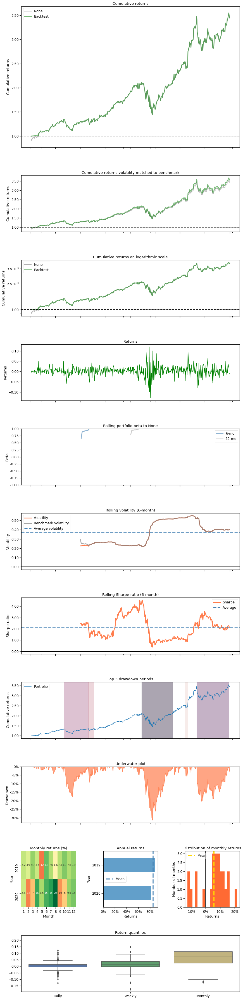

In [ ]:
print("==============Compare to AAPL itself buy-and-hold===========")
%matplotlib inline
BackTestPlot(account_value=df_account_value, 
             baseline_ticker = 'AAPL',
             baseline_start = '2019-01-01',
             baseline_end = '2021-01-01')

<a id='6.3'></a>
## 7.3 Baseline Stats

In [ ]:
print("==============Get Baseline Stats===========")
baesline_perf_stats=BaselineStats('AAPL')

==============Get Baseline Stats===========
[*********************100%***********************]  1 of 1 completed
Shape of DataFrame:  (483, 7)
Annual return          0.800630
Cumulative returns     2.087191
Annual volatility      0.382201
Sharpe ratio           1.735128
Calmar ratio           2.547565
Stability              0.930285
Max drawdown          -0.314273
Omega ratio            1.387241
Sortino ratio          2.572655
Skew                        NaN
Kurtosis                    NaN
Tail ratio             1.081315
Daily value at risk   -0.045521
Alpha                  0.000000
Beta                   1.000000
dtype: float64


In [ ]:
print("==============Get Baseline Stats===========")
baesline_perf_stats=BaselineStats('^GSPC')

==============Get Baseline Stats===========
[*********************100%***********************]  1 of 1 completed
Shape of DataFrame:  (483, 7)
Annual return          0.210804
Cumulative returns     0.442863
Annual volatility      0.264385
Sharpe ratio           0.858377
Calmar ratio           0.621384
Stability              0.467075
Max drawdown          -0.339250
Omega ratio            1.200929
Sortino ratio          1.183069
Skew                        NaN
Kurtosis                    NaN
Tail ratio             0.726400
Daily value at risk   -0.032409
Alpha                  0.000000
Beta                   1.000000
dtype: float64


<a id='6.4'></a>
## 7.4 Compare to Stock Market Index

==============Compare to S&P 500===========
annual return:  98.50882005689301
sharpe ratio:  1.8721562790475017
[*********************100%***********************]  1 of 1 completed
Shape of DataFrame:  (483, 7)


Start date,2019-01-03
End date,2020-11-30
Total months,22
,Backtest
Annual return,80.433%
Cumulative returns,209.212%
Annual volatility,37.022%
Sharpe ratio,1.78
Calmar ratio,2.56
Stability,0.93
Max drawdown,-31.422%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,31.42,2020-02-12,2020-03-23,2020-06-05,83
1,20.37,2020-09-01,2020-09-18,NaT,NaN
2,17.84,2019-05-03,2019-06-03,2019-07-31,64
3,9.24,2019-07-31,2019-08-05,2019-08-21,16
4,5.84,2020-07-20,2020-07-24,2020-07-31,10


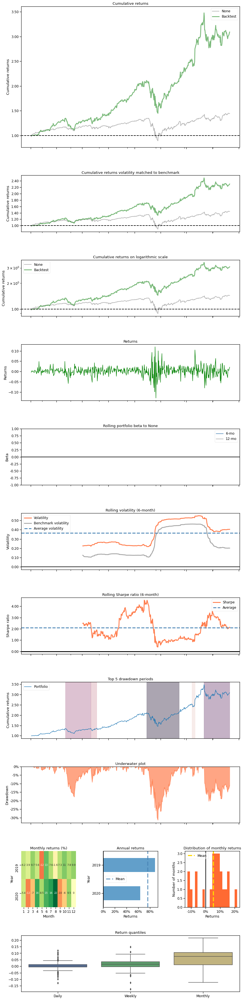

In [ ]:
print("==============Compare to S&P 500===========")
%matplotlib inline
# S&P 500: ^GSPC
# Dow Jones Index: ^DJI
# NASDAQ 100: ^NDX
BackTestPlot(df_account_value, baseline_ticker = '^GSPC')